In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Finance Data

In [1]:
!pip install pandas_ta

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.1/115.1 kB 3.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pandas_ta: filename=pandas_ta-0.3.14b0-py3-none-any.whl size=218907 sha256=7be2e6a487d77f4e99cf4c103d5b7af78c05a47f2cd8c57a619a63e28bf21c01
  Stored in directory: /root/.cache/pip/wheels/69/00/ac/f7fa862c34b0e2ef320175100c233377b4c558944f12474cf0
Successfully built pandas_ta


In [2]:
import pandas as pd
import pandas_ta as ta

# Create a DataFrame so 'ta' can be used.
df = pd.DataFrame()

# Help about this, 'ta', extension
#help(df.ta)

# List of all indicators
df.ta.indicators()

# Help about an indicator such as bbands
help(ta.bbands)
#help(ta.sma)

Pandas TA - Technical Analysis Indicators - v0.3.14b0
Total Indicators & Utilities: 205
Abbreviations:
    aberration, above, above_value, accbands, ad, adosc, adx, alma, amat, ao, aobv, apo, aroon, atr, bbands, below, below_value, bias, bop, brar, cci, cdl_pattern, cdl_z, cfo, cg, chop, cksp, cmf, cmo, coppock, cross, cross_value, cti, decay, decreasing, dema, dm, donchian, dpo, ebsw, efi, ema, entropy, eom, er, eri, fisher, fwma, ha, hilo, hl2, hlc3, hma, hwc, hwma, ichimoku, increasing, inertia, jma, kama, kc, kdj, kst, kurtosis, kvo, linreg, log_return, long_run, macd, mad, massi, mcgd, median, mfi, midpoint, midprice, mom, natr, nvi, obv, ohlc4, pdist, percent_return, pgo, ppo, psar, psl, pvi, pvo, pvol, pvr, pvt, pwma, qqe, qstick, quantile, rma, roc, rsi, rsx, rvgi, rvi, short_run, sinwma, skew, slope, sma, smi, squeeze, squeeze_pro, ssf, stc, stdev, stoch, stochrsi, supertrend, swma, t3, td_seq, tema, thermo, tos_stdevall, trima, trix, true_range, tsi, tsignals, ttm_trend, ui, 

In [3]:
import yfinance as yf

spx = yf.Ticker("^SPX")
history = spx.history(period="max")
history.ta.bbands(close="Close", append=True)
history.tail()

,Open,High,Low,Close,Volume,Dividends,Stock Splits,BBL_5_2.0,BBM_5_2.0,BBU_5_2.0,BBB_5_2.0,BBP_5_2.0
Date,,,,,,,,,,,,
2024-06-24 00:00:00-04:00,5459.580078,5490.660156,5447.589844,5447.870117,3696750000,0.0,0.0,5443.480441,5469.183984,5494.887528,0.939941,0.085390
2024-06-25 00:00:00-04:00,5460.729980,5472.879883,5446.560059,5469.299805,3591960000,0.0,0.0,5442.998827,5468.397949,5493.797072,0.928942,0.517754
2024-06-26 00:00:00-04:00,5460.709961,5483.140137,5451.870117,5477.899902,3563920000,0.0,0.0,5445.925130,5466.571973,5487.218815,0.755385,0.774326
2024-06-27 00:00:00-04:00,5473.589844,5490.810059,5467.540039,5482.870117,3589530000,0.0,0.0,5444.244454,5468.512012,5492.779570,0.887538,0.795829
2024-06-28 00:00:00-04:00,5488.479980,5523.640137,5451.120117,5460.479980,7199220000,0.0,0.0,5442.670684,5467.683984,5492.697285,0.914950,0.355997


In [4]:
import pandas as pd

# Assuming df is your DataFrame and it has a DateTime index
# Ensure the index is of datetime type
history.index = pd.to_datetime(history.index)

# Create a dictionary to hold DataFrames by year
dfs_by_year = {year: history.loc[history.index.year == year] for year in history.index.year.unique()}

# Example: Accessing the DataFrame for a specific year, say 2020
df_2020 = dfs_by_year[2020]
print(len(df_2020))

# Printing the DataFrame for a specific year, for example, 2020
dfs_by_year[2020]


253


,Open,High,Low,Close,Volume,Dividends,Stock Splits,BBL_5_2.0,BBM_5_2.0,BBU_5_2.0,BBB_5_2.0,BBP_5_2.0
Date,,,,,,,,,,,,
2020-01-02 00:00:00-05:00,3244.669922,3258.139893,3235.530029,3257.850098,3459930000,0.0,0.0,3213.752656,3237.970020,3262.187384,1.495836,0.910451
2020-01-03 00:00:00-05:00,3226.360107,3246.149902,3222.340088,3234.850098,3484700000,0.0,0.0,3212.726651,3236.958057,3261.189462,1.497171,0.456504
2020-01-06 00:00:00-05:00,3217.550049,3246.840088,3214.639893,3246.280029,3702460000,0.0,0.0,3212.854392,3238.210059,3263.565725,1.566030,0.659135
2020-01-07 00:00:00-05:00,3241.860107,3244.909912,3232.429932,3237.179932,3435910000,0.0,0.0,3222.040403,3241.388037,3260.735671,1.193787,0.391250
2020-01-08 00:00:00-05:00,3238.590088,3267.070068,3236.669922,3253.050049,3726840000,0.0,0.0,3228.128869,3245.842041,3263.555213,1.091438,0.703465
...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-24 00:00:00-05:00,3694.030029,3703.820068,3689.320068,3703.060059,1883780000,0.0,0.0,3680.469633,3696.931982,3713.394332,0.890595,0.686124
2020-12-28 00:00:00-05:00,3723.030029,3740.510010,3723.030029,3735.360107,3535460000,0.0,0.0,3667.192370,3702.122021,3737.051673,1.887007,0.975786
2020-12-29 00:00:00-05:00,3750.010010,3756.120117,3723.310059,3727.040039,3393290000,0.0,0.0,3669.684262,3708.546045,3747.407828,2.095796,0.737946


In [5]:
import pandas as pd

def make_frame_bound(df, year):
    # Ensure the index is of datetime type
    df.index = pd.to_datetime(df.index)

    # Get all indices for the given year
    year_indices = df.loc[df.index.year == year].index

    if year == 1928:
        # Get the integer location of the 10th index of the entire dataset
        start_idx = max(df.index.get_loc(year_indices[0]), 9)
    else:
        start_idx = df.index.get_loc(year_indices[0])
    end_idx = df.index.get_loc(year_indices[-1])

    return (start_idx, end_idx)

# Example usage
# df is your main DataFrame with date index
# Assuming df is already defined and loaded with the stock price data
start_idx, end_idx = make_frame_bound(history, 1928)
print(f"Start index for 1928: {start_idx}, End index for 1928: {end_idx}")

# You can call this function for any year
start_idx, end_idx = make_frame_bound(history, 2020)
print(f"Start index for 2020: {start_idx}, End index for 2020: {end_idx}")


Start index for 1928: 9, End index for 1928: 250
Start index for 2020: 23109, End index for 2020: 23361


In [6]:
len(history)

24239

In [7]:
close = history["Close"]
history = close.round(2)
dates = history.index.strftime('%Y-%m-%d')
price = history.to_numpy()
d = [[price, dates] for price, dates in zip(price, dates)]
sd = d[10:10010]
sd[-1][0] - sd[0][0]

78.18

In [8]:
def extract_data(ticker):
    data = yf.Ticker(ticker).history(period="max")
    data.ta.bbands(close="Close", append=True)
    return data

data = extract_data("^SPX")
data.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'Dividends', 'Stock Splits',
       'BBL_5_2.0', 'BBM_5_2.0', 'BBU_5_2.0', 'BBB_5_2.0', 'BBP_5_2.0'],
      dtype='object')

# Env
* Env modified from anytrading-env ([github](https://github.com/AminHP/gym-anytrading))
* Action space is continuous from range [0,1] indicating the percentage of portfolio that is in stocks. For example, if action is 0.7, 70% of balance is in stocks with 30% in cash

## Env

In [12]:
import gymnasium as gym
import random
import numpy as np
from enum import Enum

In [18]:
class TradingEnv(gym.Env):

    metadata = {'render_modes': ['human'], 'render_fps': 3}

    def __init__(self, df, window_size, starting_balance, render_mode=None):
        assert df.ndim == 2
        assert render_mode is None or render_mode in self.metadata['render_modes']

        self.render_mode = render_mode

        self.df = df
        self.window_size = window_size
        self.prices, self.signal_features = self._process_data()
        self.shape = (window_size, self.signal_features.shape[1])
        self.starting_balance = starting_balance

        # spaces
        self.action_space = gym.spaces.Box(low=0, high=1)
        INF = 1e10
        self.observation_space = gym.spaces.Box(
            low=-INF, high=INF, shape=self.shape, dtype=np.float32,
        )

        # episode
        self._starting_balance = self.starting_balance
        self._start_tick = self.window_size
        self._end_tick = len(self.prices) - 1
        self._truncated = None
        self._current_tick = None
        self._last_trade_tick = None
        self._position = None
        self._position_history = None
        self._total_reward = None
        self._total_profit = None
        self._first_rendering = None
        self.history = None

    def reset(self, seed=None, options=None):
        super().reset(seed=seed, options=options)
        self.action_space.seed(int((self.np_random.uniform(0, seed if seed is not None else 1))))

        self._starting_balance = self.starting_balance
        self._truncated = False
        self._current_tick = self._start_tick
        self._last_trade_tick = self._current_tick - 1
        self._position = 0.0
        self._position_history = (self.window_size * [None]) + [self._position]
        self._total_reward = 0.
        self._total_profit = 1.  # unit
        self._first_rendering = True
        self.history = {}

        observation = self._get_observation()
        info = self._get_info()

        if self.render_mode == 'human':
            self._render_frame()

        return observation, info

    def step(self, action):
        self._truncated = False
        self._current_tick += 1

        if self._current_tick == self._end_tick:
            self._truncated = True

        step_reward = self._calculate_reward(action)
        self._total_reward += step_reward

        self._update_profit(action)

        if action != self._position:
          self._last_trade_tick = self._current_tick
          self._position = action

        self._position_history.append(self._position)
        observation = self._get_observation()
        info = self._get_info()
        self._update_history(info)

        if self.render_mode == 'human':
            self._render_frame()

        return observation, step_reward, False, self._truncated, info

    def _get_info(self):
        return dict(
            total_reward=self._total_reward,
            total_profit=self._total_profit,
            position=self._position
        )

    def _get_observation(self):
        return self.signal_features[(self._current_tick-self.window_size+1):self._current_tick+1]

    def _update_history(self, info):
        if not self.history:
            self.history = {key: [] for key in info.keys()}

        for key, value in info.items():
            self.history[key].append(value)

    def _render_frame(self):
        self.render()

    def render(self, mode='human'):

        def _plot_position(position, tick):
            color = None
            if position == Positions.Short:
                color = 'red'
            elif position == Positions.Long:
                color = 'green'
            if color:
                plt.scatter(tick, self.prices[tick], color=color)

        start_time = time()

        if self._first_rendering:
            self._first_rendering = False
            plt.cla()
            plt.plot(self.prices)
            start_position = self._position_history[self._start_tick]
            _plot_position(start_position, self._start_tick)

        _plot_position(self._position, self._current_tick)

        plt.suptitle(
            "Total Reward: %.6f" % self._total_reward + ' ~ ' +
            "Total Profit: %.6f" % self._total_profit
        )

        end_time = time()
        process_time = end_time - start_time

        pause_time = (1 / self.metadata['render_fps']) - process_time
        assert pause_time > 0., "High FPS! Try to reduce the 'render_fps' value."

        plt.pause(pause_time)

    def render_all(self, title=None):
        window_ticks = np.arange(len(self._position_history))
        plt.plot(self.prices)

        short_ticks = []
        long_ticks = []
        for i, tick in enumerate(window_ticks):
            if self._position_history[i] == Positions.Short:
                short_ticks.append(tick)
            elif self._position_history[i] == Positions.Long:
                long_ticks.append(tick)

        plt.plot(short_ticks, self.prices[short_ticks], 'ro')
        plt.plot(long_ticks, self.prices[long_ticks], 'go')

        if title:
            plt.title(title)

        plt.suptitle(
            "Total Reward: %.6f" % self._total_reward + ' ~ ' +
            "Total Profit: %.6f" % self._total_profit
        )

    def close(self):
        plt.close()

    def save_rendering(self, filepath):
        plt.savefig(filepath)

    def pause_rendering(self):
        plt.show()

    def _process_data(self):
        raise NotImplementedError

    def _calculate_reward(self, action):
        raise NotImplementedError

    def _update_profit(self, action):
        raise NotImplementedError

    def max_possible_profit(self):  # trade fees are ignored
        raise NotImplementedError

In [ ]:
class StocksEnv(TradingEnv):

    def __init__(self, df, window_size, frame_bound, render_mode=None):
        assert len(frame_bound) == 2

        self.frame_bound = frame_bound
        super().__init__(df, window_size, render_mode)

        self.trade_fee_bid_percent = 0.01  # unit
        self.trade_fee_ask_percent = 0.01  # unit

    def _process_data(self):
        prices = self.df.loc[:, 'Close'].to_numpy()

        prices[self.frame_bound[0] - self.window_size]  # validate index (TODO: Improve validation)
        prices = prices[self.frame_bound[0]-self.window_size:self.frame_bound[1]]

        diff = np.insert(np.diff(prices), 0, 0)
        signal_features = np.column_stack((prices, diff))

        return prices.astype(np.float32), signal_features.astype(np.float32)

    def _calculate_reward(self, action):
        step_reward = 0

        current_price = self.prices[self._current_tick]
        last_trade_price = self.prices[self._last_trade_tick]
        price_diff = current_price - last_trade_price

        if self._position == Positions.Long:
            step_reward += price_diff

        return step_reward

    def _update_profit(self, action):
        trade = False
        if (
            (action == Actions.Buy.value and self._position == Positions.Short) or
            (action == Actions.Sell.value and self._position == Positions.Long)
        ):
            trade = True

        if trade or self._truncated:
            current_price = self.prices[self._current_tick]
            last_trade_price = self.prices[self._last_trade_tick]

            if self._position == Positions.Long:
                shares = (self._total_profit * (1 - self.trade_fee_ask_percent)) / last_trade_price
                self._total_profit = (shares * (1 - self.trade_fee_bid_percent)) * current_price

    def max_possible_profit(self):
        current_tick = self._start_tick
        last_trade_tick = current_tick - 1
        profit = 1.

        while current_tick <= self._end_tick:
            position = None
            if self.prices[current_tick] < self.prices[current_tick - 1]:
                while (current_tick <= self._end_tick and
                       self.prices[current_tick] < self.prices[current_tick - 1]):
                    current_tick += 1
                position = Positions.Short
            else:
                while (current_tick <= self._end_tick and
                       self.prices[current_tick] >= self.prices[current_tick - 1]):
                    current_tick += 1
                position = Positions.Long

            if position == Positions.Long:
                current_price = self.prices[current_tick - 1]
                last_trade_price = self.prices[last_trade_tick]
                shares = profit / last_trade_price
                profit = shares * current_price
            last_trade_tick = current_tick - 1

        return profit

### Yearly RollBased Custom Env

In [ ]:
class CustomStocksEnv(StocksEnv):
    def __init__(self, df, window_size, frame_bound, min_year, max_year, render_mode=None):
        self.min_year = min_year
        self.max_year = max_year
        self.trade_fee_bid_percent = 0.01  # unit
        self.trade_fee_ask_percent = 0.005
        super().__init__(df, window_size, frame_bound, render_mode)


    def _process_data(self):
        prices = self.df.loc[:, 'Close'].to_numpy()
        self.year = self.random_year()
        self.frame_bound = self.make_frame_bound(self.year)

        self.year_start_price = prices[self.frame_bound[0]]
        self.year_end_price = prices[self.frame_bound[1]]
        self.buy_hold_profit = self.year_end_price * (1 - self.trade_fee_bid_percent) - self.year_start_price * (1 - self.trade_fee_ask_percent)
        #print(f"self.year_start_price: {self.year_start_price}")
        #print(f"self.year_end_price: {self.year_end_price}")
        #print(f"self.buy_hold_profit: {self.buy_hold_profit}")

        prices[self.frame_bound[0] - self.window_size]  # validate index (TODO: Improve validation)
        prices = prices[self.frame_bound[0]-self.window_size:self.frame_bound[1]+1]
        #print(prices)
        diff = np.insert(np.diff(prices), 0, 0)
        signal_features = np.column_stack((prices, diff))

        return prices.astype(np.float32), signal_features.astype(np.float32)

    def random_year(self):
      return random.randint(self.min_year, self.max_year)

    def make_frame_bound(self, year):
      # Ensure the index is of datetime type
      self.df.index = pd.to_datetime(self.df.index)
      #print(f"Data from Year: {year}")

      # Get all indices for the given year
      year_indices = self.df.loc[self.df.index.year == year].index
      #print(f"Selected Year: {year}")
      #print(year_indices)

      if year == 1928:
          # Get the integer location of the 10th index of the entire dataset
          start_idx = max(self.df.index.get_loc(year_indices[0]), 10)
      else:
          start_idx = self.df.index.get_loc(year_indices[0])

      end_idx = self.df.index.get_loc(year_indices[-1])

      #print(f"start_idx: {start_idx}")
      #print(f"end_idx: {end_idx}")
      return (start_idx, end_idx)

    def _get_info(self):
        return dict(
            total_reward=self._total_reward,
            total_profit=self._total_profit,
            position=self._position,
            year_start_price = self.year_start_price,
            year_end_price = self.year_end_price,
            buy_hold_profit=self.buy_hold_profit
        )

    def reset(self, seed=None, options=None):
      super().reset(seed=seed, options=options)
      self.prices, self.signal_features = self._process_data()

      self.action_space.seed(int((self.np_random.uniform(0, seed if seed is not None else 1))))

      self._truncated = False
      self._current_tick = self._start_tick
      self._end_tick = len(self.prices) - 1
      self._last_trade_tick = self._current_tick - 1
      self._position = Positions.Short
      self._position_history = (self.window_size * [None]) + [self._position]
      self._total_reward = 0.
      self._total_profit = 1.  # unit
      self._first_rendering = True
      self.history = {}

      observation = self._get_observation()
      info = self._get_info()

      if self.render_mode == 'human':
        self._render_frame()

      return observation, info

    def render_all(self, title=None):
        window_ticks = np.arange(len(self._position_history))
        plt.plot(self.prices)

        short_ticks = []
        long_ticks = []
        for i, tick in enumerate(window_ticks):
            if self._position_history[i] == Positions.Short:
                short_ticks.append(tick)
            elif self._position_history[i] == Positions.Long:
                long_ticks.append(tick)

        plt.plot(short_ticks, self.prices[short_ticks], 'ro')
        plt.plot(long_ticks, self.prices[long_ticks], 'go')

        if title:
            plt.title(title)

        plt.suptitle(
            "Year: " + str(self.year) + " | " +
            "Total Reward: %.6f" % self._total_reward + " | " +
            "BuyHold Profit: %.6f" % self.buy_hold_profit
        )

#### Examples

In [ ]:
data= extract_data("^SPX")
env = CustomStocksEnv(
    df=data,
    window_size=10,
    frame_bound=(10, 24232),
    min_year=1928,
    max_year=2023
)

In [ ]:
print("env information:")
print("> shape:", env.unwrapped.shape)
print("> df.shape:", env.unwrapped.df.shape)
print("> prices.shape:", env.unwrapped.prices.shape)
print("> signal_features.shape:", env.unwrapped.signal_features.shape)
print("> max_possible_profit:", env.unwrapped.max_possible_profit())

env information:
> shape: (10, 2)
> df.shape: (24232, 7)
> prices.shape: (256,)
> signal_features.shape: (256, 2)
> max_possible_profit: 2.4100674611037354


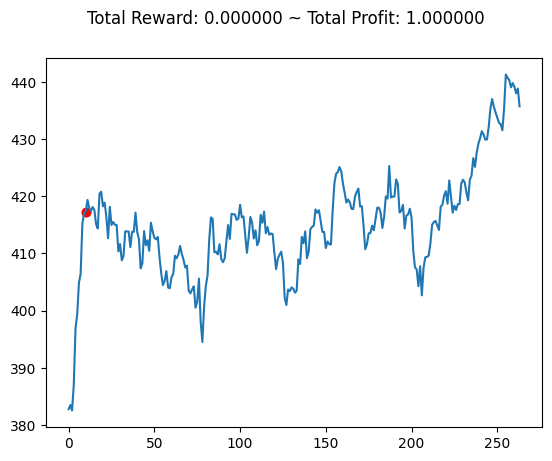

In [ ]:
env.reset()
env.render()

info: {'total_reward': -151.020263671875, 'total_profit': 0.36210025931578954, 'position': <Positions.Short: 0>, 'year_start_price': 1283.27001953125, 'year_end_price': 1148.0799560546875, 'buy_hold_profit': -140.2545129394532}


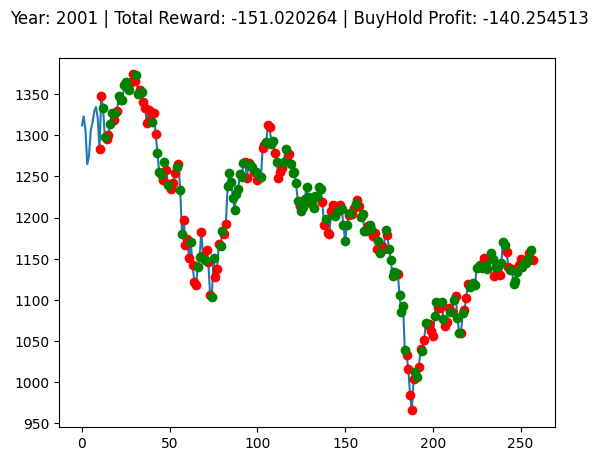

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

import gymnasium as gym
import gym_anytrading
from gym_anytrading.envs import TradingEnv, ForexEnv, StocksEnv, Actions, Positions
from gym_anytrading.datasets import FOREX_EURUSD_1H_ASK, STOCKS_GOOGL

observation = env.reset(seed=2023)
steps = 0
while True:
    if steps == 0:
      start_price = observation[0][0]
    action = env.action_space.sample()
    observation, reward, terminated, truncated, info = env.step(action)
    done = terminated or truncated
    steps += 1

    # env.render()
    if done:
        end_price = observation[-1][0]
        print("info:", info)
        break

plt.cla()
env.unwrapped.render_all()
plt.show()

### Encoder Stock Env with Yearly Roll Base

In [ ]:
import numpy as np
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import math, copy, time
from torch.autograd import Variable
import matplotlib.pyplot as plt
import seaborn
from torch.utils.tensorboard import SummaryWriter
from torch.utils.data import Dataset
import tqdm
import yfinance as yf
from torch.utils.data import DataLoader
from torch.distributions import Categorical

#### Encoder Code

In [ ]:
def subsequent_mask(size):
  "Mask out subsequent positions."
  attn_shape = (1, size, size)
  subsequent_mask = np.triu(np.ones(attn_shape), k=1).astype('uint8')
  return torch.from_numpy(subsequent_mask) == 0

In [ ]:
def generate_square_subsequent_mask(sz):
    device = "cuda" if torch.cuda.is_available() else "cpu"
    mask = (torch.triu(torch.ones((sz, sz), device=device)) == 1).transpose(0, 1)
    mask = mask.float().masked_fill(mask == 0, float('-inf')).masked_fill(mask == 1, float(0.0))
    return mask

In [ ]:
class PositionalEncoding(nn.Module):
    "Implement the PE function."
    def __init__(self, d_model, dropout, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        # Compute the positional encodings once in log space.
        pe = torch.zeros(max_len, d_model)
        #print(f"pe shape: {pe.shape}")
        position = torch.arange(0, max_len).unsqueeze(1)
        #print(f"position shape: {position.shape}")
        div_term = torch.exp(torch.arange(0, d_model, 2) *
                             -(math.log(10000.0) / d_model))
        #print(f"div_term shape: {div_term.shape}")
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        #print(f"pe shape: {pe.shape}")
        self.register_buffer('pe', pe)
        self.device = "cuda" if torch.cuda.is_available() else "cpu"

    def forward(self, x):
        pos = Variable(self.pe[:, :x.size(-1)], requires_grad=False).to(self.device)
        #print(f"pos shape: {pos.shape}")
        x = x + pos
        return self.dropout(x)

In [ ]:
class StockTrainerTransformerModel(nn.Module):
  def __init__(self, d_model, device):
    super(StockTrainerTransformerModel, self).__init__()
    self.d_model = d_model
    self.device = device
    self.positional_encoding = PositionalEncoding(d_model, 0.1)
    self.transformer = nn.Transformer(nhead=8, num_encoder_layers=6, batch_first=True)
    self.classification_network = nn.Sequential(
        nn.Linear(d_model, 512),
        nn.ReLU(),
        nn.Linear(512, 2),
    )
    self.generator = nn.Sequential(
        nn.Linear(512, 256),
        nn.ReLU(),
        nn.Linear(256, 1)
    )

  def forward(self, data):
    if torch.is_tensor(data) is not True:
      data = torch.Tensor(data).to(self.device)
    data = data.unsqueeze(-1)
    pos_data = self.positional_encoding(data)
    encoder_out = self.transformer.encoder(pos_data)
    return encoder_out

In [ ]:
### Load Encoder Model
device = "cuda" if torch.cuda.is_available() else "cpu"
model = StockTrainerTransformerModel(512, device)
path = "/content/drive/MyDrive/code/fintransformer/models/encoder_45days_sp500_eval.pt"
#path = "/content/drive/MyDrive/encoder_45days_sp500_eval.pt"
def load_model(self, path):
    checkpoint = torch.load(path, map_location=torch.device(device))
    model.load_state_dict(checkpoint['model_state_dict'])
    print(f"Model loaded from {path}")
    print(f"Model Accuracy: {checkpoint['acc']}")
    return model

encoder = load_model(model, path)
#encoder = model

Model loaded from /content/drive/MyDrive/code/fintransformer/models/encoder_45days_sp500_eval.pt
Model Accuracy: 0.5431952662721894


#### Env

In [ ]:
class EncoderStocksEnv(StocksEnv):
    def __init__(self, df, window_size, frame_bound, min_year, max_year, render_mode=None):
        self.min_year = min_year
        self.max_year = max_year
        self.trade_fee_bid_percent = 0.01  # unit
        self.trade_fee_ask_percent = 0.005
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        super().__init__(df, window_size, frame_bound, render_mode)

    def normalize(self, price):
        mean = np.mean(price)
        std = np.std(price)
        max = np.max(price)
        min = np.min(price)
        price = (price - min) / (max - min)
        return price

    def _process_data(self):
        prices = self.df.loc[:, 'Close'].to_numpy()
        self.year = self.random_year()
        self.frame_bound = self.make_frame_bound(self.year)

        self.year_start_price = prices[self.frame_bound[0]]
        self.year_end_price = prices[self.frame_bound[1]]
        self.buy_hold_profit = self.year_end_price * (1 - self.trade_fee_bid_percent) - self.year_start_price * (1 - self.trade_fee_ask_percent)
        #print(f"self.year_start_price: {self.year_start_price}")
        #print(f"self.year_end_price: {self.year_end_price}")
        #print(f"self.buy_hold_profit: {self.buy_hold_profit}")

        prices[self.frame_bound[0] - self.window_size]  # validate index (TODO: Improve validation)
        raw_prices = prices.copy()
        raw_prices = raw_prices[self.frame_bound[0]-self.window_size:self.frame_bound[1]+1]

        """
        30 Days before data
        """
        day_before_30 = prices[self.frame_bound[0]-self.window_size-30:self.frame_bound[1]+1]

        """
        Bollinger Bands
        """
        bbl = self.df.loc[:, 'BBL_5_2.0'].to_numpy()
        bbl = bbl[self.frame_bound[0]-self.window_size:self.frame_bound[1]+1]
        bbl = self.normalize(bbl)
        #print(bbl)
        bbm = self.df.loc[:, 'BBM_5_2.0'].to_numpy()
        bbm = bbm[self.frame_bound[0]-self.window_size:self.frame_bound[1]+1]
        bbm = self.normalize(bbm)
        bbu = self.df.loc[:, 'BBU_5_2.0'].to_numpy()
        bbu = bbu[self.frame_bound[0]-self.window_size:self.frame_bound[1]+1]
        bbu = self.normalize(bbu)
        bbb = self.df.loc[:, 'BBB_5_2.0'].to_numpy()
        bbp = self.df.loc[:, 'BBP_5_2.0'].to_numpy()


        """
        Moving Average
        """
        #sma = self.df.loc[:, 'SMA_10'].to_numpy()
        #sma = sma[self.frame_bound[0]-self.window_size:self.frame_bound[1]+1]
        #sma = self.normalize(sma)

        """
        Normalized Year Price
        """
        year_prices = self.normalize(day_before_30)[30:]

        signal_features = np.column_stack((year_prices, bbl, bbm, bbu))
        #print(f"signal features: {signal_features.shape}")
        return raw_prices.astype(np.float32), signal_features.astype(np.float32)

    def _get_observation(self):
        window = self.signal_features[(self._current_tick-self.window_size+1):self._current_tick+1]
        #print(f"window shape: {window.shape}")
        return window

    def random_year(self):
      return random.randint(self.min_year, self.max_year)

    def make_frame_bound(self, year):
      # Ensure the index is of datetime type
      self.df.index = pd.to_datetime(self.df.index)
      #print(f"Data from Year: {year}")

      # Get all indices for the given year
      year_indices = self.df.loc[self.df.index.year == year].index
      #print(f"Selected Year: {year}")
      #print(year_indices)

      if year == 1928:
          # Get the integer location of the 10th index of the entire dataset
          start_idx = max(self.df.index.get_loc(year_indices[0]), 10)
      else:
          start_idx = self.df.index.get_loc(year_indices[0])

      end_idx = self.df.index.get_loc(year_indices[-1])

      #print(f"start_idx: {start_idx}")
      #print(f"end_idx: {end_idx}")
      return (start_idx, end_idx)

    def _get_info(self):
        return dict(
            total_reward=self._total_reward,
            total_profit=self._total_profit,
            position=self._position,
            year_start_price = self.year_start_price,
            year_end_price = self.year_end_price,
            buy_hold_profit=self.buy_hold_profit
        )

    def reset(self, seed=None, options=None):
      super().reset(seed=seed, options=options)
      self.prices, self.signal_features = self._process_data()

      self.action_space.seed(int((self.np_random.uniform(0, seed if seed is not None else 1))))

      self._truncated = False
      self._current_tick = self._start_tick
      self._end_tick = len(self.prices) - 1
      self._last_trade_tick = self._current_tick - 1
      self._position = Positions.Short
      self._position_history = (self.window_size * [None]) + [self._position]
      self._total_reward = 0.
      self._total_profit = 1.  # unit
      self._first_rendering = True
      self.history = {}

      observation = self._get_observation()
      info = self._get_info()

      if self.render_mode == 'human':
        self._render_frame()
      return observation, info

    def render_all(self, title=None):
        window_ticks = np.arange(len(self._position_history))
        plt.plot(self.prices)

        short_ticks = []
        long_ticks = []
        for i, tick in enumerate(window_ticks):
            if self._position_history[i] == Positions.Short:
                short_ticks.append(tick)
            elif self._position_history[i] == Positions.Long:
                long_ticks.append(tick)

        plt.plot(short_ticks, self.prices[short_ticks], 'ro')
        plt.plot(long_ticks, self.prices[long_ticks], 'go')

        if title:
            plt.title(title)

        plt.suptitle(
            "Year: " + str(self.year) + " | " +
            "Total Reward: %.6f" % self._total_reward + " | " +
            "BuyHold Profit: %.6f" % self.buy_hold_profit
        )


#### Examples

In [ ]:
data= extract_data("^SPX")
env = EncoderStocksEnv(
    df=data,
    window_size=10,
    frame_bound=(10, 24232),
    min_year=1929,
    max_year=2023,
)
prices, _ = env.reset()
prices

array([[0.4907407 , 0.5336074 , 0.48698622, 0.43822616],
       [0.49382687, 0.53117275, 0.48561633, 0.43808335],
       [0.49382687, 0.52988124, 0.48493138, 0.4380935 ],
       [0.52469116, 0.5224276 , 0.48835605, 0.45334944],
       [0.50617254, 0.5224276 , 0.48835605, 0.45334944],
       [0.47222203, 0.5090147 , 0.48424643, 0.45964292],
       [0.5339503 , 0.50737315, 0.49315056, 0.47979057],
       [0.5339503 , 0.51298237, 0.5020547 , 0.49195984],
       [0.50925905, 0.51098025, 0.49863002, 0.4871085 ],
       [0.43209854, 0.4612706 , 0.48219165, 0.5079451 ]], dtype=float32)

In [ ]:
print("env information:")
print("> shape:", env.unwrapped.shape)
print("> df.shape:", env.unwrapped.df.shape)
print("> prices.shape:", env.unwrapped.prices.shape)
print("> signal_features.shape:", env.unwrapped.signal_features.shape)
print("> max_possible_profit:", env.unwrapped.max_possible_profit())

env information:
> shape: (10, 4)
> df.shape: (24236, 12)
> prices.shape: (264,)
> signal_features.shape: (264, 4)
> max_possible_profit: 2.4103614611049506


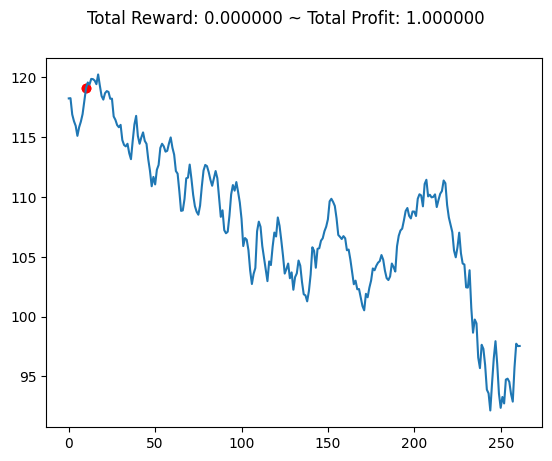

In [ ]:
env.reset()
env.render()

info: {'total_reward': 46.2301025390625, 'total_profit': 0.42143511095803715, 'position': <Positions.Long: 1>, 'year_start_price': 1108.47998046875, 'year_end_price': 1211.9200439453125, 'buy_hold_profit': 96.86326293945308}


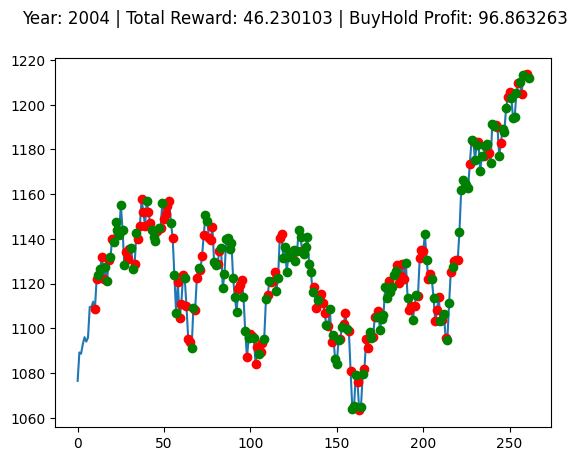

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

import gymnasium as gym
import gym_anytrading
from gym_anytrading.envs import TradingEnv, ForexEnv, StocksEnv, Actions, Positions
from gym_anytrading.datasets import FOREX_EURUSD_1H_ASK, STOCKS_GOOGL

observation, info = env.reset(seed=2023)
steps = 0
while True:
    action = env.action_space.sample()
    observation, reward, terminated, truncated, info = env.step(action)
    done = terminated or truncated
    steps += 1

    # env.render()
    if done:
        print("info:", info)
        break

plt.cla()
env.unwrapped.render_all()
plt.show()

## Training

### SB3

In [ ]:
!pip install stable-baselines3[extra]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.3/182.3 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 434.7/434.7 kB 5.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 10.2 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nv

In [ ]:
from tqdm import tqdm
import random

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import gymnasium as gym
import gym_anytrading

from stable_baselines3 import A2C, PPO
from stable_baselines3.common.callbacks import BaseCallback

import torch

ModuleNotFoundError: No module named 'stable_baselines3'

In [ ]:
def print_stats(reward_over_episodes):
    """  Print Reward  """

    avg = np.mean(reward_over_episodes)
    min = np.min(reward_over_episodes)
    max = np.max(reward_over_episodes)

    print (f'Min. Reward          : {min:>10.3f}')
    print (f'Avg. Reward          : {avg:>10.3f}')
    print (f'Max. Reward          : {max:>10.3f}')

    return min, avg, max


# ProgressBarCallback for model.learn()
class ProgressBarCallback(BaseCallback):

    def __init__(self, check_freq: int, verbose: int = 1):
        super().__init__(verbose)
        self.check_freq = check_freq

    def _on_training_start(self) -> None:
        """
        This method is called before the first rollout starts.
        """
        self.progress_bar = tqdm(total=self.model._total_timesteps, desc="model.learn()")

    def _on_step(self) -> bool:
        if self.n_calls % self.check_freq == 0:
            self.progress_bar.update(self.check_freq)
        return True

    def _on_training_end(self) -> None:
        """
        This event is triggered before exiting the `learn()` method.
        """
        self.progress_bar.close()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
def train_model(model, env, seed, total_num_episodes, total_learning_timesteps=10000):
  obs = env.reset(seed=seed)
  torch.manual_seed(seed)
  random.seed(seed)
  np.random.seed(seed)

  print(f'model {type(model)}')
  print(f'policy {type(model.policy)}')
  model.learn(total_timesteps=total_learning_timesteps, callback=ProgressBarCallback(check_freq=100))
  env = model.get_env()

  reward_over_episodes = []
  tbar = tqdm(range(total_num_episodes))
  for episode in tbar:
    obs = env.reset()
    total_reward = 0
    done = False

    while not done:
      action, _states = model.predict(obs)
      obs, reward, done, info = env.step(action)
      total_reward += reward
      if done:
        break

    reward_over_episodes.append(total_reward)
    if episode % 10 == 0:
      avg_reward = np.mean(reward_over_episodes)
      tbar.set_description(f'Episode: {episode}, Avg. Reward: {avg_reward:.3f}')
      tbar.update()

  tbar.close()
  avg_reward = np.mean(reward_over_episodes)
  print(f'Avg. Reward: {avg_reward:.3f}')
  return reward_over_episodes

In [ ]:
data = extract_data("^SPX")
env = StocksEnv(
    df=data,
    window_size=10,
    frame_bound=(10, 10010)
)
seed = 42
total_num_episodes = 50
total_learning_timesteps = 10000

# INIT matplotlib
plot_settings = {}
plot_data = {'x': [i for i in range(1, total_num_episodes + 1)]}

In [ ]:
agent = PPO.policy_aliases.get('MlpPolicy')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
model = PPO(agent, env, verbose=0)

In [ ]:
class_name = type(model).__qualname__

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
plot_key = f'{class_name}_rewards'
rewards = train_model(model, env, seed, total_num_episodes, total_learning_timesteps)
min, avg, max, = print_stats(rewards)
label = f'Avg. {avg:>7.2f} : {class_name}'
plot_data[plot_key] = rewards
plot_settings[plot_key] = {'label': label}

model <class 'stable_baselines3.ppo.ppo.PPO'>
policy <class 'stable_baselines3.common.policies.ActorCriticPolicy'>


model.learn(): 10200it [00:30, 330.13it/s]
Episode: 40, Avg. Reward: 41.308: 100%|██████████| 50/50 [08:57<00:00, 10.74s/it]

Avg. Reward: 42.355
Min. Reward          :     14.710
Avg. Reward          :     42.355
Max. Reward          :     84.780


In [ ]:
# Buy and Hold

/usr/local/lib/python3.10/dist-packages/matplotlib/cbook/__init__.py:1335: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return np.asarray(x, float)


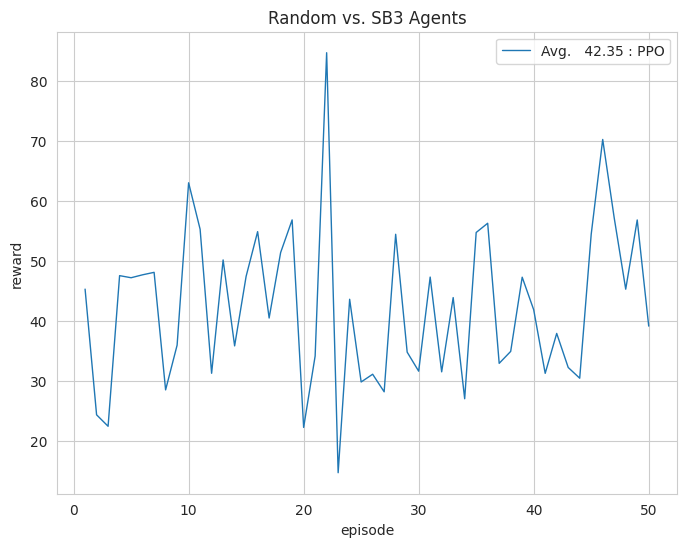

In [ ]:
data = pd.DataFrame(plot_data)

sns.set_style('whitegrid')
plt.figure(figsize=(8, 6))

for key in plot_data:
    if key == 'x':
        continue
    label = plot_settings[key]['label']
    line = plt.plot('x', key, data=data, linewidth=1, label=label)

plt.xlabel('episode')
plt.ylabel('reward')
plt.title('Random vs. SB3 Agents')
plt.legend()
plt.show()

### CleanRL

In [ ]:
import os
import random
import time
from dataclasses import dataclass

import gymnasium as gym
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import tqdm
from torch.distributions.categorical import Categorical
from torch.utils.tensorboard import SummaryWriter
INF = 1e10

In [ ]:
def layer_init(layer, std=np.sqrt(2), bias_const=0.0):
    torch.nn.init.orthogonal_(layer.weight, std)
    torch.nn.init.constant_(layer.bias, bias_const)
    return layer

#### Raw Price Env

In [ ]:
def make_env(min_year, max_year, ticker="^SPX"):
    def thunk():
        data= extract_data("^SPX")
        env = CustomStocksEnv(
            df=data,
            window_size=10,
            frame_bound=(10, 24232),
            min_year=min_year,
            max_year=max_year
        )
        return env
    return thunk

In [ ]:
class Agent(nn.Module):
    def __init__(self, envs):
        super().__init__()
        self.critic = nn.Sequential(
            layer_init(nn.Linear(np.array(envs.single_observation_space.shape)[0], 64)),
            nn.Tanh(),
            layer_init(nn.Linear(64, 64)),
            nn.Tanh(),
            layer_init(nn.Linear(64, 1), std=1.0),
        )
        self.actor = nn.Sequential(
            layer_init(nn.Linear(np.array(envs.single_observation_space.shape)[0], 64)),
            nn.Tanh(),
            layer_init(nn.Linear(64, 64)),
            nn.Tanh(),
            layer_init(nn.Linear(64, envs.single_action_space.n), std=0.01),
        )

    def get_value(self, x):
        batch_size = x.size(0)
        x = x[:,:,0]
        return self.critic(x)

    def get_action_and_value(self, x, action=None):
        batch_size = x.size(0)
        x = x[:,:,0]
        print(f"x shape: {x.shape}")
        logits = self.actor(x)
        print(f"logits: {logits.shape}")
        probs = Categorical(logits=logits)
        if action is None:
            action = probs.sample()
        return action, probs.log_prob(action), probs.entropy(), self.critic(x)

In [ ]:
envs = gym.vector.SyncVectorEnv(
    [make_env(min_year=args.min_year, max_year=args.max_year, ticker=args.ticker) for i in range(args.num_envs)],
)

In [ ]:
next_obs, _ = envs.reset()
next_obs.shape

(4, 10, 2)

In [ ]:
next_obs = torch.Tensor(next_obs).to(device)
agent = Agent(envs).to(device)
a, p, _, c = agent.get_action_and_value(next_obs)

x shape: torch.Size([4, 10])
logits: torch.Size([4, 2])


AttributeError: 'Categorical' object has no attribute 'shape'

In [ ]:
a.shape

torch.Size([4])

In [ ]:
@dataclass
class Args():
    exp_name: str = "S&P500_yearly_run2"
    """the name of this experiment"""
    ticker: str = "^SPX"
    """Ticker of equity"""
    seed: int = 1
    """seed of the experiment"""
    torch_deterministic: bool = True
    """if toggled, `torch.backends.cudnn.deterministic=False`"""
    cuda: bool = True
    """if toggled, cuda will be enabled by default"""
    min_year: int = 1928
    max_year: int = 2023

    # Algorithm specific arguments
    env_id: str = "stocks-v0"
    """the id of the environment"""
    total_timesteps: int = 10000
    """total timesteps of the experiments"""
    learning_rate: float = 2.5e-4
    """the learning rate of the optimizer"""
    num_envs: int = 4
    """the number of parallel game environments"""
    num_steps: int = 365
    """the number of steps to run in each environment per policy rollout"""
    anneal_lr: bool = True
    """Toggle learning rate annealing for policy and value networks"""
    gamma: float = 0.99
    """the discount factor gamma"""
    gae_lambda: float = 0.95
    """the lambda for the general advantage estimation"""
    num_minibatches: int = 4
    """the number of mini-batches"""
    update_epochs: int = 4
    """the K epochs to update the policy"""
    norm_adv: bool = True
    """Toggles advantages normalization"""
    clip_coef: float = 0.2
    """the surrogate clipping coefficient"""
    clip_vloss: bool = True
    """Toggles whether or not to use a clipped loss for the value function, as per the paper."""
    ent_coef: float = 0.01
    """coefficient of the entropy"""
    vf_coef: float = 0.5
    """coefficient of the value function"""
    max_grad_norm: float = 0.5
    """the maximum norm for the gradient clipping"""
    target_kl: float = None
    """the target KL divergence threshold"""

    # to be filled in runtime
    batch_size: int = int(num_envs * num_steps)
    """the batch size (computed in runtime)"""
    minibatch_size: int = int(batch_size // num_minibatches)
    """the mini-batch size (computed in runtime)"""
    num_iterations: int = 2000
    """the number of iterations (computed in runtime)"""

In [ ]:
args = Args
run_name = f"{args.env_id}__{args.exp_name}"

writer = SummaryWriter(f"/content/drive/MyDrive/code/fintransformer/rl_runs/{run_name}")
writer.add_text(
    "hyperparameters",
    "|param|value|\n|-|-|\n%s" % ("\n".join([f"|{key}|{value}|" for key, value in vars(args).items()])),
)

# TRY NOT TO MODIFY: seeding
random.seed(args.seed)
np.random.seed(args.seed)
torch.manual_seed(args.seed)
torch.backends.cudnn.deterministic = args.torch_deterministic

device = torch.device("cuda" if torch.cuda.is_available() and args.cuda else "cpu")

envs = gym.vector.SyncVectorEnv(
    [make_env(min_year=args.min_year, max_year=args.max_year, ticker=args.ticker) for i in range(args.num_envs)],
)
assert isinstance(envs.single_action_space, gym.spaces.Discrete), "only discrete action space is supported"

agent = Agent(envs).to(device)
optimizer = optim.Adam(agent.parameters(), lr=args.learning_rate, eps=1e-5)

# ALGO Logic: Storage setup
obs = torch.zeros((args.num_steps, args.num_envs) + envs.single_observation_space.shape).to(device)
actions = torch.zeros((args.num_steps, args.num_envs) + envs.single_action_space.shape).to(device)
logprobs = torch.zeros((args.num_steps, args.num_envs)).to(device)
rewards = torch.zeros((args.num_steps, args.num_envs)).to(device)
dones = torch.zeros((args.num_steps, args.num_envs)).to(device)
values = torch.zeros((args.num_steps, args.num_envs)).to(device)

# TRY NOT TO MODIFY: start the game
global_step = 0
start_time = time.time()
next_obs, _ = envs.reset(seed=args.seed)
next_obs = torch.Tensor(next_obs).to(device)
next_done = torch.zeros(args.num_envs).to(device)

loop_range = tqdm.tqdm(range(0, args.num_iterations + 1))
for iteration in loop_range:
    # Annealing the rate if instructed to do so.
    if args.anneal_lr:
        frac = 1.0 - (iteration - 1.0) / args.num_iterations
        lrnow = frac * args.learning_rate
        optimizer.param_groups[0]["lr"] = lrnow


    for step in range(0, args.num_steps):
        global_step += args.num_envs
        obs[step] = next_obs
        dones[step] = next_done

        # ALGO LOGIC: action logic
        with torch.no_grad():
            action, logprob, _, value = agent.get_action_and_value(next_obs)
            values[step] = value.flatten()
        actions[step] = action
        logprobs[step] = logprob

        # TRY NOT TO MODIFY: execute the game and log data.
        next_obs, reward, terminations, truncations, infos = envs.step(action.cpu().numpy())
        next_done = np.logical_or(terminations, truncations)
        rewards[step] = torch.tensor(reward).to(device).view(-1)
        next_obs, next_done = torch.Tensor(next_obs).to(device), torch.Tensor(next_done).to(device)

        #print(f"next_done: {next_done}")
        for idx, d in enumerate(next_done):

            if d:
              for info in infos['final_info']:
                if info is not None:
                  print(f"global_step={global_step}, episodic_return={info['total_reward']}")
                  writer.add_scalar(f"charts/episodic_reward", info["total_reward"], global_step)
                  writer.add_scalar(f"charts/episodic_profit", info["total_profit"], global_step)
                  comparison_benchmark = info["total_reward"] - info["buy_hold_profit"]
                  writer.add_scalar(f"charts/comparison_buyNhold", comparison_benchmark, global_step)

    # bootstrap value if not done
    with torch.no_grad():
        next_value = agent.get_value(next_obs).reshape(1, -1)
        advantages = torch.zeros_like(rewards).to(device)
        lastgaelam = 0
        for t in reversed(range(args.num_steps)):
            if t == args.num_steps - 1:
                nextnonterminal = 1.0 - next_done
                nextvalues = next_value
            else:
                nextnonterminal = 1.0 - dones[t + 1]
                nextvalues = values[t + 1]
            delta = rewards[t] + args.gamma * nextvalues * nextnonterminal - values[t]
            advantages[t] = lastgaelam = delta + args.gamma * args.gae_lambda * nextnonterminal * lastgaelam
        returns = advantages + values

    # flatten the batch
    b_obs = obs.reshape((-1,) + envs.single_observation_space.shape)
    b_logprobs = logprobs.reshape(-1)
    b_actions = actions.reshape((-1,) + envs.single_action_space.shape)
    b_advantages = advantages.reshape(-1)
    b_returns = returns.reshape(-1)
    b_values = values.reshape(-1)

    # Optimizing the policy and value network
    b_inds = np.arange(args.batch_size)
    clipfracs = []
    for epoch in range(args.update_epochs):
        np.random.shuffle(b_inds)
        for start in range(0, args.batch_size, args.minibatch_size):
            end = start + args.minibatch_size
            mb_inds = b_inds[start:end]

            _, newlogprob, entropy, newvalue = agent.get_action_and_value(b_obs[mb_inds], b_actions.long()[mb_inds])
            logratio = newlogprob - b_logprobs[mb_inds]
            ratio = logratio.exp()

            with torch.no_grad():
                # calculate approx_kl http://joschu.net/blog/kl-approx.html
                old_approx_kl = (-logratio).mean()
                approx_kl = ((ratio - 1) - logratio).mean()
                clipfracs += [((ratio - 1.0).abs() > args.clip_coef).float().mean().item()]

            mb_advantages = b_advantages[mb_inds]
            if args.norm_adv:
                mb_advantages = (mb_advantages - mb_advantages.mean()) / (mb_advantages.std() + 1e-8)

            # Policy loss
            pg_loss1 = -mb_advantages * ratio
            pg_loss2 = -mb_advantages * torch.clamp(ratio, 1 - args.clip_coef, 1 + args.clip_coef)
            pg_loss = torch.max(pg_loss1, pg_loss2).mean()

            # Value loss
            newvalue = newvalue.view(-1)
            if args.clip_vloss:
                v_loss_unclipped = (newvalue - b_returns[mb_inds]) ** 2
                v_clipped = b_values[mb_inds] + torch.clamp(
                    newvalue - b_values[mb_inds],
                    -args.clip_coef,
                    args.clip_coef,
                )
                v_loss_clipped = (v_clipped - b_returns[mb_inds]) ** 2
                v_loss_max = torch.max(v_loss_unclipped, v_loss_clipped)
                v_loss = 0.5 * v_loss_max.mean()
            else:
                v_loss = 0.5 * ((newvalue - b_returns[mb_inds]) ** 2).mean()

            entropy_loss = entropy.mean()
            loss = pg_loss - args.ent_coef * entropy_loss + v_loss * args.vf_coef

            optimizer.zero_grad()
            loss.backward()
            nn.utils.clip_grad_norm_(agent.parameters(), args.max_grad_norm)
            optimizer.step()

        if args.target_kl is not None and approx_kl > args.target_kl:
            break

    y_pred, y_true = b_values.cpu().numpy(), b_returns.cpu().numpy()
    var_y = np.var(y_true)
    explained_var = np.nan if var_y == 0 else 1 - np.var(y_true - y_pred) / var_y

    # TRY NOT TO MODIFY: record rewards for plotting purposes
    writer.add_scalar("charts/learning_rate", optimizer.param_groups[0]["lr"], global_step)
    writer.add_scalar("losses/value_loss", v_loss.item(), global_step)
    writer.add_scalar("losses/policy_loss", pg_loss.item(), global_step)
    writer.add_scalar("losses/entropy", entropy_loss.item(), global_step)
    writer.add_scalar("losses/old_approx_kl", old_approx_kl.item(), global_step)
    writer.add_scalar("losses/approx_kl", approx_kl.item(), global_step)
    writer.add_scalar("losses/clipfrac", np.mean(clipfracs), global_step)
    writer.add_scalar("losses/explained_variance", explained_var, global_step)
    print("SPS:", int(global_step / (time.time() - start_time)))
    writer.add_scalar("charts/SPS", int(global_step / (time.time() - start_time)), global_step)

envs.close()
writer.close()

  0%|          | 0/2001 [00:00<?, ?it/s]

global_step=996, episodic_return=0.24999427795410156
global_step=1004, episodic_return=13.110000610351562
global_step=1008, episodic_return=37.4000244140625
global_step=1008, episodic_return=37.19007873535156
global_step=1008, episodic_return=37.4000244140625
global_step=1008, episodic_return=37.19007873535156


  0%|          | 1/2001 [00:00<31:16,  1.07it/s]

SPS: 1013
global_step=2000, episodic_return=-56.81982421875
global_step=2008, episodic_return=-0.8799972534179688
global_step=2012, episodic_return=4.609994888305664
global_step=2012, episodic_return=5.0099945068359375
global_step=2012, episodic_return=4.609994888305664
global_step=2012, episodic_return=5.0099945068359375


  0%|          | 2/2001 [00:01<29:15,  1.14it/s]

SPS: 1283
global_step=3008, episodic_return=-50.78009033203125
global_step=3012, episodic_return=-5.789996147155762
global_step=3016, episodic_return=-3.7999725341796875
global_step=3020, episodic_return=-12.95001220703125
global_step=3972, episodic_return=4.409976959228516
global_step=4012, episodic_return=151.210205078125
global_step=4016, episodic_return=203.831787109375
global_step=4024, episodic_return=4.620086669921875


  0%|          | 3/2001 [00:02<29:46,  1.12it/s]

SPS: 1373
global_step=4976, episodic_return=-4.850006103515625
global_step=5020, episodic_return=460.370849609375
global_step=5020, episodic_return=-6.010002136230469
global_step=5020, episodic_return=460.370849609375
global_step=5020, episodic_return=-6.010002136230469
global_step=5028, episodic_return=20.01031494140625


  0%|          | 4/2001 [00:03<29:01,  1.15it/s]

SPS: 1450
global_step=5920, episodic_return=6.659980773925781
global_step=5972, episodic_return=-0.7899990081787109
global_step=6024, episodic_return=-3.830000400543213
global_step=6028, episodic_return=-5.859994888305664
global_step=6924, episodic_return=-1.6199984550476074
global_step=6976, episodic_return=-45.9002685546875
global_step=7020, episodic_return=-2.3099937438964844
global_step=7032, episodic_return=337.10003662109375


  0%|          | 5/2001 [00:04<33:01,  1.01it/s]

SPS: 1394
global_step=7932, episodic_return=12.259986877441406
global_step=7980, episodic_return=46.7001953125
global_step=8024, episodic_return=6.5399932861328125
global_step=8040, episodic_return=12.000015258789062


  0%|          | 6/2001 [00:05<31:08,  1.07it/s]

SPS: 1445
global_step=8940, episodic_return=-10.040283203125
global_step=8984, episodic_return=-6.290001392364502
global_step=9028, episodic_return=42.519805908203125
global_step=9040, episodic_return=3.400005340576172
global_step=9948, episodic_return=0.1600341796875
global_step=9992, episodic_return=97.61013793945312
global_step=10032, episodic_return=6.50030517578125
global_step=10044, episodic_return=-5.890003204345703


  0%|          | 7/2001 [00:06<30:52,  1.08it/s]

SPS: 1465
global_step=10948, episodic_return=4.4700775146484375
global_step=10996, episodic_return=-2.09002685546875
global_step=11036, episodic_return=348.599609375
global_step=11044, episodic_return=0.9100074768066406


  0%|          | 8/2001 [00:07<29:51,  1.11it/s]

SPS: 1495
global_step=11956, episodic_return=0.3400115966796875
global_step=12000, episodic_return=3.0800323486328125
global_step=12036, episodic_return=-1.0700111389160156
global_step=12052, episodic_return=-4.209991455078125
global_step=12960, episodic_return=-58.640380859375
global_step=13004, episodic_return=45.24017333984375
global_step=13036, episodic_return=1.5199975967407227
global_step=13044, episodic_return=1.0700054168701172


  0%|          | 9/2001 [00:08<29:50,  1.11it/s]

SPS: 1508
global_step=13968, episodic_return=-501.12994384765625
global_step=14012, episodic_return=874.99951171875
global_step=14040, episodic_return=-0.1699991226196289
global_step=14040, episodic_return=4.119964599609375
global_step=14040, episodic_return=-0.1699991226196289
global_step=14040, episodic_return=4.119964599609375


  0%|          | 10/2001 [00:09<29:16,  1.13it/s]

SPS: 1528
global_step=14964, episodic_return=344.75
global_step=15024, episodic_return=-0.58001708984375
global_step=15044, episodic_return=301.890625
global_step=15048, episodic_return=822.719482421875
global_step=15976, episodic_return=7.269989013671875
global_step=16032, episodic_return=-8.040016174316406
global_step=16052, episodic_return=227.6002197265625
global_step=16056, episodic_return=32.55987548828125


  1%|          | 11/2001 [00:10<36:59,  1.12s/it]

SPS: 1434
global_step=16972, episodic_return=2.2500038146972656
global_step=17036, episodic_return=-9.249961853027344
global_step=17060, episodic_return=3.3000259399414062
global_step=17060, episodic_return=190.4202880859375
global_step=17060, episodic_return=3.3000259399414062
global_step=17060, episodic_return=190.4202880859375


  1%|          | 12/2001 [00:11<37:18,  1.13s/it]

SPS: 1419
global_step=17980, episodic_return=66.94003295898438
global_step=18048, episodic_return=50.380035400390625
global_step=18064, episodic_return=2.9999923706054688
global_step=18064, episodic_return=-53.670166015625
global_step=18064, episodic_return=2.9999923706054688
global_step=18064, episodic_return=-53.670166015625


  1%|          | 13/2001 [00:12<37:17,  1.13s/it]

global_step=18976, episodic_return=-3.150005340576172
SPS: 1408
global_step=19052, episodic_return=16.709930419921875
global_step=19060, episodic_return=317.947265625
global_step=19072, episodic_return=4.790004730224609
global_step=19984, episodic_return=5.920013427734375
global_step=20060, episodic_return=-20.409988403320312
global_step=20064, episodic_return=-0.1299896240234375
global_step=20064, episodic_return=246.6500244140625
global_step=20064, episodic_return=-0.1299896240234375
global_step=20064, episodic_return=246.6500244140625


  1%|          | 14/2001 [00:13<34:55,  1.05s/it]

SPS: 1423
global_step=20992, episodic_return=-22.269996643066406
global_step=21064, episodic_return=179.590576171875
global_step=21064, episodic_return=299.39990234375
global_step=21064, episodic_return=179.590576171875
global_step=21064, episodic_return=299.39990234375
global_step=21068, episodic_return=109.8201904296875


  1%|          | 15/2001 [00:14<32:59,  1.00it/s]

SPS: 1438
global_step=21992, episodic_return=-1342.10009765625
global_step=22056, episodic_return=0.3000030517578125
global_step=22072, episodic_return=10.799980163574219
global_step=22076, episodic_return=2.2699737548828125
global_step=22988, episodic_return=146.230224609375
global_step=23064, episodic_return=23.749969482421875
global_step=23068, episodic_return=-1.9099979400634766
global_step=23076, episodic_return=-1.1799983978271484


  1%|          | 16/2001 [00:15<34:39,  1.05s/it]

SPS: 1425
global_step=23992, episodic_return=-12.489990234375
global_step=24068, episodic_return=-6.389991760253906
global_step=24076, episodic_return=13.300018310546875
global_step=24084, episodic_return=-24.729949951171875


  1%|          | 17/2001 [00:16<32:37,  1.01it/s]

SPS: 1440
global_step=24996, episodic_return=644.929443359375
global_step=25048, episodic_return=-1.2000060081481934
global_step=25072, episodic_return=-4.929995059967041
global_step=25084, episodic_return=1.7301025390625
global_step=25996, episodic_return=14.170013427734375
global_step=26048, episodic_return=-167.871337890625
global_step=26072, episodic_return=91.4503173828125
global_step=26088, episodic_return=105.08978271484375


  1%|          | 18/2001 [00:17<31:53,  1.04it/s]

SPS: 1447
global_step=27000, episodic_return=-285.49951171875
global_step=27052, episodic_return=5.1600494384765625
global_step=27076, episodic_return=49.7998046875
global_step=27084, episodic_return=1.3700017929077148


  1%|          | 19/2001 [00:18<30:38,  1.08it/s]

SPS: 1460
global_step=27996, episodic_return=-0.12000274658203125
global_step=28064, episodic_return=31.580078125
global_step=28076, episodic_return=-6.889997482299805
global_step=28080, episodic_return=-6.970005035400391
global_step=28996, episodic_return=-0.08999824523925781
global_step=29072, episodic_return=238.8594970703125
global_step=29080, episodic_return=159.68994140625
global_step=29084, episodic_return=-4.359996795654297


  1%|          | 20/2001 [00:19<30:32,  1.08it/s]

SPS: 1466
global_step=30004, episodic_return=10.040000915527344
global_step=30072, episodic_return=-339.89935302734375
global_step=30080, episodic_return=7.940010070800781
global_step=30080, episodic_return=28.459808349609375
global_step=30080, episodic_return=7.940010070800781
global_step=30080, episodic_return=28.459808349609375


  1%|          | 21/2001 [00:20<32:43,  1.01it/s]

SPS: 1456
global_step=31008, episodic_return=-19.72998809814453
global_step=31076, episodic_return=67.929931640625
global_step=31080, episodic_return=18.740097045898438
global_step=31084, episodic_return=-4.930011749267578
global_step=32012, episodic_return=410.8995361328125
global_step=32044, episodic_return=3.760000228881836
global_step=32080, episodic_return=48.009765625
global_step=32084, episodic_return=994.709228515625


  1%|          | 22/2001 [00:21<33:59,  1.03s/it]

SPS: 1448
global_step=33016, episodic_return=-3.7299957275390625
global_step=33044, episodic_return=-598.958740234375
global_step=33084, episodic_return=1.760000228881836
global_step=33088, episodic_return=34.11993408203125


  1%|          | 23/2001 [00:22<32:46,  1.01it/s]

SPS: 1454
global_step=34020, episodic_return=-7.810089111328125
global_step=34048, episodic_return=277.1695556640625
global_step=34088, episodic_return=7.6299896240234375
global_step=34096, episodic_return=8.830039978027344
global_step=35016, episodic_return=-1.549997329711914


  1%|          | 24/2001 [00:23<34:51,  1.06s/it]

SPS: 1442
global_step=35052, episodic_return=43.730133056640625
global_step=35096, episodic_return=-17.5999755859375
global_step=35100, episodic_return=-50.3599853515625
global_step=36020, episodic_return=102.5904541015625
global_step=36052, episodic_return=0.4599895477294922
global_step=36108, episodic_return=9.8699951171875
global_step=36108, episodic_return=8.06988525390625
global_step=36108, episodic_return=9.8699951171875
global_step=36108, episodic_return=8.06988525390625


  1%|          | 25/2001 [00:25<36:23,  1.11s/it]

SPS: 1430
global_step=37028, episodic_return=-21.88995361328125
global_step=37056, episodic_return=-14.910003662109375
global_step=37108, episodic_return=-1.8700332641601562
global_step=37116, episodic_return=-8.720046997070312


  1%|▏         | 26/2001 [00:26<41:26,  1.26s/it]

SPS: 1399
global_step=37988, episodic_return=7.719993591308594
global_step=38068, episodic_return=171.88006591796875
global_step=38116, episodic_return=35.30029296875
global_step=38116, episodic_return=66.31011962890625
global_step=38116, episodic_return=35.30029296875
global_step=38116, episodic_return=66.31011962890625
global_step=38988, episodic_return=110.669677734375
global_step=39080, episodic_return=-7.41998291015625
global_step=39120, episodic_return=39.960205078125
global_step=39124, episodic_return=11.550003051757812


  1%|▏         | 27/2001 [00:27<38:23,  1.17s/it]

SPS: 1403
global_step=39992, episodic_return=-4.819999694824219
global_step=40084, episodic_return=-0.959991455078125
global_step=40116, episodic_return=1.6000041961669922
global_step=40124, episodic_return=138.07049560546875


  1%|▏         | 28/2001 [00:28<35:11,  1.07s/it]

SPS: 1413
global_step=40996, episodic_return=198.05023193359375
global_step=41088, episodic_return=-395.7999267578125
global_step=41108, episodic_return=0.9899978637695312
global_step=41116, episodic_return=-1.6299982070922852
global_step=42000, episodic_return=184.1802978515625
global_step=42092, episodic_return=-0.030010223388671875
global_step=42104, episodic_return=2.429999351501465
global_step=42120, episodic_return=219.6502685546875


  1%|▏         | 29/2001 [00:29<33:38,  1.02s/it]

SPS: 1418
global_step=42996, episodic_return=-4.150002479553223
global_step=43088, episodic_return=0.019997596740722656
global_step=43104, episodic_return=-5.5800018310546875
global_step=43124, episodic_return=26.079925537109375


  1%|▏         | 30/2001 [00:30<31:52,  1.03it/s]

SPS: 1427
global_step=43988, episodic_return=1.6900005340576172
global_step=44088, episodic_return=4.679985046386719
global_step=44112, episodic_return=6.490001678466797
global_step=44128, episodic_return=-2.5600051879882812
global_step=44988, episodic_return=1.2000017166137695
global_step=45088, episodic_return=-66.259765625
global_step=45104, episodic_return=1.3700084686279297
global_step=45128, episodic_return=10.879997253417969


  2%|▏         | 31/2001 [00:31<34:06,  1.04s/it]

SPS: 1419
global_step=45992, episodic_return=2.6700210571289062
global_step=46096, episodic_return=5.029998779296875
global_step=46100, episodic_return=1.319997787475586
global_step=46128, episodic_return=-0.37000465393066406


  2%|▏         | 32/2001 [00:32<32:15,  1.02it/s]

SPS: 1427
global_step=46996, episodic_return=0.660003662109375
global_step=47096, episodic_return=0.9600028991699219
global_step=47100, episodic_return=63.880096435546875
global_step=47124, episodic_return=83.5604248046875
global_step=48000, episodic_return=-4.119983673095703
global_step=48100, episodic_return=173.6802978515625
global_step=48104, episodic_return=456.82958984375
global_step=48128, episodic_return=9.660011291503906


  2%|▏         | 33/2001 [00:33<31:25,  1.04it/s]

SPS: 1432
global_step=49008, episodic_return=20.260009765625
global_step=49100, episodic_return=-13.240005493164062
global_step=49100, episodic_return=163.818115234375
global_step=49100, episodic_return=-13.240005493164062
global_step=49100, episodic_return=163.818115234375
global_step=49136, episodic_return=84.35003662109375


  2%|▏         | 34/2001 [00:33<30:19,  1.08it/s]

SPS: 1439
global_step=50016, episodic_return=54.12998962402344
global_step=50100, episodic_return=0.049999237060546875
global_step=50104, episodic_return=-6.9399919509887695
global_step=50136, episodic_return=13.130027770996094


  2%|▏         | 35/2001 [00:34<29:45,  1.10it/s]

global_step=51020, episodic_return=-9.069992065429688
SPS: 1445
global_step=51108, episodic_return=6.950004577636719
global_step=51112, episodic_return=-30.490020751953125
global_step=51132, episodic_return=-1.1400032043457031
global_step=52016, episodic_return=3.58001708984375
global_step=52104, episodic_return=-0.8900012969970703
global_step=52116, episodic_return=-1.0200004577636719
global_step=52136, episodic_return=771.82861328125


  2%|▏         | 36/2001 [00:36<32:09,  1.02it/s]

SPS: 1439
global_step=53024, episodic_return=37.769805908203125
global_step=53108, episodic_return=5.310001373291016
global_step=53120, episodic_return=-41.449951171875
global_step=53144, episodic_return=-1.2199859619140625


  2%|▏         | 37/2001 [00:36<31:25,  1.04it/s]

SPS: 1443
global_step=54024, episodic_return=-5.1099958419799805
global_step=54108, episodic_return=3.6900177001953125
global_step=54120, episodic_return=-3.300002098083496
global_step=54148, episodic_return=12.400016784667969
global_step=55020, episodic_return=-2.1699981689453125
global_step=55104, episodic_return=1.3299999237060547
global_step=55128, episodic_return=1428.759521484375
global_step=55148, episodic_return=-0.8999967575073242


  2%|▏         | 38/2001 [00:38<34:27,  1.05s/it]

SPS: 1434
global_step=56024, episodic_return=22.919952392578125
global_step=56104, episodic_return=-218.889404296875
global_step=56140, episodic_return=51.420074462890625
global_step=56152, episodic_return=215.5201416015625


  2%|▏         | 39/2001 [00:39<35:05,  1.07s/it]

SPS: 1430
global_step=57032, episodic_return=13.419990539550781
global_step=57112, episodic_return=170.04974365234375
global_step=57140, episodic_return=3.8300094604492188
global_step=57160, episodic_return=76.12908935546875
global_step=58036, episodic_return=47.29052734375
global_step=58116, episodic_return=-40.119903564453125
global_step=58144, episodic_return=39.41996765136719
global_step=58160, episodic_return=0.8699913024902344


  2%|▏         | 40/2001 [00:40<37:44,  1.15s/it]

SPS: 1419
global_step=59040, episodic_return=100.83004760742188
global_step=59120, episodic_return=-58.1904296875
global_step=59148, episodic_return=-4.15999698638916
global_step=59164, episodic_return=12.299980163574219


  2%|▏         | 41/2001 [00:41<37:40,  1.15s/it]

SPS: 1415
global_step=60044, episodic_return=319.9495849609375
global_step=60108, episodic_return=-132.62982177734375
global_step=60144, episodic_return=-6.5100250244140625
global_step=60160, episodic_return=-109.40966796875
global_step=61052, episodic_return=-402.52032470703125
global_step=61116, episodic_return=2.550018310546875
global_step=61140, episodic_return=0.040001869201660156
global_step=61160, episodic_return=372.2880859375


  2%|▏         | 42/2001 [00:42<35:13,  1.08s/it]

SPS: 1419
global_step=62056, episodic_return=1.6499710083007812
global_step=62116, episodic_return=0.660003662109375
global_step=62144, episodic_return=6.920001983642578
global_step=62152, episodic_return=-1.1600017547607422


  2%|▏         | 43/2001 [00:43<32:54,  1.01s/it]

SPS: 1425
global_step=63056, episodic_return=6.889976501464844
global_step=63112, episodic_return=-2.0699987411499023
global_step=63140, episodic_return=-3.3200035095214844
global_step=63152, episodic_return=7.959983825683594
global_step=64060, episodic_return=-10.800033569335938
global_step=64108, episodic_return=728.149169921875
global_step=64140, episodic_return=1.3599967956542969
global_step=64160, episodic_return=-5.9700164794921875


  2%|▏         | 44/2001 [00:44<31:52,  1.02it/s]

SPS: 1428
global_step=65064, episodic_return=-153.7891845703125
global_step=65112, episodic_return=-2.2300071716308594
global_step=65140, episodic_return=0.8299980163574219
global_step=65152, episodic_return=-0.8599987030029297


  2%|▏         | 45/2001 [00:45<30:32,  1.07it/s]

SPS: 1434
global_step=66068, episodic_return=-131.330078125
global_step=66108, episodic_return=-1.840001106262207
global_step=66144, episodic_return=38.97991943359375
global_step=66156, episodic_return=5.709991455078125
global_step=67072, episodic_return=120.9100341796875


  2%|▏         | 46/2001 [00:46<32:46,  1.01s/it]

global_step=67116, episodic_return=14.27001953125
global_step=67140, episodic_return=1.94000244140625
global_step=67156, episodic_return=-571.179931640625
SPS: 1430
global_step=68072, episodic_return=155.3499755859375
global_step=68124, episodic_return=17.820281982421875
global_step=68136, episodic_return=-3.5599985122680664
global_step=68164, episodic_return=10.349990844726562


  2%|▏         | 47/2001 [00:47<31:00,  1.05it/s]

SPS: 1435
global_step=69072, episodic_return=-0.8700008392333984
global_step=69124, episodic_return=4.3700103759765625
global_step=69136, episodic_return=-0.9300012588500977
global_step=69168, episodic_return=5.150005340576172


  2%|▏         | 48/2001 [00:48<29:56,  1.09it/s]

global_step=70060, episodic_return=-331.6995849609375
SPS: 1440
global_step=70128, episodic_return=302.3599853515625
global_step=70144, episodic_return=8.210098266601562
global_step=70172, episodic_return=158.72998046875
global_step=71056, episodic_return=0.8999977111816406
global_step=71136, episodic_return=75.00997924804688
global_step=71140, episodic_return=-1.5799989700317383
global_step=71176, episodic_return=342.0299072265625


  2%|▏         | 49/2001 [00:48<29:19,  1.11it/s]

SPS: 1445
global_step=72060, episodic_return=-5.2000274658203125
global_step=72140, episodic_return=2.5799942016601562
global_step=72152, episodic_return=4.250091552734375
global_step=72184, episodic_return=25.229949951171875


  2%|▏         | 50/2001 [00:49<28:36,  1.14it/s]

SPS: 1450
global_step=73060, episodic_return=-2.859999656677246
global_step=73136, episodic_return=-8.319961547851562
global_step=73152, episodic_return=130.8193359375
global_step=73192, episodic_return=10.349998474121094
global_step=74068, episodic_return=1.0300216674804688
global_step=74136, episodic_return=-7.260005950927734
global_step=74152, episodic_return=1.520003318786621
global_step=74192, episodic_return=-1.2500038146972656


  3%|▎         | 51/2001 [00:51<32:41,  1.01s/it]

SPS: 1442
global_step=75064, episodic_return=-12.249992370605469
global_step=75132, episodic_return=3.620001792907715
global_step=75140, episodic_return=-67.0001220703125
global_step=75200, episodic_return=7.9399871826171875


  3%|▎         | 52/2001 [00:52<34:13,  1.05s/it]

SPS: 1438
global_step=76072, episodic_return=13.830001831054688
global_step=76136, episodic_return=9.650005340576172
global_step=76144, episodic_return=-7.409969329833984
global_step=76204, episodic_return=342.8699951171875
global_step=77072, episodic_return=0.5700016021728516
global_step=77144, episodic_return=11.129989624023438
global_step=77148, episodic_return=169.90972900390625
global_step=77204, episodic_return=14.209976196289062


  3%|▎         | 53/2001 [00:53<35:48,  1.10s/it]

SPS: 1432
global_step=78076, episodic_return=77.401611328125
global_step=78156, episodic_return=-34.23992919921875
global_step=78156, episodic_return=81.1396484375
global_step=78156, episodic_return=-34.23992919921875
global_step=78156, episodic_return=81.1396484375
global_step=78216, episodic_return=99.34979248046875


  3%|▎         | 54/2001 [00:54<36:56,  1.14s/it]

SPS: 1427
global_step=79080, episodic_return=8.900016784667969
global_step=79164, episodic_return=0.9499998092651367
global_step=79164, episodic_return=543.69873046875
global_step=79164, episodic_return=0.9499998092651367
global_step=79164, episodic_return=543.69873046875
global_step=79180, episodic_return=2.4299988746643066
global_step=80076, episodic_return=2.70999813079834
global_step=80144, episodic_return=3.020000457763672
global_step=80160, episodic_return=1.8100042343139648
global_step=80176, episodic_return=1.8299980163574219


  3%|▎         | 55/2001 [00:55<35:19,  1.09s/it]

SPS: 1428
global_step=81088, episodic_return=67.42022705078125
global_step=81148, episodic_return=4.489997863769531
global_step=81164, episodic_return=-6.289997100830078
global_step=81188, episodic_return=-2.060028076171875


  3%|▎         | 56/2001 [00:56<35:33,  1.10s/it]

SPS: 1426
global_step=82092, episodic_return=113.9202880859375
global_step=82160, episodic_return=33.7598876953125
global_step=82168, episodic_return=-5.860004425048828
global_step=82196, episodic_return=16.740020751953125
global_step=83100, episodic_return=0.829986572265625
global_step=83168, episodic_return=8.920021057128906
global_step=83168, episodic_return=1.3399996757507324
global_step=83168, episodic_return=8.920021057128906
global_step=83168, episodic_return=1.3399996757507324
global_step=83200, episodic_return=8.530006408691406


  3%|▎         | 57/2001 [00:57<33:41,  1.04s/it]

SPS: 1429
global_step=84104, episodic_return=10.569999694824219
global_step=84172, episodic_return=-8.3797607421875
global_step=84172, episodic_return=513.4794921875
global_step=84172, episodic_return=-8.3797607421875
global_step=84172, episodic_return=513.4794921875
global_step=84208, episodic_return=18.539947509765625


  3%|▎         | 58/2001 [00:58<31:48,  1.02it/s]

SPS: 1433
global_step=85084, episodic_return=2.0699968338012695
global_step=85176, episodic_return=-100.46954345703125
global_step=85176, episodic_return=166.14019775390625
global_step=85176, episodic_return=-100.46954345703125
global_step=85176, episodic_return=166.14019775390625
global_step=85204, episodic_return=-0.8500032424926758


  3%|▎         | 59/2001 [00:59<30:38,  1.06it/s]

global_step=86080, episodic_return=-6.3699798583984375
global_step=86140, episodic_return=5.359999656677246
SPS: 1437
global_step=86184, episodic_return=23.56005096435547
global_step=86200, episodic_return=-3.869999885559082
global_step=87088, episodic_return=7.230018615722656
global_step=87136, episodic_return=-1.359999656677246
global_step=87184, episodic_return=0.5000019073486328
global_step=87208, episodic_return=9.280044555664062


  3%|▎         | 60/2001 [01:00<29:48,  1.09it/s]

SPS: 1440
global_step=88088, episodic_return=0.6099944114685059
global_step=88136, episodic_return=16.1602783203125
global_step=88188, episodic_return=85.1705322265625
global_step=88216, episodic_return=17.34001922607422


  3%|▎         | 61/2001 [01:01<29:01,  1.11it/s]

SPS: 1444
global_step=89084, episodic_return=-3.549997329711914
global_step=89124, episodic_return=-86.5794677734375
global_step=89192, episodic_return=258.36004638671875
global_step=89216, episodic_return=-0.7400016784667969
global_step=90088, episodic_return=15.8094482421875
global_step=90120, episodic_return=0.9700031280517578
global_step=90196, episodic_return=-0.3199958801269531
global_step=90224, episodic_return=-26.41000747680664


  3%|▎         | 62/2001 [01:02<31:53,  1.01it/s]

SPS: 1440
global_step=91092, episodic_return=12.19000244140625
global_step=91124, episodic_return=60.9798583984375
global_step=91208, episodic_return=112.75994873046875
global_step=91224, episodic_return=1.0300016403198242


  3%|▎         | 63/2001 [01:03<30:27,  1.06it/s]

SPS: 1444
global_step=92100, episodic_return=33.39002990722656
global_step=92124, episodic_return=7.380035400390625
global_step=92188, episodic_return=1.6199970245361328
global_step=92204, episodic_return=-0.7799997329711914
global_step=93104, episodic_return=7.089996337890625
global_step=93116, episodic_return=0.41000938415527344
global_step=93188, episodic_return=62.9100341796875
global_step=93208, episodic_return=246.509521484375


  3%|▎         | 64/2001 [01:04<30:01,  1.08it/s]

SPS: 1447
global_step=94096, episodic_return=-3.0
global_step=94108, episodic_return=-1.4499950408935547
global_step=94196, episodic_return=31.94005584716797
global_step=94208, episodic_return=-0.6200013160705566


  3%|▎         | 65/2001 [01:04<29:46,  1.08it/s]

SPS: 1449
global_step=95060, episodic_return=-1.419999599456787
global_step=95104, episodic_return=1.939992904663086
global_step=95200, episodic_return=7.810005187988281
global_step=95212, episodic_return=5.959716796875
global_step=96068, episodic_return=-17.480056762695312
global_step=96104, episodic_return=0.4900054931640625
global_step=96200, episodic_return=1.82999849319458
global_step=96216, episodic_return=32.24993896484375


  3%|▎         | 66/2001 [01:06<36:13,  1.12s/it]

SPS: 1436
global_step=97064, episodic_return=2.1700010299682617
global_step=97108, episodic_return=-130.1702880859375
global_step=97204, episodic_return=9.099994659423828
global_step=97216, episodic_return=2.969996452331543


  3%|▎         | 67/2001 [01:07<36:29,  1.13s/it]

SPS: 1433
global_step=98060, episodic_return=940.501220703125
global_step=98104, episodic_return=-1.6900005340576172
global_step=98212, episodic_return=26.629959106445312
global_step=98224, episodic_return=9.80999755859375
global_step=99068, episodic_return=156.51007080078125
global_step=99108, episodic_return=5.270050048828125
global_step=99216, episodic_return=288.66033935546875
global_step=99228, episodic_return=0.2800102233886719


  3%|▎         | 68/2001 [01:08<37:37,  1.17s/it]

SPS: 1429
global_step=100072, episodic_return=657.850341796875
global_step=100112, episodic_return=46.72003173828125
global_step=100116, episodic_return=3.4600067138671875
global_step=100228, episodic_return=-1.6500005722045898


  3%|▎         | 69/2001 [01:09<34:22,  1.07s/it]

SPS: 1432
global_step=101016, episodic_return=6.6599884033203125
global_step=101076, episodic_return=8.96999740600586
global_step=101116, episodic_return=-166.97021484375
global_step=101192, episodic_return=4.960000514984131
global_step=102020, episodic_return=-8.040002346038818
global_step=102068, episodic_return=-2.789997100830078
global_step=102120, episodic_return=3.2900009155273438
global_step=102200, episodic_return=23.489990234375


  3%|▎         | 70/2001 [01:10<32:47,  1.02s/it]

SPS: 1435
global_step=102968, episodic_return=9.70001220703125
global_step=103024, episodic_return=1.2900390625
global_step=103124, episodic_return=31.019989013671875
global_step=103204, episodic_return=2.4800262451171875


  4%|▎         | 71/2001 [01:11<31:07,  1.03it/s]

SPS: 1438
global_step=103868, episodic_return=4.859977722167969
global_step=104032, episodic_return=12.909996032714844
global_step=104132, episodic_return=3.1300010681152344
global_step=104212, episodic_return=2.369999885559082
global_step=104768, episodic_return=-0.7100296020507812
global_step=105036, episodic_return=52.5997314453125


  4%|▎         | 72/2001 [01:12<32:48,  1.02s/it]

SPS: 1435
global_step=105140, episodic_return=15.899917602539062
global_step=105212, episodic_return=1.0199942588806152
global_step=105772, episodic_return=-0.5300064086914062
global_step=106040, episodic_return=3.42999267578125
global_step=106140, episodic_return=-87.2996826171875
global_step=106220, episodic_return=-39.43994140625


  4%|▎         | 73/2001 [01:13<31:25,  1.02it/s]

SPS: 1438
global_step=106776, episodic_return=214.6510009765625
global_step=107048, episodic_return=43.49005126953125
global_step=107136, episodic_return=131.0103759765625
global_step=107224, episodic_return=-13.609947204589844
global_step=107772, episodic_return=9.850013732910156
global_step=108040, episodic_return=3.3400020599365234


  4%|▎         | 74/2001 [01:14<30:21,  1.06it/s]

SPS: 1441
global_step=108144, episodic_return=75.57025146484375
global_step=108228, episodic_return=7.469989776611328
global_step=108772, episodic_return=9.570014953613281
global_step=109040, episodic_return=-2.450000762939453
global_step=109152, episodic_return=-0.04999542236328125
global_step=109236, episodic_return=-22.59000015258789


  4%|▎         | 75/2001 [01:15<29:33,  1.09it/s]

SPS: 1444
global_step=109768, episodic_return=3.510003089904785
global_step=110040, episodic_return=8.25
global_step=110144, episodic_return=-1.470001220703125
global_step=110240, episodic_return=33.739990234375
global_step=110760, episodic_return=-0.4799995422363281


  4%|▍         | 76/2001 [01:16<29:01,  1.11it/s]

SPS: 1446
global_step=111044, episodic_return=-103.0902099609375
global_step=111132, episodic_return=-152.269775390625
global_step=111244, episodic_return=208.73040771484375
global_step=111768, episodic_return=10.120025634765625
global_step=112048, episodic_return=-3.8499984741210938
global_step=112136, episodic_return=-8.44000244140625
global_step=112244, episodic_return=8.050010681152344
SPS: 1444


  4%|▍         | 77/2001 [01:17<31:24,  1.02it/s]

global_step=112732, episodic_return=1.560002326965332
global_step=113044, episodic_return=-0.69000244140625
global_step=113128, episodic_return=2.150003433227539
global_step=113144, episodic_return=16.1099853515625
global_step=113736, episodic_return=-130.78948974609375


  4%|▍         | 78/2001 [01:18<30:14,  1.06it/s]

SPS: 1447
global_step=114048, episodic_return=-2.5199737548828125
global_step=114136, episodic_return=4.510021209716797
global_step=114156, episodic_return=5.810020446777344
global_step=114736, episodic_return=-2.0200071334838867
global_step=115056, episodic_return=56.60968017578125
global_step=115136, episodic_return=77.389892578125
global_step=115160, episodic_return=-299.3699951171875


  4%|▍         | 79/2001 [01:19<31:03,  1.03it/s]

SPS: 1446
global_step=115740, episodic_return=25.6800537109375
global_step=116048, episodic_return=-2.0199975967407227
global_step=116144, episodic_return=1.4700088500976562
global_step=116160, episodic_return=-0.5900039672851562
global_step=116740, episodic_return=-1.270005226135254


  4%|▍         | 80/2001 [01:20<33:02,  1.03s/it]

SPS: 1443
global_step=117056, episodic_return=2.110015869140625
global_step=117152, episodic_return=12.959968566894531
global_step=117156, episodic_return=-5.590008735656738
global_step=117744, episodic_return=2.1100006103515625
global_step=118060, episodic_return=294.329833984375
global_step=118148, episodic_return=-6.799997329711914
global_step=118160, episodic_return=825.400146484375


  4%|▍         | 81/2001 [01:21<35:21,  1.10s/it]

SPS: 1439
global_step=118740, episodic_return=-4.5799970626831055
global_step=119060, episodic_return=-6.229998588562012
global_step=119152, episodic_return=8.9100341796875
global_step=119152, episodic_return=-1.2800064086914062
global_step=119152, episodic_return=8.9100341796875
global_step=119152, episodic_return=-1.2800064086914062


  4%|▍         | 82/2001 [01:23<38:33,  1.21s/it]

SPS: 1431
global_step=119744, episodic_return=5.459999084472656
global_step=120064, episodic_return=-19.050003051757812
global_step=120160, episodic_return=22.1199951171875
global_step=120160, episodic_return=2.2899322509765625
global_step=120160, episodic_return=22.1199951171875
global_step=120160, episodic_return=2.2899322509765625
global_step=120740, episodic_return=0.6199970245361328
global_step=121064, episodic_return=-0.03999900817871094


  4%|▍         | 83/2001 [01:24<35:46,  1.12s/it]

global_step=121156, episodic_return=-12.940017700195312
global_step=121172, episodic_return=4.620147705078125
SPS: 1433
global_step=121736, episodic_return=-2.249993324279785
global_step=122072, episodic_return=30.389923095703125
global_step=122160, episodic_return=141.2108154296875
global_step=122164, episodic_return=3.5199966430664062


  4%|▍         | 84/2001 [01:24<33:03,  1.03s/it]

SPS: 1436
global_step=122728, episodic_return=2.950000762939453
global_step=123064, episodic_return=10.009925842285156
global_step=123068, episodic_return=0.5199985504150391
global_step=123156, episodic_return=-1.229985237121582
global_step=123728, episodic_return=16.550010681152344
global_step=124060, episodic_return=-1.4799995422363281
global_step=124068, episodic_return=-24.3994140625


  4%|▍         | 85/2001 [01:25<31:47,  1.00it/s]

SPS: 1438
global_step=124164, episodic_return=15.579986572265625
global_step=124732, episodic_return=16.10986328125
global_step=125064, episodic_return=0.0399932861328125
global_step=125068, episodic_return=0.799992561340332
global_step=125168, episodic_return=7.4499969482421875


  4%|▍         | 86/2001 [01:26<30:25,  1.05it/s]

SPS: 1440
global_step=125728, episodic_return=-0.21000003814697266
global_step=126072, episodic_return=82.22003173828125
global_step=126076, episodic_return=-246.94140625
global_step=126164, episodic_return=1.540001392364502
global_step=126628, episodic_return=7.939979553222656


  4%|▍         | 87/2001 [01:27<31:53,  1.00it/s]

SPS: 1439
global_step=127072, episodic_return=72.1697998046875
global_step=127080, episodic_return=132.7803955078125
global_step=127168, episodic_return=-6.6903076171875
global_step=127624, episodic_return=1228.53076171875
global_step=128076, episodic_return=74.9998779296875
global_step=128084, episodic_return=9.129985809326172
global_step=128160, episodic_return=3.4099998474121094


  4%|▍         | 88/2001 [01:28<31:03,  1.03it/s]

SPS: 1441
global_step=128628, episodic_return=-6.480018615722656
global_step=129084, episodic_return=12.670013427734375
global_step=129096, episodic_return=92.38018798828125
global_step=129160, episodic_return=0.29000186920166016
global_step=129620, episodic_return=-1.1600008010864258


  4%|▍         | 89/2001 [01:29<30:01,  1.06it/s]

SPS: 1443
global_step=130088, episodic_return=624.189697265625
global_step=130100, episodic_return=212.25927734375
global_step=130168, episodic_return=-0.2299957275390625
global_step=130624, episodic_return=-1.9700050354003906
global_step=131096, episodic_return=3.0299949645996094
global_step=131104, episodic_return=-315.860107421875
global_step=131172, episodic_return=38.949981689453125


  4%|▍         | 90/2001 [01:30<29:32,  1.08it/s]

SPS: 1445
global_step=131632, episodic_return=6.2400360107421875
global_step=132100, episodic_return=100.419921875
global_step=132108, episodic_return=0.4400138854980469
global_step=132180, episodic_return=159.84002685546875
global_step=132640, episodic_return=-7.43994140625


  5%|▍         | 91/2001 [01:31<29:03,  1.10it/s]

SPS: 1447
global_step=133112, episodic_return=74.8900146484375
global_step=133116, episodic_return=20.2799072265625
global_step=133172, episodic_return=-6.5099945068359375
global_step=133644, episodic_return=-4.7400054931640625
global_step=134112, episodic_return=1.260000228881836
global_step=134120, episodic_return=8.819976806640625
global_step=134168, episodic_return=5.3600006103515625


  5%|▍         | 92/2001 [01:32<31:19,  1.02it/s]

SPS: 1445
global_step=134652, episodic_return=-23.2100830078125
global_step=135116, episodic_return=-3.359994411468506
global_step=135124, episodic_return=158.19000244140625
global_step=135176, episodic_return=-27.330062866210938
global_step=135640, episodic_return=-75.0601806640625


  5%|▍         | 93/2001 [01:33<31:47,  1.00it/s]

SPS: 1444
global_step=136116, episodic_return=-4.309998512268066
global_step=136120, episodic_return=4.100001335144043
global_step=136180, episodic_return=122.9503173828125
global_step=136644, episodic_return=-30.029998779296875
global_step=137100, episodic_return=2.6099939346313477
global_step=137120, episodic_return=-185.18017578125
global_step=137184, episodic_return=153.37957763671875


  5%|▍         | 94/2001 [01:34<34:12,  1.08s/it]

SPS: 1440
global_step=137644, episodic_return=0.9400005340576172
global_step=138080, episodic_return=3.4199981689453125
global_step=138116, episodic_return=11.099979400634766
global_step=138184, episodic_return=9.490028381347656
global_step=138648, episodic_return=9.320037841796875


  5%|▍         | 95/2001 [01:35<35:18,  1.11s/it]

SPS: 1438
global_step=139084, episodic_return=-311.5396728515625
global_step=139124, episodic_return=22.220046997070312
global_step=139176, episodic_return=3.9299983978271484
global_step=139648, episodic_return=200.5501708984375


  5%|▍         | 96/2001 [01:37<35:45,  1.13s/it]

global_step=140076, episodic_return=-0.23999881744384766
global_step=140128, episodic_return=-7.700019836425781
SPS: 1436
global_step=140184, episodic_return=-42.050048828125
global_step=140608, episodic_return=3.309999465942383
global_step=141068, episodic_return=3.499998092651367
global_step=141084, episodic_return=6.319969177246094
global_step=141132, episodic_return=87.69012451171875


  5%|▍         | 97/2001 [01:38<36:02,  1.14s/it]

global_step=141620, episodic_return=32.13006591796875
SPS: 1434
global_step=142072, episodic_return=29.6795654296875
global_step=142092, episodic_return=-2.540008544921875
global_step=142136, episodic_return=-111.799560546875
global_step=142624, episodic_return=33.6900634765625


  5%|▍         | 98/2001 [01:39<33:27,  1.06s/it]

global_step=143076, episodic_return=857.960693359375
SPS: 1436
global_step=143092, episodic_return=-2.219989776611328
global_step=143140, episodic_return=12.66000747680664
global_step=143524, episodic_return=1.9199905395507812
global_step=144084, episodic_return=88.69998168945312
global_step=144096, episodic_return=145.0208740234375
global_step=144144, episodic_return=60.549957275390625


  5%|▍         | 99/2001 [01:40<32:05,  1.01s/it]

global_step=144524, episodic_return=4.700000762939453
SPS: 1437
global_step=145088, episodic_return=346.140380859375
global_step=145104, episodic_return=31.600013732910156
global_step=145152, episodic_return=5.250007629394531
global_step=145528, episodic_return=105.5001220703125


  5%|▍         | 100/2001 [01:40<30:37,  1.03it/s]

SPS: 1439
global_step=146088, episodic_return=117.3602294921875
global_step=146108, episodic_return=500.2314453125
global_step=146156, episodic_return=8.6907958984375
global_step=146528, episodic_return=7.650001525878906
global_step=147092, episodic_return=179.7496337890625
global_step=147108, episodic_return=2.550018310546875
global_step=147148, episodic_return=-2.369997024536133


  5%|▌         | 101/2001 [01:41<29:49,  1.06it/s]

SPS: 1441
global_step=147524, episodic_return=-3.32999324798584
global_step=148100, episodic_return=30.81988525390625
global_step=148112, episodic_return=-105.39990234375
global_step=148156, episodic_return=11.170028686523438
global_step=148524, episodic_return=0.9299936294555664


  5%|▌         | 102/2001 [01:42<29:17,  1.08it/s]

SPS: 1443
global_step=149108, episodic_return=-5.559844970703125
global_step=149116, episodic_return=6.7700042724609375
global_step=149156, episodic_return=4.659996032714844
global_step=149528, episodic_return=-15.420013427734375
global_step=150112, episodic_return=188.53125
global_step=150120, episodic_return=-18.380050659179688
global_step=150160, episodic_return=-17.12982177734375


  5%|▌         | 103/2001 [01:43<31:51,  1.01s/it]

SPS: 1440
global_step=150536, episodic_return=9.67999267578125
global_step=151108, episodic_return=1.9999933242797852
global_step=151120, episodic_return=182.810546875
global_step=151160, episodic_return=300.80078125
global_step=151536, episodic_return=-1529.0693359375


  5%|▌         | 104/2001 [01:44<30:38,  1.03it/s]

SPS: 1442
global_step=152116, episodic_return=-15.990081787109375
global_step=152124, episodic_return=80.8797607421875
global_step=152156, episodic_return=0.5300006866455078
global_step=152532, episodic_return=0.7300004959106445
global_step=153120, episodic_return=-17.5509033203125
global_step=153132, episodic_return=-35.929962158203125
global_step=153144, episodic_return=-133.949951171875


  5%|▌         | 105/2001 [01:45<30:12,  1.05it/s]

SPS: 1443
global_step=153540, episodic_return=11.110008239746094
global_step=154112, episodic_return=1.1999969482421875
global_step=154128, episodic_return=0.7299995422363281
global_step=154148, episodic_return=-0.37000274658203125
global_step=154548, episodic_return=5.450019836425781


  5%|▌         | 106/2001 [01:46<29:33,  1.07it/s]

SPS: 1445
global_step=155116, episodic_return=4.640010833740234
global_step=155132, episodic_return=-235.569580078125
global_step=155156, episodic_return=-96.08935546875
global_step=155540, episodic_return=0.8300018310546875
global_step=156124, episodic_return=49.989898681640625
global_step=156136, episodic_return=22.420654296875
global_step=156160, episodic_return=1.7100067138671875


  5%|▌         | 107/2001 [01:48<34:26,  1.09s/it]

SPS: 1439
global_step=156544, episodic_return=381.200439453125
global_step=157128, episodic_return=249.75994873046875
global_step=157136, episodic_return=8.020042419433594
global_step=157164, episodic_return=-2.1700057983398438
global_step=157552, episodic_return=28.42010498046875


  5%|▌         | 108/2001 [01:49<35:20,  1.12s/it]

SPS: 1437
global_step=158124, episodic_return=2.350001335144043
global_step=158144, episodic_return=-33.67974853515625
global_step=158168, episodic_return=719.439697265625
global_step=158516, episodic_return=5.580002307891846
global_step=159128, episodic_return=99.0699462890625
global_step=159136, episodic_return=0.7999963760375977


  5%|▌         | 109/2001 [01:50<36:50,  1.17s/it]

SPS: 1433
global_step=159172, episodic_return=-1.7100028991699219
global_step=159524, episodic_return=-449.8695068359375
global_step=160128, episodic_return=-2.040006637573242
global_step=160140, episodic_return=-4.390003204345703
global_step=160172, episodic_return=-654.159423828125


  5%|▌         | 110/2001 [01:51<35:58,  1.14s/it]

global_step=160520, episodic_return=1.4400033950805664
SPS: 1433
global_step=161108, episodic_return=2.599996566772461
global_step=161140, episodic_return=105.25
global_step=161168, episodic_return=139.05029296875
global_step=161524, episodic_return=113.1298828125


  6%|▌         | 111/2001 [01:52<33:21,  1.06s/it]

SPS: 1435
global_step=162108, episodic_return=265.57861328125
global_step=162136, episodic_return=-0.35999584197998047
global_step=162176, episodic_return=-13.710037231445312
global_step=162528, episodic_return=7.95001220703125
global_step=163116, episodic_return=8.599990844726562
global_step=163144, episodic_return=17.430084228515625
global_step=163180, episodic_return=-5.969993591308594


  6%|▌         | 112/2001 [01:53<34:35,  1.10s/it]

SPS: 1432
global_step=163524, episodic_return=2.7299957275390625
global_step=164112, episodic_return=-1.9200057983398438
global_step=164152, episodic_return=-4.8300018310546875
global_step=164180, episodic_return=1.8200006484985352
global_step=164524, episodic_return=130.659423828125


  6%|▌         | 113/2001 [01:54<32:33,  1.03s/it]

SPS: 1434
global_step=165120, episodic_return=17.900115966796875
global_step=165156, episodic_return=7.309993743896484
global_step=165176, episodic_return=1.209996223449707
global_step=165532, episodic_return=30.809967041015625
global_step=166124, episodic_return=-8.289306640625
global_step=166168, episodic_return=77.65960693359375
global_step=166184, episodic_return=26.619964599609375


  6%|▌         | 114/2001 [01:55<31:43,  1.01s/it]

SPS: 1435
global_step=166528, episodic_return=0.9900035858154297
global_step=167120, episodic_return=106.43017578125
global_step=167172, episodic_return=5.220001220703125
global_step=167184, episodic_return=11.529998779296875
global_step=167536, episodic_return=2.210010528564453


  6%|▌         | 115/2001 [01:56<30:22,  1.03it/s]

SPS: 1437
global_step=168128, episodic_return=-1.1200103759765625
global_step=168168, episodic_return=741.019775390625
global_step=168188, episodic_return=129.1702880859375
global_step=168496, episodic_return=5.71000862121582
global_step=169124, episodic_return=3.0400047302246094
global_step=169172, episodic_return=78.84024047851562
global_step=169196, episodic_return=0.8399810791015625


  6%|▌         | 116/2001 [01:57<29:52,  1.05it/s]

SPS: 1438
global_step=169500, episodic_return=-76.250244140625
global_step=170124, episodic_return=-3.769993782043457
global_step=170176, episodic_return=-7.179994106292725
global_step=170204, episodic_return=-276.079833984375
global_step=170504, episodic_return=91.949951171875


  6%|▌         | 117/2001 [01:58<31:46,  1.01s/it]

SPS: 1436
global_step=171132, episodic_return=3.2599945068359375
global_step=171172, episodic_return=12.239990234375
global_step=171208, episodic_return=6.079994201660156
global_step=171496, episodic_return=3.82000732421875
global_step=172140, episodic_return=9.500022888183594
global_step=172168, episodic_return=1.7000064849853516
global_step=172216, episodic_return=180.1298828125


  6%|▌         | 118/2001 [01:59<30:55,  1.01it/s]

SPS: 1437
global_step=172496, episodic_return=-0.5300102233886719
global_step=173144, episodic_return=-10.430000305175781
global_step=173168, episodic_return=10.490036010742188
global_step=173220, episodic_return=-357.35986328125
global_step=173500, episodic_return=-4.360004425048828


  6%|▌         | 119/2001 [02:00<29:53,  1.05it/s]

SPS: 1439
global_step=174148, episodic_return=-107.869140625
global_step=174172, episodic_return=28.050033569335938
global_step=174216, episodic_return=1.7499961853027344
global_step=174508, episodic_return=82.6900634765625
global_step=175152, episodic_return=-6.039970397949219
global_step=175180, episodic_return=-7.78985595703125


  6%|▌         | 120/2001 [02:01<29:50,  1.05it/s]

SPS: 1440
global_step=175224, episodic_return=-21.6099853515625
global_step=175504, episodic_return=0.5899982452392578
global_step=176156, episodic_return=7.510005950927734
global_step=176168, episodic_return=-128.04986572265625
global_step=176228, episodic_return=-9.039985656738281
global_step=176508, episodic_return=8.12999153137207


  6%|▌         | 121/2001 [02:02<32:38,  1.04s/it]

SPS: 1437
global_step=177164, episodic_return=4.589996337890625
global_step=177164, episodic_return=-0.9200000762939453
global_step=177164, episodic_return=4.589996337890625
global_step=177164, episodic_return=-0.9200000762939453
global_step=177232, episodic_return=-6.390000343322754
global_step=177504, episodic_return=1.7499980926513672


  6%|▌         | 122/2001 [02:03<33:34,  1.07s/it]

SPS: 1436
global_step=178160, episodic_return=989.26171875
global_step=178168, episodic_return=-38.0601806640625
global_step=178224, episodic_return=4.280002593994141
global_step=178512, episodic_return=-18.83001708984375
global_step=179164, episodic_return=9.510032653808594
global_step=179172, episodic_return=137.8695068359375
global_step=179232, episodic_return=623.170166015625


  6%|▌         | 123/2001 [02:05<37:50,  1.21s/it]

global_step=179516, episodic_return=-61.7001953125
SPS: 1430
global_step=180144, episodic_return=2.8300018310546875
global_step=180168, episodic_return=-4.05000114440918
global_step=180244, episodic_return=13.899993896484375
global_step=180524, episodic_return=14.749969482421875


  6%|▌         | 124/2001 [02:05<34:36,  1.11s/it]

SPS: 1431
global_step=181132, episodic_return=-7.90032958984375
global_step=181168, episodic_return=13.750007629394531
global_step=181252, episodic_return=17.060043334960938
global_step=181536, episodic_return=12.060028076171875
global_step=182136, episodic_return=308.9395751953125
global_step=182172, episodic_return=-6.69000244140625
global_step=182256, episodic_return=118.7899169921875


  6%|▌         | 125/2001 [02:06<32:47,  1.05s/it]

SPS: 1433
global_step=182532, episodic_return=-8.019943237304688
global_step=183096, episodic_return=5.840005874633789
global_step=183168, episodic_return=2.0399951934814453
global_step=183264, episodic_return=4.62994384765625
global_step=183536, episodic_return=427.720703125


  6%|▋         | 126/2001 [02:07<30:58,  1.01it/s]

SPS: 1434
global_step=184100, episodic_return=22.450027465820312
global_step=184168, episodic_return=14.029998779296875
global_step=184264, episodic_return=11.660011291503906
global_step=184544, episodic_return=212.2802734375
global_step=185108, episodic_return=11.170013427734375
global_step=185176, episodic_return=3.9100265502929688
global_step=185268, episodic_return=469.087890625


  6%|▋         | 127/2001 [02:08<30:12,  1.03it/s]

SPS: 1436
global_step=185548, episodic_return=68.4493408203125
global_step=186096, episodic_return=-83.07958984375
global_step=186184, episodic_return=32.66998291015625
global_step=186268, episodic_return=0.6400017738342285
global_step=186552, episodic_return=-75.80950927734375


  6%|▋         | 128/2001 [02:09<31:52,  1.02s/it]

SPS: 1434
global_step=187104, episodic_return=2.0699996948242188
global_step=187192, episodic_return=11.520057678222656
global_step=187272, episodic_return=4.790002822875977
global_step=187556, episodic_return=151.649658203125
global_step=188064, episodic_return=4.290002822875977
global_step=188192, episodic_return=6.3000030517578125
global_step=188276, episodic_return=19.9197998046875


  6%|▋         | 129/2001 [02:10<30:52,  1.01it/s]

SPS: 1435
global_step=188560, episodic_return=72.0806884765625
global_step=189072, episodic_return=598.5
global_step=189192, episodic_return=-156.37158203125
global_step=189280, episodic_return=389.821044921875
global_step=189568, episodic_return=8.800079345703125


  6%|▋         | 130/2001 [02:11<29:47,  1.05it/s]

SPS: 1437
global_step=190072, episodic_return=-0.9600086212158203
global_step=190200, episodic_return=-24.019729614257812
global_step=190284, episodic_return=30.1199951171875
global_step=190572, episodic_return=3.6298828125
global_step=191080, episodic_return=19.569992065429688
global_step=191196, episodic_return=923.860595703125


  7%|▋         | 131/2001 [02:12<29:11,  1.07it/s]

SPS: 1438
global_step=191288, episodic_return=590.549072265625
global_step=191572, episodic_return=3.0299835205078125
global_step=192080, episodic_return=327.15087890625
global_step=192192, episodic_return=0.7700014114379883
global_step=192292, episodic_return=28.089935302734375


  7%|▋         | 132/2001 [02:13<28:37,  1.09it/s]

global_step=192572, episodic_return=15.14990234375
SPS: 1440
global_step=193084, episodic_return=286.3302001953125
global_step=193196, episodic_return=151.09991455078125
global_step=193292, episodic_return=-2.0300045013427734
global_step=193580, episodic_return=-19.02999496459961


  7%|▋         | 133/2001 [02:14<30:49,  1.01it/s]

global_step=194088, episodic_return=107.76034545898438
global_step=194156, episodic_return=3.6000137329101562
SPS: 1438
global_step=194296, episodic_return=103.399658203125
global_step=194584, episodic_return=-7.120033264160156
global_step=195092, episodic_return=-69.01995849609375
global_step=195164, episodic_return=0.79998779296875
global_step=195304, episodic_return=2.5399703979492188
global_step=195592, episodic_return=5.819969177246094


  7%|▋         | 134/2001 [02:15<33:03,  1.06s/it]

SPS: 1436
global_step=196092, episodic_return=47.620361328125
global_step=196168, episodic_return=-69.94976806640625
global_step=196308, episodic_return=240.33203125
global_step=196592, episodic_return=254.549560546875


  7%|▋         | 135/2001 [02:16<34:15,  1.10s/it]

global_step=197088, episodic_return=531.25
SPS: 1434
global_step=197176, episodic_return=2.9899959564208984
global_step=197316, episodic_return=23.079925537109375
global_step=197588, episodic_return=686.46875
global_step=198096, episodic_return=4.629993438720703
global_step=198180, episodic_return=-70.36962890625
global_step=198320, episodic_return=-104.73974609375


  7%|▋         | 136/2001 [02:18<36:07,  1.16s/it]

SPS: 1431
global_step=198592, episodic_return=7.799995422363281
global_step=199104, episodic_return=-180.88037109375
global_step=199180, episodic_return=-3.0399932861328125
global_step=199328, episodic_return=5.6500244140625
global_step=199600, episodic_return=-9.80078125


  7%|▋         | 137/2001 [02:19<33:19,  1.07s/it]

SPS: 1433
global_step=200112, episodic_return=-530.8197631835938
global_step=200176, episodic_return=0.22999954223632812
global_step=200332, episodic_return=141.65057373046875
global_step=200604, episodic_return=-4.0899810791015625
global_step=201116, episodic_return=-10.949981689453125
global_step=201168, episodic_return=2.5500049591064453
global_step=201328, episodic_return=-6.350005149841309


  7%|▋         | 138/2001 [02:20<34:19,  1.11s/it]

SPS: 1431
global_step=201608, episodic_return=88.4896240234375
global_step=202108, episodic_return=1.92999267578125
global_step=202168, episodic_return=11.29998779296875
global_step=202324, episodic_return=10.579940795898438
global_step=202608, episodic_return=-255.73974609375


  7%|▋         | 139/2001 [02:21<32:09,  1.04s/it]

SPS: 1432
global_step=203116, episodic_return=9.359992980957031
global_step=203172, episodic_return=36.9498291015625
global_step=203332, episodic_return=218.31005859375
global_step=203612, episodic_return=-4.98004150390625
global_step=204112, episodic_return=0.7199945449829102
global_step=204180, episodic_return=-27.040069580078125
global_step=204328, episodic_return=14.020000457763672


  7%|▋         | 140/2001 [02:22<31:02,  1.00s/it]

SPS: 1433
global_step=204620, episodic_return=-22.750030517578125
global_step=205108, episodic_return=0.34999942779541016
global_step=205188, episodic_return=-22.5999755859375
global_step=205336, episodic_return=36.5098876953125
global_step=205584, episodic_return=4.859999656677246


  7%|▋         | 141/2001 [02:22<29:51,  1.04it/s]

SPS: 1435
global_step=206112, episodic_return=-9.420001983642578
global_step=206196, episodic_return=57.12017822265625
global_step=206336, episodic_return=-1.0
global_step=206580, episodic_return=631.76025390625
global_step=207116, episodic_return=101.55010986328125
global_step=207204, episodic_return=7.520027160644531


  7%|▋         | 142/2001 [02:23<29:13,  1.06it/s]

SPS: 1436
global_step=207344, episodic_return=1.989999771118164
global_step=207584, episodic_return=-3.3999404907226562
global_step=208124, episodic_return=1.749995231628418
global_step=208200, episodic_return=34.849853515625
global_step=208352, episodic_return=-14.159988403320312
global_step=208584, episodic_return=-3.959994316101074


  7%|▋         | 143/2001 [02:24<31:17,  1.01s/it]

SPS: 1435
global_step=209120, episodic_return=1.9000072479248047
global_step=209212, episodic_return=-22.779754638671875
global_step=209352, episodic_return=260.239990234375
global_step=209584, episodic_return=0.4499988555908203


  7%|▋         | 144/2001 [02:25<30:27,  1.02it/s]

global_step=210124, episodic_return=196.5306396484375
global_step=210204, episodic_return=0.4100027084350586
SPS: 1436
global_step=210360, episodic_return=9.419990539550781
global_step=210588, episodic_return=243.749755859375
global_step=211128, episodic_return=239.1400146484375
global_step=211204, episodic_return=9.329978942871094
global_step=211364, episodic_return=130.0601806640625


  7%|▋         | 145/2001 [02:26<29:32,  1.05it/s]

global_step=211592, episodic_return=-6.819984436035156
SPS: 1437
global_step=212132, episodic_return=6.9199981689453125
global_step=212208, episodic_return=120.90975952148438
global_step=212368, episodic_return=9.060001373291016
global_step=212596, episodic_return=8.970008850097656


  7%|▋         | 146/2001 [02:27<28:49,  1.07it/s]

global_step=213144, episodic_return=-6.6599578857421875
SPS: 1438
global_step=213212, episodic_return=-6.099967956542969
global_step=213376, episodic_return=1.8600053787231445
global_step=213592, episodic_return=-3.469999313354492
global_step=214144, episodic_return=286.210205078125
global_step=214216, episodic_return=-27.610015869140625
global_step=214372, episodic_return=113.27978515625
global_step=214600, episodic_return=17.55998992919922


  7%|▋         | 147/2001 [02:28<30:38,  1.01it/s]

SPS: 1437
global_step=215152, episodic_return=27.710098266601562
global_step=215224, episodic_return=44.719970703125
global_step=215376, episodic_return=60.659912109375
global_step=215600, episodic_return=-198.22998046875


  7%|▋         | 148/2001 [02:30<35:25,  1.15s/it]

SPS: 1432
global_step=216144, episodic_return=-1.949995994567871
global_step=216220, episodic_return=0.15999507904052734
global_step=216380, episodic_return=-12.520027160644531
global_step=216604, episodic_return=40.890625
global_step=217144, episodic_return=-975.5693359375
global_step=217224, episodic_return=575.509521484375
global_step=217384, episodic_return=76.0791015625


  7%|▋         | 149/2001 [02:31<36:59,  1.20s/it]

SPS: 1430
global_step=217608, episodic_return=-2.8599929809570312
global_step=218148, episodic_return=-23.89002227783203
global_step=218224, episodic_return=4.1597900390625
global_step=218384, episodic_return=-639.640869140625
global_step=218612, episodic_return=-4.199989318847656


  7%|▋         | 150/2001 [02:32<35:37,  1.15s/it]

SPS: 1429
global_step=219152, episodic_return=1.9500045776367188
global_step=219228, episodic_return=5.3897705078125
global_step=219392, episodic_return=7.110008239746094
global_step=219604, episodic_return=-0.5799884796142578
global_step=220156, episodic_return=-11.330047607421875
global_step=220224, episodic_return=12.44997787475586
global_step=220392, episodic_return=27.9801025390625


  8%|▊         | 151/2001 [02:33<33:16,  1.08s/it]

SPS: 1430
global_step=220616, episodic_return=0.740020751953125
global_step=221160, episodic_return=816.959228515625
global_step=221224, episodic_return=0.20000457763671875
global_step=221388, episodic_return=7.729999542236328
global_step=221616, episodic_return=160.6201171875


  8%|▊         | 152/2001 [02:34<31:18,  1.02s/it]

SPS: 1432
global_step=222160, episodic_return=-12.670166015625
global_step=222232, episodic_return=2.2000045776367188
global_step=222384, episodic_return=-37.0599365234375
global_step=222620, episodic_return=-2.750004768371582
global_step=223160, episodic_return=165.610107421875
global_step=223240, episodic_return=5.1600189208984375
global_step=223284, episodic_return=4.270027160644531


  8%|▊         | 153/2001 [02:35<33:03,  1.07s/it]

SPS: 1430
global_step=223628, episodic_return=17.089950561523438
global_step=224168, episodic_return=1.9600105285644531
global_step=224244, episodic_return=-7.339973449707031
global_step=224280, episodic_return=2.779996871948242
global_step=224624, episodic_return=-2.529998779296875


  8%|▊         | 154/2001 [02:36<31:20,  1.02s/it]

SPS: 1431
global_step=225176, episodic_return=-295.11004638671875
global_step=225248, episodic_return=899.701416015625
global_step=225276, episodic_return=0.7299966812133789
global_step=225628, episodic_return=-197.13018798828125
global_step=226184, episodic_return=7.6399993896484375
global_step=226252, episodic_return=-131.30010986328125
global_step=226280, episodic_return=913.890380859375


  8%|▊         | 155/2001 [02:37<30:23,  1.01it/s]

SPS: 1432
global_step=226624, episodic_return=-1.2100105285644531
global_step=227188, episodic_return=52.25
global_step=227248, episodic_return=11.839981079101562
global_step=227288, episodic_return=16.480010986328125


  8%|▊         | 156/2001 [02:38<29:35,  1.04it/s]

global_step=227628, episodic_return=100.8199462890625
SPS: 1433
global_step=228188, episodic_return=0.9900016784667969
global_step=228228, episodic_return=4.489994049072266
global_step=228268, episodic_return=1.739995002746582
global_step=228632, episodic_return=2.02099609375


  8%|▊         | 157/2001 [02:39<28:40,  1.07it/s]

global_step=229196, episodic_return=2.0999755859375
SPS: 1435
global_step=229236, episodic_return=-10.570018768310547
global_step=229268, episodic_return=13.860000610351562
global_step=229640, episodic_return=-3.3300247192382812
global_step=230200, episodic_return=8.539993286132812
global_step=230236, episodic_return=0.5999970436096191
global_step=230272, episodic_return=370.239990234375


  8%|▊         | 158/2001 [02:40<31:04,  1.01s/it]

global_step=230644, episodic_return=8.069999694824219
SPS: 1433
global_step=231204, episodic_return=706.099609375
global_step=231240, episodic_return=-161.810546875
global_step=231272, episodic_return=10.719963073730469
global_step=231652, episodic_return=0.880000114440918


  8%|▊         | 159/2001 [02:41<29:49,  1.03it/s]

SPS: 1434
global_step=232200, episodic_return=-1.7799949645996094
global_step=232244, episodic_return=-9.000003814697266
global_step=232276, episodic_return=5.0200347900390625
global_step=232648, episodic_return=-3.6300125122070312
global_step=233208, episodic_return=82.9901123046875
global_step=233244, episodic_return=-5.210000991821289
global_step=233268, episodic_return=2.539997100830078


  8%|▊         | 160/2001 [02:42<29:46,  1.03it/s]

SPS: 1435
global_step=233612, episodic_return=-0.43000125885009766
global_step=234204, episodic_return=3.1799983978271484
global_step=234248, episodic_return=62.1898193359375
global_step=234268, episodic_return=-9.210003852844238
global_step=234616, episodic_return=9.400020599365234


  8%|▊         | 161/2001 [02:43<31:57,  1.04s/it]

SPS: 1433
global_step=235208, episodic_return=82.570556640625
global_step=235244, episodic_return=-0.309999942779541
global_step=235276, episodic_return=84.9300537109375
global_step=235616, episodic_return=-250.920654296875
global_step=236212, episodic_return=132.02047729492188
global_step=236252, episodic_return=471.89111328125
global_step=236276, episodic_return=141.2296142578125


  8%|▊         | 162/2001 [02:44<33:47,  1.10s/it]

SPS: 1431
global_step=236624, episodic_return=1.0499725341796875
global_step=237220, episodic_return=4.819969177246094
global_step=237248, episodic_return=93.81982421875
global_step=237276, episodic_return=9.050010681152344
global_step=237620, episodic_return=1.140000343322754


  8%|▊         | 163/2001 [02:46<35:27,  1.16s/it]

SPS: 1429
global_step=238220, episodic_return=198.7301025390625
global_step=238252, episodic_return=215.1094970703125
global_step=238268, episodic_return=2.9199981689453125
global_step=238620, episodic_return=-1.350006103515625
global_step=239220, episodic_return=2.5099945068359375
global_step=239260, episodic_return=1.4899749755859375
global_step=239272, episodic_return=-1.9300003051757812


  8%|▊         | 164/2001 [02:47<35:50,  1.17s/it]

SPS: 1427
global_step=239628, episodic_return=72.75991821289062
global_step=240224, episodic_return=43.55000305175781
global_step=240268, episodic_return=13.569999694824219
global_step=240268, episodic_return=2.780003547668457
global_step=240268, episodic_return=13.569999694824219
global_step=240268, episodic_return=2.780003547668457
global_step=240632, episodic_return=-5.510005950927734


  8%|▊         | 165/2001 [02:48<33:04,  1.08s/it]

SPS: 1428
global_step=241228, episodic_return=6.249992370605469
global_step=241276, episodic_return=8.110031127929688
global_step=241276, episodic_return=31.789794921875
global_step=241276, episodic_return=8.110031127929688
global_step=241276, episodic_return=31.789794921875
global_step=241636, episodic_return=2.82012939453125
global_step=242232, episodic_return=-32.5899658203125
global_step=242280, episodic_return=-5.820014953613281
global_step=242280, episodic_return=8.120010375976562
global_step=242280, episodic_return=-5.820014953613281
global_step=242280, episodic_return=8.120010375976562


  8%|▊         | 166/2001 [02:48<31:27,  1.03s/it]

SPS: 1429
global_step=242640, episodic_return=33.679962158203125
global_step=243236, episodic_return=482.96142578125
global_step=243276, episodic_return=8.770023345947266
global_step=243292, episodic_return=-13.0899658203125
global_step=243648, episodic_return=30.010009765625


  8%|▊         | 167/2001 [02:49<30:03,  1.02it/s]

SPS: 1431
global_step=244240, episodic_return=137.1798095703125
global_step=244276, episodic_return=0.6600031852722168
global_step=244296, episodic_return=11.390007019042969
global_step=244644, episodic_return=2.3600006103515625
global_step=245204, episodic_return=-1.6900005340576172
global_step=245256, episodic_return=4.05999755859375


  8%|▊         | 168/2001 [02:51<32:01,  1.05s/it]

global_step=245268, episodic_return=6.320003509521484
SPS: 1429
global_step=245648, episodic_return=49.13006591796875
global_step=246104, episodic_return=7.9000091552734375
global_step=246260, episodic_return=-0.8199615478515625
global_step=246272, episodic_return=-243.5899658203125


  8%|▊         | 169/2001 [02:51<30:39,  1.00s/it]

global_step=246656, episodic_return=7.859992980957031
SPS: 1430
global_step=247104, episodic_return=-3.8999996185302734
global_step=247268, episodic_return=6.479972839355469
global_step=247272, episodic_return=-0.3500070571899414
global_step=247660, episodic_return=25.06976318359375


  8%|▊         | 170/2001 [02:52<29:17,  1.04it/s]

global_step=248100, episodic_return=-3.0500001907348633
SPS: 1431
global_step=248264, episodic_return=-0.8099994659423828
global_step=248272, episodic_return=-7.420001029968262
global_step=248664, episodic_return=-9.469985961914062
global_step=249096, episodic_return=-1.3700103759765625
global_step=249268, episodic_return=289.8594970703125
global_step=249280, episodic_return=283.8800048828125


  9%|▊         | 171/2001 [02:53<28:47,  1.06it/s]

global_step=249660, episodic_return=4.659999847412109
SPS: 1432
global_step=250100, episodic_return=-8.3101806640625
global_step=250276, episodic_return=5.5999908447265625
global_step=250284, episodic_return=2.66998291015625
global_step=250660, episodic_return=0.4799966812133789


  9%|▊         | 172/2001 [02:54<28:05,  1.08it/s]

global_step=251096, episodic_return=2.240001678466797
SPS: 1434
global_step=251284, episodic_return=-45.88999938964844
global_step=251288, episodic_return=95.639892578125
global_step=251664, episodic_return=-4.2299957275390625
global_step=252088, episodic_return=-6.550004959106445
global_step=252280, episodic_return=2.179999828338623
global_step=252300, episodic_return=131.57989501953125


  9%|▊         | 173/2001 [02:55<28:00,  1.09it/s]

SPS: 1434
global_step=252660, episodic_return=2.509998321533203
global_step=253092, episodic_return=106.9700927734375
global_step=253264, episodic_return=0.059998512268066406
global_step=253280, episodic_return=1.0599994659423828
global_step=253660, episodic_return=10.299980163574219


  9%|▊         | 174/2001 [02:56<32:13,  1.06s/it]

SPS: 1432
global_step=254088, episodic_return=2.5499954223632812
global_step=254272, episodic_return=-1.600001335144043
global_step=254272, episodic_return=23.82000732421875
global_step=254272, episodic_return=-1.600001335144043
global_step=254272, episodic_return=23.82000732421875
global_step=254656, episodic_return=1.6200027465820312
global_step=255092, episodic_return=-8.770001888275146
global_step=255276, episodic_return=-13.11962890625
global_step=255280, episodic_return=39.510009765625


  9%|▊         | 175/2001 [02:58<33:53,  1.11s/it]

SPS: 1430
global_step=255656, episodic_return=1.549997329711914
global_step=256088, episodic_return=924.189697265625
global_step=256276, episodic_return=6.199989318847656
global_step=256284, episodic_return=-177.150146484375
global_step=256652, episodic_return=0.69000244140625


  9%|▉         | 176/2001 [02:59<35:15,  1.16s/it]

SPS: 1428
global_step=257084, episodic_return=97.659912109375
global_step=257280, episodic_return=33.290008544921875
global_step=257288, episodic_return=-16.689979553222656
global_step=257664, episodic_return=-4.119972229003906
global_step=258092, episodic_return=-306.0299072265625
global_step=258284, episodic_return=8.36996841430664
global_step=258284, episodic_return=-6.919990539550781
global_step=258284, episodic_return=8.36996841430664
global_step=258284, episodic_return=-6.919990539550781


  9%|▉         | 177/2001 [03:00<34:25,  1.13s/it]

SPS: 1427
global_step=258668, episodic_return=104.4798583984375
global_step=259096, episodic_return=176.190185546875
global_step=259292, episodic_return=3.450000762939453
global_step=259292, episodic_return=2.1099929809570312
global_step=259292, episodic_return=3.450000762939453
global_step=259292, episodic_return=2.1099929809570312
global_step=259664, episodic_return=2.020003318786621


  9%|▉         | 178/2001 [03:01<32:11,  1.06s/it]

SPS: 1428
global_step=260100, episodic_return=179.4501953125
global_step=260284, episodic_return=1.5700016021728516
global_step=260296, episodic_return=28.00054931640625
global_step=260664, episodic_return=9.259956359863281
global_step=261108, episodic_return=13.740005493164062
global_step=261288, episodic_return=54.2496337890625
global_step=261296, episodic_return=277.4111328125


  9%|▉         | 179/2001 [03:02<33:20,  1.10s/it]

SPS: 1427
global_step=261668, episodic_return=231.4305419921875
global_step=262112, episodic_return=-16.1502685546875
global_step=262292, episodic_return=3.6499996185302734
global_step=262292, episodic_return=-2.95001220703125
global_step=262292, episodic_return=3.6499996185302734
global_step=262292, episodic_return=-2.95001220703125


  9%|▉         | 180/2001 [03:03<31:19,  1.03s/it]

global_step=262672, episodic_return=-29.87000274658203
SPS: 1428
global_step=263116, episodic_return=325.06005859375
global_step=263300, episodic_return=20.13996124267578
global_step=263304, episodic_return=101.31005859375
global_step=263672, episodic_return=-1.010000228881836


  9%|▉         | 181/2001 [03:04<29:53,  1.01it/s]

global_step=264120, episodic_return=435.120849609375
SPS: 1429
global_step=264312, episodic_return=88.159912109375
global_step=264312, episodic_return=13.639999389648438
global_step=264312, episodic_return=88.159912109375
global_step=264312, episodic_return=13.639999389648438
global_step=264668, episodic_return=69.14013671875
global_step=265128, episodic_return=2.060000419616699
global_step=265316, episodic_return=640.301025390625
global_step=265316, episodic_return=-7.069995880126953
global_step=265316, episodic_return=640.301025390625
global_step=265316, episodic_return=-7.069995880126953


  9%|▉         | 182/2001 [03:05<29:11,  1.04it/s]

global_step=265664, episodic_return=332.619140625
SPS: 1430
global_step=266128, episodic_return=94.4107666015625
global_step=266312, episodic_return=-3.4600019454956055
global_step=266324, episodic_return=1190.70068359375
global_step=266668, episodic_return=-6.3699951171875


  9%|▉         | 183/2001 [03:06<28:29,  1.06it/s]

global_step=267120, episodic_return=2.750001907348633
SPS: 1431
global_step=267312, episodic_return=-2.2599992752075195
global_step=267320, episodic_return=0.4999980926513672
global_step=267664, episodic_return=2.3800058364868164
global_step=268124, episodic_return=7.800014495849609
global_step=268284, episodic_return=2.6299986839294434
global_step=268320, episodic_return=27.550010681152344


  9%|▉         | 184/2001 [03:07<30:35,  1.01s/it]

SPS: 1430
global_step=268656, episodic_return=-0.6300020217895508
global_step=269128, episodic_return=211.570068359375
global_step=269276, episodic_return=-0.29000282287597656
global_step=269328, episodic_return=36.859893798828125
global_step=269664, episodic_return=59.419952392578125


  9%|▉         | 185/2001 [03:08<29:25,  1.03it/s]

SPS: 1431
global_step=270140, episodic_return=10.169921875
global_step=270284, episodic_return=8.050010681152344
global_step=270328, episodic_return=-3.3599939346313477
global_step=270564, episodic_return=1.0499725341796875
global_step=271104, episodic_return=-0.03999948501586914
global_step=271284, episodic_return=0.5399971008300781
global_step=271340, episodic_return=96.9300537109375


  9%|▉         | 186/2001 [03:09<29:01,  1.04it/s]

global_step=271560, episodic_return=-2.210000514984131
SPS: 1432
global_step=272112, episodic_return=3.009979248046875
global_step=272288, episodic_return=314.3905029296875
global_step=272340, episodic_return=1.2900009155273438
global_step=272564, episodic_return=1.6300048828125


  9%|▉         | 187/2001 [03:10<28:46,  1.05it/s]

SPS: 1432
global_step=273112, episodic_return=54.110107421875
global_step=273292, episodic_return=33.899993896484375
global_step=273344, episodic_return=-6.999999046325684
global_step=273564, episodic_return=-398.829833984375
global_step=274116, episodic_return=107.15017700195312
global_step=274296, episodic_return=-11.619979858398438
global_step=274336, episodic_return=-2.169999122619629


  9%|▉         | 188/2001 [03:11<31:31,  1.04s/it]

SPS: 1431
global_step=274568, episodic_return=-1.8500022888183594
global_step=275112, episodic_return=-14.800056457519531
global_step=275292, episodic_return=4.429998397827148
global_step=275340, episodic_return=-8.260002136230469
global_step=275564, episodic_return=2.3200016021728516


  9%|▉         | 189/2001 [03:12<36:10,  1.20s/it]

SPS: 1427
global_step=276116, episodic_return=-12.870033264160156
global_step=276288, episodic_return=2.5300025939941406
global_step=276344, episodic_return=1014.62939453125
global_step=276560, episodic_return=8.660030364990234
global_step=277016, episodic_return=9.790000915527344
global_step=277288, episodic_return=-286.880126953125
global_step=277344, episodic_return=1.4599990844726562


  9%|▉         | 190/2001 [03:14<35:54,  1.19s/it]

SPS: 1426
global_step=277556, episodic_return=13.340003967285156
global_step=278024, episodic_return=9.3900146484375
global_step=278288, episodic_return=1.2000007629394531
global_step=278348, episodic_return=125.2398681640625
global_step=278560, episodic_return=-5.1499786376953125


 10%|▉         | 191/2001 [03:14<33:03,  1.10s/it]

SPS: 1427
global_step=279024, episodic_return=-1.610001564025879
global_step=279296, episodic_return=17.079978942871094
global_step=279356, episodic_return=-0.649993896484375
global_step=279572, episodic_return=-9.340087890625
global_step=280028, episodic_return=155.5
global_step=280300, episodic_return=9.879997253417969


 10%|▉         | 192/2001 [03:15<31:12,  1.03s/it]

SPS: 1428
global_step=280368, episodic_return=2.4199981689453125
global_step=280580, episodic_return=8.159996032714844
global_step=281036, episodic_return=47.14007568359375
global_step=281304, episodic_return=6.4200286865234375
global_step=281372, episodic_return=-403.150390625
global_step=281584, episodic_return=32.019927978515625


 10%|▉         | 193/2001 [03:16<29:52,  1.01it/s]

SPS: 1429
global_step=282032, episodic_return=-1.3400001525878906
global_step=282304, episodic_return=1.109999656677246
global_step=282376, episodic_return=137.569580078125
global_step=282588, episodic_return=33.87998962402344
global_step=283036, episodic_return=130.43991088867188


 10%|▉         | 194/2001 [03:17<31:23,  1.04s/it]

SPS: 1428
global_step=283308, episodic_return=156.690185546875
global_step=283384, episodic_return=303.7392578125
global_step=283592, episodic_return=-172.22003173828125
global_step=284036, episodic_return=329.1005859375
global_step=284312, episodic_return=-6.449920654296875
global_step=284396, episodic_return=84.98956298828125


 10%|▉         | 195/2001 [03:18<30:11,  1.00s/it]

global_step=284596, episodic_return=-3.9300012588500977
SPS: 1428
global_step=285040, episodic_return=4.850006103515625
global_step=285308, episodic_return=729.408447265625
global_step=285396, episodic_return=-0.6499958038330078
global_step=285596, episodic_return=-1.0599994659423828


 10%|▉         | 196/2001 [03:19<29:03,  1.04it/s]

global_step=286048, episodic_return=13.710037231445312
SPS: 1429
global_step=286312, episodic_return=-6.620025634765625
global_step=286400, episodic_return=-1.24005126953125
global_step=286592, episodic_return=-6.45001220703125
global_step=287048, episodic_return=-1.4199981689453125
global_step=287320, episodic_return=15.379989624023438
global_step=287400, episodic_return=7.489990234375


 10%|▉         | 197/2001 [03:20<28:34,  1.05it/s]

global_step=287592, episodic_return=0.840001106262207
SPS: 1430
global_step=288036, episodic_return=-176.1595458984375
global_step=288328, episodic_return=1.6399993896484375
global_step=288364, episodic_return=6.769998073577881
global_step=288596, episodic_return=-11.009986877441406


 10%|▉         | 198/2001 [03:21<27:49,  1.08it/s]

global_step=289040, episodic_return=-17.5897216796875
SPS: 1431
global_step=289264, episodic_return=6.009979248046875
global_step=289340, episodic_return=87.9998779296875
global_step=289604, episodic_return=-20.929954528808594
global_step=290044, episodic_return=-7.640007019042969
global_step=290164, episodic_return=5.270011901855469
global_step=290344, episodic_return=-13.140029907226562


 10%|▉         | 199/2001 [03:22<30:03,  1.00s/it]

SPS: 1430
global_step=290608, episodic_return=-6.790004730224609
global_step=291040, episodic_return=-3.6199874877929688
global_step=291160, episodic_return=1077.55908203125
global_step=291340, episodic_return=693.17041015625
global_step=291612, episodic_return=-5.129913330078125


 10%|▉         | 200/2001 [03:23<28:56,  1.04it/s]

SPS: 1431
global_step=292052, episodic_return=3.460174560546875
global_step=292152, episodic_return=-4.720006942749023
global_step=292344, episodic_return=141.380126953125
global_step=292608, episodic_return=0.9299983978271484
global_step=293048, episodic_return=-0.46999645233154297
global_step=293052, episodic_return=-3.0517578125e-05
global_step=293348, episodic_return=813.949462890625


 10%|█         | 201/2001 [03:24<31:02,  1.03s/it]

SPS: 1430
global_step=293604, episodic_return=-10.989997863769531
global_step=294040, episodic_return=-173.92022705078125
global_step=294044, episodic_return=-9.509994506835938
global_step=294356, episodic_return=3.609996795654297
global_step=294608, episodic_return=29.869964599609375


 10%|█         | 202/2001 [03:25<32:32,  1.09s/it]

SPS: 1429
global_step=295040, episodic_return=9.54998779296875
global_step=295048, episodic_return=32.690093994140625
global_step=295364, episodic_return=16.119964599609375
global_step=295616, episodic_return=-23.20000457763672
global_step=296040, episodic_return=-1699.860595703125
global_step=296056, episodic_return=14.359992980957031
global_step=296360, episodic_return=-0.1699981689453125


 10%|█         | 203/2001 [03:27<34:46,  1.16s/it]

SPS: 1426
global_step=296620, episodic_return=-105.43023681640625
global_step=297036, episodic_return=2.6999969482421875
global_step=297036, episodic_return=2.910000801086426
global_step=297036, episodic_return=2.6999969482421875
global_step=297036, episodic_return=2.910000801086426
global_step=297352, episodic_return=0.3300046920776367
global_step=297624, episodic_return=120.86001586914062


 10%|█         | 204/2001 [03:28<35:36,  1.19s/it]

SPS: 1425
global_step=298024, episodic_return=-100.69012451171875
global_step=298044, episodic_return=10.2999267578125
global_step=298356, episodic_return=-5.290004730224609
global_step=298632, episodic_return=3.659984588623047
global_step=299024, episodic_return=225.99853515625
global_step=299032, episodic_return=-146.8902587890625


 10%|█         | 205/2001 [03:29<32:59,  1.10s/it]

SPS: 1426
global_step=299352, episodic_return=391.18017578125
global_step=299640, episodic_return=1.3499908447265625
global_step=300032, episodic_return=-28.969947814941406
global_step=300036, episodic_return=27.38031005859375
global_step=300360, episodic_return=8.959999084472656


 10%|█         | 206/2001 [03:30<31:13,  1.04s/it]

global_step=300648, episodic_return=14.919975280761719
SPS: 1427
global_step=301032, episodic_return=5.999992370605469
global_step=301044, episodic_return=4.7299652099609375
global_step=301364, episodic_return=64.779296875
global_step=301656, episodic_return=3.4899749755859375
global_step=302044, episodic_return=120.10003662109375
global_step=302056, episodic_return=15.039703369140625


 10%|█         | 207/2001 [03:31<29:55,  1.00s/it]

SPS: 1427
global_step=302360, episodic_return=1.789999008178711
global_step=302660, episodic_return=-6.300001621246338
global_step=303040, episodic_return=-1.4700002670288086
global_step=303060, episodic_return=-3.280010223388672
global_step=303364, episodic_return=-69.1099853515625


 10%|█         | 208/2001 [03:32<28:58,  1.03it/s]

global_step=303660, episodic_return=6.989990234375
SPS: 1428
global_step=304040, episodic_return=1.269998550415039
global_step=304044, episodic_return=-62.2298583984375
global_step=304364, episodic_return=0.7800021171569824
global_step=304652, episodic_return=2.659994125366211


 10%|█         | 209/2001 [03:33<30:45,  1.03s/it]

global_step=305048, episodic_return=21.559974670410156
global_step=305048, episodic_return=192.070068359375
global_step=305048, episodic_return=21.559974670410156
global_step=305048, episodic_return=192.070068359375
SPS: 1427
global_step=305364, episodic_return=161.8302001953125
global_step=305644, episodic_return=-2.0199966430664062
global_step=306048, episodic_return=-1.839996337890625
global_step=306056, episodic_return=255.19989013671875
global_step=306368, episodic_return=-229.1505126953125


 10%|█         | 210/2001 [03:34<29:29,  1.01it/s]

SPS: 1428
global_step=306648, episodic_return=-5.1299896240234375
global_step=307052, episodic_return=471.65966796875
global_step=307052, episodic_return=-1.6399974822998047
global_step=307052, episodic_return=471.65966796875
global_step=307052, episodic_return=-1.6399974822998047
global_step=307372, episodic_return=7.089992523193359
global_step=307644, episodic_return=9.63998031616211


 11%|█         | 211/2001 [03:35<28:50,  1.03it/s]

global_step=308060, episodic_return=0.8099985122680664
global_step=308060, episodic_return=-514.6006469726562
global_step=308060, episodic_return=0.8099985122680664
global_step=308060, episodic_return=-514.6006469726562
SPS: 1429
global_step=308360, episodic_return=-40.2003173828125
global_step=308648, episodic_return=127.40985107421875
global_step=309056, episodic_return=1.2100000381469727
global_step=309064, episodic_return=-43.639892578125
global_step=309356, episodic_return=-2.4599971771240234


 11%|█         | 212/2001 [03:35<28:02,  1.06it/s]

SPS: 1430
global_step=309652, episodic_return=8.020004272460938
global_step=310056, episodic_return=3.7199974060058594
global_step=310060, episodic_return=42.36968994140625
global_step=310364, episodic_return=19.4300537109375
global_step=310660, episodic_return=6.7100067138671875


 11%|█         | 213/2001 [03:36<27:17,  1.09it/s]

SPS: 1431
global_step=311056, episodic_return=-2.2099924087524414
global_step=311064, episodic_return=90.6798095703125
global_step=311372, episodic_return=19.699996948242188
global_step=311668, episodic_return=-9.019927978515625
global_step=312056, episodic_return=-443.769775390625
global_step=312072, episodic_return=6.600028991699219
global_step=312372, episodic_return=2.569988250732422


 11%|█         | 214/2001 [03:38<30:40,  1.03s/it]

SPS: 1429
global_step=312668, episodic_return=-0.18000030517578125
global_step=313060, episodic_return=-52.800537109375
global_step=313080, episodic_return=73.21005249023438
global_step=313376, episodic_return=7.930000305175781
global_step=313676, episodic_return=3.6999740600585938


 11%|█         | 215/2001 [03:39<31:44,  1.07s/it]

SPS: 1428
global_step=314064, episodic_return=20.100021362304688
global_step=314084, episodic_return=88.3997802734375
global_step=314384, episodic_return=-25.37999725341797
global_step=314684, episodic_return=101.989990234375
global_step=315060, episodic_return=2.059999465942383
global_step=315088, episodic_return=32.03997802734375


 11%|█         | 216/2001 [03:40<32:40,  1.10s/it]

SPS: 1427
global_step=315392, episodic_return=878.880859375
global_step=315680, episodic_return=-6.179995536804199
global_step=316064, episodic_return=-2.1199989318847656
global_step=316096, episodic_return=13.270050048828125
global_step=316392, episodic_return=-1.3399925231933594
global_step=316672, episodic_return=-3.130002975463867


 11%|█         | 217/2001 [03:41<32:56,  1.11s/it]

SPS: 1426
global_step=317060, episodic_return=562.041015625
global_step=317108, episodic_return=73.83026123046875
global_step=317400, episodic_return=12.450019836425781
global_step=317680, episodic_return=59.29998779296875
global_step=318068, episodic_return=5.490142822265625
global_step=318104, episodic_return=-2.469999313354492


 11%|█         | 218/2001 [03:42<30:48,  1.04s/it]

SPS: 1427
global_step=318408, episodic_return=8.289993286132812
global_step=318680, episodic_return=65.1397705078125
global_step=319076, episodic_return=32.649932861328125
global_step=319108, episodic_return=-214.90985107421875
global_step=319412, episodic_return=-86.08050537109375
global_step=319688, episodic_return=17.87000274658203


 11%|█         | 219/2001 [03:43<31:48,  1.07s/it]

SPS: 1427
global_step=320040, episodic_return=-1.3800053596496582
global_step=320112, episodic_return=-22.519989013671875
global_step=320420, episodic_return=2.3400421142578125
global_step=320648, episodic_return=4.540004730224609
global_step=321036, episodic_return=2.050006866455078


 11%|█         | 220/2001 [03:44<30:14,  1.02s/it]

global_step=321116, episodic_return=0.31005859375
SPS: 1427
global_step=321420, episodic_return=474.8193359375
global_step=321652, episodic_return=137.1904296875
global_step=322040, episodic_return=126.30029296875
global_step=322076, episodic_return=6.159992218017578
global_step=322428, episodic_return=194.53021240234375
global_step=322648, episodic_return=1.3600006103515625


 11%|█         | 221/2001 [03:45<28:57,  1.02it/s]

SPS: 1428
global_step=323044, episodic_return=-8.949989318847656
global_step=323084, episodic_return=16.850067138671875
global_step=323424, episodic_return=914.9892578125
global_step=323548, episodic_return=11.190010070800781


 11%|█         | 222/2001 [03:46<27:56,  1.06it/s]

global_step=324052, episodic_return=176.86004638671875
global_step=324088, episodic_return=104.4197998046875
SPS: 1429
global_step=324412, episodic_return=-306.33056640625
global_step=324552, episodic_return=244.09027099609375
global_step=325060, episodic_return=6.299957275390625
global_step=325092, episodic_return=79.97003173828125
global_step=325420, episodic_return=16.600013732910156


 11%|█         | 223/2001 [03:47<27:09,  1.09it/s]

global_step=325560, episodic_return=119.030029296875
SPS: 1430
global_step=326064, episodic_return=4.98974609375
global_step=326100, episodic_return=19.28997039794922
global_step=326424, episodic_return=104.299072265625
global_step=326568, episodic_return=-232.45941162109375


 11%|█         | 224/2001 [03:47<26:29,  1.12it/s]

SPS: 1431
global_step=327068, episodic_return=-280.35986328125
global_step=327100, episodic_return=4.559959411621094
global_step=327428, episodic_return=27.949920654296875
global_step=327572, episodic_return=-8.970001220703125
global_step=328068, episodic_return=0.8999977111816406
global_step=328112, episodic_return=48.829986572265625
global_step=328436, episodic_return=-11.3699951171875


 11%|█         | 225/2001 [03:49<28:45,  1.03it/s]

SPS: 1431
global_step=328576, episodic_return=135.63043212890625
global_step=329048, episodic_return=3.710002899169922
global_step=329116, episodic_return=49.6099853515625
global_step=329436, episodic_return=-0.23000144958496094
global_step=329580, episodic_return=-3.550006866455078


 11%|█▏        | 226/2001 [03:49<27:46,  1.07it/s]

SPS: 1432
global_step=330052, episodic_return=98.06011962890625
global_step=330108, episodic_return=-1.3400039672851562
global_step=330444, episodic_return=15.859992980957031
global_step=330580, episodic_return=-789.23974609375
global_step=331048, episodic_return=26.2095947265625
global_step=331112, episodic_return=107.39013671875


 11%|█▏        | 227/2001 [03:50<27:14,  1.09it/s]

SPS: 1432
global_step=331440, episodic_return=0.2400045394897461
global_step=331588, episodic_return=-4.110008239746094
global_step=332056, episodic_return=-6.8899993896484375
global_step=332120, episodic_return=3.1100006103515625
global_step=332448, episodic_return=4.009971618652344
global_step=332584, episodic_return=86.27001953125


 11%|█▏        | 228/2001 [03:51<28:33,  1.03it/s]

SPS: 1432
global_step=333060, episodic_return=362.289306640625
global_step=333120, episodic_return=-2.3099966049194336
global_step=333440, episodic_return=2.170001983642578
global_step=333576, episodic_return=-1.9100008010864258
global_step=334020, episodic_return=4.019994735717773
global_step=334124, episodic_return=-13.47003173828125


 11%|█▏        | 229/2001 [03:53<33:25,  1.13s/it]

SPS: 1429
global_step=334444, episodic_return=-14.45999526977539
global_step=334584, episodic_return=-127.84986877441406
global_step=335024, episodic_return=-0.4200096130371094
global_step=335132, episodic_return=12.599998474121094
global_step=335448, episodic_return=188.7001953125
global_step=335580, episodic_return=650.329345703125


 11%|█▏        | 230/2001 [03:54<34:41,  1.18s/it]

SPS: 1428
global_step=336028, episodic_return=30.599822998046875
global_step=336140, episodic_return=4.769981384277344
global_step=336452, episodic_return=-12.33001708984375
global_step=336588, episodic_return=29.080001831054688
global_step=337028, episodic_return=0.4100003242492676
global_step=337144, episodic_return=53.51995849609375


 12%|█▏        | 231/2001 [03:55<32:50,  1.11s/it]

SPS: 1428
global_step=337456, episodic_return=2.910003662109375
global_step=337584, episodic_return=-0.6899948120117188
global_step=338036, episodic_return=-20.070037841796875
global_step=338140, episodic_return=0.16999530792236328
global_step=338456, episodic_return=0.7200145721435547
global_step=338576, episodic_return=4.040004730224609


 12%|█▏        | 232/2001 [03:56<31:01,  1.05s/it]

SPS: 1429
global_step=339032, episodic_return=4.010028839111328
global_step=339148, episodic_return=0.9099960327148438
global_step=339456, episodic_return=0.7900047302246094
global_step=339580, episodic_return=238.39013671875


 12%|█▏        | 233/2001 [03:57<29:22,  1.00it/s]

global_step=340040, episodic_return=8.04998779296875
global_step=340156, episodic_return=23.139991760253906
SPS: 1429
global_step=340452, episodic_return=4.829963684082031
global_step=340588, episodic_return=-8.00994873046875
global_step=341048, episodic_return=1.27001953125
global_step=341156, episodic_return=-500.7099609375
global_step=341460, episodic_return=-11.700004577636719
global_step=341592, episodic_return=158.999267578125


 12%|█▏        | 234/2001 [03:58<28:18,  1.04it/s]

SPS: 1430
global_step=342048, episodic_return=3.7600021362304688
global_step=342164, episodic_return=10.730026245117188
global_step=342472, episodic_return=-12.779983520507812
global_step=342600, episodic_return=-35.56005859375


 12%|█▏        | 235/2001 [03:59<29:39,  1.01s/it]

global_step=343052, episodic_return=5.440010070800781
SPS: 1430
global_step=343168, episodic_return=425.197998046875
global_step=343480, episodic_return=-23.9500732421875
global_step=343608, episodic_return=10.05999755859375
global_step=344056, episodic_return=689.749755859375
global_step=344176, episodic_return=16.439971923828125


 12%|█▏        | 236/2001 [04:00<28:39,  1.03it/s]

global_step=344472, episodic_return=-0.31999683380126953
SPS: 1430
global_step=344616, episodic_return=2.3100013732910156
global_step=345056, episodic_return=1.4799995422363281
global_step=345180, episodic_return=7.580009460449219
global_step=345468, episodic_return=0.4199981689453125
global_step=345620, episodic_return=-1.1199874877929688


 12%|█▏        | 237/2001 [04:01<27:51,  1.06it/s]

SPS: 1431
global_step=346060, episodic_return=923.699462890625
global_step=346184, episodic_return=-5.369999885559082
global_step=346464, episodic_return=-0.45000171661376953
global_step=346624, episodic_return=-0.089996337890625
global_step=347056, episodic_return=-0.05000019073486328
global_step=347188, episodic_return=50.55999755859375
global_step=347464, episodic_return=-2.0300045013427734


 12%|█▏        | 238/2001 [04:02<27:24,  1.07it/s]

SPS: 1432
global_step=347632, episodic_return=4.8299407958984375
global_step=348060, episodic_return=-99.019287109375
global_step=348196, episodic_return=691.839599609375
global_step=348456, episodic_return=1.4500045776367188
global_step=348592, episodic_return=6.739995956420898


 12%|█▏        | 239/2001 [04:02<26:36,  1.10it/s]

SPS: 1433
global_step=349052, episodic_return=0.3599996566772461
global_step=349204, episodic_return=12.579994201660156
global_step=349456, episodic_return=-18.249267578125
global_step=349584, episodic_return=0.37999725341796875
global_step=350056, episodic_return=142.17950439453125
global_step=350208, episodic_return=4.709999084472656


 12%|█▏        | 240/2001 [04:04<28:38,  1.02it/s]

SPS: 1432
global_step=350468, episodic_return=50.61016845703125
global_step=350592, episodic_return=30.140045166015625
global_step=351056, episodic_return=12.17999267578125
global_step=351200, episodic_return=-2.7900009155273438
global_step=351472, episodic_return=8.54052734375
global_step=351588, episodic_return=-0.24000167846679688


 12%|█▏        | 241/2001 [04:04<27:55,  1.05it/s]

SPS: 1433
global_step=352056, episodic_return=-1174.19140625
global_step=352204, episodic_return=216.09979248046875
global_step=352476, episodic_return=276.480712890625
global_step=352596, episodic_return=-22.980010986328125
global_step=353060, episodic_return=390.2705078125
global_step=353204, episodic_return=-576.139892578125


 12%|█▏        | 242/2001 [04:06<30:15,  1.03s/it]

SPS: 1432
global_step=353472, episodic_return=-0.04000377655029297
global_step=353592, episodic_return=12.370002746582031
global_step=354064, episodic_return=-202.7509765625
global_step=354204, episodic_return=7.14996337890625
global_step=354464, episodic_return=3.8999996185302734
global_step=354596, episodic_return=59.18994140625


 12%|█▏        | 243/2001 [04:07<31:22,  1.07s/it]

SPS: 1431
global_step=355064, episodic_return=-473.84033203125
global_step=355196, episodic_return=-0.46000099182128906
global_step=355468, episodic_return=7.899990081787109
global_step=355600, episodic_return=88.15966796875
global_step=356068, episodic_return=23.8197021484375
global_step=356188, episodic_return=-1.2600021362304688


 12%|█▏        | 244/2001 [04:08<33:05,  1.13s/it]

SPS: 1430
global_step=356472, episodic_return=-8.32000732421875
global_step=356596, episodic_return=1.289999008178711
global_step=357072, episodic_return=163.2197265625
global_step=357192, episodic_return=35.72991943359375
global_step=357476, episodic_return=1.8700027465820312
global_step=357600, episodic_return=-76.6910400390625


 12%|█▏        | 245/2001 [04:09<33:59,  1.16s/it]

SPS: 1428
global_step=358080, episodic_return=21.860015869140625
global_step=358200, episodic_return=67.23992919921875
global_step=358480, episodic_return=-0.7000045776367188
global_step=358600, episodic_return=-0.15000247955322266


 12%|█▏        | 246/2001 [04:10<31:19,  1.07s/it]

global_step=359084, episodic_return=-0.3197021484375
SPS: 1429
global_step=359204, episodic_return=62.39990234375
global_step=359476, episodic_return=-1.2100000381469727
global_step=359596, episodic_return=0.3900003433227539
global_step=360088, episodic_return=-8.409980773925781
global_step=360204, episodic_return=64.89990234375
global_step=360476, episodic_return=301.229736328125


 12%|█▏        | 247/2001 [04:11<29:48,  1.02s/it]

global_step=360596, episodic_return=0.08999061584472656
SPS: 1430
global_step=361084, episodic_return=1.3800029754638672
global_step=361208, episodic_return=-24.529937744140625
global_step=361480, episodic_return=-6.900005340576172
global_step=361604, episodic_return=-10.929985046386719


 12%|█▏        | 248/2001 [04:12<28:24,  1.03it/s]

global_step=362080, episodic_return=543.010009765625
SPS: 1431
global_step=362220, episodic_return=104.87030029296875
global_step=362488, episodic_return=3.4199600219726562
global_step=362612, episodic_return=83.94998168945312
global_step=363084, episodic_return=13.73004150390625
global_step=363228, episodic_return=31.1197509765625


 12%|█▏        | 249/2001 [04:13<27:39,  1.06it/s]

global_step=363492, episodic_return=5.890003204345703
SPS: 1432
global_step=363612, episodic_return=-0.8792724609375
global_step=364092, episodic_return=6.650001525878906
global_step=364236, episodic_return=0.49005126953125
global_step=364488, episodic_return=-2.4600038528442383
global_step=364604, episodic_return=-1.3899993896484375


 12%|█▏        | 250/2001 [04:14<29:17,  1.00s/it]

SPS: 1431
global_step=365096, episodic_return=401.360107421875
global_step=365232, episodic_return=197.4395751953125
global_step=365488, episodic_return=6.630043029785156
global_step=365604, episodic_return=-216.150634765625
global_step=366100, episodic_return=-5.770027160644531
global_step=366228, episodic_return=3.3799962997436523


 13%|█▎        | 251/2001 [04:15<28:12,  1.03it/s]

SPS: 1432
global_step=366496, episodic_return=185.16021728515625
global_step=366612, episodic_return=-581.03955078125
global_step=367108, episodic_return=-6.899993896484375
global_step=367232, episodic_return=-2.1400146484375
global_step=367496, episodic_return=-0.4499988555908203
global_step=367616, episodic_return=-1.0799903869628906


 13%|█▎        | 252/2001 [04:16<27:27,  1.06it/s]

SPS: 1433
global_step=368116, episodic_return=22.689971923828125
global_step=368232, episodic_return=8.209991455078125
global_step=368500, episodic_return=-3.7400245666503906
global_step=368616, episodic_return=-86.300537109375
global_step=369124, episodic_return=5.389987945556641
global_step=369240, episodic_return=20.36003875732422


 13%|█▎        | 253/2001 [04:17<26:56,  1.08it/s]

SPS: 1433
global_step=369496, episodic_return=-5.6399993896484375
global_step=369616, episodic_return=0.7399921417236328
global_step=370128, episodic_return=-1.8800048828125
global_step=370236, episodic_return=1.8000125885009766
global_step=370504, episodic_return=21.069992065429688
global_step=370620, episodic_return=196.13916015625


 13%|█▎        | 254/2001 [04:17<26:23,  1.10it/s]

SPS: 1434
global_step=371136, episodic_return=-335.68017578125
global_step=371240, episodic_return=-42.4599609375
global_step=371500, episodic_return=3.950005531311035
global_step=371632, episodic_return=65.01971435546875
global_step=372140, episodic_return=-77.0706787109375
global_step=372248, episodic_return=26.620086669921875


 13%|█▎        | 255/2001 [04:19<29:38,  1.02s/it]

SPS: 1433
global_step=372496, episodic_return=0.15999794006347656
global_step=372640, episodic_return=27.68999481201172
global_step=373144, episodic_return=-3.449981689453125
global_step=373248, episodic_return=2.4200057983398438
global_step=373500, episodic_return=66.3299560546875
global_step=373640, episodic_return=395.70166015625


 13%|█▎        | 256/2001 [04:20<31:21,  1.08s/it]

SPS: 1432
global_step=374144, episodic_return=11.27001953125
global_step=374252, episodic_return=-1.4499969482421875
global_step=374508, episodic_return=-11.5401611328125
global_step=374644, episodic_return=10.52999496459961
global_step=375152, episodic_return=70.31005859375


 13%|█▎        | 257/2001 [04:21<32:18,  1.11s/it]

SPS: 1431
global_step=375260, episodic_return=3.3000106811523438
global_step=375512, episodic_return=66.919921875
global_step=375652, episodic_return=-0.6199493408203125
global_step=376156, episodic_return=9.869983673095703
global_step=376268, episodic_return=5.760002136230469
global_step=376504, episodic_return=1.769989013671875
global_step=376656, episodic_return=62.3104248046875


 13%|█▎        | 258/2001 [04:22<32:48,  1.13s/it]

SPS: 1430
global_step=377148, episodic_return=2.1599884033203125
global_step=377268, episodic_return=-580.5302734375
global_step=377508, episodic_return=-285.33038330078125
global_step=377660, episodic_return=166.179443359375


 13%|█▎        | 259/2001 [04:23<30:24,  1.05s/it]

SPS: 1431
global_step=378152, episodic_return=35.81996154785156
global_step=378280, episodic_return=143.38018798828125
global_step=378504, episodic_return=0.9800004959106445
global_step=378656, episodic_return=2.0999984741210938
global_step=379164, episodic_return=-12.25994873046875
global_step=379276, episodic_return=-12.77001953125
global_step=379508, episodic_return=85.18988037109375


 13%|█▎        | 260/2001 [04:24<31:35,  1.09s/it]

SPS: 1430
global_step=379660, episodic_return=77.16064453125
global_step=380144, episodic_return=3.580002784729004
global_step=380280, episodic_return=95.6807861328125
global_step=380512, episodic_return=6.109981536865234
global_step=380560, episodic_return=2.6100234985351562


 13%|█▎        | 261/2001 [04:25<29:42,  1.02s/it]

SPS: 1431
global_step=381144, episodic_return=123.9595947265625
global_step=381288, episodic_return=55.789947509765625
global_step=381516, episodic_return=31.759979248046875
global_step=381572, episodic_return=0.1800079345703125
global_step=382140, episodic_return=0.9100008010864258
global_step=382288, episodic_return=0.9199962615966797
global_step=382496, episodic_return=3.15000057220459


 13%|█▎        | 262/2001 [04:26<28:48,  1.01it/s]

SPS: 1431
global_step=382572, episodic_return=427.30029296875
global_step=383144, episodic_return=0.5799636840820312
global_step=383288, episodic_return=-0.2899932861328125
global_step=383488, episodic_return=0.4999961853027344
global_step=383576, episodic_return=371.79010009765625


 13%|█▎        | 263/2001 [04:27<27:40,  1.05it/s]

SPS: 1432
global_step=384156, episodic_return=75.510009765625
global_step=384288, episodic_return=302.10986328125
global_step=384480, episodic_return=0.37999820709228516
global_step=384580, episodic_return=61.7401123046875
global_step=385148, episodic_return=0.32999610900878906
global_step=385292, episodic_return=-175.8489990234375


 13%|█▎        | 264/2001 [04:28<26:54,  1.08it/s]

SPS: 1433
global_step=385480, episodic_return=-0.13000154495239258
global_step=385580, episodic_return=2.310028076171875
global_step=386152, episodic_return=-328.7298583984375
global_step=386292, episodic_return=-1.7299938201904297
global_step=386492, episodic_return=13.510009765625
global_step=386584, episodic_return=-36.8099365234375


 13%|█▎        | 265/2001 [04:29<26:21,  1.10it/s]

SPS: 1434
global_step=387148, episodic_return=40.129638671875
global_step=387292, episodic_return=11.949951171875
global_step=387500, episodic_return=29.58001708984375
global_step=387580, episodic_return=-8.760002136230469
global_step=388108, episodic_return=2.9200077056884766
global_step=388292, episodic_return=-6.68000602722168


 13%|█▎        | 266/2001 [04:30<28:23,  1.02it/s]

SPS: 1433
global_step=388500, episodic_return=11.660003662109375
global_step=388580, episodic_return=130.1199951171875
global_step=389108, episodic_return=2.1499862670898438
global_step=389288, episodic_return=-1.19000244140625
global_step=389496, episodic_return=346.74951171875
global_step=389580, episodic_return=3.4999923706054688


 13%|█▎        | 267/2001 [04:31<27:42,  1.04it/s]

SPS: 1434
global_step=390108, episodic_return=5.959983825683594
global_step=390292, episodic_return=426.7000732421875
global_step=390504, episodic_return=-560.0205688476562
global_step=390588, episodic_return=3.9599990844726562
global_step=391112, episodic_return=-13.919967651367188
SPS:

 13%|█▎        | 268/2001 [04:32<26:49,  1.08it/s]

 1434
global_step=391296, episodic_return=63.55029296875
global_step=391512, episodic_return=400.90966796875
global_step=391592, episodic_return=-4.469757080078125
global_step=392120, episodic_return=13.349967956542969
global_step=392296, episodic_return=-4.839993476867676
global_step=392508, episodic_return=1.3800020217895508
global_step=392604, episodic_return=-11.55999755859375


 13%|█▎        | 269/2001 [04:33<28:22,  1.02it/s]

SPS: 1434
global_step=393120, episodic_return=-3.399993896484375
global_step=393276, episodic_return=1.6399955749511719
global_step=393508, episodic_return=0.6700010299682617
global_step=393608, episodic_return=3.70001220703125
global_step=394116, episodic_return=-0.8299980163574219


 13%|█▎        | 270/2001 [04:34<32:45,  1.14s/it]

SPS: 1431
global_step=394280, episodic_return=312.9998779296875
global_step=394496, episodic_return=-100.41058349609375
global_step=394572, episodic_return=0.2499995231628418
global_step=395116, episodic_return=2.9000015258789062
global_step=395276, episodic_return=-5.720008850097656
global_step=395488, episodic_return=-3.569997787475586
global_step=395580, episodic_return=629.51025390625


 14%|█▎        | 271/2001 [04:36<34:23,  1.19s/it]

SPS: 1430
global_step=396112, episodic_return=-1.3000011444091797
global_step=396280, episodic_return=-13.560035705566406
global_step=396388, episodic_return=7.840019226074219
global_step=396588, episodic_return=3.6399917602539062


 14%|█▎        | 272/2001 [04:37<32:37,  1.13s/it]

global_step=397116, episodic_return=-14.449981689453125
SPS: 1430
global_step=397284, episodic_return=78.04986572265625
global_step=397380, episodic_return=-0.9299955368041992
global_step=397596, episodic_return=-21.869998931884766
global_step=398120, episodic_return=0.4799928665161133
global_step=398280, episodic_return=-2.459996223449707
global_step=398360, episodic_return=1.0600013732910156


 14%|█▎        | 273/2001 [04:37<30:22,  1.05s/it]

SPS: 1431
global_step=398604, episodic_return=12.609962463378906
global_step=399128, episodic_return=10.209968566894531
global_step=399288, episodic_return=138.30908203125
global_step=399364, episodic_return=141.97955322265625
global_step=399608, episodic_return=94.27099609375


 14%|█▎        | 274/2001 [04:38<28:33,  1.01it/s]

SPS: 1432
global_step=400132, episodic_return=5.3199920654296875
global_step=400288, episodic_return=-2.6599998474121094
global_step=400368, episodic_return=-47.9000244140625
global_step=400620, episodic_return=-3.8900146484375
global_step=401132, episodic_return=5.960029602050781
global_step=401280, episodic_return=2.1799964904785156
global_step=401376, episodic_return=15.289947509765625


 14%|█▎        | 275/2001 [04:39<27:39,  1.04it/s]

SPS: 1432
global_step=401616, episodic_return=-2.930023193359375
global_step=402132, episodic_return=-0.20000171661376953
global_step=402284, episodic_return=7.5800018310546875
global_step=402380, episodic_return=80.3897705078125
global_step=402624, episodic_return=527.2802734375


 14%|█▍        | 276/2001 [04:40<29:00,  1.01s/it]

SPS: 1432
global_step=403132, episodic_return=1.119999885559082
global_step=403288, episodic_return=34.6298828125
global_step=403384, episodic_return=-11.940010070800781
global_step=403632, episodic_return=18.550003051757812
global_step=404124, episodic_return=-2.0199995040893555
global_step=404292, episodic_return=168.77001953125
global_step=404372, episodic_return=-60.18963623046875


 14%|█▍        | 277/2001 [04:41<27:57,  1.03it/s]

SPS: 1432
global_step=404632, episodic_return=4.3402099609375
global_step=405132, episodic_return=328.789794921875
global_step=405296, episodic_return=91.61019897460938
global_step=405380, episodic_return=-17.909957885742188
global_step=405636, episodic_return=-164.889892578125


 14%|█▍        | 278/2001 [04:42<27:02,  1.06it/s]

SPS: 1433
global_step=406140, episodic_return=-11.470046997070312
global_step=406308, episodic_return=134.68994140625
global_step=406384, episodic_return=-5.71002197265625
global_step=406640, episodic_return=-4.119987487792969
global_step=407140, episodic_return=0.9499931335449219
global_step=407316, episodic_return=-373.8206787109375


 14%|█▍        | 279/2001 [04:43<26:26,  1.09it/s]

SPS: 1434
global_step=407388, episodic_return=-3.2900009155273438
global_step=407644, episodic_return=9.59051513671875
global_step=408120, episodic_return=1.6200017929077148
global_step=408308, episodic_return=-3.159998893737793
global_step=408392, episodic_return=53.100341796875


 14%|█▍        | 280/2001 [04:44<28:08,  1.02it/s]

global_step=408652, episodic_return=20.039825439453125
SPS: 1433
global_step=409120, episodic_return=0.5799965858459473
global_step=409300, episodic_return=4.009998321533203
global_step=409396, episodic_return=9.690006256103516
global_step=409656, episodic_return=6.670005798339844


 14%|█▍        | 281/2001 [04:45<27:04,  1.06it/s]

global_step=410128, episodic_return=-2.8800506591796875
SPS: 1434
global_step=410300, episodic_return=6.17999267578125
global_step=410404, episodic_return=17.12017822265625
global_step=410656, episodic_return=-0.8600006103515625
global_step=411132, episodic_return=-1.0399971008300781
global_step=411312, episodic_return=4.43994140625
global_step=411408, episodic_return=-7.13995361328125


 14%|█▍        | 282/2001 [04:46<26:41,  1.07it/s]

global_step=411660, episodic_return=118.08990478515625
SPS: 1435
global_step=412128, episodic_return=4.550029754638672
global_step=412320, episodic_return=39.050018310546875
global_step=412408, episodic_return=-0.09000110626220703
global_step=412668, episodic_return=4.1799774169921875


 14%|█▍        | 283/2001 [04:47<28:20,  1.01it/s]

global_step=413128, episodic_return=-105.640625
SPS: 1434
global_step=413316, episodic_return=-0.8500041961669922
global_step=413404, episodic_return=456.10791015625
global_step=413676, episodic_return=11.2900390625
global_step=414136, episodic_return=3.749997138977051
global_step=414320, episodic_return=-89.83984375
global_step=414412, episodic_return=114.409912109375


 14%|█▍        | 284/2001 [04:48<30:19,  1.06s/it]

SPS: 1433
global_step=414684, episodic_return=-30.3800048828125
global_step=415144, episodic_return=190.2498779296875
global_step=415324, episodic_return=341.3795166015625
global_step=415420, episodic_return=683.77880859375
global_step=415696, episodic_return=59.47003173828125


 14%|█▍        | 285/2001 [04:49<31:46,  1.11s/it]

SPS: 1432
global_step=416148, episodic_return=33.9097900390625
global_step=416328, episodic_return=2.969970703125
global_step=416424, episodic_return=-2.9599995613098145
global_step=416696, episodic_return=149.559814453125
global_step=417148, episodic_return=7.300018310546875
global_step=417332, episodic_return=37.0
global_step=417428, episodic_return=59.960205078125


 14%|█▍        | 286/2001 [04:51<33:25,  1.17s/it]

SPS: 1431
global_step=417696, episodic_return=0.06999778747558594
global_step=418144, episodic_return=2.0999984741210938
global_step=418328, episodic_return=-3.8100032806396484
global_step=418432, episodic_return=-218.99005126953125
global_step=418692, episodic_return=-2.7300033569335938


 14%|█▍        | 287/2001 [04:52<30:40,  1.07s/it]

SPS: 1432
global_step=419148, episodic_return=116.7099609375
global_step=419332, episodic_return=5.3400115966796875
global_step=419436, episodic_return=14.3497314453125
global_step=419704, episodic_return=6.149993896484375
global_step=420156, episodic_return=-9.649978637695312
global_step=420336, episodic_return=7.100013732910156
global_step=420436, episodic_return=-0.660003662109375


 14%|█▍        | 288/2001 [04:53<29:16,  1.03s/it]

SPS: 1432
global_step=420700, episodic_return=-0.1100006103515625
global_step=421164, episodic_return=10.0899658203125
global_step=421344, episodic_return=-4.9000396728515625
global_step=421444, episodic_return=9.090003967285156
global_step=421696, episodic_return=1.1900014877319336


 14%|█▍        | 289/2001 [04:53<27:57,  1.02it/s]

SPS: 1433
global_step=422168, episodic_return=5.759521484375
global_step=422340, episodic_return=1.4400005340576172
global_step=422448, episodic_return=-2.099987030029297
global_step=422700, episodic_return=6.299995422363281
global_step=423172, episodic_return=281.5201416015625
global_step=423344, episodic_return=376.2099609375


 14%|█▍        | 290/2001 [04:54<27:07,  1.05it/s]

SPS: 1433
global_step=423452, episodic_return=232.67999267578125
global_step=423704, episodic_return=52.970458984375
global_step=424164, episodic_return=0.6199951171875
global_step=424356, episodic_return=89.3499755859375
global_step=424444, episodic_return=-1.470001220703125


 15%|█▍        | 291/2001 [04:55<28:38,  1.01s/it]

global_step=424708, episodic_return=95.1402587890625
SPS: 1433
global_step=425164, episodic_return=0.3600006103515625
global_step=425364, episodic_return=6.3699951171875
global_step=425440, episodic_return=445.31005859375
global_step=425712, episodic_return=168.7193603515625


 15%|█▍        | 292/2001 [04:56<27:33,  1.03it/s]

global_step=426164, episodic_return=-0.839996337890625
SPS: 1434
global_step=426372, episodic_return=10.480117797851562
global_step=426444, episodic_return=-7.830002307891846
global_step=426720, episodic_return=21.8499755859375
global_step=427168, episodic_return=75.8602294921875
global_step=427376, episodic_return=59.6202392578125
global_step=427452, episodic_return=9.329994201660156


 15%|█▍        | 293/2001 [04:57<26:56,  1.06it/s]

global_step=427720, episodic_return=4.300056457519531
SPS: 1434
global_step=428176, episodic_return=15.599967956542969
global_step=428384, episodic_return=19.36005401611328
global_step=428460, episodic_return=3.8800201416015625
global_step=428724, episodic_return=122.2900390625


 15%|█▍        | 294/2001 [04:58<26:11,  1.09it/s]

global_step=429184, episodic_return=-9.809951782226562
SPS: 1435
global_step=429376, episodic_return=-0.6600017547607422
global_step=429460, episodic_return=-3.1500015258789062
global_step=429732, episodic_return=11.739837646484375
global_step=430180, episodic_return=-0.8899979591369629
global_step=430380, episodic_return=216.1302490234375
global_step=430460, episodic_return=-104.388671875


 15%|█▍        | 295/2001 [04:59<25:52,  1.10it/s]

SPS: 1436
global_step=430732, episodic_return=222.71044921875
global_step=431140, episodic_return=1.4599990844726562
global_step=431344, episodic_return=1.700005054473877
global_step=431460, episodic_return=0.9600005149841309
global_step=431736, episodic_return=156.0098876953125
global_step=432120, episodic_return=1.659998893737793


 15%|█▍        | 296/2001 [05:00<28:47,  1.01s/it]

SPS: 1434
global_step=432348, episodic_return=60.0404052734375
global_step=432468, episodic_return=-4.230010986328125
global_step=432740, episodic_return=-10.860015869140625
global_step=433124, episodic_return=76.99017333984375
global_step=433352, episodic_return=0.7599678039550781
global_step=433472, episodic_return=-133.8602294921875


 15%|█▍        | 297/2001 [05:01<30:33,  1.08s/it]

SPS: 1433
global_step=433744, episodic_return=225.0003662109375
global_step=434128, episodic_return=-17.77997589111328
global_step=434360, episodic_return=23.079971313476562
global_step=434472, episodic_return=176.79931640625
global_step=434752, episodic_return=1.4299964904785156


 15%|█▍        | 298/2001 [05:03<31:16,  1.10s/it]

SPS: 1433
global_step=435128, episodic_return=25.119873046875
global_step=435364, episodic_return=7.330005645751953
global_step=435468, episodic_return=-2.0699996948242188
global_step=435756, episodic_return=110.049560546875
global_step=436132, episodic_return=-20.159996032714844
global_step=436364, episodic_return=-0.45000457763671875


 15%|█▍        | 299/2001 [05:04<32:24,  1.14s/it]

global_step=436468, episodic_return=0.5199980735778809
SPS: 1432
global_step=436720, episodic_return=1.6799983978271484
global_step=437132, episodic_return=-356.790771484375
global_step=437264, episodic_return=8.210006713867188
global_step=437476, episodic_return=7.789985656738281
global_step=437724, episodic_return=1120.090087890625


 15%|█▍        | 300/2001 [05:05<30:05,  1.06s/it]

SPS: 1432
global_step=438132, episodic_return=9.159980773925781
global_step=438268, episodic_return=0.34999847412109375
global_step=438472, episodic_return=-2.700439453125
global_step=438732, episodic_return=-197.0001220703125
global_step=439128, episodic_return=3.229999542236328
global_step=439268, episodic_return=145.84912109375


 15%|█▌        | 301/2001 [05:06<30:43,  1.08s/it]

SPS: 1432
global_step=439480, episodic_return=-5.0800018310546875
global_step=439740, episodic_return=-14.750007629394531
global_step=440136, episodic_return=9.029983520507812
global_step=440272, episodic_return=-13.180007934570312
global_step=440484, episodic_return=5.769996643066406


 15%|█▌        | 302/2001 [05:07<28:54,  1.02s/it]

global_step=440748, episodic_return=4.400032043457031
SPS: 1433
global_step=441144, episodic_return=-10.149978637695312
global_step=441272, episodic_return=169.64892578125
global_step=441488, episodic_return=5.319995880126953
global_step=441752, episodic_return=85.96990966796875
global_step=442144, episodic_return=15.4298095703125


 15%|█▌        | 303/2001 [05:08<27:41,  1.02it/s]

global_step=442276, episodic_return=8.73004150390625
SPS: 1433
global_step=442484, episodic_return=-1.569997787475586
global_step=442748, episodic_return=0.8400030136108398
global_step=443152, episodic_return=5.920013427734375
global_step=443280, episodic_return=286.41015625
global_step=443484, episodic_return=0.2500038146972656


 15%|█▌        | 304/2001 [05:08<26:44,  1.06it/s]

global_step=443756, episodic_return=-12.82989501953125
SPS: 1434
global_step=444144, episodic_return=2.970001220703125
global_step=444288, episodic_return=-16.94012451171875
global_step=444488, episodic_return=49.78045654296875
global_step=444764, episodic_return=-325.79937744140625
global_step=445152, episodic_return=-6.719970703125


 15%|█▌        | 305/2001 [05:09<26:15,  1.08it/s]

global_step=445296, episodic_return=11.869979858398438
SPS: 1434
global_step=445488, episodic_return=26.940185546875
global_step=445760, episodic_return=2.5099973678588867
global_step=446156, episodic_return=164.48992919921875
global_step=446296, episodic_return=-3.6899986267089844
global_step=446492, episodic_return=7.670074462890625


 15%|█▌        | 306/2001 [05:10<25:43,  1.10it/s]

SPS: 1435
global_step=446764, episodic_return=6.079994201660156
global_step=447160, episodic_return=-15.140037536621094
global_step=447304, episodic_return=-445.890625
global_step=447484, episodic_return=2.529989242553711
global_step=447768, episodic_return=0.08995819091796875
global_step=448164, episodic_return=560.89111328125


 15%|█▌        | 307/2001 [05:11<27:36,  1.02it/s]

SPS: 1435
global_step=448308, episodic_return=-9.270004272460938
global_step=448484, episodic_return=-2.8000001907348633
global_step=448776, episodic_return=0.059993743896484375
global_step=449176, episodic_return=7.100006103515625
global_step=449320, episodic_return=1.2800445556640625
global_step=449480, episodic_return=-0.5098876953125


 15%|█▌        | 308/2001 [05:12<26:40,  1.06it/s]

SPS: 1435
global_step=449784, episodic_return=-0.639984130859375
global_step=450180, episodic_return=68.2806396484375
global_step=450328, episodic_return=-2.5300140380859375
global_step=450476, episodic_return=735.8818359375
global_step=450792, episodic_return=9.540008544921875


 15%|█▌        | 309/2001 [05:13<25:56,  1.09it/s]

SPS: 1436
global_step=451188, episodic_return=15.579994201660156
global_step=451336, episodic_return=66.89010620117188
global_step=451480, episodic_return=21.051025390625
global_step=451788, episodic_return=99.4400634765625
global_step=452196, episodic_return=-41.78955078125
global_step=452332, episodic_return=1.5199928283691406
global_step=452488, episodic_return=4.8800201416015625


 15%|█▌        | 310/2001 [05:14<26:49,  1.05it/s]

SPS: 1436
global_step=452796, episodic_return=-7.0500335693359375
global_step=453204, episodic_return=2.6199874877929688
global_step=453340, episodic_return=149.21002197265625
global_step=453484, episodic_return=0.4600028991699219
global_step=453784, episodic_return=-161.14105224609375


 16%|█▌        | 311/2001 [05:16<31:18,  1.11s/it]

SPS: 1434
global_step=454212, episodic_return=1.17999267578125
global_step=454344, episodic_return=2.089954376220703
global_step=454484, episodic_return=-0.05000782012939453
global_step=454780, episodic_return=1.1500005722045898
global_step=455204, episodic_return=-6.910003662109375
global_step=455352, episodic_return=5.130012512207031
global_step=455492, episodic_return=-3.6699905395507812


 16%|█▌        | 312/2001 [05:17<32:41,  1.16s/it]

SPS: 1433
global_step=455776, episodic_return=-1.8399972915649414
global_step=456208, episodic_return=-9.539997577667236
global_step=456356, episodic_return=88.2803955078125
global_step=456488, episodic_return=-6.470009803771973
global_step=456768, episodic_return=2.169994354248047


 16%|█▌        | 313/2001 [05:18<31:40,  1.13s/it]

SPS: 1433
global_step=457216, episodic_return=15.20001220703125
global_step=457364, episodic_return=5.1100006103515625
global_step=457492, episodic_return=227.5302734375
global_step=457780, episodic_return=39.740020751953125
global_step=458224, episodic_return=5.8699951171875
global_step=458360, episodic_return=1.5700016021728516


 16%|█▌        | 314/2001 [05:19<29:37,  1.05s/it]

SPS: 1433
global_step=458488, episodic_return=0.1400003433227539
global_step=458784, episodic_return=99.65011596679688
global_step=459220, episodic_return=-0.17999553680419922
global_step=459364, episodic_return=-1.2700119018554688
global_step=459488, episodic_return=-2.239995002746582


 16%|█▌        | 315/2001 [05:20<28:01,  1.00it/s]

global_step=459792, episodic_return=59.000152587890625
SPS: 1434
global_step=460224, episodic_return=-14.439979553222656
global_step=460368, episodic_return=156.7799072265625
global_step=460488, episodic_return=-165.818359375
global_step=460792, episodic_return=358.501220703125


 16%|█▌        | 316/2001 [05:20<26:50,  1.05it/s]

global_step=461228, episodic_return=1.4700050354003906
SPS: 1435
global_step=461380, episodic_return=18.749755859375
global_step=461488, episodic_return=387.97998046875
global_step=461796, episodic_return=-8.290016174316406
global_step=462188, episodic_return=3.2299957275390625
global_step=462388, episodic_return=156.7799072265625
global_step=462496, episodic_return=2.170001983642578


 16%|█▌        | 317/2001 [05:22<28:51,  1.03s/it]

global_step=462804, episodic_return=12.48004150390625
SPS: 1434
global_step=463188, episodic_return=1.690007209777832
global_step=463384, episodic_return=51.4102783203125
global_step=463488, episodic_return=1.9199905395507812
global_step=463812, episodic_return=5.7899932861328125
global_step=464184, episodic_return=87.360107421875


 16%|█▌        | 318/2001 [05:23<27:27,  1.02it/s]

SPS: 1434
global_step=464388, episodic_return=9.170021057128906
global_step=464484, episodic_return=-6.589991569519043
global_step=464824, episodic_return=120.4100341796875
global_step=465188, episodic_return=43.0491943359375
global_step=465388, episodic_return=2.2200002670288086
global_step=465476, episodic_return=2.6199989318847656


 16%|█▌        | 319/2001 [05:23<26:39,  1.05it/s]

SPS: 1435
global_step=465832, episodic_return=-5.390037536621094
global_step=466192, episodic_return=1.50030517578125
global_step=466388, episodic_return=-2.770003318786621
global_step=466484, episodic_return=15.45001220703125
global_step=466836, episodic_return=1.2100105285644531
global_step=467200, episodic_return=11.230018615722656


 16%|█▌        | 320/2001 [05:24<26:11,  1.07it/s]

SPS: 1436
global_step=467392, episodic_return=3.910003662109375
global_step=467448, episodic_return=0.9099984169006348
global_step=467840, episodic_return=37.70001220703125
global_step=468208, episodic_return=173.749267578125
global_step=468388, episodic_return=0.9799957275390625
global_step=468448, episodic_return=211.060546875


 16%|█▌        | 321/2001 [05:25<27:56,  1.00it/s]

SPS: 1435
global_step=468852, episodic_return=-9.84002685546875
global_step=469212, episodic_return=46.2598876953125
global_step=469388, episodic_return=-24.4302978515625
global_step=469452, episodic_return=-72.739990234375
global_step=469864, episodic_return=22.7303466796875


 16%|█▌        | 322/2001 [05:26<26:55,  1.04it/s]

SPS: 1436
global_step=470208, episodic_return=-4.6299943923950195
global_step=470396, episodic_return=2.1899948120117188
global_step=470456, episodic_return=0.6200103759765625
global_step=470872, episodic_return=-5.9399871826171875
global_step=471204, episodic_return=-0.009998321533203125
global_step=471400, episodic_return=-252.0404052734375
global_step=471460, episodic_return=26.6998291015625


 16%|█▌        | 323/2001 [05:27<26:22,  1.06it/s]

SPS: 1436
global_step=471864, episodic_return=-3.1700029373168945
global_step=472208, episodic_return=-3.8400039672851562
global_step=472392, episodic_return=-2.9500017166137695
global_step=472464, episodic_return=189.9698486328125
global_step=472864, episodic_return=-1.450002670288086


 16%|█▌        | 324/2001 [05:28<28:13,  1.01s/it]

SPS: 1435
global_step=473212, episodic_return=-8.72998046875
global_step=473396, episodic_return=52.03021240234375
global_step=473428, episodic_return=0.7299966812133789
global_step=473868, episodic_return=-1.84002685546875
global_step=474216, episodic_return=4.280002593994141
global_step=474388, episodic_return=7.450006484985352
global_step=474428, episodic_return=-2.2200002670288086


 16%|█▌        | 325/2001 [05:30<29:56,  1.07s/it]

SPS: 1435
global_step=474868, episodic_return=5.769996643066406
global_step=475224, episodic_return=-66.94004821777344
global_step=475388, episodic_return=6.599998474121094
global_step=475436, episodic_return=527.23876953125
global_step=475876, episodic_return=-1.0899810791015625


 16%|█▋        | 326/2001 [05:31<31:41,  1.14s/it]

SPS: 1433
global_step=476220, episodic_return=1.420003890991211
global_step=476392, episodic_return=-33.6497802734375
global_step=476416, episodic_return=1.7799978256225586
global_step=476880, episodic_return=91.9505615234375
global_step=477220, episodic_return=44.85986328125


 16%|█▋        | 327/2001 [05:32<32:27,  1.16s/it]

global_step=477292, episodic_return=-1.4000167846679688
SPS: 1433
global_step=477428, episodic_return=43.15997314453125
global_step=477884, episodic_return=288.80987548828125
global_step=478224, episodic_return=16.389938354492188
global_step=478304, episodic_return=6.2198486328125
global_step=478436, episodic_return=-22.8800048828125


 16%|█▋        | 328/2001 [05:33<29:56,  1.07s/it]

SPS: 1433
global_step=478888, episodic_return=89.14056396484375
global_step=479220, episodic_return=0.8000030517578125
global_step=479304, episodic_return=87.999267578125
global_step=479440, episodic_return=1.1299972534179688
global_step=479888, episodic_return=187.76123046875
global_step=480224, episodic_return=-6.279991149902344


 16%|█▋        | 329/2001 [05:34<28:24,  1.02s/it]

global_step=480304, episodic_return=1.9200019836425781
SPS: 1434
global_step=480448, episodic_return=52.65008544921875
global_step=480888, episodic_return=6.1199951171875
global_step=481232, episodic_return=-13.740028381347656
global_step=481300, episodic_return=-0.18999767303466797
global_step=481444, episodic_return=8.26999282836914


 16%|█▋        | 330/2001 [05:35<27:06,  1.03it/s]

SPS: 1434
global_step=481892, episodic_return=-69.319580078125
global_step=482232, episodic_return=5.7899932861328125
global_step=482292, episodic_return=2.579996109008789
global_step=482452, episodic_return=336.389892578125
global_step=482892, episodic_return=21.890380859375
global_step=483228, episodic_return=4.560002326965332


 17%|█▋        | 331/2001 [05:36<26:21,  1.06it/s]

SPS: 1435
global_step=483296, episodic_return=651.58056640625
global_step=483460, episodic_return=-13.269977569580078
global_step=483900, episodic_return=13.210037231445312
global_step=484224, episodic_return=2.520000457763672
global_step=484292, episodic_return=9.299999237060547
global_step=484464, episodic_return=-0.6799774169921875


 17%|█▋        | 332/2001 [05:37<27:55,  1.00s/it]

SPS: 1434
global_step=484904, episodic_return=-5.859992980957031
global_step=485224, episodic_return=12.020042419433594
global_step=485296, episodic_return=-10.189964294433594
global_step=485464, episodic_return=6.530029296875
global_step=485908, episodic_return=108.2802734375


 17%|█▋        | 333/2001 [05:38<26:39,  1.04it/s]

SPS: 1435
global_step=486232, episodic_return=-59.29997253417969
global_step=486288, episodic_return=-0.8700027465820312
global_step=486460, episodic_return=-0.4200010299682617
global_step=486908, episodic_return=1.1399974822998047
global_step=487236, episodic_return=-0.37000274658203125
global_step=487288, episodic_return=0.3899803161621094
global_step=487460, episodic_return=-1.2900066375732422


 17%|█▋        | 334/2001 [05:39<26:00,  1.07it/s]

SPS: 1436
global_step=487904, episodic_return=-1.1199979782104492
global_step=488240, episodic_return=40.78985595703125
global_step=488300, episodic_return=122.38037109375
global_step=488460, episodic_return=29.749755859375
global_step=488904, episodic_return=-1.349996566772461


 17%|█▋        | 335/2001 [05:39<25:20,  1.10it/s]

SPS: 1436
global_step=489248, episodic_return=252.54010009765625
global_step=489308, episodic_return=25.41997528076172
global_step=489464, episodic_return=333.520751953125
global_step=489908, episodic_return=8.669990539550781
global_step=490236, episodic_return=-72.31976318359375
global_step=490288, episodic_return=4.029999732971191


 17%|█▋        | 336/2001 [05:40<25:10,  1.10it/s]

global_step=490468, episodic_return=235.69964599609375
SPS: 1437
global_step=490916, episodic_return=16.66998291015625
global_step=491240, episodic_return=-1.3299713134765625
global_step=491292, episodic_return=398.541259765625
global_step=491468, episodic_return=-2.4100093841552734
global_step=491912, episodic_return=2.110001564025879


 17%|█▋        | 337/2001 [05:42<28:10,  1.02s/it]

SPS: 1436
global_step=492248, episodic_return=-272.44970703125
global_step=492288, episodic_return=-6.240001678466797
global_step=492464, episodic_return=0.6200056076049805
global_step=492916, episodic_return=173.990478515625
global_step=493244, episodic_return=4.9800004959106445
global_step=493292, episodic_return=-3.919999122619629
global_step=493460, episodic_return=352.06982421875


 17%|█▋        | 338/2001 [05:43<29:53,  1.08s/it]

SPS: 1435
global_step=493924, episodic_return=2.5599899291992188
global_step=494252, episodic_return=18.759979248046875
global_step=494300, episodic_return=1.7499771118164062
global_step=494464, episodic_return=126.4197998046875
global_step=494904, episodic_return=2.009990692138672


 17%|█▋        | 339/2001 [05:44<30:53,  1.12s/it]

SPS: 1434
global_step=495256, episodic_return=87.490478515625
global_step=495304, episodic_return=22.510009765625
global_step=495464, episodic_return=0.5999984741210938
global_step=495908, episodic_return=239.6102294921875
global_step=496268, episodic_return=105.22015380859375
global_step=496312, episodic_return=191.67999267578125


 17%|█▋        | 340/2001 [05:45<31:36,  1.14s/it]

SPS: 1433
global_step=496460, episodic_return=-1.3700037002563477
global_step=496912, episodic_return=10.610008239746094
global_step=497276, episodic_return=14.269950866699219
global_step=497292, episodic_return=1.69000244140625
global_step=497468, episodic_return=5.750030517578125


 17%|█▋        | 341/2001 [05:46<29:11,  1.06s/it]

SPS: 1434
global_step=497912, episodic_return=-1.1599960327148438
global_step=498272, episodic_return=150.3804931640625
global_step=498300, episodic_return=241.4501953125
global_step=498472, episodic_return=5.819999694824219
global_step=498916, episodic_return=-19.59002685546875
global_step=499268, episodic_return=1146.13134765625
global_step=499292, episodic_return=-2.000001907348633


 17%|█▋        | 342/2001 [05:47<30:03,  1.09s/it]

SPS: 1434
global_step=499472, episodic_return=2.5400009155273438
global_step=499920, episodic_return=-4.2699737548828125
global_step=500268, episodic_return=-126.329345703125
global_step=500288, episodic_return=-1.269998550415039
global_step=500472, episodic_return=8.299980163574219


 17%|█▋        | 343/2001 [05:48<28:09,  1.02s/it]

SPS: 1434
global_step=500928, episodic_return=-85.35000610351562
global_step=501280, episodic_return=48.01019287109375
global_step=501292, episodic_return=-0.9800186157226562
global_step=501464, episodic_return=1.570002555847168
global_step=501936, episodic_return=48.16998291015625


 17%|█▋        | 344/2001 [05:49<26:50,  1.03it/s]

SPS: 1435
global_step=502284, episodic_return=-5.049995422363281
global_step=502296, episodic_return=6.280004501342773
global_step=502464, episodic_return=372.650390625
global_step=502944, episodic_return=23.849884033203125
global_step=503284, episodic_return=-7.679990768432617
global_step=503300, episodic_return=-0.04999542236328125
global_step=503464, episodic_return=11.1802978515625


 17%|█▋        | 345/2001 [05:50<26:09,  1.06it/s]

SPS: 1435
global_step=503948, episodic_return=99.44012451171875
global_step=504280, episodic_return=-1.2199993133544922
global_step=504300, episodic_return=68.009765625
global_step=504472, episodic_return=8.52001953125
global_step=504956, episodic_return=-2.5200653076171875


 17%|█▋        | 346/2001 [05:51<25:33,  1.08it/s]

SPS: 1436
global_step=505284, episodic_return=-3.0199966430664062
global_step=505300, episodic_return=-8.8197021484375
global_step=505468, episodic_return=1.5200071334838867
global_step=505948, episodic_return=-0.6899986267089844
global_step=506184, episodic_return=4.7399749755859375
global_step=506300, episodic_return=-0.23999691009521484
global_step=506468, episodic_return=0.08999919891357422


 17%|█▋        | 347/2001 [05:52<27:25,  1.01it/s]

SPS: 1435
global_step=506956, episodic_return=-470.84027099609375
global_step=507180, episodic_return=-1.9799995422363281
global_step=507300, episodic_return=1.0600028038024902
global_step=507476, episodic_return=-2.3300018310546875


 17%|█▋        | 348/2001 [05:53<26:17,  1.05it/s]

global_step=507960, episodic_return=127.3896484375
SPS: 1436
global_step=508184, episodic_return=-27.50994873046875
global_step=508308, episodic_return=6.91998291015625
global_step=508472, episodic_return=754.670654296875
global_step=508964, episodic_return=7.240013122558594
global_step=509196, episodic_return=17.950164794921875
global_step=509320, episodic_return=-17.1998291015625


 17%|█▋        | 349/2001 [05:54<25:44,  1.07it/s]

global_step=509476, episodic_return=3.5199737548828125
SPS: 1436
global_step=509960, episodic_return=1.1700019836425781
global_step=510196, episodic_return=-191.71923828125
global_step=510324, episodic_return=5.670009613037109
global_step=510480, episodic_return=-6.379997253417969


 17%|█▋        | 350/2001 [05:54<25:15,  1.09it/s]

global_step=510956, episodic_return=78.759765625
SPS: 1437
global_step=511200, episodic_return=-22.410064697265625
global_step=511304, episodic_return=2.749993324279785
global_step=511484, episodic_return=507.570068359375
global_step=511960, episodic_return=-177.749755859375
global_step=512204, episodic_return=-0.21999740600585938
global_step=512312, episodic_return=693.260009765625
global_step=512444, episodic_return=4.340003967285156


 18%|█▊        | 351/2001 [05:56<26:29,  1.04it/s]

SPS: 1437
global_step=512964, episodic_return=804.23095703125
global_step=513200, episodic_return=0.719996452331543
global_step=513312, episodic_return=-2.7100048065185547
global_step=513448, episodic_return=-64.440185546875


 18%|█▊        | 352/2001 [05:57<30:51,  1.12s/it]

SPS: 1435
global_step=513972, episodic_return=4.549957275390625
global_step=514196, episodic_return=85.32958984375
global_step=514316, episodic_return=30.7601318359375
global_step=514456, episodic_return=100.34002685546875
global_step=514972, episodic_return=59.02001953125
global_step=515200, episodic_return=-3.240001678466797
global_step=515320, episodic_return=-11.289958953857422


 18%|█▊        | 353/2001 [05:58<32:19,  1.18s/it]

SPS: 1434
global_step=515452, episodic_return=1.4000024795532227
global_step=515976, episodic_return=37.4801025390625
global_step=516196, episodic_return=0.9399995803833008
global_step=516324, episodic_return=299.2901611328125
global_step=516456, episodic_return=144.789794921875


 18%|█▊        | 354/2001 [05:59<30:38,  1.12s/it]

SPS: 1434
global_step=516980, episodic_return=233.56036376953125
global_step=517208, episodic_return=41.2998046875
global_step=517328, episodic_return=-2.680004119873047
global_step=517464, episodic_return=27.06005859375
global_step=517980, episodic_return=9.80999755859375
global_step=518204, episodic_return=113.32958984375


 18%|█▊        | 355/2001 [06:00<28:48,  1.05s/it]

SPS: 1434
global_step=518336, episodic_return=-10.930038452148438
global_step=518472, episodic_return=9.1199951171875
global_step=518984, episodic_return=-3.629993438720703
global_step=519212, episodic_return=100.42999267578125
global_step=519336, episodic_return=-0.34999847412109375
global_step=519476, episodic_return=184.2098388671875


 18%|█▊        | 356/2001 [06:01<27:30,  1.00s/it]

SPS: 1435
global_step=519984, episodic_return=0.8399982452392578
global_step=520204, episodic_return=1.0799903869628906
global_step=520340, episodic_return=340.7998046875
global_step=520476, episodic_return=-6.629992485046387
global_step=520992, episodic_return=42.17994689941406
global_step=521168, episodic_return=0.5900039672851562


 18%|█▊        | 357/2001 [06:02<28:45,  1.05s/it]

SPS: 1434
global_step=521348, episodic_return=10.300018310546875
global_step=521480, episodic_return=4.740009307861328
global_step=521996, episodic_return=-1.2199783325195312
global_step=522172, episodic_return=920.760498046875
global_step=522360, episodic_return=129.14971923828125
global_step=522488, episodic_return=5.6299591064453125


 18%|█▊        | 358/2001 [06:03<27:18,  1.00it/s]

SPS: 1435
global_step=523004, episodic_return=3.9799842834472656
global_step=523172, episodic_return=-0.1900043487548828
global_step=523356, episodic_return=-4.159998893737793
global_step=523492, episodic_return=208.3707275390625
global_step=524000, episodic_return=100.560302734375
global_step=524136, episodic_return=6.310001850128174


 18%|█▊        | 359/2001 [06:04<26:14,  1.04it/s]

SPS: 1435
global_step=524364, episodic_return=9.010002136230469
global_step=524500, episodic_return=-3.16998291015625
global_step=524996, episodic_return=3.6500015258789062
global_step=525128, episodic_return=2.7300052642822266
global_step=525368, episodic_return=111.529541015625


 18%|█▊        | 360/2001 [06:05<25:34,  1.07it/s]

global_step=525512, episodic_return=22.390106201171875
SPS: 1436
global_step=525992, episodic_return=0.8500003814697266
global_step=526136, episodic_return=49.930145263671875
global_step=526372, episodic_return=-10.199996948242188
global_step=526516, episodic_return=-2.78009033203125


 18%|█▊        | 361/2001 [06:06<24:57,  1.10it/s]

global_step=527000, episodic_return=-23.489986419677734
SPS: 1437
global_step=527136, episodic_return=0.3099994659423828
global_step=527376, episodic_return=-5.600017547607422
global_step=527524, episodic_return=-17.730030059814453
global_step=527996, episodic_return=107.219482421875
global_step=528140, episodic_return=56.169677734375
global_step=528384, episodic_return=2.5600013732910156


 18%|█▊        | 362/2001 [06:07<26:51,  1.02it/s]

SPS: 1436
global_step=528532, episodic_return=9.579963684082031
global_step=528988, episodic_return=-1.4300012588500977
global_step=529148, episodic_return=26.80999755859375
global_step=529348, episodic_return=1.280001163482666
global_step=529532, episodic_return=120.9105224609375


 18%|█▊        | 363/2001 [06:08<25:59,  1.05it/s]

global_step=529980, episodic_return=0.20000076293945312
SPS: 1437
global_step=530144, episodic_return=-2.8199949264526367
global_step=530356, episodic_return=9.91998291015625
global_step=530540, episodic_return=11.820022583007812
global_step=530944, episodic_return=0.619999885559082
global_step=531148, episodic_return=-159.4603271484375


 18%|█▊        | 364/2001 [06:09<25:24,  1.07it/s]

global_step=531368, episodic_return=-6.300018310546875
SPS: 1437
global_step=531548, episodic_return=2.8999977111816406
global_step=531948, episodic_return=-56.7000732421875
global_step=532152, episodic_return=-2.6099624633789062
global_step=532360, episodic_return=-3.09999942779541
global_step=532556, episodic_return=1.5700531005859375


 18%|█▊        | 365/2001 [06:10<27:17,  1.00s/it]

SPS: 1437
global_step=532956, episodic_return=23.30999755859375
global_step=533140, episodic_return=-86.9803466796875
global_step=533364, episodic_return=-92.7501220703125
global_step=533560, episodic_return=-5.2900238037109375
global_step=533960, episodic_return=-2.329986572265625
global_step=534144, episodic_return=-7.160015106201172


 18%|█▊        | 366/2001 [06:11<28:49,  1.06s/it]

SPS: 1436
global_step=534368, episodic_return=-10.060012817382812
global_step=534568, episodic_return=18.859970092773438
global_step=534952, episodic_return=-1.140000343322754
global_step=535148, episodic_return=258.80047607421875
global_step=535372, episodic_return=15.92010498046875
global_step=535568, episodic_return=-5.010001182556152


 18%|█▊        | 367/2001 [06:13<33:41,  1.24s/it]

SPS: 1433
global_step=535960, episodic_return=6.8899993896484375
global_step=536152, episodic_return=-7.470054626464844
global_step=536376, episodic_return=144.38006591796875
global_step=536564, episodic_return=875.78955078125
global_step=536860, episodic_return=4.800025939941406
global_step=537148, episodic_return=0.8199968338012695


 18%|█▊        | 368/2001 [06:14<30:44,  1.13s/it]

SPS: 1434
global_step=537380, episodic_return=43.6497802734375
global_step=537568, episodic_return=83.5894775390625
global_step=537864, episodic_return=194.869873046875
global_step=538148, episodic_return=6.549980163574219
global_step=538388, episodic_return=2.229999542236328
global_step=538572, episodic_return=39.900390625


 18%|█▊        | 369/2001 [06:14<28:29,  1.05s/it]

SPS: 1435
global_step=538872, episodic_return=-15.539966583251953
global_step=539156, episodic_return=-4.6700592041015625
global_step=539392, episodic_return=10.890037536621094
global_step=539576, episodic_return=-15.399871826171875
global_step=539876, episodic_return=-1.6899981498718262


 18%|█▊        | 370/2001 [06:15<27:00,  1.01it/s]

global_step=540144, episodic_return=-180.22967529296875
SPS: 1435
global_step=540396, episodic_return=-168.77972412109375
global_step=540576, episodic_return=0.5499954223632812
global_step=540872, episodic_return=-2.2100014686584473
global_step=541132, episodic_return=-102.580078125
global_step=541400, episodic_return=97.78021240234375
global_step=541568, episodic_return=-2.5100040435791016


 19%|█▊        | 371/2001 [06:16<26:08,  1.04it/s]

SPS: 1436
global_step=541872, episodic_return=-2.8499984741210938
global_step=542144, episodic_return=-5.990020751953125
global_step=542408, episodic_return=12.419937133789062
global_step=542576, episodic_return=8.690032958984375
global_step=542876, episodic_return=112.45025634765625


 19%|█▊        | 372/2001 [06:17<25:20,  1.07it/s]

SPS: 1436
global_step=543140, episodic_return=-0.10000133514404297
global_step=543412, episodic_return=32.95989990234375
global_step=543584, episodic_return=12.889968872070312
global_step=543880, episodic_return=5.23016357421875
global_step=544136, episodic_return=-3.5100040435791016
global_step=544420, episodic_return=15.77008056640625


 19%|█▊        | 373/2001 [06:18<27:00,  1.00it/s]

SPS: 1436
global_step=544588, episodic_return=160.37982177734375
global_step=544876, episodic_return=-0.4399986267089844
global_step=545144, episodic_return=121.53997802734375
global_step=545424, episodic_return=41.86991882324219
global_step=545600, episodic_return=-1.110015869140625
global_step=545888, episodic_return=6.879852294921875


 19%|█▊        | 374/2001 [06:19<25:59,  1.04it/s]

SPS: 1436
global_step=546152, episodic_return=167.939697265625
global_step=546384, episodic_return=3.339998245239258
global_step=546600, episodic_return=-0.8999996185302734
global_step=546884, episodic_return=-18.27001190185547
global_step=547160, episodic_return=-22.939990997314453
global_step=547388, episodic_return=4.939994812011719


 19%|█▊        | 375/2001 [06:20<25:19,  1.07it/s]

SPS: 1437
global_step=547596, episodic_return=-1.6599969863891602
global_step=547888, episodic_return=-145.14007568359375
global_step=548156, episodic_return=-4.1999969482421875
global_step=548392, episodic_return=131.47003173828125
global_step=548592, episodic_return=-0.7100038528442383


 19%|█▉        | 376/2001 [06:21<24:55,  1.09it/s]

global_step=548896, episodic_return=-0.15998077392578125
SPS: 1437
global_step=549056, episodic_return=5.7500152587890625
global_step=549400, episodic_return=0.449920654296875
global_step=549600, episodic_return=-31.229995727539062
global_step=549904, episodic_return=-28.099971771240234
global_step=550064, episodic_return=14.139984130859375
global_step=550396, episodic_return=13.109966278076172


 19%|█▉        | 377/2001 [06:22<24:40,  1.10it/s]

SPS: 1438
global_step=550604, episodic_return=57.5604248046875
global_step=550912, episodic_return=10.450004577636719
global_step=551060, episodic_return=-0.40000295639038086
global_step=551400, episodic_return=432.30078125
global_step=551612, episodic_return=5.3799896240234375


 19%|█▉        | 378/2001 [06:23<27:05,  1.00s/it]

SPS: 1437
global_step=551920, episodic_return=-329.8602294921875
global_step=552068, episodic_return=2.2399978637695312
global_step=552396, episodic_return=9.609935760498047
global_step=552616, episodic_return=2.8199920654296875
global_step=552924, episodic_return=116.2103271484375
global_step=553076, episodic_return=9.389991760253906


 19%|█▉        | 379/2001 [06:24<28:34,  1.06s/it]

SPS: 1436
global_step=553384, episodic_return=-156.24005126953125
global_step=553616, episodic_return=-57.9796142578125
global_step=553920, episodic_return=-4.229997634887695
global_step=554072, episodic_return=-6.239994049072266
global_step=554384, episodic_return=143.510498046875
global_step=554612, episodic_return=2.0100011825561523


 19%|█▉        | 380/2001 [06:25<29:44,  1.10s/it]

SPS: 1436
global_step=554924, episodic_return=-5.7999725341796875
global_step=555080, episodic_return=22.350006103515625
global_step=555380, episodic_return=-0.5800008773803711
global_step=555612, episodic_return=0.9199981689453125
global_step=555932, episodic_return=12.769996643066406
global_step=556084, episodic_return=192.2005615234375


 19%|█▉        | 381/2001 [06:27<31:14,  1.16s/it]

SPS: 1435
global_step=556388, episodic_return=174.66015625
global_step=556616, episodic_return=55.590087890625
global_step=556928, episodic_return=5.1499786376953125
global_step=557088, episodic_return=8.020000457763672
global_step=557392, episodic_return=6.020009994506836


 19%|█▉        | 382/2001 [06:28<31:05,  1.15s/it]

global_step=557616, episodic_return=-0.6500034332275391
SPS: 1434
global_step=557928, episodic_return=8.470024108886719
global_step=558096, episodic_return=-164.591552734375
global_step=558396, episodic_return=60.16009521484375
global_step=558608, episodic_return=-2.000004768371582
global_step=558928, episodic_return=-563.919921875
global_step=559104, episodic_return=38.850006103515625


 19%|█▉        | 383/2001 [06:29<29:05,  1.08s/it]

SPS: 1435
global_step=559400, episodic_return=-10.429985046386719
global_step=559612, episodic_return=8.710000991821289
global_step=559936, episodic_return=182.6300048828125
global_step=560100, episodic_return=-4.330009460449219
global_step=560404, episodic_return=206.1295166015625


 19%|█▉        | 384/2001 [06:30<27:34,  1.02s/it]

global_step=560512, episodic_return=4.6199798583984375
SPS: 1435
global_step=560944, episodic_return=13.249984741210938
global_step=561104, episodic_return=5.2899932861328125
global_step=561408, episodic_return=-5.40997314453125
global_step=561492, episodic_return=2.2300024032592773


 19%|█▉        | 385/2001 [06:30<26:15,  1.03it/s]

global_step=561940, episodic_return=-2.9699997901916504
SPS: 1436
global_step=562112, episodic_return=-3.4699859619140625
global_step=562416, episodic_return=-28.040000915527344
global_step=562488, episodic_return=612.000244140625
global_step=562936, episodic_return=-3.750001907348633
global_step=563116, episodic_return=-6.099997520446777
global_step=563316, episodic_return=0.6500167846679688


 19%|█▉        | 386/2001 [06:31<25:38,  1.05it/s]

global_step=563496, episodic_return=4.489990234375
SPS: 1436
global_step=563932, episodic_return=453.679931640625
global_step=564116, episodic_return=2.600001335144043
global_step=564320, episodic_return=130.019287109375
global_step=564460, episodic_return=2.690001964569092


 19%|█▉        | 387/2001 [06:32<25:02,  1.07it/s]

global_step=564932, episodic_return=-414.37060546875
SPS: 1437
global_step=565120, episodic_return=150.55035400390625
global_step=565320, episodic_return=130.749755859375
global_step=565456, episodic_return=329.14013671875
global_step=565940, episodic_return=-331.439453125
global_step=566124, episodic_return=118.26992797851562
global_step=566328, episodic_return=9.569976806640625
global_step=566448, episodic_return=1.8800029754638672


 19%|█▉        | 388/2001 [06:33<26:48,  1.00it/s]

SPS: 1436
global_step=566940, episodic_return=-0.31999778747558594
global_step=567128, episodic_return=-3.2199974060058594
global_step=567328, episodic_return=1.429997444152832
global_step=567452, episodic_return=133.60955810546875


 19%|█▉        | 389/2001 [06:34<25:47,  1.04it/s]

global_step=567940, episodic_return=0.30999755859375
SPS: 1437
global_step=568132, episodic_return=-84.80999755859375
global_step=568340, episodic_return=1.119903564453125
global_step=568448, episodic_return=1.1700010299682617
global_step=568948, episodic_return=283.790283203125
global_step=569136, episodic_return=-9.550003051757812


 19%|█▉        | 390/2001 [06:35<25:00,  1.07it/s]

global_step=569348, episodic_return=24.29998779296875
SPS: 1437
global_step=569448, episodic_return=-0.08001327514648438
global_step=569944, episodic_return=2.2700023651123047
global_step=570144, episodic_return=-15.150005340576172
global_step=570356, episodic_return=16.450103759765625
global_step=570460, episodic_return=6.550048828125


 20%|█▉        | 391/2001 [06:36<24:30,  1.09it/s]

SPS: 1438
global_step=570944, episodic_return=-7.8094482421875
global_step=571152, episodic_return=-32.9892578125
global_step=571360, episodic_return=-12.909980773925781
global_step=571460, episodic_return=3.4800033569335938
global_step=571948, episodic_return=236.71966552734375
global_step=572144, episodic_return=2.340005874633789


 20%|█▉        | 392/2001 [06:37<25:13,  1.06it/s]

SPS: 1438
global_step=572352, episodic_return=-2.099994659423828
global_step=572468, episodic_return=-7.239898681640625
global_step=572944, episodic_return=-3.8799962997436523
global_step=573140, episodic_return=0.2599983215332031
global_step=573356, episodic_return=-1.829986572265625
global_step=573472, episodic_return=88.11029052734375


 20%|█▉        | 393/2001 [06:38<29:57,  1.12s/it]

SPS: 1436
global_step=573908, episodic_return=3.660000801086426
global_step=574132, episodic_return=-1.5399971008300781
global_step=574360, episodic_return=-4.390003204345703
global_step=574468, episodic_return=-1.3199968338012695
global_step=574912, episodic_return=93.45001220703125
global_step=575124, episodic_return=2.3399887084960938


 20%|█▉        | 394/2001 [06:40<30:46,  1.15s/it]

SPS: 1435
global_step=575356, episodic_return=-1.160001277923584
global_step=575472, episodic_return=84.24014282226562
global_step=575912, episodic_return=-0.7600021362304688
global_step=576128, episodic_return=7.81999397277832
global_step=576364, episodic_return=5.9700469970703125
global_step=576480, episodic_return=6.6300048828125


 20%|█▉        | 395/2001 [06:41<30:45,  1.15s/it]

SPS: 1435
global_step=576920, episodic_return=6.250011444091797
global_step=577136, episodic_return=-6.169952392578125
global_step=577376, episodic_return=-13.920074462890625
global_step=577488, episodic_return=16.410011291503906
global_step=577916, episodic_return=-2.8600006103515625
global_step=578140, episodic_return=-11.240020751953125


 20%|█▉        | 396/2001 [06:42<28:37,  1.07s/it]

SPS: 1435
global_step=578380, episodic_return=105.97021484375
global_step=578484, episodic_return=-0.4300060272216797
global_step=578912, episodic_return=0.9000034332275391
global_step=579144, episodic_return=-12.0108642578125
global_step=579372, episodic_return=0.9899959564208984
global_step=579480, episodic_return=1.5799999237060547


 20%|█▉        | 397/2001 [06:43<27:02,  1.01s/it]

SPS: 1436
global_step=579916, episodic_return=147.619384765625
global_step=580144, episodic_return=85.2906494140625
global_step=580376, episodic_return=-4.3700103759765625
global_step=580484, episodic_return=-314.56988525390625


 20%|█▉        | 398/2001 [06:44<27:48,  1.04s/it]

global_step=580924, episodic_return=21.76995849609375
SPS: 1435
global_step=581144, episodic_return=218.2196044921875
global_step=581384, episodic_return=9.5098876953125
global_step=581492, episodic_return=-38.05998992919922
global_step=581924, episodic_return=-5.899991989135742
global_step=582152, episodic_return=-31.7099609375
global_step=582384, episodic_return=-0.32999134063720703
global_step=582488, episodic_return=-0.9100017547607422


 20%|█▉        | 399/2001 [06:45<26:47,  1.00s/it]

SPS: 1436
global_step=582920, episodic_return=53.25
global_step=583160, episodic_return=105.530029296875
global_step=583372, episodic_return=-232.97021484375
global_step=583492, episodic_return=259.059814453125


 20%|█▉        | 400/2001 [06:45<25:41,  1.04it/s]

global_step=583920, episodic_return=-114.19970703125
SPS: 1436
global_step=584168, episodic_return=13.149978637695312
global_step=584372, episodic_return=-191.249755859375
global_step=584496, episodic_return=-224.48004150390625
global_step=584928, episodic_return=15.77001953125
global_step=585176, episodic_return=7.4000244140625


 20%|██        | 401/2001 [06:46<24:54,  1.07it/s]

global_step=585368, episodic_return=-7.2899980545043945
SPS: 1437
global_step=585500, episodic_return=71.57958984375
global_step=585936, episodic_return=-9.140007019042969
global_step=586172, episodic_return=1.5500030517578125
global_step=586368, episodic_return=319.720947265625
global_step=586508, episodic_return=12.05999755859375


 20%|██        | 402/2001 [06:47<24:21,  1.09it/s]

SPS: 1437
global_step=586944, episodic_return=90.07992553710938
global_step=587176, episodic_return=60.2098388671875
global_step=587372, episodic_return=-136.4205322265625
global_step=587504, episodic_return=-2.489501953125
global_step=587948, episodic_return=142.15045166015625
global_step=588188, episodic_return=-17.00994873046875


 20%|██        | 403/2001 [06:48<26:13,  1.02it/s]

global_step=588376, episodic_return=63.72003173828125
SPS: 1437
global_step=588508, episodic_return=49.9605712890625
global_step=588952, episodic_return=286.579833984375
global_step=589188, episodic_return=-409.659423828125
global_step=589364, episodic_return=-205.1998291015625
global_step=589512, episodic_return=23.0699462890625


 20%|██        | 404/2001 [06:49<25:25,  1.05it/s]

SPS: 1437
global_step=589956, episodic_return=-14.47998046875
global_step=590196, episodic_return=11.350067138671875
global_step=590360, episodic_return=-0.6900043487548828
global_step=590516, episodic_return=-0.9999885559082031
global_step=590960, episodic_return=116.1298828125
global_step=591200, episodic_return=102.36007690429688


 20%|██        | 405/2001 [06:50<24:42,  1.08it/s]

SPS: 1438
global_step=591364, episodic_return=-6.8899688720703125
global_step=591520, episodic_return=-115.7109375
global_step=591964, episodic_return=-4.010009765625
global_step=592204, episodic_return=-111.7200927734375
global_step=592372, episodic_return=175.97027587890625
global_step=592516, episodic_return=11.020000457763672


 20%|██        | 406/2001 [06:51<25:47,  1.03it/s]

SPS: 1438
global_step=592968, episodic_return=-0.2500038146972656
global_step=593204, episodic_return=6.369972229003906
global_step=593364, episodic_return=-6.870004653930664
global_step=593520, episodic_return=69.3104248046875
global_step=593932, episodic_return=1.6999988555908203
global_step=594212, episodic_return=3.15997314453125


 20%|██        | 407/2001 [06:52<27:36,  1.04s/it]

SPS: 1437
global_step=594372, episodic_return=17.219970703125
global_step=594524, episodic_return=-27.19001007080078
global_step=594936, episodic_return=-8.490005493164062
global_step=595220, episodic_return=55.939971923828125
global_step=595380, episodic_return=9.150009155273438
global_step=595528, episodic_return=8.910005569458008


 20%|██        | 408/2001 [06:54<32:18,  1.22s/it]

SPS: 1435
global_step=595936, episodic_return=298.99951171875
global_step=596228, episodic_return=3.330108642578125
global_step=596392, episodic_return=4.3699951171875
global_step=596528, episodic_return=297.70947265625
global_step=596944, episodic_return=-60.38983154296875


 20%|██        | 409/2001 [06:55<30:12,  1.14s/it]

SPS: 1435
global_step=597224, episodic_return=-2.2599992752075195
global_step=597396, episodic_return=-0.9499969482421875
global_step=597536, episodic_return=-1.4799957275390625
global_step=597936, episodic_return=2.170003890991211
global_step=598228, episodic_return=-75.090087890625
global_step=598396, episodic_return=-0.1699995994567871
global_step=598540, episodic_return=-4.720001220703125


 20%|██        | 410/2001 [06:56<28:17,  1.07s/it]

SPS: 1435
global_step=598928, episodic_return=-10.209997177124023
global_step=599232, episodic_return=-0.8600006103515625
global_step=599404, episodic_return=89.329833984375
global_step=599540, episodic_return=-496.949462890625


 21%|██        | 411/2001 [06:57<26:40,  1.01s/it]

global_step=599920, episodic_return=-0.1499948501586914
SPS: 1436
global_step=600232, episodic_return=5.5399627685546875
global_step=600412, episodic_return=7.0799560546875
global_step=600532, episodic_return=-2.3700008392333984
global_step=600916, episodic_return=-18.10997772216797
global_step=601240, episodic_return=8.960014343261719


 21%|██        | 412/2001 [06:58<25:37,  1.03it/s]

global_step=601412, episodic_return=10.919960021972656
SPS: 1436
global_step=601536, episodic_return=200.740478515625
global_step=601908, episodic_return=-0.26000118255615234
global_step=602244, episodic_return=9.589990615844727
global_step=602416, episodic_return=610.48974609375
global_step=602532, episodic_return=4.660003662109375
global_step=602920, episodic_return=-7.200004577636719


 21%|██        | 413/2001 [06:59<27:03,  1.02s/it]

SPS: 1436
global_step=603240, episodic_return=0.4700021743774414
global_step=603420, episodic_return=165.2108154296875
global_step=603536, episodic_return=44.840087890625
global_step=603928, episodic_return=-0.2500038146972656
global_step=604240, episodic_return=1.039999008178711


 21%|██        | 414/2001 [07:00<25:57,  1.02it/s]

global_step=604424, episodic_return=168.82958984375
SPS: 1436
global_step=604540, episodic_return=0.44998931884765625
global_step=604936, episodic_return=38.42002868652344
global_step=605244, episodic_return=43.9599609375
global_step=605432, episodic_return=3.3800277709960938
global_step=605544, episodic_return=-4.819995880126953


 21%|██        | 415/2001 [07:01<25:05,  1.05it/s]

SPS: 1437
global_step=605940, episodic_return=-3.2699999809265137
global_step=606248, episodic_return=-14.19000244140625
global_step=606432, episodic_return=339.470703125
global_step=606548, episodic_return=2.3499755859375
global_step=606932, episodic_return=0.6300029754638672
global_step=607260, episodic_return=2.110137939453125


 21%|██        | 416/2001 [07:01<24:32,  1.08it/s]

SPS: 1437
global_step=607428, episodic_return=937.98046875
global_step=607536, episodic_return=3.11016845703125
global_step=607936, episodic_return=155.6195068359375
global_step=608268, episodic_return=-11.599990844726562
global_step=608432, episodic_return=-5.409980773925781
global_step=608540, episodic_return=9.460014343261719


 21%|██        | 417/2001 [07:02<24:22,  1.08it/s]

SPS: 1438
global_step=608944, episodic_return=11.16998291015625
global_step=609276, episodic_return=4.9499969482421875
global_step=609436, episodic_return=87.44000244140625
global_step=609548, episodic_return=-1.28009033203125
global_step=609940, episodic_return=-3.9300079345703125


 21%|██        | 418/2001 [07:03<26:17,  1.00it/s]

global_step=610276, episodic_return=-2.559999465942383
SPS: 1437
global_step=610444, episodic_return=14.360000610351562
global_step=610552, episodic_return=-3.9199790954589844
global_step=610944, episodic_return=40.6502685546875
global_step=611240, episodic_return=2.9000024795532227
global_step=611444, episodic_return=80.4901123046875
global_step=611556, episodic_return=12.11996841430664


 21%|██        | 419/2001 [07:04<25:51,  1.02it/s]

SPS: 1437
global_step=611952, episodic_return=-375.70947265625
global_step=612240, episodic_return=-1.2200164794921875
global_step=612452, episodic_return=0.660003662109375
global_step=612560, episodic_return=423.76025390625
global_step=612956, episodic_return=2.3900146484375


 21%|██        | 420/2001 [07:06<27:42,  1.05s/it]

SPS: 1437
global_step=613248, episodic_return=14.950019836425781
global_step=613456, episodic_return=8.819999694824219
global_step=613560, episodic_return=24.759521484375
global_step=613952, episodic_return=-0.42999935150146484
global_step=614256, episodic_return=232.50048828125
global_step=614460, episodic_return=-6.2600250244140625
global_step=614556, episodic_return=623.289794921875


 21%|██        | 421/2001 [07:07<29:08,  1.11s/it]

SPS: 1436
global_step=614960, episodic_return=525.640625
global_step=615264, episodic_return=-16.770015716552734
global_step=615420, episodic_return=5.909996032714844
global_step=615560, episodic_return=487.34033203125
global_step=615960, episodic_return=-159.160400390625


 21%|██        | 422/2001 [07:08<30:15,  1.15s/it]

SPS: 1435
global_step=616268, episodic_return=27.9404296875
global_step=616420, episodic_return=11.680000305175781
global_step=616568, episodic_return=-23.040008544921875
global_step=616968, episodic_return=91.42007446289062
global_step=617264, episodic_return=0.40999603271484375
global_step=617424, episodic_return=155.860107421875
global_step=617564, episodic_return=0.26000308990478516


 21%|██        | 423/2001 [07:09<31:04,  1.18s/it]

SPS: 1434
global_step=617972, episodic_return=-5.220001697540283
global_step=618272, episodic_return=10.260009765625
global_step=618432, episodic_return=6.0899810791015625
global_step=618568, episodic_return=217.51983642578125


 21%|██        | 424/2001 [07:10<28:31,  1.09s/it]

global_step=618980, episodic_return=8.850006103515625
SPS: 1435
global_step=619280, episodic_return=34.46014404296875
global_step=619440, episodic_return=33.529876708984375
global_step=619468, episodic_return=7.860023498535156
global_step=619984, episodic_return=174.0093994140625
global_step=620280, episodic_return=-0.279996395111084


 21%|██        | 425/2001 [07:11<27:05,  1.03s/it]

global_step=620444, episodic_return=-100.1300048828125
global_step=620472, episodic_return=71.350341796875
SPS: 1435
global_step=620988, episodic_return=8.560020446777344
global_step=621284, episodic_return=174.8800048828125
global_step=621440, episodic_return=27.669921875
global_step=621472, episodic_return=8.459999084472656


 21%|██▏       | 426/2001 [07:12<25:44,  1.02it/s]

SPS: 1436
global_step=621996, episodic_return=-1.7999725341796875
global_step=622276, episodic_return=-7.27000617980957
global_step=622440, episodic_return=13.190017700195312
global_step=622464, episodic_return=0.2200031280517578
global_step=623000, episodic_return=105.14996337890625
global_step=623284, episodic_return=-5.629852294921875


 21%|██▏       | 427/2001 [07:13<25:01,  1.05it/s]

SPS: 1436
global_step=623440, episodic_return=0.22999954223632812
global_step=623476, episodic_return=14.959991455078125
global_step=624000, episodic_return=1.8300094604492188
global_step=624288, episodic_return=0.56005859375
global_step=624436, episodic_return=590.550048828125
global_step=624480, episodic_return=135.8895263671875


 21%|██▏       | 428/2001 [07:14<24:28,  1.07it/s]

SPS: 1437
global_step=624996, episodic_return=509.5205078125
global_step=625284, episodic_return=3.9400100708007812
global_step=625444, episodic_return=13.130035400390625
global_step=625488, episodic_return=19.150009155273438
global_step=626000, episodic_return=-8.010017395019531
global_step=626276, episodic_return=-1.0899982452392578


 21%|██▏       | 429/2001 [07:15<26:22,  1.01s/it]

SPS: 1436
global_step=626440, episodic_return=-1.5099992752075195
global_step=626492, episodic_return=35.02001953125
global_step=627008, episodic_return=45.809967041015625
global_step=627284, episodic_return=61.400054931640625
global_step=627448, episodic_return=23.48004150390625
global_step=627492, episodic_return=-1.1300039291381836


 21%|██▏       | 430/2001 [07:16<25:28,  1.03it/s]

SPS: 1437
global_step=628008, episodic_return=0.49000072479248047
global_step=628288, episodic_return=9.179977416992188
global_step=628440, episodic_return=-0.34000396728515625
global_step=628500, episodic_return=0.9600048065185547
global_step=629012, episodic_return=8.479995727539062
global_step=629248, episodic_return=6.390005111694336


 22%|██▏       | 431/2001 [07:17<24:54,  1.05it/s]

SPS: 1437
global_step=629444, episodic_return=88.469482421875
global_step=629496, episodic_return=4.5099992752075195
global_step=630020, episodic_return=21.72003173828125
global_step=630252, episodic_return=1241.898193359375
global_step=630448, episodic_return=572.9599609375
global_step=630496, episodic_return=-5.870000839233398


 22%|██▏       | 432/2001 [07:18<24:22,  1.07it/s]

SPS: 1437
global_step=631028, episodic_return=2.060002326965332
global_step=631248, episodic_return=1.0
global_step=631440, episodic_return=-6.159994125366211
global_step=631492, episodic_return=-1.039999008178711
global_step=632040, episodic_return=69.45025634765625


 22%|██▏       | 433/2001 [07:19<27:12,  1.04s/it]

SPS: 1436
global_step=632256, episodic_return=7.779998779296875
global_step=632452, episodic_return=-5.11004638671875
global_step=632492, episodic_return=-8.11999225616455
global_step=633040, episodic_return=11.6099853515625
global_step=633248, episodic_return=0.6000003814697266
global_step=633456, episodic_return=90.670166015625
global_step=633496, episodic_return=5.2100067138671875


 22%|██▏       | 434/2001 [07:20<28:35,  1.09s/it]

SPS: 1436
global_step=634048, episodic_return=-2.9499053955078125
global_step=634248, episodic_return=-1.2800006866455078
global_step=634460, episodic_return=-16.050018310546875
global_step=634500, episodic_return=3.8899993896484375
global_step=635052, episodic_return=-238.92999267578125


 22%|██▏       | 435/2001 [07:21<29:24,  1.13s/it]

SPS: 1435
global_step=635252, episodic_return=177.95947265625
global_step=635464, episodic_return=-29.799835205078125
global_step=635504, episodic_return=-1.6499862670898438
global_step=636056, episodic_return=-0.8899955749511719
global_step=636244, episodic_return=1.710000991821289


 22%|██▏       | 436/2001 [07:22<29:13,  1.12s/it]

global_step=636468, episodic_return=7.849992752075195
global_step=636508, episodic_return=0.449981689453125
SPS: 1435
global_step=637052, episodic_return=0.8900012969970703
global_step=637248, episodic_return=8.159988403320312
global_step=637472, episodic_return=235.0206298828125
global_step=637508, episodic_return=408.490478515625


 22%|██▏       | 437/2001 [07:23<27:10,  1.04s/it]

SPS: 1435
global_step=638056, episodic_return=20.0400390625
global_step=638244, episodic_return=0.7200016975402832
global_step=638484, episodic_return=0.7900238037109375
global_step=638504, episodic_return=-9.180000305175781
global_step=639064, episodic_return=14.359977722167969
global_step=639240, episodic_return=2.4200029373168945


 22%|██▏       | 438/2001 [07:24<25:53,  1.01it/s]

SPS: 1436
global_step=639484, episodic_return=-3.7100048065185547
global_step=639508, episodic_return=96.5406494140625
global_step=640056, episodic_return=1.3199996948242188
global_step=640252, episodic_return=-1.36029052734375
global_step=640488, episodic_return=182.4801025390625
global_step=640500, episodic_return=-1.6899995803833008


 22%|██▏       | 439/2001 [07:25<27:04,  1.04s/it]

SPS: 1435
global_step=641048, episodic_return=1.799997329711914
global_step=641256, episodic_return=5.820018768310547
global_step=641488, episodic_return=0.5099983215332031
global_step=641492, episodic_return=2.880002975463867
global_step=642052, episodic_return=-7.8300018310546875
global_step=642256, episodic_return=1.6499948501586914
global_step=642392, episodic_return=6.7299957275390625


 22%|██▏       | 440/2001 [07:26<26:15,  1.01s/it]

SPS: 1436
global_step=642484, episodic_return=-0.5500011444091797
global_step=643060, episodic_return=504.93017578125
global_step=643252, episodic_return=-1.6200056076049805
global_step=643400, episodic_return=1.550002098083496
global_step=643492, episodic_return=17.990005493164062


 22%|██▏       | 441/2001 [07:27<25:08,  1.03it/s]

SPS: 1436
global_step=644056, episodic_return=0.06000041961669922
global_step=644256, episodic_return=-7.009986877441406
global_step=644364, episodic_return=1.4200048446655273
global_step=644488, episodic_return=430.2978515625
global_step=645064, episodic_return=5.6199951171875
global_step=645256, episodic_return=5.079978942871094


 22%|██▏       | 442/2001 [07:28<24:35,  1.06it/s]

SPS: 1436
global_step=645360, episodic_return=3.5399951934814453
global_step=645492, episodic_return=76.97991943359375
global_step=646056, episodic_return=1.510000228881836
global_step=646264, episodic_return=5.9300079345703125
global_step=646360, episodic_return=-3.369997024536133
global_step=646496, episodic_return=-6.040000915527344


 22%|██▏       | 443/2001 [07:29<24:21,  1.07it/s]

SPS: 1437
global_step=647060, episodic_return=218.5797119140625
global_step=647256, episodic_return=2.8799991607666016
global_step=647356, episodic_return=-0.3000001907348633
global_step=647492, episodic_return=1.590001106262207
global_step=648060, episodic_return=-2.8699989318847656


 22%|██▏       | 444/2001 [07:30<26:07,  1.01s/it]

SPS: 1436
global_step=648248, episodic_return=0.14999771118164062
global_step=648352, episodic_return=163.801513671875
global_step=648496, episodic_return=609.4599609375
global_step=649060, episodic_return=0.3299984931945801
global_step=649240, episodic_return=-1.5499982833862305
global_step=649348, episodic_return=219.860107421875
global_step=649496, episodic_return=-5.579986572265625


 22%|██▏       | 445/2001 [07:31<25:17,  1.03it/s]

SPS: 1437
global_step=650068, episodic_return=8.280052185058594
global_step=650244, episodic_return=295.51953125
global_step=650352, episodic_return=-6.799995422363281
global_step=650500, episodic_return=106.77999877929688


 22%|██▏       | 446/2001 [07:32<24:20,  1.06it/s]

global_step=651076, episodic_return=12.30999755859375
SPS: 1437
global_step=651252, episodic_return=6.6500091552734375
global_step=651360, episodic_return=392.111328125
global_step=651496, episodic_return=0.22999906539916992
global_step=652084, episodic_return=802.41015625
global_step=652256, episodic_return=-4.610004425048828
global_step=652356, episodic_return=1.8299922943115234
global_step=652492, episodic_return=0.35002899169921875


 22%|██▏       | 447/2001 [07:33<26:48,  1.03s/it]

SPS: 1436
global_step=653084, episodic_return=12.690010070800781
global_step=653260, episodic_return=-30.98999786376953
global_step=653364, episodic_return=32.23002624511719
global_step=653488, episodic_return=34.5496826171875


 22%|██▏       | 448/2001 [07:34<27:41,  1.07s/it]

SPS: 1436
global_step=654084, episodic_return=59.3994140625
global_step=654268, episodic_return=13.469970703125
global_step=654368, episodic_return=81.6302490234375
global_step=654492, episodic_return=-4.3299713134765625
global_step=655076, episodic_return=-1.1999969482421875
global_step=655276, episodic_return=22.240005493164062
global_step=655376, episodic_return=0.7699928283691406
global_step=655500, episodic_return=-44.7301025390625


 22%|██▏       | 449/2001 [07:36<31:44,  1.23s/it]

SPS: 1434
global_step=656084, episodic_return=3.8900146484375
global_step=656268, episodic_return=3.039989471435547
global_step=656380, episodic_return=97.7301025390625
global_step=656504, episodic_return=-17.72998046875


 22%|██▏       | 450/2001 [07:37<28:51,  1.12s/it]

SPS: 1435
global_step=657084, episodic_return=0.7299985885620117
global_step=657272, episodic_return=12.550010681152344
global_step=657376, episodic_return=-3.3600025177001953
global_step=657512, episodic_return=6.2699737548828125
global_step=658084, episodic_return=6.339988708496094
global_step=658284, episodic_return=52.27996826171875
global_step=658380, episodic_return=2.5499954223632812


 23%|██▎       | 451/2001 [07:38<27:10,  1.05s/it]

SPS: 1435
global_step=658524, episodic_return=-4.9499969482421875
global_step=659092, episodic_return=2.3300018310546875
global_step=659292, episodic_return=24.889968872070312
global_step=659388, episodic_return=49.509979248046875
global_step=659532, episodic_return=-17.300006866455078


 23%|██▎       | 452/2001 [07:39<25:47,  1.00it/s]

SPS: 1435
global_step=660096, episodic_return=-11.680000305175781
global_step=660192, episodic_return=2.8799972534179688
global_step=660392, episodic_return=-1.6900100708007812
global_step=660540, episodic_return=-9.729904174804688
global_step=661104, episodic_return=24.89019775390625
global_step=661192, episodic_return=-4.19000244140625


 23%|██▎       | 453/2001 [07:39<24:49,  1.04it/s]

SPS: 1436
global_step=661400, episodic_return=7.080009460449219
global_step=661540, episodic_return=-0.3200035095214844
global_step=662108, episodic_return=-0.9600143432617188
global_step=662188, episodic_return=1.7999992370605469
global_step=662404, episodic_return=-4.400016784667969
global_step=662544, episodic_return=149.849853515625


 23%|██▎       | 454/2001 [07:41<26:26,  1.03s/it]

SPS: 1435
global_step=663108, episodic_return=0.9200000762939453
global_step=663192, episodic_return=185.04022216796875
global_step=663408, episodic_return=388.750244140625
global_step=663548, episodic_return=727.669677734375
global_step=664104, episodic_return=-0.6300020217895508
global_step=664188, episodic_return=-0.7000007629394531


 23%|██▎       | 455/2001 [07:41<25:18,  1.02it/s]

SPS: 1436
global_step=664416, episodic_return=20.059967041015625
global_step=664552, episodic_return=193.21014404296875
global_step=665112, episodic_return=-227.98968505859375
global_step=665184, episodic_return=1.0300064086914062
global_step=665396, episodic_return=3.5999975204467773
global_step=665552, episodic_return=-0.1199951171875


 23%|██▎       | 456/2001 [07:42<24:29,  1.05it/s]

SPS: 1436
global_step=666108, episodic_return=1.4800043106079102
global_step=666184, episodic_return=37.8294677734375
global_step=666400, episodic_return=4.370002746582031
global_step=666556, episodic_return=7.290012359619141


 23%|██▎       | 457/2001 [07:43<23:53,  1.08it/s]

global_step=667112, episodic_return=-7.120018005371094
global_step=667188, episodic_return=83.15087890625
SPS: 1437
global_step=667300, episodic_return=-3.5699920654296875
global_step=667552, episodic_return=0.9200096130371094
global_step=668112, episodic_return=8.389999389648438
global_step=668196, episodic_return=10.019912719726562
global_step=668300, episodic_return=5.4499969482421875


 23%|██▎       | 458/2001 [07:44<23:39,  1.09it/s]

global_step=668548, episodic_return=-3.050004005432129
SPS: 1437
global_step=669120, episodic_return=18.829978942871094
global_step=669192, episodic_return=0.37999916076660156
global_step=669304, episodic_return=242.51019287109375
global_step=669552, episodic_return=-12.959953308105469


 23%|██▎       | 459/2001 [07:45<25:25,  1.01it/s]

global_step=670124, episodic_return=22.64996337890625
SPS: 1437
global_step=670188, episodic_return=-0.8899974822998047
global_step=670300, episodic_return=-1.5799989700317383
global_step=670556, episodic_return=-76.1002197265625
global_step=671024, episodic_return=7.129974365234375
global_step=671196, episodic_return=3.009995460510254
global_step=671304, episodic_return=121.480224609375
global_step=671548, episodic_return=2.040006637573242


 23%|██▎       | 460/2001 [07:46<26:27,  1.03s/it]

SPS: 1436
global_step=672028, episodic_return=45.4300537109375
global_step=672208, episodic_return=56.35003662109375
global_step=672300, episodic_return=-2.599994659423828
global_step=672512, episodic_return=2.359999179840088
global_step=673036, episodic_return=376.98974609375


 23%|██▎       | 461/2001 [07:48<27:34,  1.07s/it]

SPS: 1436
global_step=673204, episodic_return=1.100006103515625
global_step=673304, episodic_return=76.3402099609375
global_step=673516, episodic_return=-28.689979553222656
global_step=674036, episodic_return=-431.109619140625
global_step=674212, episodic_return=-25.190025329589844
global_step=674316, episodic_return=23.63995361328125
global_step=674520, episodic_return=-12.910026550292969


 23%|██▎       | 462/2001 [07:49<29:26,  1.15s/it]

SPS: 1435
global_step=675048, episodic_return=17.859893798828125
global_step=675220, episodic_return=-79.04986572265625
global_step=675320, episodic_return=138.08056640625
global_step=675528, episodic_return=1.07000732421875


 23%|██▎       | 463/2001 [07:50<29:08,  1.14s/it]

SPS: 1435
global_step=676056, episodic_return=11.410057067871094
global_step=676224, episodic_return=31.579833984375
global_step=676316, episodic_return=0.5900030136108398
global_step=676520, episodic_return=1.179983139038086
global_step=677064, episodic_return=1.3899917602539062
global_step=677220, episodic_return=-1.1499981880187988
global_step=677320, episodic_return=-6.769989013671875


 23%|██▎       | 464/2001 [07:51<29:42,  1.16s/it]

SPS: 1434
global_step=677520, episodic_return=73.3203125
global_step=678068, episodic_return=810.839111328125
global_step=678224, episodic_return=6.91999626159668
global_step=678316, episodic_return=3.1199989318847656
global_step=678528, episodic_return=1.6999855041503906


 23%|██▎       | 465/2001 [07:52<27:45,  1.08s/it]

SPS: 1434
global_step=679072, episodic_return=-12.819984436035156
global_step=679220, episodic_return=-2.4599761962890625
global_step=679320, episodic_return=-263.260009765625
global_step=679536, episodic_return=0.1199798583984375
global_step=680080, episodic_return=3.020008087158203
global_step=680228, episodic_return=-11.389984130859375
global_step=680312, episodic_return=2.369999885559082


 23%|██▎       | 466/2001 [07:53<26:35,  1.04s/it]

SPS: 1435
global_step=680540, episodic_return=-2.689990997314453
global_step=681084, episodic_return=7.089988708496094
global_step=681228, episodic_return=255.711181640625
global_step=681316, episodic_return=-152.8101806640625
global_step=681500, episodic_return=6.369991302490234


 23%|██▎       | 467/2001 [07:54<25:18,  1.01it/s]

SPS: 1435
global_step=682084, episodic_return=-0.14000892639160156
global_step=682228, episodic_return=-1.8100042343139648
global_step=682296, episodic_return=3.5399999618530273
global_step=682500, episodic_return=3.1300010681152344
global_step=683092, episodic_return=17.800003051757812
global_step=683240, episodic_return=21.8399658203125


 23%|██▎       | 468/2001 [07:55<24:28,  1.04it/s]

SPS: 1435
global_step=683300, episodic_return=-12.29000473022461
global_step=683496, episodic_return=-1.9900140762329102
global_step=684092, episodic_return=0.34000205993652344
global_step=684244, episodic_return=-6.059993743896484
global_step=684296, episodic_return=-7.139989852905273
global_step=684496, episodic_return=7.8400115966796875


 23%|██▎       | 469/2001 [07:56<23:50,  1.07it/s]

SPS: 1436
global_step=685080, episodic_return=-338.96044921875
global_step=685252, episodic_return=34.3499755859375
global_step=685304, episodic_return=51.61981201171875
global_step=685504, episodic_return=175.480224609375


 23%|██▎       | 470/2001 [07:57<25:34,  1.00s/it]

global_step=686084, episodic_return=23.500732421875
SPS: 1435
global_step=686260, episodic_return=163.3299560546875
global_step=686312, episodic_return=20.610015869140625
global_step=686512, episodic_return=12.50006103515625
global_step=687088, episodic_return=-270.81011962890625
global_step=687268, episodic_return=21.31005859375
global_step=687320, episodic_return=-9.650054931640625


 24%|██▎       | 471/2001 [07:58<24:42,  1.03it/s]

global_step=687504, episodic_return=-0.2999992370605469
SPS: 1436
global_step=688096, episodic_return=69.53021240234375
global_step=688272, episodic_return=-19.860031127929688
global_step=688320, episodic_return=0.19000816345214844
global_step=688512, episodic_return=36.19996643066406


 24%|██▎       | 472/2001 [07:59<23:49,  1.07it/s]

global_step=689092, episodic_return=-5.990007400512695
SPS: 1436
global_step=689272, episodic_return=9.680000305175781
global_step=689324, episodic_return=10.019996643066406
global_step=689516, episodic_return=-8.960002899169922
global_step=690088, episodic_return=-1.7399930953979492
global_step=690252, episodic_return=2.470001220703125
global_step=690328, episodic_return=9.180009841918945


 24%|██▎       | 473/2001 [08:00<23:25,  1.09it/s]

global_step=690516, episodic_return=-5.249999046325684
SPS: 1437
global_step=691088, episodic_return=0.36999988555908203
global_step=691260, episodic_return=-0.639862060546875
global_step=691336, episodic_return=-23.509994506835938
global_step=691508, episodic_return=3.4099979400634766


 24%|██▎       | 474/2001 [08:01<27:40,  1.09s/it]

SPS: 1435
global_step=692080, episodic_return=1.1700010299682617
global_step=692268, episodic_return=-14.429985046386719
global_step=692332, episodic_return=2.890000343322754
global_step=692508, episodic_return=96.969970703125
global_step=693084, episodic_return=7.029991149902344
global_step=693272, episodic_return=270.6402587890625
global_step=693332, episodic_return=244.941162109375


 24%|██▎       | 475/2001 [08:02<28:43,  1.13s/it]

SPS: 1435
global_step=693512, episodic_return=8.590003967285156
global_step=694076, episodic_return=-1.6799993515014648
global_step=694280, episodic_return=1.0099334716796875
global_step=694336, episodic_return=43.46954345703125
global_step=694516, episodic_return=-98.64990234375


 24%|██▍       | 476/2001 [08:03<29:49,  1.17s/it]

SPS: 1434
global_step=695076, episodic_return=0.9400005340576172
global_step=695284, episodic_return=-6.6405029296875
global_step=695344, episodic_return=14.780006408691406
global_step=695512, episodic_return=0.570002555847168
global_step=696064, episodic_return=-201.30023193359375
global_step=696288, episodic_return=384.2906494140625
global_step=696348, episodic_return=349.2601318359375


 24%|██▍       | 477/2001 [08:04<28:11,  1.11s/it]

SPS: 1434
global_step=696512, episodic_return=116.849853515625
global_step=697064, episodic_return=-1.719996452331543
global_step=697248, episodic_return=6.570014953613281
global_step=697292, episodic_return=4.619991302490234
global_step=697516, episodic_return=60.520111083984375


 24%|██▍       | 478/2001 [08:05<26:18,  1.04s/it]

SPS: 1435
global_step=698068, episodic_return=132.60015869140625
global_step=698244, episodic_return=-0.04000043869018555
global_step=698284, episodic_return=-3.0099973678588867
global_step=698524, episodic_return=-17.029979705810547
global_step=699076, episodic_return=47.960052490234375
global_step=699248, episodic_return=196.050048828125


 24%|██▍       | 479/2001 [08:06<27:18,  1.08s/it]

global_step=699284, episodic_return=25.93000030517578
SPS: 1434
global_step=699504, episodic_return=2.429995536804199
global_step=700084, episodic_return=-5.03009033203125
global_step=700256, episodic_return=1.5099973678588867
global_step=700292, episodic_return=46.470062255859375
global_step=700404, episodic_return=4.9199676513671875


 24%|██▍       | 480/2001 [08:07<25:40,  1.01s/it]

SPS: 1435
global_step=701088, episodic_return=223.4302978515625
global_step=701256, episodic_return=-964.838623046875
global_step=701296, episodic_return=19.8294677734375
global_step=701408, episodic_return=204.5
global_step=702088, episodic_return=10.660018920898438
global_step=702196, episodic_return=7.040046691894531
global_step=702260, episodic_return=122.5701904296875


 24%|██▍       | 481/2001 [08:08<24:44,  1.02it/s]

SPS: 1435
global_step=702396, episodic_return=-41.4603271484375
global_step=703080, episodic_return=1.3199958801269531
global_step=703200, episodic_return=29.630035400390625
global_step=703268, episodic_return=-1.1600265502929688
global_step=703404, episodic_return=-9.709991455078125


 24%|██▍       | 482/2001 [08:09<23:45,  1.07it/s]

SPS: 1435
global_step=704076, episodic_return=-3.950007438659668
global_step=704196, episodic_return=12.079967498779297
global_step=704276, episodic_return=4.190003395080566
global_step=704400, episodic_return=65.31982421875


 24%|██▍       | 483/2001 [08:10<23:12,  1.09it/s]

global_step=705080, episodic_return=164.170166015625
SPS: 1436
global_step=705192, episodic_return=-13.689994812011719
global_step=705276, episodic_return=-4.650002479553223
global_step=705392, episodic_return=3.0100021362304688
global_step=706076, episodic_return=-9.509963989257812
global_step=706176, episodic_return=2.4000015258789062
global_step=706192, episodic_return=-1.5800056457519531
global_step=706388, episodic_return=10.899986267089844


 24%|██▍       | 484/2001 [08:11<25:15,  1.00it/s]

SPS: 1435
global_step=707080, episodic_return=-2.1700210571289062
global_step=707176, episodic_return=10.809974670410156
global_step=707200, episodic_return=-23.240081787109375
global_step=707396, episodic_return=-7.829994201660156


 24%|██▍       | 485/2001 [08:12<24:17,  1.04it/s]

global_step=708072, episodic_return=-4.290006637573242
SPS: 1436
global_step=708180, episodic_return=2.0500335693359375
global_step=708200, episodic_return=1.7900018692016602
global_step=708400, episodic_return=104.169677734375
global_step=709076, episodic_return=0.31998443603515625
global_step=709172, episodic_return=-0.17000198364257812
global_step=709200, episodic_return=0.220001220703125
global_step=709408, episodic_return=7.839935302734375


 24%|██▍       | 486/2001 [08:13<23:49,  1.06it/s]

SPS: 1436
global_step=710084, episodic_return=15.45001220703125
global_step=710172, episodic_return=143.479736328125
global_step=710204, episodic_return=3.390003204345703
global_step=710408, episodic_return=5.949974060058594


 24%|██▍       | 487/2001 [08:14<23:32,  1.07it/s]

SPS: 1436
global_step=711088, episodic_return=-19.860000610351562
global_step=711176, episodic_return=-87.75
global_step=711212, episodic_return=414.250244140625
global_step=711412, episodic_return=-120.019775390625
global_step=712096, episodic_return=61.550079345703125
global_step=712164, episodic_return=-79.4896240234375
global_step=712220, episodic_return=4.120033264160156
global_step=712416, episodic_return=-14.4599609375


 24%|██▍       | 488/2001 [08:15<26:04,  1.03s/it]

SPS: 1436
global_step=713100, episodic_return=-3.9899864196777344
global_step=713168, episodic_return=184.97021484375
global_step=713212, episodic_return=0.7399997711181641
global_step=713412, episodic_return=-6.95001220703125


 24%|██▍       | 489/2001 [08:16<26:57,  1.07s/it]

SPS: 1435
global_step=714096, episodic_return=-2.260004997253418
global_step=714172, episodic_return=-29.02996826171875
global_step=714212, episodic_return=-1.75
global_step=714416, episodic_return=1.6699981689453125
global_step=715100, episodic_return=-15.010017395019531
global_step=715176, episodic_return=-12.489959716796875
global_step=715208, episodic_return=388.721923828125


 24%|██▍       | 490/2001 [08:18<30:30,  1.21s/it]

SPS: 1434
global_step=715420, episodic_return=-96.0499267578125
global_step=716100, episodic_return=353.910888671875
global_step=716172, episodic_return=2.2499866485595703
global_step=716212, episodic_return=-0.9099655151367188
global_step=716424, episodic_return=25.570037841796875


 25%|██▍       | 491/2001 [08:19<27:55,  1.11s/it]

SPS: 1434
global_step=717096, episodic_return=-1.6799983978271484
global_step=717176, episodic_return=31.469970703125
global_step=717212, episodic_return=244.860595703125
global_step=717432, episodic_return=-1.1899986267089844
global_step=718092, episodic_return=1.360001564025879
global_step=718180, episodic_return=809.39208984375
global_step=718216, episodic_return=189.70025634765625


 25%|██▍       | 492/2001 [08:20<26:17,  1.05s/it]

SPS: 1435
global_step=718440, episodic_return=3.1200027465820312
global_step=719088, episodic_return=0.5099992752075195
global_step=719180, episodic_return=-171.16796875
global_step=719212, episodic_return=-5.720004081726074
global_step=719436, episodic_return=2.1700034141540527


 25%|██▍       | 493/2001 [08:20<24:53,  1.01it/s]

SPS: 1435
global_step=720092, episodic_return=-25.350067138671875
global_step=720192, episodic_return=0.659912109375
global_step=720220, episodic_return=22.240081787109375
global_step=720440, episodic_return=-30.9400634765625
global_step=721096, episodic_return=63.230072021484375
global_step=721192, episodic_return=256.092041015625
global_step=721216, episodic_return=-7.46002197265625


 25%|██▍       | 494/2001 [08:21<24:14,  1.04it/s]

SPS: 1435
global_step=721444, episodic_return=20.26019287109375
global_step=722092, episodic_return=2.0499963760375977
global_step=722196, episodic_return=96.6099853515625
global_step=722216, episodic_return=-189.320068359375
global_step=722452, episodic_return=37.129974365234375


 25%|██▍       | 495/2001 [08:22<25:24,  1.01s/it]

SPS: 1435
global_step=723096, episodic_return=10.830001831054688
global_step=723188, episodic_return=-0.8299999237060547
global_step=723220, episodic_return=-6.8600006103515625
global_step=723456, episodic_return=156.1898193359375


 25%|██▍       | 496/2001 [08:23<24:29,  1.02it/s]

global_step=724104, episodic_return=803.019287109375
SPS: 1435
global_step=724192, episodic_return=8.4195556640625
global_step=724220, episodic_return=-942.740966796875
global_step=724460, episodic_return=41.57005310058594
global_step=725100, episodic_return=1.7199983596801758
global_step=725196, episodic_return=77.87042236328125
global_step=725224, episodic_return=136.48992919921875


 25%|██▍       | 497/2001 [08:24<23:56,  1.05it/s]

global_step=725468, episodic_return=6.170013427734375
SPS: 1436
global_step=726092, episodic_return=-1.4699974060058594
global_step=726204, episodic_return=-6.01025390625
global_step=726232, episodic_return=0.3000030517578125
global_step=726472, episodic_return=-17.959999084472656


 25%|██▍       | 498/2001 [08:25<23:08,  1.08it/s]

SPS: 1436
global_step=727100, episodic_return=28.430023193359375
global_step=727208, episodic_return=7.500007629394531
global_step=727236, episodic_return=61.8485107421875
global_step=727476, episodic_return=153.04949951171875
global_step=728096, episodic_return=118.3094482421875
global_step=728216, episodic_return=63.2200927734375
global_step=728240, episodic_return=-6.6999359130859375


 25%|██▍       | 499/2001 [08:26<23:04,  1.08it/s]

global_step=728468, episodic_return=-4.269997596740723
SPS: 1436
global_step=729104, episodic_return=-3.05999755859375
global_step=729220, episodic_return=-0.220001220703125
global_step=729236, episodic_return=1.7999916076660156
global_step=729468, episodic_return=-1.540003776550293


 25%|██▍       | 500/2001 [08:27<24:44,  1.01it/s]

SPS: 1436
global_step=730084, episodic_return=2.680002212524414
global_step=730200, episodic_return=0.12999677658081055
global_step=730228, episodic_return=5.27001953125
global_step=730476, episodic_return=-16.85002899169922
global_step=731088, episodic_return=-431.5196533203125
global_step=731208, episodic_return=-5.42999267578125
global_step=731220, episodic_return=5.140007019042969


 25%|██▌       | 501/2001 [08:28<25:57,  1.04s/it]

SPS: 1436
global_step=731480, episodic_return=-90.16015625
global_step=732096, episodic_return=-50.010101318359375
global_step=732212, episodic_return=2.240009307861328
global_step=732212, episodic_return=60.56005859375
global_step=732212, episodic_return=2.240009307861328
global_step=732212, episodic_return=60.56005859375
global_step=732468, episodic_return=-15.93048095703125


 25%|██▌       | 502/2001 [08:30<27:22,  1.10s/it]

SPS: 1435
global_step=733100, episodic_return=-5.3400115966796875
global_step=733208, episodic_return=3.0999975204467773
global_step=733212, episodic_return=195.500732421875
global_step=733476, episodic_return=10.289962768554688
global_step=734104, episodic_return=52.2998046875
global_step=734208, episodic_return=0.2799978256225586
global_step=734220, episodic_return=15.41986083984375


 25%|██▌       | 503/2001 [08:31<29:03,  1.16s/it]

SPS: 1434
global_step=734480, episodic_return=4.539995193481445
global_step=735112, episodic_return=5.459991455078125
global_step=735216, episodic_return=-0.2599954605102539
global_step=735216, episodic_return=-23.870025634765625
global_step=735216, episodic_return=-0.2599954605102539
global_step=735216, episodic_return=-23.870025634765625
global_step=735380, episodic_return=9.660003662109375


 25%|██▌       | 504/2001 [08:32<27:29,  1.10s/it]

SPS: 1434
global_step=736108, episodic_return=11.370018005371094
global_step=736196, episodic_return=1.9600000381469727
global_step=736212, episodic_return=1.0700044631958008
global_step=736392, episodic_return=-11.779998779296875
global_step=737108, episodic_return=0.35999584197998047
global_step=737188, episodic_return=3.069995880126953
global_step=737212, episodic_return=-809.138916015625


 25%|██▌       | 505/2001 [08:33<27:48,  1.12s/it]

SPS: 1434
global_step=737392, episodic_return=10.880126953125
global_step=738112, episodic_return=68.3499755859375
global_step=738188, episodic_return=14.919975280761719
global_step=738216, episodic_return=-2.170013427734375
global_step=738396, episodic_return=-89.719970703125


 25%|██▌       | 506/2001 [08:34<25:54,  1.04s/it]

SPS: 1434
global_step=739112, episodic_return=266.700927734375
global_step=739196, episodic_return=18.420021057128906
global_step=739224, episodic_return=-25.830169677734375
global_step=739404, episodic_return=12.790084838867188


 25%|██▌       | 507/2001 [08:35<24:49,  1.00it/s]

global_step=740120, episodic_return=36.840057373046875
global_step=740200, episodic_return=123.06988525390625
SPS: 1435
global_step=740224, episodic_return=13.240020751953125
global_step=740400, episodic_return=0.6599998474121094
global_step=741124, episodic_return=-5.070098876953125
global_step=741200, episodic_return=53.19970703125
global_step=741236, episodic_return=49.91986083984375
global_step=741400, episodic_return=10.61004638671875


 25%|██▌       | 508/2001 [08:36<24:01,  1.04it/s]

SPS: 1435
global_step=742128, episodic_return=131.080078125
global_step=742204, episodic_return=6.899984359741211
global_step=742244, episodic_return=5.760017395019531
global_step=742404, episodic_return=150.67041015625


 25%|██▌       | 509/2001 [08:36<23:14,  1.07it/s]

global_step=743124, episodic_return=0.3699979782104492
SPS: 1436
global_step=743204, episodic_return=2.6699981689453125
global_step=743208, episodic_return=132.140380859375
global_step=743412, episodic_return=7.810005187988281
global_step=744120, episodic_return=1.5899982452392578
global_step=744212, episodic_return=20.230064392089844
global_step=744216, episodic_return=7.099998474121094
global_step=744416, episodic_return=564.690673828125


 25%|██▌       | 510/2001 [08:38<24:45,  1.00it/s]

SPS: 1435
global_step=745124, episodic_return=132.519775390625
global_step=745216, episodic_return=-674.441650390625
global_step=745220, episodic_return=49.6099853515625
global_step=745408, episodic_return=1.030008316040039


 26%|██▌       | 511/2001 [08:38<23:38,  1.05it/s]

SPS: 1436
global_step=746124, episodic_return=154.3607177734375
global_step=746224, episodic_return=-17.139999389648438
global_step=746224, episodic_return=21.510009765625
global_step=746224, episodic_return=-17.139999389648438
global_step=746224, episodic_return=21.510009765625
global_step=746420, episodic_return=67.57977294921875
global_step=747132, episodic_return=-11.129928588867188
global_step=747228, episodic_return=6.100000381469727
global_step=747232, episodic_return=-27.50998306274414
global_step=747412, episodic_return=1.749995231628418


 26%|██▌       | 512/2001 [08:39<23:25,  1.06it/s]

SPS: 1436
global_step=748128, episodic_return=2.990001678466797
global_step=748228, episodic_return=-1.0899972915649414
global_step=748236, episodic_return=104.19970703125
global_step=748412, episodic_return=-0.2899961471557617


 26%|██▌       | 513/2001 [08:40<22:46,  1.09it/s]

SPS: 1436
global_step=749140, episodic_return=71.19964599609375
global_step=749216, episodic_return=3.910003662109375
global_step=749232, episodic_return=-11.679985046386719
global_step=749420, episodic_return=4.7899932861328125
global_step=750144, episodic_return=-3.5100021362304688
global_step=750208, episodic_return=1.349996566772461
global_step=750240, episodic_return=-4.48004150390625
global_step=750424, episodic_return=40.0699462890625


 26%|██▌       | 514/2001 [08:41<22:36,  1.10it/s]

SPS: 1437
global_step=751148, episodic_return=29.1600341796875
global_step=751212, episodic_return=137.759765625
global_step=751236, episodic_return=1.0600013732910156
global_step=751428, episodic_return=186.55963134765625


 26%|██▌       | 515/2001 [08:43<27:18,  1.10s/it]

SPS: 1435
global_step=752144, episodic_return=2.3600006103515625
global_step=752216, episodic_return=80.54998779296875
global_step=752240, episodic_return=18.440078735351562
global_step=752436, episodic_return=-16.050048828125
global_step=753148, episodic_return=-7.620018005371094
global_step=753220, episodic_return=7.6599884033203125
global_step=753240, episodic_return=15.650001525878906


 26%|██▌       | 516/2001 [08:44<28:24,  1.15s/it]

SPS: 1435
global_step=753428, episodic_return=3.1200008392333984
global_step=754152, episodic_return=109.4798583984375
global_step=754224, episodic_return=-2.0599937438964844
global_step=754232, episodic_return=1.7900028228759766
global_step=754432, episodic_return=1.3499984741210938


 26%|██▌       | 517/2001 [08:45<28:44,  1.16s/it]

SPS: 1434
global_step=755156, episodic_return=-15.3199462890625
global_step=755220, episodic_return=2.8600006103515625
global_step=755236, episodic_return=225.5301513671875
global_step=755440, episodic_return=3.0200023651123047
global_step=756160, episodic_return=135.069580078125
global_step=756224, episodic_return=-6.280002593994141
global_step=756240, episodic_return=15.47991943359375


 26%|██▌       | 518/2001 [08:46<26:49,  1.09s/it]

SPS: 1434
global_step=756340, episodic_return=2.55999755859375
global_step=757168, episodic_return=-5.650054931640625
global_step=757236, episodic_return=836.09130859375
global_step=757236, episodic_return=2.3800201416015625
global_step=757236, episodic_return=836.09130859375
global_step=757236, episodic_return=2.3800201416015625
global_step=757336, episodic_return=-1.4100008010864258


 26%|██▌       | 519/2001 [08:47<25:14,  1.02s/it]

SPS: 1435
global_step=758172, episodic_return=-9.140029907226562
global_step=758228, episodic_return=-1.2200050354003906
global_step=758232, episodic_return=582.59033203125
global_step=758344, episodic_return=-5.8599090576171875


 26%|██▌       | 520/2001 [08:48<25:57,  1.05s/it]

global_step=759172, episodic_return=1.4000320434570312
SPS: 1434
global_step=759236, episodic_return=12.79998779296875
global_step=759240, episodic_return=-47.91993713378906
global_step=759356, episodic_return=-4.0100250244140625
global_step=760184, episodic_return=26.199920654296875
global_step=760236, episodic_return=-0.470001220703125
global_step=760236, episodic_return=0.4700002670288086
global_step=760236, episodic_return=-0.470001220703125
global_step=760236, episodic_return=0.4700002670288086
global_step=760364, episodic_return=13.3399658203125


 26%|██▌       | 521/2001 [08:49<24:48,  1.01s/it]

SPS: 1435
global_step=761192, episodic_return=51.26995849609375
global_step=761236, episodic_return=65.969970703125
global_step=761244, episodic_return=-3.69000244140625
global_step=761364, episodic_return=-461.01171875


 26%|██▌       | 522/2001 [08:50<23:30,  1.05it/s]

SPS: 1435
global_step=762196, episodic_return=37.909820556640625
global_step=762240, episodic_return=-0.42000293731689453
global_step=762248, episodic_return=-14.929962158203125
global_step=762264, episodic_return=0.7499923706054688
global_step=763192, episodic_return=0.9799995422363281
global_step=763228, episodic_return=0.8299970626831055
global_step=763240, episodic_return=2.1400299072265625
global_step=763264, episodic_return=144.2296142578125


 26%|██▌       | 523/2001 [08:51<23:04,  1.07it/s]

SPS: 1436
global_step=764188, episodic_return=1.1999931335449219
global_step=764228, episodic_return=-0.3800086975097656
global_step=764244, episodic_return=-0.06999588012695312
global_step=764272, episodic_return=4.2500457763671875


 26%|██▌       | 524/2001 [08:52<22:15,  1.11it/s]

SPS: 1436
global_step=765192, episodic_return=219.35009765625
global_step=765224, episodic_return=-1.7200031280517578
global_step=765240, episodic_return=-0.14000606536865234
global_step=765272, episodic_return=283.409423828125
global_step=766188, episodic_return=-0.8699979782104492
global_step=766232, episodic_return=0.3500022888183594
global_step=766232, episodic_return=13.499954223632812
global_step=766232, episodic_return=0.3500022888183594
global_step=766232, episodic_return=13.499954223632812
global_step=766280, episodic_return=3.46002197265625


 26%|██▌       | 525/2001 [08:53<24:19,  1.01it/s]

SPS: 1436
global_step=767184, episodic_return=-0.9200000762939453
global_step=767236, episodic_return=-35.1199951171875
global_step=767240, episodic_return=12.629974365234375
global_step=767276, episodic_return=-12.199989318847656


 26%|██▋       | 526/2001 [08:54<23:08,  1.06it/s]

SPS: 1436
global_step=768184, episodic_return=6.2600250244140625
global_step=768232, episodic_return=-1.8199996948242188
global_step=768240, episodic_return=-6.6699981689453125
global_step=768280, episodic_return=-11.820014953613281
global_step=769192, episodic_return=-25.039886474609375
global_step=769236, episodic_return=464.821044921875
global_step=769244, episodic_return=13.590072631835938
global_step=769284, episodic_return=-13.749984741210938


 26%|██▋       | 527/2001 [08:54<22:52,  1.07it/s]

SPS: 1436
global_step=770192, episodic_return=448.99853515625
global_step=770240, episodic_return=364.07080078125
global_step=770248, episodic_return=-6.710044860839844
global_step=770288, episodic_return=-23.1888427734375


 26%|██▋       | 528/2001 [08:55<23:13,  1.06it/s]

SPS: 1437
global_step=771148, episodic_return=8.260032653808594
global_step=771196, episodic_return=-262.43927001953125
global_step=771244, episodic_return=-8.670013427734375
global_step=771292, episodic_return=2.3300018310546875
global_step=772140, episodic_return=0.8900032043457031
global_step=772196, episodic_return=-2.3999996185302734
global_step=772252, episodic_return=-28.370025634765625
global_step=772284, episodic_return=1.7600021362304688


 26%|██▋       | 529/2001 [08:57<25:23,  1.04s/it]

SPS: 1436
global_step=773144, episodic_return=28.089981079101562
global_step=773192, episodic_return=0.8300037384033203
global_step=773260, episodic_return=15.660018920898438
global_step=773280, episodic_return=-1.1999988555908203


 26%|██▋       | 530/2001 [08:58<28:53,  1.18s/it]

SPS: 1435
global_step=774156, episodic_return=34.519775390625
global_step=774180, episodic_return=1.79998779296875
global_step=774188, episodic_return=1.0400028228759766
global_step=774272, episodic_return=36.949951171875
global_step=775056, episodic_return=0.470001220703125
global_step=775188, episodic_return=79.12008666992188
global_step=775192, episodic_return=161.2899169921875


 27%|██▋       | 531/2001 [08:59<28:23,  1.16s/it]

SPS: 1434
global_step=775276, episodic_return=84.719970703125
global_step=776060, episodic_return=133.84991455078125
global_step=776196, episodic_return=-2.45001220703125
global_step=776200, episodic_return=-105.14111328125
global_step=776280, episodic_return=-274.009765625


 27%|██▋       | 532/2001 [09:00<26:10,  1.07s/it]

SPS: 1435
global_step=776960, episodic_return=3.42999267578125
global_step=777200, episodic_return=-27.39013671875
global_step=777204, episodic_return=-1.07989501953125
global_step=777288, episodic_return=-51.610015869140625
global_step=777956, episodic_return=-8.850059509277344


 27%|██▋       | 533/2001 [09:01<24:42,  1.01s/it]

SPS: 1435
global_step=778208, episodic_return=34.051025390625
global_step=778208, episodic_return=-32.450042724609375
global_step=778208, episodic_return=34.051025390625
global_step=778208, episodic_return=-32.450042724609375
global_step=778292, episodic_return=1.5800094604492188
global_step=778968, episodic_return=1.1700439453125
global_step=779204, episodic_return=2.1200008392333984
global_step=779212, episodic_return=2.4699935913085938
global_step=779296, episodic_return=4.8199920654296875


 27%|██▋       | 534/2001 [09:02<23:47,  1.03it/s]

SPS: 1436
global_step=779980, episodic_return=60.63018798828125
global_step=780204, episodic_return=-2.0099945068359375
global_step=780216, episodic_return=-54.2703857421875
global_step=780304, episodic_return=1.3999900817871094


 27%|██▋       | 535/2001 [09:03<22:50,  1.07it/s]

global_step=780972, episodic_return=0.07000064849853516
SPS: 1436
global_step=781200, episodic_return=-5.5300140380859375
global_step=781216, episodic_return=94.9801025390625
global_step=781300, episodic_return=-0.32000160217285156
global_step=781984, episodic_return=9.300018310546875
global_step=782208, episodic_return=0.7400436401367188
global_step=782220, episodic_return=-7.609999656677246
global_step=782300, episodic_return=5.079994201660156


 27%|██▋       | 536/2001 [09:04<24:33,  1.01s/it]

SPS: 1436
global_step=782992, episodic_return=-30.07001495361328
global_step=783216, episodic_return=-26.02999496459961
global_step=783224, episodic_return=-48.6103515625
global_step=783304, episodic_return=91.7501220703125


 27%|██▋       | 537/2001 [09:05<23:41,  1.03it/s]

global_step=783988, episodic_return=-10.9600830078125
SPS: 1436
global_step=784224, episodic_return=12.480018615722656
global_step=784228, episodic_return=7.650001525878906
global_step=784312, episodic_return=6.300025939941406
global_step=784988, episodic_return=-0.6400184631347656
global_step=785124, episodic_return=9.100013732910156
global_step=785232, episodic_return=3.7900009155273438
global_step=785312, episodic_return=86.941650390625


 27%|██▋       | 538/2001 [09:06<23:06,  1.06it/s]

SPS: 1436
global_step=785992, episodic_return=-0.4199981689453125
global_step=786128, episodic_return=165.9903564453125
global_step=786224, episodic_return=1.830007553100586
global_step=786304, episodic_return=-3.4800033569335938


 27%|██▋       | 539/2001 [09:07<22:15,  1.09it/s]

SPS: 1437
global_step=786996, episodic_return=-10.320037841796875
global_step=787132, episodic_return=-102.7294921875
global_step=787224, episodic_return=8.949996948242188
global_step=787308, episodic_return=-31.859375
global_step=787996, episodic_return=157.03076171875
global_step=788132, episodic_return=0.4500083923339844
global_step=788228, episodic_return=-5.590003967285156


 27%|██▋       | 540/2001 [09:08<24:04,  1.01it/s]

global_step=788316, episodic_return=3.7399978637695312
SPS: 1436
global_step=788996, episodic_return=70.2098388671875
global_step=789032, episodic_return=4.359992980957031
global_step=789232, episodic_return=-6.07000732421875
global_step=789320, episodic_return=6.049997329711914


 27%|██▋       | 541/2001 [09:09<22:57,  1.06it/s]

SPS: 1437
global_step=789996, episodic_return=40.630126953125
global_step=790036, episodic_return=6.249946594238281
global_step=790232, episodic_return=-0.5300006866455078
global_step=790328, episodic_return=16.55987548828125
global_step=790956, episodic_return=2.8000049591064453
global_step=791036, episodic_return=8.629959106445312
global_step=791224, episodic_return=0.019997596740722656


 27%|██▋       | 542/2001 [09:10<24:31,  1.01s/it]

SPS: 1436
global_step=791336, episodic_return=6.979942321777344
global_step=791952, episodic_return=1.100001335144043
global_step=792036, episodic_return=-0.11000204086303711
global_step=792236, episodic_return=141.5504150390625
global_step=792340, episodic_return=776.099853515625


 27%|██▋       | 543/2001 [09:11<25:47,  1.06s/it]

SPS: 1436
global_step=792944, episodic_return=1.5900020599365234
global_step=793044, episodic_return=0.7900466918945312
global_step=793232, episodic_return=-3.0799970626831055
global_step=793348, episodic_return=7.620025634765625
global_step=793952, episodic_return=21.29998779296875
global_step=794040, episodic_return=-6.329978942871094


 27%|██▋       | 544/2001 [09:12<27:14,  1.12s/it]

global_step=794240, episodic_return=152.0
SPS: 1435
global_step=794352, episodic_return=102.75994873046875
global_step=794952, episodic_return=294.419677734375
global_step=795044, episodic_return=17.4998779296875
global_step=795240, episodic_return=5.5699920654296875
global_step=795356, episodic_return=6.89997673034668


 27%|██▋       | 545/2001 [09:14<28:57,  1.19s/it]

SPS: 1434
global_step=795948, episodic_return=2.5600013732910156
global_step=796044, episodic_return=-1.1900005340576172
global_step=796236, episodic_return=0.3000030517578125
global_step=796368, episodic_return=5.86993408203125
global_step=796948, episodic_return=-0.4299945831298828
global_step=797040, episodic_return=-2.9500017166137695


 27%|██▋       | 546/2001 [09:14<26:29,  1.09s/it]

SPS: 1435
global_step=797232, episodic_return=0.8199996948242188
global_step=797376, episodic_return=-7.2300567626953125
global_step=797952, episodic_return=-514.8304443359375
global_step=798044, episodic_return=-14.159912109375
global_step=798232, episodic_return=0.039999961853027344
global_step=798384, episodic_return=-0.89007568359375


 27%|██▋       | 547/2001 [09:15<24:51,  1.03s/it]

SPS: 1435
global_step=798932, episodic_return=2.7099990844726562
global_step=799056, episodic_return=-6.019935607910156
global_step=799236, episodic_return=-61.8502197265625
global_step=799388, episodic_return=740.6220703125
global_step=799932, episodic_return=251.17919921875
global_step=800060, episodic_return=219.4508056640625


 27%|██▋       | 548/2001 [09:16<23:51,  1.01it/s]

SPS: 1436
global_step=800136, episodic_return=11.030014038085938
global_step=800392, episodic_return=67.9302978515625
global_step=800912, episodic_return=3.259998321533203
global_step=801060, episodic_return=1.0399932861328125
global_step=801140, episodic_return=-4.5200042724609375


 27%|██▋       | 549/2001 [09:17<22:58,  1.05it/s]

global_step=801384, episodic_return=0.3900165557861328
SPS: 1436
global_step=801912, episodic_return=-3.099994659423828
global_step=802064, episodic_return=10.989997863769531
global_step=802144, episodic_return=80.010009765625
global_step=802392, episodic_return=34.6500244140625


 27%|██▋       | 550/2001 [09:18<22:18,  1.08it/s]

global_step=802916, episodic_return=64.6900634765625
SPS: 1436
global_step=803072, episodic_return=-38.429901123046875
global_step=803140, episodic_return=0.4399991035461426
global_step=803396, episodic_return=259.830078125
global_step=803908, episodic_return=-2.260003089904785
global_step=804052, episodic_return=2.789997100830078
global_step=804152, episodic_return=100.57012939453125


 28%|██▊       | 551/2001 [09:19<23:56,  1.01it/s]

global_step=804404, episodic_return=36.939971923828125
SPS: 1436
global_step=804912, episodic_return=-172.9295654296875
global_step=805048, episodic_return=-1.3899917602539062
global_step=805156, episodic_return=4.479997634887695
global_step=805412, episodic_return=-8.480003356933594


 28%|██▊       | 552/2001 [09:20<22:56,  1.05it/s]

global_step=805912, episodic_return=-30.790771484375
SPS: 1436
global_step=806028, episodic_return=2.239996910095215
global_step=806156, episodic_return=5.529975891113281
global_step=806412, episodic_return=-242.549072265625
global_step=806912, episodic_return=11.779983520507812
global_step=807036, episodic_return=0.4499940872192383
global_step=807160, episodic_return=-6.7599945068359375


 28%|██▊       | 553/2001 [09:21<22:25,  1.08it/s]

SPS: 1437
global_step=807420, episodic_return=-21.050003051757812
global_step=807916, episodic_return=-3.560006618499756
global_step=808040, episodic_return=89.92022705078125
global_step=808168, episodic_return=112.74008178710938
global_step=808420, episodic_return=1.220001220703125


 28%|██▊       | 554/2001 [09:22<22:05,  1.09it/s]

SPS: 1437
global_step=808924, episodic_return=-321.630615234375
global_step=809044, episodic_return=7.699981689453125
global_step=809172, episodic_return=4.569984436035156
global_step=809424, episodic_return=-49.9814453125
global_step=809884, episodic_return=3.779996871948242
global_step=810052, episodic_return=337.199951171875


 28%|██▊       | 555/2001 [09:23<23:45,  1.01it/s]

global_step=810172, episodic_return=165.630859375
SPS: 1437
global_step=810428, episodic_return=-5.880027770996094
global_step=810848, episodic_return=1.2300024032592773
global_step=811056, episodic_return=-4.749996185302734
global_step=811176, episodic_return=-19.6199951171875
global_step=811424, episodic_return=0.7400016784667969


 28%|██▊       | 556/2001 [09:24<24:47,  1.03s/it]

SPS: 1436
global_step=811844, episodic_return=-2.9999923706054688
global_step=812052, episodic_return=-1.5400009155273438
global_step=812176, episodic_return=0.2199997901916504
global_step=812432, episodic_return=10.719985961914062
global_step=812856, episodic_return=-9.449974060058594
global_step=813048, episodic_return=-1.299997329711914


 28%|██▊       | 557/2001 [09:25<26:15,  1.09s/it]

global_step=813180, episodic_return=31.949981689453125
SPS: 1436
global_step=813436, episodic_return=686.309814453125
global_step=813844, episodic_return=-75.220458984375
global_step=814052, episodic_return=-13.480010986328125
global_step=814180, episodic_return=-454.0703125
global_step=814440, episodic_return=109.5806884765625


 28%|██▊       | 558/2001 [09:26<27:32,  1.15s/it]

SPS: 1435
global_step=814848, episodic_return=42.749969482421875
global_step=815056, episodic_return=217.699951171875
global_step=815180, episodic_return=10.359977722167969
global_step=815436, episodic_return=-3.380002975463867
global_step=815856, episodic_return=1.680084228515625


 28%|██▊       | 559/2001 [09:27<26:10,  1.09s/it]

global_step=816064, episodic_return=19.819984436035156
SPS: 1435
global_step=816184, episodic_return=-89.63006591796875
global_step=816436, episodic_return=6.530029296875
global_step=816860, episodic_return=-6.6500244140625
global_step=817072, episodic_return=21.059967041015625
global_step=817192, episodic_return=-2.410003662109375


 28%|██▊       | 560/2001 [09:28<24:46,  1.03s/it]

global_step=817444, episodic_return=15.090042114257812
SPS: 1436
global_step=817864, episodic_return=326.010009765625
global_step=818076, episodic_return=5.860004425048828
global_step=818192, episodic_return=-1.7700023651123047
global_step=818452, episodic_return=1.2199993133544922
global_step=818860, episodic_return=-0.07998943328857422


 28%|██▊       | 561/2001 [09:29<25:27,  1.06s/it]

SPS: 1435
global_step=819080, episodic_return=8.52999496459961
global_step=819196, episodic_return=9.810016632080078
global_step=819452, episodic_return=-2.1099939346313477
global_step=819864, episodic_return=9.79000473022461
global_step=820084, episodic_return=295.21044921875
global_step=820200, episodic_return=8.080024719238281


 28%|██▊       | 562/2001 [09:30<24:17,  1.01s/it]

global_step=820460, episodic_return=33.250030517578125
SPS: 1436
global_step=820864, episodic_return=116.5201416015625
global_step=821092, episodic_return=-4.5799560546875
global_step=821204, episodic_return=-47.4898681640625
global_step=821460, episodic_return=-0.6699953079223633
global_step=821856, episodic_return=-1.7299985885620117


 28%|██▊       | 563/2001 [09:31<23:14,  1.03it/s]

SPS: 1436
global_step=822084, episodic_return=0.6499977111816406
global_step=822208, episodic_return=121.7501220703125
global_step=822420, episodic_return=6.889989852905273
global_step=822820, episodic_return=-0.26000356674194336
global_step=823092, episodic_return=8.820022583007812
global_step=823208, episodic_return=9.880027770996094
global_step=823428, episodic_return=-13.380035400390625


 28%|██▊       | 564/2001 [09:32<22:45,  1.05it/s]

SPS: 1436
global_step=823820, episodic_return=0.7699966430664062
global_step=824096, episodic_return=11.019977569580078
global_step=824212, episodic_return=172.389892578125
global_step=824424, episodic_return=156.6400146484375


 28%|██▊       | 565/2001 [09:33<22:05,  1.08it/s]

global_step=824828, episodic_return=11.520011901855469
SPS: 1437
global_step=825104, episodic_return=-3.1300125122070312
global_step=825220, episodic_return=11.619972229003906
global_step=825428, episodic_return=-95.7100830078125
global_step=825824, episodic_return=570.169189453125
global_step=826096, episodic_return=-0.600001335144043


 28%|██▊       | 566/2001 [09:34<23:43,  1.01it/s]

global_step=826232, episodic_return=19.19012451171875
SPS: 1436
global_step=826436, episodic_return=11.940032958984375
global_step=826824, episodic_return=0.9899969100952148
global_step=827100, episodic_return=60.178955078125
global_step=827236, episodic_return=11.78009033203125
global_step=827444, episodic_return=-28.900001525878906


 28%|██▊       | 567/2001 [09:35<22:47,  1.05it/s]

SPS: 1437
global_step=827828, episodic_return=-14.46002197265625
global_step=828096, episodic_return=3.029998779296875
global_step=828236, episodic_return=9.080032348632812
global_step=828440, episodic_return=2.5800018310546875
global_step=828836, episodic_return=-1.6700096130371094
global_step=829100, episodic_return=248.3203125


 28%|██▊       | 568/2001 [09:36<22:21,  1.07it/s]

global_step=829240, episodic_return=225.2999267578125
SPS: 1437
global_step=829436, episodic_return=1.680002212524414
global_step=829844, episodic_return=21.980026245117188
global_step=830096, episodic_return=-0.16000080108642578
global_step=830240, episodic_return=-0.22000598907470703
global_step=830444, episodic_return=-32.70002365112305


 28%|██▊       | 569/2001 [09:37<22:23,  1.07it/s]

SPS: 1437
global_step=830844, episodic_return=0.55999755859375
global_step=831092, episodic_return=0.6899938583374023
global_step=831248, episodic_return=0.5199966430664062
global_step=831448, episodic_return=-6.1899919509887695
global_step=831852, episodic_return=51.02992248535156
global_step=832096, episodic_return=184.62982177734375


 28%|██▊       | 570/2001 [09:38<24:14,  1.02s/it]

SPS: 1437
global_step=832252, episodic_return=-5.49000358581543
global_step=832452, episodic_return=55.42987060546875
global_step=832860, episodic_return=1.6300020217895508
global_step=833100, episodic_return=-52.08013916015625
global_step=833260, episodic_return=9.299957275390625
global_step=833444, episodic_return=-1.0400028228759766


 29%|██▊       | 571/2001 [09:40<28:27,  1.19s/it]

SPS: 1435
global_step=833868, episodic_return=53.37995910644531
global_step=834108, episodic_return=197.39007568359375
global_step=834264, episodic_return=8.4306640625
global_step=834456, episodic_return=11.6798095703125
global_step=834868, episodic_return=-1.230001449584961
global_step=835108, episodic_return=-0.009996414184570312


 29%|██▊       | 572/2001 [09:41<28:28,  1.20s/it]

SPS: 1435
global_step=835276, episodic_return=48.2501220703125
global_step=835460, episodic_return=60.869873046875
global_step=835868, episodic_return=-39.84033203125
global_step=836112, episodic_return=-11.149955749511719
global_step=836280, episodic_return=55.1005859375
global_step=836464, episodic_return=33.2503662109375


 29%|██▊       | 573/2001 [09:42<26:09,  1.10s/it]

SPS: 1435
global_step=836876, episodic_return=135.7601318359375
global_step=837120, episodic_return=16.73003387451172
global_step=837284, episodic_return=6.390003204345703
global_step=837468, episodic_return=28.749847412109375
global_step=837884, episodic_return=9.369979858398438


 29%|██▊       | 574/2001 [09:43<25:37,  1.08s/it]

SPS: 1435
global_step=838124, episodic_return=73.05001831054688
global_step=838288, episodic_return=722.609619140625
global_step=838368, episodic_return=8.230003356933594
global_step=838892, episodic_return=9.94000244140625
global_step=839124, episodic_return=0.18000125885009766
global_step=839296, episodic_return=3.879998207092285
global_step=839372, episodic_return=5.539997100830078


 29%|██▊       | 575/2001 [09:44<24:17,  1.02s/it]

SPS: 1436
global_step=839896, episodic_return=313.47021484375
global_step=840124, episodic_return=93.72998046875
global_step=840296, episodic_return=212.099609375
global_step=840380, episodic_return=8.070030212402344


 29%|██▉       | 576/2001 [09:45<25:14,  1.06s/it]

global_step=840892, episodic_return=-1.4899959564208984
SPS: 1435
global_step=841124, episodic_return=0.18999385833740234
global_step=841300, episodic_return=-12.240013122558594
global_step=841376, episodic_return=0.48999977111816406
global_step=841892, episodic_return=-0.5299911499023438
global_step=842124, episodic_return=1.2200021743774414


 29%|██▉       | 577/2001 [09:46<24:08,  1.02s/it]

global_step=842304, episodic_return=176.6204833984375
global_step=842380, episodic_return=-32.4705810546875
SPS: 1435
global_step=842896, episodic_return=317.78961181640625
global_step=843116, episodic_return=-0.5399980545043945
global_step=843264, episodic_return=0.7200031280517578
global_step=843388, episodic_return=-9.749786376953125


 29%|██▉       | 578/2001 [09:47<22:55,  1.03it/s]

SPS: 1436
global_step=843904, episodic_return=33.1199951171875
global_step=844120, episodic_return=11.210010528564453
global_step=844256, episodic_return=2.159998893737793
global_step=844388, episodic_return=10.539985656738281
global_step=844912, episodic_return=-12.740020751953125
global_step=845120, episodic_return=54.8502197265625
global_step=845252, episodic_return=2.2600011825561523


 29%|██▉       | 579/2001 [09:47<22:30,  1.05it/s]

SPS: 1436
global_step=845376, episodic_return=-217.3702392578125
global_step=845920, episodic_return=18.230003356933594
global_step=846124, episodic_return=97.5806884765625
global_step=846256, episodic_return=-6.139984130859375
global_step=846380, episodic_return=3.120025634765625


 29%|██▉       | 580/2001 [09:48<21:52,  1.08it/s]

SPS: 1436
global_step=846928, episodic_return=-301.449951171875
global_step=847088, episodic_return=5.089999198913574
global_step=847260, episodic_return=259.969970703125
global_step=847384, episodic_return=-14.7288818359375
global_step=847932, episodic_return=-4.420001983642578
global_step=848088, episodic_return=11.470001220703125
global_step=848260, episodic_return=-75.5894775390625


 29%|██▉       | 581/2001 [09:50<23:56,  1.01s/it]

SPS: 1436
global_step=848388, episodic_return=84.92007446289062
global_step=848940, episodic_return=13.219940185546875
global_step=849088, episodic_return=1.4799766540527344
global_step=849264, episodic_return=-8.25
global_step=849384, episodic_return=-10.309974670410156


 29%|██▉       | 582/2001 [09:50<22:50,  1.04it/s]

SPS: 1436
global_step=849944, episodic_return=90.08001708984375
global_step=850096, episodic_return=-3.5300140380859375
global_step=850276, episodic_return=132.08013916015625
global_step=850380, episodic_return=3.2699975967407227
global_step=850948, episodic_return=-2.139995574951172
global_step=851104, episodic_return=38.96002197265625


 29%|██▉       | 583/2001 [09:51<24:02,  1.02s/it]

SPS: 1436
global_step=851268, episodic_return=0.9799957275390625
global_step=851376, episodic_return=1159.941650390625
global_step=851948, episodic_return=-441.729736328125
global_step=852112, episodic_return=-11.37994384765625
global_step=852276, episodic_return=-5.4400634765625
global_step=852380, episodic_return=7.070014953613281


 29%|██▉       | 584/2001 [09:53<25:18,  1.07s/it]

SPS: 1436
global_step=852952, episodic_return=-187.449951171875
global_step=853116, episodic_return=166.260009765625
global_step=853268, episodic_return=1.1099967956542969
global_step=853376, episodic_return=-13.490013122558594
global_step=853960, episodic_return=3.39013671875


 29%|██▉       | 585/2001 [09:54<26:27,  1.12s/it]

SPS: 1435
global_step=854112, episodic_return=27.1900634765625
global_step=854272, episodic_return=11.759971618652344
global_step=854380, episodic_return=412.04052734375
global_step=854964, episodic_return=228.7806396484375
global_step=855120, episodic_return=26.280029296875
global_step=855276, episodic_return=52.0706787109375
global_step=855384, episodic_return=52.450439453125


 29%|██▉       | 586/2001 [09:55<27:42,  1.18s/it]

SPS: 1434
global_step=855968, episodic_return=1.690185546875
global_step=856124, episodic_return=9.209983825683594
global_step=856280, episodic_return=78.21014404296875
global_step=856392, episodic_return=-321.2301025390625


 29%|██▉       | 587/2001 [09:56<25:29,  1.08s/it]

global_step=856968, episodic_return=2.0199851989746094
SPS: 1435
global_step=857124, episodic_return=1.97003173828125
global_step=857280, episodic_return=-3.8300018310546875
global_step=857400, episodic_return=2.1599979400634766
global_step=857964, episodic_return=0.39000988006591797
global_step=858132, episodic_return=31.37994384765625
global_step=858280, episodic_return=0.5900053977966309


 29%|██▉       | 588/2001 [09:57<24:22,  1.03s/it]

global_step=858408, episodic_return=-25.020015716552734
SPS: 1435
global_step=858960, episodic_return=9.040027618408203
global_step=859132, episodic_return=9.500007629394531
global_step=859288, episodic_return=176.4600830078125
global_step=859412, episodic_return=-12.209991455078125


 29%|██▉       | 589/2001 [09:58<23:09,  1.02it/s]

global_step=859940, episodic_return=2.6400041580200195
SPS: 1435
global_step=860128, episodic_return=-0.7699995040893555
global_step=860300, episodic_return=7.400054931640625
global_step=860392, episodic_return=3.5300025939941406
global_step=860948, episodic_return=36.02998352050781
global_step=861124, episodic_return=0.9599990844726562
global_step=861304, episodic_return=26.339996337890625


 29%|██▉       | 590/2001 [09:59<22:27,  1.05it/s]

global_step=861400, episodic_return=40.3798828125
SPS: 1436
global_step=861952, episodic_return=830.93994140625
global_step=862128, episodic_return=34.8701171875
global_step=862300, episodic_return=-8.900016784667969
global_step=862408, episodic_return=77.660400390625


 30%|██▉       | 591/2001 [10:00<21:41,  1.08it/s]

SPS: 1436
global_step=862960, episodic_return=7.1800079345703125
global_step=863128, episodic_return=1.4800004959106445
global_step=863304, episodic_return=594.280517578125
global_step=863400, episodic_return=-6.629985809326172
global_step=863972, episodic_return=98.850341796875
global_step=864128, episodic_return=-1.330007553100586
global_step=864308, episodic_return=1.7100143432617188


 30%|██▉       | 592/2001 [10:01<23:20,  1.01it/s]

SPS: 1436
global_step=864400, episodic_return=-21.760009765625
global_step=864980, episodic_return=0.4300041198730469
global_step=865136, episodic_return=28.449920654296875
global_step=865316, episodic_return=2.9800033569335938
global_step=865392, episodic_return=5.639993667602539


 30%|██▉       | 593/2001 [10:02<22:30,  1.04it/s]

SPS: 1436
global_step=865984, episodic_return=4.150146484375
global_step=866140, episodic_return=-7.559993743896484
global_step=866324, episodic_return=467.9384765625
global_step=866404, episodic_return=43.48016357421875
global_step=866988, episodic_return=54.689453125
global_step=867140, episodic_return=-5.509992599487305


 30%|██▉       | 594/2001 [10:03<22:04,  1.06it/s]

SPS: 1436
global_step=867328, episodic_return=76.159423828125
global_step=867412, episodic_return=7.78997802734375
global_step=867988, episodic_return=1.3099946975708008
global_step=868140, episodic_return=-1.4300012588500977
global_step=868332, episodic_return=273.728759765625
global_step=868408, episodic_return=-3.0999755859375


 30%|██▉       | 595/2001 [10:03<21:32,  1.09it/s]

SPS: 1437
global_step=868992, episodic_return=-13.550048828125
global_step=869140, episodic_return=199.6304931640625
global_step=869336, episodic_return=112.89996337890625
global_step=869408, episodic_return=135.529541015625
global_step=869996, episodic_return=98.8099365234375
global_step=870128, episodic_return=-471.18975830078125


 30%|██▉       | 596/2001 [10:05<23:49,  1.02s/it]

SPS: 1436
global_step=870340, episodic_return=28.480010986328125
global_step=870400, episodic_return=1.930006980895996
global_step=870996, episodic_return=139.5699462890625
global_step=871136, episodic_return=25.109893798828125
global_step=871344, episodic_return=91.77005004882812
global_step=871408, episodic_return=3.9900054931640625


 30%|██▉       | 597/2001 [10:06<25:15,  1.08s/it]

SPS: 1436
global_step=872000, episodic_return=87.50042724609375
global_step=872140, episodic_return=367.30029296875
global_step=872308, episodic_return=1.159998893737793
global_step=872404, episodic_return=1.8599987030029297
global_step=872996, episodic_return=1.8499956130981445


 30%|██▉       | 598/2001 [10:07<26:15,  1.12s/it]

SPS: 1435
global_step=873136, episodic_return=1.7900056838989258
global_step=873308, episodic_return=106.880126953125
global_step=873404, episodic_return=0.5600008964538574
global_step=873960, episodic_return=-0.6099972724914551
global_step=874132, episodic_return=0.9999990463256836
global_step=874312, episodic_return=-17.39990234375


 30%|██▉       | 599/2001 [10:08<26:23,  1.13s/it]

global_step=874408, episodic_return=103.62005615234375
SPS: 1435
global_step=874960, episodic_return=10.19000244140625
global_step=875132, episodic_return=-1.1900100708007812
global_step=875312, episodic_return=0.1700000762939453
global_step=875420, episodic_return=83.29010009765625


 30%|██▉       | 600/2001 [10:09<24:31,  1.05s/it]

global_step=875956, episodic_return=-0.8400020599365234
SPS: 1435
global_step=876136, episodic_return=-5.670009613037109
global_step=876316, episodic_return=6.4100189208984375
global_step=876412, episodic_return=-0.6199989318847656
global_step=876968, episodic_return=18.510040283203125
global_step=877140, episodic_return=-25.680023193359375
global_step=877320, episodic_return=201.8203125


 30%|███       | 601/2001 [10:10<23:27,  1.01s/it]

global_step=877416, episodic_return=-120.7799072265625
SPS: 1436
global_step=877976, episodic_return=4.010009765625
global_step=878144, episodic_return=1.55999755859375
global_step=878320, episodic_return=125.0496826171875
global_step=878396, episodic_return=3.3199968338012695


 30%|███       | 602/2001 [10:11<24:20,  1.04s/it]

SPS: 1435
global_step=878984, episodic_return=8.83001708984375
global_step=879132, episodic_return=-109.02008056640625
global_step=879328, episodic_return=5.94000244140625
global_step=879404, episodic_return=2.5900049209594727
global_step=879988, episodic_return=69.40966796875
global_step=880128, episodic_return=10.64996337890625
global_step=880324, episodic_return=4.090001106262207


 30%|███       | 603/2001 [10:12<23:21,  1.00s/it]

SPS: 1436
global_step=880404, episodic_return=-5.900002479553223
global_step=880996, episodic_return=11.259994506835938
global_step=881128, episodic_return=78.0101318359375
global_step=881332, episodic_return=8.050003051757812
global_step=881412, episodic_return=9.08001708984375


 30%|███       | 604/2001 [10:13<22:30,  1.03it/s]

SPS: 1436
global_step=882004, episodic_return=-1.4100112915039062
global_step=882136, episodic_return=4.0299835205078125
global_step=882340, episodic_return=4.129999160766602
global_step=882404, episodic_return=0.3300037384033203
global_step=883008, episodic_return=10.220001220703125
global_step=883140, episodic_return=134.110107421875


 30%|███       | 605/2001 [10:14<22:03,  1.06it/s]

SPS: 1436
global_step=883336, episodic_return=-0.06000375747680664
global_step=883408, episodic_return=-137.57977294921875
global_step=884016, episodic_return=23.12000274658203
global_step=884148, episodic_return=-10.510002136230469
global_step=884340, episodic_return=-13.690040588378906
global_step=884412, episodic_return=-26.000015258789062


 30%|███       | 606/2001 [10:15<21:44,  1.07it/s]

SPS: 1436
global_step=885024, episodic_return=33.280029296875
global_step=885144, episodic_return=-1.1399974822998047
global_step=885332, episodic_return=2.6799983978271484
global_step=885412, episodic_return=3.640003204345703
global_step=886028, episodic_return=-6.779972076416016
global_step=886140, episodic_return=3.4000015258789062


 30%|███       | 607/2001 [10:16<23:22,  1.01s/it]

SPS: 1436
global_step=886340, episodic_return=-6.7000274658203125
global_step=886420, episodic_return=1.299992561340332
global_step=887032, episodic_return=32.16999816894531
global_step=887136, episodic_return=-11.639991760253906
global_step=887344, episodic_return=-0.2799949645996094
global_step=887420, episodic_return=-3.300018310546875


 30%|███       | 608/2001 [10:17<22:34,  1.03it/s]

SPS: 1436
global_step=888036, episodic_return=-1.6399955749511719
global_step=888132, episodic_return=1.449997901916504
global_step=888348, episodic_return=236.740234375
global_step=888420, episodic_return=-218.659423828125


 30%|███       | 609/2001 [10:18<21:56,  1.06it/s]

global_step=889040, episodic_return=-5.900177001953125
global_step=889140, episodic_return=9.129981994628906
SPS: 1437
global_step=889344, episodic_return=-2.110001564025879
global_step=889424, episodic_return=31.850067138671875
global_step=890044, episodic_return=37.3189697265625
global_step=890144, episodic_return=1107.80029296875
global_step=890344, episodic_return=18.0198974609375
global_step=890384, episodic_return=4.589990615844727


 30%|███       | 610/2001 [10:19<23:24,  1.01s/it]

SPS: 1436
global_step=891052, episodic_return=-31.920059204101562
global_step=891144, episodic_return=6.47998046875
global_step=891340, episodic_return=9.610008239746094
global_step=891384, episodic_return=323.41064453125


 31%|███       | 611/2001 [10:20<24:31,  1.06s/it]

global_step=892056, episodic_return=1.1300048828125
SPS: 1436
global_step=892148, episodic_return=7.340009689331055
global_step=892340, episodic_return=1.2900028228759766
global_step=892388, episodic_return=223.10986328125
global_step=893060, episodic_return=110.77984619140625
global_step=893156, episodic_return=3.4199905395507812
global_step=893336, episodic_return=159.3206787109375
global_step=893384, episodic_return=-0.7700009346008301


 31%|███       | 612/2001 [10:22<28:59,  1.25s/it]

SPS: 1434
global_step=894068, episodic_return=9.230003356933594
global_step=894164, episodic_return=37.98997497558594
global_step=894348, episodic_return=4.45001220703125
global_step=894388, episodic_return=-3.9200010299682617


 31%|███       | 613/2001 [10:23<26:20,  1.14s/it]

SPS: 1435
global_step=895068, episodic_return=0.6300020217895508
global_step=895168, episodic_return=-6.710002899169922
global_step=895356, episodic_return=47.19000244140625
global_step=895392, episodic_return=-21.7003173828125
global_step=896068, episodic_return=-2.750001907348633
global_step=896172, episodic_return=5.669990539550781
global_step=896356, episodic_return=212.41064453125
global_step=896392, episodic_return=-56.9903564453125


 31%|███       | 614/2001 [10:24<24:42,  1.07s/it]

SPS: 1435
global_step=897076, episodic_return=28.919967651367188
global_step=897172, episodic_return=-1.6599960327148438
global_step=897360, episodic_return=16.829803466796875
global_step=897404, episodic_return=6.880035400390625


 31%|███       | 615/2001 [10:24<23:13,  1.01s/it]

SPS: 1435
global_step=898076, episodic_return=-2.3000001907348633
global_step=898180, episodic_return=5.239994049072266
global_step=898368, episodic_return=5.5699920654296875
global_step=898412, episodic_return=6.240081787109375
global_step=899064, episodic_return=-207.8104248046875
global_step=899180, episodic_return=1.0800023078918457
global_step=899360, episodic_return=3.3100032806396484


 31%|███       | 616/2001 [10:25<22:40,  1.02it/s]

SPS: 1435
global_step=899420, episodic_return=97.95999145507812
global_step=900068, episodic_return=-10.569976806640625
global_step=900180, episodic_return=170.47119140625
global_step=900364, episodic_return=98.6898193359375
global_step=900424, episodic_return=1.060546875


 31%|███       | 617/2001 [10:26<23:56,  1.04s/it]

SPS: 1435
global_step=901072, episodic_return=84.2396240234375
global_step=901180, episodic_return=181.09033203125
global_step=901372, episodic_return=20.860031127929688
global_step=901432, episodic_return=-0.12995147705078125
global_step=902076, episodic_return=175.580322265625
global_step=902188, episodic_return=-14.3499755859375


 31%|███       | 618/2001 [10:27<23:09,  1.00s/it]

SPS: 1435
global_step=902376, episodic_return=-7.189996242523193
global_step=902440, episodic_return=-406.89984130859375
global_step=903084, episodic_return=6.849998474121094
global_step=903184, episodic_return=0.12000370025634766
global_step=903384, episodic_return=7.01995849609375
global_step=903440, episodic_return=0.25000476837158203


 31%|███       | 619/2001 [10:28<22:21,  1.03it/s]

SPS: 1436
global_step=904080, episodic_return=1.7500019073486328
global_step=904188, episodic_return=3.4300003051757812
global_step=904388, episodic_return=-1.1999969482421875
global_step=904440, episodic_return=88.94970703125


 31%|███       | 620/2001 [10:29<21:50,  1.05it/s]

global_step=905088, episodic_return=20.729949951171875
global_step=905192, episodic_return=31.39996337890625
SPS: 1436
global_step=905388, episodic_return=-2.399998664855957
global_step=905440, episodic_return=-1.3899955749511719
global_step=906092, episodic_return=178.8499755859375
global_step=906196, episodic_return=-3.420001983642578
global_step=906392, episodic_return=57.99005126953125
global_step=906444, episodic_return=48.539794921875


 31%|███       | 621/2001 [10:30<21:33,  1.07it/s]

SPS: 1436
global_step=907100, episodic_return=36.39997863769531
global_step=907192, episodic_return=8.440013885498047
global_step=907400, episodic_return=62.62994384765625
global_step=907440, episodic_return=-0.6200008392333984


 31%|███       | 622/2001 [10:31<23:05,  1.00s/it]

global_step=908096, episodic_return=-2.8199844360351562
SPS: 1436
global_step=908188, episodic_return=0.55999755859375
global_step=908404, episodic_return=188.9000244140625
global_step=908444, episodic_return=446.86083984375
global_step=909108, episodic_return=48.8499755859375
global_step=909184, episodic_return=9.3800048828125
global_step=909408, episodic_return=236.1800537109375
global_step=909448, episodic_return=110.6502685546875


 31%|███       | 623/2001 [10:32<23:33,  1.03s/it]

SPS: 1436
global_step=910112, episodic_return=-6.850004196166992
global_step=910188, episodic_return=127.07958984375
global_step=910404, episodic_return=128.3099365234375
global_step=910452, episodic_return=414.6904296875


 31%|███       | 624/2001 [10:33<24:21,  1.06s/it]

SPS: 1435
global_step=911112, episodic_return=-2.7900009155273438
global_step=911196, episodic_return=3.5499725341796875
global_step=911412, episodic_return=22.600051879882812
global_step=911448, episodic_return=10.190032958984375
global_step=912112, episodic_return=-2.0199995040893555
global_step=912204, episodic_return=7.359977722167969
global_step=912392, episodic_return=3.5799970626831055
global_step=912444, episodic_return=-0.14999675750732422


 31%|███       | 625/2001 [10:35<25:48,  1.13s/it]

SPS: 1435
global_step=913120, episodic_return=26.729965209960938
global_step=913204, episodic_return=-131.800048828125
global_step=913400, episodic_return=3.5900039672851562
global_step=913448, episodic_return=-6.819997787475586


 31%|███▏      | 626/2001 [10:36<26:27,  1.15s/it]

SPS: 1434
global_step=914124, episodic_return=39.600006103515625
global_step=914208, episodic_return=-131.09014892578125
global_step=914408, episodic_return=397.78955078125
global_step=914448, episodic_return=0.8000020980834961
global_step=915128, episodic_return=174.8201904296875
global_step=915212, episodic_return=7.629997253417969
global_step=915416, episodic_return=-42.35992431640625


 31%|███▏      | 627/2001 [10:37<26:49,  1.17s/it]

SPS: 1434
global_step=915452, episodic_return=-3.0800018310546875
global_step=916136, episodic_return=15.570037841796875
global_step=916216, episodic_return=-5.710001468658447
global_step=916424, episodic_return=14.740005493164062
global_step=916448, episodic_return=3.3400039672851562


 31%|███▏      | 628/2001 [10:38<24:37,  1.08s/it]

SPS: 1434
global_step=917144, episodic_return=23.020004272460938
global_step=917220, episodic_return=67.0804443359375
global_step=917420, episodic_return=-0.9599981307983398
global_step=917456, episodic_return=3.2499961853027344
global_step=918148, episodic_return=-70.31982421875
global_step=918184, episodic_return=1.6199979782104492


 31%|███▏      | 629/2001 [10:39<23:16,  1.02s/it]

SPS: 1435
global_step=918428, episodic_return=16.139984130859375
global_step=918452, episodic_return=0.43999195098876953
global_step=919152, episodic_return=2.4000091552734375
global_step=919184, episodic_return=55.580322265625
global_step=919392, episodic_return=0.6800022125244141
global_step=919452, episodic_return=0.0800323486328125


 31%|███▏      | 630/2001 [10:40<22:21,  1.02it/s]

SPS: 1435
global_step=920116, episodic_return=-0.40000104904174805
global_step=920192, episodic_return=0.7499980926513672
global_step=920388, episodic_return=-5.379988670349121
global_step=920416, episodic_return=-1.509997844696045
global_step=921120, episodic_return=-108.51025390625
global_step=921192, episodic_return=11.070037841796875


 32%|███▏      | 631/2001 [10:41<21:45,  1.05it/s]

SPS: 1435
global_step=921392, episodic_return=-6.28997802734375
global_step=921416, episodic_return=17.560012817382812
global_step=922112, episodic_return=-0.9999990463256836
global_step=922204, episodic_return=63.49029541015625
global_step=922400, episodic_return=16.529983520507812
global_step=922416, episodic_return=155.0892333984375


 32%|███▏      | 632/2001 [10:42<21:16,  1.07it/s]

SPS: 1435
global_step=923116, episodic_return=-17.360000610351562
global_step=923200, episodic_return=-9.269981384277344
global_step=923396, episodic_return=-0.2200031280517578
global_step=923424, episodic_return=-339.97943115234375


 32%|███▏      | 633/2001 [10:43<22:39,  1.01it/s]

global_step=924120, episodic_return=-12.800018310546875
SPS: 1435
global_step=924204, episodic_return=100.3798828125
global_step=924404, episodic_return=4.429981231689453
global_step=924420, episodic_return=-4.249977111816406
global_step=925124, episodic_return=56.85986328125
global_step=925208, episodic_return=-5.090019226074219
global_step=925412, episodic_return=1.2400093078613281
global_step=925424, episodic_return=1.89013671875


 32%|███▏      | 634/2001 [10:44<22:09,  1.03it/s]

SPS: 1435
global_step=926124, episodic_return=232.25927734375
global_step=926212, episodic_return=7.299991607666016
global_step=926412, episodic_return=10.800025939941406
global_step=926424, episodic_return=8.609992980957031


 32%|███▏      | 635/2001 [10:45<21:41,  1.05it/s]

SPS: 1436
global_step=927136, episodic_return=39.8204345703125
global_step=927208, episodic_return=-12.619956970214844
global_step=927416, episodic_return=518.370361328125
global_step=927428, episodic_return=-14.250030517578125
global_step=928140, episodic_return=24.830078125
global_step=928168, episodic_return=4.650007247924805
global_step=928412, episodic_return=55.18994140625
global_step=928432, episodic_return=35.6099853515625


 32%|███▏      | 636/2001 [10:46<21:39,  1.05it/s]

SPS: 1436
global_step=929144, episodic_return=-0.6299972534179688
global_step=929164, episodic_return=141.7603759765625
global_step=929416, episodic_return=-1.9900054931640625
global_step=929428, episodic_return=0.35999107360839844


 32%|███▏      | 637/2001 [10:47<24:22,  1.07s/it]

SPS: 1435
global_step=930148, episodic_return=11.299980163574219
global_step=930164, episodic_return=-0.1300067901611328
global_step=930412, episodic_return=6.40999698638916
global_step=930424, episodic_return=1.7900161743164062
global_step=931156, episodic_return=10.180000305175781
global_step=931164, episodic_return=-3.8500003814697266
global_step=931392, episodic_return=2.1299991607666016
global_step=931420, episodic_return=2.3700027465820312


 32%|███▏      | 638/2001 [10:48<26:05,  1.15s/it]

SPS: 1434
global_step=932160, episodic_return=253.7193603515625
global_step=932164, episodic_return=36.79052734375
global_step=932320, episodic_return=5.209991455078125
global_step=932388, episodic_return=-1.6999988555908203


 32%|███▏      | 639/2001 [10:49<26:58,  1.19s/it]

SPS: 1434
global_step=933164, episodic_return=-8.28997802734375
global_step=933164, episodic_return=-391.240478515625
global_step=933164, episodic_return=-8.28997802734375
global_step=933164, episodic_return=-391.240478515625
global_step=933324, episodic_return=2.349994659423828
global_step=933388, episodic_return=-0.31999683380126953
global_step=934160, episodic_return=-1.4299988746643066
global_step=934168, episodic_return=46.3299560546875
global_step=934328, episodic_return=8.429985046386719
global_step=934396, episodic_return=4.600013732910156


 32%|███▏      | 640/2001 [10:50<25:21,  1.12s/it]

SPS: 1434
global_step=935160, episodic_return=0.8099989891052246
global_step=935168, episodic_return=238.89990234375
global_step=935328, episodic_return=10.790023803710938
global_step=935396, episodic_return=4.980003356933594


 32%|███▏      | 641/2001 [10:51<23:35,  1.04s/it]

SPS: 1434
global_step=936168, episodic_return=974.19091796875
global_step=936172, episodic_return=10.47021484375
global_step=936332, episodic_return=6.550018310546875
global_step=936404, episodic_return=5.100006103515625
global_step=937172, episodic_return=-47.9801025390625
global_step=937176, episodic_return=23.97998046875


 32%|███▏      | 642/2001 [10:52<22:30,  1.01it/s]

SPS: 1435
global_step=937340, episodic_return=11.779983520507812
global_step=937400, episodic_return=0.10999488830566406
global_step=938172, episodic_return=-6.8300018310546875
global_step=938180, episodic_return=3.0800113677978516
global_step=938344, episodic_return=-5.609973907470703
global_step=938396, episodic_return=-0.4699983596801758


 32%|███▏      | 643/2001 [10:53<23:40,  1.05s/it]

SPS: 1434
global_step=939176, episodic_return=113.99993896484375
global_step=939188, episodic_return=-33.65997314453125
global_step=939348, episodic_return=581.61962890625
global_step=939400, episodic_return=239.7498779296875


 32%|███▏      | 644/2001 [10:54<22:31,  1.00it/s]

global_step=940180, episodic_return=7.920000076293945
global_step=940184, episodic_return=31.979949951171875
SPS: 1434
global_step=940352, episodic_return=72.2705078125
global_step=940396, episodic_return=0.7400007247924805
global_step=941188, episodic_return=25.340011596679688
global_step=941192, episodic_return=11.130020141601562
global_step=941360, episodic_return=181.83984375
global_step=941396, episodic_return=1.119999885559082


 32%|███▏      | 645/2001 [10:55<21:46,  1.04it/s]

SPS: 1435
global_step=942184, episodic_return=0.8599987030029297
global_step=942184, episodic_return=-1.6400032043457031
global_step=942184, episodic_return=0.8599987030029297
global_step=942184, episodic_return=-1.6400032043457031
global_step=942368, episodic_return=7.199985504150391
global_step=942396, episodic_return=13.130020141601562


 32%|███▏      | 646/2001 [10:56<20:58,  1.08it/s]

SPS: 1435
global_step=943188, episodic_return=4.220001220703125
global_step=943188, episodic_return=-19.879974365234375
global_step=943188, episodic_return=4.220001220703125
global_step=943188, episodic_return=-19.879974365234375
global_step=943372, episodic_return=73.85986328125
global_step=943400, episodic_return=1.5699844360351562
global_step=944184, episodic_return=11.0999755859375
global_step=944188, episodic_return=7.489997863769531
global_step=944372, episodic_return=4.800041198730469
global_step=944404, episodic_return=-6.649990081787109


 32%|███▏      | 647/2001 [10:57<22:50,  1.01s/it]

SPS: 1435
global_step=945180, episodic_return=-0.8999996185302734
global_step=945192, episodic_return=3.6099929809570312
global_step=945376, episodic_return=-6.720005035400391
global_step=945396, episodic_return=-1.1599979400634766


 32%|███▏      | 648/2001 [10:58<21:49,  1.03it/s]

SPS: 1435
global_step=946188, episodic_return=-393.57037353515625
global_step=946200, episodic_return=-5.7099761962890625
global_step=946340, episodic_return=2.3900012969970703
global_step=946400, episodic_return=4.650007247924805
global_step=947100, episodic_return=1.1699981689453125
global_step=947184, episodic_return=-5.330004692077637
global_step=947344, episodic_return=30.620071411132812
global_step=947396, episodic_return=-108.81982421875


 32%|███▏      | 649/2001 [10:59<21:30,  1.05it/s]

SPS: 1435
global_step=948104, episodic_return=-9.850051879882812
global_step=948184, episodic_return=0.5300006866455078
global_step=948352, episodic_return=-1.0499916076660156
global_step=948400, episodic_return=122.01953125


 32%|███▏      | 650/2001 [11:00<21:31,  1.05it/s]

SPS: 1435
global_step=949104, episodic_return=0.3599977493286133
global_step=949180, episodic_return=1.1799945831298828
global_step=949356, episodic_return=-4.469999313354492
global_step=949396, episodic_return=3.229991912841797
global_step=950108, episodic_return=319.8897705078125
global_step=950160, episodic_return=1.3999929428100586
global_step=950356, episodic_return=48.0509033203125
global_step=950400, episodic_return=77.4205322265625


 33%|███▎      | 651/2001 [11:01<23:39,  1.05s/it]

SPS: 1435
global_step=951112, episodic_return=204.999755859375
global_step=951164, episodic_return=328.029296875
global_step=951360, episodic_return=-3.5399975776672363
global_step=951408, episodic_return=0.350006103515625


 33%|███▎      | 652/2001 [11:02<24:38,  1.10s/it]

SPS: 1434
global_step=952116, episodic_return=1152.769775390625
global_step=952168, episodic_return=-9.380003929138184
global_step=952364, episodic_return=102.23974609375
global_step=952412, episodic_return=-4.929996490478516
global_step=953124, episodic_return=2.5899658203125
global_step=953160, episodic_return=0.6399936676025391
global_step=953376, episodic_return=77.4400634765625


 33%|███▎      | 653/2001 [11:04<27:21,  1.22s/it]

SPS: 1433
global_step=953404, episodic_return=-3.220001220703125
global_step=954124, episodic_return=0.5600013732910156
global_step=954140, episodic_return=3.2199974060058594
global_step=954384, episodic_return=5.2699995040893555
global_step=954404, episodic_return=-5.459993362426758


 33%|███▎      | 654/2001 [11:05<24:59,  1.11s/it]

SPS: 1434
global_step=955104, episodic_return=5.1599931716918945
global_step=955136, episodic_return=-7.160057067871094
global_step=955372, episodic_return=-35.11004638671875
global_step=955400, episodic_return=-0.4999961853027344
global_step=956108, episodic_return=-20.18988037109375
global_step=956144, episodic_return=89.120361328125


 33%|███▎      | 655/2001 [11:06<23:33,  1.05s/it]

SPS: 1434
global_step=956368, episodic_return=10.080013275146484
global_step=956396, episodic_return=0.7000007629394531
global_step=957112, episodic_return=-1.690032958984375
global_step=957136, episodic_return=-6.7400054931640625
global_step=957376, episodic_return=184.9200439453125
global_step=957396, episodic_return=3.550018310546875


 33%|███▎      | 656/2001 [11:07<22:23,  1.00it/s]

SPS: 1434
global_step=958116, episodic_return=-13.660011291503906
global_step=958132, episodic_return=6.389987945556641
global_step=958384, episodic_return=145.7900390625
global_step=958400, episodic_return=-5.0999755859375


 33%|███▎      | 657/2001 [11:07<21:30,  1.04it/s]

global_step=959124, episodic_return=2.389984130859375
global_step=959136, episodic_return=62.699951171875
SPS: 1435
global_step=959388, episodic_return=102.34011840820312
global_step=959412, episodic_return=61.680419921875
global_step=960132, episodic_return=0.730010986328125
global_step=960136, episodic_return=0.3600006103515625
global_step=960380, episodic_return=-0.7999954223632812
global_step=960404, episodic_return=2.9599952697753906


 33%|███▎      | 658/2001 [11:09<22:54,  1.02s/it]

SPS: 1434
global_step=961136, episodic_return=45.07000732421875
global_step=961140, episodic_return=0.289794921875
global_step=961384, episodic_return=2.939999580383301
global_step=961384, episodic_return=0.5300064086914062
global_step=961384, episodic_return=2.939999580383301
global_step=961384, episodic_return=0.5300064086914062


 33%|███▎      | 659/2001 [11:09<21:52,  1.02it/s]

global_step=962136, episodic_return=22.6302490234375
SPS: 1435
global_step=962144, episodic_return=5.600004196166992
global_step=962388, episodic_return=93.91986083984375
global_step=962388, episodic_return=-4.940001010894775
global_step=962388, episodic_return=93.91986083984375
global_step=962388, episodic_return=-4.940001010894775
global_step=963136, episodic_return=1.479994773864746
global_step=963140, episodic_return=-31.21002197265625
global_step=963288, episodic_return=6.279975891113281
global_step=963384, episodic_return=1.2599983215332031


 33%|███▎      | 660/2001 [11:10<21:27,  1.04it/s]

SPS: 1435
global_step=964040, episodic_return=12.130027770996094
global_step=964136, episodic_return=1.2200050354003906
global_step=964292, episodic_return=-4.7500152587890625
global_step=964348, episodic_return=4.870000839233398


 33%|███▎      | 661/2001 [11:11<20:55,  1.07it/s]

global_step=965048, episodic_return=23.25
SPS: 1435
global_step=965140, episodic_return=1236.500244140625
global_step=965296, episodic_return=102.659912109375
global_step=965356, episodic_return=12.519989013671875
global_step=966060, episodic_return=25.950164794921875
global_step=966148, episodic_return=3.210000991821289
global_step=966300, episodic_return=281.9400634765625
global_step=966352, episodic_return=-0.37000083923339844


 33%|███▎      | 662/2001 [11:12<20:42,  1.08it/s]

SPS: 1435
global_step=967060, episodic_return=0.1399974822998047
global_step=967152, episodic_return=183.47998046875
global_step=967308, episodic_return=6.970008850097656
global_step=967360, episodic_return=163.0999755859375


 33%|███▎      | 663/2001 [11:13<22:05,  1.01it/s]

SPS: 1435
global_step=968064, episodic_return=-13.669967651367188
global_step=968160, episodic_return=107.98004150390625
global_step=968312, episodic_return=-1.2700157165527344
global_step=968364, episodic_return=-14.28973388671875
global_step=969028, episodic_return=6.410001754760742
global_step=969164, episodic_return=9.53000259399414
global_step=969308, episodic_return=2.4800033569335938
global_step=969368, episodic_return=-5.780006408691406


 33%|███▎      | 664/2001 [11:15<23:32,  1.06s/it]

SPS: 1435
global_step=970028, episodic_return=-8.229248046875
global_step=970172, episodic_return=2.9900283813476562
global_step=970312, episodic_return=-10.099998474121094
global_step=970372, episodic_return=-10.019989013671875


 33%|███▎      | 665/2001 [11:16<24:26,  1.10s/it]

SPS: 1434
global_step=971028, episodic_return=-6.290006637573242
global_step=971176, episodic_return=123.2901611328125
global_step=971316, episodic_return=-7.710002899169922
global_step=971368, episodic_return=1.9300079345703125
global_step=972040, episodic_return=52.199951171875
global_step=972180, episodic_return=-34.979888916015625
global_step=972316, episodic_return=-157.24072265625


 33%|███▎      | 666/2001 [11:17<25:38,  1.15s/it]

SPS: 1434
global_step=972380, episodic_return=101.4097900390625
global_step=973040, episodic_return=0.4699983596801758
global_step=973184, episodic_return=-7.9500274658203125
global_step=973308, episodic_return=-2.4800004959106445
global_step=973384, episodic_return=5.660005569458008


 33%|███▎      | 667/2001 [11:18<24:52,  1.12s/it]

SPS: 1434
global_step=974044, episodic_return=36.02001953125
global_step=974180, episodic_return=0.6200056076049805
global_step=974300, episodic_return=0.18000316619873047
global_step=974380, episodic_return=113.2001953125
global_step=975052, episodic_return=3.0600128173828125
global_step=975188, episodic_return=7.7899932861328125


 33%|███▎      | 668/2001 [11:19<25:10,  1.13s/it]

SPS: 1433
global_step=975292, episodic_return=-4.420007705688477
global_step=975376, episodic_return=0.25
global_step=976052, episodic_return=-2.7400007247924805
global_step=976152, episodic_return=3.320002555847168
global_step=976292, episodic_return=36.999755859375
global_step=976380, episodic_return=187.22003173828125


 33%|███▎      | 669/2001 [11:20<23:33,  1.06s/it]

SPS: 1434
global_step=977060, episodic_return=-1.850006103515625
global_step=977160, episodic_return=9.7598876953125
global_step=977284, episodic_return=1.719991683959961
global_step=977384, episodic_return=8.839981079101562
global_step=978064, episodic_return=-81.4403076171875
global_step=978168, episodic_return=18.799942016601562


 33%|███▎      | 670/2001 [11:21<22:36,  1.02s/it]

SPS: 1434
global_step=978280, episodic_return=189.8095703125
global_step=978380, episodic_return=-1.6299991607666016
global_step=979060, episodic_return=145.8101806640625
global_step=979176, episodic_return=7.329994201660156
global_step=979280, episodic_return=7.830005645751953
global_step=979388, episodic_return=2.8500003814697266


 34%|███▎      | 671/2001 [11:22<21:44,  1.02it/s]

SPS: 1434
global_step=980060, episodic_return=0.8099985122680664
global_step=980184, episodic_return=8.919990539550781
global_step=980292, episodic_return=7.050018310546875
global_step=980396, episodic_return=-0.2299652099609375


 34%|███▎      | 672/2001 [11:23<21:05,  1.05it/s]

global_step=981068, episodic_return=20.59002685546875
SPS: 1434
global_step=981192, episodic_return=7.32000732421875
global_step=981288, episodic_return=10.2998046875
global_step=981404, episodic_return=4.57000732421875
global_step=982076, episodic_return=9.9000244140625
global_step=982196, episodic_return=-306.0101318359375
global_step=982296, episodic_return=0.27999114990234375
global_step=982412, episodic_return=6.49005126953125


 34%|███▎      | 673/2001 [11:24<22:44,  1.03s/it]

SPS: 1434
global_step=983072, episodic_return=5.050010681152344
global_step=983204, episodic_return=15.179985046386719
global_step=983300, episodic_return=-17.539993286132812
global_step=983416, episodic_return=-13.779960632324219


 34%|███▎      | 674/2001 [11:25<21:35,  1.02it/s]

SPS: 1434
global_step=984076, episodic_return=-135.2198486328125
global_step=984208, episodic_return=-7.600009918212891
global_step=984308, episodic_return=5.259986877441406
global_step=984416, episodic_return=61.4100341796875
global_step=985072, episodic_return=-1.2199983596801758
global_step=985200, episodic_return=2.490001678466797
global_step=985312, episodic_return=127.669921875


 34%|███▎      | 675/2001 [11:26<21:17,  1.04it/s]

global_step=985420, episodic_return=17.889892578125
SPS: 1434
global_step=986080, episodic_return=-579.5004272460938
global_step=986200, episodic_return=2.769989013671875
global_step=986308, episodic_return=-2.960002899169922
global_step=986424, episodic_return=-2.4100027084350586


 34%|███▍      | 676/2001 [11:27<20:30,  1.08it/s]

SPS: 1435
global_step=987088, episodic_return=-14.150009155273438
global_step=987204, episodic_return=158.83001708984375
global_step=987316, episodic_return=48.86993408203125
global_step=987420, episodic_return=3.2300024032592773
global_step=988096, episodic_return=14.049972534179688
global_step=988204, episodic_return=-0.4200010299682617
global_step=988324, episodic_return=-177.28961181640625


 34%|███▍      | 677/2001 [11:28<20:45,  1.06it/s]

SPS: 1435
global_step=988424, episodic_return=99.1197509765625
global_step=989100, episodic_return=-8.670001983642578
global_step=989212, episodic_return=26.500045776367188
global_step=989324, episodic_return=10.05999755859375
global_step=989432, episodic_return=25.14996337890625


 34%|███▍      | 678/2001 [11:29<24:50,  1.13s/it]

SPS: 1434
global_step=990092, episodic_return=-0.6999988555908203
global_step=990224, episodic_return=2.6099929809570312
global_step=990328, episodic_return=51.490234375
global_step=990428, episodic_return=-0.04999971389770508
global_step=991092, episodic_return=5.5200347900390625
global_step=991228, episodic_return=114.38018798828125
global_step=991332, episodic_return=112.57998657226562


 34%|███▍      | 679/2001 [11:30<25:43,  1.17s/it]

SPS: 1433
global_step=991428, episodic_return=147.500244140625
global_step=992104, episodic_return=-3.3599853515625
global_step=992228, episodic_return=0.26000404357910156
global_step=992320, episodic_return=-213.61993408203125
global_step=992424, episodic_return=0.880000114440918


 34%|███▍      | 680/2001 [11:32<25:48,  1.17s/it]

SPS: 1433
global_step=993112, episodic_return=19.799942016601562
global_step=993232, episodic_return=363.349365234375
global_step=993320, episodic_return=13.090011596679688
global_step=993428, episodic_return=499.029541015625
global_step=994120, episodic_return=-3.54998779296875
global_step=994236, episodic_return=503.33984375


 34%|███▍      | 681/2001 [11:33<24:01,  1.09s/it]

SPS: 1433
global_step=994328, episodic_return=6.420009613037109
global_step=994436, episodic_return=-17.379913330078125
global_step=995116, episodic_return=905.581787109375
global_step=995240, episodic_return=-17.899986267089844
global_step=995332, episodic_return=-5.930000305175781
global_step=995448, episodic_return=38.399993896484375


 34%|███▍      | 682/2001 [11:33<22:36,  1.03s/it]

SPS: 1433
global_step=996120, episodic_return=1.3900146484375
global_step=996236, episodic_return=1.2899971008300781
global_step=996340, episodic_return=5.3899993896484375
global_step=996444, episodic_return=10.090019226074219


 34%|███▍      | 683/2001 [11:35<23:25,  1.07s/it]

global_step=997124, episodic_return=-7.0500006675720215
SPS: 1433
global_step=997240, episodic_return=-397.6593017578125
global_step=997336, episodic_return=0.28000450134277344
global_step=997440, episodic_return=-14.240005493164062
global_step=998132, episodic_return=-464.91015625
global_step=998248, episodic_return=22.350006103515625
global_step=998332, episodic_return=113.4100341796875
global_step=998432, episodic_return=1.3800029754638672


 34%|███▍      | 684/2001 [11:35<22:25,  1.02s/it]

SPS: 1433
global_step=999132, episodic_return=1.8099899291992188
global_step=999252, episodic_return=6.6500244140625
global_step=999332, episodic_return=-497.220703125
global_step=999428, episodic_return=0.49000072479248047


 34%|███▍      | 685/2001 [11:36<21:16,  1.03it/s]

SPS: 1434
global_step=1000128, episodic_return=0.6900033950805664
global_step=1000260, episodic_return=11.320022583007812
global_step=1000340, episodic_return=12.949951171875
global_step=1000436, episodic_return=7.529991149902344
global_step=1001132, episodic_return=329.86004638671875
global_step=1001264, episodic_return=41.23994445800781
global_step=1001344, episodic_return=109.5098876953125
global_step=1001444, episodic_return=-4.68994140625


 34%|███▍      | 686/2001 [11:37<20:54,  1.05it/s]

SPS: 1434
global_step=1002136, episodic_return=249.679931640625
global_step=1002260, episodic_return=-51.8895263671875
global_step=1002340, episodic_return=-2.4600000381469727
global_step=1002448, episodic_return=-61.300048828125


 34%|███▍      | 687/2001 [11:38<20:07,  1.09it/s]

SPS: 1434
global_step=1003144, episodic_return=-31.790130615234375
global_step=1003264, episodic_return=101.869873046875
global_step=1003336, episodic_return=0.09999942779541016
global_step=1003452, episodic_return=180.2293701171875
global_step=1004140, episodic_return=-2.9800000190734863
global_step=1004260, episodic_return=2.5500011444091797
global_step=1004336, episodic_return=-5.350003242492676
global_step=1004452, episodic_return=5.2099761962890625


 34%|███▍      | 688/2001 [11:39<22:00,  1.01s/it]

SPS: 1434
global_step=1005136, episodic_return=1.5200004577636719
global_step=1005264, episodic_return=9.529987335205078
global_step=1005336, episodic_return=13.930015563964844
global_step=1005444, episodic_return=3.6999950408935547


 34%|███▍      | 689/2001 [11:40<20:58,  1.04it/s]

SPS: 1434
global_step=1006148, episodic_return=86.86029052734375
global_step=1006268, episodic_return=56.7099609375
global_step=1006336, episodic_return=47.30029296875
global_step=1006448, episodic_return=348.930419921875
global_step=1007152, episodic_return=-243.74951171875
global_step=1007276, episodic_return=8.489997863769531
global_step=1007336, episodic_return=-2.6700057983398438


 34%|███▍      | 690/2001 [11:41<20:34,  1.06it/s]

SPS: 1435
global_step=1007456, episodic_return=-0.200042724609375
global_step=1008160, episodic_return=6.360015869140625
global_step=1008280, episodic_return=9.15999984741211
global_step=1008336, episodic_return=4.680000305175781
global_step=1008456, episodic_return=6.8699798583984375


 35%|███▍      | 691/2001 [11:42<21:28,  1.02it/s]

SPS: 1434
global_step=1009160, episodic_return=-366.81884765625
global_step=1009284, episodic_return=442.4091796875
global_step=1009332, episodic_return=2.780000686645508
global_step=1009456, episodic_return=-5.600004196166992
global_step=1010168, episodic_return=-4.1199798583984375
global_step=1010292, episodic_return=14.509918212890625


 35%|███▍      | 692/2001 [11:43<23:07,  1.06s/it]

SPS: 1434
global_step=1010332, episodic_return=-0.40999412536621094
global_step=1010460, episodic_return=0.1000213623046875
global_step=1011164, episodic_return=-1.30999755859375
global_step=1011284, episodic_return=1.6900043487548828
global_step=1011336, episodic_return=-7.659980773925781
global_step=1011456, episodic_return=-1.8499984741210938


 35%|███▍      | 693/2001 [11:45<26:51,  1.23s/it]

SPS: 1433
global_step=1012168, episodic_return=5.2799835205078125
global_step=1012248, episodic_return=0.06999969482421875
global_step=1012328, episodic_return=-0.8300018310546875
global_step=1012356, episodic_return=5.770011901855469


 35%|███▍      | 694/2001 [11:46<24:37,  1.13s/it]

global_step=1013128, episodic_return=4.05000114440918
SPS: 1433
global_step=1013256, episodic_return=26.67999267578125
global_step=1013340, episodic_return=69.260009765625
global_step=1013356, episodic_return=-15.9298095703125
global_step=1014132, episodic_return=82.75967407226562
global_step=1014256, episodic_return=-1.0500030517578125
global_step=1014336, episodic_return=-2.1699976921081543
global_step=1014364, episodic_return=15.549980163574219


 35%|███▍      | 695/2001 [11:47<23:10,  1.06s/it]

SPS: 1433
global_step=1015132, episodic_return=1.3299942016601562
global_step=1015260, episodic_return=-5.060005187988281
global_step=1015340, episodic_return=198.460205078125
global_step=1015368, episodic_return=16.299835205078125


 35%|███▍      | 696/2001 [11:48<21:47,  1.00s/it]

global_step=1016140, episodic_return=0.369964599609375
SPS: 1433
global_step=1016256, episodic_return=0.12000274658203125
global_step=1016304, episodic_return=2.890002727508545
global_step=1016372, episodic_return=48.9796142578125
global_step=1017144, episodic_return=365.75
global_step=1017264, episodic_return=12.2900390625
global_step=1017312, episodic_return=22.14000701904297
global_step=1017380, episodic_return=15.750053405761719


 35%|███▍      | 697/2001 [11:49<21:04,  1.03it/s]

SPS: 1434
global_step=1018152, episodic_return=14.0999755859375
global_step=1018272, episodic_return=-0.41007232666015625
global_step=1018316, episodic_return=-1.1399803161621094
global_step=1018388, episodic_return=-11.74993896484375


 35%|███▍      | 698/2001 [11:49<20:09,  1.08it/s]

SPS: 1434
global_step=1019160, episodic_return=4.75
global_step=1019276, episodic_return=-9.7705078125
global_step=1019320, episodic_return=-3.1799893379211426
global_step=1019384, episodic_return=0.39000511169433594
global_step=1020168, episodic_return=-19.840057373046875
global_step=1020280, episodic_return=653.3779296875
global_step=1020316, episodic_return=933.06005859375
global_step=1020392, episodic_return=-18.239952087402344


 35%|███▍      | 699/2001 [11:51<21:58,  1.01s/it]

SPS: 1434
global_step=1021168, episodic_return=-0.8099956512451172
global_step=1021288, episodic_return=19.499893188476562
global_step=1021316, episodic_return=-0.34000110626220703
global_step=1021400, episodic_return=138.02001953125


 35%|███▍      | 700/2001 [11:51<20:46,  1.04it/s]

SPS: 1434
global_step=1022176, episodic_return=55.52008056640625
global_step=1022300, episodic_return=10.870025634765625
global_step=1022320, episodic_return=1021.390625
global_step=1022412, episodic_return=37.74017333984375
global_step=1023176, episodic_return=131.56005859375
global_step=1023292, episodic_return=1.4299964904785156
global_step=1023324, episodic_return=-7.059986114501953
global_step=1023420, episodic_return=29.550018310546875


 35%|███▌      | 701/2001 [11:52<20:34,  1.05it/s]

SPS: 1434
global_step=1024172, episodic_return=308.599609375
global_step=1024296, episodic_return=54.60009765625
global_step=1024332, episodic_return=7.120018005371094
global_step=1024420, episodic_return=5.35003662109375


 35%|███▌      | 702/2001 [11:53<19:57,  1.08it/s]

SPS: 1435
global_step=1025172, episodic_return=-42.3701171875
global_step=1025304, episodic_return=16.129959106445312
global_step=1025336, episodic_return=4.8199920654296875
global_step=1025424, episodic_return=1.48040771484375
global_step=1026180, episodic_return=12.96002197265625
global_step=1026312, episodic_return=4.3400115966796875
global_step=1026340, episodic_return=6.819999694824219


 35%|███▌      | 703/2001 [11:54<19:54,  1.09it/s]

SPS: 1435
global_step=1026428, episodic_return=-24.389984130859375
global_step=1027188, episodic_return=91.0401611328125
global_step=1027320, episodic_return=159.8199462890625
global_step=1027344, episodic_return=539.1796875
global_step=1027428, episodic_return=-369.909423828125


 35%|███▌      | 704/2001 [11:55<22:12,  1.03s/it]

SPS: 1434
global_step=1028192, episodic_return=92.91024780273438
global_step=1028320, episodic_return=5.170021057128906
global_step=1028340, episodic_return=6.879981994628906
global_step=1028428, episodic_return=-2.3499975204467773
global_step=1029188, episodic_return=137.5401611328125


 35%|███▌      | 705/2001 [11:57<23:22,  1.08s/it]

SPS: 1434
global_step=1029316, episodic_return=-0.18999481201171875
global_step=1029336, episodic_return=9.310016632080078
global_step=1029428, episodic_return=-385.94970703125
global_step=1030192, episodic_return=-7.3900146484375
global_step=1030316, episodic_return=-0.8299970626831055
global_step=1030332, episodic_return=8.420001983642578
global_step=1030432, episodic_return=93.7894287109375


 35%|███▌      | 706/2001 [11:58<24:49,  1.15s/it]

SPS: 1433
global_step=1031196, episodic_return=-0.35999298095703125
global_step=1031324, episodic_return=-43.160064697265625
global_step=1031332, episodic_return=-8.960001945495605
global_step=1031432, episodic_return=0.5699920654296875


 35%|███▌      | 707/2001 [11:59<24:32,  1.14s/it]

global_step=1032200, episodic_return=41.21002197265625
SPS: 1433
global_step=1032324, episodic_return=0.8599982261657715
global_step=1032332, episodic_return=-3.840007781982422
global_step=1032428, episodic_return=1.6200008392333984
global_step=1033200, episodic_return=1.1200051307678223
global_step=1033328, episodic_return=2.610001564025879
global_step=1033328, episodic_return=-7.4899749755859375
global_step=1033328, episodic_return=2.610001564025879
global_step=1033328, episodic_return=-7.4899749755859375
global_step=1033420, episodic_return=4.269994735717773


 35%|███▌      | 708/2001 [12:00<24:47,  1.15s/it]

SPS: 1433
global_step=1034208, episodic_return=0.1400003433227539
global_step=1034328, episodic_return=-3.060000419616699
global_step=1034336, episodic_return=-42.200042724609375
global_step=1034424, episodic_return=336.26983642578125


 35%|███▌      | 709/2001 [12:01<22:54,  1.06s/it]

SPS: 1433
global_step=1035212, episodic_return=844.091552734375
global_step=1035332, episodic_return=149.0997314453125
global_step=1035344, episodic_return=-20.449935913085938
global_step=1035428, episodic_return=-8.230000019073486
global_step=1036208, episodic_return=3.430004119873047
global_step=1036336, episodic_return=-15.770011901855469
global_step=1036336, episodic_return=1.6700000762939453
global_step=1036336, episodic_return=-15.770011901855469
global_step=1036336, episodic_return=1.6700000762939453
global_step=1036432, episodic_return=120.78988647460938


 35%|███▌      | 710/2001 [12:02<22:02,  1.02s/it]

SPS: 1433
global_step=1037216, episodic_return=38.55006408691406
global_step=1037336, episodic_return=-1434.119873046875
global_step=1037340, episodic_return=1.85003662109375
global_step=1037436, episodic_return=7.100004196166992


 36%|███▌      | 711/2001 [12:03<20:50,  1.03it/s]

SPS: 1434
global_step=1038220, episodic_return=-12.559982299804688
global_step=1038340, episodic_return=251.620361328125
global_step=1038348, episodic_return=-4.1500396728515625
global_step=1038436, episodic_return=1.4100017547607422
global_step=1039228, episodic_return=11.639999389648438
global_step=1039240, episodic_return=7.2999725341796875
global_step=1039356, episodic_return=12.639976501464844
global_step=1039440, episodic_return=104.4599609375


 36%|███▌      | 712/2001 [12:04<20:32,  1.05it/s]

SPS: 1434
global_step=1040232, episodic_return=-2.0100173950195312
global_step=1040244, episodic_return=0.920013427734375
global_step=1040352, episodic_return=1.9999980926513672
global_step=1040444, episodic_return=-1.6199874877929688


 36%|███▌      | 713/2001 [12:05<19:51,  1.08it/s]

SPS: 1434
global_step=1041240, episodic_return=44.67041015625
global_step=1041252, episodic_return=9.469955444335938
global_step=1041356, episodic_return=17.900146484375
global_step=1041444, episodic_return=11.5400390625
global_step=1042248, episodic_return=14.459999084472656
global_step=1042260, episodic_return=0.960052490234375
global_step=1042356, episodic_return=-173.34912109375


 36%|███▌      | 714/2001 [12:06<21:31,  1.00s/it]

SPS: 1434
global_step=1042448, episodic_return=592.989013671875
global_step=1043244, episodic_return=814.519775390625
global_step=1043268, episodic_return=16.600021362304688
global_step=1043360, episodic_return=200.63037109375
global_step=1043452, episodic_return=-0.7599945068359375


 36%|███▌      | 715/2001 [12:07<20:42,  1.03it/s]

SPS: 1434
global_step=1044236, episodic_return=2.220003128051758
global_step=1044264, episodic_return=-1.3700008392333984
global_step=1044352, episodic_return=-0.7799949645996094
global_step=1044464, episodic_return=-3.239990234375
global_step=1045240, episodic_return=-5.360015869140625
global_step=1045272, episodic_return=10.539993286132812
global_step=1045360, episodic_return=2.720004081726074


 36%|███▌      | 716/2001 [12:08<20:19,  1.05it/s]

SPS: 1434
global_step=1045472, episodic_return=-507.34967041015625
global_step=1046172, episodic_return=-4.910011291503906
global_step=1046244, episodic_return=103.83984375
global_step=1046348, episodic_return=-189.09967041015625
global_step=1046464, episodic_return=5.14000129699707


 36%|███▌      | 717/2001 [12:08<19:44,  1.08it/s]

SPS: 1435
global_step=1047168, episodic_return=-0.4699974060058594
global_step=1047252, episodic_return=1122.459716796875
global_step=1047356, episodic_return=-602.3897094726562
global_step=1047464, episodic_return=0.6100001335144043
global_step=1048180, episodic_return=20.70989990234375
global_step=1048256, episodic_return=7.04998779296875


 36%|███▌      | 718/2001 [12:10<21:41,  1.01s/it]

SPS: 1434
global_step=1048360, episodic_return=16.23992919921875
global_step=1048464, episodic_return=-433.630859375
global_step=1049184, episodic_return=-8.989994049072266
global_step=1049260, episodic_return=-20.530014038085938
global_step=1049360, episodic_return=93.68017578125
global_step=1049468, episodic_return=107.06005859375


 36%|███▌      | 719/2001 [12:11<25:18,  1.18s/it]

SPS: 1433
global_step=1050192, episodic_return=-591.0902709960938
global_step=1050264, episodic_return=490.5390625
global_step=1050360, episodic_return=-1.2200002670288086
global_step=1050472, episodic_return=7.470008850097656


 36%|███▌      | 720/2001 [12:12<25:17,  1.18s/it]

global_step=1051196, episodic_return=-11.629989624023438
SPS: 1433
global_step=1051260, episodic_return=1.3200044631958008
global_step=1051356, episodic_return=605.471435546875
global_step=1051452, episodic_return=3.270000457763672
global_step=1052200, episodic_return=-8.2689208984375
global_step=1052268, episodic_return=4.690010070800781
global_step=1052364, episodic_return=8.299995422363281
global_step=1052460, episodic_return=-13.649993896484375


 36%|███▌      | 721/2001 [12:13<23:35,  1.11s/it]

SPS: 1433
global_step=1053200, episodic_return=11.920013427734375
global_step=1053268, episodic_return=-392.0107421875
global_step=1053360, episodic_return=-2.1999950408935547
global_step=1053472, episodic_return=81.02020263671875


 36%|███▌      | 722/2001 [12:14<21:51,  1.03s/it]

SPS: 1433
global_step=1054196, episodic_return=-8.770002365112305
global_step=1054272, episodic_return=-7.8300018310546875
global_step=1054368, episodic_return=5.720054626464844
global_step=1054480, episodic_return=5.829986572265625
global_step=1055192, episodic_return=0.8999996185302734
global_step=1055276, episodic_return=2.610027313232422
global_step=1055372, episodic_return=2.5
global_step=1055488, episodic_return=-1.17999267578125


 36%|███▌      | 723/2001 [12:15<21:13,  1.00it/s]

SPS: 1433
global_step=1056200, episodic_return=35.96002197265625
global_step=1056280, episodic_return=112.4598388671875
global_step=1056376, episodic_return=1.9100265502929688
global_step=1056496, episodic_return=2.5500106811523438


 36%|███▌      | 724/2001 [12:16<20:19,  1.05it/s]

SPS: 1434
global_step=1057204, episodic_return=164.39013671875
global_step=1057288, episodic_return=9.719963073730469
global_step=1057380, episodic_return=33.7901611328125
global_step=1057504, episodic_return=-4.329948425292969
global_step=1058200, episodic_return=1.5499982833862305
global_step=1058292, episodic_return=108.3597412109375
global_step=1058380, episodic_return=212.670166015625
global_step=1058500, episodic_return=3.880002021789551


 36%|███▌      | 725/2001 [12:17<21:48,  1.03s/it]

SPS: 1433
global_step=1059180, episodic_return=5.130002021789551
global_step=1059296, episodic_return=200.549560546875
global_step=1059376, episodic_return=423.948974609375
global_step=1059508, episodic_return=-1.3500823974609375


 36%|███▋      | 726/2001 [12:18<20:40,  1.03it/s]

SPS: 1434
global_step=1060172, episodic_return=1.7500038146972656
global_step=1060288, episodic_return=2.9900026321411133
global_step=1060368, episodic_return=2.029998779296875
global_step=1060516, episodic_return=4.439993858337402
global_step=1061176, episodic_return=-4.949999809265137
global_step=1061280, episodic_return=1.3100128173828125
global_step=1061368, episodic_return=1.6900100708007812


 36%|███▋      | 727/2001 [12:19<20:14,  1.05it/s]

SPS: 1434
global_step=1061512, episodic_return=1.6000003814697266
global_step=1062184, episodic_return=325.9189453125
global_step=1062288, episodic_return=6.939971923828125
global_step=1062376, episodic_return=4.479972839355469
global_step=1062516, episodic_return=520.208984375


 36%|███▋      | 728/2001 [12:20<19:42,  1.08it/s]

SPS: 1434
global_step=1063192, episodic_return=78.6904296875
global_step=1063296, episodic_return=37.319976806640625
global_step=1063380, episodic_return=-1.8499908447265625
global_step=1063516, episodic_return=427.20947265625
global_step=1064196, episodic_return=119.4796142578125


 36%|███▋      | 729/2001 [12:21<21:16,  1.00s/it]

global_step=1064292, episodic_return=8.709991455078125
SPS: 1434
global_step=1064384, episodic_return=217.9998779296875
global_step=1064520, episodic_return=-12.499992370605469
global_step=1065192, episodic_return=-0.5399990081787109
global_step=1065292, episodic_return=-170.99853515625
global_step=1065388, episodic_return=-8.759963989257812
global_step=1065528, episodic_return=-11.959869384765625


 36%|███▋      | 730/2001 [12:22<20:37,  1.03it/s]

SPS: 1434
global_step=1066196, episodic_return=7.1199951171875
global_step=1066288, episodic_return=-0.11000347137451172
global_step=1066392, episodic_return=1164.93017578125
global_step=1066532, episodic_return=429.81201171875
global_step=1067096, episodic_return=-2.9599990844726562


 37%|███▋      | 731/2001 [12:23<21:10,  1.00s/it]

SPS: 1434
global_step=1067268, episodic_return=1.3999977111816406
global_step=1067396, episodic_return=27.430908203125
global_step=1067536, episodic_return=-53.66015625
global_step=1068100, episodic_return=0.749997615814209
global_step=1068276, episodic_return=-377.86004638671875
global_step=1068396, episodic_return=268.61962890625
global_step=1068544, episodic_return=9.70001220703125


 37%|███▋      | 732/2001 [12:24<22:41,  1.07s/it]

SPS: 1434
global_step=1069104, episodic_return=296.680419921875
global_step=1069272, episodic_return=1.9900035858154297
global_step=1069400, episodic_return=2.419952392578125
global_step=1069544, episodic_return=8.990005493164062
global_step=1070100, episodic_return=-41.360107421875


 37%|███▋      | 733/2001 [12:25<23:56,  1.13s/it]

SPS: 1433
global_step=1070272, episodic_return=-2.760003089904785
global_step=1070404, episodic_return=150.9085693359375
global_step=1070544, episodic_return=161.689453125
global_step=1071108, episodic_return=-5.3299713134765625
global_step=1071172, episodic_return=1.1500244140625
global_step=1071408, episodic_return=-316.840087890625


 37%|███▋      | 734/2001 [12:26<23:17,  1.10s/it]

global_step=1071536, episodic_return=0.9200038909912109
SPS: 1433
global_step=1072072, episodic_return=11.720008850097656
global_step=1072120, episodic_return=72.40997314453125
global_step=1072412, episodic_return=852.389404296875
global_step=1072540, episodic_return=4.0800323486328125


 37%|███▋      | 735/2001 [12:28<23:58,  1.14s/it]

global_step=1073076, episodic_return=299.9906005859375
SPS: 1433
global_step=1073124, episodic_return=474.49169921875
global_step=1073404, episodic_return=-0.17999935150146484
global_step=1073544, episodic_return=-480.56005859375
global_step=1074080, episodic_return=-139.3096923828125
global_step=1074128, episodic_return=34.139984130859375
global_step=1074408, episodic_return=-99.5794677734375


 37%|███▋      | 736/2001 [12:29<22:34,  1.07s/it]

global_step=1074548, episodic_return=63.2998046875
SPS: 1433
global_step=1075084, episodic_return=130.9195556640625
global_step=1075128, episodic_return=-0.09999561309814453
global_step=1075416, episodic_return=11.819992065429688
global_step=1075556, episodic_return=7.5399932861328125


 37%|███▋      | 737/2001 [12:30<21:23,  1.02s/it]

SPS: 1433
global_step=1076084, episodic_return=-1095.968994140625
global_step=1076124, episodic_return=1.2500009536743164
global_step=1076420, episodic_return=-17.8507080078125
global_step=1076556, episodic_return=-8.020007133483887
global_step=1077076, episodic_return=-9.200004577636719
global_step=1077128, episodic_return=64.3896484375
global_step=1077424, episodic_return=150.99951171875


 37%|███▋      | 738/2001 [12:30<20:50,  1.01it/s]

SPS: 1433
global_step=1077564, episodic_return=20.01000213623047
global_step=1078076, episodic_return=7.0699920654296875
global_step=1078120, episodic_return=3.3799991607666016
global_step=1078432, episodic_return=10.840011596679688
global_step=1078564, episodic_return=-778.08935546875


 37%|███▋      | 739/2001 [12:31<20:11,  1.04it/s]

SPS: 1434
global_step=1079040, episodic_return=-2.229994297027588
global_step=1079116, episodic_return=4.640006065368652
global_step=1079440, episodic_return=5.2100067138671875
global_step=1079568, episodic_return=19.57012939453125
global_step=1080040, episodic_return=363.259521484375
global_step=1080116, episodic_return=61.7095947265625


 37%|███▋      | 740/2001 [12:33<21:36,  1.03s/it]

SPS: 1433
global_step=1080448, episodic_return=31.14997100830078
global_step=1080572, episodic_return=135.910400390625
global_step=1081036, episodic_return=1.2400035858154297
global_step=1081120, episodic_return=68.48974609375
global_step=1081456, episodic_return=32.20011901855469
global_step=1081580, episodic_return=-180.030029296875


 37%|███▋      | 741/2001 [12:33<20:46,  1.01it/s]

SPS: 1434
global_step=1082040, episodic_return=8.859992980957031
global_step=1082124, episodic_return=-180.76971435546875
global_step=1082460, episodic_return=17.35009765625
global_step=1082584, episodic_return=0.12998580932617188
global_step=1083040, episodic_return=-259.280029296875
global_step=1083128, episodic_return=109.600341796875


 37%|███▋      | 742/2001 [12:34<20:14,  1.04it/s]

SPS: 1434
global_step=1083456, episodic_return=1.3300013542175293
global_step=1083588, episodic_return=2.2999801635742188
global_step=1084048, episodic_return=134.82012939453125
global_step=1084132, episodic_return=132.37030029296875
global_step=1084464, episodic_return=9.639938354492188
global_step=1084584, episodic_return=-2.110001564025879


 37%|███▋      | 743/2001 [12:35<19:44,  1.06it/s]

SPS: 1434
global_step=1085044, episodic_return=-10.810005187988281
global_step=1085128, episodic_return=0.3800029754638672
global_step=1085472, episodic_return=47.33998107910156
global_step=1085588, episodic_return=-1.7900238037109375
global_step=1086032, episodic_return=-279.9603271484375
global_step=1086132, episodic_return=108.849365234375


 37%|███▋      | 744/2001 [12:36<20:36,  1.02it/s]

SPS: 1434
global_step=1086468, episodic_return=189.849853515625
global_step=1086588, episodic_return=0.5600051879882812
global_step=1087044, episodic_return=39.799896240234375
global_step=1087136, episodic_return=70.8397216796875
global_step=1087464, episodic_return=2.6800050735473633
global_step=1087592, episodic_return=128.8206787109375


 37%|███▋      | 745/2001 [12:38<24:07,  1.15s/it]

SPS: 1433
global_step=1088048, episodic_return=178.3900146484375
global_step=1088136, episodic_return=161.2799072265625
global_step=1088468, episodic_return=7.30999755859375
global_step=1088588, episodic_return=11.960002899169922
global_step=1089052, episodic_return=-3.7700119018554688
global_step=1089144, episodic_return=-7.75994873046875


 37%|███▋      | 746/2001 [12:39<24:53,  1.19s/it]

SPS: 1432
global_step=1089472, episodic_return=562.347412109375
global_step=1089584, episodic_return=0.19999933242797852
global_step=1090060, episodic_return=-938.1597900390625
global_step=1090144, episodic_return=138.54052734375
global_step=1090476, episodic_return=4.3900299072265625
global_step=1090584, episodic_return=1.7199993133544922


 37%|███▋      | 747/2001 [12:40<23:59,  1.15s/it]

SPS: 1432
global_step=1091064, episodic_return=-22.79034423828125
global_step=1091148, episodic_return=-11.740001678466797
global_step=1091480, episodic_return=-3.3300247192382812
global_step=1091584, episodic_return=5.869972229003906


 37%|███▋      | 748/2001 [12:41<22:19,  1.07s/it]

global_step=1092060, episodic_return=1.6500005722045898
SPS: 1433
global_step=1092152, episodic_return=-0.5499916076660156
global_step=1092472, episodic_return=6.430002212524414
global_step=1092580, episodic_return=0.4399986267089844
global_step=1093064, episodic_return=258.448974609375
global_step=1093148, episodic_return=-1.5800037384033203


 37%|███▋      | 749/2001 [12:42<21:12,  1.02s/it]

global_step=1093480, episodic_return=9.619949340820312
SPS: 1433
global_step=1093576, episodic_return=1.0199975967407227
global_step=1094072, episodic_return=9.319992065429688
global_step=1094152, episodic_return=6.720008850097656
global_step=1094484, episodic_return=12.009998321533203
global_step=1094540, episodic_return=-0.49999523162841797


 37%|███▋      | 750/2001 [12:43<21:50,  1.05s/it]

SPS: 1433
global_step=1095072, episodic_return=1.3400077819824219
global_step=1095148, episodic_return=2.7600011825561523
global_step=1095480, episodic_return=-0.850006103515625
global_step=1095540, episodic_return=-2.960000991821289
global_step=1096076, episodic_return=847.740966796875
global_step=1096144, episodic_return=0.3699979782104492


 38%|███▊      | 751/2001 [12:44<21:00,  1.01s/it]

SPS: 1433
global_step=1096484, episodic_return=-197.579833984375
global_step=1096536, episodic_return=84.52978515625
global_step=1097076, episodic_return=1.3499970436096191
global_step=1097108, episodic_return=1.5800018310546875
global_step=1097488, episodic_return=1.4100112915039062
global_step=1097544, episodic_return=-21.569915771484375


 38%|███▊      | 752/2001 [12:45<20:24,  1.02it/s]

SPS: 1433
global_step=1098072, episodic_return=-0.059998512268066406
global_step=1098108, episodic_return=15.470001220703125
global_step=1098488, episodic_return=0.5800018310546875
global_step=1098536, episodic_return=-2.3799962997436523
global_step=1099076, episodic_return=-9.869972229003906
global_step=1099108, episodic_return=135.419921875


 38%|███▊      | 753/2001 [12:46<19:58,  1.04it/s]

SPS: 1433
global_step=1099488, episodic_return=51.4796142578125
global_step=1099536, episodic_return=3.509979248046875
global_step=1100076, episodic_return=0.26999568939208984
global_step=1100120, episodic_return=74.03997802734375
global_step=1100476, episodic_return=41.79937744140625
global_step=1100544, episodic_return=-31.280120849609375


 38%|███▊      | 754/2001 [12:47<19:33,  1.06it/s]

SPS: 1433
global_step=1101072, episodic_return=-0.10999584197998047
global_step=1101124, episodic_return=-22.80998992919922
global_step=1101480, episodic_return=37.580078125
global_step=1101548, episodic_return=1.2200469970703125
global_step=1102080, episodic_return=23.1300048828125
global_step=1102128, episodic_return=-91.6405029296875


 38%|███▊      | 755/2001 [12:48<20:51,  1.00s/it]

SPS: 1433
global_step=1102484, episodic_return=294.710205078125
global_step=1102544, episodic_return=1.3400001525878906
global_step=1103076, episodic_return=-13.100006103515625
global_step=1103132, episodic_return=107.88027954101562
global_step=1103480, episodic_return=-4.09000301361084
global_step=1103552, episodic_return=-615.6400146484375


 38%|███▊      | 756/2001 [12:49<20:14,  1.03it/s]

SPS: 1433
global_step=1104068, episodic_return=-1.610006332397461
global_step=1104124, episodic_return=-8.689994812011719
global_step=1104468, episodic_return=-69.13006591796875
global_step=1104556, episodic_return=-4.350013732910156
global_step=1105068, episodic_return=-1.6200027465820312
global_step=1105128, episodic_return=31.709945678710938


 38%|███▊      | 757/2001 [12:50<20:28,  1.01it/s]

SPS: 1433
global_step=1105460, episodic_return=-0.05000114440917969
global_step=1105516, episodic_return=5.960000991821289
global_step=1106064, episodic_return=-55.620361328125
global_step=1106120, episodic_return=0.8499965667724609
global_step=1106460, episodic_return=-240.670166015625
global_step=1106516, episodic_return=6.3099822998046875


 38%|███▊      | 758/2001 [12:51<21:51,  1.05s/it]

SPS: 1433
global_step=1107068, episodic_return=53.12969970703125
global_step=1107120, episodic_return=8.330009460449219
global_step=1107464, episodic_return=234.28021240234375
global_step=1107516, episodic_return=-19.0799560546875
global_step=1108072, episodic_return=1.7699928283691406
global_step=1108128, episodic_return=32.41998291015625


 38%|███▊      | 759/2001 [12:52<22:40,  1.10s/it]

SPS: 1433
global_step=1108468, episodic_return=-6.320030212402344
global_step=1108512, episodic_return=0.3800029754638672
global_step=1109076, episodic_return=18.9200439453125
global_step=1109128, episodic_return=-2.4399871826171875
global_step=1109468, episodic_return=12.029983520507812
global_step=1109516, episodic_return=347.14996337890625


 38%|███▊      | 760/2001 [12:54<25:19,  1.22s/it]

SPS: 1432
global_step=1110080, episodic_return=168.7596435546875
global_step=1110128, episodic_return=1.1200027465820312
global_step=1110476, episodic_return=19.679962158203125
global_step=1110528, episodic_return=11.750030517578125


 38%|███▊      | 761/2001 [12:55<23:00,  1.11s/it]

SPS: 1432
global_step=1111076, episodic_return=604.66943359375
global_step=1111132, episodic_return=-5.2300028800964355
global_step=1111484, episodic_return=-28.870025634765625
global_step=1111528, episodic_return=-42.1298828125
global_step=1112080, episodic_return=37.13999938964844
global_step=1112132, episodic_return=-2.1200008392333984


 38%|███▊      | 762/2001 [12:55<21:45,  1.05s/it]

global_step=1112492, episodic_return=23.189971923828125
SPS: 1432
global_step=1112532, episodic_return=-0.360595703125
global_step=1113076, episodic_return=0.17999744415283203
global_step=1113132, episodic_return=2.0699844360351562
global_step=1113492, episodic_return=0.4600048065185547
global_step=1113540, episodic_return=11.760002136230469


 38%|███▊      | 763/2001 [12:56<20:40,  1.00s/it]

SPS: 1433
global_step=1114080, episodic_return=-1.7199935913085938
global_step=1114136, episodic_return=2.7300148010253906
global_step=1114504, episodic_return=3.1900100708007812
global_step=1114540, episodic_return=139.9398193359375
global_step=1115076, episodic_return=-3.1599950790405273
global_step=1115140, episodic_return=182.950439453125


 38%|███▊      | 764/2001 [12:57<20:01,  1.03it/s]

SPS: 1433
global_step=1115504, episodic_return=1.5100059509277344
global_step=1115540, episodic_return=162.5206298828125
global_step=1116036, episodic_return=4.900003433227539
global_step=1116144, episodic_return=-7.599979400634766
global_step=1116504, episodic_return=-211.5791015625
global_step=1116544, episodic_return=73.97991943359375


 38%|███▊      | 765/2001 [12:58<21:25,  1.04s/it]

SPS: 1432
global_step=1117040, episodic_return=-6.48004150390625
global_step=1117148, episodic_return=127.2901611328125
global_step=1117504, episodic_return=1.0699968338012695
global_step=1117552, episodic_return=14.269996643066406
global_step=1118044, episodic_return=343.5291748046875
global_step=1118156, episodic_return=-3.3799591064453125


 38%|███▊      | 766/2001 [12:59<20:30,  1.00it/s]

SPS: 1433
global_step=1118512, episodic_return=18.289939880371094
global_step=1118552, episodic_return=168.849853515625
global_step=1119052, episodic_return=-1.0900421142578125
global_step=1119156, episodic_return=0.6600041389465332
global_step=1119516, episodic_return=0.3599891662597656
global_step=1119544, episodic_return=-0.9200019836425781


 38%|███▊      | 767/2001 [13:00<19:51,  1.04it/s]

SPS: 1433
global_step=1120056, episodic_return=87.13998413085938
global_step=1120160, episodic_return=8.1199951171875
global_step=1120520, episodic_return=460.619384765625
global_step=1120552, episodic_return=20.30999755859375
global_step=1120956, episodic_return=10.53997802734375
global_step=1121160, episodic_return=-1.4399967193603516


 38%|███▊      | 768/2001 [13:01<19:26,  1.06it/s]

SPS: 1433
global_step=1121524, episodic_return=7.760009765625
global_step=1121556, episodic_return=-4.290000915527344
global_step=1121956, episodic_return=-1126.221435546875
global_step=1122164, episodic_return=7.990013122558594
global_step=1122532, episodic_return=5.8999786376953125
global_step=1122556, episodic_return=12.390022277832031


 38%|███▊      | 769/2001 [13:02<19:04,  1.08it/s]

SPS: 1433
global_step=1122960, episodic_return=-1.4199943542480469
global_step=1123124, episodic_return=3.209991455078125
global_step=1123540, episodic_return=-11.439971923828125
global_step=1123568, episodic_return=26.430084228515625
global_step=1123940, episodic_return=2.7300004959106445


 38%|███▊      | 770/2001 [13:03<20:28,  1.00it/s]

global_step=1124132, episodic_return=37.899925231933594
SPS: 1433
global_step=1124544, episodic_return=19.1400146484375
global_step=1124560, episodic_return=-2.050004005432129
global_step=1124944, episodic_return=-12.010101318359375
global_step=1125132, episodic_return=10.529975891113281
global_step=1125544, episodic_return=-2.6599998474121094
global_step=1125560, episodic_return=3.44000244140625


 39%|███▊      | 771/2001 [13:04<21:24,  1.04s/it]

SPS: 1433
global_step=1125940, episodic_return=-1.0899991989135742
global_step=1126140, episodic_return=-4.980018615722656
global_step=1126552, episodic_return=10.619979858398438
global_step=1126556, episodic_return=-1.5299882888793945
global_step=1126940, episodic_return=9.5367431640625e-07


 39%|███▊      | 772/2001 [13:06<22:07,  1.08s/it]

SPS: 1433
global_step=1127144, episodic_return=87.3603515625
global_step=1127560, episodic_return=-6.49017333984375
global_step=1127560, episodic_return=-10.179962158203125
global_step=1127560, episodic_return=-6.49017333984375
global_step=1127560, episodic_return=-10.179962158203125
global_step=1127944, episodic_return=272.8004150390625
global_step=1128148, episodic_return=5.829990386962891
global_step=1128560, episodic_return=0.6500005722045898
global_step=1128564, episodic_return=8.080001831054688


 39%|███▊      | 773/2001 [13:07<23:04,  1.13s/it]

SPS: 1432
global_step=1128948, episodic_return=-1.519989013671875
global_step=1129156, episodic_return=-41.630027770996094
global_step=1129560, episodic_return=-351.4091796875
global_step=1129560, episodic_return=-9.159996032714844
global_step=1129560, episodic_return=-351.4091796875
global_step=1129560, episodic_return=-9.159996032714844


 39%|███▊      | 774/2001 [13:08<22:53,  1.12s/it]

global_step=1129948, episodic_return=11.150039672851562
SPS: 1432
global_step=1130152, episodic_return=725.521484375
global_step=1130564, episodic_return=1.7200050354003906
global_step=1130564, episodic_return=-203.520751953125
global_step=1130564, episodic_return=1.7200050354003906
global_step=1130564, episodic_return=-203.520751953125
global_step=1130944, episodic_return=-1.3799982070922852
global_step=1131156, episodic_return=-4.50000524520874


 39%|███▊      | 775/2001 [13:09<21:36,  1.06s/it]

SPS: 1432
global_step=1131564, episodic_return=2.0299949645996094
global_step=1131568, episodic_return=-5.049991607666016
global_step=1131948, episodic_return=45.199920654296875
global_step=1132160, episodic_return=110.6099853515625
global_step=1132568, episodic_return=-8.460001945495605
global_step=1132576, episodic_return=66.26007080078125
global_step=1132956, episodic_return=10.670021057128906


 39%|███▉      | 776/2001 [13:10<22:17,  1.09s/it]

SPS: 1432
global_step=1133160, episodic_return=-5.950009346008301
global_step=1133560, episodic_return=2.0999984741210938
global_step=1133576, episodic_return=266.35009765625
global_step=1133956, episodic_return=-0.45000648498535156
global_step=1134156, episodic_return=7.259983062744141


 39%|███▉      | 777/2001 [13:11<21:06,  1.03s/it]

SPS: 1432
global_step=1134564, episodic_return=121.88006591796875
global_step=1134580, episodic_return=-8.789997100830078
global_step=1134952, episodic_return=-2.9600038528442383
global_step=1135164, episodic_return=27.290000915527344
global_step=1135568, episodic_return=157.5799560546875
global_step=1135588, episodic_return=14.410003662109375


 39%|███▉      | 778/2001 [13:12<20:09,  1.01it/s]

SPS: 1432
global_step=1135956, episodic_return=238.75
global_step=1136172, episodic_return=15.699996948242188
global_step=1136564, episodic_return=2.19000244140625
global_step=1136584, episodic_return=-1.890000343322754
global_step=1136916, episodic_return=5.889986038208008
global_step=1137176, episodic_return=2.0799789428710938


 39%|███▉      | 779/2001 [13:13<19:25,  1.05it/s]

SPS: 1433
global_step=1137572, episodic_return=-328.2197265625
global_step=1137572, episodic_return=13.539993286132812
global_step=1137572, episodic_return=-328.2197265625
global_step=1137572, episodic_return=13.539993286132812
global_step=1137928, episodic_return=-10.359970092773438
global_step=1138180, episodic_return=-109.1602783203125
global_step=1138580, episodic_return=10.19000244140625
global_step=1138580, episodic_return=4.809989929199219
global_step=1138580, episodic_return=10.19000244140625
global_step=1138580, episodic_return=4.809989929199219


 39%|███▉      | 780/2001 [13:13<19:01,  1.07it/s]

SPS: 1433
global_step=1138932, episodic_return=211.900390625
global_step=1139184, episodic_return=189.6993408203125
global_step=1139584, episodic_return=-4.469997406005859
global_step=1139588, episodic_return=8.190010070800781
global_step=1139932, episodic_return=71.5902099609375


 39%|███▉      | 781/2001 [13:15<20:16,  1.00it/s]

global_step=1140184, episodic_return=9.72003173828125
SPS: 1433
global_step=1140588, episodic_return=-9.959999084472656
global_step=1140588, episodic_return=86.630615234375
global_step=1140588, episodic_return=-9.959999084472656
global_step=1140588, episodic_return=86.630615234375
global_step=1140928, episodic_return=-4.109997749328613
global_step=1141192, episodic_return=11.349990844726562
global_step=1141588, episodic_return=5.730014801025391
global_step=1141588, episodic_return=129.529541015625
global_step=1141588, episodic_return=5.730014801025391
global_step=1141588, episodic_return=129.529541015625


 39%|███▉      | 782/2001 [13:16<19:34,  1.04it/s]

SPS: 1433
global_step=1141936, episodic_return=28.8399658203125
global_step=1142192, episodic_return=5.75
global_step=1142592, episodic_return=496.07958984375
global_step=1142596, episodic_return=4.6599884033203125
global_step=1142940, episodic_return=-7.780001163482666


 39%|███▉      | 783/2001 [13:16<18:58,  1.07it/s]

SPS: 1433
global_step=1143188, episodic_return=-1.4299983978271484
global_step=1143596, episodic_return=157.7598876953125
global_step=1143600, episodic_return=91.54995727539062
global_step=1143932, episodic_return=-1.6600008010864258
global_step=1144184, episodic_return=0.8800010681152344
global_step=1144596, episodic_return=-195.3798828125


 39%|███▉      | 784/2001 [13:17<18:49,  1.08it/s]

global_step=1144600, episodic_return=-3.0500106811523438
SPS: 1433
global_step=1144944, episodic_return=93.1697998046875
global_step=1145192, episodic_return=17.930038452148438
global_step=1145600, episodic_return=4.940055847167969
global_step=1145608, episodic_return=1.4299774169921875
global_step=1145952, episodic_return=4.400016784667969


 39%|███▉      | 785/2001 [13:18<20:02,  1.01it/s]

SPS: 1433
global_step=1146192, episodic_return=70.5699462890625
global_step=1146560, episodic_return=5.660003662109375
global_step=1146616, episodic_return=2.1499996185302734
global_step=1146956, episodic_return=-2.09002685546875
global_step=1147188, episodic_return=-1.3900012969970703


 39%|███▉      | 786/2001 [13:20<23:39,  1.17s/it]

SPS: 1432
global_step=1147564, episodic_return=927.781005859375
global_step=1147620, episodic_return=106.54986572265625
global_step=1147960, episodic_return=8.969995498657227
global_step=1148196, episodic_return=16.40997314453125
global_step=1148568, episodic_return=311.3797607421875
global_step=1148624, episodic_return=5.0899658203125
global_step=1148968, episodic_return=55.33001708984375


 39%|███▉      | 787/2001 [13:21<24:42,  1.22s/it]

SPS: 1432
global_step=1149196, episodic_return=-1.9199914932250977
global_step=1149576, episodic_return=34.50994873046875
global_step=1149628, episodic_return=46.4095458984375
global_step=1149964, episodic_return=0.2400035858154297
global_step=1150200, episodic_return=633.811279296875


 39%|███▉      | 788/2001 [13:22<22:37,  1.12s/it]

SPS: 1432
global_step=1150572, episodic_return=103.60009765625
global_step=1150636, episodic_return=43.2999267578125
global_step=1150968, episodic_return=9.07999038696289
global_step=1151204, episodic_return=18.1802978515625
global_step=1151572, episodic_return=9.650009155273438
global_step=1151640, episodic_return=192.60986328125


 39%|███▉      | 789/2001 [13:23<21:16,  1.05s/it]

SPS: 1432
global_step=1151964, episodic_return=1.009995937347412
global_step=1152208, episodic_return=-4.66998291015625
global_step=1152576, episodic_return=7.699989318847656
global_step=1152620, episodic_return=1.5199995040893555
global_step=1152968, episodic_return=-2.8599891662597656
global_step=1153212, episodic_return=148.9998779296875


 39%|███▉      | 790/2001 [13:24<20:19,  1.01s/it]

SPS: 1432
global_step=1153584, episodic_return=43.060028076171875
global_step=1153624, episodic_return=-7.4099884033203125
global_step=1153976, episodic_return=-1.11993408203125
global_step=1154192, episodic_return=3.329998016357422
global_step=1154592, episodic_return=12.650054931640625
global_step=1154636, episodic_return=-2.4300003051757812


 40%|███▉      | 791/2001 [13:25<21:13,  1.05s/it]

SPS: 1432
global_step=1154980, episodic_return=4.8699951171875
global_step=1155188, episodic_return=-5.249961853027344
global_step=1155596, episodic_return=6.269992828369141
global_step=1155636, episodic_return=8.729972839355469
global_step=1155944, episodic_return=2.260000705718994


 40%|███▉      | 792/2001 [13:26<20:10,  1.00s/it]

global_step=1156188, episodic_return=8.350044250488281
SPS: 1432
global_step=1156608, episodic_return=44.419952392578125
global_step=1156624, episodic_return=-281.52056884765625
global_step=1156948, episodic_return=-0.8299942016601562
global_step=1157196, episodic_return=21.620086669921875
global_step=1157612, episodic_return=-6.229972839355469
global_step=1157620, episodic_return=12.650009155273438


 40%|███▉      | 793/2001 [13:27<19:29,  1.03it/s]

SPS: 1432
global_step=1157948, episodic_return=0.29000377655029297
global_step=1158200, episodic_return=5.669960021972656
global_step=1158608, episodic_return=9.259971618652344
global_step=1158632, episodic_return=-0.670013427734375
global_step=1158944, episodic_return=-0.4500007629394531


 40%|███▉      | 794/2001 [13:28<19:04,  1.05it/s]

global_step=1159196, episodic_return=6.1600189208984375
SPS: 1433
global_step=1159612, episodic_return=-7.44000244140625
global_step=1159636, episodic_return=221.580078125
global_step=1159952, episodic_return=-7.7799530029296875
global_step=1160192, episodic_return=248.0400390625
global_step=1160620, episodic_return=79.58010864257812


 40%|███▉      | 795/2001 [13:29<18:34,  1.08it/s]

global_step=1160644, episodic_return=708.06005859375
SPS: 1433
global_step=1160948, episodic_return=1.100001335144043
global_step=1161196, episodic_return=-7.1199798583984375
global_step=1161584, episodic_return=3.489999294281006
global_step=1161636, episodic_return=-2.339998245239258
global_step=1161952, episodic_return=-261.62030029296875


 40%|███▉      | 796/2001 [13:30<18:17,  1.10it/s]

SPS: 1433
global_step=1162200, episodic_return=8.359996795654297
global_step=1162484, episodic_return=8.579986572265625
global_step=1162628, episodic_return=0.31000423431396484
global_step=1162956, episodic_return=35.429962158203125
global_step=1163196, episodic_return=1083.76220703125


 40%|███▉      | 797/2001 [13:31<19:51,  1.01it/s]

global_step=1163484, episodic_return=16.030006408691406
global_step=1163592, episodic_return=5.619998931884766
SPS: 1433
global_step=1163964, episodic_return=-2.8200225830078125
global_step=1164192, episodic_return=-2.600001335144043
global_step=1164484, episodic_return=12.7298583984375
global_step=1164600, episodic_return=-517.6600952148438
global_step=1164964, episodic_return=305.6298828125


 40%|███▉      | 798/2001 [13:32<19:50,  1.01it/s]

SPS: 1433
global_step=1165188, episodic_return=-3.5699996948242188
global_step=1165484, episodic_return=0.5499973297119141
global_step=1165592, episodic_return=-5.020013809204102
global_step=1165964, episodic_return=8.820014953613281
global_step=1166192, episodic_return=12.150005340576172
global_step=1166484, episodic_return=-80.2503662109375


 40%|███▉      | 799/2001 [13:33<21:11,  1.06s/it]

SPS: 1433
global_step=1166596, episodic_return=-23.81000518798828
global_step=1166968, episodic_return=-3.730072021484375
global_step=1167200, episodic_return=15.519973754882812
global_step=1167488, episodic_return=603.640625
global_step=1167600, episodic_return=11.279991149902344
global_step=1167972, episodic_return=23.089935302734375


 40%|███▉      | 800/2001 [13:34<21:58,  1.10s/it]

SPS: 1432
global_step=1168196, episodic_return=1.8199987411499023
global_step=1168484, episodic_return=0.7599959373474121
global_step=1168612, episodic_return=11.000007629394531
global_step=1168972, episodic_return=-2.809995651245117
global_step=1169200, episodic_return=39.079345703125


 40%|████      | 801/2001 [13:36<24:23,  1.22s/it]

SPS: 1431
global_step=1169492, episodic_return=-5.0999755859375
global_step=1169616, episodic_return=-3.9400010108947754
global_step=1169968, episodic_return=1.3800048828125
global_step=1170196, episodic_return=928.559326171875
global_step=1170492, episodic_return=10.389991760253906
global_step=1170620, episodic_return=284.939697265625


 40%|████      | 802/2001 [13:37<22:23,  1.12s/it]

SPS: 1432
global_step=1170968, episodic_return=40.1600341796875
global_step=1171200, episodic_return=8.690010070800781
global_step=1171500, episodic_return=6.859992980957031
global_step=1171624, episodic_return=5.429985046386719
global_step=1171976, episodic_return=-262.2803955078125
global_step=1172196, episodic_return=0.8000020980834961


 40%|████      | 803/2001 [13:37<20:58,  1.05s/it]

SPS: 1432
global_step=1172464, episodic_return=2.5699968338012695
global_step=1172620, episodic_return=-1.7899980545043945
global_step=1172984, episodic_return=72.62017822265625
global_step=1173200, episodic_return=-13.850021362304688
global_step=1173472, episodic_return=222.85028076171875
global_step=1173624, episodic_return=178.480712890625


 40%|████      | 804/2001 [13:38<19:56,  1.00it/s]

SPS: 1432
global_step=1173980, episodic_return=244.579833984375
global_step=1174200, episodic_return=0.5500030517578125
global_step=1174480, episodic_return=13.780006408691406
global_step=1174632, episodic_return=1.509979248046875
global_step=1174988, episodic_return=23.339996337890625
global_step=1175192, episodic_return=0.2200021743774414


 40%|████      | 805/2001 [13:39<19:12,  1.04it/s]

SPS: 1432
global_step=1175484, episodic_return=-4.820018768310547
global_step=1175644, episodic_return=4.129974365234375
global_step=1175996, episodic_return=-9.220008850097656
global_step=1176196, episodic_return=72.8800048828125
global_step=1176472, episodic_return=35.13043212890625
global_step=1176652, episodic_return=-62.7401123046875


 40%|████      | 806/2001 [13:40<18:39,  1.07it/s]

SPS: 1433
global_step=1177000, episodic_return=34.6800537109375
global_step=1177200, episodic_return=9.740001678466797
global_step=1177476, episodic_return=-178.32958984375
global_step=1177660, episodic_return=30.129974365234375
global_step=1178004, episodic_return=265.9095458984375
global_step=1178192, episodic_return=0.23000240325927734


 40%|████      | 807/2001 [13:41<20:05,  1.01s/it]

SPS: 1432
global_step=1178484, episodic_return=6.200004577636719
global_step=1178664, episodic_return=211.130126953125
global_step=1179012, episodic_return=8.60003662109375
global_step=1179196, episodic_return=129.670166015625
global_step=1179476, episodic_return=0.8600025177001953


 40%|████      | 808/2001 [13:42<19:20,  1.03it/s]

global_step=1179668, episodic_return=9.360008239746094
SPS: 1433
global_step=1180016, episodic_return=-29.470001220703125
global_step=1180204, episodic_return=-9.77008056640625
global_step=1180472, episodic_return=-4.810002326965332
global_step=1180672, episodic_return=214.2496337890625


 40%|████      | 809/2001 [13:43<18:45,  1.06it/s]

global_step=1181024, episodic_return=-8.830009460449219
SPS: 1433
global_step=1181208, episodic_return=165.1397705078125
global_step=1181476, episodic_return=-5.500030517578125
global_step=1181676, episodic_return=7.470008850097656
global_step=1182028, episodic_return=-2.6200027465820312
global_step=1182168, episodic_return=6.280004501342773
global_step=1182484, episodic_return=4.649986267089844


 40%|████      | 810/2001 [13:44<18:32,  1.07it/s]

SPS: 1433
global_step=1182672, episodic_return=-1.7399992942810059
global_step=1183024, episodic_return=7.820018768310547
global_step=1183164, episodic_return=1.4499950408935547
global_step=1183476, episodic_return=-1.3400039672851562
global_step=1183672, episodic_return=290.7596435546875


 41%|████      | 811/2001 [13:45<19:46,  1.00it/s]

global_step=1184028, episodic_return=-1.0699806213378906
SPS: 1433
global_step=1184168, episodic_return=46.97998046875
global_step=1184480, episodic_return=298.5093994140625
global_step=1184680, episodic_return=2.8800201416015625
global_step=1185028, episodic_return=9.040000915527344
global_step=1185168, episodic_return=-1.0699987411499023


 41%|████      | 812/2001 [13:46<20:25,  1.03s/it]

global_step=1185484, episodic_return=-6.4599761962890625
SPS: 1433
global_step=1185672, episodic_return=-1.55999755859375
global_step=1186032, episodic_return=37.119781494140625
global_step=1186160, episodic_return=1.4300003051757812
global_step=1186488, episodic_return=-2.669994354248047
global_step=1186676, episodic_return=369.139892578125


 41%|████      | 813/2001 [13:47<21:31,  1.09s/it]

SPS: 1432
global_step=1187036, episodic_return=6.869993209838867
global_step=1187160, episodic_return=0.2800025939941406
global_step=1187452, episodic_return=-2.7900009155273438
global_step=1187680, episodic_return=32.9998779296875
global_step=1188044, episodic_return=-4.110023498535156
global_step=1188164, episodic_return=444.489990234375


 41%|████      | 814/2001 [13:49<22:38,  1.14s/it]

SPS: 1432
global_step=1188444, episodic_return=0.1500072479248047
global_step=1188684, episodic_return=-63.5401611328125
global_step=1189056, episodic_return=29.040069580078125
global_step=1189168, episodic_return=1.2000198364257812
global_step=1189404, episodic_return=5.969997406005859
global_step=1189688, episodic_return=650.469970703125


 41%|████      | 815/2001 [13:50<22:07,  1.12s/it]

SPS: 1432
global_step=1190064, episodic_return=4.449989318847656
global_step=1190176, episodic_return=4.119964599609375
global_step=1190404, episodic_return=-2.829998016357422
global_step=1190692, episodic_return=-2.450000762939453
global_step=1191064, episodic_return=-0.10000228881835938
global_step=1191180, episodic_return=-15.74951171875


 41%|████      | 816/2001 [13:51<20:45,  1.05s/it]

SPS: 1432
global_step=1191404, episodic_return=295.4501953125
global_step=1191692, episodic_return=-0.5000019073486328
global_step=1192060, episodic_return=-2.4699974060058594
global_step=1192172, episodic_return=3.0799922943115234
global_step=1192404, episodic_return=214.409423828125


 41%|████      | 817/2001 [13:52<21:21,  1.08s/it]

global_step=1192696, episodic_return=-79.700927734375
SPS: 1432
global_step=1193048, episodic_return=29.73065185546875
global_step=1193176, episodic_return=154.969482421875
global_step=1193412, episodic_return=9.900009155273438
global_step=1193700, episodic_return=72.33013916015625
global_step=1194052, episodic_return=-313.2506103515625


 41%|████      | 818/2001 [13:53<20:14,  1.03s/it]

global_step=1194184, episodic_return=486.041259765625
SPS: 1432
global_step=1194412, episodic_return=-4.769998550415039
global_step=1194700, episodic_return=0.3800163269042969
global_step=1195060, episodic_return=0.0500030517578125
global_step=1195188, episodic_return=106.9295654296875
global_step=1195412, episodic_return=-3.2999935150146484


 41%|████      | 819/2001 [13:54<19:29,  1.01it/s]

global_step=1195704, episodic_return=231.9901123046875
SPS: 1432
global_step=1196020, episodic_return=4.159997940063477
global_step=1196192, episodic_return=122.5
global_step=1196420, episodic_return=-14.719993591308594
global_step=1196704, episodic_return=97.109619140625
global_step=1197012, episodic_return=2.699991226196289
global_step=1197184, episodic_return=-1.7400007247924805


 41%|████      | 820/2001 [13:55<19:07,  1.03it/s]

SPS: 1432
global_step=1197420, episodic_return=-854.9296875
global_step=1197708, episodic_return=6.220001220703125
global_step=1198016, episodic_return=-230.2099609375
global_step=1198192, episodic_return=-10.160003662109375
global_step=1198416, episodic_return=0.5800018310546875


 41%|████      | 821/2001 [13:55<18:29,  1.06it/s]

SPS: 1433
global_step=1198708, episodic_return=-1.4699945449829102
global_step=1199016, episodic_return=-0.7200164794921875
global_step=1199184, episodic_return=1.2099990844726562
global_step=1199416, episodic_return=106.059814453125
global_step=1199712, episodic_return=20.339996337890625
global_step=1200024, episodic_return=99.99029541015625


 41%|████      | 822/2001 [13:57<19:58,  1.02s/it]

SPS: 1432
global_step=1200192, episodic_return=191.16986083984375
global_step=1200428, episodic_return=-13.850044250488281
global_step=1200716, episodic_return=225.6600341796875
global_step=1201028, episodic_return=328.170166015625
global_step=1201196, episodic_return=-1.9800033569335938
global_step=1201424, episodic_return=1.6700057983398438


 41%|████      | 823/2001 [13:57<19:14,  1.02it/s]

SPS: 1433
global_step=1201728, episodic_return=5.81005859375
global_step=1202032, episodic_return=87.1900634765625
global_step=1202200, episodic_return=0.7700080871582031
global_step=1202428, episodic_return=-9.560020446777344
global_step=1202736, episodic_return=2.1200027465820312


 41%|████      | 824/2001 [13:58<18:48,  1.04it/s]

global_step=1203036, episodic_return=225.420166015625
SPS: 1433
global_step=1203204, episodic_return=6.339973449707031
global_step=1203428, episodic_return=-2.1300048828125
global_step=1203740, episodic_return=-3.8100128173828125
global_step=1204040, episodic_return=435.1103515625
global_step=1204200, episodic_return=1.7799959182739258
global_step=1204432, episodic_return=791.120361328125


 41%|████      | 825/2001 [13:59<18:33,  1.06it/s]

SPS: 1433
global_step=1204748, episodic_return=-563.8002319335938
global_step=1205044, episodic_return=-1.0600128173828125
global_step=1205208, episodic_return=-21.14004135131836
global_step=1205436, episodic_return=-168.94036865234375
global_step=1205756, episodic_return=527.36181640625


 41%|████▏     | 826/2001 [14:01<20:02,  1.02s/it]

SPS: 1433
global_step=1206044, episodic_return=7.209991455078125
global_step=1206220, episodic_return=-19.670013427734375
global_step=1206440, episodic_return=102.8199462890625
global_step=1206756, episodic_return=-0.23997879028320312
global_step=1207040, episodic_return=1.8200054168701172
global_step=1207232, episodic_return=83.3798828125


 41%|████▏     | 827/2001 [14:02<23:16,  1.19s/it]

SPS: 1432
global_step=1207436, episodic_return=-25.260009765625
global_step=1207756, episodic_return=-6.119992256164551
global_step=1208036, episodic_return=-0.37999916076660156
global_step=1208236, episodic_return=6.220012664794922
global_step=1208436, episodic_return=7.560020446777344


 41%|████▏     | 828/2001 [14:03<23:10,  1.19s/it]

global_step=1208752, episodic_return=0.5500011444091797
SPS: 1431
global_step=1209036, episodic_return=-414.75048828125
global_step=1209232, episodic_return=-3.669952392578125
global_step=1209436, episodic_return=-1.2800216674804688
global_step=1209752, episodic_return=-0.13999462127685547
global_step=1210040, episodic_return=2.8201904296875
global_step=1210236, episodic_return=164.58001708984375


 41%|████▏     | 829/2001 [14:04<21:23,  1.09s/it]

SPS: 1432
global_step=1210432, episodic_return=-3.469998836517334
global_step=1210756, episodic_return=90.73974609375
global_step=1211040, episodic_return=-1.27001953125
global_step=1211240, episodic_return=-4.880012512207031
global_step=1211428, episodic_return=10.240001678466797


 41%|████▏     | 830/2001 [14:05<20:10,  1.03s/it]

global_step=1211760, episodic_return=-6.099994659423828
SPS: 1432
global_step=1212044, episodic_return=2.0000076293945312
global_step=1212244, episodic_return=137.65966796875
global_step=1212424, episodic_return=12.339988708496094
global_step=1212768, episodic_return=14.039962768554688
global_step=1213008, episodic_return=4.719999313354492


 42%|████▏     | 831/2001 [14:06<19:29,  1.00it/s]

global_step=1213240, episodic_return=1.599998950958252
SPS: 1432
global_step=1213420, episodic_return=-0.39999866485595703
global_step=1213776, episodic_return=1026.970703125
global_step=1214016, episodic_return=42.919952392578125
global_step=1214248, episodic_return=4.9300384521484375
global_step=1214424, episodic_return=-2.9699783325195312


 42%|████▏     | 832/2001 [14:07<20:13,  1.04s/it]

SPS: 1432
global_step=1214784, episodic_return=-35.280006408691406
global_step=1215024, episodic_return=-0.8800048828125
global_step=1215252, episodic_return=-13.360023498535156
global_step=1215424, episodic_return=153.5498046875
global_step=1215784, episodic_return=-2.2699947357177734
global_step=1216032, episodic_return=7.910003662109375


 42%|████▏     | 833/2001 [14:08<19:19,  1.01it/s]

SPS: 1432
global_step=1216252, episodic_return=3.9300384521484375
global_step=1216420, episodic_return=7.019996643066406
global_step=1216788, episodic_return=46.78997802734375
global_step=1217032, episodic_return=-113.0198974609375
global_step=1217248, episodic_return=2.0
global_step=1217424, episodic_return=-396.79974365234375


 42%|████▏     | 834/2001 [14:09<18:42,  1.04it/s]

SPS: 1432
global_step=1217792, episodic_return=-12.989997863769531
global_step=1218028, episodic_return=-2.1800012588500977
global_step=1218252, episodic_return=-5.079986572265625
global_step=1218420, episodic_return=2.5400009155273438
global_step=1218788, episodic_return=-5.710002899169922
global_step=1219024, episodic_return=10.390003204345703


 42%|████▏     | 835/2001 [14:10<18:17,  1.06it/s]

SPS: 1432
global_step=1219248, episodic_return=-6.400001525878906
global_step=1219428, episodic_return=53.10009765625
global_step=1219792, episodic_return=7.839998245239258
global_step=1220032, episodic_return=17.020004272460938
global_step=1220248, episodic_return=6.7100067138671875
global_step=1220392, episodic_return=2.180004119873047


 42%|████▏     | 836/2001 [14:11<17:58,  1.08it/s]

SPS: 1433
global_step=1220796, episodic_return=-4.7100067138671875
global_step=1221040, episodic_return=3.4400100708007812
global_step=1221208, episodic_return=3.720001220703125
global_step=1221396, episodic_return=469.1402587890625
global_step=1221800, episodic_return=112.4105224609375


 42%|████▏     | 837/2001 [14:12<17:41,  1.10it/s]

SPS: 1433
global_step=1222040, episodic_return=43.60986328125
global_step=1222216, episodic_return=29.46990966796875
global_step=1222404, episodic_return=19.189971923828125
global_step=1222808, episodic_return=21.260025024414062
global_step=1223048, episodic_return=6.910026550292969
global_step=1223224, episodic_return=-24.499984741210938
global_step=1223408, episodic_return=93.7294921875


 42%|████▏     | 838/2001 [14:13<19:08,  1.01it/s]

SPS: 1433
global_step=1223816, episodic_return=1121.1201171875
global_step=1224056, episodic_return=-19.170013427734375
global_step=1224220, episodic_return=1.0100059509277344
global_step=1224408, episodic_return=-376.2802734375
global_step=1224824, episodic_return=16.239990234375


 42%|████▏     | 839/2001 [14:14<19:35,  1.01s/it]

SPS: 1433
global_step=1225060, episodic_return=-2.199981689453125
global_step=1225224, episodic_return=7.840003967285156
global_step=1225408, episodic_return=-2.310000419616699
global_step=1225820, episodic_return=1.7999992370605469
global_step=1226064, episodic_return=902.710205078125
global_step=1226224, episodic_return=-1.1900005340576172


 42%|████▏     | 840/2001 [14:15<20:41,  1.07s/it]

SPS: 1432
global_step=1226408, episodic_return=-190.239013671875
global_step=1226828, episodic_return=5.269966125488281
global_step=1227072, episodic_return=-28.420001983642578
global_step=1227228, episodic_return=28.5103759765625
global_step=1227416, episodic_return=12.940025329589844
global_step=1227828, episodic_return=-50.880859375


 42%|████▏     | 841/2001 [14:16<22:00,  1.14s/it]

SPS: 1432
global_step=1228080, episodic_return=13.239952087402344
global_step=1228224, episodic_return=0.1400003433227539
global_step=1228424, episodic_return=-0.5900115966796875
global_step=1228820, episodic_return=-0.020005226135253906
global_step=1229088, episodic_return=20.019943237304688
global_step=1229228, episodic_return=-59.400146484375


 42%|████▏     | 842/2001 [14:18<23:10,  1.20s/it]

SPS: 1431
global_step=1229424, episodic_return=0.3499946594238281
global_step=1229820, episodic_return=0.5800008773803711
global_step=1230092, episodic_return=-3.46002197265625
global_step=1230232, episodic_return=316.2904052734375
global_step=1230428, episodic_return=18.52008056640625


 42%|████▏     | 843/2001 [14:18<21:15,  1.10s/it]

SPS: 1431
global_step=1230824, episodic_return=0.07001495361328125
global_step=1231084, episodic_return=3.019989013671875
global_step=1231236, episodic_return=139.48046875
global_step=1231408, episodic_return=2.8499956130981445
global_step=1231824, episodic_return=-2.370006561279297
global_step=1232084, episodic_return=-3.070068359375


 42%|████▏     | 844/2001 [14:19<20:02,  1.04s/it]

global_step=1232236, episodic_return=-1.330002784729004
SPS: 1432
global_step=1232412, episodic_return=239.89990234375
global_step=1232824, episodic_return=12.390022277832031
global_step=1233080, episodic_return=-8.489974975585938
global_step=1233248, episodic_return=32.35003662109375
global_step=1233420, episodic_return=11.050003051757812


 42%|████▏     | 845/2001 [14:20<19:05,  1.01it/s]

SPS: 1432
global_step=1233820, episodic_return=1.1700029373168945
global_step=1234088, episodic_return=16.460006713867188
global_step=1234256, episodic_return=-396.24981689453125
global_step=1234424, episodic_return=60.20013427734375
global_step=1234824, episodic_return=54.29052734375
global_step=1235080, episodic_return=0.3599891662597656


 42%|████▏     | 846/2001 [14:21<18:33,  1.04it/s]

SPS: 1432
global_step=1235252, episodic_return=-1.109999179840088
global_step=1235436, episodic_return=5.57000732421875
global_step=1235824, episodic_return=-0.8000049591064453
global_step=1236084, episodic_return=199.0491943359375
global_step=1236260, episodic_return=3.9200057983398438
global_step=1236436, episodic_return=0.94000244140625


 42%|████▏     | 847/2001 [14:22<18:09,  1.06it/s]

SPS: 1432
global_step=1236820, episodic_return=0.6799936294555664
global_step=1237084, episodic_return=10.670005798339844
global_step=1237264, episodic_return=26.6199951171875
global_step=1237428, episodic_return=-3.1099987030029297
global_step=1237780, episodic_return=6.49000358581543


 42%|████▏     | 848/2001 [14:23<19:13,  1.00s/it]

SPS: 1432
global_step=1238092, episodic_return=6.489967346191406
global_step=1238272, episodic_return=5.6400146484375
global_step=1238432, episodic_return=5.1099853515625
global_step=1238772, episodic_return=0.5799932479858398
global_step=1239092, episodic_return=14.049995422363281
global_step=1239268, episodic_return=2.449462890625
global_step=1239436, episodic_return=108.3092041015625


 42%|████▏     | 849/2001 [14:24<18:40,  1.03it/s]

SPS: 1432
global_step=1239768, episodic_return=-0.910003662109375
global_step=1240092, episodic_return=0.6000003814697266
global_step=1240276, episodic_return=3.0799970626831055
global_step=1240440, episodic_return=321.480224609375
global_step=1240768, episodic_return=-2.520003318786621


 42%|████▏     | 850/2001 [14:25<18:04,  1.06it/s]

SPS: 1433
global_step=1241096, episodic_return=100.0400390625
global_step=1241284, episodic_return=-10.890029907226562
global_step=1241444, episodic_return=-8.279983520507812
global_step=1241768, episodic_return=1.230001449584961
global_step=1242092, episodic_return=-5.240011215209961
global_step=1242280, episodic_return=3.0300045013427734
global_step=1242444, episodic_return=0.18999576568603516


 43%|████▎     | 851/2001 [14:26<17:53,  1.07it/s]

SPS: 1433
global_step=1242772, episodic_return=21.459716796875
global_step=1243100, episodic_return=-5.939994812011719
global_step=1243284, episodic_return=6.169990539550781
global_step=1243448, episodic_return=0.33000946044921875
global_step=1243780, episodic_return=243.7301025390625


 43%|████▎     | 852/2001 [14:27<17:33,  1.09it/s]

SPS: 1433
global_step=1244108, episodic_return=-14.38006591796875
global_step=1244276, episodic_return=2.0200119018554688
global_step=1244452, episodic_return=-40.730224609375
global_step=1244788, episodic_return=4.090002059936523
global_step=1245116, episodic_return=58.10003662109375
global_step=1245284, episodic_return=-0.7299957275390625


 43%|████▎     | 853/2001 [14:28<21:10,  1.11s/it]

SPS: 1432
global_step=1245456, episodic_return=3.970010757446289
global_step=1245784, episodic_return=-4.7400054931640625
global_step=1246120, episodic_return=87.4697265625
global_step=1246280, episodic_return=0.020003318786621094
global_step=1246464, episodic_return=0.5599861145019531
global_step=1246780, episodic_return=0.40999412536621094


 43%|████▎     | 854/2001 [14:30<22:07,  1.16s/it]

SPS: 1432
global_step=1247120, episodic_return=95.179931640625
global_step=1247280, episodic_return=155.3699951171875
global_step=1247464, episodic_return=255.051513671875
global_step=1247776, episodic_return=-2.779998779296875
global_step=1248124, episodic_return=123.33966064453125
global_step=1248276, episodic_return=10.540016174316406


 43%|████▎     | 855/2001 [14:31<22:21,  1.17s/it]

SPS: 1431
global_step=1248472, episodic_return=2.049999237060547
global_step=1248764, episodic_return=-234.2794189453125
global_step=1249132, episodic_return=21.30999755859375
global_step=1249272, episodic_return=0.5399951934814453
global_step=1249476, episodic_return=-0.440032958984375


 43%|████▎     | 856/2001 [14:32<20:37,  1.08s/it]

SPS: 1432
global_step=1249768, episodic_return=91.10000610351562
global_step=1250132, episodic_return=1.7600326538085938
global_step=1250264, episodic_return=2.119997024536133
global_step=1250472, episodic_return=319.57080078125
global_step=1250772, episodic_return=-27.421142578125
global_step=1251140, episodic_return=13.749954223632812


 43%|████▎     | 857/2001 [14:33<19:33,  1.03s/it]

SPS: 1432
global_step=1251272, episodic_return=28.189971923828125
global_step=1251476, episodic_return=258.3499755859375
global_step=1251760, episodic_return=-304.6805419921875
global_step=1252140, episodic_return=-503.0205078125
global_step=1252276, episodic_return=180.2796630859375
global_step=1252476, episodic_return=1.6499977111816406


 43%|████▎     | 858/2001 [14:34<20:18,  1.07s/it]

SPS: 1432
global_step=1252760, episodic_return=-0.3000030517578125
global_step=1253144, episodic_return=278.50018310546875
global_step=1253280, episodic_return=91.1005859375
global_step=1253472, episodic_return=0.6800022125244141
global_step=1253768, episodic_return=20.949981689453125


 43%|████▎     | 859/2001 [14:35<19:10,  1.01s/it]

SPS: 1432
global_step=1254144, episodic_return=-614.87939453125
global_step=1254288, episodic_return=28.380035400390625
global_step=1254480, episodic_return=9.670013427734375
global_step=1254768, episodic_return=0.2800178527832031
global_step=1255152, episodic_return=-1.479949951171875
global_step=1255292, episodic_return=179.14990234375
global_step=1255484, episodic_return=184.369873046875


 43%|████▎     | 860/2001 [14:36<18:38,  1.02it/s]

SPS: 1432
global_step=1255772, episodic_return=3.4599609375
global_step=1256164, episodic_return=-4.7199859619140625
global_step=1256296, episodic_return=61.389404296875
global_step=1256488, episodic_return=-52.190673828125
global_step=1256764, episodic_return=3.809995651245117


 43%|████▎     | 861/2001 [14:36<17:56,  1.06it/s]

SPS: 1432
global_step=1257156, episodic_return=-1.1600017547607422
global_step=1257288, episodic_return=-1.9700021743774414
global_step=1257496, episodic_return=15.049972534179688
global_step=1257764, episodic_return=168.87060546875
global_step=1258164, episodic_return=33.65019226074219
global_step=1258288, episodic_return=-0.26999950408935547
global_step=1258492, episodic_return=-28.4698486328125


 43%|████▎     | 862/2001 [14:37<17:31,  1.08it/s]

SPS: 1432
global_step=1258772, episodic_return=782.160400390625
global_step=1259172, episodic_return=-2.3999786376953125
global_step=1259276, episodic_return=83.7406005859375
global_step=1259500, episodic_return=21.739967346191406
global_step=1259776, episodic_return=-15.019966125488281


 43%|████▎     | 863/2001 [14:38<18:28,  1.03it/s]

SPS: 1432
global_step=1260168, episodic_return=-1.8599987030029297
global_step=1260284, episodic_return=-1.199920654296875
global_step=1260500, episodic_return=-0.9000034332275391
global_step=1260784, episodic_return=45.0699462890625
global_step=1261172, episodic_return=37.14007568359375
global_step=1261296, episodic_return=47.51031494140625


 43%|████▎     | 864/2001 [14:39<17:59,  1.05it/s]

SPS: 1433
global_step=1261508, episodic_return=5.860008239746094
global_step=1261788, episodic_return=129.2398681640625
global_step=1262176, episodic_return=8.45999526977539
global_step=1262296, episodic_return=0.46000194549560547
global_step=1262512, episodic_return=119.4801025390625


 43%|████▎     | 865/2001 [14:40<17:50,  1.06it/s]

global_step=1262788, episodic_return=-0.8800010681152344
SPS: 1433
global_step=1263184, episodic_return=5.549980163574219
global_step=1263292, episodic_return=-1.8100013732910156
global_step=1263516, episodic_return=181.2998046875
global_step=1263780, episodic_return=-0.19000244140625
global_step=1264188, episodic_return=-38.749755859375
global_step=1264296, episodic_return=-1.9099960327148438


 43%|████▎     | 866/2001 [14:41<18:42,  1.01it/s]

SPS: 1433
global_step=1264524, episodic_return=23.589988708496094
global_step=1264788, episodic_return=26.269805908203125
global_step=1265192, episodic_return=5.000026702880859
global_step=1265300, episodic_return=143.9295654296875
global_step=1265528, episodic_return=0.7400054931640625
global_step=1265796, episodic_return=66.08990478515625


 43%|████▎     | 867/2001 [14:42<20:07,  1.06s/it]

SPS: 1432
global_step=1266196, episodic_return=541.310302734375
global_step=1266296, episodic_return=2.219998359680176
global_step=1266536, episodic_return=6.670005798339844
global_step=1266800, episodic_return=7.009986877441406
global_step=1267200, episodic_return=387.27996826171875


 43%|████▎     | 868/2001 [14:44<20:55,  1.11s/it]

SPS: 1432
global_step=1267296, episodic_return=412.659912109375
global_step=1267528, episodic_return=-1.3200006484985352
global_step=1267800, episodic_return=10.019966125488281
global_step=1268196, episodic_return=561.12939453125
global_step=1268300, episodic_return=-2.1800003051757812
global_step=1268528, episodic_return=58.330078125


 43%|████▎     | 869/2001 [14:45<22:09,  1.17s/it]

SPS: 1431
global_step=1268804, episodic_return=4.929996490478516
global_step=1269204, episodic_return=14.499954223632812
global_step=1269292, episodic_return=-0.5999927520751953
global_step=1269536, episodic_return=59.92997741699219
global_step=1269800, episodic_return=-6.220039367675781


 43%|████▎     | 870/2001 [14:46<20:33,  1.09s/it]

SPS: 1432
global_step=1270212, episodic_return=-11.749977111816406
global_step=1270300, episodic_return=4.020023345947266
global_step=1270540, episodic_return=92.87005615234375
global_step=1270796, episodic_return=-1.5
global_step=1271208, episodic_return=0.5800037384033203
global_step=1271312, episodic_return=14.99993896484375
global_step=1271532, episodic_return=-0.2900047302246094


 44%|████▎     | 871/2001 [14:47<19:32,  1.04s/it]

SPS: 1432
global_step=1271796, episodic_return=-707.85986328125
global_step=1272216, episodic_return=-2.54998779296875
global_step=1272312, episodic_return=1.4700050354003906
global_step=1272532, episodic_return=-6.989997863769531
global_step=1272804, episodic_return=18.570037841796875


 44%|████▎     | 872/2001 [14:48<18:39,  1.01it/s]

SPS: 1432
global_step=1273224, episodic_return=24.430206298828125
global_step=1273320, episodic_return=-41.869903564453125
global_step=1273540, episodic_return=9.579933166503906
global_step=1273808, episodic_return=2.96978759765625
global_step=1274232, episodic_return=16.45000457763672
global_step=1274324, episodic_return=-8.960005283355713
global_step=1274544, episodic_return=-140.1798095703125


 44%|████▎     | 873/2001 [14:49<18:14,  1.03it/s]

SPS: 1432
global_step=1274812, episodic_return=93.4000244140625
global_step=1275236, episodic_return=346.64990234375
global_step=1275332, episodic_return=18.30999755859375
global_step=1275548, episodic_return=-10.28997802734375
global_step=1275816, episodic_return=10.359992980957031


 44%|████▎     | 874/2001 [14:50<19:15,  1.03s/it]

SPS: 1432
global_step=1276240, episodic_return=15.309967041015625
global_step=1276324, episodic_return=-3.6000022888183594
global_step=1276552, episodic_return=137.7398681640625
global_step=1276824, episodic_return=-161.81048583984375
global_step=1277204, episodic_return=2.869997978210449
global_step=1277328, episodic_return=121.0101318359375


 44%|████▎     | 875/2001 [14:51<18:33,  1.01it/s]

SPS: 1432
global_step=1277552, episodic_return=-1.540008544921875
global_step=1277828, episodic_return=24.18975830078125
global_step=1278104, episodic_return=-6.150001525878906
global_step=1278324, episodic_return=-1.4499993324279785
global_step=1278532, episodic_return=2.6100082397460938
global_step=1278836, episodic_return=-1.5099945068359375


 44%|████▍     | 876/2001 [14:52<18:03,  1.04it/s]

SPS: 1432
global_step=1279104, episodic_return=278.84912109375
global_step=1279316, episodic_return=1.0000038146972656
global_step=1279536, episodic_return=34.0799560546875
global_step=1279832, episodic_return=-0.7200050354003906
global_step=1280100, episodic_return=-0.07000446319580078
global_step=1280320, episodic_return=-8.880008697509766


 44%|████▍     | 877/2001 [14:52<17:37,  1.06it/s]

SPS: 1433
global_step=1280548, episodic_return=20.129974365234375
global_step=1280840, episodic_return=-5.510017395019531
global_step=1281104, episodic_return=136.099853515625
global_step=1281312, episodic_return=-1.5899991989135742
global_step=1281556, episodic_return=8.26019287109375


 44%|████▍     | 878/2001 [14:53<17:15,  1.08it/s]

global_step=1281836, episodic_return=0.5499916076660156
SPS: 1433
global_step=1282100, episodic_return=-1.1700019836425781
global_step=1282312, episodic_return=205.779541015625
global_step=1282560, episodic_return=-5.459983825683594
global_step=1282840, episodic_return=2.500213623046875
global_step=1283108, episodic_return=-14.719970703125
global_step=1283316, episodic_return=7.849994659423828


 44%|████▍     | 879/2001 [14:55<19:23,  1.04s/it]

SPS: 1432
global_step=1283556, episodic_return=-1.2899994850158691
global_step=1283844, episodic_return=96.36993408203125
global_step=1284116, episodic_return=13.609977722167969
global_step=1284316, episodic_return=2.8800010681152344
global_step=1284560, episodic_return=37.3201904296875


 44%|████▍     | 880/2001 [14:56<20:16,  1.09s/it]

SPS: 1432
global_step=1284844, episodic_return=-1.170003890991211
global_step=1285112, episodic_return=1.2099981307983398
global_step=1285320, episodic_return=11.799999237060547
global_step=1285560, episodic_return=-1.1199970245361328
global_step=1285848, episodic_return=103.5599365234375
global_step=1286116, episodic_return=367.550537109375


 44%|████▍     | 881/2001 [14:57<21:12,  1.14s/it]

SPS: 1432
global_step=1286328, episodic_return=4.790000915527344
global_step=1286564, episodic_return=311.07012939453125
global_step=1286848, episodic_return=252.79052734375
global_step=1287120, episodic_return=2.889984130859375
global_step=1287332, episodic_return=56.670013427734375
global_step=1287564, episodic_return=40.1597900390625


 44%|████▍     | 882/2001 [14:58<21:48,  1.17s/it]

SPS: 1431
global_step=1287836, episodic_return=-236.4996337890625
global_step=1288132, episodic_return=11.9400634765625
global_step=1288336, episodic_return=8.95999526977539
global_step=1288568, episodic_return=5.169986724853516
global_step=1288844, episodic_return=6.920013427734375


 44%|████▍     | 883/2001 [14:59<20:16,  1.09s/it]

global_step=1289128, episodic_return=0.5699987411499023
SPS: 1431
global_step=1289340, episodic_return=-15.7701416015625
global_step=1289560, episodic_return=-2.9499950408935547
global_step=1289840, episodic_return=-3.130000591278076
global_step=1290128, episodic_return=-4.91015625
global_step=1290240, episodic_return=8.149993896484375


 44%|████▍     | 884/2001 [15:00<20:46,  1.12s/it]

global_step=1290552, episodic_return=-2.3400020599365234
SPS: 1431
global_step=1290844, episodic_return=76.5697021484375
global_step=1291132, episodic_return=2.0897216796875
global_step=1291232, episodic_return=2.859996795654297
global_step=1291560, episodic_return=52.14996337890625
global_step=1291852, episodic_return=268.14990234375


 44%|████▍     | 885/2001 [15:01<19:25,  1.04s/it]

SPS: 1431
global_step=1292128, episodic_return=0.9299955368041992
global_step=1292240, episodic_return=13.389999389648438
global_step=1292568, episodic_return=628.589599609375
global_step=1292832, episodic_return=1.3899955749511719
global_step=1293136, episodic_return=186.44989013671875
global_step=1293204, episodic_return=0.49000072479248047


 44%|████▍     | 886/2001 [15:02<18:34,  1.00it/s]

SPS: 1432
global_step=1293572, episodic_return=595.079833984375
global_step=1293812, episodic_return=2.520000457763672
global_step=1294036, episodic_return=5.3099822998046875
global_step=1294208, episodic_return=165.74951171875
global_step=1294568, episodic_return=404.398193359375
global_step=1294816, episodic_return=-9.270027160644531


 44%|████▍     | 887/2001 [15:03<18:01,  1.03it/s]

SPS: 1432
global_step=1295040, episodic_return=16.739974975585938
global_step=1295204, episodic_return=838.34130859375
global_step=1295564, episodic_return=1.3000011444091797
global_step=1295824, episodic_return=14.45001220703125
global_step=1296048, episodic_return=5.9498443603515625
global_step=1296200, episodic_return=3.279998779296875


 44%|████▍     | 888/2001 [15:04<17:38,  1.05it/s]

SPS: 1432
global_step=1296568, episodic_return=9.16998291015625
global_step=1296832, episodic_return=-18.320018768310547
global_step=1297040, episodic_return=-0.7499980926513672
global_step=1297208, episodic_return=8.579986572265625
global_step=1297572, episodic_return=3.320018768310547
global_step=1297836, episodic_return=-174.8604736328125


 44%|████▍     | 889/2001 [15:05<17:16,  1.07it/s]

SPS: 1432
global_step=1298044, episodic_return=-18.290008544921875
global_step=1298216, episodic_return=10.129997253417969
global_step=1298580, episodic_return=-221.330078125
global_step=1298796, episodic_return=5.56999397277832
global_step=1299044, episodic_return=-2.6499996185302734
global_step=1299220, episodic_return=31.419815063476562


 44%|████▍     | 890/2001 [15:06<18:44,  1.01s/it]

SPS: 1432
global_step=1299588, episodic_return=-1.489990234375
global_step=1299796, episodic_return=4.069984436035156
global_step=1300044, episodic_return=229.02880859375
global_step=1300212, episodic_return=3.190000534057617
global_step=1300592, episodic_return=-7.179962158203125


 45%|████▍     | 891/2001 [15:07<18:05,  1.02it/s]

global_step=1300796, episodic_return=-642.310791015625
SPS: 1432
global_step=1301048, episodic_return=8.80029296875
global_step=1301212, episodic_return=1.7099761962890625
global_step=1301588, episodic_return=427.5615234375
global_step=1301808, episodic_return=2.5199661254882812
global_step=1302060, episodic_return=2.9200210571289062
global_step=1302216, episodic_return=3.0600204467773438


 45%|████▍     | 892/2001 [15:08<17:45,  1.04it/s]

SPS: 1432
global_step=1302552, episodic_return=1.9599990844726562
global_step=1302800, episodic_return=-0.6099996566772461
global_step=1303060, episodic_return=-3.229994773864746
global_step=1303216, episodic_return=-506.969970703125
global_step=1303544, episodic_return=2.799997329711914


 45%|████▍     | 893/2001 [15:09<18:36,  1.01s/it]

SPS: 1432
global_step=1303804, episodic_return=2.689453125
global_step=1304068, episodic_return=-24.910079956054688
global_step=1304212, episodic_return=-6.3599700927734375
global_step=1304548, episodic_return=593.72998046875
global_step=1304800, episodic_return=-2.990002155303955
global_step=1305072, episodic_return=-7.729988098144531
global_step=1305216, episodic_return=63.5299072265625


 45%|████▍     | 894/2001 [15:11<21:54,  1.19s/it]

SPS: 1431
global_step=1305552, episodic_return=85.83978271484375
global_step=1305804, episodic_return=1.3400115966796875
global_step=1306080, episodic_return=1.9499893188476562
global_step=1306220, episodic_return=613.670654296875
global_step=1306556, episodic_return=174.0399169921875


 45%|████▍     | 895/2001 [15:12<22:14,  1.21s/it]

SPS: 1431
global_step=1306812, episodic_return=2.7899856567382812
global_step=1307072, episodic_return=-6.019998550415039
global_step=1307220, episodic_return=1.3599958419799805
global_step=1307564, episodic_return=1.7300033569335938
global_step=1307812, episodic_return=11.80999755859375


 45%|████▍     | 896/2001 [15:13<21:03,  1.14s/it]

global_step=1308076, episodic_return=4.130043029785156
SPS: 1431
global_step=1308228, episodic_return=30.549957275390625
global_step=1308560, episodic_return=-1.9399986267089844
global_step=1308816, episodic_return=-10.869979858398438
global_step=1309076, episodic_return=0.8099989891052246
global_step=1309228, episodic_return=16.309982299804688
global_step=1309564, episodic_return=129.4798583984375


 45%|████▍     | 897/2001 [15:14<19:50,  1.08s/it]

SPS: 1431
global_step=1309824, episodic_return=-5.6899871826171875
global_step=1310084, episodic_return=2.150012969970703
global_step=1310232, episodic_return=-3.2599945068359375
global_step=1310568, episodic_return=51.269989013671875
global_step=1310828, episodic_return=-332.02978515625


 45%|████▍     | 898/2001 [15:15<18:47,  1.02s/it]

SPS: 1431
global_step=1311092, episodic_return=16.419937133789062
global_step=1311236, episodic_return=-77.3206787109375
global_step=1311564, episodic_return=6.339973449707031
global_step=1311820, episodic_return=-7.350008010864258
global_step=1312052, episodic_return=4.679996490478516
global_step=1312232, episodic_return=0.07999897003173828


 45%|████▍     | 899/2001 [15:16<18:07,  1.01it/s]

SPS: 1431
global_step=1312572, episodic_return=-6.1699981689453125
global_step=1312820, episodic_return=-194.509765625
global_step=1313048, episodic_return=-0.4599924087524414
global_step=1313232, episodic_return=9.780014038085938
global_step=1313568, episodic_return=-7.279999732971191
global_step=1313824, episodic_return=-27.690673828125


 45%|████▍     | 900/2001 [15:17<19:00,  1.04s/it]

SPS: 1431
global_step=1314056, episodic_return=6.340007781982422
global_step=1314236, episodic_return=104.39013671875
global_step=1314572, episodic_return=130.27935791015625
global_step=1314828, episodic_return=183.590087890625
global_step=1315052, episodic_return=2.439995765686035
global_step=1315236, episodic_return=0.970001220703125


 45%|████▌     | 901/2001 [15:18<18:10,  1.01it/s]

SPS: 1431
global_step=1315580, episodic_return=7.309974670410156
global_step=1315808, episodic_return=4.209999084472656
global_step=1316052, episodic_return=104.0706787109375
global_step=1316240, episodic_return=153.2005615234375
global_step=1316584, episodic_return=233.400634765625
global_step=1316820, episodic_return=4.6299896240234375


 45%|████▌     | 902/2001 [15:19<17:39,  1.04it/s]

SPS: 1432
global_step=1317048, episodic_return=2.510007858276367
global_step=1317240, episodic_return=0.9000005722045898
global_step=1317564, episodic_return=2.9300012588500977
global_step=1317824, episodic_return=85.9500732421875
global_step=1318052, episodic_return=369.150634765625
global_step=1318240, episodic_return=0.26000261306762695


 45%|████▌     | 903/2001 [15:19<17:08,  1.07it/s]

SPS: 1432
global_step=1318564, episodic_return=0.05999946594238281
global_step=1318820, episodic_return=0.6099987030029297
global_step=1319056, episodic_return=100.3602294921875
global_step=1319240, episodic_return=8.339973449707031
global_step=1319568, episodic_return=-0.2700042724609375


 45%|████▌     | 904/2001 [15:20<16:47,  1.09it/s]

global_step=1319824, episodic_return=-15.289932250976562
SPS: 1432
global_step=1320016, episodic_return=3.529998779296875
global_step=1320236, episodic_return=-5.199990272521973
global_step=1320568, episodic_return=307.5400390625
global_step=1320816, episodic_return=-7.720003128051758
global_step=1321024, episodic_return=1.8599987030029297
global_step=1321244, episodic_return=13.360061645507812


 45%|████▌     | 905/2001 [15:22<18:10,  1.00it/s]

SPS: 1432
global_step=1321572, episodic_return=420.680908203125
global_step=1321824, episodic_return=11.369964599609375
global_step=1322028, episodic_return=365.060791015625
global_step=1322248, episodic_return=5.730010986328125
global_step=1322572, episodic_return=16.01001739501953


 45%|████▌     | 906/2001 [15:22<18:04,  1.01it/s]

SPS: 1432
global_step=1322828, episodic_return=-26.2701416015625
global_step=1323008, episodic_return=3.959994316101074
global_step=1323252, episodic_return=-2.7500152587890625
global_step=1323580, episodic_return=11.130020141601562
global_step=1323836, episodic_return=-15.280017852783203
global_step=1324012, episodic_return=23.61004638671875


 45%|████▌     | 907/2001 [15:24<19:20,  1.06s/it]

SPS: 1432
global_step=1324252, episodic_return=5.829994201660156
global_step=1324584, episodic_return=1.0499649047851562
global_step=1324844, episodic_return=-8.410049438476562
global_step=1325004, episodic_return=0.4499969482421875
global_step=1325256, episodic_return=-6.529987335205078
global_step=1325576, episodic_return=1.3299980163574219


 45%|████▌     | 908/2001 [15:25<20:09,  1.11s/it]

SPS: 1431
global_step=1325844, episodic_return=3.6500320434570312
global_step=1326008, episodic_return=-1.7200126647949219
global_step=1326260, episodic_return=103.5194091796875
global_step=1326568, episodic_return=0.12999534606933594
global_step=1326852, episodic_return=53.81005859375
global_step=1327004, episodic_return=2.280000686645508


 45%|████▌     | 909/2001 [15:26<20:54,  1.15s/it]

SPS: 1431
global_step=1327220, episodic_return=6.60999870300293
global_step=1327564, episodic_return=0.6099987030029297
global_step=1327856, episodic_return=42.0809326171875
global_step=1328012, episodic_return=69.00003051757812
global_step=1328180, episodic_return=5.380001068115234


 45%|████▌     | 910/2001 [15:27<19:31,  1.07s/it]

global_step=1328568, episodic_return=242.440185546875
SPS: 1431
global_step=1328864, episodic_return=-0.94000244140625
global_step=1329012, episodic_return=0.4799976348876953
global_step=1329184, episodic_return=625.020751953125
global_step=1329572, episodic_return=7.919975280761719
global_step=1329864, episodic_return=-859.259033203125


 46%|████▌     | 911/2001 [15:28<20:05,  1.11s/it]

global_step=1330012, episodic_return=91.920654296875
SPS: 1431
global_step=1330188, episodic_return=-8.059982299804688
global_step=1330572, episodic_return=0.09999465942382812
global_step=1330868, episodic_return=90.3599853515625
global_step=1331012, episodic_return=92.85986328125
global_step=1331188, episodic_return=8.670036315917969


 46%|████▌     | 912/2001 [15:29<19:07,  1.05s/it]

SPS: 1431
global_step=1331564, episodic_return=0.839996337890625
global_step=1331876, episodic_return=392.610107421875
global_step=1332016, episodic_return=3.32000732421875
global_step=1332188, episodic_return=0.9600019454956055
global_step=1332556, episodic_return=-0.8499956130981445
global_step=1332888, episodic_return=-1.269989013671875


 46%|████▌     | 913/2001 [15:30<18:24,  1.02s/it]

SPS: 1431
global_step=1333016, episodic_return=7.260002136230469
global_step=1333180, episodic_return=-2.5400009155273438
global_step=1333552, episodic_return=0.12000465393066406
global_step=1333892, episodic_return=196.509765625
global_step=1334020, episodic_return=-3.199993133544922
global_step=1334184, episodic_return=8.340007781982422


 46%|████▌     | 914/2001 [15:31<17:48,  1.02it/s]

SPS: 1431
global_step=1334564, episodic_return=-19.85002899169922
global_step=1334896, episodic_return=23.3797607421875
global_step=1335032, episodic_return=96.34991455078125
global_step=1335188, episodic_return=39.98004150390625
global_step=1335564, episodic_return=-525.177978515625


 46%|████▌     | 915/2001 [15:32<18:46,  1.04s/it]

global_step=1335892, episodic_return=-0.6700000762939453
SPS: 1431
global_step=1336040, episodic_return=16.029891967773438
global_step=1336176, episodic_return=-123.47003173828125
global_step=1336568, episodic_return=-20.47003173828125
global_step=1336888, episodic_return=1.3000030517578125
global_step=1337032, episodic_return=3.789999008178711
global_step=1337176, episodic_return=159.5001220703125


 46%|████▌     | 916/2001 [15:33<18:03,  1.00it/s]

SPS: 1431
global_step=1337564, episodic_return=-2.7299976348876953
global_step=1337892, episodic_return=-12.54998779296875
global_step=1338024, episodic_return=2.209993362426758
global_step=1338180, episodic_return=4.190185546875
global_step=1338572, episodic_return=33.610076904296875


 46%|████▌     | 917/2001 [15:34<17:24,  1.04it/s]

SPS: 1431
global_step=1338892, episodic_return=34.76025390625
global_step=1339020, episodic_return=1.5700016021728516
global_step=1339188, episodic_return=20.1800537109375
global_step=1339580, episodic_return=22.059982299804688
global_step=1339896, episodic_return=6.100002288818359
global_step=1340028, episodic_return=3.3200035095214844
global_step=1340196, episodic_return=1.520003318786621


 46%|████▌     | 918/2001 [15:35<17:03,  1.06it/s]

SPS: 1432
global_step=1340584, episodic_return=186.5296630859375
global_step=1340900, episodic_return=288.0399169921875
global_step=1341032, episodic_return=-1.7799835205078125
global_step=1341208, episodic_return=-10.690040588378906


 46%|████▌     | 919/2001 [15:36<16:37,  1.08it/s]

global_step=1341588, episodic_return=0.410003662109375
SPS: 1432
global_step=1341908, episodic_return=11.409988403320312
global_step=1342036, episodic_return=-142.37017822265625
global_step=1342204, episodic_return=0.91998291015625
global_step=1342596, episodic_return=8.6500244140625
global_step=1342912, episodic_return=28.350128173828125
global_step=1343036, episodic_return=-227.34912109375


 46%|████▌     | 920/2001 [15:37<17:43,  1.02it/s]

SPS: 1432
global_step=1343208, episodic_return=78.2406005859375
global_step=1343600, episodic_return=52.63037109375
global_step=1343908, episodic_return=-2.649998664855957
global_step=1344032, episodic_return=1.1599998474121094
global_step=1344216, episodic_return=25.440025329589844
global_step=1344600, episodic_return=8.29998779296875


 46%|████▌     | 921/2001 [15:38<20:34,  1.14s/it]

SPS: 1431
global_step=1344912, episodic_return=106.739990234375
global_step=1345032, episodic_return=-252.589599609375
global_step=1345224, episodic_return=53.829864501953125
global_step=1345600, episodic_return=13.630035400390625
global_step=1345916, episodic_return=145.3992919921875
global_step=1346028, episodic_return=1.840001106262207


 46%|████▌     | 922/2001 [15:40<21:17,  1.18s/it]

SPS: 1431
global_step=1346228, episodic_return=54.1800537109375
global_step=1346612, episodic_return=-0.5400466918945312
global_step=1346908, episodic_return=-9.220001220703125
global_step=1347028, episodic_return=-3.079998016357422
global_step=1347232, episodic_return=-8.180000305175781


 46%|████▌     | 923/2001 [15:41<19:54,  1.11s/it]

SPS: 1431
global_step=1347620, episodic_return=26.60997772216797
global_step=1347912, episodic_return=176.14013671875
global_step=1348032, episodic_return=212.9898681640625
global_step=1348212, episodic_return=2.2900075912475586
global_step=1348616, episodic_return=2.1400012969970703
global_step=1348912, episodic_return=4.8199462890625


 46%|████▌     | 924/2001 [15:42<18:52,  1.05s/it]

global_step=1349032, episodic_return=-44.88037109375
SPS: 1431
global_step=1349220, episodic_return=36.839935302734375
global_step=1349616, episodic_return=187.6900634765625
global_step=1349876, episodic_return=-2.1899991035461426
global_step=1350032, episodic_return=-0.5299978256225586
global_step=1350224, episodic_return=-141.63006591796875


 46%|████▌     | 925/2001 [15:42<17:53,  1.00it/s]

SPS: 1431
global_step=1350616, episodic_return=6.6100311279296875
global_step=1350872, episodic_return=-0.02999401092529297
global_step=1351028, episodic_return=168.3798828125
global_step=1351224, episodic_return=0.679999828338623
global_step=1351620, episodic_return=-5.050010681152344
global_step=1351876, episodic_return=116.829833984375


 46%|████▋     | 926/2001 [15:44<19:06,  1.07s/it]

SPS: 1431
global_step=1352032, episodic_return=133.96014404296875
global_step=1352224, episodic_return=-0.06000185012817383
global_step=1352612, episodic_return=3.440000534057617
global_step=1352876, episodic_return=-231.960205078125
global_step=1353036, episodic_return=102.61956787109375
global_step=1353228, episodic_return=184.429931640625


 46%|████▋     | 927/2001 [15:45<18:17,  1.02s/it]

SPS: 1431
global_step=1353616, episodic_return=12.820037841796875
global_step=1353880, episodic_return=-241.1502685546875
global_step=1354044, episodic_return=3.9399871826171875
global_step=1354236, episodic_return=-73.57992553710938
global_step=1354624, episodic_return=-0.7600250244140625
global_step=1354872, episodic_return=0.9300012588500977


 46%|████▋     | 928/2001 [15:45<17:38,  1.01it/s]

SPS: 1431
global_step=1355040, episodic_return=-1.6799983978271484
global_step=1355244, episodic_return=30.98004150390625
global_step=1355632, episodic_return=-9.140033721923828
global_step=1355884, episodic_return=28.560211181640625
global_step=1356044, episodic_return=3.5400314331054688
global_step=1356240, episodic_return=666.881103515625


 46%|████▋     | 929/2001 [15:46<17:14,  1.04it/s]

SPS: 1431
global_step=1356640, episodic_return=6.500007629394531
global_step=1356876, episodic_return=-2.32999324798584
global_step=1357048, episodic_return=-101.030029296875
global_step=1357248, episodic_return=12.689926147460938


 46%|████▋     | 930/2001 [15:47<16:42,  1.07it/s]

global_step=1357640, episodic_return=0.17999935150146484
SPS: 1431
global_step=1357880, episodic_return=-40.27001953125
global_step=1358048, episodic_return=350.68017578125
global_step=1358256, episodic_return=53.2900390625
global_step=1358644, episodic_return=-5.299995422363281
global_step=1358888, episodic_return=15.900001525878906
global_step=1359056, episodic_return=-23.489990234375


 47%|████▋     | 931/2001 [15:48<16:33,  1.08it/s]

SPS: 1432
global_step=1359264, episodic_return=2.8599987030029297
global_step=1359648, episodic_return=45.82989501953125
global_step=1359896, episodic_return=282.968994140625
global_step=1360064, episodic_return=-13.490020751953125
global_step=1360276, episodic_return=100.79962158203125


 47%|████▋     | 932/2001 [15:49<17:44,  1.00it/s]

global_step=1360652, episodic_return=-4.619873046875
SPS: 1431
global_step=1360888, episodic_return=0.9499931335449219
global_step=1361060, episodic_return=3.15999698638916
global_step=1361276, episodic_return=194.210693359375
global_step=1361656, episodic_return=7.829994201660156
global_step=1361884, episodic_return=2.2500038146972656
global_step=1362060, episodic_return=2.630007743835449


 47%|████▋     | 933/2001 [15:50<18:04,  1.02s/it]

SPS: 1431
global_step=1362276, episodic_return=15.249992370605469
global_step=1362660, episodic_return=4.390026092529297
global_step=1362888, episodic_return=9.299991607666016
global_step=1363060, episodic_return=-64.0908203125
global_step=1363280, episodic_return=140.28988647460938


 47%|████▋     | 934/2001 [15:52<18:59,  1.07s/it]

SPS: 1431
global_step=1363664, episodic_return=152.77999877929688
global_step=1363892, episodic_return=177.459716796875
global_step=1364068, episodic_return=12.2099609375
global_step=1364284, episodic_return=0.07958984375
global_step=1364672, episodic_return=-18.97998046875
global_step=1364888, episodic_return=1.1399955749511719
global_step=1365072, episodic_return=11.46999740600586


 47%|████▋     | 935/2001 [15:53<20:07,  1.13s/it]

SPS: 1431
global_step=1365244, episodic_return=4.319997787475586
global_step=1365672, episodic_return=2.3000144958496094
global_step=1365896, episodic_return=17.129913330078125
global_step=1366084, episodic_return=107.859619140625
global_step=1366240, episodic_return=2.929997444152832


 47%|████▋     | 936/2001 [15:54<21:37,  1.22s/it]

SPS: 1430
global_step=1366676, episodic_return=38.1297607421875
global_step=1366892, episodic_return=-0.9199972152709961
global_step=1367088, episodic_return=175.09954833984375
global_step=1367232, episodic_return=1.7699975967407227
global_step=1367680, episodic_return=-6.4900031089782715
global_step=1367888, episodic_return=-0.7400016784667969


 47%|████▋     | 937/2001 [15:55<19:56,  1.12s/it]

SPS: 1430
global_step=1368096, episodic_return=274.2298583984375
global_step=1368236, episodic_return=-10.980018615722656
global_step=1368684, episodic_return=-3.1700210571289062
global_step=1368896, episodic_return=-30.810020446777344
global_step=1369108, episodic_return=5.529991149902344
global_step=1369240, episodic_return=307.681396484375


 47%|████▋     | 938/2001 [15:56<18:48,  1.06s/it]

SPS: 1430
global_step=1369664, episodic_return=3.579998016357422
global_step=1369896, episodic_return=-1.9900007247924805
global_step=1370112, episodic_return=-10.129993438720703
global_step=1370248, episodic_return=20.800003051757812
global_step=1370668, episodic_return=-24.530029296875
global_step=1370900, episodic_return=35.2899169921875


 47%|████▋     | 939/2001 [15:57<17:58,  1.02s/it]

SPS: 1431
global_step=1371076, episodic_return=-0.020002365112304688
global_step=1371252, episodic_return=203.6898193359375
global_step=1371664, episodic_return=1.269998550415039
global_step=1371904, episodic_return=176.5396728515625
global_step=1372084, episodic_return=18.3499755859375
global_step=1372248, episodic_return=2.65999698638916


 47%|████▋     | 940/2001 [15:58<17:21,  1.02it/s]

SPS: 1431
global_step=1372668, episodic_return=1099.41015625
global_step=1372908, episodic_return=209.10992431640625
global_step=1372984, episodic_return=-0.9300308227539062
global_step=1373248, episodic_return=9.350006103515625
global_step=1373672, episodic_return=-9.519996643066406


 47%|████▋     | 941/2001 [15:59<16:58,  1.04it/s]

SPS: 1431
global_step=1373912, episodic_return=139.76904296875
global_step=1373984, episodic_return=155.059326171875
global_step=1374252, episodic_return=-8.949996948242188
global_step=1374672, episodic_return=0.49999237060546875
global_step=1374916, episodic_return=-14.209999084472656
global_step=1374988, episodic_return=60.660125732421875


 47%|████▋     | 942/2001 [16:00<18:11,  1.03s/it]

global_step=1375256, episodic_return=0.40003204345703125
SPS: 1431
global_step=1375676, episodic_return=162.6993408203125
global_step=1375912, episodic_return=1.7899980545043945
global_step=1375992, episodic_return=-208.41986083984375
global_step=1376260, episodic_return=-46.3990478515625
global_step=1376680, episodic_return=26.169921875


 47%|████▋     | 943/2001 [16:01<17:30,  1.01it/s]

SPS: 1431
global_step=1376904, episodic_return=1.569997787475586
global_step=1376996, episodic_return=340.2099609375
global_step=1377256, episodic_return=-1.2500028610229492
global_step=1377688, episodic_return=17.939979553222656
global_step=1377900, episodic_return=-7.9300031661987305
global_step=1378000, episodic_return=5.330009460449219


 47%|████▋     | 944/2001 [16:02<16:55,  1.04it/s]

SPS: 1431
global_step=1378252, episodic_return=0.30999755859375
global_step=1378696, episodic_return=-371.25982666015625
global_step=1378892, episodic_return=-1.3100013732910156
global_step=1379008, episodic_return=5.2299957275390625
global_step=1379260, episodic_return=10.250137329101562


 47%|████▋     | 945/2001 [16:03<16:31,  1.06it/s]

global_step=1379692, episodic_return=-4.6999921798706055
SPS: 1431
global_step=1379896, episodic_return=5.3700103759765625
global_step=1380016, episodic_return=4.749969482421875
global_step=1380264, episodic_return=3.2199935913085938
global_step=1380696, episodic_return=8.009994506835938
global_step=1380904, episodic_return=7.1500091552734375
global_step=1381024, episodic_return=30.56011962890625


 47%|████▋     | 946/2001 [16:04<16:17,  1.08it/s]

SPS: 1431
global_step=1381272, episodic_return=31.25
global_step=1381696, episodic_return=172.58984375
global_step=1381908, episodic_return=134.31982421875
global_step=1382012, episodic_return=17.3402099609375
global_step=1382276, episodic_return=736.269775390625


 47%|████▋     | 947/2001 [16:05<19:22,  1.10s/it]

SPS: 1431
global_step=1382704, episodic_return=-2.8699951171875
global_step=1382912, episodic_return=7.780004501342773
global_step=1383012, episodic_return=295.2099609375
global_step=1383284, episodic_return=10.400009155273438
global_step=1383712, episodic_return=7.490013122558594
global_step=1383908, episodic_return=-0.8399953842163086
global_step=1384016, episodic_return=431.4189453125


 47%|████▋     | 948/2001 [16:06<20:09,  1.15s/it]

SPS: 1430
global_step=1384288, episodic_return=-2.2100038528442383
global_step=1384708, episodic_return=-6.589997291564941
global_step=1384912, episodic_return=-8.049995422363281
global_step=1385024, episodic_return=402.27001953125
global_step=1385288, episodic_return=76.7696533203125


 47%|████▋     | 949/2001 [16:07<20:19,  1.16s/it]

SPS: 1430
global_step=1385712, episodic_return=33.12998962402344
global_step=1385916, episodic_return=8.920013427734375
global_step=1386032, episodic_return=706.170166015625
global_step=1386292, episodic_return=7.469993591308594
global_step=1386720, episodic_return=-3.2100067138671875
global_step=1386908, episodic_return=1.9699993133544922


 47%|████▋     | 950/2001 [16:08<18:51,  1.08s/it]

SPS: 1430
global_step=1387036, episodic_return=223.6500244140625
global_step=1387296, episodic_return=8.910400390625
global_step=1387724, episodic_return=355.2105712890625
global_step=1387912, episodic_return=2.20001220703125
global_step=1388044, episodic_return=9.780006408691406


 48%|████▊     | 951/2001 [16:09<17:53,  1.02s/it]

global_step=1388300, episodic_return=69.2119140625
SPS: 1430
global_step=1388732, episodic_return=14.479827880859375
global_step=1388912, episodic_return=0.9100151062011719
global_step=1389052, episodic_return=5.389991760253906
global_step=1389308, episodic_return=38.629852294921875
global_step=1389724, episodic_return=-0.5900020599365234


 48%|████▊     | 952/2001 [16:10<18:39,  1.07s/it]

global_step=1389916, episodic_return=5.3899993896484375
SPS: 1430
global_step=1390056, episodic_return=-6.239997863769531
global_step=1390316, episodic_return=37.86981201171875
global_step=1390732, episodic_return=95.90997314453125
global_step=1390920, episodic_return=-3.8299713134765625
global_step=1391056, episodic_return=0.6799983978271484


 48%|████▊     | 953/2001 [16:11<17:45,  1.02s/it]

global_step=1391320, episodic_return=147.55975341796875
SPS: 1430
global_step=1391740, episodic_return=918.3203125
global_step=1391924, episodic_return=-47.39990234375
global_step=1392060, episodic_return=244.6502685546875
global_step=1392316, episodic_return=1.2899961471557617
global_step=1392744, episodic_return=2.580005645751953


 48%|████▊     | 954/2001 [16:12<17:02,  1.02it/s]

SPS: 1431
global_step=1392928, episodic_return=134.1300048828125
global_step=1393064, episodic_return=34.72001647949219
global_step=1393320, episodic_return=-8.450027465820312
global_step=1393748, episodic_return=7.329975128173828
global_step=1393936, episodic_return=-13.099983215332031
global_step=1394060, episodic_return=1.7300004959106445


 48%|████▊     | 955/2001 [16:13<16:36,  1.05it/s]

SPS: 1431
global_step=1394324, episodic_return=1254.658203125
global_step=1394740, episodic_return=1.789999008178711
global_step=1394936, episodic_return=278.97998046875
global_step=1395064, episodic_return=235.6595458984375
global_step=1395328, episodic_return=-8.980049133300781
global_step=1395748, episodic_return=15.590011596679688


 48%|████▊     | 956/2001 [16:14<16:20,  1.07it/s]

SPS: 1431
global_step=1395944, episodic_return=15.909996032714844
global_step=1396068, episodic_return=110.46002197265625
global_step=1396324, episodic_return=-2.880000114440918
global_step=1396756, episodic_return=3.280003547668457
global_step=1396952, episodic_return=25.089935302734375
global_step=1397072, episodic_return=671.61962890625


 48%|████▊     | 957/2001 [16:15<17:33,  1.01s/it]

SPS: 1431
global_step=1397324, episodic_return=0.37000560760498047
global_step=1397720, episodic_return=0.8600034713745117
global_step=1397956, episodic_return=-135.3800048828125
global_step=1398076, episodic_return=8.650009155273438
global_step=1398336, episodic_return=13.470062255859375


 48%|████▊     | 958/2001 [16:16<16:57,  1.02it/s]

SPS: 1431
global_step=1398728, episodic_return=344.22998046875
global_step=1398964, episodic_return=139.419189453125
global_step=1399084, episodic_return=62.14994812011719
global_step=1399340, episodic_return=-45.870361328125
global_step=1399728, episodic_return=5.309989929199219
global_step=1399968, episodic_return=-5.230033874511719
global_step=1400092, episodic_return=-4.7699737548828125


 48%|████▊     | 959/2001 [16:17<16:39,  1.04it/s]

SPS: 1431
global_step=1400320, episodic_return=2.6200027465820312
global_step=1400728, episodic_return=-4.550002098083496
global_step=1400968, episodic_return=-332.68994140625
global_step=1401096, episodic_return=30.449981689453125
global_step=1401328, episodic_return=43.41996765136719


 48%|████▊     | 960/2001 [16:18<17:25,  1.00s/it]

SPS: 1431
global_step=1401732, episodic_return=353.85986328125
global_step=1401972, episodic_return=181.25927734375
global_step=1402100, episodic_return=-198.96026611328125
global_step=1402328, episodic_return=11.370018005371094
global_step=1402740, episodic_return=29.699905395507812
global_step=1402976, episodic_return=621.25048828125


 48%|████▊     | 961/2001 [16:19<18:26,  1.06s/it]

SPS: 1431
global_step=1403108, episodic_return=-38.3499755859375
global_step=1403332, episodic_return=10.619987487792969
global_step=1403744, episodic_return=-4.699993133544922
global_step=1403980, episodic_return=9.739988327026367
global_step=1404112, episodic_return=257.350341796875
global_step=1404340, episodic_return=30.929916381835938


 48%|████▊     | 962/2001 [16:21<19:33,  1.13s/it]

SPS: 1430
global_step=1404732, episodic_return=64.9901123046875
global_step=1404988, episodic_return=-9.429977416992188
global_step=1405116, episodic_return=-0.9999923706054688
global_step=1405344, episodic_return=291.1602783203125
global_step=1405732, episodic_return=17.1800537109375


 48%|████▊     | 963/2001 [16:22<20:39,  1.19s/it]

SPS: 1430
global_step=1405996, episodic_return=-6.319984436035156
global_step=1406124, episodic_return=7.0099945068359375
global_step=1406344, episodic_return=5.260017395019531
global_step=1406740, episodic_return=-14.889999389648438
global_step=1407004, episodic_return=2.709996223449707
global_step=1407124, episodic_return=1.0700030326843262
global_step=1407340, episodic_return=-8.959999084472656


 48%|████▊     | 964/2001 [16:23<19:14,  1.11s/it]

SPS: 1430
global_step=1407744, episodic_return=49.439971923828125
global_step=1408008, episodic_return=6.389404296875
global_step=1408128, episodic_return=378.0697021484375
global_step=1408348, episodic_return=7.7299957275390625
global_step=1408748, episodic_return=1.930084228515625
SPS: 1430


 48%|████▊     | 965/2001 [16:24<17:59,  1.04s/it]

global_step=1409012, episodic_return=-8.729999542236328
global_step=1409136, episodic_return=33.97991943359375
global_step=1409248, episodic_return=-0.6499786376953125
global_step=1409756, episodic_return=0.5200080871582031
global_step=1410008, episodic_return=-0.3299999237060547
global_step=1410136, episodic_return=-0.030000686645507812


 48%|████▊     | 966/2001 [16:25<17:15,  1.00s/it]

global_step=1410252, episodic_return=-2.490009307861328
SPS: 1430
global_step=1410756, episodic_return=-245.5283203125
global_step=1411016, episodic_return=5.370002746582031
global_step=1411144, episodic_return=15.040016174316406
global_step=1411256, episodic_return=-2.549999237060547


 48%|████▊     | 967/2001 [16:26<16:36,  1.04it/s]

global_step=1411760, episodic_return=224.679931640625
SPS: 1431
global_step=1412024, episodic_return=22.890037536621094
global_step=1412148, episodic_return=3.2400131225585938
global_step=1412256, episodic_return=0.42999267578125
global_step=1412740, episodic_return=3.849996566772461
global_step=1413020, episodic_return=-3.790005683898926
global_step=1413144, episodic_return=2.880000114440918
global_step=1413252, episodic_return=1.270003318786621


 48%|████▊     | 968/2001 [16:27<17:56,  1.04s/it]

SPS: 1430
global_step=1413748, episodic_return=-41.670013427734375
global_step=1414024, episodic_return=4.310546875
global_step=1414148, episodic_return=953.69921875
global_step=1414260, episodic_return=14.839950561523438


 48%|████▊     | 969/2001 [16:28<17:00,  1.01it/s]

SPS: 1430
global_step=1414748, episodic_return=2.650005340576172
global_step=1415028, episodic_return=3.2100296020507812
global_step=1415152, episodic_return=57.849853515625
global_step=1415264, episodic_return=-6.3799896240234375
global_step=1415752, episodic_return=-4.189994812011719
global_step=1416020, episodic_return=-7.299997329711914


 48%|████▊     | 970/2001 [16:29<16:45,  1.03it/s]

global_step=1416160, episodic_return=6.899971008300781
SPS: 1431
global_step=1416260, episodic_return=0.7300014495849609
global_step=1416748, episodic_return=1.289999008178711
global_step=1417020, episodic_return=-269.290283203125
global_step=1417168, episodic_return=0.349884033203125
global_step=1417268, episodic_return=6.579986572265625


 49%|████▊     | 971/2001 [16:29<16:25,  1.04it/s]

SPS: 1431
global_step=1417748, episodic_return=-37.510498046875
global_step=1418024, episodic_return=186.8800048828125
global_step=1418172, episodic_return=-6.1399688720703125
global_step=1418272, episodic_return=162.2796630859375
global_step=1418756, episodic_return=-6.039939880371094
global_step=1419028, episodic_return=-39.2896728515625


 49%|████▊     | 972/2001 [16:30<16:08,  1.06it/s]

SPS: 1431
global_step=1419168, episodic_return=0.4200000762939453
global_step=1419268, episodic_return=86.530029296875
global_step=1419752, episodic_return=580.86865234375
global_step=1420032, episodic_return=-10.9801025390625
global_step=1420164, episodic_return=0.8199977874755859
global_step=1420268, episodic_return=-1.7900018692016602


 49%|████▊     | 973/2001 [16:32<18:02,  1.05s/it]

SPS: 1431
global_step=1420748, episodic_return=1.1099977493286133
global_step=1421036, episodic_return=-18.069976806640625
global_step=1421172, episodic_return=5.059967041015625
global_step=1421276, episodic_return=18.839981079101562
global_step=1421748, episodic_return=0.7299981117248535
global_step=1422032, episodic_return=3.569997787475586


 49%|████▊     | 974/2001 [16:33<18:49,  1.10s/it]

SPS: 1430
global_step=1422176, episodic_return=-23.809982299804688
global_step=1422280, episodic_return=-6.64056396484375
global_step=1422648, episodic_return=5.709983825683594
global_step=1423032, episodic_return=13.100021362304688
global_step=1423172, episodic_return=-0.9999995231628418
global_step=1423280, episodic_return=4.370025634765625


 49%|████▊     | 975/2001 [16:34<19:31,  1.14s/it]

SPS: 1430
global_step=1423652, episodic_return=47.589935302734375
global_step=1424028, episodic_return=-1.9200029373168945
global_step=1424172, episodic_return=-2.32000732421875
global_step=1424288, episodic_return=11.359977722167969
global_step=1424656, episodic_return=27.050048828125


 49%|████▉     | 976/2001 [16:35<19:26,  1.14s/it]

SPS: 1430
global_step=1425036, episodic_return=-449.82037353515625
global_step=1425176, episodic_return=9.389984130859375
global_step=1425284, episodic_return=7.299991607666016
global_step=1425652, episodic_return=915.7197265625
global_step=1426036, episodic_return=7.6100006103515625
global_step=1426172, episodic_return=2.229999542236328
global_step=1426292, episodic_return=5.099945068359375


 49%|████▉     | 977/2001 [16:36<18:16,  1.07s/it]

SPS: 1430
global_step=1426660, episodic_return=55.760009765625
global_step=1427044, episodic_return=2.000030517578125
global_step=1427176, episodic_return=86.4300537109375
global_step=1427284, episodic_return=-0.4100008010864258
global_step=1427660, episodic_return=361.36083984375


 49%|████▉     | 978/2001 [16:37<18:40,  1.10s/it]

SPS: 1430
global_step=1428040, episodic_return=0.8699970245361328
global_step=1428176, episodic_return=1.4099998474121094
global_step=1428284, episodic_return=0.19999980926513672
global_step=1428664, episodic_return=-8.390037536621094
global_step=1429036, episodic_return=-11.83001708984375
global_step=1429184, episodic_return=7.279960632324219
global_step=1429292, episodic_return=41.980010986328125


 49%|████▉     | 979/2001 [16:38<17:45,  1.04s/it]

SPS: 1430
global_step=1429660, episodic_return=-0.8299951553344727
global_step=1430040, episodic_return=5.339988708496094
global_step=1430188, episodic_return=-9.879998207092285
global_step=1430288, episodic_return=12.070003509521484
global_step=1430660, episodic_return=-9.149998664855957


 49%|████▉     | 980/2001 [16:39<16:57,  1.00it/s]

SPS: 1430
global_step=1431048, episodic_return=197.75018310546875
global_step=1431192, episodic_return=333.37957763671875
global_step=1431288, episodic_return=53.7698974609375
global_step=1431664, episodic_return=-116.639892578125
global_step=1432048, episodic_return=-2.969998359680176


 49%|████▉     | 981/2001 [16:40<16:25,  1.04it/s]

global_step=1432200, episodic_return=-22.700027465820312
SPS: 1430
global_step=1432296, episodic_return=51.59014892578125
global_step=1432672, episodic_return=11.860076904296875
global_step=1433052, episodic_return=-2.5899972915649414
global_step=1433200, episodic_return=216.25
global_step=1433304, episodic_return=8.510040283203125


 49%|████▉     | 982/2001 [16:41<16:06,  1.05it/s]

global_step=1433676, episodic_return=-9.039970397949219
SPS: 1430
global_step=1434048, episodic_return=-0.9200000762939453
global_step=1434196, episodic_return=2.84000301361084
global_step=1434292, episodic_return=-265.2294921875
global_step=1434680, episodic_return=-232.5001220703125
global_step=1435048, episodic_return=-7.760004043579102


 49%|████▉     | 983/2001 [16:42<15:46,  1.08it/s]

SPS: 1431
global_step=1435200, episodic_return=-5.090003967285156
global_step=1435284, episodic_return=-0.5899991989135742
global_step=1435688, episodic_return=72.54010009765625
global_step=1436052, episodic_return=2.0900115966796875
global_step=1436204, episodic_return=-14.690025329589844
global_step=1436288, episodic_return=-223.73992919921875


 49%|████▉     | 984/2001 [16:43<17:00,  1.00s/it]

SPS: 1430
global_step=1436684, episodic_return=-0.04000139236450195
global_step=1437060, episodic_return=10.300056457519531
global_step=1437212, episodic_return=20.860000610351562
global_step=1437296, episodic_return=209.399658203125
global_step=1437584, episodic_return=7.900001525878906


 49%|████▉     | 985/2001 [16:44<16:31,  1.03it/s]

global_step=1438056, episodic_return=1.819997787475586
SPS: 1431
global_step=1438204, episodic_return=-5.1300048828125
global_step=1438296, episodic_return=0.43999576568603516
global_step=1438592, episodic_return=21.550064086914062
global_step=1439064, episodic_return=25.260040283203125
global_step=1439208, episodic_return=1.0500106811523438
global_step=1439304, episodic_return=41.03996276855469


 49%|████▉     | 986/2001 [16:45<16:07,  1.05it/s]

SPS: 1431
global_step=1439600, episodic_return=-481.4295654296875
global_step=1440072, episodic_return=20.429962158203125
global_step=1440208, episodic_return=-0.5999994277954102
global_step=1440312, episodic_return=4.310020446777344
global_step=1440604, episodic_return=21.800048828125


 49%|████▉     | 987/2001 [16:46<17:09,  1.02s/it]

SPS: 1430
global_step=1441076, episodic_return=260.48016357421875
global_step=1441212, episodic_return=13.92010498046875
global_step=1441316, episodic_return=6.199981689453125
global_step=1441596, episodic_return=-0.029998779296875
global_step=1442068, episodic_return=-1.669997215270996
global_step=1442220, episodic_return=2.4000015258789062
global_step=1442312, episodic_return=-0.9799976348876953


 49%|████▉     | 988/2001 [16:47<18:10,  1.08s/it]

SPS: 1430
global_step=1442596, episodic_return=1.1500320434570312
global_step=1443068, episodic_return=-2.999998092651367
global_step=1443216, episodic_return=2.4700002670288086
global_step=1443320, episodic_return=26.550018310546875
global_step=1443604, episodic_return=-11.919998168945312


 49%|████▉     | 989/2001 [16:49<20:59,  1.24s/it]

SPS: 1429
global_step=1444068, episodic_return=0.5000028610229492
global_step=1444220, episodic_return=-41.66009521484375
global_step=1444324, episodic_return=82.969482421875
global_step=1444616, episodic_return=4.199989318847656
global_step=1445064, episodic_return=101.7103271484375
global_step=1445220, episodic_return=-2.989996910095215
global_step=1445328, episodic_return=6.890005111694336


 49%|████▉     | 990/2001 [16:50<19:17,  1.15s/it]

SPS: 1429
global_step=1445620, episodic_return=39.6300048828125
global_step=1445964, episodic_return=-1.9499740600585938
global_step=1446220, episodic_return=1.9599924087524414
global_step=1446328, episodic_return=0.7799844741821289
global_step=1446632, episodic_return=4.519989013671875


 50%|████▉     | 991/2001 [16:51<17:57,  1.07s/it]

SPS: 1430
global_step=1446960, episodic_return=-1.0000019073486328
global_step=1447224, episodic_return=7.179994583129883
global_step=1447324, episodic_return=785.702392578125
global_step=1447636, episodic_return=5.740020751953125
global_step=1447964, episodic_return=191.8297119140625
global_step=1448228, episodic_return=-190.99029541015625


 50%|████▉     | 992/2001 [16:52<17:08,  1.02s/it]

SPS: 1430
global_step=1448332, episodic_return=1.2299928665161133
global_step=1448644, episodic_return=-22.039886474609375
global_step=1448968, episodic_return=-162.5899658203125
global_step=1449236, episodic_return=45.51008605957031
global_step=1449344, episodic_return=13.300048828125


 50%|████▉     | 993/2001 [16:52<16:27,  1.02it/s]

global_step=1449652, episodic_return=14.840103149414062
SPS: 1430
global_step=1449972, episodic_return=-10.6500244140625
global_step=1450244, episodic_return=-18.879989624023438
global_step=1450348, episodic_return=22.469970703125
global_step=1450656, episodic_return=-34.4896240234375
global_step=1450976, episodic_return=95.39987182617188


 50%|████▉     | 994/2001 [16:54<17:22,  1.04s/it]

SPS: 1430
global_step=1451252, episodic_return=24.679794311523438
global_step=1451340, episodic_return=0.34999847412109375
global_step=1451660, episodic_return=-15.830078125
global_step=1451972, episodic_return=-1.269993782043457
global_step=1452212, episodic_return=1.9600086212158203
global_step=1452332, episodic_return=2.7700042724609375


 50%|████▉     | 995/2001 [16:55<16:45,  1.00it/s]

global_step=1452660, episodic_return=8.099990844726562
SPS: 1430
global_step=1452964, episodic_return=2.180002212524414
global_step=1453216, episodic_return=-223.7100830078125
global_step=1453336, episodic_return=407.11041259765625
global_step=1453656, episodic_return=-0.8999929428100586
global_step=1453968, episodic_return=6.689990997314453


 50%|████▉     | 996/2001 [16:55<16:02,  1.04it/s]

SPS: 1430
global_step=1454196, episodic_return=2.0100021362304688
global_step=1454340, episodic_return=107.4796142578125
global_step=1454664, episodic_return=4.079998016357422
global_step=1454976, episodic_return=30.54998779296875
global_step=1455176, episodic_return=3.050004005432129
global_step=1455336, episodic_return=-1.4999990463256836


 50%|████▉     | 997/2001 [16:56<15:45,  1.06it/s]

SPS: 1430
global_step=1455672, episodic_return=-42.72967529296875
global_step=1455988, episodic_return=21.979949951171875
global_step=1456180, episodic_return=137.4002685546875
global_step=1456340, episodic_return=-13.510017395019531
global_step=1456676, episodic_return=3.3700332641601562
global_step=1456988, episodic_return=136.75


 50%|████▉     | 998/2001 [16:57<15:34,  1.07it/s]

SPS: 1431
global_step=1457184, episodic_return=140.50030517578125
global_step=1457336, episodic_return=691.669677734375
global_step=1457684, episodic_return=6.0599517822265625
global_step=1457996, episodic_return=152.699951171875
global_step=1458188, episodic_return=-33.90008544921875
global_step=1458348, episodic_return=3.469970703125


 50%|████▉     | 999/2001 [16:58<16:49,  1.01s/it]

SPS: 1430
global_step=1458688, episodic_return=-38.6390380859375
global_step=1459000, episodic_return=-183.0592041015625
global_step=1459196, episodic_return=17.680007934570312
global_step=1459356, episodic_return=-24.580001831054688
global_step=1459688, episodic_return=2.9700088500976562


 50%|████▉     | 1000/2001 [17:00<17:19,  1.04s/it]

SPS: 1430
global_step=1460004, episodic_return=2.14984130859375
global_step=1460196, episodic_return=0.18000125885009766
global_step=1460360, episodic_return=191.9798583984375
global_step=1460684, episodic_return=57.6697998046875
global_step=1461004, episodic_return=-2.440004348754883
global_step=1461204, episodic_return=9.740028381347656
global_step=1461356, episodic_return=-1.7399983406066895


 50%|█████     | 1001/2001 [17:01<18:16,  1.10s/it]

SPS: 1430
global_step=1461684, episodic_return=2.8399887084960938
global_step=1462004, episodic_return=57.61083984375
global_step=1462184, episodic_return=2.480006217956543
global_step=1462364, episodic_return=13.799972534179688
global_step=1462688, episodic_return=4.369998931884766


 50%|█████     | 1002/2001 [17:02<18:52,  1.13s/it]

SPS: 1430
global_step=1463000, episodic_return=0.5499973297119141
global_step=1463188, episodic_return=-8.680030822753906
global_step=1463372, episodic_return=-5.1500244140625
global_step=1463696, episodic_return=-248.8800048828125
global_step=1464004, episodic_return=332.73974609375
global_step=1464184, episodic_return=3.269998550415039
global_step=1464372, episodic_return=8.669960021972656


 50%|█████     | 1003/2001 [17:03<18:42,  1.12s/it]

SPS: 1429
global_step=1464696, episodic_return=56.60986328125
global_step=1465004, episodic_return=0.0399932861328125
global_step=1465188, episodic_return=294.470458984375
global_step=1465368, episodic_return=-0.4799985885620117


 50%|█████     | 1004/2001 [17:04<17:23,  1.05s/it]

global_step=1465704, episodic_return=5.6299896240234375
SPS: 1430
global_step=1466008, episodic_return=119.95037841796875
global_step=1466192, episodic_return=-159.86962890625
global_step=1466372, episodic_return=-283.1595458984375
global_step=1466712, episodic_return=-27.179901123046875
global_step=1467020, episodic_return=0.680023193359375


 50%|█████     | 1005/2001 [17:05<18:02,  1.09s/it]

global_step=1467188, episodic_return=-0.7599983215332031
SPS: 1429
global_step=1467376, episodic_return=-16.1900634765625
global_step=1467716, episodic_return=190.28961181640625
global_step=1468028, episodic_return=1154.880126953125
global_step=1468196, episodic_return=2.3400001525878906
global_step=1468372, episodic_return=178.76025390625


 50%|█████     | 1006/2001 [17:06<17:07,  1.03s/it]

global_step=1468716, episodic_return=-17.0498046875
SPS: 1430
global_step=1469032, episodic_return=2.6599960327148438
global_step=1469200, episodic_return=228.9490966796875
global_step=1469368, episodic_return=-0.6900043487548828
global_step=1469712, episodic_return=-2.759993553161621
global_step=1469992, episodic_return=4.039985656738281


 50%|█████     | 1007/2001 [17:07<16:27,  1.01it/s]

global_step=1470204, episodic_return=-3.67000150680542
SPS: 1430
global_step=1470372, episodic_return=311.259521484375
global_step=1470708, episodic_return=-5.380000114440918
global_step=1470984, episodic_return=1.9300003051757812
global_step=1471204, episodic_return=0.3200044631958008
global_step=1471376, episodic_return=390.0198974609375


 50%|█████     | 1008/2001 [17:08<15:55,  1.04it/s]

SPS: 1430
global_step=1471712, episodic_return=5.2300262451171875
global_step=1471980, episodic_return=2.309994697570801
global_step=1472208, episodic_return=5.510009765625
global_step=1472384, episodic_return=6.739959716796875
global_step=1472720, episodic_return=8.190017700195312
global_step=1472984, episodic_return=176.5198974609375


 50%|█████     | 1009/2001 [17:09<15:42,  1.05it/s]

SPS: 1430
global_step=1473208, episodic_return=7.529975891113281
global_step=1473380, episodic_return=48.990478515625
global_step=1473724, episodic_return=-7.5199737548828125
global_step=1473984, episodic_return=-1.5599937438964844
global_step=1474212, episodic_return=134.3394775390625
global_step=1474380, episodic_return=1.1299972534179688


 50%|█████     | 1010/2001 [17:10<16:57,  1.03s/it]

SPS: 1430
global_step=1474732, episodic_return=21.669952392578125
global_step=1474980, episodic_return=1.9700021743774414
global_step=1475216, episodic_return=-16.21001434326172
global_step=1475380, episodic_return=0.8800010681152344
global_step=1475740, episodic_return=6.890045166015625


 51%|█████     | 1011/2001 [17:11<16:27,  1.00it/s]

global_step=1475984, episodic_return=50.98997497558594
SPS: 1430
global_step=1476228, episodic_return=-15.3900146484375
global_step=1476392, episodic_return=-5.1400146484375
global_step=1476736, episodic_return=-0.5000009536743164
global_step=1476976, episodic_return=1.8199920654296875
global_step=1477224, episodic_return=60.0396728515625
global_step=1477388, episodic_return=3.44000244140625


 51%|█████     | 1012/2001 [17:12<16:00,  1.03it/s]

SPS: 1430
global_step=1477732, episodic_return=1.4499950408935547
global_step=1477984, episodic_return=9.610023498535156
global_step=1478228, episodic_return=76.76025390625
global_step=1478392, episodic_return=330.791015625
global_step=1478736, episodic_return=10.979984283447266


 51%|█████     | 1013/2001 [17:13<15:43,  1.05it/s]

SPS: 1430
global_step=1478984, episodic_return=-1.1499996185302734
global_step=1479236, episodic_return=-0.6299982070922852
global_step=1479396, episodic_return=233.5299072265625
global_step=1479736, episodic_return=1.2200021743774414
global_step=1479992, episodic_return=36.749969482421875
global_step=1480244, episodic_return=-8.3099365234375
global_step=1480400, episodic_return=-4.55000638961792


 51%|█████     | 1014/2001 [17:14<17:07,  1.04s/it]

SPS: 1430
global_step=1480732, episodic_return=0.52001953125
global_step=1480992, episodic_return=324.210693359375
global_step=1481244, episodic_return=90.6900634765625
global_step=1481404, episodic_return=6.660003662109375
global_step=1481728, episodic_return=121.509765625


 51%|█████     | 1015/2001 [17:16<19:56,  1.21s/it]

SPS: 1429
global_step=1481992, episodic_return=15.650009155273438
global_step=1482240, episodic_return=0.20000553131103516
global_step=1482408, episodic_return=19.65008544921875
global_step=1482720, episodic_return=-0.9000091552734375
global_step=1482956, episodic_return=3.799999237060547


 51%|█████     | 1016/2001 [17:17<19:32,  1.19s/it]

global_step=1483248, episodic_return=3.7499923706054688
SPS: 1429
global_step=1483408, episodic_return=-0.14999866485595703
global_step=1483724, episodic_return=-5.1399946212768555
global_step=1483956, episodic_return=-58.5302734375
global_step=1484148, episodic_return=3.9000244140625
global_step=1484412, episodic_return=-7.859999656677246
global_step=1484720, episodic_return=-1.760004997253418


 51%|█████     | 1017/2001 [17:18<18:09,  1.11s/it]

SPS: 1429
global_step=1484960, episodic_return=0.07999801635742188
global_step=1485144, episodic_return=-1.5399971008300781
global_step=1485416, episodic_return=-4.980003356933594
global_step=1485724, episodic_return=1.4200019836425781
global_step=1485964, episodic_return=69.9000244140625
global_step=1486132, episodic_return=-56.04052734375


 51%|█████     | 1018/2001 [17:18<17:08,  1.05s/it]

SPS: 1429
global_step=1486424, episodic_return=99.75003051757812
global_step=1486732, episodic_return=38.930145263671875
global_step=1486960, episodic_return=1.8300056457519531
global_step=1487128, episodic_return=-3.069993019104004
global_step=1487424, episodic_return=-0.5999975204467773
global_step=1487740, episodic_return=6.610015869140625


 51%|█████     | 1019/2001 [17:19<16:23,  1.00s/it]

SPS: 1429
global_step=1487964, episodic_return=-1.9499993324279785
global_step=1488132, episodic_return=-38.65020751953125
global_step=1488428, episodic_return=11.20999526977539
global_step=1488740, episodic_return=-0.519993782043457
global_step=1488968, episodic_return=151.5404052734375
global_step=1489124, episodic_return=2.6299972534179688


 51%|█████     | 1020/2001 [17:21<17:21,  1.06s/it]

SPS: 1429
global_step=1489436, episodic_return=2.419994354248047
global_step=1489744, episodic_return=148.0098876953125
global_step=1489968, episodic_return=10.9903564453125
global_step=1490132, episodic_return=-18.78997802734375
global_step=1490432, episodic_return=-2.3700027465820312


 51%|█████     | 1021/2001 [17:22<16:36,  1.02s/it]

SPS: 1429
global_step=1490704, episodic_return=3.620004653930664
global_step=1490968, episodic_return=-3.1599998474121094
global_step=1491136, episodic_return=-90.1500244140625
global_step=1491440, episodic_return=-29.369998931884766
global_step=1491708, episodic_return=53.6005859375
global_step=1491972, episodic_return=263.53973388671875


 51%|█████     | 1022/2001 [17:22<16:03,  1.02it/s]

SPS: 1430
global_step=1492132, episodic_return=0.8100070953369141
global_step=1492444, episodic_return=3.4332275390625e-05
global_step=1492708, episodic_return=-1.260004997253418
global_step=1492968, episodic_return=2.5899972915649414
global_step=1493136, episodic_return=-5.59002685546875
global_step=1493448, episodic_return=-6.730003356933594


 51%|█████     | 1023/2001 [17:23<15:39,  1.04it/s]

SPS: 1430
global_step=1493716, episodic_return=15.270004272460938
global_step=1493972, episodic_return=-3.0699996948242188
global_step=1494144, episodic_return=150.419921875
global_step=1494428, episodic_return=0.8599939346313477
global_step=1494720, episodic_return=-14.680000305175781


 51%|█████     | 1024/2001 [17:24<15:19,  1.06it/s]

global_step=1494952, episodic_return=2.0799970626831055
SPS: 1430
global_step=1495148, episodic_return=-4.4900054931640625
global_step=1495440, episodic_return=124.360107421875
global_step=1495716, episodic_return=1.600001335144043
global_step=1495956, episodic_return=-14.149993896484375
global_step=1496152, episodic_return=1.330078125
global_step=1496440, episodic_return=-2.340001106262207


 51%|█████     | 1025/2001 [17:25<15:10,  1.07it/s]

SPS: 1430
global_step=1496720, episodic_return=8.520009994506836
global_step=1496964, episodic_return=1.4200286865234375
global_step=1497160, episodic_return=11.249992370605469
global_step=1497444, episodic_return=137.20965576171875
global_step=1497720, episodic_return=-1.4599990844726562


 51%|█████▏    | 1026/2001 [17:26<16:27,  1.01s/it]

SPS: 1430
global_step=1497968, episodic_return=-2.4499998092651367
global_step=1498164, episodic_return=4.4499969482421875
global_step=1498448, episodic_return=47.930023193359375
global_step=1498724, episodic_return=8.76031494140625
global_step=1498928, episodic_return=2.740011215209961
global_step=1499168, episodic_return=5.150001525878906


 51%|█████▏    | 1027/2001 [17:28<17:25,  1.07s/it]

SPS: 1429
global_step=1499452, episodic_return=121.6905517578125
global_step=1499732, episodic_return=-9.870101928710938
global_step=1499936, episodic_return=-17.30010986328125
global_step=1500176, episodic_return=3.9500045776367188
global_step=1500444, episodic_return=0.8299999237060547
global_step=1500736, episodic_return=7.5999908447265625


 51%|█████▏    | 1028/2001 [17:29<18:02,  1.11s/it]

SPS: 1429
global_step=1500940, episodic_return=58.62994384765625
global_step=1501180, episodic_return=144.91998291015625
global_step=1501444, episodic_return=-0.8800048828125
global_step=1501740, episodic_return=-11.81988525390625
global_step=1501940, episodic_return=-809.6201171875
global_step=1502192, episodic_return=99.02032470703125


 51%|█████▏    | 1029/2001 [17:30<19:18,  1.19s/it]

SPS: 1429
global_step=1502448, episodic_return=253.8697509765625
global_step=1502740, episodic_return=0.9400177001953125
global_step=1502920, episodic_return=1.869999885559082
global_step=1503200, episodic_return=7.2301025390625
global_step=1503448, episodic_return=299.65966796875


 51%|█████▏    | 1030/2001 [17:31<19:16,  1.19s/it]

global_step=1503736, episodic_return=748.019287109375
SPS: 1429
global_step=1503920, episodic_return=-2.0799789428710938
global_step=1504204, episodic_return=595.269775390625
global_step=1504456, episodic_return=-31.520015716552734
global_step=1504744, episodic_return=18.110076904296875
global_step=1504924, episodic_return=-7.640003204345703
global_step=1505196, episodic_return=-1.1299982070922852


 52%|█████▏    | 1031/2001 [17:32<17:49,  1.10s/it]

SPS: 1429
global_step=1505464, episodic_return=3.4099769592285156
global_step=1505744, episodic_return=-0.5500020980834961
global_step=1505932, episodic_return=-17.949989318847656
global_step=1506204, episodic_return=0.10000133514404297
global_step=1506464, episodic_return=276.058349609375


 52%|█████▏    | 1032/2001 [17:33<16:50,  1.04s/it]

global_step=1506708, episodic_return=-1.2800002098083496
SPS: 1429
global_step=1506936, episodic_return=12.730003356933594
global_step=1507212, episodic_return=15.0
global_step=1507476, episodic_return=2.28997802734375
global_step=1507708, episodic_return=-1178.849853515625
global_step=1507944, episodic_return=-11.100013732910156


 52%|█████▏    | 1033/2001 [17:34<16:05,  1.00it/s]

SPS: 1429
global_step=1508216, episodic_return=40.55992126464844
global_step=1508484, episodic_return=2.40997314453125
global_step=1508716, episodic_return=23.749969482421875
global_step=1508940, episodic_return=116.1798095703125
global_step=1509220, episodic_return=32.02001953125
global_step=1509480, episodic_return=586.699462890625


 52%|█████▏    | 1034/2001 [17:35<15:36,  1.03it/s]

SPS: 1429
global_step=1509716, episodic_return=99.4000244140625
global_step=1509944, episodic_return=136.5902099609375
global_step=1510224, episodic_return=302.8502197265625
global_step=1510484, episodic_return=30.920150756835938
global_step=1510724, episodic_return=17.480010986328125
global_step=1510908, episodic_return=-1.4199986457824707


 52%|█████▏    | 1035/2001 [17:36<15:21,  1.05it/s]

SPS: 1429
global_step=1511228, episodic_return=7.379993438720703
global_step=1511488, episodic_return=218.4095458984375
global_step=1511720, episodic_return=11.680007934570312
global_step=1511908, episodic_return=0.6499996185302734
global_step=1512232, episodic_return=11.3299560546875


 52%|█████▏    | 1036/2001 [17:37<16:34,  1.03s/it]

global_step=1512488, episodic_return=1048.470703125
SPS: 1429
global_step=1512716, episodic_return=-0.34999942779541016
global_step=1512916, episodic_return=1.9600067138671875
global_step=1513232, episodic_return=-2.159994125366211
global_step=1513484, episodic_return=-8.900001525878906
global_step=1513712, episodic_return=-0.9699974060058594
global_step=1513876, episodic_return=3.9500083923339844


 52%|█████▏    | 1037/2001 [17:38<15:56,  1.01it/s]

SPS: 1429
global_step=1514232, episodic_return=-671.0693359375
global_step=1514488, episodic_return=-34.760009765625
global_step=1514712, episodic_return=-0.82000732421875
global_step=1514876, episodic_return=-1.55999755859375
global_step=1515236, episodic_return=439.08935546875


 52%|█████▏    | 1038/2001 [17:39<15:26,  1.04it/s]

SPS: 1429
global_step=1515492, episodic_return=-8.930046081542969
global_step=1515708, episodic_return=1.5900077819824219
global_step=1515880, episodic_return=1.2899932861328125
global_step=1516236, episodic_return=6.6199798583984375
global_step=1516488, episodic_return=52.470458984375
global_step=1516716, episodic_return=17.080001831054688


 52%|█████▏    | 1039/2001 [17:40<15:12,  1.05it/s]

global_step=1516884, episodic_return=-7.980014801025391
SPS: 1430
global_step=1517240, episodic_return=-5.770008087158203
global_step=1517492, episodic_return=130.9200439453125
global_step=1517724, episodic_return=-0.6700057983398438
global_step=1517888, episodic_return=-26.9295654296875
global_step=1518240, episodic_return=8.260009765625


 52%|█████▏    | 1040/2001 [17:41<16:06,  1.01s/it]

SPS: 1429
global_step=1518492, episodic_return=9.48004150390625
global_step=1518716, episodic_return=1.799997329711914
global_step=1518892, episodic_return=73.3804931640625
global_step=1519240, episodic_return=344.71923828125
global_step=1519492, episodic_return=0.7900004386901855
global_step=1519708, episodic_return=-5.159996032714844


 52%|█████▏    | 1041/2001 [17:42<18:57,  1.19s/it]

SPS: 1429
global_step=1519892, episodic_return=7.050010681152344
global_step=1520244, episodic_return=380.04052734375
global_step=1520488, episodic_return=-0.3000040054321289
global_step=1520712, episodic_return=213.010986328125
global_step=1520896, episodic_return=-225.4898681640625
global_step=1521248, episodic_return=-6.229942321777344


 52%|█████▏    | 1042/2001 [17:44<19:35,  1.23s/it]

SPS: 1428
global_step=1521496, episodic_return=-24.729949951171875
global_step=1521720, episodic_return=6.2300262451171875
global_step=1521900, episodic_return=16.5498046875
global_step=1522248, episodic_return=1.0499987602233887
global_step=1522496, episodic_return=4.569988250732422


 52%|█████▏    | 1043/2001 [17:45<18:25,  1.15s/it]

global_step=1522724, episodic_return=58.5601806640625
SPS: 1428
global_step=1522900, episodic_return=11.279991149902344
global_step=1523244, episodic_return=2.9499988555908203
global_step=1523492, episodic_return=-0.7199983596801758
global_step=1523728, episodic_return=5.4600067138671875
global_step=1523896, episodic_return=-1.0599966049194336


 52%|█████▏    | 1044/2001 [17:46<17:12,  1.08s/it]

SPS: 1428
global_step=1524244, episodic_return=-1.5200138092041016
global_step=1524500, episodic_return=-4.8300018310546875
global_step=1524708, episodic_return=2.8499927520751953
global_step=1524892, episodic_return=896.1416015625
global_step=1525252, episodic_return=19.16998291015625
global_step=1525508, episodic_return=6.279998779296875


 52%|█████▏    | 1045/2001 [17:47<16:20,  1.03s/it]

SPS: 1429
global_step=1525712, episodic_return=166.040283203125
global_step=1525896, episodic_return=-8.550018310546875
global_step=1526248, episodic_return=1.6899995803833008
global_step=1526504, episodic_return=0.5199999809265137
global_step=1526716, episodic_return=16.01025390625
global_step=1526904, episodic_return=43.60002136230469


 52%|█████▏    | 1046/2001 [17:48<15:43,  1.01it/s]

SPS: 1429
global_step=1527236, episodic_return=-209.89056396484375
global_step=1527508, episodic_return=-14.349983215332031
global_step=1527724, episodic_return=3.7299957275390625
global_step=1527904, episodic_return=244.380126953125
global_step=1528244, episodic_return=10.380050659179688
global_step=1528504, episodic_return=822.330078125


 52%|█████▏    | 1047/2001 [17:49<16:44,  1.05s/it]

SPS: 1429
global_step=1528736, episodic_return=0.7900314331054688
global_step=1528912, episodic_return=17.360008239746094
global_step=1529236, episodic_return=-4.499998092651367
global_step=1529504, episodic_return=0.5900001525878906
global_step=1529740, episodic_return=-12.580009460449219
global_step=1529916, episodic_return=-12.789932250976562


 52%|█████▏    | 1048/2001 [17:50<16:02,  1.01s/it]

SPS: 1429
global_step=1530240, episodic_return=-8.029998779296875
global_step=1530500, episodic_return=2.9899988174438477
global_step=1530744, episodic_return=187.8900146484375
global_step=1530924, episodic_return=44.880096435546875
global_step=1531244, episodic_return=55.509979248046875


 52%|█████▏    | 1049/2001 [17:51<15:39,  1.01it/s]

global_step=1531500, episodic_return=9.509994506835938
SPS: 1429
global_step=1531736, episodic_return=0.14000606536865234
global_step=1531932, episodic_return=-24.490234375
global_step=1532144, episodic_return=3.25
global_step=1532500, episodic_return=-296.8896484375
global_step=1532744, episodic_return=26.240020751953125
global_step=1532932, episodic_return=-970.740234375


 52%|█████▏    | 1050/2001 [17:51<15:20,  1.03it/s]

SPS: 1429
global_step=1533152, episodic_return=61.80999755859375
global_step=1533504, episodic_return=-264.180908203125
global_step=1533748, episodic_return=-31.7607421875
global_step=1533940, episodic_return=11.950103759765625
global_step=1534152, episodic_return=-2.5600128173828125


 53%|█████▎    | 1051/2001 [17:53<16:20,  1.03s/it]

SPS: 1429
global_step=1534500, episodic_return=1.2499961853027344
global_step=1534756, episodic_return=30.9599609375
global_step=1534904, episodic_return=3.390002727508545
global_step=1535160, episodic_return=1.9600143432617188
global_step=1535504, episodic_return=2.7199974060058594
global_step=1535752, episodic_return=1.3299903869628906
global_step=1535804, episodic_return=2.4800262451171875


 53%|█████▎    | 1052/2001 [17:54<15:55,  1.01s/it]

SPS: 1429
global_step=1536160, episodic_return=-1.7300090789794922
global_step=1536504, episodic_return=331.10009765625
global_step=1536752, episodic_return=0.8799953460693359
global_step=1536804, episodic_return=151.6802978515625
global_step=1537156, episodic_return=1.180002212524414


 53%|█████▎    | 1053/2001 [17:55<16:03,  1.02s/it]

SPS: 1429
global_step=1537512, episodic_return=-5.510040283203125
global_step=1537760, episodic_return=3.3400039672851562
global_step=1537808, episodic_return=-55.8802490234375
global_step=1538160, episodic_return=-0.8800125122070312
global_step=1538516, episodic_return=63.9901123046875
global_step=1538768, episodic_return=-39.139892578125


 53%|█████▎    | 1054/2001 [17:56<17:04,  1.08s/it]

global_step=1538808, episodic_return=0.42999744415283203
SPS: 1428
global_step=1539152, episodic_return=-2.0
global_step=1539512, episodic_return=9.400012969970703
global_step=1539772, episodic_return=4.269992828369141
global_step=1539808, episodic_return=236.190673828125
global_step=1540152, episodic_return=3.1400222778320312


 53%|█████▎    | 1055/2001 [17:57<17:45,  1.13s/it]

SPS: 1428
global_step=1540500, episodic_return=-40.08941650390625
global_step=1540764, episodic_return=1.1199989318847656
global_step=1540816, episodic_return=-16.810043334960938
global_step=1541160, episodic_return=1.5399703979492188
global_step=1541500, episodic_return=-3.140003204345703


 53%|█████▎    | 1056/2001 [17:58<17:41,  1.12s/it]

global_step=1541760, episodic_return=-2.670001983642578
SPS: 1428
global_step=1541816, episodic_return=5.480033874511719
global_step=1542168, episodic_return=31.210174560546875
global_step=1542480, episodic_return=3.549999237060547
global_step=1542756, episodic_return=-3.3199949264526367
global_step=1542824, episodic_return=23.110000610351562
global_step=1543164, episodic_return=-0.8599972724914551


 53%|█████▎    | 1057/2001 [17:59<18:08,  1.15s/it]

SPS: 1428
global_step=1543488, episodic_return=4.0799407958984375
global_step=1543768, episodic_return=38.72021484375
global_step=1543820, episodic_return=274.22265625
global_step=1544172, episodic_return=61.62017822265625
global_step=1544492, episodic_return=-12.499969482421875


 53%|█████▎    | 1058/2001 [18:00<16:53,  1.07s/it]

SPS: 1428
global_step=1544776, episodic_return=-305.590087890625
global_step=1544784, episodic_return=1.4499993324279785
global_step=1545176, episodic_return=-10.700042724609375
global_step=1545488, episodic_return=-1.1700057983398438
global_step=1545780, episodic_return=-72.1695556640625
global_step=1545788, episodic_return=633.379150390625


 53%|█████▎    | 1059/2001 [18:01<16:06,  1.03s/it]

SPS: 1428
global_step=1546180, episodic_return=5.080009460449219
global_step=1546496, episodic_return=17.7900390625
global_step=1546784, episodic_return=-2.15999698638916
global_step=1546788, episodic_return=-14.320053100585938
global_step=1547184, episodic_return=-190.8095703125
global_step=1547508, episodic_return=102.06011962890625


 53%|█████▎    | 1060/2001 [18:02<15:30,  1.01it/s]

SPS: 1428
global_step=1547792, episodic_return=3.9199676513671875
global_step=1547796, episodic_return=10.589988708496094
global_step=1548188, episodic_return=-4.559997081756592
global_step=1548504, episodic_return=8.300003051757812
global_step=1548792, episodic_return=4.559999465942383
global_step=1548796, episodic_return=52.509765625


 53%|█████▎    | 1061/2001 [18:03<15:03,  1.04it/s]

SPS: 1428
global_step=1549192, episodic_return=5.4099884033203125
global_step=1549500, episodic_return=11.57998275756836
global_step=1549788, episodic_return=-11.639999389648438
global_step=1549808, episodic_return=31.699920654296875
global_step=1550196, episodic_return=-1.9299969673156738
global_step=1550480, episodic_return=2.2100067138671875


 53%|█████▎    | 1062/2001 [18:04<16:11,  1.03s/it]

SPS: 1428
global_step=1550796, episodic_return=95.50982666015625
global_step=1550804, episodic_return=0.5299978256225586
global_step=1551200, episodic_return=7.58001708984375
global_step=1551380, episodic_return=6.240028381347656
global_step=1551796, episodic_return=-745.15625
global_step=1551804, episodic_return=-0.10000419616699219


 53%|█████▎    | 1063/2001 [18:05<15:31,  1.01it/s]

SPS: 1428
global_step=1552200, episodic_return=0.06999683380126953
global_step=1552384, episodic_return=-0.6900253295898438
global_step=1552792, episodic_return=219.08935546875
global_step=1552812, episodic_return=8.630012512207031
global_step=1553204, episodic_return=28.709930419921875


 53%|█████▎    | 1064/2001 [18:06<15:09,  1.03it/s]

global_step=1553380, episodic_return=-1.0700016021728516
SPS: 1429
global_step=1553788, episodic_return=2.9899988174438477
global_step=1553816, episodic_return=92.34011840820312
global_step=1554212, episodic_return=84.06002807617188
global_step=1554384, episodic_return=28.920013427734375


 53%|█████▎    | 1065/2001 [18:07<14:46,  1.06it/s]

global_step=1554796, episodic_return=4.430002212524414
global_step=1554824, episodic_return=3.1900100708007812
SPS: 1429
global_step=1555220, episodic_return=-24.43997573852539
global_step=1555392, episodic_return=-542.8494873046875
global_step=1555792, episodic_return=1.4200010299682617
global_step=1555832, episodic_return=-3.0599212646484375
global_step=1556228, episodic_return=-1.5100021362304688


 53%|█████▎    | 1066/2001 [18:08<14:46,  1.05it/s]

SPS: 1429
global_step=1556392, episodic_return=154.859619140625
global_step=1556788, episodic_return=-4.9300079345703125
global_step=1556836, episodic_return=143.869384765625
global_step=1557236, episodic_return=6.0799713134765625
global_step=1557400, episodic_return=57.33013916015625


 53%|█████▎    | 1067/2001 [18:09<17:41,  1.14s/it]

global_step=1557792, episodic_return=-25.48974609375
SPS: 1428
global_step=1557832, episodic_return=-5.409994125366211
global_step=1558240, episodic_return=68.34982299804688
global_step=1558380, episodic_return=1.9099998474121094
global_step=1558792, episodic_return=-6.050004005432129
global_step=1558840, episodic_return=-298.97967529296875
global_step=1559232, episodic_return=-0.9899988174438477


 53%|█████▎    | 1068/2001 [18:11<18:18,  1.18s/it]

SPS: 1428
global_step=1559384, episodic_return=8.460006713867188
global_step=1559796, episodic_return=29.2802734375
global_step=1559844, episodic_return=99.7000732421875
global_step=1560232, episodic_return=384.938720703125
global_step=1560392, episodic_return=-28.579998016357422


 53%|█████▎    | 1069/2001 [18:12<18:23,  1.18s/it]

SPS: 1427
global_step=1560800, episodic_return=58.64007568359375
global_step=1560852, episodic_return=20.44976806640625
global_step=1561228, episodic_return=-0.9000082015991211
global_step=1561384, episodic_return=2.4599990844726562
global_step=1561800, episodic_return=325.071044921875
global_step=1561852, episodic_return=2.030001640319824


 53%|█████▎    | 1070/2001 [18:13<17:08,  1.10s/it]

SPS: 1428
global_step=1562236, episodic_return=1.5899581909179688
global_step=1562348, episodic_return=-0.12999868392944336
global_step=1562796, episodic_return=-2.1200027465820312
global_step=1562856, episodic_return=-18.5999755859375
global_step=1563240, episodic_return=117.1300048828125
global_step=1563348, episodic_return=-23.1689453125


 54%|█████▎    | 1071/2001 [18:14<16:19,  1.05s/it]

SPS: 1428
global_step=1563796, episodic_return=272.519287109375
global_step=1563856, episodic_return=10.220024108886719
global_step=1564244, episodic_return=165.620361328125
global_step=1564352, episodic_return=-0.649993896484375
global_step=1564804, episodic_return=192.458251953125
global_step=1564864, episodic_return=-11.55001449584961


 54%|█████▎    | 1072/2001 [18:15<16:54,  1.09s/it]

SPS: 1428
global_step=1565252, episodic_return=6.2500152587890625
global_step=1565352, episodic_return=12.820060729980469
global_step=1565812, episodic_return=6.0900115966796875
global_step=1565872, episodic_return=-2.1299819946289062
global_step=1566260, episodic_return=16.070022583007812
global_step=1566360, episodic_return=11.819915771484375


 54%|█████▎    | 1073/2001 [18:16<16:36,  1.07s/it]

SPS: 1428
global_step=1566820, episodic_return=15.960014343261719
global_step=1566868, episodic_return=-8.200004577636719
global_step=1567260, episodic_return=18.5
global_step=1567360, episodic_return=203.279541015625
global_step=1567828, episodic_return=1.5399627685546875
global_step=1567864, episodic_return=-0.8499994277954102


 54%|█████▎    | 1074/2001 [18:17<15:43,  1.02s/it]

SPS: 1428
global_step=1568260, episodic_return=1.0300006866455078
global_step=1568360, episodic_return=268.6298828125
global_step=1568832, episodic_return=37.449920654296875
global_step=1568868, episodic_return=-3.3800086975097656
global_step=1569264, episodic_return=71.3302001953125
global_step=1569364, episodic_return=63.1187744140625


 54%|█████▎    | 1075/2001 [18:18<15:12,  1.02it/s]

SPS: 1428
global_step=1569836, episodic_return=-2.3000106811523438
global_step=1569876, episodic_return=4.269966125488281
global_step=1570252, episodic_return=-233.06011962890625
global_step=1570372, episodic_return=-7.13006591796875


 54%|█████▍    | 1076/2001 [18:19<14:41,  1.05it/s]

global_step=1570840, episodic_return=-38.6298828125
global_step=1570868, episodic_return=-1.0299997329711914
SPS: 1428
global_step=1571256, episodic_return=6.3499908447265625
global_step=1571376, episodic_return=101.28005981445312
global_step=1571848, episodic_return=30.019805908203125
global_step=1571868, episodic_return=7.1400146484375
global_step=1572264, episodic_return=96.38998413085938
global_step=1572376, episodic_return=0.8900070190429688


 54%|█████▍    | 1077/2001 [18:20<14:26,  1.07it/s]

SPS: 1428
global_step=1572852, episodic_return=32.18994140625
global_step=1572864, episodic_return=-6.430002212524414
global_step=1573268, episodic_return=147.63970947265625
global_step=1573376, episodic_return=257.2998046875


 54%|█████▍    | 1078/2001 [18:21<15:37,  1.02s/it]

global_step=1573860, episodic_return=-0.2999916076660156
global_step=1573860, episodic_return=-2.2200775146484375
global_step=1573860, episodic_return=-0.2999916076660156
global_step=1573860, episodic_return=-2.2200775146484375
SPS: 1428
global_step=1574272, episodic_return=-7.569995880126953
global_step=1574388, episodic_return=-1.199981689453125
global_step=1574864, episodic_return=-124.589599609375
global_step=1574868, episodic_return=1.550002098083496


 54%|█████▍    | 1079/2001 [18:22<15:01,  1.02it/s]

global_step=1575276, episodic_return=143.5498046875
SPS: 1428
global_step=1575392, episodic_return=28.1102294921875
global_step=1575868, episodic_return=51.25982666015625
global_step=1575876, episodic_return=-20.009990692138672
global_step=1576272, episodic_return=-0.0699920654296875
global_step=1576400, episodic_return=-1.8799667358398438


 54%|█████▍    | 1080/2001 [18:23<15:44,  1.03s/it]

SPS: 1428
global_step=1576876, episodic_return=-366.540283203125
global_step=1576884, episodic_return=21.850006103515625
global_step=1577276, episodic_return=-4.630012512207031
global_step=1577404, episodic_return=-11.539985656738281
global_step=1577876, episodic_return=-0.610015869140625
global_step=1577884, episodic_return=84.060546875


 54%|█████▍    | 1081/2001 [18:24<16:29,  1.08s/it]

SPS: 1428
global_step=1578268, episodic_return=-3.3199996948242188
global_step=1578408, episodic_return=-490.0899658203125
global_step=1578880, episodic_return=62.310028076171875
global_step=1578888, episodic_return=-16.070030212402344
global_step=1579264, episodic_return=-1.7800006866455078
global_step=1579404, episodic_return=11.990009307861328


 54%|█████▍    | 1082/2001 [18:25<17:16,  1.13s/it]

SPS: 1427
global_step=1579888, episodic_return=-3.80010986328125
global_step=1579896, episodic_return=-349.959716796875
global_step=1580268, episodic_return=-10.269973754882812
global_step=1580412, episodic_return=13.699981689453125
global_step=1580852, episodic_return=1.3900022506713867
global_step=1580904, episodic_return=-5.19000244140625


 54%|█████▍    | 1083/2001 [18:27<18:13,  1.19s/it]

SPS: 1427
global_step=1581272, episodic_return=-1.6900100708007812
global_step=1581420, episodic_return=13.0
global_step=1581856, episodic_return=106.0001220703125
global_step=1581900, episodic_return=0.3599977493286133
global_step=1582268, episodic_return=-6.899993896484375
global_step=1582416, episodic_return=-3.4199953079223633


 54%|█████▍    | 1084/2001 [18:28<16:55,  1.11s/it]

SPS: 1427
global_step=1582860, episodic_return=8.8800048828125
global_step=1582900, episodic_return=-66.730224609375
global_step=1583276, episodic_return=5.7999725341796875
global_step=1583412, episodic_return=1.669999122619629
global_step=1583860, episodic_return=0.9400038719177246
global_step=1583896, episodic_return=-2.7299728393554688


 54%|█████▍    | 1085/2001 [18:28<15:55,  1.04s/it]

SPS: 1427
global_step=1584272, episodic_return=-1.6300010681152344
global_step=1584420, episodic_return=25.16009521484375
global_step=1584868, episodic_return=-588.400390625
global_step=1584900, episodic_return=-1.620086669921875
global_step=1585276, episodic_return=25.640029907226562
global_step=1585424, episodic_return=73.21987915039062


 54%|█████▍    | 1086/2001 [18:29<15:24,  1.01s/it]

SPS: 1427
global_step=1585864, episodic_return=-0.37999725341796875
global_step=1585908, episodic_return=38.990203857421875
global_step=1586272, episodic_return=0.8399991989135742
global_step=1586420, episodic_return=3.679997444152832
global_step=1586860, episodic_return=0.7500057220458984
global_step=1586908, episodic_return=414.0400390625


 54%|█████▍    | 1087/2001 [18:30<15:00,  1.01it/s]

SPS: 1428
global_step=1587280, episodic_return=-2.0699844360351562
global_step=1587432, episodic_return=1.9600448608398438
global_step=1587864, episodic_return=48.5999755859375
global_step=1587908, episodic_return=-884.48974609375
global_step=1588276, episodic_return=13.439994812011719
global_step=1588440, episodic_return=1.1600341796875


 54%|█████▍    | 1088/2001 [18:31<16:00,  1.05s/it]

SPS: 1427
global_step=1588868, episodic_return=8.210044860839844
global_step=1588904, episodic_return=0.719998836517334
global_step=1589284, episodic_return=14.570068359375
global_step=1589436, episodic_return=2.6500015258789062
global_step=1589872, episodic_return=4.079994201660156


 54%|█████▍    | 1089/2001 [18:32<15:15,  1.00s/it]

global_step=1589908, episodic_return=-2.3999972343444824
SPS: 1428
global_step=1590272, episodic_return=-162.58056640625
global_step=1590336, episodic_return=3.3700180053710938
global_step=1590880, episodic_return=4.1599884033203125
global_step=1590912, episodic_return=8.8800048828125
global_step=1591280, episodic_return=1.8600082397460938


 54%|█████▍    | 1090/2001 [18:33<14:42,  1.03it/s]

global_step=1591340, episodic_return=-8.52001953125
SPS: 1428
global_step=1591888, episodic_return=8.890090942382812
global_step=1591912, episodic_return=4.579994201660156
global_step=1592288, episodic_return=-14.689971923828125
global_step=1592336, episodic_return=4.1099853515625


 55%|█████▍    | 1091/2001 [18:34<14:18,  1.06it/s]

SPS: 1428
global_step=1592892, episodic_return=119.9207763671875
global_step=1592908, episodic_return=512.78076171875
global_step=1593288, episodic_return=9.82000732421875
global_step=1593332, episodic_return=0.7499990463256836
global_step=1593896, episodic_return=224.980224609375
global_step=1593916, episodic_return=10.370018005371094


 55%|█████▍    | 1092/2001 [18:35<14:14,  1.06it/s]

global_step=1594284, episodic_return=1.1199994087219238
SPS: 1428
global_step=1594340, episodic_return=8.519973754882812
global_step=1594900, episodic_return=6.209993362426758
global_step=1594924, episodic_return=-545.790283203125
global_step=1595288, episodic_return=198.46051025390625
global_step=1595336, episodic_return=-1.2800016403198242


 55%|█████▍    | 1093/2001 [18:36<16:04,  1.06s/it]

SPS: 1428
global_step=1595904, episodic_return=-10.3199462890625
global_step=1595928, episodic_return=715.05029296875
global_step=1596284, episodic_return=8.430023193359375
global_step=1596336, episodic_return=-2.039997100830078
global_step=1596900, episodic_return=5.449977874755859
global_step=1596940, episodic_return=1.04998779296875


 55%|█████▍    | 1094/2001 [18:38<16:47,  1.11s/it]

SPS: 1427
global_step=1597284, episodic_return=-0.23000049591064453
global_step=1597344, episodic_return=12.160003662109375
global_step=1597908, episodic_return=28.66998291015625
global_step=1597944, episodic_return=0.9199752807617188
global_step=1598292, episodic_return=195.9698486328125
global_step=1598344, episodic_return=-0.01000213623046875


 55%|█████▍    | 1095/2001 [18:39<17:22,  1.15s/it]

SPS: 1427
global_step=1598916, episodic_return=23.100006103515625
global_step=1598940, episodic_return=-3.0199947357177734
global_step=1599300, episodic_return=20.2601318359375
global_step=1599340, episodic_return=4.469997406005859
global_step=1599912, episodic_return=-0.3899984359741211
global_step=1599948, episodic_return=5.769981384277344


 55%|█████▍    | 1096/2001 [18:40<17:26,  1.16s/it]

SPS: 1427
global_step=1600240, episodic_return=7.550048828125
global_step=1600308, episodic_return=-2.73004150390625
global_step=1600872, episodic_return=4.109996795654297
global_step=1600956, episodic_return=11.110107421875
global_step=1601248, episodic_return=-406.84991455078125
global_step=1601312, episodic_return=9.470008850097656


 55%|█████▍    | 1097/2001 [18:41<16:14,  1.08s/it]

SPS: 1427
global_step=1601852, episodic_return=0.7200021743774414
global_step=1601856, episodic_return=3.7900009155273438
global_step=1602244, episodic_return=-1.930002212524414
global_step=1602316, episodic_return=4.450002670288086
global_step=1602852, episodic_return=0.9400005340576172
global_step=1602860, episodic_return=22.07000732421875


 55%|█████▍    | 1098/2001 [18:42<15:26,  1.03s/it]

SPS: 1427
global_step=1603252, episodic_return=5.22003173828125
global_step=1603316, episodic_return=8.220024108886719
global_step=1603852, episodic_return=-0.030002593994140625
global_step=1603864, episodic_return=24.43988037109375
global_step=1604252, episodic_return=214.731201171875
global_step=1604320, episodic_return=319.599853515625


 55%|█████▍    | 1099/2001 [18:43<16:10,  1.08s/it]

SPS: 1427
global_step=1604856, episodic_return=7.459991455078125
global_step=1604864, episodic_return=35.5401611328125
global_step=1605248, episodic_return=3.1900014877319336
global_step=1605324, episodic_return=36.399658203125


 55%|█████▍    | 1100/2001 [18:44<15:19,  1.02s/it]

global_step=1605864, episodic_return=2.6200103759765625
global_step=1605864, episodic_return=14.339988708496094
global_step=1605864, episodic_return=2.6200103759765625
global_step=1605864, episodic_return=14.339988708496094
SPS: 1427
global_step=1606252, episodic_return=215.900146484375
global_step=1606328, episodic_return=57.2791748046875
global_step=1606872, episodic_return=-73.02995300292969
global_step=1606872, episodic_return=-71.17987060546875
global_step=1606872, episodic_return=-73.02995300292969
global_step=1606872, episodic_return=-71.17987060546875
global_step=1607260, episodic_return=-1.3399200439453125


 55%|█████▌    | 1101/2001 [18:45<14:43,  1.02it/s]

global_step=1607336, episodic_return=-15.25002670288086
SPS: 1427
global_step=1607880, episodic_return=26.039993286132812
global_step=1607880, episodic_return=16.209983825683594
global_step=1607880, episodic_return=26.039993286132812
global_step=1607880, episodic_return=16.209983825683594
global_step=1608268, episodic_return=2.9000043869018555
global_step=1608336, episodic_return=-1.869964599609375


 55%|█████▌    | 1102/2001 [18:46<14:19,  1.05it/s]

global_step=1608876, episodic_return=4.9799957275390625
global_step=1608880, episodic_return=10.599983215332031
SPS: 1427
global_step=1609264, episodic_return=-9.440010070800781
global_step=1609332, episodic_return=-2.480001449584961
global_step=1609880, episodic_return=366.3095703125
global_step=1609884, episodic_return=-6.769981384277344


 55%|█████▌    | 1103/2001 [18:47<14:10,  1.06it/s]

global_step=1610272, episodic_return=141.62994384765625
global_step=1610336, episodic_return=283.27880859375
SPS: 1428
global_step=1610884, episodic_return=261.5296630859375
global_step=1610892, episodic_return=45.85009765625
global_step=1611284, episodic_return=4.27001953125
global_step=1611332, episodic_return=1.4799985885620117


 55%|█████▌    | 1104/2001 [18:48<15:02,  1.01s/it]

SPS: 1427
global_step=1611884, episodic_return=-1.209991455078125
global_step=1611900, episodic_return=3.499997138977051
global_step=1612288, episodic_return=-8.32000732421875
global_step=1612340, episodic_return=67.7799072265625
global_step=1612892, episodic_return=-25.230072021484375
global_step=1612908, episodic_return=40.710052490234375
global_step=1613188, episodic_return=7.559967041015625


 55%|█████▌    | 1105/2001 [18:49<14:38,  1.02it/s]

SPS: 1428
global_step=1613348, episodic_return=39.21990966796875
global_step=1613900, episodic_return=232.5399169921875
global_step=1613904, episodic_return=2.6399946212768555
global_step=1614196, episodic_return=27.910186767578125
global_step=1614352, episodic_return=121.76953125


 55%|█████▌    | 1106/2001 [18:50<14:16,  1.05it/s]

SPS: 1428
global_step=1614900, episodic_return=3.2000045776367188
global_step=1614908, episodic_return=699.0498046875
global_step=1615204, episodic_return=100.4302978515625
global_step=1615356, episodic_return=188.39984130859375
global_step=1615900, episodic_return=0.2899961471557617
global_step=1615908, episodic_return=-70.5986328125
global_step=1616192, episodic_return=-125.12969970703125
SPS: 1427


 55%|█████▌    | 1107/2001 [18:51<15:32,  1.04s/it]

global_step=1616356, episodic_return=1.2599992752075195
global_step=1616900, episodic_return=1.800002098083496
global_step=1616908, episodic_return=-5.3200531005859375
global_step=1617188, episodic_return=356.867919921875
global_step=1617352, episodic_return=2.6700029373168945


 55%|█████▌    | 1108/2001 [18:52<16:16,  1.09s/it]

SPS: 1427
global_step=1617908, episodic_return=7.6300201416015625
global_step=1617908, episodic_return=-1.7599973678588867
global_step=1617908, episodic_return=7.6300201416015625
global_step=1617908, episodic_return=-1.7599973678588867
global_step=1618196, episodic_return=14.629951477050781
global_step=1618356, episodic_return=692.459228515625
global_step=1618912, episodic_return=47.930419921875
global_step=1618912, episodic_return=0.8100013732910156
global_step=1618912, episodic_return=47.930419921875
global_step=1618912, episodic_return=0.8100013732910156


 55%|█████▌    | 1109/2001 [18:54<18:42,  1.26s/it]

SPS: 1426
global_step=1619192, episodic_return=-0.14000320434570312
global_step=1619316, episodic_return=2.4899959564208984
global_step=1619916, episodic_return=188.9197998046875
global_step=1619916, episodic_return=86.0401611328125
global_step=1619916, episodic_return=188.9197998046875
global_step=1619916, episodic_return=86.0401611328125
global_step=1620192, episodic_return=-23.30029296875
global_step=1620316, episodic_return=0.749997615814209


 55%|█████▌    | 1110/2001 [18:55<17:04,  1.15s/it]

SPS: 1427
global_step=1620912, episodic_return=0.7899999618530273
global_step=1620916, episodic_return=-0.4199981689453125
global_step=1621196, episodic_return=245.21038818359375
global_step=1621328, episodic_return=0.5000152587890625
global_step=1621908, episodic_return=0.9900045394897461
global_step=1621920, episodic_return=252.500244140625


 56%|█████▌    | 1111/2001 [18:56<15:59,  1.08s/it]

SPS: 1427
global_step=1622200, episodic_return=-187.9901123046875
global_step=1622332, episodic_return=119.2607421875
global_step=1622912, episodic_return=-69.309814453125
global_step=1622928, episodic_return=13.099983215332031
global_step=1623208, episodic_return=-17.66997528076172
global_step=1623336, episodic_return=-42.2000732421875


 56%|█████▌    | 1112/2001 [18:56<15:17,  1.03s/it]

SPS: 1427
global_step=1623916, episodic_return=7.389976501464844
global_step=1623924, episodic_return=-4.020003318786621
global_step=1624216, episodic_return=21.240074157714844
global_step=1624340, episodic_return=48.46002197265625


 56%|█████▌    | 1113/2001 [18:57<14:39,  1.01it/s]

global_step=1624920, episodic_return=41.119964599609375
global_step=1624928, episodic_return=-4.69000244140625
SPS: 1427
global_step=1625212, episodic_return=344.9404296875
global_step=1625348, episodic_return=22.509963989257812
global_step=1625928, episodic_return=2.750030517578125
global_step=1625932, episodic_return=1.6100234985351562
global_step=1626212, episodic_return=388.7003173828125


 56%|█████▌    | 1114/2001 [18:59<15:32,  1.05s/it]

global_step=1626356, episodic_return=50.030029296875
SPS: 1427
global_step=1626912, episodic_return=2.30999755859375
global_step=1626932, episodic_return=13.55029296875
global_step=1627220, episodic_return=26.149948120117188
global_step=1627360, episodic_return=103.2901611328125


 56%|█████▌    | 1115/2001 [18:59<14:49,  1.00s/it]

SPS: 1427
global_step=1627916, episodic_return=28.869842529296875
global_step=1627936, episodic_return=-11.030006408691406
global_step=1628216, episodic_return=-0.6200027465820312
global_step=1628372, episodic_return=-5.8199615478515625
global_step=1628916, episodic_return=4.689994812011719
global_step=1628944, episodic_return=-167.5301513671875
global_step=1629212, episodic_return=1.0299997329711914


 56%|█████▌    | 1116/2001 [19:00<14:28,  1.02it/s]

SPS: 1427
global_step=1629368, episodic_return=8.020011901855469
global_step=1629908, episodic_return=3.0299997329711914
global_step=1629912, episodic_return=65.9395751953125
global_step=1630212, episodic_return=0.7099981307983398
global_step=1630364, episodic_return=1.550002098083496


 56%|█████▌    | 1117/2001 [19:01<14:02,  1.05it/s]

SPS: 1427
global_step=1630908, episodic_return=156.440185546875
global_step=1630912, episodic_return=813.738037109375
global_step=1631208, episodic_return=-2.70999813079834
global_step=1631324, episodic_return=6.780000686645508
global_step=1631904, episodic_return=-2.4999847412109375
global_step=1631920, episodic_return=8.129959106445312
global_step=1632172, episodic_return=-1.2000055313110352


 56%|█████▌    | 1118/2001 [19:02<13:51,  1.06it/s]

SPS: 1427
global_step=1632324, episodic_return=-0.3100013732910156
global_step=1632912, episodic_return=-14.339981079101562
global_step=1632928, episodic_return=11.359970092773438
global_step=1633172, episodic_return=95.200439453125
global_step=1633324, episodic_return=-6.720005035400391


 56%|█████▌    | 1119/2001 [19:03<13:40,  1.07it/s]

SPS: 1428
global_step=1633920, episodic_return=11.669952392578125
global_step=1633932, episodic_return=298.6307373046875
global_step=1634176, episodic_return=-170.0196533203125
global_step=1634332, episodic_return=-1.9300003051757812
global_step=1634916, episodic_return=1.3700017929077148
global_step=1634936, episodic_return=40.7105712890625
global_step=1635180, episodic_return=-6.220039367675781


 56%|█████▌    | 1120/2001 [19:05<16:08,  1.10s/it]

SPS: 1427
global_step=1635328, episodic_return=3.3399972915649414
global_step=1635916, episodic_return=3.820002555847168
global_step=1635920, episodic_return=-10.909995079040527
global_step=1636184, episodic_return=15.220008850097656
global_step=1636340, episodic_return=18.4200439453125


 56%|█████▌    | 1121/2001 [19:06<16:37,  1.13s/it]

SPS: 1427
global_step=1636924, episodic_return=279.6002197265625
global_step=1636924, episodic_return=-82.820068359375
global_step=1636924, episodic_return=279.6002197265625
global_step=1636924, episodic_return=-82.820068359375
global_step=1637188, episodic_return=-6.660003662109375
global_step=1637240, episodic_return=-3.4099884033203125
global_step=1637924, episodic_return=1.2699995040893555
global_step=1637932, episodic_return=7.1300048828125


 56%|█████▌    | 1122/2001 [19:07<17:34,  1.20s/it]

SPS: 1426
global_step=1638188, episodic_return=178.4998779296875
global_step=1638220, episodic_return=3.4700021743774414
global_step=1638928, episodic_return=-96.1904296875
global_step=1638936, episodic_return=64.9296875
global_step=1639168, episodic_return=1.8699941635131836
global_step=1639224, episodic_return=103.889404296875


 56%|█████▌    | 1123/2001 [19:08<16:11,  1.11s/it]

SPS: 1426
global_step=1639924, episodic_return=2.749995231628418
global_step=1639932, episodic_return=-2.4299964904785156
global_step=1640172, episodic_return=56.19976806640625
global_step=1640228, episodic_return=5.289997100830078


 56%|█████▌    | 1124/2001 [19:09<15:12,  1.04s/it]

global_step=1640932, episodic_return=163.179931640625
global_step=1640932, episodic_return=-3.280000686645508
global_step=1640932, episodic_return=163.179931640625
global_step=1640932, episodic_return=-3.280000686645508
SPS: 1427
global_step=1641176, episodic_return=-5.329999923706055
global_step=1641232, episodic_return=9.739994049072266
global_step=1641936, episodic_return=-12.5308837890625
global_step=1641940, episodic_return=-57.610015869140625
global_step=1642184, episodic_return=20.64007568359375
global_step=1642240, episodic_return=-3.550006866455078


 56%|█████▌    | 1125/2001 [19:10<15:45,  1.08s/it]

SPS: 1426
global_step=1642944, episodic_return=-32.0400390625
global_step=1642944, episodic_return=17.479934692382812
global_step=1642944, episodic_return=-32.0400390625
global_step=1642944, episodic_return=17.479934692382812
global_step=1643192, episodic_return=10.040016174316406
global_step=1643244, episodic_return=78.360107421875


 56%|█████▋    | 1126/2001 [19:11<14:56,  1.02s/it]

global_step=1643904, episodic_return=2.400003433227539
global_step=1643952, episodic_return=-5.1199798583984375
SPS: 1427
global_step=1644196, episodic_return=5.800006866455078
global_step=1644244, episodic_return=-73.02001953125
global_step=1644912, episodic_return=2.8499984741210938
global_step=1644956, episodic_return=-3.4199867248535156
global_step=1645196, episodic_return=51.0003662109375
global_step=1645248, episodic_return=-4.0999956130981445


 56%|█████▋    | 1127/2001 [19:12<14:21,  1.01it/s]

SPS: 1427
global_step=1645916, episodic_return=125.51995849609375
global_step=1645952, episodic_return=-3.7299880981445312
global_step=1646192, episodic_return=-0.11999893188476562
global_step=1646256, episodic_return=16.250274658203125


 56%|█████▋    | 1128/2001 [19:13<13:48,  1.05it/s]

SPS: 1427
global_step=1646924, episodic_return=3.889984130859375
global_step=1646960, episodic_return=11.949966430664062
global_step=1647196, episodic_return=3.959980010986328
global_step=1647256, episodic_return=0.689997673034668
global_step=1647928, episodic_return=-15.539947509765625
global_step=1647968, episodic_return=-10.809951782226562
global_step=1648200, episodic_return=167.760498046875
global_step=1648260, episodic_return=249.42034912109375


 56%|█████▋    | 1129/2001 [19:14<13:45,  1.06it/s]

SPS: 1427
global_step=1648936, episodic_return=4.359962463378906
global_step=1648972, episodic_return=1.8600082397460938
global_step=1649196, episodic_return=1.5100021362304688
global_step=1649260, episodic_return=-1108.001708984375


 56%|█████▋    | 1130/2001 [19:15<14:31,  1.00s/it]

SPS: 1427
global_step=1649932, episodic_return=567.578857421875
global_step=1649968, episodic_return=634.509521484375
global_step=1650188, episodic_return=-2.1800012588500977
global_step=1650264, episodic_return=436.3515625
global_step=1650932, episodic_return=0.04001617431640625
global_step=1650976, episodic_return=2.9299697875976562
global_step=1651196, episodic_return=-12.650039672851562


 57%|█████▋    | 1131/2001 [19:16<14:10,  1.02it/s]

SPS: 1427
global_step=1651272, episodic_return=-12.829959869384766
global_step=1651940, episodic_return=-14.890022277832031
global_step=1651980, episodic_return=-131.7093505859375
global_step=1652208, episodic_return=14.4998779296875
global_step=1652280, episodic_return=-7.6700592041015625


 57%|█████▋    | 1132/2001 [19:17<13:43,  1.05it/s]

SPS: 1427
global_step=1652948, episodic_return=48.52008056640625
global_step=1652988, episodic_return=12.150001525878906
global_step=1653220, episodic_return=78.4002685546875
global_step=1653284, episodic_return=-6.620004653930664
global_step=1653940, episodic_return=0.9400014877319336
global_step=1653996, episodic_return=18.970062255859375


 57%|█████▋    | 1133/2001 [19:18<14:01,  1.03it/s]

SPS: 1427
global_step=1654216, episodic_return=-11.80999755859375
global_step=1654288, episodic_return=-4.3899993896484375
global_step=1654936, episodic_return=-2.490004539489746
global_step=1654996, episodic_return=-7.650007247924805
global_step=1655216, episodic_return=9.540031433105469
global_step=1655284, episodic_return=-4.3600006103515625


 57%|█████▋    | 1134/2001 [19:19<15:04,  1.04s/it]

SPS: 1427
global_step=1655940, episodic_return=226.300537109375
global_step=1655988, episodic_return=-1.6900043487548828
global_step=1656220, episodic_return=342.079345703125
global_step=1656292, episodic_return=12.8997802734375
global_step=1656936, episodic_return=2.1099958419799805
global_step=1656992, episodic_return=-3.2100257873535156


 57%|█████▋    | 1135/2001 [19:20<17:33,  1.22s/it]

SPS: 1426
global_step=1657216, episodic_return=0.48999500274658203
global_step=1657300, episodic_return=35.31993103027344
global_step=1657936, episodic_return=72.969970703125
global_step=1657988, episodic_return=-3.729996681213379
global_step=1658212, episodic_return=1.1700048446655273
global_step=1658308, episodic_return=-663.1705932617188


 57%|█████▋    | 1136/2001 [19:21<16:45,  1.16s/it]

SPS: 1426
global_step=1658936, episodic_return=6.799964904785156
global_step=1658996, episodic_return=18.590011596679688
global_step=1659216, episodic_return=483.4404296875
global_step=1659316, episodic_return=-14.299976348876953


 57%|█████▋    | 1137/2001 [19:22<15:29,  1.08s/it]

global_step=1659928, episodic_return=2.559999465942383
global_step=1660000, episodic_return=-4.979999542236328
SPS: 1426
global_step=1660180, episodic_return=1.5700016021728516
global_step=1660320, episodic_return=1.4000320434570312
global_step=1660932, episodic_return=-10.2298583984375
global_step=1661008, episodic_return=3.12994384765625
global_step=1661188, episodic_return=130.919921875
global_step=1661324, episodic_return=100.5797119140625
SPS: 1427


 57%|█████▋    | 1138/2001 [19:23<14:43,  1.02s/it]

global_step=1661940, episodic_return=28.279953002929688
global_step=1662012, episodic_return=23.3900146484375
global_step=1662196, episodic_return=6.729988098144531
global_step=1662332, episodic_return=1.9399833679199219


 57%|█████▋    | 1139/2001 [19:24<14:09,  1.02it/s]

global_step=1662932, episodic_return=0.7000026702880859
SPS: 1427
global_step=1663016, episodic_return=-10.129997253417969
global_step=1663204, episodic_return=-8.730087280273438
global_step=1663328, episodic_return=-0.48000621795654297
global_step=1663932, episodic_return=-2.9999923706054688
global_step=1664016, episodic_return=-1.1799945831298828
global_step=1664196, episodic_return=3.799997329711914


 57%|█████▋    | 1140/2001 [19:25<14:58,  1.04s/it]

global_step=1664328, episodic_return=5.4300384521484375
SPS: 1427
global_step=1664928, episodic_return=-5.849993705749512
global_step=1665020, episodic_return=-4.709987640380859
global_step=1665192, episodic_return=1.519998550415039
global_step=1665332, episodic_return=-0.5299835205078125


 57%|█████▋    | 1141/2001 [19:26<14:14,  1.01it/s]

SPS: 1427
global_step=1665936, episodic_return=-467.51080322265625
global_step=1666024, episodic_return=189.6201171875
global_step=1666196, episodic_return=-3.1299667358398438
global_step=1666328, episodic_return=800.591064453125
global_step=1666928, episodic_return=2.400003433227539
global_step=1667032, episodic_return=4.8100433349609375
global_step=1667200, episodic_return=2.3599929809570312


 57%|█████▋    | 1142/2001 [19:27<13:52,  1.03it/s]

SPS: 1427
global_step=1667332, episodic_return=36.559326171875
global_step=1667920, episodic_return=-1.330002784729004
global_step=1668036, episodic_return=-24.729965209960938
global_step=1668204, episodic_return=129.51953125
global_step=1668336, episodic_return=-9.15997314453125


 57%|█████▋    | 1143/2001 [19:28<13:30,  1.06it/s]

SPS: 1427
global_step=1668924, episodic_return=-4.3699951171875
global_step=1668996, episodic_return=4.450014114379883
global_step=1669212, episodic_return=100.39996337890625
global_step=1669336, episodic_return=-66.2608642578125
global_step=1669920, episodic_return=1.8300037384033203
global_step=1670004, episodic_return=36.82997131347656
global_step=1670212, episodic_return=37.4794921875


 57%|█████▋    | 1144/2001 [19:29<13:23,  1.07it/s]

SPS: 1427
global_step=1670336, episodic_return=1.4000015258789062
global_step=1670928, episodic_return=4.8300018310546875
global_step=1671008, episodic_return=-7.459991455078125
global_step=1671208, episodic_return=-1.3199987411499023
global_step=1671344, episodic_return=3.2199859619140625


 57%|█████▋    | 1145/2001 [19:30<13:19,  1.07it/s]

SPS: 1427
global_step=1671936, episodic_return=0.16001129150390625
global_step=1672012, episodic_return=0.9099960327148438
global_step=1672168, episodic_return=2.6300086975097656
global_step=1672340, episodic_return=-1.6900014877319336
global_step=1672932, episodic_return=2.1300010681152344
global_step=1673016, episodic_return=-2.779979705810547


 57%|█████▋    | 1146/2001 [19:31<14:57,  1.05s/it]

SPS: 1427
global_step=1673172, episodic_return=6.530006408691406
global_step=1673348, episodic_return=-757.4097290039062
global_step=1673892, episodic_return=4.1299896240234375
global_step=1674012, episodic_return=4.199999809265137
global_step=1674176, episodic_return=14.2198486328125
global_step=1674344, episodic_return=1.5699992179870605


 57%|█████▋    | 1147/2001 [19:32<15:36,  1.10s/it]

SPS: 1427
global_step=1674900, episodic_return=22.25994873046875
global_step=1675020, episodic_return=6.3800048828125
global_step=1675176, episodic_return=0.050022125244140625
global_step=1675348, episodic_return=57.18994140625
global_step=1675904, episodic_return=24.46044921875
global_step=1676020, episodic_return=1.7099990844726562


 57%|█████▋    | 1148/2001 [19:34<16:01,  1.13s/it]

SPS: 1426
global_step=1676172, episodic_return=478.240478515625
global_step=1676344, episodic_return=-2.619997978210449
global_step=1676908, episodic_return=-44.16015625
global_step=1677016, episodic_return=0.18000125885009766
global_step=1677172, episodic_return=-2.3499927520751953
global_step=1677336, episodic_return=1.8699989318847656


 57%|█████▋    | 1149/2001 [19:35<16:41,  1.18s/it]

SPS: 1426
global_step=1677912, episodic_return=-10.000004291534424
global_step=1678024, episodic_return=27.509918212890625
global_step=1678172, episodic_return=0.1999950408935547
global_step=1678332, episodic_return=0.32999420166015625


 57%|█████▋    | 1150/2001 [19:36<15:26,  1.09s/it]

global_step=1678920, episodic_return=-7.7699127197265625
SPS: 1426
global_step=1679020, episodic_return=-17.59008026123047
global_step=1679164, episodic_return=-3.030003547668457
global_step=1679336, episodic_return=25.969970703125
global_step=1679920, episodic_return=-72.010009765625
global_step=1680032, episodic_return=-9.30999755859375
global_step=1680168, episodic_return=-4.34002685546875


 58%|█████▊    | 1151/2001 [19:37<15:49,  1.12s/it]

global_step=1680336, episodic_return=35.199462890625
SPS: 1426
global_step=1680928, episodic_return=4.2099761962890625
global_step=1681036, episodic_return=-263.8101806640625
global_step=1681168, episodic_return=0.7700004577636719
global_step=1681344, episodic_return=104.7998046875


 58%|█████▊    | 1152/2001 [19:38<14:45,  1.04s/it]

SPS: 1426
global_step=1681928, episodic_return=39.4696044921875
global_step=1682040, episodic_return=5.820098876953125
global_step=1682160, episodic_return=-2.149998664855957
global_step=1682352, episodic_return=-2.3500022888183594
global_step=1682928, episodic_return=0.28999853134155273
global_step=1683044, episodic_return=14.339996337890625
global_step=1683168, episodic_return=-33.26995849609375


 58%|█████▊    | 1153/2001 [19:39<14:15,  1.01s/it]

global_step=1683356, episodic_return=-7.790004730224609
SPS: 1426
global_step=1683936, episodic_return=13.999969482421875
global_step=1683944, episodic_return=-1.6400222778320312
global_step=1684168, episodic_return=0.7000007629394531
global_step=1684360, episodic_return=221.7296142578125


 58%|█████▊    | 1154/2001 [19:40<13:37,  1.04it/s]

SPS: 1427
global_step=1684936, episodic_return=4.199989318847656
global_step=1684940, episodic_return=-0.9200000762939453
global_step=1685172, episodic_return=1.5700035095214844
global_step=1685364, episodic_return=202.949951171875
global_step=1685936, episodic_return=9.289993286132812
global_step=1685944, episodic_return=2.6200942993164062
global_step=1686172, episodic_return=0.2299962043762207


 58%|█████▊    | 1155/2001 [19:41<13:25,  1.05it/s]

SPS: 1427
global_step=1686364, episodic_return=-4.639997482299805
global_step=1686896, episodic_return=7.469997406005859
global_step=1686952, episodic_return=20.139984130859375
global_step=1687184, episodic_return=13.390045166015625
global_step=1687356, episodic_return=-1.549997329711914


 58%|█████▊    | 1156/2001 [19:42<14:17,  1.01s/it]

SPS: 1427
global_step=1687892, episodic_return=1.8999948501586914
global_step=1687948, episodic_return=-5.220001220703125
global_step=1688184, episodic_return=0.23999881744384766
global_step=1688320, episodic_return=3.1099977493286133
global_step=1688888, episodic_return=-1.2299995422363281
global_step=1688952, episodic_return=-1.929997444152832
global_step=1689180, episodic_return=10.310028076171875


 58%|█████▊    | 1157/2001 [19:43<13:54,  1.01it/s]

SPS: 1427
global_step=1689328, episodic_return=2.9499855041503906
global_step=1689892, episodic_return=-4.790006160736084
global_step=1689960, episodic_return=5.728515625
global_step=1690184, episodic_return=0.9899673461914062
global_step=1690332, episodic_return=2.15997314453125


 58%|█████▊    | 1158/2001 [19:44<13:26,  1.05it/s]

SPS: 1427
global_step=1690900, episodic_return=308.189453125
global_step=1690968, episodic_return=1236.760498046875
global_step=1691188, episodic_return=24.5599365234375
global_step=1691336, episodic_return=137.84039306640625
global_step=1691908, episodic_return=67.3800048828125
global_step=1691976, episodic_return=5.359977722167969


 58%|█████▊    | 1159/2001 [19:44<13:09,  1.07it/s]

SPS: 1427
global_step=1692192, episodic_return=33.75054931640625
global_step=1692328, episodic_return=-1.640000343322754
global_step=1692908, episodic_return=-2.940000534057617
global_step=1692968, episodic_return=2.7299880981445312
global_step=1693192, episodic_return=16.77001953125
global_step=1693332, episodic_return=480.7099609375


 58%|█████▊    | 1160/2001 [19:45<13:46,  1.02it/s]

SPS: 1427
global_step=1693904, episodic_return=547.179931640625
global_step=1693960, episodic_return=-1.1800003051757812
global_step=1694200, episodic_return=5.05999755859375
global_step=1694328, episodic_return=-1.480001449584961
global_step=1694912, episodic_return=-7.179988861083984
global_step=1694956, episodic_return=1.339996337890625


 58%|█████▊    | 1161/2001 [19:47<16:13,  1.16s/it]

SPS: 1426
global_step=1695208, episodic_return=46.25999450683594
global_step=1695336, episodic_return=19.579971313476562
global_step=1695916, episodic_return=17.810012817382812
global_step=1695956, episodic_return=6.3699951171875
global_step=1696208, episodic_return=3.5198974609375
global_step=1696340, episodic_return=125.710693359375


 58%|█████▊    | 1162/2001 [19:48<16:34,  1.19s/it]

SPS: 1426
global_step=1696912, episodic_return=2.380000114440918
global_step=1696964, episodic_return=6.95001220703125
global_step=1697212, episodic_return=-4.369998931884766
global_step=1697340, episodic_return=-1.679997444152832


 58%|█████▊    | 1163/2001 [19:49<16:05,  1.15s/it]

global_step=1697916, episodic_return=7.749988555908203
global_step=1697956, episodic_return=0.5099983215332031
SPS: 1426
global_step=1698216, episodic_return=360.861328125
global_step=1698340, episodic_return=12.949996948242188
global_step=1698920, episodic_return=27.13995361328125
global_step=1698964, episodic_return=27.21001434326172
global_step=1699212, episodic_return=-1.1400041580200195


 58%|█████▊    | 1164/2001 [19:50<15:01,  1.08s/it]

global_step=1699336, episodic_return=-0.6300039291381836
SPS: 1426
global_step=1699924, episodic_return=227.7100830078125
global_step=1699968, episodic_return=37.539794921875
global_step=1700220, episodic_return=-17.960010528564453
global_step=1700344, episodic_return=2.779998779296875


 58%|█████▊    | 1165/2001 [19:51<14:11,  1.02s/it]

SPS: 1426
global_step=1700928, episodic_return=82.659423828125
global_step=1700976, episodic_return=4.129974365234375
global_step=1701228, episodic_return=-267.62042236328125
global_step=1701344, episodic_return=8.689994812011719
global_step=1701924, episodic_return=1.1899995803833008
global_step=1701972, episodic_return=0.0899972915649414


 58%|█████▊    | 1166/2001 [19:52<14:51,  1.07s/it]

global_step=1702232, episodic_return=672.4111328125
global_step=1702352, episodic_return=40.930015563964844
SPS: 1426
global_step=1702928, episodic_return=4.049991607666016
global_step=1702980, episodic_return=-44.269866943359375
global_step=1703212, episodic_return=2.410001754760742
global_step=1703352, episodic_return=-1.7299995422363281


 58%|█████▊    | 1167/2001 [19:53<14:02,  1.01s/it]

SPS: 1426
global_step=1703924, episodic_return=1.6499996185302734
global_step=1703988, episodic_return=2.110076904296875
global_step=1704208, episodic_return=-0.9199972152709961
global_step=1704360, episodic_return=4.239997863769531
global_step=1704920, episodic_return=-0.869999885559082
global_step=1704976, episodic_return=-162.42974853515625
global_step=1705216, episodic_return=3.0400009155273438


 58%|█████▊    | 1168/2001 [19:54<13:36,  1.02it/s]

SPS: 1426
global_step=1705364, episodic_return=-13.569999694824219
global_step=1705924, episodic_return=-4.989990234375
global_step=1705980, episodic_return=166.949462890625
global_step=1706224, episodic_return=32.309783935546875
global_step=1706372, episodic_return=-32.239990234375


 58%|█████▊    | 1169/2001 [19:55<13:13,  1.05it/s]

SPS: 1427
global_step=1706912, episodic_return=89.33990478515625
global_step=1706984, episodic_return=19.379852294921875
global_step=1707228, episodic_return=-4.080024719238281
global_step=1707368, episodic_return=0.9900016784667969
global_step=1707908, episodic_return=-2.2199974060058594
global_step=1707980, episodic_return=88.1995849609375


 58%|█████▊    | 1170/2001 [19:56<12:59,  1.07it/s]

SPS: 1427
global_step=1708236, episodic_return=-30.08001708984375
global_step=1708376, episodic_return=0.2700653076171875
global_step=1708912, episodic_return=59.050140380859375
global_step=1708976, episodic_return=130.9698486328125
global_step=1709240, episodic_return=5.790016174316406
global_step=1709380, episodic_return=7.469993591308594


 59%|█████▊    | 1171/2001 [19:57<12:49,  1.08it/s]

SPS: 1427
global_step=1709916, episodic_return=150.7001953125
global_step=1709988, episodic_return=-3.4500350952148438
global_step=1710236, episodic_return=1.2199974060058594
global_step=1710388, episodic_return=-591.44970703125
global_step=1710920, episodic_return=-0.4000053405761719
global_step=1710984, episodic_return=-8.830009460449219


 59%|█████▊    | 1172/2001 [19:58<13:49,  1.00s/it]

SPS: 1427
global_step=1711240, episodic_return=211.5196533203125
global_step=1711388, episodic_return=-0.6300125122070312
global_step=1711924, episodic_return=24.35009765625
global_step=1711948, episodic_return=0.40999746322631836
global_step=1712236, episodic_return=70.500244140625
global_step=1712396, episodic_return=2.0999603271484375


 59%|█████▊    | 1173/2001 [19:59<13:23,  1.03it/s]

SPS: 1427
global_step=1712928, episodic_return=-3.4999847412109375
global_step=1712944, episodic_return=-3.3400192260742188
global_step=1713232, episodic_return=-1.3299989700317383
global_step=1713404, episodic_return=-122.18975830078125
global_step=1713928, episodic_return=0.7700023651123047
global_step=1713948, episodic_return=7.180011749267578


 59%|█████▊    | 1174/2001 [20:00<14:31,  1.05s/it]

SPS: 1427
global_step=1714240, episodic_return=17.329994201660156
global_step=1714412, episodic_return=8.23004150390625
global_step=1714936, episodic_return=-416.6002197265625
global_step=1714944, episodic_return=-18.110031127929688
global_step=1715244, episodic_return=-122.4500732421875
global_step=1715376, episodic_return=2.3499984741210938


 59%|█████▊    | 1175/2001 [20:01<15:19,  1.11s/it]

SPS: 1426
global_step=1715932, episodic_return=2.5800046920776367
global_step=1715944, episodic_return=412.0703125
global_step=1716252, episodic_return=40.910003662109375
global_step=1716356, episodic_return=1.4300012588500977
global_step=1716940, episodic_return=36.139984130859375
global_step=1716952, episodic_return=72.02993774414062


 59%|█████▉    | 1176/2001 [20:03<16:13,  1.18s/it]

SPS: 1426
global_step=1717260, episodic_return=29.53009033203125
global_step=1717360, episodic_return=12.069992065429688
global_step=1717940, episodic_return=8.05999755859375
global_step=1717956, episodic_return=-3.3699989318847656
global_step=1718260, episodic_return=131.97998046875


 59%|█████▉    | 1177/2001 [20:04<16:15,  1.18s/it]

global_step=1718356, episodic_return=-0.6800031661987305
SPS: 1426
global_step=1718948, episodic_return=3.780029296875
global_step=1718952, episodic_return=2.6099987030029297
global_step=1719160, episodic_return=8.720001220703125
global_step=1719356, episodic_return=0.9700050354003906


 59%|█████▉    | 1178/2001 [20:05<15:02,  1.10s/it]

global_step=1719852, episodic_return=2.2799911499023438
SPS: 1426
global_step=1719956, episodic_return=12.299964904785156
global_step=1720160, episodic_return=-1.4900074005126953
global_step=1720352, episodic_return=0.8800029754638672
global_step=1720860, episodic_return=-8.869972229003906
global_step=1720960, episodic_return=2.6199951171875
global_step=1721168, episodic_return=-24.86998748779297


 59%|█████▉    | 1179/2001 [20:06<14:15,  1.04s/it]

global_step=1721332, episodic_return=3.2400007247924805
SPS: 1426
global_step=1721868, episodic_return=22.800048828125
global_step=1721972, episodic_return=97.10992431640625
global_step=1722160, episodic_return=-1.0400028228759766
global_step=1722336, episodic_return=-13.060005187988281


 59%|█████▉    | 1180/2001 [20:07<13:34,  1.01it/s]

SPS: 1426
global_step=1722872, episodic_return=-6.189999103546143
global_step=1722976, episodic_return=-10.459983825683594
global_step=1723140, episodic_return=1.7000007629394531
global_step=1723340, episodic_return=3.73004150390625
global_step=1723872, episodic_return=11.06005859375
global_step=1723976, episodic_return=91.440185546875
global_step=1724144, episodic_return=-36.09002685546875


 59%|█████▉    | 1181/2001 [20:08<13:12,  1.04it/s]

SPS: 1426
global_step=1724344, episodic_return=-5.269966125488281
global_step=1724876, episodic_return=-39.22998046875
global_step=1724972, episodic_return=0.20999908447265625
global_step=1725148, episodic_return=791.86962890625
global_step=1725340, episodic_return=-3.820068359375


 59%|█████▉    | 1182/2001 [20:09<13:57,  1.02s/it]

SPS: 1426
global_step=1725868, episodic_return=1.2100028991699219
global_step=1725976, episodic_return=-135.30078125
global_step=1726152, episodic_return=-11.7999267578125
global_step=1726344, episodic_return=-1.6000022888183594
global_step=1726868, episodic_return=-0.28999900817871094
global_step=1726984, episodic_return=-20.629974365234375
global_step=1727160, episodic_return=-4.4599456787109375


 59%|█████▉    | 1183/2001 [20:10<13:31,  1.01it/s]

SPS: 1426
global_step=1727352, episodic_return=14.889976501464844
global_step=1727872, episodic_return=518.259765625
global_step=1727884, episodic_return=4.2299957275390625
global_step=1728164, episodic_return=0.7900123596191406
global_step=1728356, episodic_return=58.52001953125


 59%|█████▉    | 1184/2001 [20:10<13:06,  1.04it/s]

SPS: 1426
global_step=1728864, episodic_return=-4.889993667602539
global_step=1728888, episodic_return=120.04013061523438
global_step=1729168, episodic_return=121.639892578125
global_step=1729356, episodic_return=241.72998046875
global_step=1729864, episodic_return=265.40966796875
global_step=1729892, episodic_return=693.160400390625


 59%|█████▉    | 1185/2001 [20:11<12:50,  1.06it/s]

SPS: 1427
global_step=1730164, episodic_return=12.809989929199219
global_step=1730360, episodic_return=-4.21999979019165
global_step=1730872, episodic_return=15.300018310546875
global_step=1730892, episodic_return=-162.811279296875
global_step=1731168, episodic_return=-7.550018310546875
global_step=1731364, episodic_return=6.6600494384765625


 59%|█████▉    | 1186/2001 [20:12<12:41,  1.07it/s]

SPS: 1427
global_step=1731868, episodic_return=-1.3999919891357422
global_step=1731888, episodic_return=0.8500003814697266
global_step=1732168, episodic_return=159.119873046875
global_step=1732360, episodic_return=8.420021057128906
global_step=1732868, episodic_return=-2.5699987411499023
global_step=1732896, episodic_return=8.829978942871094


 59%|█████▉    | 1187/2001 [20:14<14:27,  1.07s/it]

SPS: 1426
global_step=1733168, episodic_return=0.05000114440917969
global_step=1733360, episodic_return=-211.749755859375
global_step=1733872, episodic_return=57.639923095703125
global_step=1733904, episodic_return=25.65001678466797
global_step=1734160, episodic_return=-2.7499990463256836
global_step=1734368, episodic_return=-41.310211181640625


 59%|█████▉    | 1188/2001 [20:15<15:06,  1.12s/it]

SPS: 1426
global_step=1734868, episodic_return=1.5199995040893555
global_step=1734908, episodic_return=85.6302490234375
global_step=1735156, episodic_return=3.410000801086426
global_step=1735368, episodic_return=4.810001373291016
global_step=1735876, episodic_return=9.679985046386719
global_step=1735912, episodic_return=-3.6899871826171875


 59%|█████▉    | 1189/2001 [20:16<15:59,  1.18s/it]

SPS: 1426
global_step=1736156, episodic_return=149.709716796875
global_step=1736372, episodic_return=91.56005859375
global_step=1736872, episodic_return=31.620361328125
global_step=1736920, episodic_return=3.0500335693359375
global_step=1737160, episodic_return=-19.43000030517578


 59%|█████▉    | 1190/2001 [20:17<14:51,  1.10s/it]

global_step=1737376, episodic_return=698.299072265625
SPS: 1426
global_step=1737876, episodic_return=278.159912109375
global_step=1737924, episodic_return=-7.190006256103516
global_step=1738164, episodic_return=11.609992980957031
global_step=1738384, episodic_return=13.090011596679688


 60%|█████▉    | 1191/2001 [20:18<14:04,  1.04s/it]

global_step=1738856, episodic_return=2.709996223449707
SPS: 1426
global_step=1738924, episodic_return=4.319999694824219
global_step=1739168, episodic_return=200.150634765625
global_step=1739392, episodic_return=3.1900100708007812
global_step=1739856, episodic_return=181.3504638671875
global_step=1739928, episodic_return=762.171630859375
global_step=1740132, episodic_return=-1.0400004386901855


 60%|█████▉    | 1192/2001 [20:19<13:29,  1.00s/it]

SPS: 1426
global_step=1740400, episodic_return=5.599998474121094
global_step=1740852, episodic_return=2.6400070190429688
global_step=1740932, episodic_return=134.1993408203125
global_step=1741128, episodic_return=-1.0300006866455078
global_step=1741404, episodic_return=37.9300537109375


 60%|█████▉    | 1193/2001 [20:20<14:04,  1.05s/it]

SPS: 1426
global_step=1741860, episodic_return=18.850006103515625
global_step=1741924, episodic_return=1.579996109008789
global_step=1742124, episodic_return=-1.2000045776367188
global_step=1742408, episodic_return=6.820009231567383
global_step=1742868, episodic_return=-4.0399932861328125
global_step=1742916, episodic_return=0.5100021362304688
global_step=1743132, episodic_return=-6.929962158203125


 60%|█████▉    | 1194/2001 [20:21<13:33,  1.01s/it]

SPS: 1426
global_step=1743420, episodic_return=3.7399826049804688
global_step=1743880, episodic_return=54.14990234375
global_step=1743920, episodic_return=496.160888671875
global_step=1744140, episodic_return=-11.399986267089844
global_step=1744420, episodic_return=7.010002136230469


 60%|█████▉    | 1195/2001 [20:22<13:05,  1.03it/s]

SPS: 1426
global_step=1744876, episodic_return=135.3304443359375
global_step=1744920, episodic_return=-421.090087890625
global_step=1745148, episodic_return=-0.0600128173828125
global_step=1745424, episodic_return=-8.729999542236328
global_step=1745876, episodic_return=12.20001220703125
global_step=1745928, episodic_return=13.300010681152344
global_step=1746144, episodic_return=0.07999897003173828


 60%|█████▉    | 1196/2001 [20:23<12:48,  1.05it/s]

SPS: 1426
global_step=1746424, episodic_return=-1.7900199890136719
global_step=1746884, episodic_return=-10.710067749023438
global_step=1746928, episodic_return=1.300008773803711
global_step=1747148, episodic_return=-10.529991149902344
global_step=1747432, episodic_return=-517.9599609375


 60%|█████▉    | 1197/2001 [20:24<12:30,  1.07it/s]

SPS: 1426
global_step=1747892, episodic_return=18.499977111816406
global_step=1747920, episodic_return=-0.5899991989135742
global_step=1748156, episodic_return=2.1400146484375
global_step=1748440, episodic_return=32.10003662109375
global_step=1748900, episodic_return=-15.789985656738281
global_step=1748928, episodic_return=16.63001251220703


 60%|█████▉    | 1198/2001 [20:25<13:28,  1.01s/it]

SPS: 1426
global_step=1749152, episodic_return=11.060005187988281
global_step=1749436, episodic_return=-2.660003662109375
global_step=1749908, episodic_return=9.589996337890625
global_step=1749936, episodic_return=23.4798583984375
global_step=1750156, episodic_return=238.8800048828125


 60%|█████▉    | 1199/2001 [20:26<12:58,  1.03it/s]

global_step=1750432, episodic_return=-0.5400009155273438
SPS: 1426
global_step=1750904, episodic_return=5.800018310546875
global_step=1750936, episodic_return=-253.589599609375
global_step=1751160, episodic_return=270.820556640625
global_step=1751424, episodic_return=-1.819997787475586
global_step=1751908, episodic_return=95.849853515625
global_step=1751944, episodic_return=-30.460025787353516


 60%|█████▉    | 1200/2001 [20:27<13:22,  1.00s/it]

SPS: 1426
global_step=1752168, episodic_return=15.920051574707031
global_step=1752428, episodic_return=7.019992828369141
global_step=1752908, episodic_return=9.260032653808594
global_step=1752944, episodic_return=-189.629150390625
global_step=1753176, episodic_return=-49.04005432128906


 60%|██████    | 1201/2001 [20:28<14:14,  1.07s/it]

global_step=1753440, episodic_return=-5.349998474121094
SPS: 1426
global_step=1753916, episodic_return=-6.069976806640625
global_step=1753948, episodic_return=17.199951171875
global_step=1754168, episodic_return=-8.120000839233398
global_step=1754436, episodic_return=-3.3700037002563477


 60%|██████    | 1202/2001 [20:29<14:53,  1.12s/it]

global_step=1754920, episodic_return=729.630126953125
SPS: 1426
global_step=1754952, episodic_return=9.270004272460938
global_step=1755172, episodic_return=127.58154296875
global_step=1755436, episodic_return=-2.9899988174438477
global_step=1755920, episodic_return=-2.6899871826171875
global_step=1755956, episodic_return=-1.1200065612792969
global_step=1756180, episodic_return=-18.810012817382812


 60%|██████    | 1203/2001 [20:31<16:27,  1.24s/it]

SPS: 1425
global_step=1756436, episodic_return=1.6199951171875
global_step=1756924, episodic_return=-279.15966796875
global_step=1756948, episodic_return=1.0700035095214844
global_step=1757188, episodic_return=-4.6000213623046875
global_step=1757440, episodic_return=-8.310005187988281


 60%|██████    | 1204/2001 [20:32<15:04,  1.13s/it]

SPS: 1425
global_step=1757932, episodic_return=11.199989318847656
global_step=1757948, episodic_return=214.568603515625
global_step=1758184, episodic_return=-0.010002613067626953
global_step=1758440, episodic_return=236.0
global_step=1758936, episodic_return=244.97900390625
global_step=1758940, episodic_return=-0.04000091552734375
global_step=1759188, episodic_return=-11.919998168945312


 60%|██████    | 1205/2001 [20:33<14:13,  1.07s/it]

SPS: 1426
global_step=1759452, episodic_return=151.4803466796875
global_step=1759940, episodic_return=-25.1199951171875
global_step=1759940, episodic_return=13.760055541992188
global_step=1759940, episodic_return=-25.1199951171875
global_step=1759940, episodic_return=13.760055541992188
global_step=1760184, episodic_return=32.6102294921875
global_step=1760456, episodic_return=87.3001708984375


 60%|██████    | 1206/2001 [20:34<13:27,  1.02s/it]

SPS: 1426
global_step=1760928, episodic_return=-192.3499755859375
global_step=1760948, episodic_return=15.729957580566406
global_step=1761188, episodic_return=-7.370033264160156
global_step=1761464, episodic_return=6.99017333984375
global_step=1761924, episodic_return=9.679985046386719
global_step=1761956, episodic_return=26.240020751953125
global_step=1762184, episodic_return=-1.6099987030029297


 60%|██████    | 1207/2001 [20:34<13:04,  1.01it/s]

SPS: 1426
global_step=1762456, episodic_return=0.03999900817871094
global_step=1762920, episodic_return=-1.2299985885620117
global_step=1762960, episodic_return=286.6793212890625
global_step=1763188, episodic_return=-7.540019989013672
global_step=1763452, episodic_return=597.292724609375


 60%|██████    | 1208/2001 [20:36<13:44,  1.04s/it]

SPS: 1426
global_step=1763920, episodic_return=13.659965515136719
global_step=1763964, episodic_return=3.6999740600585938
global_step=1764196, episodic_return=13.210014343261719
global_step=1764456, episodic_return=153.86083984375
global_step=1764924, episodic_return=-253.73980712890625
global_step=1764964, episodic_return=-2.990011215209961


 60%|██████    | 1209/2001 [20:37<13:09,  1.00it/s]

SPS: 1426
global_step=1765204, episodic_return=4.930011749267578
global_step=1765456, episodic_return=9.489982604980469
global_step=1765916, episodic_return=-2.2699995040893555
global_step=1765972, episodic_return=-6.9599609375
global_step=1766208, episodic_return=6.209999084472656


 60%|██████    | 1210/2001 [20:37<12:40,  1.04it/s]

global_step=1766460, episodic_return=-124.381103515625
SPS: 1426
global_step=1766928, episodic_return=58.04998779296875
global_step=1766980, episodic_return=6.189971923828125
global_step=1767212, episodic_return=4.1800079345703125
global_step=1767464, episodic_return=97.829833984375


 61%|██████    | 1211/2001 [20:38<12:23,  1.06it/s]

global_step=1767936, episodic_return=2.89996337890625
global_step=1767972, episodic_return=-0.5200023651123047
SPS: 1426
global_step=1768220, episodic_return=26.98004913330078
global_step=1768464, episodic_return=0.6200141906738281
global_step=1768936, episodic_return=265.858154296875
global_step=1768972, episodic_return=0.08000564575195312
global_step=1769224, episodic_return=58.690093994140625


 61%|██████    | 1212/2001 [20:39<12:09,  1.08it/s]

global_step=1769460, episodic_return=2.239996910095215
SPS: 1426
global_step=1769944, episodic_return=6.57000732421875
global_step=1769976, episodic_return=-12.84002685546875
global_step=1770228, episodic_return=-61.380126953125
global_step=1770468, episodic_return=102.35955810546875


 61%|██████    | 1213/2001 [20:40<12:00,  1.09it/s]

global_step=1770940, episodic_return=0.8599996566772461
global_step=1770972, episodic_return=0.03999948501586914
SPS: 1426
global_step=1771224, episodic_return=2.6399993896484375
global_step=1771464, episodic_return=-5.959999084472656
global_step=1771948, episodic_return=-3.749988555908203
global_step=1771980, episodic_return=-14.59002685546875
global_step=1772216, episodic_return=-1.2299985885620117


 61%|██████    | 1214/2001 [20:42<14:29,  1.11s/it]

SPS: 1426
global_step=1772460, episodic_return=0.8100051879882812
global_step=1772944, episodic_return=2.90000057220459
global_step=1772988, episodic_return=-3.9400177001953125
global_step=1773216, episodic_return=1.2699966430664062
global_step=1773456, episodic_return=3.130002975463867


 61%|██████    | 1215/2001 [20:43<14:47,  1.13s/it]

SPS: 1426
global_step=1773948, episodic_return=-64.94921875
global_step=1773996, episodic_return=-6.6200714111328125
global_step=1774224, episodic_return=2.940004348754883
global_step=1774448, episodic_return=-0.9399967193603516
global_step=1774944, episodic_return=-1.600010871887207
global_step=1775004, episodic_return=20.599822998046875
global_step=1775224, episodic_return=0.17999553680419922


 61%|██████    | 1216/2001 [20:44<15:29,  1.18s/it]

SPS: 1425
global_step=1775452, episodic_return=180.940185546875
global_step=1775952, episodic_return=44.7200927734375
global_step=1776012, episodic_return=15.720001220703125
global_step=1776228, episodic_return=38.320068359375
global_step=1776456, episodic_return=7.08001708984375


 61%|██████    | 1217/2001 [20:45<14:16,  1.09s/it]

SPS: 1426
global_step=1776944, episodic_return=7.069990158081055
global_step=1777016, episodic_return=80.54931640625
global_step=1777232, episodic_return=-0.94000244140625
global_step=1777464, episodic_return=141.9002685546875
global_step=1777948, episodic_return=306.9000244140625
global_step=1778012, episodic_return=1.3499984741210938
global_step=1778236, episodic_return=119.2301025390625


 61%|██████    | 1218/2001 [20:46<13:35,  1.04s/it]

SPS: 1426
global_step=1778456, episodic_return=-1.130000114440918
global_step=1778956, episodic_return=-544.6001586914062
global_step=1779024, episodic_return=140.66009521484375
global_step=1779240, episodic_return=145.4697265625
global_step=1779456, episodic_return=-2.4200439453125


 61%|██████    | 1219/2001 [20:47<14:07,  1.08s/it]

SPS: 1425
global_step=1779964, episodic_return=-29.309982299804688
global_step=1780020, episodic_return=-2.249999523162842
global_step=1780244, episodic_return=-9.670013427734375
global_step=1780464, episodic_return=123.60009765625
global_step=1780968, episodic_return=404.4295654296875
global_step=1781024, episodic_return=336.3106689453125


 61%|██████    | 1220/2001 [20:48<13:27,  1.03s/it]

SPS: 1426
global_step=1781240, episodic_return=-0.5000038146972656
global_step=1781464, episodic_return=-3.919999122619629
global_step=1781976, episodic_return=8.8800048828125
global_step=1781988, episodic_return=0.17000150680541992
global_step=1782240, episodic_return=0.500004768371582
global_step=1782476, episodic_return=11.020004272460938


 61%|██████    | 1221/2001 [20:49<12:52,  1.01it/s]

SPS: 1426
global_step=1782980, episodic_return=242.650390625
global_step=1782992, episodic_return=-6.2999725341796875
global_step=1783244, episodic_return=-11.4393310546875
global_step=1783472, episodic_return=-1.4600019454956055
global_step=1783984, episodic_return=-9.5599365234375
global_step=1783996, episodic_return=33.96998596191406


 61%|██████    | 1222/2001 [20:50<12:31,  1.04it/s]

SPS: 1426
global_step=1784244, episodic_return=7.420013427734375
global_step=1784468, episodic_return=-16.009986877441406
global_step=1784988, episodic_return=7.540000915527344
global_step=1785004, episodic_return=18.999984741210938
global_step=1785248, episodic_return=49.21002197265625


 61%|██████    | 1223/2001 [20:51<12:20,  1.05it/s]

global_step=1785476, episodic_return=3.0799970626831055
SPS: 1426
global_step=1785996, episodic_return=6.569984436035156
global_step=1786008, episodic_return=-2.1299896240234375
global_step=1786208, episodic_return=0.7399959564208984
global_step=1786480, episodic_return=-7.1802978515625


 61%|██████    | 1224/2001 [20:52<13:15,  1.02s/it]

global_step=1786992, episodic_return=29.0997314453125
global_step=1787016, episodic_return=-96.2003173828125
SPS: 1426
global_step=1787204, episodic_return=-1.9499969482421875
global_step=1787484, episodic_return=-9.259986877441406
global_step=1787996, episodic_return=926.26025390625
global_step=1788016, episodic_return=3.7199859619140625
global_step=1788208, episodic_return=-364.3902587890625


 61%|██████    | 1225/2001 [20:53<12:45,  1.01it/s]

global_step=1788472, episodic_return=-122.5496826171875
SPS: 1426
global_step=1789004, episodic_return=9.4100341796875
global_step=1789008, episodic_return=-5.7400054931640625
global_step=1789212, episodic_return=5.9799957275390625
global_step=1789468, episodic_return=-1.2400026321411133


 61%|██████▏   | 1226/2001 [20:54<12:18,  1.05it/s]

SPS: 1426
global_step=1790008, episodic_return=53.7503662109375
global_step=1790012, episodic_return=119.5399169921875
global_step=1790204, episodic_return=-0.4099922180175781
global_step=1790476, episodic_return=2.6799850463867188
global_step=1791016, episodic_return=1.8099946975708008
global_step=1791020, episodic_return=-15.909996032714844
global_step=1791208, episodic_return=101.34002685546875


 61%|██████▏   | 1227/2001 [20:55<12:48,  1.01it/s]

SPS: 1426
global_step=1791480, episodic_return=40.140045166015625
global_step=1792020, episodic_return=407.5997314453125
global_step=1792020, episodic_return=11.380012512207031
global_step=1792020, episodic_return=407.5997314453125
global_step=1792020, episodic_return=11.380012512207031
global_step=1792220, episodic_return=23.520050048828125
global_step=1792476, episodic_return=-1.4399981498718262


 61%|██████▏   | 1228/2001 [20:56<13:25,  1.04s/it]

SPS: 1426
global_step=1793016, episodic_return=-0.21000194549560547
global_step=1793028, episodic_return=87.46990966796875
global_step=1793228, episodic_return=-14.330047607421875
global_step=1793476, episodic_return=-3.7696533203125
global_step=1794024, episodic_return=5.919990539550781
global_step=1794024, episodic_return=0.7399997711181641
global_step=1794024, episodic_return=5.919990539550781
global_step=1794024, episodic_return=0.7399997711181641
global_step=1794232, episodic_return=168.14031982421875


 61%|██████▏   | 1229/2001 [20:58<15:33,  1.21s/it]

SPS: 1425
global_step=1794476, episodic_return=0.14999914169311523
global_step=1795028, episodic_return=9.289995193481445
global_step=1795028, episodic_return=-14.320011138916016
global_step=1795028, episodic_return=9.289995193481445
global_step=1795028, episodic_return=-14.320011138916016
global_step=1795240, episodic_return=102.29010009765625
global_step=1795468, episodic_return=-4.059989929199219


 61%|██████▏   | 1230/2001 [20:59<14:39,  1.14s/it]

SPS: 1425
global_step=1796036, episodic_return=66.24008178710938
global_step=1796036, episodic_return=-552.7794799804688
global_step=1796036, episodic_return=66.24008178710938
global_step=1796036, episodic_return=-552.7794799804688
global_step=1796236, episodic_return=113.099853515625
global_step=1796472, episodic_return=118.84979248046875
global_step=1797032, episodic_return=-2.4000139236450195
global_step=1797040, episodic_return=36.14006042480469
global_step=1797232, episodic_return=-0.2899971008300781


 62%|██████▏   | 1231/2001 [20:59<13:44,  1.07s/it]

SPS: 1425
global_step=1797372, episodic_return=10.380027770996094
global_step=1798040, episodic_return=4.629997253417969
global_step=1798048, episodic_return=0.3600006103515625
global_step=1798236, episodic_return=-9.659984588623047
global_step=1798376, episodic_return=49.14013671875


 62%|██████▏   | 1232/2001 [21:00<13:04,  1.02s/it]

SPS: 1426
global_step=1799048, episodic_return=56.19996643066406
global_step=1799052, episodic_return=158.34979248046875
global_step=1799244, episodic_return=16.31999969482422
global_step=1799376, episodic_return=-408.68896484375


 62%|██████▏   | 1233/2001 [21:01<12:36,  1.02it/s]

global_step=1800052, episodic_return=-4.5099639892578125
global_step=1800056, episodic_return=200.91943359375
SPS: 1426
global_step=1800244, episodic_return=1.840087890625
global_step=1800364, episodic_return=-87.0999755859375
global_step=1801048, episodic_return=2.040003776550293
global_step=1801056, episodic_return=-4.860015869140625
global_step=1801248, episodic_return=5.279994964599609
global_step=1801368, episodic_return=348.66009521484375


 62%|██████▏   | 1234/2001 [21:02<12:14,  1.04it/s]

SPS: 1426
global_step=1802048, episodic_return=3.709991455078125
global_step=1802064, episodic_return=2.179981231689453
global_step=1802248, episodic_return=114.4798583984375
global_step=1802372, episodic_return=44.4296875


 62%|██████▏   | 1235/2001 [21:03<13:02,  1.02s/it]

global_step=1803048, episodic_return=4.400001525878906
global_step=1803072, episodic_return=16.909927368164062
SPS: 1426
global_step=1803252, episodic_return=25.3692626953125
global_step=1803372, episodic_return=-4.010003089904785
global_step=1804044, episodic_return=2.6700000762939453
global_step=1804076, episodic_return=-1.6800060272216797
global_step=1804256, episodic_return=-5.609981536865234
global_step=1804376, episodic_return=21.560302734375


 62%|██████▏   | 1236/2001 [21:04<12:35,  1.01it/s]

SPS: 1426
global_step=1805056, episodic_return=-3.0200042724609375
global_step=1805080, episodic_return=12.3599853515625
global_step=1805264, episodic_return=68.189697265625
global_step=1805376, episodic_return=-0.3300018310546875


 62%|██████▏   | 1237/2001 [21:05<12:07,  1.05it/s]

SPS: 1426
global_step=1806060, episodic_return=99.15972900390625
global_step=1806080, episodic_return=-0.16999435424804688
global_step=1806268, episodic_return=81.8101806640625
global_step=1806372, episodic_return=2.4300012588500977
global_step=1807068, episodic_return=43.660003662109375
global_step=1807080, episodic_return=1.2499980926513672
global_step=1807264, episodic_return=3.560000419616699
global_step=1807376, episodic_return=-16.249977111816406


 62%|██████▏   | 1238/2001 [21:06<11:59,  1.06it/s]

SPS: 1426
global_step=1808072, episodic_return=88.47991943359375
global_step=1808084, episodic_return=-2.75
global_step=1808268, episodic_return=151.40020751953125
global_step=1808376, episodic_return=-101.998779296875


 62%|██████▏   | 1239/2001 [21:07<11:40,  1.09it/s]

SPS: 1426
global_step=1809076, episodic_return=137.1002197265625
global_step=1809096, episodic_return=6.0699920654296875
global_step=1809268, episodic_return=7.720024108886719
global_step=1809384, episodic_return=21.44007110595703
global_step=1810084, episodic_return=13.059951782226562
global_step=1810100, episodic_return=6.89000129699707
global_step=1810228, episodic_return=5.079998016357422
global_step=1810384, episodic_return=96.989990234375


 62%|██████▏   | 1240/2001 [21:08<13:13,  1.04s/it]

SPS: 1426
global_step=1811088, episodic_return=-173.84991455078125
global_step=1811108, episodic_return=53.380126953125
global_step=1811228, episodic_return=0.029998779296875
global_step=1811376, episodic_return=2.140003204345703


 62%|██████▏   | 1241/2001 [21:09<13:36,  1.07s/it]

SPS: 1426
global_step=1812068, episodic_return=4.409997940063477
global_step=1812096, episodic_return=9.640007019042969
global_step=1812220, episodic_return=1.8000049591064453
global_step=1812376, episodic_return=-1.7699966430664062
global_step=1813064, episodic_return=4.430015563964844
global_step=1813104, episodic_return=-36.7099723815918
global_step=1813224, episodic_return=7.109981536865234


 62%|██████▏   | 1242/2001 [21:11<14:10,  1.12s/it]

SPS: 1426
global_step=1813384, episodic_return=35.660011291503906
global_step=1814060, episodic_return=103.3096923828125
global_step=1814100, episodic_return=1.7100028991699219
global_step=1814232, episodic_return=-0.5599937438964844
global_step=1814392, episodic_return=-28.83002471923828


 62%|██████▏   | 1243/2001 [21:12<14:32,  1.15s/it]

SPS: 1425
global_step=1815056, episodic_return=70.9505615234375
global_step=1815104, episodic_return=72.6697998046875
global_step=1815232, episodic_return=-1.1800041198730469
global_step=1815400, episodic_return=-10.420005798339844
global_step=1816044, episodic_return=-144.60980224609375
global_step=1816112, episodic_return=10.939971923828125
global_step=1816196, episodic_return=4.089997291564941


 62%|██████▏   | 1244/2001 [21:13<13:47,  1.09s/it]

SPS: 1425
global_step=1816396, episodic_return=1.9200057983398438
global_step=1817048, episodic_return=-4.5196533203125
global_step=1817072, episodic_return=4.89000129699707
global_step=1817204, episodic_return=-675.1800537109375
global_step=1817400, episodic_return=8.839998245239258


 62%|██████▏   | 1245/2001 [21:14<14:02,  1.11s/it]

SPS: 1425
global_step=1818048, episodic_return=-1.7200031280517578
global_step=1818068, episodic_return=2.2500057220458984
global_step=1818208, episodic_return=7.149993896484375
global_step=1818396, episodic_return=-0.5499906539916992


 62%|██████▏   | 1246/2001 [21:15<13:09,  1.05s/it]

global_step=1819052, episodic_return=274.0299072265625
global_step=1819072, episodic_return=8.919975280761719
SPS: 1425
global_step=1819208, episodic_return=51.760498046875
global_step=1819404, episodic_return=-28.04995346069336
global_step=1820044, episodic_return=2.000001907348633
global_step=1820076, episodic_return=33.3802490234375
global_step=1820212, episodic_return=325.0697021484375
global_step=1820400, episodic_return=1.5599994659423828


 62%|██████▏   | 1247/2001 [21:16<12:33,  1.00it/s]

SPS: 1426
global_step=1821044, episodic_return=-0.6499977111816406
global_step=1821084, episodic_return=18.120147705078125
global_step=1821208, episodic_return=-1.0099973678588867
global_step=1821408, episodic_return=24.040008544921875


 62%|██████▏   | 1248/2001 [21:17<12:10,  1.03it/s]

global_step=1822048, episodic_return=114.39990234375
global_step=1822076, episodic_return=-1.419999122619629
SPS: 1426
global_step=1822212, episodic_return=46.5899658203125
global_step=1822400, episodic_return=2.349994659423828
global_step=1823056, episodic_return=3.6200027465820312
global_step=1823080, episodic_return=-3.250011444091797
global_step=1823212, episodic_return=13.550010681152344
global_step=1823408, episodic_return=8.719985961914062


 62%|██████▏   | 1249/2001 [21:17<11:55,  1.05it/s]

SPS: 1426
global_step=1824064, episodic_return=1.3799972534179688
global_step=1824068, episodic_return=-77.96978759765625
global_step=1824212, episodic_return=109.7001953125
global_step=1824372, episodic_return=2.51999568939209


 62%|██████▏   | 1250/2001 [21:19<12:41,  1.01s/it]

SPS: 1426
global_step=1825068, episodic_return=794.3291015625
global_step=1825072, episodic_return=-4.6300048828125
global_step=1825216, episodic_return=83.160400390625
global_step=1825376, episodic_return=8.469993591308594
global_step=1826072, episodic_return=1.8799858093261719
global_step=1826076, episodic_return=9.129997253417969
global_step=1826212, episodic_return=436.84130859375
global_step=1826376, episodic_return=339.439697265625


 63%|██████▎   | 1251/2001 [21:20<12:26,  1.00it/s]

SPS: 1426
global_step=1827076, episodic_return=-562.537841796875
global_step=1827080, episodic_return=6.7099761962890625
global_step=1827216, episodic_return=567.278076171875
global_step=1827376, episodic_return=14.870025634765625


 63%|██████▎   | 1252/2001 [21:20<11:53,  1.05it/s]

SPS: 1426
global_step=1828080, episodic_return=578.07080078125
global_step=1828084, episodic_return=11.410015106201172
global_step=1828224, episodic_return=-14.020004272460938
global_step=1828384, episodic_return=-31.029998779296875
global_step=1829084, episodic_return=-0.5099983215332031
global_step=1829088, episodic_return=25.789993286132812
global_step=1829232, episodic_return=29.550003051757812


 63%|██████▎   | 1253/2001 [21:21<11:46,  1.06it/s]

SPS: 1426
global_step=1829392, episodic_return=36.1500244140625
global_step=1830088, episodic_return=107.9500732421875
global_step=1830092, episodic_return=85.57003784179688
global_step=1830132, episodic_return=3.82000732421875
global_step=1830356, episodic_return=-0.540001392364502


 63%|██████▎   | 1254/2001 [21:22<12:00,  1.04it/s]

SPS: 1426
global_step=1831092, episodic_return=-3.1799964904785156
global_step=1831092, episodic_return=-0.20000076293945312
global_step=1831092, episodic_return=-3.1799964904785156
global_step=1831092, episodic_return=-0.20000076293945312
global_step=1831140, episodic_return=199.870361328125
global_step=1831352, episodic_return=-0.01999950408935547
global_step=1832088, episodic_return=1.8100013732910156
global_step=1832100, episodic_return=11.569999694824219
global_step=1832148, episodic_return=134.4298095703125


 63%|██████▎   | 1255/2001 [21:24<14:18,  1.15s/it]

SPS: 1425
global_step=1832348, episodic_return=-5.490007400512695
global_step=1833096, episodic_return=2.8100357055664062
global_step=1833108, episodic_return=17.50006866455078
global_step=1833156, episodic_return=28.6500244140625
global_step=1833356, episodic_return=7.7699737548828125


 63%|██████▎   | 1256/2001 [21:25<14:39,  1.18s/it]

SPS: 1425
global_step=1834100, episodic_return=153.1802978515625
global_step=1834116, episodic_return=29.89996337890625
global_step=1834156, episodic_return=-2.0999984741210938
global_step=1834356, episodic_return=-2.819995880126953
global_step=1835096, episodic_return=2.160000801086426
global_step=1835120, episodic_return=2.8700103759765625
global_step=1835160, episodic_return=8.30000114440918


 63%|██████▎   | 1257/2001 [21:26<14:15,  1.15s/it]

SPS: 1425
global_step=1835364, episodic_return=36.25030517578125
global_step=1836096, episodic_return=337.77001953125
global_step=1836124, episodic_return=3.040019989013672
global_step=1836168, episodic_return=15.029953002929688
global_step=1836368, episodic_return=90.419921875


 63%|██████▎   | 1258/2001 [21:27<13:12,  1.07s/it]

SPS: 1425
global_step=1837092, episodic_return=846.091796875
global_step=1837132, episodic_return=37.569854736328125
global_step=1837172, episodic_return=706.00048828125
global_step=1837368, episodic_return=60.7001953125


 63%|██████▎   | 1259/2001 [21:28<12:35,  1.02s/it]

global_step=1838100, episodic_return=21.350067138671875
global_step=1838136, episodic_return=58.25
SPS: 1425
global_step=1838180, episodic_return=0.9899139404296875
global_step=1838376, episodic_return=24.45001983642578
global_step=1839104, episodic_return=235.72991943359375
global_step=1839132, episodic_return=-1.6199979782104492
global_step=1839188, episodic_return=12.529975891113281
global_step=1839380, episodic_return=87.77984619140625


 63%|██████▎   | 1260/2001 [21:29<13:07,  1.06s/it]

SPS: 1425
global_step=1840108, episodic_return=224.669921875
global_step=1840136, episodic_return=5.20001220703125
global_step=1840196, episodic_return=35.450164794921875
global_step=1840388, episodic_return=22.539993286132812


 63%|██████▎   | 1261/2001 [21:30<12:34,  1.02s/it]

global_step=1841008, episodic_return=7.210014343261719
SPS: 1425
global_step=1841128, episodic_return=1.0900020599365234
global_step=1841204, episodic_return=-8.660026550292969
global_step=1841384, episodic_return=63.5902099609375
global_step=1842016, episodic_return=196.70989990234375
global_step=1842136, episodic_return=1.519989013671875
global_step=1842200, episodic_return=2.500011444091797


 63%|██████▎   | 1262/2001 [21:31<12:15,  1.00it/s]

global_step=1842380, episodic_return=-3.290005683898926
SPS: 1425
global_step=1843020, episodic_return=-9.329994201660156
global_step=1843132, episodic_return=1.2899971008300781
global_step=1843204, episodic_return=-1.4200096130371094
global_step=1843384, episodic_return=53.7100830078125


 63%|██████▎   | 1263/2001 [21:32<11:50,  1.04it/s]

SPS: 1426
global_step=1844028, episodic_return=-1.1199722290039062
global_step=1844132, episodic_return=-758.01025390625
global_step=1844204, episodic_return=0.7499961853027344
global_step=1844392, episodic_return=51.21014404296875
global_step=1845032, episodic_return=166.33984375
global_step=1845136, episodic_return=-5.309986114501953
global_step=1845200, episodic_return=-1.7700014114379883
global_step=1845396, episodic_return=-2.7999801635742188


 63%|██████▎   | 1264/2001 [21:33<11:43,  1.05it/s]

SPS: 1426
global_step=1846032, episodic_return=14.629989624023438
global_step=1846144, episodic_return=0.670013427734375
global_step=1846208, episodic_return=-2.050079345703125
global_step=1846404, episodic_return=-8.639999389648438


 63%|██████▎   | 1265/2001 [21:34<11:20,  1.08it/s]

SPS: 1426
global_step=1847036, episodic_return=8.110002517700195
global_step=1847136, episodic_return=0.2100048065185547
global_step=1847216, episodic_return=5.8199920654296875
global_step=1847408, episodic_return=-3.0800247192382812
global_step=1848032, episodic_return=0.6199989318847656
global_step=1848132, episodic_return=2.499998092651367
global_step=1848224, episodic_return=7.45001220703125


 63%|██████▎   | 1266/2001 [21:35<12:27,  1.02s/it]

SPS: 1426
global_step=1848404, episodic_return=139.7393798828125
global_step=1849028, episodic_return=140.72998046875
global_step=1849128, episodic_return=639.54931640625
global_step=1849232, episodic_return=133.05987548828125
global_step=1849408, episodic_return=181.170166015625


 63%|██████▎   | 1267/2001 [21:36<12:19,  1.01s/it]

SPS: 1426
global_step=1850032, episodic_return=5.5699920654296875
global_step=1850128, episodic_return=20.069580078125
global_step=1850236, episodic_return=-65.690185546875
global_step=1850412, episodic_return=41.09986877441406
global_step=1851040, episodic_return=9.240013122558594
global_step=1851132, episodic_return=52.760009765625
global_step=1851240, episodic_return=-4.6500091552734375


 63%|██████▎   | 1268/2001 [21:37<13:07,  1.07s/it]

SPS: 1426
global_step=1851420, episodic_return=12.759963989257812
global_step=1852032, episodic_return=2.010009765625
global_step=1852040, episodic_return=-946.65869140625
global_step=1852236, episodic_return=8.84000015258789
global_step=1852424, episodic_return=-4.619987487792969


 63%|██████▎   | 1269/2001 [21:38<13:32,  1.11s/it]

SPS: 1425
global_step=1853040, episodic_return=3.3600311279296875
global_step=1853044, episodic_return=5.010002136230469
global_step=1853232, episodic_return=430.75830078125
global_step=1853436, episodic_return=3.8299789428710938
global_step=1854036, episodic_return=-1.5699973106384277
global_step=1854048, episodic_return=-279.05010986328125


 63%|██████▎   | 1270/2001 [21:40<14:15,  1.17s/it]

SPS: 1425
global_step=1854236, episodic_return=7.539989471435547
global_step=1854440, episodic_return=248.8394775390625
global_step=1855036, episodic_return=-0.3000040054321289
global_step=1855044, episodic_return=95.4599609375
global_step=1855244, episodic_return=-352.71014404296875
global_step=1855420, episodic_return=1.2500019073486328


 64%|██████▎   | 1271/2001 [21:41<14:16,  1.17s/it]

SPS: 1425
global_step=1856044, episodic_return=5.1999969482421875
global_step=1856048, episodic_return=-11.639999389648438
global_step=1856240, episodic_return=-0.7200040817260742
global_step=1856424, episodic_return=524.119384765625


 64%|██████▎   | 1272/2001 [21:42<13:13,  1.09s/it]

global_step=1857052, episodic_return=36.95001220703125
global_step=1857056, episodic_return=49.99017333984375
SPS: 1425
global_step=1857248, episodic_return=8.660011291503906
global_step=1857428, episodic_return=-1.0400009155273438
global_step=1858044, episodic_return=-10.53000259399414
global_step=1858064, episodic_return=-7.820045471191406
global_step=1858148, episodic_return=4.330009460449219


 64%|██████▎   | 1273/2001 [21:43<12:32,  1.03s/it]

global_step=1858424, episodic_return=-1.7900009155273438
SPS: 1425
global_step=1858944, episodic_return=6.680015563964844
global_step=1859072, episodic_return=1.5900030136108398
global_step=1859152, episodic_return=7.129995346069336
global_step=1859428, episodic_return=-11.739982604980469


 64%|██████▎   | 1274/2001 [21:44<12:00,  1.01it/s]

global_step=1859948, episodic_return=6.319995880126953
SPS: 1425
global_step=1860080, episodic_return=12.689964294433594
global_step=1860152, episodic_return=230.99951171875
global_step=1860436, episodic_return=34.1600341796875
global_step=1860952, episodic_return=112.2099609375
global_step=1861072, episodic_return=1.0499982833862305
global_step=1861156, episodic_return=153.619873046875


 64%|██████▎   | 1275/2001 [21:45<11:44,  1.03it/s]

global_step=1861440, episodic_return=-37.84027099609375
SPS: 1425
global_step=1861960, episodic_return=-37.52992248535156
global_step=1862076, episodic_return=3.2900047302246094
global_step=1862156, episodic_return=1.0000028610229492
global_step=1862420, episodic_return=1.9100017547607422


 64%|██████▍   | 1276/2001 [21:45<11:19,  1.07it/s]

SPS: 1426
global_step=1862968, episodic_return=8.640060424804688
global_step=1863076, episodic_return=0.19999933242797852
global_step=1863160, episodic_return=-3.5000076293945312
global_step=1863424, episodic_return=-32.180023193359375
global_step=1863972, episodic_return=146.50018310546875
global_step=1864084, episodic_return=98.919921875
global_step=1864168, episodic_return=2.569976806640625


 64%|██████▍   | 1277/2001 [21:47<12:19,  1.02s/it]

SPS: 1425
global_step=1864432, episodic_return=-40.85993957519531
global_step=1864976, episodic_return=14.130096435546875
global_step=1865092, episodic_return=110.9000244140625
global_step=1865164, episodic_return=1.1600055694580078
global_step=1865432, episodic_return=-1.5000019073486328


 64%|██████▍   | 1278/2001 [21:47<11:48,  1.02it/s]

SPS: 1425
global_step=1865936, episodic_return=4.760000228881836
global_step=1866096, episodic_return=-22.389984130859375
global_step=1866160, episodic_return=1.1499967575073242
global_step=1866436, episodic_return=21.0401611328125
global_step=1866944, episodic_return=15.290008544921875
global_step=1867076, episodic_return=1.3800048828125
global_step=1867168, episodic_return=16.1199951171875


 64%|██████▍   | 1279/2001 [21:48<11:33,  1.04it/s]

SPS: 1426
global_step=1867440, episodic_return=-5.260017395019531
global_step=1867944, episodic_return=-1.3699989318847656
global_step=1868080, episodic_return=1180.86865234375
global_step=1868164, episodic_return=2.179994583129883
global_step=1868444, episodic_return=-16.21044921875


 64%|██████▍   | 1280/2001 [21:49<11:15,  1.07it/s]

SPS: 1426
global_step=1868940, episodic_return=4.480001449584961
global_step=1869088, episodic_return=6.8300323486328125
global_step=1869164, episodic_return=-0.10000228881835938
global_step=1869448, episodic_return=58.029937744140625
global_step=1869940, episodic_return=3.3799972534179688
global_step=1870084, episodic_return=405.89111328125
global_step=1870156, episodic_return=2.1800003051757812


 64%|██████▍   | 1281/2001 [21:51<13:12,  1.10s/it]

SPS: 1425
global_step=1870452, episodic_return=116.310302734375
global_step=1870948, episodic_return=88.7999267578125
global_step=1871096, episodic_return=-3.34991455078125
global_step=1871152, episodic_return=884.16845703125
global_step=1871456, episodic_return=117.76007080078125


 64%|██████▍   | 1282/2001 [21:52<13:35,  1.13s/it]

SPS: 1425
global_step=1871956, episodic_return=-4.8600921630859375
global_step=1872088, episodic_return=0.2200021743774414
global_step=1872148, episodic_return=1.7900018692016602
global_step=1872452, episodic_return=2.350006103515625
global_step=1872948, episodic_return=-13.989997863769531
global_step=1873088, episodic_return=11.510032653808594
global_step=1873156, episodic_return=-3.8999557495117188


 64%|██████▍   | 1283/2001 [21:53<14:22,  1.20s/it]

SPS: 1425
global_step=1873456, episodic_return=152.649658203125
global_step=1873944, episodic_return=-7.000005722045898
global_step=1874080, episodic_return=2.7300071716308594
global_step=1874160, episodic_return=52.82025146484375
global_step=1874460, episodic_return=-9.700003623962402


 64%|██████▍   | 1284/2001 [21:54<13:13,  1.11s/it]

SPS: 1425
global_step=1874952, episodic_return=7.939964294433594
global_step=1875084, episodic_return=4.169990539550781
global_step=1875168, episodic_return=40.939849853515625
global_step=1875456, episodic_return=1.3699941635131836
global_step=1875960, episodic_return=8.569984436035156
global_step=1876064, episodic_return=3.4599952697753906


 64%|██████▍   | 1285/2001 [21:55<12:28,  1.04s/it]

SPS: 1425
global_step=1876164, episodic_return=1.3000030517578125
global_step=1876460, episodic_return=-6.510009765625
global_step=1876968, episodic_return=22.8099365234375
global_step=1877068, episodic_return=-7.140010833740234
global_step=1877168, episodic_return=281.14013671875


 64%|██████▍   | 1286/2001 [21:56<11:58,  1.00s/it]

global_step=1877460, episodic_return=12.5
SPS: 1425
global_step=1877972, episodic_return=22.720077514648438
global_step=1878068, episodic_return=0.75048828125
global_step=1878172, episodic_return=1.9400062561035156
global_step=1878468, episodic_return=28.49005126953125


 64%|██████▍   | 1287/2001 [21:57<12:33,  1.05s/it]

global_step=1878968, episodic_return=1.0600051879882812
SPS: 1425
global_step=1879068, episodic_return=295.539306640625
global_step=1879164, episodic_return=-1.5999994277954102
global_step=1879472, episodic_return=7.090005874633789
global_step=1879972, episodic_return=54.479736328125
global_step=1880076, episodic_return=7.6299896240234375
global_step=1880160, episodic_return=-2.2699813842773438


 64%|██████▍   | 1288/2001 [21:58<12:06,  1.02s/it]

global_step=1880476, episodic_return=-17.16999053955078
SPS: 1425
global_step=1880968, episodic_return=43.0902099609375
global_step=1881080, episodic_return=-6.529998779296875
global_step=1881124, episodic_return=-1.2300052642822266
global_step=1881480, episodic_return=330.9296875


 64%|██████▍   | 1289/2001 [21:59<11:34,  1.02it/s]

SPS: 1425
global_step=1881972, episodic_return=8.050010681152344
global_step=1882072, episodic_return=-1.1099967956542969
global_step=1882124, episodic_return=-0.7700033187866211
global_step=1882488, episodic_return=51.550048828125
global_step=1882968, episodic_return=-0.05999946594238281
global_step=1883076, episodic_return=-20.949981689453125
global_step=1883124, episodic_return=7.450004577636719


 64%|██████▍   | 1290/2001 [22:00<11:22,  1.04it/s]

SPS: 1425
global_step=1883480, episodic_return=1.5599899291992188
global_step=1883932, episodic_return=2.2099967002868652
global_step=1884080, episodic_return=82.570068359375
global_step=1884128, episodic_return=57.8299560546875
global_step=1884488, episodic_return=68.96006774902344


 65%|██████▍   | 1291/2001 [22:01<11:11,  1.06it/s]

SPS: 1425
global_step=1884936, episodic_return=-20.1600341796875
global_step=1885080, episodic_return=11.839981079101562
global_step=1885128, episodic_return=3.2300186157226562
global_step=1885488, episodic_return=-24.580078125
global_step=1885944, episodic_return=47.630035400390625
global_step=1886076, episodic_return=679.881103515625
global_step=1886136, episodic_return=185.39019775390625


 65%|██████▍   | 1292/2001 [22:02<12:06,  1.02s/it]

SPS: 1425
global_step=1886492, episodic_return=3.8700027465820312
global_step=1886952, episodic_return=45.8597412109375
global_step=1887056, episodic_return=2.900003433227539
global_step=1887140, episodic_return=9.270008087158203
global_step=1887500, episodic_return=-3.1700210571289062


 65%|██████▍   | 1293/2001 [22:03<11:35,  1.02it/s]

SPS: 1425
global_step=1887956, episodic_return=260.6802978515625
global_step=1888064, episodic_return=4.630000114440918
global_step=1888144, episodic_return=6.440006256103516
global_step=1888504, episodic_return=0.9099998474121094
global_step=1888960, episodic_return=-7.999969482421875
global_step=1889076, episodic_return=69.2100830078125
global_step=1889152, episodic_return=-29.5


 65%|██████▍   | 1294/2001 [22:04<12:08,  1.03s/it]

SPS: 1425
global_step=1889516, episodic_return=9.569976806640625
global_step=1889968, episodic_return=-309.4300537109375
global_step=1890084, episodic_return=-16.310043334960938
global_step=1890152, episodic_return=-0.3699960708618164
global_step=1890524, episodic_return=-29.889892578125


 65%|██████▍   | 1295/2001 [22:05<12:36,  1.07s/it]

SPS: 1425
global_step=1890968, episodic_return=-813.57958984375
global_step=1891092, episodic_return=-36.2899169921875
global_step=1891152, episodic_return=0.20999431610107422
global_step=1891528, episodic_return=-5.67000150680542
global_step=1891976, episodic_return=23.699974060058594
global_step=1892096, episodic_return=-8.619979858398438
global_step=1892144, episodic_return=2.510000228881836


 65%|██████▍   | 1296/2001 [22:07<13:23,  1.14s/it]

SPS: 1425
global_step=1892536, episodic_return=5.9099884033203125
global_step=1892980, episodic_return=263.3697509765625
global_step=1893100, episodic_return=82.099609375
global_step=1893152, episodic_return=10.71002197265625
global_step=1893532, episodic_return=3.010000228881836


 65%|██████▍   | 1297/2001 [22:08<13:49,  1.18s/it]

SPS: 1425
global_step=1893984, episodic_return=235.66015625
global_step=1894104, episodic_return=409.0400390625
global_step=1894160, episodic_return=8.620010375976562
global_step=1894532, episodic_return=-160.97119140625


 65%|██████▍   | 1298/2001 [22:09<12:49,  1.09s/it]

global_step=1894984, episodic_return=349.14013671875
SPS: 1425
global_step=1895108, episodic_return=-4.719997882843018
global_step=1895168, episodic_return=0.13000106811523438
global_step=1895536, episodic_return=193.669921875
global_step=1895988, episodic_return=63.149993896484375
global_step=1896116, episodic_return=1.7099990844726562
global_step=1896176, episodic_return=-18.829998016357422


 65%|██████▍   | 1299/2001 [22:10<12:11,  1.04s/it]

SPS: 1425
global_step=1896544, episodic_return=-0.229949951171875
global_step=1896988, episodic_return=9.010009765625
global_step=1897112, episodic_return=2.8400020599365234
global_step=1897172, episodic_return=3.0500011444091797
global_step=1897548, episodic_return=-1.40997314453125
global_step=1897888, episodic_return=5.869964599609375


 65%|██████▍   | 1300/2001 [22:11<11:43,  1.00s/it]

SPS: 1425
global_step=1898112, episodic_return=-0.45000267028808594
global_step=1898152, episodic_return=4.760003089904785
global_step=1898540, episodic_return=0.04999732971191406
global_step=1898896, episodic_return=-17.290027618408203
global_step=1899120, episodic_return=16.580078125
global_step=1899156, episodic_return=9.20999526977539


 65%|██████▌   | 1301/2001 [22:11<11:22,  1.02it/s]

SPS: 1425
global_step=1899540, episodic_return=98.959716796875
global_step=1899900, episodic_return=-63.5799560546875
global_step=1900120, episodic_return=3.050002098083496
global_step=1900120, episodic_return=-406.740478515625
global_step=1900120, episodic_return=3.050002098083496
global_step=1900120, episodic_return=-406.740478515625
global_step=1900536, episodic_return=-1.4299979209899902
global_step=1900892, episodic_return=-1.0699882507324219


 65%|██████▌   | 1302/2001 [22:13<12:05,  1.04s/it]

SPS: 1425
global_step=1901124, episodic_return=65.0399169921875
global_step=1901128, episodic_return=22.740005493164062
global_step=1901544, episodic_return=-42.44996643066406
global_step=1901900, episodic_return=2.239990234375
global_step=1902132, episodic_return=0.8999977111816406
global_step=1902136, episodic_return=5.1699981689453125


 65%|██████▌   | 1303/2001 [22:14<11:34,  1.00it/s]

SPS: 1425
global_step=1902536, episodic_return=0.4299907684326172
global_step=1902896, episodic_return=-1.4400014877319336
global_step=1903140, episodic_return=0.0800018310546875
global_step=1903144, episodic_return=7.270011901855469
global_step=1903540, episodic_return=-8.409980773925781


 65%|██████▌   | 1304/2001 [22:14<11:10,  1.04it/s]

SPS: 1425
global_step=1903900, episodic_return=-8.209983825683594
global_step=1904140, episodic_return=-2.1700010299682617
global_step=1904144, episodic_return=-3.380002021789551
global_step=1904544, episodic_return=8.550003051757812
global_step=1904908, episodic_return=3.4899673461914062
global_step=1905144, episodic_return=192.31982421875
global_step=1905152, episodic_return=6.060020446777344


 65%|██████▌   | 1305/2001 [22:15<11:00,  1.05it/s]

SPS: 1425
global_step=1905552, episodic_return=47.6300048828125
global_step=1905908, episodic_return=4.170005798339844
global_step=1906144, episodic_return=13.509986877441406
global_step=1906152, episodic_return=0.4999995231628418
global_step=1906560, episodic_return=-198.10955810546875


 65%|██████▌   | 1306/2001 [22:16<10:42,  1.08it/s]

SPS: 1425
global_step=1906916, episodic_return=-27.239822387695312
global_step=1907124, episodic_return=3.369999885559082
global_step=1907152, episodic_return=7.989997863769531
global_step=1907460, episodic_return=12.999984741210938
global_step=1907916, episodic_return=10.489967346191406
global_step=1908128, episodic_return=159.290283203125
global_step=1908160, episodic_return=102.88970947265625


 65%|██████▌   | 1307/2001 [22:17<10:57,  1.06it/s]

SPS: 1425
global_step=1908468, episodic_return=9.91998291015625
global_step=1908912, episodic_return=-1.5500011444091797
global_step=1909132, episodic_return=-7.989982604980469
global_step=1909160, episodic_return=-0.09999847412109375
global_step=1909472, episodic_return=-2.459980010986328


 65%|██████▌   | 1308/2001 [22:19<13:12,  1.14s/it]

SPS: 1425
global_step=1909920, episodic_return=-24.140090942382812
global_step=1910144, episodic_return=43.7198486328125
global_step=1910168, episodic_return=838.541748046875
global_step=1910476, episodic_return=118.789794921875
global_step=1910920, episodic_return=3.3500137329101562
global_step=1911068, episodic_return=6.7800140380859375
global_step=1911104, episodic_return=6.420000076293945


 65%|██████▌   | 1309/2001 [22:20<13:37,  1.18s/it]

SPS: 1425
global_step=1911484, episodic_return=15.1600341796875
global_step=1911920, episodic_return=0.20000076293945312
global_step=1912076, episodic_return=3.6899948120117188
global_step=1912112, episodic_return=16.399978637695312


 65%|██████▌   | 1310/2001 [22:21<13:31,  1.17s/it]

global_step=1912488, episodic_return=-24.050003051757812
SPS: 1424
global_step=1912924, episodic_return=1.8499908447265625
global_step=1913040, episodic_return=7.310000896453857
global_step=1913092, episodic_return=3.9100027084350586
global_step=1913492, episodic_return=69.9703369140625
global_step=1913924, episodic_return=250.590576171875
global_step=1914044, episodic_return=-156.34033203125


 66%|██████▌   | 1311/2001 [22:22<12:41,  1.10s/it]

SPS: 1425
global_step=1914104, episodic_return=21.37005615234375
global_step=1914492, episodic_return=14.260017395019531
global_step=1914932, episodic_return=17.329994201660156
global_step=1915052, episodic_return=7.94000244140625
global_step=1915112, episodic_return=11.370010375976562


 66%|██████▌   | 1312/2001 [22:23<12:01,  1.05s/it]

global_step=1915484, episodic_return=2.759988784790039
SPS: 1425
global_step=1915924, episodic_return=-2.3699951171875
global_step=1916060, episodic_return=2.8601226806640625
global_step=1916108, episodic_return=-14.349990844726562
global_step=1916484, episodic_return=-0.06999683380126953


 66%|██████▌   | 1313/2001 [22:24<12:24,  1.08s/it]

global_step=1916928, episodic_return=121.0399169921875
SPS: 1424
global_step=1917064, episodic_return=-7.040004730224609
global_step=1917112, episodic_return=59.499908447265625
global_step=1917484, episodic_return=-1.509995460510254
global_step=1917928, episodic_return=-119.549560546875
global_step=1918072, episodic_return=-2.8300094604492188
global_step=1918120, episodic_return=257.64007568359375


 66%|██████▌   | 1314/2001 [22:25<11:51,  1.04s/it]

SPS: 1425
global_step=1918488, episodic_return=6.7099609375
global_step=1918928, episodic_return=0.659998893737793
global_step=1919072, episodic_return=13.749984741210938
global_step=1919112, episodic_return=1.9073486328125e-06
global_step=1919488, episodic_return=61.550048828125


 66%|██████▌   | 1315/2001 [22:26<11:22,  1.01it/s]

SPS: 1425
global_step=1919936, episodic_return=6.9299468994140625
global_step=1920072, episodic_return=-2.200005531311035
global_step=1920116, episodic_return=69.9500732421875
global_step=1920496, episodic_return=9.3499755859375
global_step=1920944, episodic_return=-30.040008544921875
global_step=1921076, episodic_return=143.56988525390625
global_step=1921096, episodic_return=2.590007781982422


 66%|██████▌   | 1316/2001 [22:27<11:03,  1.03it/s]

SPS: 1425
global_step=1921496, episodic_return=-1490.050537109375
global_step=1921952, episodic_return=2.719998359680176
global_step=1922080, episodic_return=-7.33000373840332
global_step=1922100, episodic_return=284.88037109375
global_step=1922496, episodic_return=299.6796875


 66%|██████▌   | 1317/2001 [22:28<10:47,  1.06it/s]

SPS: 1425
global_step=1922964, episodic_return=94.65985107421875
global_step=1923084, episodic_return=27.5001220703125
global_step=1923088, episodic_return=-187.5599365234375
global_step=1923500, episodic_return=99.5394287109375
global_step=1923976, episodic_return=124.36993408203125
global_step=1924084, episodic_return=1.259995460510254
global_step=1924092, episodic_return=8.07000732421875


 66%|██████▌   | 1318/2001 [22:29<11:39,  1.02s/it]

SPS: 1425
global_step=1924464, episodic_return=3.8299975395202637
global_step=1924988, episodic_return=124.6998291015625
global_step=1925088, episodic_return=-7.270027160644531
global_step=1925100, episodic_return=17.370033264160156
global_step=1925468, episodic_return=-91.119140625


 66%|██████▌   | 1319/2001 [22:30<11:11,  1.01it/s]

SPS: 1425
global_step=1925976, episodic_return=-164.10003662109375
global_step=1926096, episodic_return=6.619964599609375
global_step=1926104, episodic_return=-2.9599990844726562
global_step=1926472, episodic_return=130.560302734375
global_step=1926976, episodic_return=6.939994812011719
global_step=1927100, episodic_return=264.38983154296875
global_step=1927116, episodic_return=-4.290008544921875


 66%|██████▌   | 1320/2001 [22:31<11:10,  1.02it/s]

SPS: 1425
global_step=1927476, episodic_return=18.8299560546875
global_step=1927984, episodic_return=-18.669998168945312
global_step=1928104, episodic_return=-98.08984375
global_step=1928112, episodic_return=1.4500021934509277
global_step=1928468, episodic_return=2.2399959564208984


 66%|██████▌   | 1321/2001 [22:32<11:50,  1.05s/it]

SPS: 1425
global_step=1928992, episodic_return=6.890007019042969
global_step=1929104, episodic_return=-0.05001068115234375
global_step=1929120, episodic_return=55.830078125
global_step=1929476, episodic_return=-761.1099853515625
global_step=1930000, episodic_return=24.009994506835938
global_step=1930100, episodic_return=80.4503173828125


 66%|██████▌   | 1322/2001 [22:33<12:25,  1.10s/it]

SPS: 1425
global_step=1930124, episodic_return=-0.67999267578125
global_step=1930484, episodic_return=231.739990234375
global_step=1930996, episodic_return=865.617431640625
global_step=1931108, episodic_return=3.4499893188476562
global_step=1931132, episodic_return=2.7299938201904297


 66%|██████▌   | 1323/2001 [22:35<14:11,  1.26s/it]

global_step=1931484, episodic_return=123.1903076171875
SPS: 1424
global_step=1931992, episodic_return=6.950008392333984
global_step=1932112, episodic_return=6.7499847412109375
global_step=1932140, episodic_return=32.6199951171875
global_step=1932480, episodic_return=0.4700016975402832


 66%|██████▌   | 1324/2001 [22:36<12:57,  1.15s/it]

global_step=1932996, episodic_return=6.180000305175781
SPS: 1424
global_step=1933116, episodic_return=74.39996337890625
global_step=1933144, episodic_return=35.580078125
global_step=1933480, episodic_return=-585.99951171875
global_step=1933996, episodic_return=1.3699960708618164
global_step=1934108, episodic_return=-2.779996871948242
global_step=1934148, episodic_return=-22.650390625


 66%|██████▌   | 1325/2001 [22:37<12:16,  1.09s/it]

global_step=1934484, episodic_return=55.72979736328125
SPS: 1424
global_step=1935000, episodic_return=113.070068359375
global_step=1935112, episodic_return=215.3701171875
global_step=1935148, episodic_return=-2.710010528564453
global_step=1935476, episodic_return=-1.4200010299682617


 66%|██████▋   | 1326/2001 [22:38<11:32,  1.03s/it]

SPS: 1424
global_step=1935988, episodic_return=-108.79022216796875
global_step=1936116, episodic_return=-89.210693359375
global_step=1936152, episodic_return=-35.71002197265625
global_step=1936484, episodic_return=9.160018920898438
global_step=1936996, episodic_return=10.649971008300781
global_step=1937124, episodic_return=2.290003776550293
global_step=1937156, episodic_return=137.0096435546875


 66%|██████▋   | 1327/2001 [22:39<11:14,  1.00s/it]

SPS: 1424
global_step=1937488, episodic_return=8.080078125
global_step=1937996, episodic_return=1.3600120544433594
global_step=1938128, episodic_return=144.52996826171875
global_step=1938160, episodic_return=-57.8199462890625
global_step=1938484, episodic_return=0.720001220703125


 66%|██████▋   | 1328/2001 [22:40<10:51,  1.03it/s]

SPS: 1425
global_step=1938992, episodic_return=-0.9600086212158203
global_step=1939132, episodic_return=-44.13916015625
global_step=1939168, episodic_return=603.55810546875
global_step=1939492, episodic_return=28.59002685546875
global_step=1940000, episodic_return=14.61981201171875
global_step=1940068, episodic_return=10.249984741210938
global_step=1940132, episodic_return=66.6695556640625


 66%|██████▋   | 1329/2001 [22:41<11:42,  1.05s/it]

SPS: 1424
global_step=1940496, episodic_return=90.78009033203125
global_step=1941000, episodic_return=-379.82080078125
global_step=1941068, episodic_return=-1.6100025177001953
global_step=1941136, episodic_return=-1.9503173828125
global_step=1941504, episodic_return=17.389938354492188


 66%|██████▋   | 1330/2001 [22:42<11:12,  1.00s/it]

SPS: 1424
global_step=1942004, episodic_return=161.969970703125
global_step=1942060, episodic_return=2.2600040435791016
global_step=1942096, episodic_return=4.490001678466797
global_step=1942504, episodic_return=-0.30999755859375
global_step=1942996, episodic_return=-1.0200042724609375
global_step=1943060, episodic_return=-3.969999313354492
global_step=1943092, episodic_return=-5.900007247924805


 67%|██████▋   | 1331/2001 [22:43<10:57,  1.02it/s]

SPS: 1425
global_step=1943508, episodic_return=-10.550003051757812
global_step=1944004, episodic_return=-29.990005493164062
global_step=1944068, episodic_return=19.7899169921875
global_step=1944088, episodic_return=0.9999923706054688
global_step=1944508, episodic_return=0.6500024795532227


 67%|██████▋   | 1332/2001 [22:44<10:41,  1.04it/s]

SPS: 1425
global_step=1944964, episodic_return=7.480003356933594
global_step=1945076, episodic_return=19.689979553222656
global_step=1945084, episodic_return=-1.049997329711914
global_step=1945516, episodic_return=2.010021209716797
global_step=1945960, episodic_return=1.8799991607666016
global_step=1946080, episodic_return=-3.3900070190429688


 67%|██████▋   | 1333/2001 [22:45<11:31,  1.04s/it]

global_step=1946084, episodic_return=0.880002498626709
SPS: 1425
global_step=1946524, episodic_return=11.569999694824219
global_step=1946968, episodic_return=9.450035095214844
global_step=1947084, episodic_return=205.39996337890625
global_step=1947088, episodic_return=110.489501953125
global_step=1947504, episodic_return=2.3700008392333984


 67%|██████▋   | 1334/2001 [22:46<12:01,  1.08s/it]

SPS: 1424
global_step=1947976, episodic_return=-0.160003662109375
global_step=1948088, episodic_return=10.870147705078125
global_step=1948092, episodic_return=220.1102294921875
global_step=1948504, episodic_return=-3.279998779296875
global_step=1948972, episodic_return=858.94091796875
global_step=1948988, episodic_return=6.100006103515625
global_step=1949100, episodic_return=-21.870025634765625


 67%|██████▋   | 1335/2001 [22:47<12:50,  1.16s/it]

SPS: 1424
global_step=1949512, episodic_return=-294.74017333984375
global_step=1949932, episodic_return=6.58000373840332
global_step=1949996, episodic_return=-46.429901123046875
global_step=1950104, episodic_return=8.840003967285156
global_step=1950520, episodic_return=6.470008850097656


 67%|██████▋   | 1336/2001 [22:49<13:12,  1.19s/it]

SPS: 1424
global_step=1950936, episodic_return=52.4603271484375
global_step=1950992, episodic_return=0.5400009155273438
global_step=1951112, episodic_return=11.979934692382812
global_step=1951524, episodic_return=93.67041015625
global_step=1951940, episodic_return=200.64984130859375


 67%|██████▋   | 1337/2001 [22:50<12:43,  1.15s/it]

global_step=1952000, episodic_return=8.260025024414062
SPS: 1424
global_step=1952112, episodic_return=-5.380001068115234
global_step=1952524, episodic_return=9.110000610351562
global_step=1952948, episodic_return=34.75
global_step=1953004, episodic_return=8.67999267578125
global_step=1953116, episodic_return=-3.7800025939941406


 67%|██████▋   | 1338/2001 [22:50<11:49,  1.07s/it]

SPS: 1424
global_step=1953528, episodic_return=9.029983520507812
global_step=1953956, episodic_return=50.65997314453125
global_step=1954012, episodic_return=7.749969482421875
global_step=1954124, episodic_return=12.239982604980469
global_step=1954520, episodic_return=2.1300010681152344


 67%|██████▋   | 1339/2001 [22:52<12:15,  1.11s/it]

SPS: 1424
global_step=1954952, episodic_return=2.859999656677246
global_step=1955020, episodic_return=22.310020446777344
global_step=1955128, episodic_return=34.060302734375
global_step=1955528, episodic_return=17.020034790039062
global_step=1955956, episodic_return=13.6397705078125
global_step=1956020, episodic_return=-0.1700000762939453
global_step=1956132, episodic_return=-8.26025390625


 67%|██████▋   | 1340/2001 [22:53<11:42,  1.06s/it]

SPS: 1424
global_step=1956524, episodic_return=-1.7500019073486328
global_step=1956968, episodic_return=-7.0900115966796875
global_step=1957016, episodic_return=1.8600082397460938
global_step=1957128, episodic_return=-0.9899969100952148
global_step=1957532, episodic_return=-10.28009033203125


 67%|██████▋   | 1341/2001 [22:54<11:07,  1.01s/it]

SPS: 1424
global_step=1957916, episodic_return=8.369987487792969
global_step=1957976, episodic_return=28.309974670410156
global_step=1958088, episodic_return=3.4799976348876953
global_step=1958540, episodic_return=-18.909996032714844
global_step=1958924, episodic_return=19.48999786376953
global_step=1958984, episodic_return=-26.360015869140625
global_step=1959092, episodic_return=625.927734375


 67%|██████▋   | 1342/2001 [22:54<10:48,  1.02it/s]

SPS: 1424
global_step=1959536, episodic_return=2.339999198913574
global_step=1959928, episodic_return=-9.479988098144531
global_step=1959984, episodic_return=1.3399944305419922
global_step=1960096, episodic_return=700.88916015625
global_step=1960540, episodic_return=88.6097412109375


 67%|██████▋   | 1343/2001 [22:55<10:30,  1.04it/s]

SPS: 1424
global_step=1960924, episodic_return=0.5100007057189941
global_step=1960980, episodic_return=1.650003433227539
global_step=1961088, episodic_return=-1.5199956893920898
global_step=1961544, episodic_return=697.140380859375
global_step=1961924, episodic_return=10.350006103515625
global_step=1961976, episodic_return=10.139991760253906
global_step=1962100, episodic_return=8.930015563964844


 67%|██████▋   | 1344/2001 [22:57<11:18,  1.03s/it]

SPS: 1424
global_step=1962508, episodic_return=1.2099990844726562
global_step=1962920, episodic_return=2.779996871948242
global_step=1962976, episodic_return=0.5599985122680664
global_step=1963080, episodic_return=3.4499921798706055
global_step=1963512, episodic_return=9.209983825683594


 67%|██████▋   | 1345/2001 [22:57<10:48,  1.01it/s]

SPS: 1424
global_step=1963820, episodic_return=3.9600143432617188
global_step=1963980, episodic_return=7.970008850097656
global_step=1964080, episodic_return=-1.539999008178711
global_step=1964520, episodic_return=-18.159988403320312
global_step=1964820, episodic_return=-1.1399917602539062
global_step=1964988, episodic_return=18.14000701904297
global_step=1965088, episodic_return=2.5000228881835938


 67%|██████▋   | 1346/2001 [22:58<10:38,  1.03it/s]

SPS: 1424
global_step=1965520, episodic_return=0.8900003433227539
global_step=1965820, episodic_return=13.049980163574219
global_step=1965992, episodic_return=203.89007568359375
global_step=1966080, episodic_return=1.8100013732910156
global_step=1966528, episodic_return=-7.4601287841796875


 67%|██████▋   | 1347/2001 [22:59<10:48,  1.01it/s]

SPS: 1424
global_step=1966824, episodic_return=-7.179995536804199
global_step=1966980, episodic_return=-282.9296875
global_step=1967072, episodic_return=1.9299945831298828
global_step=1967532, episodic_return=1068.070068359375
global_step=1967832, episodic_return=-210.620361328125
global_step=1967976, episodic_return=2.1000022888183594
global_step=1968068, episodic_return=-0.3299984931945801


 67%|██████▋   | 1348/2001 [23:01<11:39,  1.07s/it]

SPS: 1424
global_step=1968528, episodic_return=454.3896484375
global_step=1968828, episodic_return=0.909998893737793
global_step=1968984, episodic_return=-10.460044860839844
global_step=1969064, episodic_return=38.0198974609375


 67%|██████▋   | 1349/2001 [23:02<13:11,  1.21s/it]

global_step=1969532, episodic_return=3.9499588012695312
SPS: 1423
global_step=1969836, episodic_return=-15.889923095703125
global_step=1969988, episodic_return=9.39999771118164
global_step=1970060, episodic_return=3.670003890991211
global_step=1970528, episodic_return=-3.930002212524414
global_step=1970840, episodic_return=-32.1104736328125


 67%|██████▋   | 1350/2001 [23:03<12:41,  1.17s/it]

global_step=1970992, episodic_return=114.03021240234375
SPS: 1423
global_step=1971068, episodic_return=26.24017333984375
global_step=1971536, episodic_return=224.5201416015625
global_step=1971840, episodic_return=-423.059326171875
global_step=1972000, episodic_return=22.710006713867188
global_step=1972072, episodic_return=385.95068359375


 68%|██████▊   | 1351/2001 [23:04<11:47,  1.09s/it]

SPS: 1423
global_step=1972540, episodic_return=-5.45001220703125
global_step=1972844, episodic_return=264.2691650390625
global_step=1973008, episodic_return=39.489990234375
global_step=1973076, episodic_return=-68.3101806640625
global_step=1973548, episodic_return=-12.159957885742188
global_step=1973852, episodic_return=-50.2900390625


 68%|██████▊   | 1352/2001 [23:05<11:11,  1.03s/it]

SPS: 1424
global_step=1974012, episodic_return=161.300048828125
global_step=1974080, episodic_return=-389.4207763671875
global_step=1974548, episodic_return=5.9698486328125
global_step=1974848, episodic_return=-1.8599977493286133
global_step=1975016, episodic_return=89.0103759765625
global_step=1975088, episodic_return=9.499984741210938


 68%|██████▊   | 1353/2001 [23:06<10:47,  1.00it/s]

SPS: 1424
global_step=1975544, episodic_return=-0.7199983596801758
global_step=1975852, episodic_return=-1.5500106811523438
global_step=1976020, episodic_return=-4.930004119873047
global_step=1976052, episodic_return=3.7699942588806152
global_step=1976548, episodic_return=11.89999771118164


 68%|██████▊   | 1354/2001 [23:07<10:26,  1.03it/s]

SPS: 1424
global_step=1976852, episodic_return=0.26999855041503906
global_step=1977024, episodic_return=7.960000991821289
global_step=1977044, episodic_return=4.820009231567383
global_step=1977552, episodic_return=-140.3995361328125
global_step=1977856, episodic_return=2.0700302124023438
global_step=1978032, episodic_return=-2.589996337890625
global_step=1978048, episodic_return=135.510009765625


 68%|██████▊   | 1355/2001 [23:08<11:10,  1.04s/it]

SPS: 1424
global_step=1978552, episodic_return=-0.3099985122680664
global_step=1978860, episodic_return=13.9097900390625
global_step=1979036, episodic_return=-1.8199958801269531
global_step=1979052, episodic_return=55.2303466796875
global_step=1979556, episodic_return=153.4903564453125


 68%|██████▊   | 1356/2001 [23:09<10:39,  1.01it/s]

SPS: 1424
global_step=1979864, episodic_return=9.21999740600586
global_step=1980044, episodic_return=-31.46014404296875
global_step=1980056, episodic_return=129.7296142578125
global_step=1980560, episodic_return=120.700439453125
global_step=1980868, episodic_return=11.7301025390625
global_step=1981040, episodic_return=1.649998664855957
global_step=1981060, episodic_return=-74.849609375


 68%|██████▊   | 1357/2001 [23:10<10:27,  1.03it/s]

SPS: 1424
global_step=1981560, episodic_return=-1160.22998046875
global_step=1981876, episodic_return=-342.8603515625
global_step=1982040, episodic_return=0.2800006866455078
global_step=1982064, episodic_return=-14.419990539550781


 68%|██████▊   | 1358/2001 [23:11<10:09,  1.06it/s]

global_step=1982568, episodic_return=-2.67999267578125
SPS: 1424
global_step=1982880, episodic_return=-15.819992065429688
global_step=1983044, episodic_return=370.0404052734375
global_step=1983064, episodic_return=1.4599981307983398
global_step=1983572, episodic_return=54.5001220703125
global_step=1983884, episodic_return=74.55014038085938


 68%|██████▊   | 1359/2001 [23:12<10:04,  1.06it/s]

global_step=1984048, episodic_return=175.99993896484375
global_step=1984072, episodic_return=-18.779937744140625
SPS: 1424
global_step=1984568, episodic_return=2.3899965286254883
global_step=1984892, episodic_return=3.0899887084960938
global_step=1985048, episodic_return=54.2403564453125
global_step=1985080, episodic_return=5.02001953125
global_step=1985560, episodic_return=1.2599925994873047


 68%|██████▊   | 1360/2001 [23:13<11:10,  1.05s/it]

SPS: 1424
global_step=1985904, episodic_return=6.17999267578125
global_step=1986052, episodic_return=144.7099609375
global_step=1986088, episodic_return=25.329971313476562
global_step=1986568, episodic_return=3.060000419616699
global_step=1986900, episodic_return=624.930419921875
global_step=1986952, episodic_return=8.099983215332031


 68%|██████▊   | 1361/2001 [23:14<11:38,  1.09s/it]

SPS: 1424
global_step=1987080, episodic_return=-2.0199995040893555
global_step=1987564, episodic_return=12.370025634765625
global_step=1987900, episodic_return=229.7314453125
global_step=1987956, episodic_return=-1.22003173828125
global_step=1988084, episodic_return=-12.239997863769531


 68%|██████▊   | 1362/2001 [23:15<11:53,  1.12s/it]

SPS: 1424
global_step=1988568, episodic_return=39.4901123046875
global_step=1988900, episodic_return=0.3400001525878906
global_step=1988964, episodic_return=193.69012451171875
global_step=1989088, episodic_return=219.14019775390625
global_step=1989564, episodic_return=0.4200000762939453
global_step=1989800, episodic_return=5.3499908447265625
global_step=1989960, episodic_return=2.819995880126953


 68%|██████▊   | 1363/2001 [23:17<12:35,  1.18s/it]

SPS: 1423
global_step=1990084, episodic_return=-3.1800060272216797
global_step=1990576, episodic_return=8.429962158203125
global_step=1990800, episodic_return=273.310302734375
global_step=1990960, episodic_return=1.1899995803833008
global_step=1991076, episodic_return=4.729997634887695


 68%|██████▊   | 1364/2001 [23:18<11:40,  1.10s/it]

SPS: 1423
global_step=1991580, episodic_return=297.730224609375
global_step=1991804, episodic_return=-3.960002899169922
global_step=1991960, episodic_return=46.7303466796875
global_step=1992088, episodic_return=174.95977783203125
global_step=1992540, episodic_return=5.780004501342773
global_step=1992800, episodic_return=2.8799972534179688


 68%|██████▊   | 1365/2001 [23:19<11:58,  1.13s/it]

SPS: 1423
global_step=1992968, episodic_return=1.9500055313110352
global_step=1993096, episodic_return=249.70013427734375
global_step=1993548, episodic_return=-19.030010223388672
global_step=1993804, episodic_return=27.050048828125
global_step=1993960, episodic_return=0.009997367858886719
global_step=1994100, episodic_return=17.0897216796875


 68%|██████▊   | 1366/2001 [23:20<11:19,  1.07s/it]

SPS: 1423
global_step=1994552, episodic_return=122.68017578125
global_step=1994808, episodic_return=51.51904296875
global_step=1994964, episodic_return=167.18994140625
global_step=1995112, episodic_return=53.4598388671875
global_step=1995548, episodic_return=-3.5899972915649414
global_step=1995816, episodic_return=19.410125732421875


 68%|██████▊   | 1367/2001 [23:21<10:48,  1.02s/it]

SPS: 1423
global_step=1995972, episodic_return=36.3800048828125
global_step=1996116, episodic_return=-34.170654296875
global_step=1996552, episodic_return=132.82958984375
global_step=1996816, episodic_return=-8.659996032714844
global_step=1996972, episodic_return=7.479972839355469
global_step=1997120, episodic_return=-7.920013427734375


 68%|██████▊   | 1368/2001 [23:22<10:31,  1.00it/s]

SPS: 1423
global_step=1997556, episodic_return=30.439910888671875
global_step=1997812, episodic_return=4.659999847412109
global_step=1997972, episodic_return=14.010017395019531
global_step=1998128, episodic_return=3.5599985122680664
global_step=1998548, episodic_return=1.8399982452392578


 68%|██████▊   | 1369/2001 [23:22<10:05,  1.04it/s]

SPS: 1424
global_step=1998804, episodic_return=1.6899948120117188
global_step=1998960, episodic_return=-95.22076416015625
global_step=1999088, episodic_return=5.109992980957031
global_step=1999536, episodic_return=-287.2303466796875
global_step=1999808, episodic_return=1.7900161743164062
global_step=1999956, episodic_return=2.8400135040283203
global_step=2000092, episodic_return=-97.20068359375


 68%|██████▊   | 1370/2001 [23:24<10:57,  1.04s/it]

SPS: 1423
global_step=2000540, episodic_return=324.2802734375
global_step=2000808, episodic_return=3.640003204345703
global_step=2000952, episodic_return=0.8799991607666016
global_step=2001100, episodic_return=-0.89990234375


 69%|██████▊   | 1371/2001 [23:25<10:26,  1.01it/s]

global_step=2001536, episodic_return=0.8899993896484375
SPS: 1424
global_step=2001808, episodic_return=13.210014343261719
global_step=2001956, episodic_return=97.76016235351562
global_step=2002104, episodic_return=208.5999755859375
global_step=2002544, episodic_return=-67.50997924804688
global_step=2002812, episodic_return=27.5894775390625
global_step=2002952, episodic_return=-0.6200037002563477
global_step=2003112, episodic_return=556.8701171875


 69%|██████▊   | 1372/2001 [23:26<10:14,  1.02it/s]

SPS: 1424
global_step=2003544, episodic_return=-64.4105224609375
global_step=2003820, episodic_return=75.559814453125
global_step=2003956, episodic_return=-103.4600830078125
global_step=2004104, episodic_return=-0.5300064086914062


 69%|██████▊   | 1373/2001 [23:26<09:54,  1.06it/s]

global_step=2004556, episodic_return=3.210052490234375
SPS: 1424
global_step=2004820, episodic_return=11.87994384765625
global_step=2004956, episodic_return=-3.4499988555908203
global_step=2005108, episodic_return=-6.979988098144531
global_step=2005548, episodic_return=1.4299993515014648
global_step=2005820, episodic_return=-18.360107421875
global_step=2005956, episodic_return=0.2700023651123047


 69%|██████▊   | 1374/2001 [23:28<10:34,  1.01s/it]

SPS: 1424
global_step=2006096, episodic_return=-283.7706298828125
global_step=2006544, episodic_return=-12.58001708984375
global_step=2006832, episodic_return=121.81024169921875
global_step=2006964, episodic_return=8.180068969726562
global_step=2007084, episodic_return=-141.64031982421875


 69%|██████▊   | 1375/2001 [23:29<12:15,  1.18s/it]

SPS: 1423
global_step=2007544, episodic_return=-1117.191162109375
global_step=2007836, episodic_return=-196.20025634765625
global_step=2007972, episodic_return=6.529998779296875
global_step=2008092, episodic_return=-5.189971923828125
global_step=2008552, episodic_return=9.529975891113281
global_step=2008848, episodic_return=-5.590118408203125


 69%|██████▉   | 1376/2001 [23:30<12:49,  1.23s/it]

SPS: 1423
global_step=2008980, episodic_return=-4.5699462890625
global_step=2009104, episodic_return=145.9400634765625
global_step=2009560, episodic_return=3.1600189208984375
global_step=2009852, episodic_return=96.590087890625
global_step=2009976, episodic_return=-1.390005111694336
global_step=2010108, episodic_return=-8.760009765625


 69%|██████▉   | 1377/2001 [23:31<11:53,  1.14s/it]

SPS: 1423
global_step=2010564, episodic_return=-478.5203857421875
global_step=2010856, episodic_return=-0.3200225830078125
global_step=2010972, episodic_return=-2.4700002670288086
global_step=2011112, episodic_return=296.10009765625
global_step=2011572, episodic_return=4.9900054931640625
global_step=2011852, episodic_return=1.039999008178711


 69%|██████▉   | 1378/2001 [23:32<11:08,  1.07s/it]

SPS: 1423
global_step=2011976, episodic_return=-222.860107421875
global_step=2012116, episodic_return=3.3700103759765625
global_step=2012576, episodic_return=258.719970703125
global_step=2012852, episodic_return=1.3600025177001953
global_step=2012984, episodic_return=-17.12005615234375
global_step=2013120, episodic_return=-282.1800537109375


 69%|██████▉   | 1379/2001 [23:33<10:34,  1.02s/it]

SPS: 1423
global_step=2013580, episodic_return=232.08056640625
global_step=2013856, episodic_return=959.56982421875
global_step=2013988, episodic_return=615.169189453125
global_step=2014116, episodic_return=-13.610000610351562
global_step=2014584, episodic_return=205.9405517578125


 69%|██████▉   | 1380/2001 [23:34<10:07,  1.02it/s]

SPS: 1423
global_step=2014852, episodic_return=5.589992523193359
global_step=2014984, episodic_return=1.459996223449707
global_step=2015104, episodic_return=-60.0802001953125
global_step=2015588, episodic_return=4.690025329589844
global_step=2015860, episodic_return=5.9699249267578125
global_step=2015984, episodic_return=-2.2999839782714844
global_step=2016112, episodic_return=0.6599922180175781


 69%|██████▉   | 1381/2001 [23:35<10:52,  1.05s/it]

SPS: 1423
global_step=2016592, episodic_return=-4.389976501464844
global_step=2016868, episodic_return=106.78997802734375
global_step=2016988, episodic_return=-269.04998779296875
global_step=2017108, episodic_return=-2.9799976348876953


 69%|██████▉   | 1382/2001 [23:36<10:20,  1.00s/it]

global_step=2017600, episodic_return=-0.0400390625
SPS: 1423
global_step=2017872, episodic_return=321.7999267578125
global_step=2017988, episodic_return=1.410003662109375
global_step=2018112, episodic_return=-3.2400054931640625
global_step=2018564, episodic_return=0.08999967575073242
global_step=2018876, episodic_return=-10.8095703125
global_step=2018992, episodic_return=-2.2699813842773438
global_step=2019116, episodic_return=9.210010528564453


 69%|██████▉   | 1383/2001 [23:37<10:04,  1.02it/s]

SPS: 1423
global_step=2019572, episodic_return=-0.510040283203125
global_step=2019872, episodic_return=3.0299997329711914
global_step=2019988, episodic_return=8.090030670166016
global_step=2020124, episodic_return=3.1999969482421875


 69%|██████▉   | 1384/2001 [23:38<09:47,  1.05it/s]

global_step=2020568, episodic_return=-2.1000003814697266
SPS: 1423
global_step=2020872, episodic_return=0.5699949264526367
global_step=2020992, episodic_return=9.589996337890625
global_step=2021132, episodic_return=-53.850067138671875
global_step=2021564, episodic_return=-9.960006713867188
global_step=2021880, episodic_return=14.670074462890625


 69%|██████▉   | 1385/2001 [23:39<09:38,  1.06it/s]

global_step=2022000, episodic_return=30.110015869140625
SPS: 1424
global_step=2022128, episodic_return=4.459999084472656
global_step=2022572, episodic_return=18.290069580078125
global_step=2022884, episodic_return=-220.800048828125
global_step=2023008, episodic_return=-62.39007568359375
global_step=2023124, episodic_return=-1.8499999046325684


 69%|██████▉   | 1386/2001 [23:40<10:22,  1.01s/it]

SPS: 1423
global_step=2023580, episodic_return=20.350006103515625
global_step=2023884, episodic_return=-1.9800090789794922
global_step=2024012, episodic_return=-7.5600128173828125
global_step=2024128, episodic_return=-177.1607666015625
global_step=2024568, episodic_return=-186.7001953125
global_step=2024888, episodic_return=241.1104736328125
global_step=2025008, episodic_return=4.500007629394531


 69%|██████▉   | 1387/2001 [23:41<10:55,  1.07s/it]

SPS: 1423
global_step=2025128, episodic_return=118.1297607421875
global_step=2025568, episodic_return=178.450439453125
global_step=2025888, episodic_return=1.5499954223632812
global_step=2025988, episodic_return=2.120001792907715
global_step=2026136, episodic_return=14.240013122558594


 69%|██████▉   | 1388/2001 [23:43<11:20,  1.11s/it]

SPS: 1423
global_step=2026564, episodic_return=1.7800006866455078
global_step=2026888, episodic_return=-6.059995651245117
global_step=2026992, episodic_return=-5.17041015625
global_step=2027128, episodic_return=-0.14000606536865234
global_step=2027572, episodic_return=-0.6600341796875
global_step=2027848, episodic_return=5.449995040893555


 69%|██████▉   | 1389/2001 [23:44<11:54,  1.17s/it]

SPS: 1423
global_step=2027992, episodic_return=10.569976806640625
global_step=2028136, episodic_return=13.56005859375
global_step=2028576, episodic_return=40.239990234375
global_step=2028844, episodic_return=-8.960014343261719
global_step=2028984, episodic_return=2.220001220703125
global_step=2029136, episodic_return=388.560546875


 69%|██████▉   | 1390/2001 [23:45<11:24,  1.12s/it]

SPS: 1423
global_step=2029580, episodic_return=182.3004150390625
global_step=2029848, episodic_return=8.559999465942383
global_step=2029992, episodic_return=562.769775390625
global_step=2030144, episodic_return=-7.969970703125
global_step=2030580, episodic_return=-65.77978515625
global_step=2030852, episodic_return=8.800006866455078


 70%|██████▉   | 1391/2001 [23:46<11:34,  1.14s/it]

SPS: 1423
global_step=2030988, episodic_return=168.6800537109375
global_step=2031144, episodic_return=1.3499946594238281
global_step=2031584, episodic_return=-8.599990844726562
global_step=2031864, episodic_return=-1.1999588012695312
global_step=2031988, episodic_return=-288.159912109375
global_step=2032152, episodic_return=4.6399383544921875


 70%|██████▉   | 1392/2001 [23:47<10:52,  1.07s/it]

SPS: 1423
global_step=2032584, episodic_return=7.7500152587890625
global_step=2032864, episodic_return=9.059974670410156
global_step=2032988, episodic_return=-0.5199966430664062
global_step=2033156, episodic_return=-7.120025634765625
global_step=2033588, episodic_return=162.190185546875


 70%|██████▉   | 1393/2001 [23:48<10:15,  1.01s/it]

SPS: 1423
global_step=2033856, episodic_return=0.05000114440917969
global_step=2033988, episodic_return=-45.3701171875
global_step=2034160, episodic_return=108.4693603515625
global_step=2034592, episodic_return=179.94940185546875
global_step=2034852, episodic_return=-4.099997520446777
global_step=2034992, episodic_return=110.63006591796875
global_step=2035160, episodic_return=4.1209716796875


 70%|██████▉   | 1394/2001 [23:49<10:01,  1.01it/s]

SPS: 1423
global_step=2035596, episodic_return=54.6800537109375
global_step=2035840, episodic_return=-422.93975830078125
global_step=2035996, episodic_return=238.13946533203125
global_step=2036168, episodic_return=176.76025390625


 70%|██████▉   | 1395/2001 [23:50<09:41,  1.04it/s]

global_step=2036604, episodic_return=3.349994659423828
SPS: 1423
global_step=2036840, episodic_return=-3.3100013732910156
global_step=2037004, episodic_return=35.050048828125
global_step=2037164, episodic_return=0.3000049591064453
global_step=2037608, episodic_return=34.0400390625
global_step=2037852, episodic_return=-10.050140380859375
global_step=2038012, episodic_return=133.1898193359375
global_step=2038160, episodic_return=0.06999874114990234


 70%|██████▉   | 1396/2001 [23:51<10:26,  1.04s/it]

SPS: 1423
global_step=2038608, episodic_return=1.1000003814697266
global_step=2038852, episodic_return=260.4111328125
global_step=2039016, episodic_return=45.0496826171875
global_step=2039156, episodic_return=-10.780059814453125


 70%|██████▉   | 1397/2001 [23:52<10:02,  1.00it/s]

global_step=2039612, episodic_return=-24.319976806640625
SPS: 1423
global_step=2039856, episodic_return=555.65966796875
global_step=2040024, episodic_return=11.509994506835938
global_step=2040160, episodic_return=-211.810791015625
global_step=2040612, episodic_return=-3.7399826049804688
global_step=2040860, episodic_return=-13.34002685546875


 70%|██████▉   | 1398/2001 [23:53<09:45,  1.03it/s]

global_step=2041024, episodic_return=-2.5200014114379883
SPS: 1423
global_step=2041164, episodic_return=13.230010986328125
global_step=2041616, episodic_return=-3.5699844360351562
global_step=2041860, episodic_return=0.05000114440917969
global_step=2042016, episodic_return=-0.030002593994140625
global_step=2042172, episodic_return=36.84010314941406


 70%|██████▉   | 1399/2001 [23:54<09:32,  1.05it/s]

SPS: 1423
global_step=2042620, episodic_return=-5.610004425048828
global_step=2042848, episodic_return=-189.819580078125
global_step=2043024, episodic_return=17.1298828125
global_step=2043176, episodic_return=-5.2800445556640625
global_step=2043620, episodic_return=-2.3800010681152344
global_step=2043860, episodic_return=-2.879974365234375


 70%|██████▉   | 1400/2001 [23:55<09:52,  1.02it/s]

SPS: 1423
global_step=2044028, episodic_return=35.459716796875
global_step=2044180, episodic_return=-78.709228515625
global_step=2044624, episodic_return=-14.770004272460938
global_step=2044868, episodic_return=3.2500038146972656
global_step=2045036, episodic_return=35.26997375488281
global_step=2045176, episodic_return=0.1900005340576172


 70%|███████   | 1401/2001 [23:56<10:43,  1.07s/it]

SPS: 1423
global_step=2045636, episodic_return=19.009979248046875
global_step=2045872, episodic_return=-45.58984375
global_step=2046040, episodic_return=33.6700439453125
global_step=2046184, episodic_return=4.210002899169922
global_step=2046644, episodic_return=64.23005676269531
global_step=2046876, episodic_return=-2.0500144958496094


 70%|███████   | 1402/2001 [23:58<12:34,  1.26s/it]

SPS: 1422
global_step=2047048, episodic_return=26.670013427734375
global_step=2047184, episodic_return=-1185.510498046875
global_step=2047652, episodic_return=117.36968994140625
global_step=2047864, episodic_return=-316.5904541015625
global_step=2048052, episodic_return=242.0498046875
global_step=2048192, episodic_return=2.239996910095215


 70%|███████   | 1403/2001 [23:59<11:34,  1.16s/it]

SPS: 1422
global_step=2048652, episodic_return=-364.5703125
global_step=2048860, episodic_return=1.5300006866455078
global_step=2049056, episodic_return=-5.300010681152344
global_step=2049188, episodic_return=0.8300018310546875
global_step=2049656, episodic_return=-5.209999084472656


 70%|███████   | 1404/2001 [23:59<10:44,  1.08s/it]

SPS: 1423
global_step=2049868, episodic_return=11.400032043457031
global_step=2050052, episodic_return=-1.8899974822998047
global_step=2050180, episodic_return=-0.7300033569335938
global_step=2050664, episodic_return=153.52972412109375
global_step=2050868, episodic_return=14.440055847167969
global_step=2051048, episodic_return=-5.149992942810059
global_step=2051184, episodic_return=4.109977722167969


 70%|███████   | 1405/2001 [24:00<10:18,  1.04s/it]

SPS: 1423
global_step=2051668, episodic_return=154.030517578125
global_step=2051876, episodic_return=-5.9400634765625
global_step=2052052, episodic_return=105.510009765625
global_step=2052180, episodic_return=882.291748046875


 70%|███████   | 1406/2001 [24:01<09:55,  1.00s/it]

global_step=2052672, episodic_return=141.8795166015625
SPS: 1423
global_step=2052880, episodic_return=154.41015625
global_step=2053056, episodic_return=11.42022705078125
global_step=2053180, episodic_return=0.6200056076049805
global_step=2053680, episodic_return=-3.339996337890625
global_step=2053844, episodic_return=-0.4200010299682617
global_step=2054052, episodic_return=5.480007171630859


 70%|███████   | 1407/2001 [24:03<10:33,  1.07s/it]

global_step=2054184, episodic_return=6.300018310546875
SPS: 1423
global_step=2054684, episodic_return=158.1700439453125
global_step=2054848, episodic_return=-3.2800064086914062
global_step=2055056, episodic_return=-2.4799957275390625
global_step=2055188, episodic_return=20.24005126953125


 70%|███████   | 1408/2001 [24:03<10:01,  1.02s/it]

global_step=2055676, episodic_return=2.1599979400634766
SPS: 1423
global_step=2055852, episodic_return=465.700439453125
global_step=2056060, episodic_return=117.980224609375
global_step=2056196, episodic_return=5.920001983642578
global_step=2056688, episodic_return=98.47003173828125
global_step=2056852, episodic_return=1.1100053787231445


 70%|███████   | 1409/2001 [24:04<09:43,  1.02it/s]

global_step=2057056, episodic_return=-3.9199905395507812
SPS: 1423
global_step=2057204, episodic_return=61.650115966796875
global_step=2057696, episodic_return=15.780036926269531
global_step=2057856, episodic_return=4.169994354248047
global_step=2058052, episodic_return=-1.949995994567871
global_step=2058208, episodic_return=457.4306640625


 70%|███████   | 1410/2001 [24:05<09:26,  1.04it/s]

SPS: 1423
global_step=2058700, episodic_return=526.9296875
global_step=2058864, episodic_return=-82.29013061523438
global_step=2059052, episodic_return=0.009990692138671875
global_step=2059216, episodic_return=4.600006103515625
global_step=2059704, episodic_return=7.35003662109375
global_step=2059872, episodic_return=-0.6999969482421875
global_step=2060060, episodic_return=8.930068969726562


 71%|███████   | 1411/2001 [24:06<09:21,  1.05it/s]

SPS: 1423
global_step=2060220, episodic_return=-4.699995517730713
global_step=2060704, episodic_return=9.170005798339844
global_step=2060872, episodic_return=-2.160006523132324
global_step=2061024, episodic_return=0.6600017547607422
global_step=2061228, episodic_return=-10.460174560546875


 71%|███████   | 1412/2001 [24:07<09:57,  1.01s/it]

SPS: 1423
global_step=2061704, episodic_return=-1324.899169921875
global_step=2061880, episodic_return=-6.1899261474609375
global_step=2062024, episodic_return=0.7799930572509766
global_step=2062232, episodic_return=86.5198974609375
global_step=2062696, episodic_return=0.8799991607666016
global_step=2062876, episodic_return=503.24853515625


 71%|███████   | 1413/2001 [24:08<10:10,  1.04s/it]

SPS: 1423
global_step=2063020, episodic_return=2.0800018310546875
global_step=2063244, episodic_return=44.200042724609375
global_step=2063704, episodic_return=7.7699737548828125
global_step=2063884, episodic_return=5.6900177001953125
global_step=2064016, episodic_return=1.3999967575073242
global_step=2064248, episodic_return=-16.70928955078125


 71%|███████   | 1414/2001 [24:10<10:46,  1.10s/it]

SPS: 1423
global_step=2064668, episodic_return=1.2599983215332031
global_step=2064892, episodic_return=14.139976501464844
global_step=2065016, episodic_return=-40.521240234375
global_step=2065244, episodic_return=-0.29999542236328125
global_step=2065676, episodic_return=-24.470062255859375
global_step=2065892, episodic_return=0.5800018310546875


 71%|███████   | 1415/2001 [24:11<11:07,  1.14s/it]

SPS: 1422
global_step=2066020, episodic_return=-1.0500030517578125
global_step=2066208, episodic_return=3.4399991035461426
global_step=2066680, episodic_return=191.3302001953125
global_step=2066896, episodic_return=-3.4299850463867188
global_step=2067024, episodic_return=-71.8594970703125
global_step=2067212, episodic_return=13.20001220703125


 71%|███████   | 1416/2001 [24:12<11:14,  1.15s/it]

SPS: 1422
global_step=2067676, episodic_return=-2.3899993896484375
global_step=2067896, episodic_return=36.1798095703125
global_step=2068028, episodic_return=103.15985107421875
global_step=2068208, episodic_return=-6.150062561035156


 71%|███████   | 1417/2001 [24:13<11:16,  1.16s/it]

global_step=2068680, episodic_return=7.8600006103515625
SPS: 1422
global_step=2068892, episodic_return=0.1399984359741211
global_step=2069036, episodic_return=5.069854736328125
global_step=2069200, episodic_return=-0.25
global_step=2069680, episodic_return=1.9400043487548828
global_step=2069892, episodic_return=-672.1298828125
global_step=2070040, episodic_return=100.24981689453125


 71%|███████   | 1418/2001 [24:14<10:33,  1.09s/it]

global_step=2070204, episodic_return=212.6307373046875
SPS: 1422
global_step=2070684, episodic_return=71.3203125
global_step=2070896, episodic_return=-8.569999694824219
global_step=2071040, episodic_return=227.4794921875
global_step=2071212, episodic_return=-114.49066162109375


 71%|███████   | 1419/2001 [24:15<09:56,  1.02s/it]

global_step=2071692, episodic_return=83.38995361328125
SPS: 1422
global_step=2071892, episodic_return=8.310009002685547
global_step=2072044, episodic_return=38.58998107910156
global_step=2072212, episodic_return=-12.320008277893066
global_step=2072700, episodic_return=-16.889984130859375
global_step=2072888, episodic_return=-1.7300024032592773
global_step=2073048, episodic_return=6.609992980957031


 71%|███████   | 1420/2001 [24:16<09:32,  1.01it/s]

SPS: 1422
global_step=2073204, episodic_return=0.43000030517578125
global_step=2073700, episodic_return=11.560005187988281
global_step=2073888, episodic_return=-1.470001220703125
global_step=2074056, episodic_return=9.27001953125
global_step=2074196, episodic_return=3.960000991821289


 71%|███████   | 1421/2001 [24:17<09:16,  1.04it/s]

SPS: 1423
global_step=2074708, episodic_return=-3.580005645751953
global_step=2074868, episodic_return=2.3199939727783203
global_step=2075048, episodic_return=-1.5400028228759766
global_step=2075160, episodic_return=3.210002899169922
global_step=2075708, episodic_return=-2.1399965286254883
global_step=2075864, episodic_return=0.11000251770019531
global_step=2076048, episodic_return=3.7899932861328125


 71%|███████   | 1422/2001 [24:18<09:59,  1.04s/it]

global_step=2076060, episodic_return=7.889961242675781
SPS: 1422
global_step=2076716, episodic_return=83.86978149414062
global_step=2076868, episodic_return=145.5203857421875
global_step=2077036, episodic_return=-215.0401611328125
global_step=2077064, episodic_return=68.1800537109375


 71%|███████   | 1423/2001 [24:19<09:31,  1.01it/s]

SPS: 1423
global_step=2077724, episodic_return=-14.039932250976562
global_step=2077868, episodic_return=-6.549999237060547
global_step=2078040, episodic_return=-7.1600189208984375
global_step=2078052, episodic_return=6.72003173828125
global_step=2078732, episodic_return=212.31976318359375
global_step=2078876, episodic_return=8.140022277832031


 71%|███████   | 1424/2001 [24:20<09:16,  1.04it/s]

SPS: 1423
global_step=2079044, episodic_return=8.27999496459961
global_step=2079052, episodic_return=-261.990478515625
global_step=2079736, episodic_return=109.2998046875
global_step=2079872, episodic_return=-1.649998664855957
global_step=2080048, episodic_return=-1.4200029373168945
global_step=2080048, episodic_return=190.20989990234375
global_step=2080048, episodic_return=-1.4200029373168945
global_step=2080048, episodic_return=190.20989990234375


 71%|███████   | 1425/2001 [24:21<09:05,  1.06it/s]

SPS: 1423
global_step=2080744, episodic_return=-18.350006103515625
global_step=2080876, episodic_return=174.4598388671875
global_step=2081048, episodic_return=2.889995574951172
global_step=2081052, episodic_return=-14.680007934570312
global_step=2081748, episodic_return=57.400390625
global_step=2081868, episodic_return=-4.94999885559082


 71%|███████▏  | 1426/2001 [24:22<09:02,  1.06it/s]

SPS: 1423
global_step=2082040, episodic_return=-247.36981201171875
global_step=2082052, episodic_return=-109.7806396484375
global_step=2082752, episodic_return=285.02978515625
global_step=2082768, episodic_return=2.1100006103515625
global_step=2083048, episodic_return=17.119972229003906
global_step=2083056, episodic_return=-9.8900146484375


 71%|███████▏  | 1427/2001 [24:23<09:41,  1.01s/it]

SPS: 1423
global_step=2083756, episodic_return=63.94970703125
global_step=2083776, episodic_return=82.140380859375
global_step=2084052, episodic_return=214.899658203125
global_step=2084060, episodic_return=9.699996948242188
global_step=2084756, episodic_return=0.9500017166137695
global_step=2084784, episodic_return=37.80999755859375


 71%|███████▏  | 1428/2001 [24:24<11:24,  1.20s/it]

SPS: 1422
global_step=2085044, episodic_return=1.1699905395507812
global_step=2085060, episodic_return=0.7699985504150391
global_step=2085760, episodic_return=-157.469970703125
global_step=2085784, episodic_return=0.0800023078918457
global_step=2086052, episodic_return=131.069091796875
global_step=2086064, episodic_return=-3.5899810791015625


 71%|███████▏  | 1429/2001 [24:26<11:33,  1.21s/it]

SPS: 1422
global_step=2086752, episodic_return=2.3499984741210938
global_step=2086788, episodic_return=-23.900009155273438
global_step=2087060, episodic_return=32.00993347167969
global_step=2087072, episodic_return=99.83987426757812


 71%|███████▏  | 1430/2001 [24:27<10:43,  1.13s/it]

global_step=2087756, episodic_return=124.70993041992188
global_step=2087788, episodic_return=-1.2599945068359375
SPS: 1422
global_step=2088064, episodic_return=156.58984375
global_step=2088076, episodic_return=-6.750011444091797
global_step=2088760, episodic_return=-59.7298583984375
global_step=2088788, episodic_return=373.67041015625
global_step=2089068, episodic_return=9.770015716552734
global_step=2089072, episodic_return=10.370010375976562


 72%|███████▏  | 1431/2001 [24:28<10:06,  1.06s/it]

SPS: 1422
global_step=2089756, episodic_return=-4.160000801086426
global_step=2089792, episodic_return=752.590087890625
global_step=2090068, episodic_return=-1.329986572265625
global_step=2090076, episodic_return=33.349945068359375


 72%|███████▏  | 1432/2001 [24:28<09:31,  1.00s/it]

SPS: 1422
global_step=2090764, episodic_return=4.879993438720703
global_step=2090796, episodic_return=-276.050048828125
global_step=2091068, episodic_return=153.849853515625
global_step=2091080, episodic_return=279.81005859375
global_step=2091764, episodic_return=0.34000396728515625
global_step=2091792, episodic_return=9.189998626708984
global_step=2092068, episodic_return=-1.680006980895996
global_step=2092084, episodic_return=124.64959716796875


 72%|███████▏  | 1433/2001 [24:30<10:10,  1.08s/it]

SPS: 1422
global_step=2092764, episodic_return=0.970001220703125
global_step=2092788, episodic_return=1.639998435974121
global_step=2093076, episodic_return=36.79998779296875
global_step=2093088, episodic_return=-6.0499725341796875


 72%|███████▏  | 1434/2001 [24:31<09:35,  1.01s/it]

SPS: 1422
global_step=2093764, episodic_return=1.3100013732910156
global_step=2093788, episodic_return=72.9500732421875
global_step=2094084, episodic_return=-3.4099998474121094
global_step=2094092, episodic_return=-6.4100494384765625
global_step=2094752, episodic_return=-0.019998550415039062
global_step=2094764, episodic_return=-1086.02978515625
global_step=2095092, episodic_return=24.469947814941406
global_step=2095096, episodic_return=33.90995788574219


 72%|███████▏  | 1435/2001 [24:32<09:29,  1.01s/it]

SPS: 1422
global_step=2095760, episodic_return=57.04998779296875
global_step=2095760, episodic_return=574.387451171875
global_step=2095760, episodic_return=57.04998779296875
global_step=2095760, episodic_return=574.387451171875
global_step=2096084, episodic_return=-0.5999965667724609
global_step=2096088, episodic_return=3.130006790161133


 72%|███████▏  | 1436/2001 [24:32<09:07,  1.03it/s]

SPS: 1422
global_step=2096764, episodic_return=75.59033203125
global_step=2096768, episodic_return=9.270004272460938
global_step=2097088, episodic_return=311.550537109375
global_step=2097092, episodic_return=335.5703125
global_step=2097772, episodic_return=27.660125732421875
global_step=2097772, episodic_return=232.949951171875
global_step=2097772, episodic_return=27.660125732421875
global_step=2097772, episodic_return=232.949951171875
global_step=2097992, episodic_return=4.579925537109375


 72%|███████▏  | 1437/2001 [24:33<08:58,  1.05it/s]

SPS: 1423
global_step=2098096, episodic_return=580.30029296875
global_step=2098772, episodic_return=3.3600082397460938
global_step=2098772, episodic_return=8.010017395019531
global_step=2098772, episodic_return=3.3600082397460938
global_step=2098772, episodic_return=8.010017395019531
global_step=2098992, episodic_return=0.9700031280517578
global_step=2099100, episodic_return=-10.040008544921875


 72%|███████▏  | 1438/2001 [24:34<09:28,  1.01s/it]

SPS: 1422
global_step=2099776, episodic_return=150.81982421875
global_step=2099776, episodic_return=87.52005004882812
global_step=2099776, episodic_return=150.81982421875
global_step=2099776, episodic_return=87.52005004882812
global_step=2099988, episodic_return=595.150634765625
global_step=2100104, episodic_return=664.288818359375
global_step=2100768, episodic_return=1.9200057983398438
global_step=2100784, episodic_return=17.720001220703125


 72%|███████▏  | 1439/2001 [24:35<09:10,  1.02it/s]

SPS: 1423
global_step=2100996, episodic_return=20.300003051757812
global_step=2101112, episodic_return=4.039981842041016
global_step=2101768, episodic_return=217.139892578125
global_step=2101792, episodic_return=-22.200008392333984
global_step=2101996, episodic_return=-2.8900022506713867
global_step=2102116, episodic_return=-21.689987182617188


 72%|███████▏  | 1440/2001 [24:37<09:42,  1.04s/it]

SPS: 1422
global_step=2102776, episodic_return=-0.18000030517578125
global_step=2102796, episodic_return=392.540283203125
global_step=2103004, episodic_return=3.3499975204467773
global_step=2103124, episodic_return=-33.43998718261719
global_step=2103780, episodic_return=122.5797119140625
global_step=2103808, episodic_return=-12.58984375


 72%|███████▏  | 1441/2001 [24:38<10:16,  1.10s/it]

SPS: 1422
global_step=2104000, episodic_return=179.549560546875
global_step=2104120, episodic_return=106.93994140625
global_step=2104784, episodic_return=92.05078125
global_step=2104808, episodic_return=8.77001953125
global_step=2104964, episodic_return=1.2400012016296387
global_step=2105124, episodic_return=-5.939697265625


 72%|███████▏  | 1442/2001 [24:39<10:49,  1.16s/it]

SPS: 1422
global_step=2105788, episodic_return=-29.47998809814453
global_step=2105812, episodic_return=16.639984130859375
global_step=2105956, episodic_return=4.1999969482421875
global_step=2106128, episodic_return=0.1099853515625


 72%|███████▏  | 1443/2001 [24:40<10:31,  1.13s/it]

SPS: 1422
global_step=2106784, episodic_return=194.6300048828125
global_step=2106812, episodic_return=-1.6899995803833008
global_step=2106916, episodic_return=3.790006637573242
global_step=2107088, episodic_return=3.6199951171875
global_step=2107772, episodic_return=-154.639892578125
global_step=2107804, episodic_return=2.850004196166992
global_step=2107924, episodic_return=-37.26995849609375
global_step=2108084, episodic_return=-1.0699968338012695


 72%|███████▏  | 1444/2001 [24:41<10:47,  1.16s/it]

SPS: 1422
global_step=2108776, episodic_return=11.010002136230469
global_step=2108812, episodic_return=4.979988098144531
global_step=2108932, episodic_return=3.1500024795532227
global_step=2109092, episodic_return=42.689910888671875


 72%|███████▏  | 1445/2001 [24:42<09:55,  1.07s/it]

SPS: 1422
global_step=2109756, episodic_return=2.090001106262207
global_step=2109820, episodic_return=2.3499908447265625
global_step=2109924, episodic_return=0.7199993133544922
global_step=2110100, episodic_return=0.30999755859375
global_step=2110760, episodic_return=126.6004638671875
global_step=2110820, episodic_return=-2.830002784729004
global_step=2110932, episodic_return=2.84002685546875


 72%|███████▏  | 1446/2001 [24:43<09:32,  1.03s/it]

global_step=2111104, episodic_return=-13.470008850097656
SPS: 1422
global_step=2111760, episodic_return=-104.30078125
global_step=2111824, episodic_return=65.61013793945312
global_step=2111924, episodic_return=2.6800003051757812
global_step=2112112, episodic_return=15.499977111816406


 72%|███████▏  | 1447/2001 [24:44<09:04,  1.02it/s]

SPS: 1422
global_step=2112756, episodic_return=70.7296142578125
global_step=2112820, episodic_return=0.09999847412109375
global_step=2112920, episodic_return=2.0499982833862305
global_step=2113116, episodic_return=99.69085693359375
global_step=2113736, episodic_return=1.0499992370605469
global_step=2113816, episodic_return=-1.7900094985961914
global_step=2113924, episodic_return=189.0604248046875


 72%|███████▏  | 1448/2001 [24:45<09:40,  1.05s/it]

SPS: 1422
global_step=2114120, episodic_return=-0.2599639892578125
global_step=2114736, episodic_return=-0.07999706268310547
global_step=2114808, episodic_return=2.45001220703125
global_step=2114924, episodic_return=0.9400062561035156
global_step=2115128, episodic_return=7.449974060058594


 72%|███████▏  | 1449/2001 [24:46<09:15,  1.01s/it]

SPS: 1422
global_step=2115732, episodic_return=-2.6999988555908203
global_step=2115800, episodic_return=-1.119999885559082
global_step=2115928, episodic_return=45.929931640625
global_step=2116132, episodic_return=11.319995880126953
global_step=2116692, episodic_return=5.850004196166992
global_step=2116804, episodic_return=47.7698974609375
global_step=2116928, episodic_return=258.059814453125


 72%|███████▏  | 1450/2001 [24:47<09:01,  1.02it/s]

SPS: 1422
global_step=2117136, episodic_return=8.099998474121094
global_step=2117684, episodic_return=-5.200014114379883
global_step=2117808, episodic_return=-58.37030029296875
global_step=2117936, episodic_return=-5.8899383544921875
global_step=2118140, episodic_return=82.3104248046875


 73%|███████▎  | 1451/2001 [24:48<08:44,  1.05it/s]

SPS: 1422
global_step=2118680, episodic_return=2.3100032806396484
global_step=2118808, episodic_return=101.490234375
global_step=2118944, episodic_return=17.290000915527344
global_step=2119144, episodic_return=-13.989990234375
global_step=2119676, episodic_return=1.3000011444091797
global_step=2119816, episodic_return=8.8699951171875


 73%|███████▎  | 1452/2001 [24:49<08:35,  1.07it/s]

SPS: 1422
global_step=2119952, episodic_return=18.57000732421875
global_step=2120144, episodic_return=187.7601318359375
global_step=2120684, episodic_return=3.720001220703125
global_step=2120812, episodic_return=-0.8700008392333984
global_step=2120952, episodic_return=137.85986328125
global_step=2121144, episodic_return=118.889892578125


 73%|███████▎  | 1453/2001 [24:50<08:32,  1.07it/s]

SPS: 1422
global_step=2121680, episodic_return=1.1400070190429688
global_step=2121820, episodic_return=14.84002685546875
global_step=2121944, episodic_return=-1.529998779296875
global_step=2122152, episodic_return=-3.6799774169921875
global_step=2122684, episodic_return=26.52001953125
global_step=2122828, episodic_return=122.2294921875


 73%|███████▎  | 1454/2001 [24:51<10:15,  1.13s/it]

SPS: 1422
global_step=2122940, episodic_return=2.2200088500976562
global_step=2123148, episodic_return=0.7700014114379883
global_step=2123684, episodic_return=-5.440007209777832
global_step=2123840, episodic_return=8.56005859375
global_step=2123936, episodic_return=7.320011138916016
global_step=2124156, episodic_return=-51.82011413574219


 73%|███████▎  | 1455/2001 [24:53<10:35,  1.16s/it]

SPS: 1422
global_step=2124688, episodic_return=-0.7299842834472656
global_step=2124836, episodic_return=-1.480001449584961
global_step=2124944, episodic_return=2.8899965286254883
global_step=2125160, episodic_return=7.220001220703125


 73%|███████▎  | 1456/2001 [24:54<10:32,  1.16s/it]

global_step=2125692, episodic_return=101.4595947265625
SPS: 1422
global_step=2125844, episodic_return=-108.1201171875
global_step=2125924, episodic_return=1.5700016021728516
global_step=2126168, episodic_return=-1.6999969482421875
global_step=2126696, episodic_return=8.769996643066406
global_step=2126848, episodic_return=329.380859375
global_step=2126932, episodic_return=319.96014404296875


 73%|███████▎  | 1457/2001 [24:55<09:52,  1.09s/it]

global_step=2127176, episodic_return=-35.01003646850586
SPS: 1422
global_step=2127700, episodic_return=-0.65008544921875
global_step=2127852, episodic_return=-7.03997802734375
global_step=2127932, episodic_return=-7.800008773803711
global_step=2128164, episodic_return=-68.71990966796875


 73%|███████▎  | 1458/2001 [24:56<09:15,  1.02s/it]

SPS: 1422
global_step=2128708, episodic_return=41.800018310546875
global_step=2128852, episodic_return=-2.319997787475586
global_step=2128936, episodic_return=29.310150146484375
global_step=2129160, episodic_return=-4.589997291564941
global_step=2129708, episodic_return=-1.9700040817260742
global_step=2129844, episodic_return=1.19000244140625
global_step=2129944, episodic_return=21.219970703125


 73%|███████▎  | 1459/2001 [24:57<09:42,  1.07s/it]

SPS: 1422
global_step=2130160, episodic_return=0.9299993515014648
global_step=2130712, episodic_return=110.5299072265625
global_step=2130852, episodic_return=-45.310028076171875
global_step=2130956, episodic_return=36.329864501953125
global_step=2131164, episodic_return=-12.159984588623047


 73%|███████▎  | 1460/2001 [24:58<09:11,  1.02s/it]

SPS: 1422
global_step=2131716, episodic_return=9.529998779296875
global_step=2131848, episodic_return=4.250001907348633
global_step=2131964, episodic_return=10.349967956542969
global_step=2132160, episodic_return=0.1400012969970703
global_step=2132720, episodic_return=225.55035400390625
global_step=2132852, episodic_return=385.8995361328125
global_step=2132964, episodic_return=-0.6000032424926758


 73%|███████▎  | 1461/2001 [24:59<08:55,  1.01it/s]

SPS: 1422
global_step=2133168, episodic_return=16.110000610351562
global_step=2133732, episodic_return=9.76971435546875
global_step=2133860, episodic_return=6.539997100830078
global_step=2133968, episodic_return=-14.05001449584961
global_step=2134168, episodic_return=8.340019226074219


 73%|███████▎  | 1462/2001 [25:00<08:37,  1.04it/s]

SPS: 1422
global_step=2134736, episodic_return=-18.24945068359375
global_step=2134864, episodic_return=54.730712890625
global_step=2134980, episodic_return=55.93994140625
global_step=2135168, episodic_return=-0.2299938201904297
global_step=2135740, episodic_return=2.4000015258789062
global_step=2135868, episodic_return=155.30999755859375


 73%|███████▎  | 1463/2001 [25:00<08:26,  1.06it/s]

SPS: 1422
global_step=2135984, episodic_return=9.750015258789062
global_step=2136164, episodic_return=-2.1099987030029297
global_step=2136748, episodic_return=92.78973388671875
global_step=2136832, episodic_return=2.540001392364502
global_step=2136996, episodic_return=1.7000198364257812
global_step=2137164, episodic_return=10.120010375976562


 73%|███████▎  | 1464/2001 [25:02<09:14,  1.03s/it]

SPS: 1422
global_step=2137752, episodic_return=251.5203857421875
global_step=2137824, episodic_return=0.7299995422363281
global_step=2137996, episodic_return=-728.001708984375
global_step=2138164, episodic_return=1.1799983978271484
global_step=2138724, episodic_return=3.6700210571289062
global_step=2138760, episodic_return=19.200042724609375


 73%|███████▎  | 1465/2001 [25:03<08:55,  1.00it/s]

SPS: 1422
global_step=2139004, episodic_return=-57.20001220703125
global_step=2139172, episodic_return=9.139999389648438
global_step=2139728, episodic_return=-61.679931640625
global_step=2139760, episodic_return=-0.5100059509277344
global_step=2140008, episodic_return=54.64923095703125
global_step=2140184, episodic_return=57.39007568359375


 73%|███████▎  | 1466/2001 [25:03<08:41,  1.03it/s]

SPS: 1422
global_step=2140736, episodic_return=2.1100082397460938
global_step=2140764, episodic_return=-6.719997882843018
global_step=2140908, episodic_return=9.260002136230469
global_step=2141188, episodic_return=71.0098876953125
global_step=2141728, episodic_return=-2.420001983642578
global_step=2141768, episodic_return=5.740001678466797


 73%|███████▎  | 1467/2001 [25:05<09:29,  1.07s/it]

SPS: 1422
global_step=2141916, episodic_return=3.4000320434570312
global_step=2142188, episodic_return=-1.3000011444091797
global_step=2142736, episodic_return=8.690032958984375
global_step=2142768, episodic_return=-450.489501953125
global_step=2142924, episodic_return=-443.52978515625
global_step=2143196, episodic_return=-2.2400054931640625


 73%|███████▎  | 1468/2001 [25:06<09:53,  1.11s/it]

SPS: 1422
global_step=2143744, episodic_return=41.2598876953125
global_step=2143780, episodic_return=192.6500244140625
global_step=2143928, episodic_return=76.48980712890625
global_step=2144196, episodic_return=1.099996566772461


 73%|███████▎  | 1469/2001 [25:07<10:13,  1.15s/it]

SPS: 1422
global_step=2144748, episodic_return=37.52996826171875
global_step=2144776, episodic_return=-2.8300037384033203
global_step=2144932, episodic_return=101.8798828125
global_step=2145200, episodic_return=-71.9403076171875
global_step=2145744, episodic_return=1.209991455078125
global_step=2145780, episodic_return=229.8997802734375
global_step=2145924, episodic_return=2.6999969482421875


 73%|███████▎  | 1470/2001 [25:09<10:33,  1.19s/it]

SPS: 1421
global_step=2146204, episodic_return=30.189697265625
global_step=2146748, episodic_return=-9.609989166259766
global_step=2146784, episodic_return=44.6400146484375
global_step=2146924, episodic_return=12.091064453125
global_step=2147200, episodic_return=9.780010223388672


 74%|███████▎  | 1471/2001 [25:09<09:44,  1.10s/it]

SPS: 1421
global_step=2147708, episodic_return=2.930011749267578
global_step=2147792, episodic_return=1.9100027084350586
global_step=2147928, episodic_return=215.4598388671875
global_step=2148204, episodic_return=131.179931640625
global_step=2148712, episodic_return=-6.770027160644531
global_step=2148792, episodic_return=-6.590001106262207
global_step=2148924, episodic_return=1.5299968719482422


 74%|███████▎  | 1472/2001 [25:10<09:15,  1.05s/it]

SPS: 1421
global_step=2149216, episodic_return=34.0799560546875
global_step=2149724, episodic_return=-3.1800003051757812
global_step=2149792, episodic_return=8.170005798339844
global_step=2149928, episodic_return=16.7701416015625
global_step=2150220, episodic_return=-12.08056640625


 74%|███████▎  | 1473/2001 [25:11<08:50,  1.00s/it]

SPS: 1422
global_step=2150728, episodic_return=7.219993591308594
global_step=2150796, episodic_return=58.500030517578125
global_step=2150932, episodic_return=-194.159912109375
global_step=2151216, episodic_return=0.16999530792236328
global_step=2151732, episodic_return=38.27996826171875
global_step=2151760, episodic_return=5.719995021820068
global_step=2151940, episodic_return=9.680030822753906


 74%|███████▎  | 1474/2001 [25:12<08:36,  1.02it/s]

SPS: 1422
global_step=2152224, episodic_return=43.93994140625
global_step=2152736, episodic_return=0.3899688720703125
global_step=2152768, episodic_return=6.10003662109375
global_step=2152936, episodic_return=1.8500022888183594
global_step=2153228, episodic_return=-4.24005126953125


 74%|███████▎  | 1475/2001 [25:13<09:04,  1.04s/it]

SPS: 1422
global_step=2153732, episodic_return=3.190004348754883
global_step=2153772, episodic_return=4.529991149902344
global_step=2153940, episodic_return=-12.729995727539062
global_step=2154232, episodic_return=-6.200004577636719
global_step=2154736, episodic_return=304.869140625
global_step=2154772, episodic_return=-1.5300006866455078
global_step=2154948, episodic_return=44.53996276855469


 74%|███████▍  | 1476/2001 [25:14<08:46,  1.00s/it]

SPS: 1422
global_step=2155236, episodic_return=206.1004638671875
global_step=2155744, episodic_return=8.2000732421875
global_step=2155780, episodic_return=29.22991943359375
global_step=2155944, episodic_return=1.3399991989135742
global_step=2156240, episodic_return=80.79931640625


 74%|███████▍  | 1477/2001 [25:15<08:25,  1.04it/s]

SPS: 1422
global_step=2156740, episodic_return=0.9799995422363281
global_step=2156776, episodic_return=0.4799919128417969
global_step=2156940, episodic_return=-7.720024108886719
global_step=2157244, episodic_return=221.338623046875
global_step=2157744, episodic_return=-12.900001525878906
global_step=2157784, episodic_return=-5.480018615722656


 74%|███████▍  | 1478/2001 [25:16<08:16,  1.05it/s]

SPS: 1422
global_step=2157944, episodic_return=332.010009765625
global_step=2158252, episodic_return=5.7299957275390625
global_step=2158744, episodic_return=269.968994140625
global_step=2158784, episodic_return=-274.69384765625
global_step=2158944, episodic_return=-1.3099994659423828


 74%|███████▍  | 1479/2001 [25:17<08:10,  1.06it/s]

global_step=2159252, episodic_return=0.0900115966796875
SPS: 1422
global_step=2159748, episodic_return=204.47979736328125
global_step=2159788, episodic_return=-4.04998779296875
global_step=2159948, episodic_return=72.8602294921875
global_step=2160256, episodic_return=54.41046142578125
global_step=2160752, episodic_return=-172.3201904296875
global_step=2160796, episodic_return=11.289993286132812


 74%|███████▍  | 1480/2001 [25:18<09:27,  1.09s/it]

SPS: 1422
global_step=2160944, episodic_return=-1.3799962997436523
global_step=2161252, episodic_return=129.7999267578125
global_step=2161756, episodic_return=350.909912109375
global_step=2161804, episodic_return=-29.80998992919922
global_step=2161952, episodic_return=14.47998046875


 74%|███████▍  | 1481/2001 [25:20<09:45,  1.13s/it]

SPS: 1421
global_step=2162264, episodic_return=15.08026123046875
global_step=2162764, episodic_return=25.75000762939453
global_step=2162808, episodic_return=33.230010986328125
global_step=2162956, episodic_return=62.679901123046875
global_step=2163264, episodic_return=-1.6299819946289062


 74%|███████▍  | 1482/2001 [25:21<10:06,  1.17s/it]

SPS: 1421
global_step=2163764, episodic_return=-1.6400012969970703
global_step=2163800, episodic_return=1.1799945831298828
global_step=2163960, episodic_return=35.56011962890625
global_step=2164268, episodic_return=76.8194580078125
global_step=2164768, episodic_return=40.639984130859375
global_step=2164800, episodic_return=-191.3197021484375
global_step=2164968, episodic_return=55.740142822265625


 74%|███████▍  | 1483/2001 [25:22<09:42,  1.12s/it]

SPS: 1421
global_step=2165264, episodic_return=-0.030000686645507812
global_step=2165764, episodic_return=-1.7700014114379883
global_step=2165796, episodic_return=0.5899944305419922
global_step=2165976, episodic_return=1.3500442504882812
global_step=2166272, episodic_return=-3.7600173950195312


 74%|███████▍  | 1484/2001 [25:23<09:03,  1.05s/it]

SPS: 1421
global_step=2166768, episodic_return=-4.189998626708984
global_step=2166792, episodic_return=0.7199993133544922
global_step=2166980, episodic_return=-0.0103759765625
global_step=2167276, episodic_return=24.941650390625
global_step=2167776, episodic_return=-34.4500732421875
global_step=2167780, episodic_return=72.4197998046875
global_step=2167984, episodic_return=234.490234375


 74%|███████▍  | 1485/2001 [25:24<09:31,  1.11s/it]

SPS: 1421
global_step=2168280, episodic_return=221.7799072265625
global_step=2168780, episodic_return=-16.840003967285156
global_step=2168784, episodic_return=29.0506591796875
global_step=2168992, episodic_return=7.379981994628906
global_step=2169288, episodic_return=89.96990966796875


 74%|███████▍  | 1486/2001 [25:25<08:58,  1.05s/it]

SPS: 1421
global_step=2169784, episodic_return=0.5799994468688965
global_step=2169792, episodic_return=10.980072021484375
global_step=2169996, episodic_return=144.1607666015625
global_step=2170280, episodic_return=-2.5100040435791016
global_step=2170788, episodic_return=10.140010833740234
global_step=2170800, episodic_return=16.089935302734375
global_step=2171000, episodic_return=-14.499992370605469


 74%|███████▍  | 1487/2001 [25:26<08:37,  1.01s/it]

SPS: 1421
global_step=2171276, episodic_return=1.8700103759765625
global_step=2171788, episodic_return=250.7801513671875
global_step=2171804, episodic_return=-4.070011138916016
global_step=2171996, episodic_return=-2.1500015258789062
global_step=2172276, episodic_return=-1.3100032806396484


 74%|███████▍  | 1488/2001 [25:27<08:17,  1.03it/s]

SPS: 1422
global_step=2172792, episodic_return=13.229988098144531
global_step=2172804, episodic_return=-3.380002975463867
global_step=2172988, episodic_return=0.850001335144043
global_step=2173280, episodic_return=-1.8299827575683594
global_step=2173792, episodic_return=14.839981079101562
global_step=2173796, episodic_return=0.10999488830566406


 74%|███████▍  | 1489/2001 [25:28<08:07,  1.05it/s]

SPS: 1422
global_step=2173980, episodic_return=2.7000064849853516
global_step=2174284, episodic_return=0.739990234375
global_step=2174796, episodic_return=-0.12999773025512695
global_step=2174796, episodic_return=-104.5198974609375
global_step=2174796, episodic_return=-0.12999773025512695
global_step=2174796, episodic_return=-104.5198974609375
global_step=2174984, episodic_return=-6.419994354248047
global_step=2175288, episodic_return=140.8204345703125


 74%|███████▍  | 1490/2001 [25:29<08:41,  1.02s/it]

SPS: 1422
global_step=2175788, episodic_return=-6.819990158081055
global_step=2175804, episodic_return=-2.47998046875
global_step=2175992, episodic_return=9.029998779296875
global_step=2176288, episodic_return=0.07000064849853516


 75%|███████▍  | 1491/2001 [25:30<08:22,  1.01it/s]

global_step=2176784, episodic_return=-2.65999698638916
global_step=2176808, episodic_return=19.85040283203125
SPS: 1422
global_step=2176972, episodic_return=0.9700021743774414
global_step=2177292, episodic_return=-88.690185546875
global_step=2177780, episodic_return=-3.1899871826171875
global_step=2177812, episodic_return=122.48944091796875
global_step=2177968, episodic_return=0.5400104522705078


 75%|███████▍  | 1492/2001 [25:31<08:11,  1.04it/s]

global_step=2178288, episodic_return=0.709996223449707
SPS: 1422
global_step=2178792, episodic_return=-6.390007019042969
global_step=2178808, episodic_return=13.8099365234375
global_step=2178976, episodic_return=14.339935302734375
global_step=2179288, episodic_return=-2.6899986267089844


 75%|███████▍  | 1493/2001 [25:32<08:24,  1.01it/s]

SPS: 1422
global_step=2179792, episodic_return=4.920005798339844
global_step=2179808, episodic_return=86.4403076171875
global_step=2179976, episodic_return=241.149658203125
global_step=2180252, episodic_return=2.989999294281006
global_step=2180796, episodic_return=229.7109375
global_step=2180812, episodic_return=-78.4002685546875
global_step=2180972, episodic_return=1.830007553100586


 75%|███████▍  | 1494/2001 [25:33<09:06,  1.08s/it]

SPS: 1421
global_step=2181244, episodic_return=3.7900142669677734
global_step=2181808, episodic_return=-6.1099700927734375
global_step=2181808, episodic_return=100.1492919921875
global_step=2181808, episodic_return=-6.1099700927734375
global_step=2181808, episodic_return=100.1492919921875
global_step=2181984, episodic_return=49.809906005859375
global_step=2182240, episodic_return=2.8200035095214844


 75%|███████▍  | 1495/2001 [25:34<09:30,  1.13s/it]

SPS: 1421
global_step=2182804, episodic_return=1.4999980926513672
global_step=2182812, episodic_return=-26.369873046875
global_step=2182992, episodic_return=13.459945678710938
global_step=2183240, episodic_return=-0.0500030517578125
global_step=2183800, episodic_return=-4.319999694824219
global_step=2183816, episodic_return=-19.00006103515625
global_step=2183996, episodic_return=-260.2003173828125


 75%|███████▍  | 1496/2001 [25:36<10:12,  1.21s/it]

SPS: 1421
global_step=2184240, episodic_return=-226.23876953125
global_step=2184804, episodic_return=-2.0700149536132812
global_step=2184808, episodic_return=3.8099899291992188
global_step=2184956, episodic_return=5.449989318847656
global_step=2185244, episodic_return=149.6099853515625


 75%|███████▍  | 1497/2001 [25:37<09:26,  1.12s/it]

SPS: 1421
global_step=2185808, episodic_return=111.5211181640625
global_step=2185812, episodic_return=287.600830078125
global_step=2185968, episodic_return=31.870025634765625
global_step=2186248, episodic_return=-6.050025939941406
global_step=2186816, episodic_return=3.7199859619140625
global_step=2186820, episodic_return=179.0
global_step=2186972, episodic_return=2.250030517578125


 75%|███████▍  | 1498/2001 [25:38<09:01,  1.08s/it]

SPS: 1421
global_step=2187256, episodic_return=10.29998779296875
global_step=2187720, episodic_return=-0.2100372314453125
global_step=2187824, episodic_return=2.250001907348633
global_step=2187980, episodic_return=14.770011901855469
global_step=2188236, episodic_return=2.9100027084350586


 75%|███████▍  | 1499/2001 [25:38<08:36,  1.03s/it]

SPS: 1421
global_step=2188716, episodic_return=5.8799591064453125
global_step=2188828, episodic_return=-1.3199920654296875
global_step=2188984, episodic_return=67.2801513671875
global_step=2189244, episodic_return=-0.09002685546875
global_step=2189716, episodic_return=-1.219996452331543
global_step=2189836, episodic_return=-5.7799530029296875
global_step=2189980, episodic_return=0.2700061798095703


 75%|███████▍  | 1500/2001 [25:39<08:20,  1.00it/s]

SPS: 1421
global_step=2190248, episodic_return=-10.779975891113281
global_step=2190724, episodic_return=-14.30010986328125
global_step=2190828, episodic_return=1.4900016784667969
global_step=2190988, episodic_return=0.38995361328125
global_step=2191248, episodic_return=-465.05029296875


 75%|███████▌  | 1501/2001 [25:41<08:52,  1.07s/it]

SPS: 1421
global_step=2191720, episodic_return=1.6000032424926758
global_step=2191832, episodic_return=30.7109375
global_step=2191980, episodic_return=2.7700061798095703
global_step=2192252, episodic_return=-4.370002746582031
global_step=2192720, episodic_return=8.339950561523438
global_step=2192840, episodic_return=27.410057067871094


 75%|███████▌  | 1502/2001 [25:42<08:32,  1.03s/it]

SPS: 1421
global_step=2192984, episodic_return=7.3900146484375
global_step=2193248, episodic_return=968.531005859375
global_step=2193724, episodic_return=-5.6499786376953125
global_step=2193840, episodic_return=-3.070005416870117
global_step=2193988, episodic_return=-11.279998779296875


 75%|███████▌  | 1503/2001 [25:42<08:11,  1.01it/s]

global_step=2194252, episodic_return=-254.789794921875
SPS: 1421
global_step=2194724, episodic_return=240.630615234375
global_step=2194840, episodic_return=0.3000001907348633
global_step=2194992, episodic_return=303.4595947265625
global_step=2195256, episodic_return=11.330322265625


 75%|███████▌  | 1504/2001 [25:43<07:57,  1.04it/s]

global_step=2195728, episodic_return=0.2800025939941406
SPS: 1421
global_step=2195848, episodic_return=58.1102294921875
global_step=2195996, episodic_return=-111.070068359375
global_step=2196252, episodic_return=-1.130000114440918
global_step=2196736, episodic_return=12.460052490234375
global_step=2196852, episodic_return=7.439994812011719
global_step=2196992, episodic_return=10.110023498535156


 75%|███████▌  | 1505/2001 [25:44<07:57,  1.04it/s]

global_step=2197264, episodic_return=71.3499755859375
SPS: 1421
global_step=2197748, episodic_return=66.359619140625
global_step=2197856, episodic_return=161.020263671875
global_step=2198000, episodic_return=-668.3497314453125
global_step=2198268, episodic_return=11.279987335205078


 75%|███████▌  | 1506/2001 [25:46<08:56,  1.08s/it]

global_step=2198748, episodic_return=0.12999820709228516
SPS: 1421
global_step=2198860, episodic_return=412.099853515625
global_step=2199004, episodic_return=-80.0396728515625
global_step=2199264, episodic_return=45.75
global_step=2199756, episodic_return=0.9700040817260742
global_step=2199868, episodic_return=4.299980163574219
global_step=2199996, episodic_return=-0.3599996566772461


 75%|███████▌  | 1507/2001 [25:47<09:16,  1.13s/it]

SPS: 1421
global_step=2200264, episodic_return=-833.07958984375
global_step=2200760, episodic_return=34.62010192871094
global_step=2200872, episodic_return=-1.3899993896484375
global_step=2201000, episodic_return=7.6402587890625
global_step=2201264, episodic_return=10.56005859375


 75%|███████▌  | 1508/2001 [25:48<09:27,  1.15s/it]

SPS: 1421
global_step=2201756, episodic_return=1.1999998092651367
global_step=2201868, episodic_return=-63.5198974609375
global_step=2201996, episodic_return=2.770000457763672
global_step=2202268, episodic_return=49.3902587890625
global_step=2202764, episodic_return=5.380001068115234
global_step=2202864, episodic_return=0.029996395111083984
global_step=2202992, episodic_return=351.037353515625


 75%|███████▌  | 1509/2001 [25:49<09:27,  1.15s/it]

SPS: 1421
global_step=2203272, episodic_return=-18.46997833251953
global_step=2203756, episodic_return=1.2799968719482422
global_step=2203860, episodic_return=1.9700040817260742
global_step=2203996, episodic_return=135.630126953125
global_step=2204264, episodic_return=1.0499916076660156


 75%|███████▌  | 1510/2001 [25:50<08:49,  1.08s/it]

SPS: 1421
global_step=2204752, episodic_return=1.0000019073486328
global_step=2204856, episodic_return=0.6399955749511719
global_step=2205000, episodic_return=12.95001220703125
global_step=2205264, episodic_return=175.349365234375
global_step=2205716, episodic_return=1.8699989318847656
global_step=2205868, episodic_return=6.169921875
global_step=2206000, episodic_return=85.9300537109375


 76%|███████▌  | 1511/2001 [25:51<09:07,  1.12s/it]

SPS: 1421
global_step=2206264, episodic_return=182.4700927734375
global_step=2206720, episodic_return=693.699951171875
global_step=2206876, episodic_return=-159.249755859375
global_step=2207004, episodic_return=3.699981689453125
global_step=2207256, episodic_return=-1.100006103515625


 76%|███████▌  | 1512/2001 [25:52<08:32,  1.05s/it]

SPS: 1421
global_step=2207724, episodic_return=62.2398681640625
global_step=2207884, episodic_return=22.760032653808594
global_step=2208012, episodic_return=55.639892578125
global_step=2208264, episodic_return=-233.9603271484375
global_step=2208720, episodic_return=2.1800003051757812
global_step=2208892, episodic_return=131.3397216796875


 76%|███████▌  | 1513/2001 [25:53<08:10,  1.01s/it]

SPS: 1421
global_step=2209016, episodic_return=8.660015106201172
global_step=2209268, episodic_return=-8.840118408203125
global_step=2209724, episodic_return=9.909996032714844
global_step=2209888, episodic_return=48.759521484375
global_step=2210012, episodic_return=-1.2800016403198242
global_step=2210264, episodic_return=-10.029975891113281


 76%|███████▌  | 1514/2001 [25:54<07:55,  1.02it/s]

SPS: 1421
global_step=2210732, episodic_return=7.6100006103515625
global_step=2210880, episodic_return=1.6000003814697266
global_step=2211008, episodic_return=0.6700015068054199
global_step=2211272, episodic_return=32.7401123046875
global_step=2211732, episodic_return=78.71044921875
global_step=2211884, episodic_return=-6.4099884033203125


 76%|███████▌  | 1515/2001 [25:55<07:48,  1.04it/s]

SPS: 1421
global_step=2212008, episodic_return=7.6800079345703125
global_step=2212276, episodic_return=3.6399765014648438
global_step=2212736, episodic_return=1.4399957656860352
global_step=2212892, episodic_return=4.87005615234375
global_step=2213016, episodic_return=-10.500053405761719


 76%|███████▌  | 1516/2001 [25:56<07:40,  1.05it/s]

global_step=2213280, episodic_return=-1.8700180053710938
SPS: 1421
global_step=2213744, episodic_return=1.5
global_step=2213900, episodic_return=89.31005859375
global_step=2214024, episodic_return=42.24005126953125
global_step=2214284, episodic_return=-17.139991760253906


 76%|███████▌  | 1517/2001 [25:57<08:14,  1.02s/it]

global_step=2214752, episodic_return=36.28955078125
SPS: 1421
global_step=2214904, episodic_return=-15.64990234375
global_step=2215024, episodic_return=1.4399995803833008
global_step=2215292, episodic_return=6.389984130859375
global_step=2215748, episodic_return=1.6799993515014648
global_step=2215908, episodic_return=130.049560546875
global_step=2216024, episodic_return=351.45068359375


 76%|███████▌  | 1518/2001 [25:58<07:55,  1.02it/s]

SPS: 1421
global_step=2216296, episodic_return=60.470001220703125
global_step=2216760, episodic_return=9.339996337890625
global_step=2216904, episodic_return=10.479991912841797
global_step=2217028, episodic_return=-229.820068359375
global_step=2217288, episodic_return=-1.7299928665161133


 76%|███████▌  | 1519/2001 [25:59<07:53,  1.02it/s]

SPS: 1421
global_step=2217764, episodic_return=-3.750002861022949
global_step=2217908, episodic_return=-12.389991760253906
global_step=2218024, episodic_return=0.5799980163574219
global_step=2218296, episodic_return=-8.650054931640625
global_step=2218764, episodic_return=-0.8400001525878906
global_step=2218912, episodic_return=-5.130035400390625
global_step=2219032, episodic_return=90.34979248046875


 76%|███████▌  | 1520/2001 [26:00<08:34,  1.07s/it]

SPS: 1421
global_step=2219296, episodic_return=150.5198974609375
global_step=2219768, episodic_return=359.319580078125
global_step=2219920, episodic_return=-60.18998718261719
global_step=2220024, episodic_return=2.5699996948242188
global_step=2220296, episodic_return=1.8100013732910156


 76%|███████▌  | 1521/2001 [26:01<08:52,  1.11s/it]

SPS: 1421
global_step=2220776, episodic_return=24.080047607421875
global_step=2220916, episodic_return=1.1500005722045898
global_step=2221024, episodic_return=191.76025390625
global_step=2221292, episodic_return=0.5300054550170898
global_step=2221784, episodic_return=4.820030212402344
global_step=2221924, episodic_return=34.59001159667969
global_step=2222020, episodic_return=424.12841796875


 76%|███████▌  | 1522/2001 [26:03<09:51,  1.23s/it]

SPS: 1420
global_step=2222296, episodic_return=-130.9498291015625
global_step=2222788, episodic_return=-209.52032470703125
global_step=2222932, episodic_return=379.10986328125
global_step=2222980, episodic_return=4.620000839233398
global_step=2223296, episodic_return=-1.949991226196289


 76%|███████▌  | 1523/2001 [26:04<09:00,  1.13s/it]

SPS: 1420
global_step=2223752, episodic_return=0.9899997711181641
global_step=2223936, episodic_return=80.0399169921875
global_step=2223980, episodic_return=-112.2301025390625
global_step=2224300, episodic_return=0.37000274658203125
global_step=2224748, episodic_return=-0.2500019073486328
global_step=2224936, episodic_return=-252.65966796875
global_step=2224984, episodic_return=87.29019165039062


 76%|███████▌  | 1524/2001 [26:05<08:31,  1.07s/it]

SPS: 1421
global_step=2225308, episodic_return=12.170021057128906
global_step=2225708, episodic_return=2.449991226196289
global_step=2225932, episodic_return=-0.0899972915649414
global_step=2225984, episodic_return=-2.739971160888672
global_step=2226312, episodic_return=245.169677734375


 76%|███████▌  | 1525/2001 [26:06<08:07,  1.02s/it]

SPS: 1421
global_step=2226716, episodic_return=1.3199920654296875
global_step=2226940, episodic_return=5.2899932861328125
global_step=2226988, episodic_return=3.199993133544922
global_step=2227308, episodic_return=-1.2099981307983398
global_step=2227720, episodic_return=-273.260498046875
global_step=2227888, episodic_return=2.7899932861328125
global_step=2227944, episodic_return=-10.799995422363281


 76%|███████▋  | 1526/2001 [26:07<07:58,  1.01s/it]

SPS: 1421
global_step=2228304, episodic_return=0.4499998092651367
global_step=2228724, episodic_return=140.80029296875
global_step=2228884, episodic_return=-3.8299970626831055
global_step=2228944, episodic_return=-0.3299999237060547


 76%|███████▋  | 1527/2001 [26:08<08:21,  1.06s/it]

global_step=2229304, episodic_return=10.819999694824219
SPS: 1421
global_step=2229728, episodic_return=-7.819999694824219
global_step=2229884, episodic_return=331.66015625
global_step=2229908, episodic_return=3.620002269744873
global_step=2230308, episodic_return=261.09039306640625


 76%|███████▋  | 1528/2001 [26:09<07:58,  1.01s/it]

global_step=2230736, episodic_return=2.430023193359375
SPS: 1421
global_step=2230888, episodic_return=116.76995849609375
global_step=2230908, episodic_return=11.519981384277344
global_step=2231316, episodic_return=-1.0600128173828125
global_step=2231740, episodic_return=2.5099945068359375
global_step=2231892, episodic_return=-177.6201171875
global_step=2231920, episodic_return=6.149932861328125


 76%|███████▋  | 1529/2001 [26:10<07:51,  1.00it/s]

global_step=2232316, episodic_return=2.1899919509887695
SPS: 1421
global_step=2232736, episodic_return=529.388427734375
global_step=2232888, episodic_return=1.8899974822998047
global_step=2232928, episodic_return=56.41009521484375
global_step=2233320, episodic_return=78.6302490234375
global_step=2233716, episodic_return=1.5600004196166992


 76%|███████▋  | 1530/2001 [26:11<07:38,  1.03it/s]

SPS: 1421
global_step=2233884, episodic_return=-28.6397705078125
global_step=2233932, episodic_return=204.4599609375
global_step=2234312, episodic_return=1.3400001525878906
global_step=2234720, episodic_return=-20.63037109375
global_step=2234844, episodic_return=3.990009307861328
global_step=2234940, episodic_return=32.18992614746094


 77%|███████▋  | 1531/2001 [26:12<07:29,  1.05it/s]

SPS: 1421
global_step=2235316, episodic_return=7.379993438720703
global_step=2235720, episodic_return=0.91998291015625
global_step=2235852, episodic_return=-7.979949951171875
global_step=2235940, episodic_return=-0.8700027465820312
global_step=2236276, episodic_return=4.230010986328125


 77%|███████▋  | 1532/2001 [26:13<08:14,  1.05s/it]

SPS: 1421
global_step=2236728, episodic_return=11.050018310546875
global_step=2236852, episodic_return=-1.110001564025879
global_step=2236944, episodic_return=119.16046142578125
global_step=2237284, episodic_return=6.5899810791015625
global_step=2237732, episodic_return=-21.119964599609375
global_step=2237852, episodic_return=-464.0888671875
global_step=2237952, episodic_return=40.7501220703125


 77%|███████▋  | 1533/2001 [26:14<08:46,  1.13s/it]

SPS: 1420
global_step=2238284, episodic_return=-737.729736328125
global_step=2238736, episodic_return=275.3699951171875
global_step=2238844, episodic_return=1.0400066375732422
global_step=2238952, episodic_return=-106.711181640625
global_step=2239272, episodic_return=-273.47979736328125


 77%|███████▋  | 1534/2001 [26:15<08:59,  1.15s/it]

SPS: 1420
global_step=2239740, episodic_return=-1.0599899291992188
global_step=2239840, episodic_return=3.080005645751953
global_step=2239952, episodic_return=-116.99072265625
global_step=2240276, episodic_return=1.2199935913085938
global_step=2240640, episodic_return=-1.1599960327148438
global_step=2240840, episodic_return=1.0099987983703613


 77%|███████▋  | 1535/2001 [26:17<09:06,  1.17s/it]

global_step=2240956, episodic_return=-7.06036376953125
SPS: 1420
global_step=2241272, episodic_return=2.7500038146972656
global_step=2241644, episodic_return=-50.949951171875
global_step=2241836, episodic_return=1.5000019073486328
global_step=2241960, episodic_return=47.3299560546875
global_step=2242264, episodic_return=0.27999305725097656


 77%|███████▋  | 1536/2001 [26:17<08:30,  1.10s/it]

SPS: 1420
global_step=2242648, episodic_return=277.700439453125
global_step=2242840, episodic_return=-3.3300018310546875
global_step=2242964, episodic_return=-16.97998809814453
global_step=2243268, episodic_return=214.2003173828125
global_step=2243644, episodic_return=2.9200029373168945
global_step=2243836, episodic_return=-2.1899986267089844


 77%|███████▋  | 1537/2001 [26:19<08:43,  1.13s/it]

global_step=2243972, episodic_return=-58.08988952636719
SPS: 1420
global_step=2244272, episodic_return=-5.539989471435547
global_step=2244640, episodic_return=1.3099985122680664
global_step=2244840, episodic_return=56.5997314453125
global_step=2244968, episodic_return=-10.609970092773438
global_step=2245280, episodic_return=618.348876953125


 77%|███████▋  | 1538/2001 [26:20<08:11,  1.06s/it]

SPS: 1420
global_step=2245648, episodic_return=5.850067138671875
global_step=2245840, episodic_return=0.9199943542480469
global_step=2245968, episodic_return=6.540008544921875
global_step=2246288, episodic_return=39.98991394042969
global_step=2246640, episodic_return=0.12999725341796875


 77%|███████▋  | 1539/2001 [26:21<07:53,  1.03s/it]

global_step=2246840, episodic_return=-0.5099992752075195
SPS: 1420
global_step=2246976, episodic_return=6.970008850097656
global_step=2247300, episodic_return=35.98004150390625
global_step=2247640, episodic_return=0.26000022888183594
global_step=2247844, episodic_return=166.1395263671875
global_step=2247972, episodic_return=0.9999961853027344


 77%|███████▋  | 1540/2001 [26:21<07:40,  1.00it/s]

global_step=2248304, episodic_return=109.0897216796875
SPS: 1420
global_step=2248636, episodic_return=3.1999969482421875
global_step=2248852, episodic_return=21.000015258789062
global_step=2248980, episodic_return=16.220016479492188
global_step=2249312, episodic_return=48.050079345703125
global_step=2249632, episodic_return=5.430006980895996


 77%|███████▋  | 1541/2001 [26:22<07:27,  1.03it/s]

global_step=2249860, episodic_return=18.039962768554688
SPS: 1420
global_step=2249984, episodic_return=-10.6099853515625
global_step=2250316, episodic_return=143.08056640625
global_step=2250636, episodic_return=155.6702880859375
global_step=2250856, episodic_return=0.6700019836425781
global_step=2250984, episodic_return=183.430419921875


 77%|███████▋  | 1542/2001 [26:24<07:57,  1.04s/it]

global_step=2251304, episodic_return=-353.340576171875
SPS: 1420
global_step=2251644, episodic_return=36.949981689453125
global_step=2251864, episodic_return=76.05984497070312
global_step=2251988, episodic_return=643.710693359375
global_step=2252308, episodic_return=-41.2001953125
global_step=2252644, episodic_return=-133.920654296875


 77%|███████▋  | 1543/2001 [26:24<07:36,  1.00it/s]

SPS: 1420
global_step=2252868, episodic_return=153.019775390625
global_step=2253000, episodic_return=29.66009521484375
global_step=2253316, episodic_return=-2.7999725341796875
global_step=2253648, episodic_return=5.359977722167969
global_step=2253876, episodic_return=41.21989440917969
global_step=2254008, episodic_return=-19.66998291015625


 77%|███████▋  | 1544/2001 [26:25<07:24,  1.03it/s]

SPS: 1420
global_step=2254320, episodic_return=5.989997863769531
global_step=2254652, episodic_return=5.55999755859375
global_step=2254880, episodic_return=227.6302490234375
global_step=2255020, episodic_return=0.670166015625
global_step=2255316, episodic_return=2.109994888305664
global_step=2255652, episodic_return=0.5299968719482422


 77%|███████▋  | 1545/2001 [26:26<07:20,  1.03it/s]

SPS: 1421
global_step=2255876, episodic_return=3.640000343322754
global_step=2256020, episodic_return=11.779983520507812
global_step=2256316, episodic_return=-1232.6083984375
global_step=2256644, episodic_return=-1.4600048065185547
global_step=2256884, episodic_return=-12.5400390625
global_step=2257024, episodic_return=22.800018310546875


 77%|███████▋  | 1546/2001 [26:28<07:56,  1.05s/it]

SPS: 1420
global_step=2257320, episodic_return=130.430419921875
global_step=2257636, episodic_return=2.7499942779541016
global_step=2257888, episodic_return=8.659988403320312
global_step=2258028, episodic_return=4.1799774169921875
global_step=2258328, episodic_return=115.2001953125


 77%|███████▋  | 1547/2001 [26:29<08:10,  1.08s/it]

SPS: 1420
global_step=2258640, episodic_return=-9.750022888183594
global_step=2258884, episodic_return=1.6299972534179688
global_step=2259024, episodic_return=3.4199981689453125
global_step=2259320, episodic_return=2.4399948120117188
global_step=2259644, episodic_return=109.800048828125
global_step=2259876, episodic_return=-0.1400012969970703
global_step=2260020, episodic_return=172.6995849609375


 77%|███████▋  | 1548/2001 [26:30<09:31,  1.26s/it]

SPS: 1420
global_step=2260316, episodic_return=1.5399980545043945
global_step=2260640, episodic_return=1.8799972534179688
global_step=2260884, episodic_return=10.519996643066406
global_step=2261016, episodic_return=0.8800029754638672
global_step=2261320, episodic_return=8.919994354248047


 77%|███████▋  | 1549/2001 [26:31<08:49,  1.17s/it]

SPS: 1420
global_step=2261648, episodic_return=-22.48999786376953
global_step=2261888, episodic_return=-2.4999923706054688
global_step=2262024, episodic_return=12.849998474121094
global_step=2262316, episodic_return=111.84033203125
global_step=2262644, episodic_return=1.5000028610229492


 77%|███████▋  | 1550/2001 [26:32<08:21,  1.11s/it]

global_step=2262892, episodic_return=4.4493408203125
SPS: 1420
global_step=2263028, episodic_return=-7.259998321533203
global_step=2263324, episodic_return=-20.35002899169922
global_step=2263656, episodic_return=-4.96002197265625
global_step=2263888, episodic_return=724.130615234375
global_step=2264020, episodic_return=-5.729991912841797


 78%|███████▊  | 1551/2001 [26:33<07:51,  1.05s/it]

global_step=2264320, episodic_return=396.65966796875
SPS: 1420
global_step=2264664, episodic_return=1100.19091796875
global_step=2264892, episodic_return=-4.019992828369141
global_step=2265016, episodic_return=0.9800081253051758
global_step=2265328, episodic_return=-426.41015625
global_step=2265668, episodic_return=11.449989318847656


 78%|███████▊  | 1552/2001 [26:34<07:33,  1.01s/it]

global_step=2265888, episodic_return=2.7699975967407227
SPS: 1420
global_step=2266016, episodic_return=0.16000080108642578
global_step=2266328, episodic_return=1.5900382995605469
global_step=2266668, episodic_return=96.6197509765625
global_step=2266892, episodic_return=6.3798828125
global_step=2267020, episodic_return=-6.930003643035889


 78%|███████▊  | 1553/2001 [26:35<07:58,  1.07s/it]

global_step=2267336, episodic_return=17.65001678466797
SPS: 1420
global_step=2267672, episodic_return=83.4896240234375
global_step=2267852, episodic_return=2.3700103759765625
global_step=2268024, episodic_return=-20.429840087890625
global_step=2268332, episodic_return=0.7199993133544922
global_step=2268664, episodic_return=0.8700008392333984


 78%|███████▊  | 1554/2001 [26:36<07:31,  1.01s/it]

SPS: 1420
global_step=2268856, episodic_return=-170.8809814453125
global_step=2269028, episodic_return=36.8897705078125
global_step=2269332, episodic_return=-0.8199939727783203
global_step=2269676, episodic_return=46.20001220703125
global_step=2269864, episodic_return=3.4699249267578125
global_step=2270036, episodic_return=553.780029296875


 78%|███████▊  | 1555/2001 [26:37<07:19,  1.02it/s]

SPS: 1420
global_step=2270332, episodic_return=-1172.08056640625
global_step=2270684, episodic_return=3.850006103515625
global_step=2270872, episodic_return=-105.29986572265625
global_step=2271032, episodic_return=-2.469999313354492
global_step=2271340, episodic_return=-15.52005386352539


 78%|███████▊  | 1556/2001 [26:38<07:09,  1.04it/s]

global_step=2271692, episodic_return=6.980010986328125
SPS: 1420
global_step=2271872, episodic_return=4.500003814697266
global_step=2272036, episodic_return=183.0606689453125
global_step=2272344, episodic_return=-210.83984375
global_step=2272700, episodic_return=92.66986083984375
global_step=2272876, episodic_return=290.300537109375
global_step=2273040, episodic_return=72.100341796875


 78%|███████▊  | 1557/2001 [26:39<07:05,  1.04it/s]

SPS: 1420
global_step=2273348, episodic_return=-54.20989990234375
global_step=2273700, episodic_return=10.469963073730469
global_step=2273872, episodic_return=0.2299957275390625
global_step=2274052, episodic_return=19.589874267578125
global_step=2274344, episodic_return=902.6982421875


 78%|███████▊  | 1558/2001 [26:40<06:59,  1.06it/s]

SPS: 1420
global_step=2274708, episodic_return=5.519989013671875
global_step=2274876, episodic_return=-0.9800014495849609
global_step=2275056, episodic_return=4.910026550292969
global_step=2275348, episodic_return=103.7501220703125
global_step=2275712, episodic_return=69.60012817382812
global_step=2275872, episodic_return=2.949997901916504
global_step=2276064, episodic_return=5.009986877441406


 78%|███████▊  | 1559/2001 [26:41<08:05,  1.10s/it]

SPS: 1420
global_step=2276344, episodic_return=3.379998207092285
global_step=2276704, episodic_return=1.6499929428100586
global_step=2276880, episodic_return=14.580024719238281
global_step=2277068, episodic_return=-23.610000610351562
global_step=2277344, episodic_return=0.22999811172485352


 78%|███████▊  | 1560/2001 [26:43<08:17,  1.13s/it]

SPS: 1420
global_step=2277708, episodic_return=460.8096923828125
global_step=2277892, episodic_return=-0.4200439453125
global_step=2278072, episodic_return=35.01994323730469
global_step=2278344, episodic_return=8.410018920898438
global_step=2278708, episodic_return=-106.12109375
global_step=2278888, episodic_return=-2.619997978210449


 78%|███████▊  | 1561/2001 [26:44<08:38,  1.18s/it]

SPS: 1420
global_step=2279068, episodic_return=2.500001907348633
global_step=2279348, episodic_return=396.2005615234375
global_step=2279712, episodic_return=-8.019989013671875
global_step=2279896, episodic_return=1.8200149536132812
global_step=2280068, episodic_return=12.120010375976562
global_step=2280356, episodic_return=5.009986877441406


 78%|███████▊  | 1562/2001 [26:45<08:26,  1.15s/it]

SPS: 1420
global_step=2280712, episodic_return=2.9099960327148438
global_step=2280904, episodic_return=2.219970703125
global_step=2281064, episodic_return=5.900005340576172
global_step=2281364, episodic_return=1.3899993896484375
global_step=2281716, episodic_return=-5.489997863769531


 78%|███████▊  | 1563/2001 [26:46<08:28,  1.16s/it]

global_step=2281912, episodic_return=19.949981689453125
SPS: 1419
global_step=2282072, episodic_return=8.990013122558594
global_step=2282372, episodic_return=11.440093994140625
global_step=2282716, episodic_return=-0.43999385833740234
global_step=2282912, episodic_return=56.10009765625
global_step=2283080, episodic_return=7.8199920654296875


 78%|███████▊  | 1564/2001 [26:47<07:53,  1.08s/it]

global_step=2283380, episodic_return=2.5500030517578125
SPS: 1419
global_step=2283724, episodic_return=19.260040283203125
global_step=2283912, episodic_return=-0.3999977111816406
global_step=2284088, episodic_return=29.200027465820312
global_step=2284388, episodic_return=-5.5198974609375
global_step=2284732, episodic_return=-323.81976318359375


 78%|███████▊  | 1565/2001 [26:48<07:27,  1.03s/it]

SPS: 1420
global_step=2284908, episodic_return=1.6900043487548828
global_step=2285088, episodic_return=-842.900146484375
global_step=2285400, episodic_return=-18.139892578125
global_step=2285736, episodic_return=2.8699798583984375
global_step=2285916, episodic_return=17.970016479492188
global_step=2286084, episodic_return=-1.1299972534179688


 78%|███████▊  | 1566/2001 [26:49<07:10,  1.01it/s]

SPS: 1420
global_step=2286400, episodic_return=-2.639995574951172
global_step=2286736, episodic_return=-16.550048828125
global_step=2286896, episodic_return=2.729996681213379
global_step=2287080, episodic_return=-1.1700029373168945
global_step=2287408, episodic_return=-129.26971435546875
global_step=2287732, episodic_return=-3.2000083923339844


 78%|███████▊  | 1567/2001 [26:50<06:59,  1.03it/s]

SPS: 1420
global_step=2287904, episodic_return=18.669998168945312
global_step=2288080, episodic_return=13.4000244140625
global_step=2288412, episodic_return=-12.629966735839844
global_step=2288736, episodic_return=14.6407470703125
global_step=2288904, episodic_return=-0.7399978637695312
global_step=2289084, episodic_return=0.04999542236328125


 78%|███████▊  | 1568/2001 [26:51<06:52,  1.05it/s]

SPS: 1420
global_step=2289416, episodic_return=8.209999084472656
global_step=2289636, episodic_return=4.149993896484375
global_step=2289904, episodic_return=8.120010375976562
global_step=2290084, episodic_return=-8.780001640319824
global_step=2290420, episodic_return=-80.679931640625
global_step=2290640, episodic_return=-0.49001312255859375


 78%|███████▊  | 1569/2001 [26:52<07:21,  1.02s/it]

SPS: 1420
global_step=2290912, episodic_return=-9.75
global_step=2291092, episodic_return=-5.5799713134765625
global_step=2291416, episodic_return=7.040012359619141
global_step=2291644, episodic_return=-59.579833984375
global_step=2291920, episodic_return=2.0200042724609375


 78%|███████▊  | 1570/2001 [26:53<07:05,  1.01it/s]

global_step=2292096, episodic_return=353.399658203125
SPS: 1420
global_step=2292416, episodic_return=-138.58935546875
global_step=2292640, episodic_return=2.2200002670288086
global_step=2292920, episodic_return=113.160888671875
global_step=2293092, episodic_return=105.4892578125
global_step=2293408, episodic_return=-5.4999847412109375
global_step=2293644, episodic_return=-0.670013427734375


 79%|███████▊  | 1571/2001 [26:54<06:55,  1.04it/s]

SPS: 1420
global_step=2293928, episodic_return=9.620101928710938
global_step=2294092, episodic_return=226.147705078125
global_step=2294404, episodic_return=0.45999813079833984
global_step=2294648, episodic_return=-7.640007019042969
global_step=2294932, episodic_return=-18.400390625


 79%|███████▊  | 1572/2001 [26:55<06:56,  1.03it/s]

global_step=2295100, episodic_return=5.579994201660156
SPS: 1420
global_step=2295404, episodic_return=152.0701904296875
global_step=2295652, episodic_return=-7.519989013671875
global_step=2295892, episodic_return=5.130008697509766
global_step=2296104, episodic_return=8.009998321533203
global_step=2296412, episodic_return=112.7401123046875


 79%|███████▊  | 1573/2001 [26:56<07:28,  1.05s/it]

SPS: 1420
global_step=2296652, episodic_return=-247.599853515625
global_step=2296900, episodic_return=-76.638671875
global_step=2297096, episodic_return=2.910003662109375
global_step=2297412, episodic_return=3.729999542236328
global_step=2297656, episodic_return=205.5203857421875
global_step=2297896, episodic_return=2.5399980545043945


 79%|███████▊  | 1574/2001 [26:58<08:47,  1.23s/it]

SPS: 1419
global_step=2298092, episodic_return=2.910001754760742
global_step=2298412, episodic_return=-2.110001564025879
global_step=2298652, episodic_return=1.6400032043457031
global_step=2298900, episodic_return=716.10009765625
global_step=2299100, episodic_return=-436.05926513671875


 79%|███████▊  | 1575/2001 [26:59<08:28,  1.19s/it]

global_step=2299416, episodic_return=-4.989997863769531
SPS: 1419
global_step=2299616, episodic_return=2.3100013732910156
global_step=2299908, episodic_return=25.139991760253906
global_step=2300104, episodic_return=635.58203125
global_step=2300424, episodic_return=6.19000244140625
global_step=2300612, episodic_return=-0.20000267028808594
global_step=2300916, episodic_return=1201.829833984375


 79%|███████▉  | 1576/2001 [27:00<07:52,  1.11s/it]

SPS: 1419
global_step=2301108, episodic_return=173.4400634765625
global_step=2301416, episodic_return=1.7500019073486328
global_step=2301620, episodic_return=-46.9801025390625
global_step=2301920, episodic_return=122.9700927734375
global_step=2302112, episodic_return=-53.85986328125


 79%|███████▉  | 1577/2001 [27:01<07:26,  1.05s/it]

global_step=2302420, episodic_return=1.7400054931640625
SPS: 1419
global_step=2302616, episodic_return=1.7799978256225586
global_step=2302920, episodic_return=66.940185546875
global_step=2303108, episodic_return=-3.0099997520446777
global_step=2303424, episodic_return=719.321044921875
global_step=2303616, episodic_return=-2.7000017166137695


 79%|███████▉  | 1578/2001 [27:01<07:06,  1.01s/it]

SPS: 1420
global_step=2303916, episodic_return=-3.4999990463256836
global_step=2304104, episodic_return=1.7699909210205078
global_step=2304428, episodic_return=-5.260017395019531
global_step=2304624, episodic_return=3.4399900436401367
global_step=2304924, episodic_return=10.700019836425781
global_step=2305092, episodic_return=135.6202392578125


 79%|███████▉  | 1579/2001 [27:03<07:31,  1.07s/it]

SPS: 1419
global_step=2305432, episodic_return=-46.93994140625
global_step=2305628, episodic_return=8.380001068115234
global_step=2305928, episodic_return=-245.880126953125
global_step=2305992, episodic_return=10.970008850097656
global_step=2306436, episodic_return=2.7099609375
global_step=2306632, episodic_return=4.370025634765625


 79%|███████▉  | 1580/2001 [27:04<07:10,  1.02s/it]

SPS: 1419
global_step=2306924, episodic_return=0.48999691009521484
global_step=2306996, episodic_return=61.9000244140625
global_step=2307440, episodic_return=0.6999740600585938
global_step=2307632, episodic_return=13.960029602050781
global_step=2307924, episodic_return=3.4300155639648438
global_step=2308000, episodic_return=-104.46014404296875


 79%|███████▉  | 1581/2001 [27:04<06:56,  1.01it/s]

SPS: 1420
global_step=2308448, episodic_return=-16.77001953125
global_step=2308636, episodic_return=-1.0199928283691406
global_step=2308924, episodic_return=2.7799911499023438
global_step=2308996, episodic_return=0.9200019836425781
global_step=2309448, episodic_return=12.129638671875
global_step=2309644, episodic_return=4.3699951171875


 79%|███████▉  | 1582/2001 [27:05<06:44,  1.04it/s]

SPS: 1420
global_step=2309920, episodic_return=-1.0900154113769531
global_step=2310004, episodic_return=-37.409996032714844
global_step=2310456, episodic_return=5.849983215332031
global_step=2310648, episodic_return=-13.710037231445312
global_step=2310924, episodic_return=79.3992919921875
global_step=2311008, episodic_return=104.74996948242188


 79%|███████▉  | 1583/2001 [27:06<06:38,  1.05it/s]

SPS: 1420
global_step=2311460, episodic_return=214.789794921875
global_step=2311652, episodic_return=-12.620018005371094
global_step=2311916, episodic_return=-0.23000240325927734
global_step=2312012, episodic_return=78.28994750976562
global_step=2312456, episodic_return=1.869999885559082


 79%|███████▉  | 1584/2001 [27:07<07:04,  1.02s/it]

SPS: 1420
global_step=2312644, episodic_return=-0.8100004196166992
global_step=2312924, episodic_return=13.869949340820312
global_step=2313020, episodic_return=-0.040008544921875
global_step=2313460, episodic_return=96.94985961914062
global_step=2313648, episodic_return=-7.9100189208984375
global_step=2313932, episodic_return=95.8599853515625
global_step=2314024, episodic_return=6.889991760253906


 79%|███████▉  | 1585/2001 [27:09<07:06,  1.02s/it]

SPS: 1420
global_step=2314460, episodic_return=8.6199951171875
global_step=2314652, episodic_return=9.359954833984375
global_step=2314940, episodic_return=5.4099884033203125
global_step=2315028, episodic_return=2.04998779296875
global_step=2315464, episodic_return=-9.82000732421875


 79%|███████▉  | 1586/2001 [27:10<07:27,  1.08s/it]

SPS: 1419
global_step=2315660, episodic_return=62.7197265625
global_step=2315936, episodic_return=-3.8099594116210938
global_step=2316024, episodic_return=0.4699993133544922
global_step=2316460, episodic_return=0.029998779296875
global_step=2316672, episodic_return=65.0399169921875
global_step=2316936, episodic_return=-2.9599990844726562
global_step=2317020, episodic_return=-127.7899169921875


 79%|███████▉  | 1587/2001 [27:11<07:46,  1.13s/it]

SPS: 1419
global_step=2317460, episodic_return=146.4600830078125
global_step=2317668, episodic_return=0.3600034713745117
global_step=2317932, episodic_return=117.1802978515625
global_step=2318020, episodic_return=-0.8299942016601562
global_step=2318460, episodic_return=218.3896484375


 79%|███████▉  | 1588/2001 [27:12<08:03,  1.17s/it]

SPS: 1419
global_step=2318672, episodic_return=-13.930015563964844
global_step=2318940, episodic_return=23.01995849609375
global_step=2319028, episodic_return=26.889984130859375
global_step=2319456, episodic_return=10.180000305175781
global_step=2319684, episodic_return=30.43017578125


 79%|███████▉  | 1589/2001 [27:13<07:35,  1.10s/it]

SPS: 1419
global_step=2319948, episodic_return=-419.239990234375
global_step=2320028, episodic_return=15.9703369140625
global_step=2320460, episodic_return=333.849853515625
global_step=2320688, episodic_return=90.539794921875
global_step=2320956, episodic_return=-23.990013122558594
global_step=2321028, episodic_return=6.560005187988281


 79%|███████▉  | 1590/2001 [27:14<07:45,  1.13s/it]

SPS: 1419
global_step=2321468, episodic_return=3.4301300048828125
global_step=2321692, episodic_return=30.150009155273438
global_step=2321952, episodic_return=2.3500022888183594
global_step=2322036, episodic_return=62.170013427734375
global_step=2322472, episodic_return=138.3492431640625
global_step=2322700, episodic_return=28.990020751953125


 80%|███████▉  | 1591/2001 [27:15<07:17,  1.07s/it]

SPS: 1419
global_step=2322912, episodic_return=3.969999313354492
global_step=2323024, episodic_return=-76.39923095703125
global_step=2323468, episodic_return=1.6799983978271484
global_step=2323704, episodic_return=-5.159980773925781
global_step=2323912, episodic_return=68.639404296875
global_step=2324036, episodic_return=-0.580078125


 80%|███████▉  | 1592/2001 [27:16<06:58,  1.02s/it]

SPS: 1419
global_step=2324460, episodic_return=1.699991226196289
global_step=2324708, episodic_return=41.9302978515625
global_step=2324908, episodic_return=-5.159998893737793
global_step=2325036, episodic_return=-0.7899985313415527
global_step=2325464, episodic_return=9.029991149902344
global_step=2325716, episodic_return=-20.069992065429688


 80%|███████▉  | 1593/2001 [27:17<06:43,  1.01it/s]

SPS: 1419
global_step=2325912, episodic_return=38.26007080078125
global_step=2326044, episodic_return=-14.46002197265625
global_step=2326460, episodic_return=44.5
global_step=2326720, episodic_return=5.6500091552734375
global_step=2326908, episodic_return=1.400003433227539
global_step=2327044, episodic_return=11.020011901855469


 80%|███████▉  | 1594/2001 [27:18<06:34,  1.03it/s]

SPS: 1419
global_step=2327464, episodic_return=263.29931640625
global_step=2327716, episodic_return=-1.9199962615966797
global_step=2327912, episodic_return=638.392578125
global_step=2328044, episodic_return=1.0000066757202148
global_step=2328468, episodic_return=4.4398193359375


 80%|███████▉  | 1595/2001 [27:19<06:55,  1.02s/it]

SPS: 1419
global_step=2328724, episodic_return=3.2401123046875
global_step=2328924, episodic_return=-1.0799789428710938
global_step=2329048, episodic_return=187.32025146484375
global_step=2329472, episodic_return=-1.1700019836425781
global_step=2329728, episodic_return=-25.899993896484375
global_step=2329920, episodic_return=0.25999975204467773
global_step=2330044, episodic_return=0.36999988555908203


 80%|███████▉  | 1596/2001 [27:20<06:43,  1.00it/s]

SPS: 1419
global_step=2330468, episodic_return=0.1699962615966797
global_step=2330720, episodic_return=3.5299911499023438
global_step=2330928, episodic_return=78.86007690429688
global_step=2331052, episodic_return=25.410049438476562


 80%|███████▉  | 1597/2001 [27:21<06:27,  1.04it/s]

global_step=2331472, episodic_return=-189.6402587890625
SPS: 1419
global_step=2331728, episodic_return=38.97003173828125
global_step=2331920, episodic_return=0.12999916076660156
global_step=2332060, episodic_return=-1.699981689453125
global_step=2332468, episodic_return=1.569997787475586
global_step=2332716, episodic_return=-186.34027099609375
global_step=2332924, episodic_return=757.0
global_step=2333056, episodic_return=1.5299968719482422


 80%|███████▉  | 1598/2001 [27:22<06:25,  1.05it/s]

SPS: 1420
global_step=2333464, episodic_return=-5.179994583129883
global_step=2333720, episodic_return=-8.329978942871094
global_step=2333916, episodic_return=-5.99000358581543
global_step=2334064, episodic_return=-166.4005126953125
global_step=2334468, episodic_return=59.429443359375


 80%|███████▉  | 1599/2001 [27:23<06:34,  1.02it/s]

SPS: 1420
global_step=2334728, episodic_return=48.429962158203125
global_step=2334924, episodic_return=-1.3800010681152344
global_step=2335064, episodic_return=35.6204833984375
global_step=2335468, episodic_return=-467.310546875
global_step=2335732, episodic_return=-3.3599853515625
global_step=2335928, episodic_return=11.749992370605469


 80%|███████▉  | 1600/2001 [27:25<07:42,  1.15s/it]

SPS: 1419
global_step=2336068, episodic_return=491.60107421875
global_step=2336468, episodic_return=0.1499958038330078
global_step=2336736, episodic_return=35.0797119140625
global_step=2336932, episodic_return=-210.1995849609375
global_step=2337076, episodic_return=8.050041198730469


 80%|████████  | 1601/2001 [27:26<07:53,  1.18s/it]

SPS: 1419
global_step=2337468, episodic_return=1.1700000762939453
global_step=2337740, episodic_return=-199.07965087890625
global_step=2337936, episodic_return=147.06103515625
global_step=2338072, episodic_return=0.48999881744384766
global_step=2338468, episodic_return=-0.4999980926513672
global_step=2338744, episodic_return=-14.500022888183594
SPS:

 80%|████████  | 1602/2001 [27:27<07:37,  1.15s/it]

 1419
global_step=2338940, episodic_return=109.4197998046875
global_step=2339068, episodic_return=1.7199945449829102
global_step=2339476, episodic_return=13.3900146484375
global_step=2339748, episodic_return=-3.5499982833862305
global_step=2339940, episodic_return=-329.26220703125
global_step=2340072, episodic_return=-61.25927734375


 80%|████████  | 1603/2001 [27:28<07:11,  1.09s/it]

SPS: 1419
global_step=2340480, episodic_return=273.270263671875
global_step=2340756, episodic_return=-3.06005859375
global_step=2340944, episodic_return=33.28001403808594
global_step=2341064, episodic_return=-1.450002670288086
global_step=2341476, episodic_return=0.40999794006347656
global_step=2341760, episodic_return=379.210693359375


 80%|████████  | 1604/2001 [27:29<06:49,  1.03s/it]

SPS: 1419
global_step=2341944, episodic_return=-7.4091796875
global_step=2342068, episodic_return=28.189956665039062
global_step=2342456, episodic_return=3.5299901962280273
global_step=2342768, episodic_return=7.999977111816406
global_step=2342948, episodic_return=124.4102783203125
global_step=2343072, episodic_return=-4.750026702880859


 80%|████████  | 1605/2001 [27:30<07:06,  1.08s/it]

SPS: 1419
global_step=2343452, episodic_return=1.9900035858154297
global_step=2343764, episodic_return=-3.2599992752075195
global_step=2343952, episodic_return=89.86029052734375
global_step=2344068, episodic_return=-2.1999988555908203
global_step=2344444, episodic_return=2.450010299682617


 80%|████████  | 1606/2001 [27:31<06:44,  1.02s/it]

SPS: 1419
global_step=2344764, episodic_return=0.730010986328125
global_step=2344952, episodic_return=83.880126953125
global_step=2345076, episodic_return=62.270263671875
global_step=2345452, episodic_return=4.790000915527344
global_step=2345768, episodic_return=98.20989990234375
global_step=2345948, episodic_return=1.9799938201904297
global_step=2346064, episodic_return=-65.7706298828125


 80%|████████  | 1607/2001 [27:32<06:37,  1.01s/it]

SPS: 1419
global_step=2346452, episodic_return=7.55999755859375
global_step=2346760, episodic_return=1.7899971008300781
global_step=2346944, episodic_return=-0.3500022888183594
global_step=2347068, episodic_return=129.6798095703125
global_step=2347448, episodic_return=-1.439997673034668


 80%|████████  | 1608/2001 [27:33<06:23,  1.02it/s]

SPS: 1419
global_step=2347764, episodic_return=50.19000244140625
global_step=2347940, episodic_return=0.6099996566772461
global_step=2348072, episodic_return=-5.049995422363281
global_step=2348448, episodic_return=0.5100016593933105
global_step=2348768, episodic_return=-48.2403564453125
global_step=2348936, episodic_return=2.4200000762939453
global_step=2349076, episodic_return=223.0601806640625


 80%|████████  | 1609/2001 [27:34<06:19,  1.03it/s]

SPS: 1419
global_step=2349460, episodic_return=-1.6200027465820312
global_step=2349768, episodic_return=1.8000030517578125
global_step=2349940, episodic_return=2.6399917602539062
global_step=2350080, episodic_return=-4.299980163574219


 80%|████████  | 1610/2001 [27:34<06:09,  1.06it/s]

global_step=2350468, episodic_return=9.610000610351562
SPS: 1419
global_step=2350772, episodic_return=130.58984375
global_step=2350948, episodic_return=-8.570053100585938
global_step=2351080, episodic_return=9.560028076171875
global_step=2351472, episodic_return=-134.6905517578125
global_step=2351776, episodic_return=454.00927734375


 81%|████████  | 1611/2001 [27:36<06:38,  1.02s/it]

global_step=2351952, episodic_return=38.320068359375
SPS: 1419
global_step=2352072, episodic_return=-4.289999008178711
global_step=2352476, episodic_return=-148.599609375
global_step=2352784, episodic_return=0.9299955368041992
global_step=2352956, episodic_return=896.4287109375
global_step=2353076, episodic_return=-6.079998016357422


 81%|████████  | 1612/2001 [27:37<06:42,  1.03s/it]

global_step=2353464, episodic_return=-258.39019775390625
SPS: 1419
global_step=2353788, episodic_return=215.83013916015625
global_step=2353948, episodic_return=1.3999919891357422
global_step=2354068, episodic_return=-0.12999725341796875
global_step=2354460, episodic_return=1082.381591796875
global_step=2354796, episodic_return=158.21990966796875
global_step=2354952, episodic_return=-138.5902099609375


 81%|████████  | 1613/2001 [27:38<07:06,  1.10s/it]

SPS: 1419
global_step=2355076, episodic_return=17.229995727539062
global_step=2355464, episodic_return=51.509765625
global_step=2355800, episodic_return=5.1999969482421875
global_step=2355956, episodic_return=135.729736328125
global_step=2356072, episodic_return=1.5799989700317383


 81%|████████  | 1614/2001 [27:39<07:26,  1.15s/it]

SPS: 1419
global_step=2356472, episodic_return=-480.73028564453125
global_step=2356792, episodic_return=-3.140003204345703
global_step=2356964, episodic_return=18.809844970703125
global_step=2357076, episodic_return=352.06915283203125
global_step=2357468, episodic_return=0.8799982070922852
global_step=2357800, episodic_return=-13.440055847167969


 81%|████████  | 1615/2001 [27:41<07:35,  1.18s/it]

SPS: 1419
global_step=2357952, episodic_return=-138.9697265625
global_step=2358088, episodic_return=-13.780120849609375
global_step=2358476, episodic_return=-8.589996337890625
global_step=2358804, episodic_return=226.0506591796875
global_step=2358956, episodic_return=175.96026611328125
global_step=2359096, episodic_return=23.189956665039062


 81%|████████  | 1616/2001 [27:42<07:34,  1.18s/it]

SPS: 1418
global_step=2359484, episodic_return=19.330169677734375
global_step=2359812, episodic_return=28.190032958984375
global_step=2359956, episodic_return=12.010047912597656
global_step=2360104, episodic_return=6.899909973144531
global_step=2360484, episodic_return=-3.0300025939941406
global_step=2360816, episodic_return=58.8402099609375


 81%|████████  | 1617/2001 [27:43<07:01,  1.10s/it]

SPS: 1419
global_step=2360952, episodic_return=-4.999996185302734
global_step=2361104, episodic_return=-0.6399993896484375
global_step=2361488, episodic_return=-9.180000305175781
global_step=2361812, episodic_return=-2.32000732421875
global_step=2361956, episodic_return=5.339996337890625
global_step=2362100, episodic_return=-1.1200013160705566


 81%|████████  | 1618/2001 [27:44<06:38,  1.04s/it]

SPS: 1419
global_step=2362488, episodic_return=106.419921875
global_step=2362816, episodic_return=78.400146484375
global_step=2362960, episodic_return=67.9698486328125
global_step=2363100, episodic_return=74.58935546875
global_step=2363484, episodic_return=5.280000686645508


 81%|████████  | 1619/2001 [27:44<06:20,  1.00it/s]

SPS: 1419
global_step=2363820, episodic_return=49.929931640625
global_step=2363964, episodic_return=-17.34002685546875
global_step=2364100, episodic_return=-0.06002044677734375
global_step=2364484, episodic_return=49.6192626953125
global_step=2364828, episodic_return=-11.279998779296875
global_step=2364972, episodic_return=12.09002685546875
global_step=2365092, episodic_return=0.909998893737793


 81%|████████  | 1620/2001 [27:45<06:13,  1.02it/s]

SPS: 1419
global_step=2365488, episodic_return=260.580322265625
global_step=2365820, episodic_return=-1.0399961471557617
global_step=2365980, episodic_return=13.809906005859375
global_step=2366100, episodic_return=-178.229248046875
global_step=2366492, episodic_return=21.34027099609375


 81%|████████  | 1621/2001 [27:47<06:33,  1.04s/it]

SPS: 1419
global_step=2366820, episodic_return=6.709983825683594
global_step=2366976, episodic_return=125.0001220703125
global_step=2367104, episodic_return=-331.2100830078125
global_step=2367500, episodic_return=9.139999389648438
global_step=2367820, episodic_return=238.499267578125
global_step=2367972, episodic_return=-3.9000024795532227
global_step=2368100, episodic_return=-1.450002670288086


 81%|████████  | 1622/2001 [27:47<06:20,  1.00s/it]

SPS: 1419
global_step=2368512, episodic_return=-5.52996826171875
global_step=2368812, episodic_return=1.900003433227539
global_step=2368972, episodic_return=9.260002136230469
global_step=2369104, episodic_return=0.30002593994140625


 81%|████████  | 1623/2001 [27:48<06:02,  1.04it/s]

global_step=2369520, episodic_return=9.979949951171875
SPS: 1419
global_step=2369812, episodic_return=-1.000009536743164
global_step=2369976, episodic_return=1139.42236328125
global_step=2370096, episodic_return=2.920001983642578
global_step=2370528, episodic_return=-11.829978942871094
global_step=2370812, episodic_return=-102.74951171875


 81%|████████  | 1624/2001 [27:49<05:55,  1.06it/s]

global_step=2370984, episodic_return=-4.96014404296875
SPS: 1419
global_step=2371092, episodic_return=1.0199928283691406
global_step=2371532, episodic_return=-2.9199962615966797
global_step=2371824, episodic_return=37.62005615234375
global_step=2371980, episodic_return=-164.640380859375
global_step=2372092, episodic_return=-0.9899997711181641


 81%|████████  | 1625/2001 [27:50<05:53,  1.06it/s]

SPS: 1419
global_step=2372532, episodic_return=-0.8700084686279297
global_step=2372828, episodic_return=232.1497802734375
global_step=2372984, episodic_return=179.94000244140625
global_step=2373084, episodic_return=3.2500038146972656
global_step=2373536, episodic_return=417.30029296875
global_step=2373824, episodic_return=2.430004119873047


 81%|████████▏ | 1626/2001 [27:52<07:05,  1.13s/it]

SPS: 1419
global_step=2373988, episodic_return=6.2388916015625
global_step=2374084, episodic_return=-178.42138671875
global_step=2374532, episodic_return=790.462158203125
global_step=2374824, episodic_return=62.1600341796875
global_step=2374988, episodic_return=-15.56005859375
global_step=2375088, episodic_return=-1.9799976348876953


 81%|████████▏ | 1627/2001 [27:53<07:17,  1.17s/it]

SPS: 1419
global_step=2375524, episodic_return=-1.8299980163574219
global_step=2375820, episodic_return=2.369993209838867
global_step=2375992, episodic_return=29.399978637695312
global_step=2376092, episodic_return=-4.0200042724609375
global_step=2376520, episodic_return=2.4600000381469727
global_step=2376828, episodic_return=5.380027770996094


 81%|████████▏ | 1628/2001 [27:54<07:21,  1.18s/it]

SPS: 1418
global_step=2376996, episodic_return=-4.269996643066406
global_step=2377100, episodic_return=-2.7900543212890625
global_step=2377516, episodic_return=934.489990234375
global_step=2377832, episodic_return=14.229972839355469
global_step=2378000, episodic_return=45.10002136230469
global_step=2378096, episodic_return=-0.2299966812133789


 81%|████████▏ | 1629/2001 [27:55<06:47,  1.10s/it]

SPS: 1418
global_step=2378524, episodic_return=-0.6500005722045898
global_step=2378836, episodic_return=7.530002593994141
global_step=2379004, episodic_return=7.099998474121094
global_step=2379100, episodic_return=10.239990234375
global_step=2379528, episodic_return=-6.350002765655518


 81%|████████▏ | 1630/2001 [27:56<06:23,  1.03s/it]

SPS: 1419
global_step=2379828, episodic_return=1.5500049591064453
global_step=2380012, episodic_return=5.82000732421875
global_step=2380108, episodic_return=-464.6507568359375
global_step=2380536, episodic_return=-15.419921875
global_step=2380836, episodic_return=3.67999267578125
global_step=2381024, episodic_return=-2.7600173950195312
global_step=2381100, episodic_return=2.3999977111816406


 82%|████████▏ | 1631/2001 [27:57<06:12,  1.01s/it]

SPS: 1419
global_step=2381540, episodic_return=6.4896240234375
global_step=2381832, episodic_return=1.0799903869628906
global_step=2382032, episodic_return=-6.0500335693359375
global_step=2382092, episodic_return=1.1500005722045898


 82%|████████▏ | 1632/2001 [27:58<06:26,  1.05s/it]

global_step=2382548, episodic_return=11.999969482421875
SPS: 1419
global_step=2382836, episodic_return=59.21044921875
global_step=2383040, episodic_return=-10.690013885498047
global_step=2383100, episodic_return=-24.090023040771484
global_step=2383540, episodic_return=-0.55999755859375
global_step=2383840, episodic_return=-43.970123291015625
global_step=2384044, episodic_return=-0.939697265625
global_step=2384108, episodic_return=-6.4000396728515625


 82%|████████▏ | 1633/2001 [27:59<06:10,  1.01s/it]

SPS: 1419
global_step=2384544, episodic_return=126.79989624023438
global_step=2384844, episodic_return=-69.0697021484375
global_step=2385048, episodic_return=85.7498779296875
global_step=2385112, episodic_return=148.920654296875


 82%|████████▏ | 1634/2001 [28:00<05:55,  1.03it/s]

global_step=2385504, episodic_return=4.409996032714844
SPS: 1419
global_step=2385844, episodic_return=-2.629995346069336
global_step=2386048, episodic_return=12.41998291015625
global_step=2386116, episodic_return=-12.089988708496094
global_step=2386508, episodic_return=-19.659988403320312
global_step=2386848, episodic_return=-5.409995079040527


 82%|████████▏ | 1635/2001 [28:01<05:48,  1.05it/s]

global_step=2387044, episodic_return=1.420003890991211
SPS: 1419
global_step=2387124, episodic_return=5.310005187988281
global_step=2387516, episodic_return=22.410072326660156
global_step=2387844, episodic_return=-14.19000244140625
global_step=2388052, episodic_return=15.389976501464844
global_step=2388128, episodic_return=164.270751953125


 82%|████████▏ | 1636/2001 [28:02<05:42,  1.07it/s]

global_step=2388520, episodic_return=-16.52001953125
SPS: 1419
global_step=2388852, episodic_return=-3.6700592041015625
global_step=2389060, episodic_return=34.89988708496094
global_step=2389132, episodic_return=482.880126953125
global_step=2389516, episodic_return=46.652587890625
global_step=2389860, episodic_return=-462.2294921875


 82%|████████▏ | 1637/2001 [28:03<06:07,  1.01s/it]

SPS: 1419
global_step=2390060, episodic_return=1.5299968719482422
global_step=2390136, episodic_return=561.440673828125
global_step=2390520, episodic_return=71.93017578125
global_step=2390856, episodic_return=-1.3899998664855957
global_step=2391064, episodic_return=367.3101806640625
global_step=2391140, episodic_return=7.939994812011719


 82%|████████▏ | 1638/2001 [28:04<05:55,  1.02it/s]

SPS: 1419
global_step=2391528, episodic_return=-1.1800079345703125
global_step=2391852, episodic_return=-1.9599933624267578
global_step=2392072, episodic_return=-2.0300445556640625
global_step=2392144, episodic_return=-2.8799972534179688
global_step=2392528, episodic_return=100.22998046875
global_step=2392856, episodic_return=210.3905029296875


 82%|████████▏ | 1639/2001 [28:05<06:19,  1.05s/it]

SPS: 1419
global_step=2393080, episodic_return=1.2300186157226562
global_step=2393140, episodic_return=3.089998245239258
global_step=2393528, episodic_return=6.290016174316406
global_step=2393856, episodic_return=-1.8500032424926758
global_step=2394080, episodic_return=5.8100128173828125
global_step=2394144, episodic_return=-48.33984375


 82%|████████▏ | 1640/2001 [28:06<06:37,  1.10s/it]

SPS: 1419
global_step=2394524, episodic_return=-0.9799900054931641
global_step=2394864, episodic_return=28.180007934570312
global_step=2395088, episodic_return=-9.480003356933594
global_step=2395148, episodic_return=-18.94000244140625
global_step=2395520, episodic_return=5.820000648498535


 82%|████████▏ | 1641/2001 [28:08<07:02,  1.17s/it]

SPS: 1418
global_step=2395864, episodic_return=16.949966430664062
global_step=2396084, episodic_return=-5.000008583068848
global_step=2396156, episodic_return=-2.670013427734375
global_step=2396524, episodic_return=38.520050048828125
global_step=2396864, episodic_return=-0.5599946975708008
global_step=2397088, episodic_return=9.440006256103516
global_step=2397144, episodic_return=-191.039794921875


 82%|████████▏ | 1642/2001 [28:09<07:09,  1.20s/it]

SPS: 1418
global_step=2397484, episodic_return=4.0099945068359375
global_step=2397876, episodic_return=97.31982421875
global_step=2398092, episodic_return=-4.30000114440918
global_step=2398144, episodic_return=-3.6099929809570312
global_step=2398488, episodic_return=7.4499969482421875


 82%|████████▏ | 1643/2001 [28:10<06:35,  1.11s/it]

SPS: 1418
global_step=2398872, episodic_return=-3.239990234375
global_step=2399096, episodic_return=123.77001953125
global_step=2399136, episodic_return=-1.8599977493286133
global_step=2399492, episodic_return=-351.51983642578125
global_step=2399876, episodic_return=-4.7699737548828125
global_step=2400104, episodic_return=13.889991760253906
global_step=2400144, episodic_return=17.349853515625


 82%|████████▏ | 1644/2001 [28:11<06:14,  1.05s/it]

SPS: 1418
global_step=2400496, episodic_return=-20.699462890625
global_step=2400884, episodic_return=9.239997863769531
global_step=2401108, episodic_return=301.49072265625
global_step=2401148, episodic_return=-247.2301025390625
global_step=2401504, episodic_return=3.4399795532226562


 82%|████████▏ | 1645/2001 [28:12<05:56,  1.00s/it]

SPS: 1419
global_step=2401892, episodic_return=0.45998382568359375
global_step=2402116, episodic_return=-3.48004150390625
global_step=2402156, episodic_return=6.0800018310546875
global_step=2402512, episodic_return=24.560028076171875
global_step=2402896, episodic_return=-13.289985656738281


 82%|████████▏ | 1646/2001 [28:12<05:47,  1.02it/s]

global_step=2403112, episodic_return=0.5700168609619141
global_step=2403136, episodic_return=0.5099935531616211
SPS: 1419
global_step=2403524, episodic_return=133.72015380859375
global_step=2403904, episodic_return=-361.45928955078125
global_step=2404116, episodic_return=-1.4200057983398438
global_step=2404144, episodic_return=168.280029296875


 82%|████████▏ | 1647/2001 [28:14<06:05,  1.03s/it]

global_step=2404524, episodic_return=-1.0699996948242188
SPS: 1418
global_step=2404908, episodic_return=858.891357421875
global_step=2405124, episodic_return=-42.529998779296875
global_step=2405144, episodic_return=11.389976501464844
global_step=2405528, episodic_return=3.9000396728515625
global_step=2405912, episodic_return=606.291015625


 82%|████████▏ | 1648/2001 [28:14<05:49,  1.01it/s]

SPS: 1419
global_step=2406116, episodic_return=2.559988021850586
global_step=2406140, episodic_return=158.0899658203125
global_step=2406524, episodic_return=-0.9600014686584473
global_step=2406908, episodic_return=5.040000915527344
global_step=2407124, episodic_return=70.67984008789062
global_step=2407144, episodic_return=-61.9005126953125
global_step=2407520, episodic_return=4.920001029968262


 82%|████████▏ | 1649/2001 [28:15<05:39,  1.04it/s]

SPS: 1419
global_step=2407912, episodic_return=1.2599868774414062
global_step=2408120, episodic_return=-0.5800008773803711
global_step=2408148, episodic_return=-168.70989990234375
global_step=2408520, episodic_return=-1867.14990234375
global_step=2408892, episodic_return=0.8800077438354492


 82%|████████▏ | 1650/2001 [28:16<05:32,  1.06it/s]

SPS: 1419
global_step=2409112, episodic_return=1.589996337890625
global_step=2409156, episodic_return=15.19989013671875
global_step=2409528, episodic_return=1.9899988174438477
global_step=2409892, episodic_return=-557.3583984375
global_step=2410116, episodic_return=2.399993896484375
global_step=2410160, episodic_return=113.2099609375


 83%|████████▎ | 1651/2001 [28:17<05:26,  1.07it/s]

SPS: 1419
global_step=2410524, episodic_return=2.9700050354003906
global_step=2410896, episodic_return=6.699920654296875
global_step=2411120, episodic_return=0.44004058837890625
global_step=2411164, episodic_return=-14.910026550292969
global_step=2411524, episodic_return=241.30029296875


 83%|████████▎ | 1652/2001 [28:18<05:39,  1.03it/s]

global_step=2411900, episodic_return=180.9503173828125
SPS: 1419
global_step=2412128, episodic_return=-15.679931640625
global_step=2412156, episodic_return=2.7500057220458984
global_step=2412532, episodic_return=17.9100341796875
global_step=2412904, episodic_return=235.019775390625
global_step=2413128, episodic_return=8.809982299804688
global_step=2413160, episodic_return=-1.8400115966796875


 83%|████████▎ | 1653/2001 [28:20<06:40,  1.15s/it]

SPS: 1418
global_step=2413532, episodic_return=45.539306640625
global_step=2413908, episodic_return=123.3099365234375
global_step=2414136, episodic_return=6.999992370605469
global_step=2414160, episodic_return=45.7205810546875
global_step=2414536, episodic_return=-2.8299560546875


 83%|████████▎ | 1654/2001 [28:21<06:48,  1.18s/it]

SPS: 1418
global_step=2414900, episodic_return=-3.860004425048828
global_step=2415136, episodic_return=151.579345703125
global_step=2415164, episodic_return=6.6600341796875
global_step=2415544, episodic_return=6.340019226074219
global_step=2415912, episodic_return=-1.470001220703125
global_step=2416140, episodic_return=-12.810005187988281
global_step=2416160, episodic_return=2.149993896484375


 83%|████████▎ | 1655/2001 [28:22<06:45,  1.17s/it]

SPS: 1418
global_step=2416548, episodic_return=8.450010299682617
global_step=2416920, episodic_return=30.08013916015625
global_step=2417136, episodic_return=-0.6500029563903809
global_step=2417164, episodic_return=-6.920009613037109
global_step=2417548, episodic_return=0.3099966049194336


 83%|████████▎ | 1656/2001 [28:23<06:14,  1.09s/it]

SPS: 1418
global_step=2417928, episodic_return=703.62060546875
global_step=2418140, episodic_return=49.5992431640625
global_step=2418156, episodic_return=-0.40999412536621094
global_step=2418540, episodic_return=-0.5400018692016602
global_step=2418932, episodic_return=110.63006591796875
global_step=2419144, episodic_return=202.980224609375


 83%|████████▎ | 1657/2001 [28:24<06:28,  1.13s/it]

global_step=2419164, episodic_return=3.169999122619629
SPS: 1418
global_step=2419548, episodic_return=34.3399658203125
global_step=2419912, episodic_return=1.9000015258789062
global_step=2420152, episodic_return=-40.47998046875
global_step=2420172, episodic_return=1.499786376953125
global_step=2420548, episodic_return=84.4501953125


 83%|████████▎ | 1658/2001 [28:25<06:03,  1.06s/it]

SPS: 1418
global_step=2420916, episodic_return=-3.1500015258789062
global_step=2421152, episodic_return=1.4500045776367188
global_step=2421176, episodic_return=-15.3392333984375
global_step=2421540, episodic_return=-0.5200014114379883
global_step=2421924, episodic_return=-11.120018005371094


 83%|████████▎ | 1659/2001 [28:26<05:46,  1.01s/it]

SPS: 1418
global_step=2422148, episodic_return=1.5599937438964844
global_step=2422168, episodic_return=-1.3599967956542969
global_step=2422544, episodic_return=1.6300125122070312
global_step=2422932, episodic_return=33.90000915527344
global_step=2423112, episodic_return=0.869997501373291
global_step=2423164, episodic_return=0.9700002670288086


 83%|████████▎ | 1660/2001 [28:27<05:38,  1.01it/s]

global_step=2423556, episodic_return=24.320098876953125
SPS: 1418
global_step=2423936, episodic_return=14.0299072265625
global_step=2424116, episodic_return=-17.0201416015625
global_step=2424160, episodic_return=3.8700027465820312
global_step=2424560, episodic_return=5.490011215209961
global_step=2424944, episodic_return=-176.330322265625


 83%|████████▎ | 1661/2001 [28:28<05:30,  1.03it/s]

SPS: 1418
global_step=2425116, episodic_return=238.599853515625
global_step=2425160, episodic_return=0.8199901580810547
global_step=2425564, episodic_return=6.909976959228516
global_step=2425944, episodic_return=0.30999755859375
global_step=2426116, episodic_return=-2.639993667602539
global_step=2426168, episodic_return=3.6700057983398438


 83%|████████▎ | 1662/2001 [28:29<05:24,  1.05it/s]

SPS: 1419
global_step=2426572, episodic_return=-446.319580078125
global_step=2426944, episodic_return=-5.079998016357422
global_step=2427124, episodic_return=10.689994812011719
global_step=2427168, episodic_return=-37.77001953125
global_step=2427580, episodic_return=-0.2699737548828125
global_step=2427952, episodic_return=-17.45001220703125


 83%|████████▎ | 1663/2001 [28:30<05:51,  1.04s/it]

SPS: 1418
global_step=2428136, episodic_return=4.000030517578125
global_step=2428164, episodic_return=0.5400028228759766
global_step=2428576, episodic_return=-11.8800048828125
global_step=2428948, episodic_return=-8.099967956542969
global_step=2429148, episodic_return=80.46966552734375
global_step=2429168, episodic_return=37.1307373046875


 83%|████████▎ | 1664/2001 [28:31<05:41,  1.01s/it]

SPS: 1418
global_step=2429584, episodic_return=-1.1399688720703125
global_step=2429956, episodic_return=-701.599609375
global_step=2430144, episodic_return=1.9399986267089844
global_step=2430164, episodic_return=-10.749969482421875
global_step=2430592, episodic_return=27.669937133789062


 83%|████████▎ | 1665/2001 [28:32<05:35,  1.00it/s]

SPS: 1419
global_step=2430956, episodic_return=-0.21000385284423828
global_step=2431136, episodic_return=0.3899965286254883
global_step=2431156, episodic_return=7.290002822875977
global_step=2431600, episodic_return=-61.268798828125
global_step=2431960, episodic_return=-4.850002765655518
global_step=2432144, episodic_return=11.810028076171875
global_step=2432160, episodic_return=-287.05126953125


 83%|████████▎ | 1666/2001 [28:33<06:04,  1.09s/it]

SPS: 1418
global_step=2432596, episodic_return=-1.7899971008300781
global_step=2432956, episodic_return=1.6700077056884766
global_step=2433148, episodic_return=-7.6100006103515625
global_step=2433160, episodic_return=-129.6204833984375
global_step=2433600, episodic_return=128.60992431640625


 83%|████████▎ | 1667/2001 [28:35<06:14,  1.12s/it]

SPS: 1418
global_step=2433964, episodic_return=23.21002197265625
global_step=2434152, episodic_return=-51.8995361328125
global_step=2434160, episodic_return=0.029994487762451172
global_step=2434596, episodic_return=3.0099945068359375
global_step=2434968, episodic_return=6.010101318359375
global_step=2435124, episodic_return=-0.910003662109375
global_step=2435160, episodic_return=18.689956665039062


 83%|████████▎ | 1668/2001 [28:36<07:03,  1.27s/it]

SPS: 1418
global_step=2435604, episodic_return=10.97003173828125
global_step=2435972, episodic_return=4.1100006103515625
global_step=2436088, episodic_return=4.060000419616699
global_step=2436164, episodic_return=18.64013671875
global_step=2436564, episodic_return=5.170009613037109


 83%|████████▎ | 1669/2001 [28:37<06:23,  1.15s/it]

SPS: 1418
global_step=2436972, episodic_return=278.3203125
global_step=2437092, episodic_return=128.349365234375
global_step=2437168, episodic_return=3.499969482421875
global_step=2437572, episodic_return=-15.540008544921875
global_step=2437980, episodic_return=1.8899917602539062


 83%|████████▎ | 1670/2001 [28:38<06:00,  1.09s/it]

global_step=2438104, episodic_return=-6.949989318847656
global_step=2438168, episodic_return=12.059982299804688
SPS: 1418
global_step=2438576, episodic_return=-116.14044189453125
global_step=2438988, episodic_return=5.090003967285156
global_step=2439100, episodic_return=-0.3600015640258789
global_step=2439172, episodic_return=30.7100830078125


 84%|████████▎ | 1671/2001 [28:39<05:41,  1.03s/it]

global_step=2439572, episodic_return=153.300048828125
SPS: 1418
global_step=2439992, episodic_return=-2.479991912841797
global_step=2440100, episodic_return=1.5000009536743164
global_step=2440176, episodic_return=5.819982528686523
global_step=2440564, episodic_return=-3.069997787475586
global_step=2440992, episodic_return=2.2400035858154297
global_step=2441104, episodic_return=10.810073852539062


 84%|████████▎ | 1672/2001 [28:40<05:30,  1.00s/it]

SPS: 1418
global_step=2441168, episodic_return=0.030002593994140625
global_step=2441564, episodic_return=126.660400390625
global_step=2441996, episodic_return=-113.2105712890625
global_step=2442112, episodic_return=19.330039978027344
global_step=2442172, episodic_return=-78.89013671875


 84%|████████▎ | 1673/2001 [28:41<05:46,  1.06s/it]

global_step=2442560, episodic_return=-0.9299983978271484
SPS: 1418
global_step=2443000, episodic_return=25.689697265625
global_step=2443108, episodic_return=4.569998264312744
global_step=2443176, episodic_return=82.94003295898438
global_step=2443556, episodic_return=0.05999946594238281


 84%|████████▎ | 1674/2001 [28:42<05:30,  1.01s/it]

global_step=2444000, episodic_return=-202.669189453125
SPS: 1418
global_step=2444112, episodic_return=-131.72021484375
global_step=2444172, episodic_return=64.059814453125
global_step=2444560, episodic_return=45.709716796875
global_step=2445008, episodic_return=24.209976196289062
global_step=2445120, episodic_return=3.7100067138671875
global_step=2445164, episodic_return=-11.660003662109375


 84%|████████▎ | 1675/2001 [28:43<05:22,  1.01it/s]

SPS: 1418
global_step=2445564, episodic_return=53.4200439453125
global_step=2446000, episodic_return=-1.1100044250488281
global_step=2446116, episodic_return=-1.6400032043457031
global_step=2446164, episodic_return=-3.460010528564453
global_step=2446524, episodic_return=4.06999397277832


 84%|████████▍ | 1676/2001 [28:44<05:12,  1.04it/s]

SPS: 1418
global_step=2447012, episodic_return=109.62982177734375
global_step=2447112, episodic_return=-3.8400001525878906
global_step=2447172, episodic_return=24.519989013671875
global_step=2447528, episodic_return=31.5701904296875
global_step=2448016, episodic_return=135.7501220703125
global_step=2448116, episodic_return=-24.4603271484375
global_step=2448176, episodic_return=8.020030975341797


 84%|████████▍ | 1677/2001 [28:45<05:08,  1.05it/s]

SPS: 1418
global_step=2448532, episodic_return=-35.3798828125
global_step=2449016, episodic_return=241.1708984375
global_step=2449124, episodic_return=24.710006713867188
global_step=2449180, episodic_return=483.370361328125
global_step=2449528, episodic_return=-2.34000301361084


 84%|████████▍ | 1678/2001 [28:46<05:01,  1.07it/s]

SPS: 1418
global_step=2450024, episodic_return=-7.550048828125
global_step=2450132, episodic_return=19.369972229003906
global_step=2450192, episodic_return=-1.7700271606445312
global_step=2450528, episodic_return=-0.8199958801269531
global_step=2451032, episodic_return=-226.969970703125
global_step=2451128, episodic_return=97.97021484375
global_step=2451196, episodic_return=9.750003814697266


 84%|████████▍ | 1679/2001 [28:47<05:57,  1.11s/it]

SPS: 1418
global_step=2451536, episodic_return=-1.5200119018554688
global_step=2452028, episodic_return=0.899998664855957
global_step=2452132, episodic_return=36.2696533203125
global_step=2452200, episodic_return=5.120006561279297
global_step=2452532, episodic_return=0.40000247955322266


 84%|████████▍ | 1680/2001 [28:48<06:02,  1.13s/it]

SPS: 1418
global_step=2453032, episodic_return=48.490234375
global_step=2453136, episodic_return=-11.27001953125
global_step=2453192, episodic_return=-0.5899991989135742
global_step=2453528, episodic_return=3.6600046157836914
global_step=2454036, episodic_return=40.1705322265625
global_step=2454140, episodic_return=6.909997940063477
global_step=2454192, episodic_return=0.3000001907348633


 84%|████████▍ | 1681/2001 [28:50<06:18,  1.18s/it]

SPS: 1418
global_step=2454524, episodic_return=426.641357421875
global_step=2455032, episodic_return=-5.710000038146973
global_step=2455144, episodic_return=20.940032958984375
global_step=2455188, episodic_return=5.7700042724609375
global_step=2455532, episodic_return=-22.370018005371094


 84%|████████▍ | 1682/2001 [28:51<06:01,  1.13s/it]

SPS: 1418
global_step=2456040, episodic_return=1.6300163269042969
global_step=2456140, episodic_return=-0.030004501342773438
global_step=2456180, episodic_return=1.9699954986572266
global_step=2456536, episodic_return=-119.27978515625
global_step=2457044, episodic_return=13.179996490478516
global_step=2457148, episodic_return=3.73992919921875
global_step=2457176, episodic_return=-2.1899852752685547


 84%|████████▍ | 1683/2001 [28:52<05:41,  1.08s/it]

SPS: 1418
global_step=2457544, episodic_return=13.899993896484375
global_step=2458048, episodic_return=104.03985595703125
global_step=2458160, episodic_return=81.5
global_step=2458168, episodic_return=1.4900054931640625


 84%|████████▍ | 1684/2001 [28:53<05:45,  1.09s/it]

global_step=2458540, episodic_return=1.4099998474121094
SPS: 1418
global_step=2459056, episodic_return=148.61962890625
global_step=2459132, episodic_return=3.9200005531311035
global_step=2459164, episodic_return=276.5994873046875
global_step=2459540, episodic_return=9.410003662109375


 84%|████████▍ | 1685/2001 [28:54<05:25,  1.03s/it]

global_step=2460016, episodic_return=2.3299922943115234
SPS: 1418
global_step=2460136, episodic_return=166.159912109375
global_step=2460160, episodic_return=196.030029296875
global_step=2460544, episodic_return=-185.35028076171875
global_step=2461020, episodic_return=48.63006591796875
global_step=2461144, episodic_return=-25.250038146972656
global_step=2461156, episodic_return=1.9899940490722656


 84%|████████▍ | 1686/2001 [28:55<05:15,  1.00s/it]

global_step=2461548, episodic_return=146.3502197265625
SPS: 1418
global_step=2462020, episodic_return=0.34999990463256836
global_step=2462148, episodic_return=-14.680007934570312
global_step=2462156, episodic_return=-230.2900390625
global_step=2462560, episodic_return=-3.5999984741210938


 84%|████████▍ | 1687/2001 [28:55<05:02,  1.04it/s]

SPS: 1418
global_step=2463032, episodic_return=-6.7099609375
global_step=2463160, episodic_return=18.2301025390625
global_step=2463160, episodic_return=63.63006591796875
global_step=2463160, episodic_return=18.2301025390625
global_step=2463160, episodic_return=63.63006591796875
global_step=2463556, episodic_return=283.131591796875
global_step=2464036, episodic_return=-30.9908447265625
global_step=2464156, episodic_return=93.8599853515625
global_step=2464156, episodic_return=7.209980010986328
global_step=2464156, episodic_return=93.8599853515625
global_step=2464156, episodic_return=7.209980010986328


 84%|████████▍ | 1688/2001 [28:56<04:58,  1.05it/s]

SPS: 1418
global_step=2464552, episodic_return=0.9199981689453125
global_step=2465036, episodic_return=-1155.57958984375
global_step=2465160, episodic_return=-239.96990966796875
global_step=2465164, episodic_return=5.709968566894531
global_step=2465556, episodic_return=2.629974365234375


 84%|████████▍ | 1689/2001 [28:58<05:21,  1.03s/it]

SPS: 1418
global_step=2466044, episodic_return=-64.89999389648438
global_step=2466160, episodic_return=1.5699996948242188
global_step=2466168, episodic_return=15.34991455078125
global_step=2466568, episodic_return=3.209991455078125
global_step=2467048, episodic_return=1.810302734375
global_step=2467160, episodic_return=103.4901123046875
global_step=2467176, episodic_return=1.709991455078125


 84%|████████▍ | 1690/2001 [28:58<05:11,  1.00s/it]

SPS: 1418
global_step=2467568, episodic_return=0.08999872207641602
global_step=2468040, episodic_return=0.9599943161010742
global_step=2468168, episodic_return=3.070000648498535
global_step=2468184, episodic_return=2.0100040435791016
global_step=2468568, episodic_return=12.030029296875


 85%|████████▍ | 1691/2001 [28:59<04:57,  1.04it/s]

SPS: 1418
global_step=2469040, episodic_return=98.3701171875
global_step=2469176, episodic_return=-14.110054016113281
global_step=2469188, episodic_return=-8.56060791015625
global_step=2469572, episodic_return=-1.9899826049804688
global_step=2470048, episodic_return=19.66999053955078
global_step=2470176, episodic_return=2.81927490234375
global_step=2470188, episodic_return=-10.889984130859375


 85%|████████▍ | 1692/2001 [29:00<05:06,  1.01it/s]

SPS: 1418
global_step=2470564, episodic_return=-1.0700035095214844
global_step=2471048, episodic_return=-439.3193359375
global_step=2471172, episodic_return=-1.0299959182739258
global_step=2471192, episodic_return=142.43017578125
global_step=2471568, episodic_return=-32.1993408203125


 85%|████████▍ | 1693/2001 [29:02<05:24,  1.05s/it]

SPS: 1418
global_step=2472044, episodic_return=709.820068359375
global_step=2472180, episodic_return=5.8900146484375
global_step=2472204, episodic_return=20.630218505859375
global_step=2472576, episodic_return=-8.299942016601562
global_step=2473044, episodic_return=0.6000213623046875
global_step=2473184, episodic_return=295.00067138671875
global_step=2473208, episodic_return=-2.220001220703125


 85%|████████▍ | 1694/2001 [29:03<06:20,  1.24s/it]

SPS: 1417
global_step=2473572, episodic_return=681.692626953125
global_step=2474052, episodic_return=-2.170013427734375
global_step=2474192, episodic_return=7.4000091552734375
global_step=2474212, episodic_return=-103.7001953125


 85%|████████▍ | 1695/2001 [29:04<06:11,  1.21s/it]

global_step=2474572, episodic_return=12.710044860839844
SPS: 1417
global_step=2475044, episodic_return=2.3100013732910156
global_step=2475156, episodic_return=0.31999778747558594
global_step=2475212, episodic_return=-0.5499978065490723
global_step=2475580, episodic_return=401.979248046875


 85%|████████▍ | 1696/2001 [29:05<05:39,  1.11s/it]

global_step=2476044, episodic_return=-0.689997673034668
SPS: 1417
global_step=2476164, episodic_return=3.289947509765625
global_step=2476208, episodic_return=0.10000419616699219
global_step=2476588, episodic_return=482.930419921875
global_step=2477052, episodic_return=17.04010009765625
global_step=2477164, episodic_return=394.18896484375
global_step=2477208, episodic_return=11.680015563964844


 85%|████████▍ | 1697/2001 [29:06<05:23,  1.06s/it]

global_step=2477588, episodic_return=8.140037536621094
SPS: 1418
global_step=2478048, episodic_return=2.079996109008789
global_step=2478064, episodic_return=5.339973449707031
global_step=2478216, episodic_return=15.909965515136719
global_step=2478584, episodic_return=0.11999893188476562


 85%|████████▍ | 1698/2001 [29:07<05:08,  1.02s/it]

global_step=2479044, episodic_return=0.5999984741210938
global_step=2479068, episodic_return=9.040069580078125
SPS: 1418
global_step=2479216, episodic_return=-550.810302734375
global_step=2479596, episodic_return=46.4998779296875
global_step=2480048, episodic_return=45.43000793457031
global_step=2480072, episodic_return=722.321044921875
global_step=2480228, episodic_return=25.500030517578125


 85%|████████▍ | 1699/2001 [29:08<05:21,  1.07s/it]

SPS: 1417
global_step=2480588, episodic_return=1.1800012588500977
global_step=2481056, episodic_return=11.979949951171875
global_step=2481080, episodic_return=6.4199981689453125
global_step=2481232, episodic_return=-8.2200927734375
global_step=2481584, episodic_return=2.109999656677246


 85%|████████▍ | 1700/2001 [29:09<05:05,  1.02s/it]

SPS: 1418
global_step=2482052, episodic_return=-6.5700225830078125
global_step=2482080, episodic_return=-0.8600025177001953
global_step=2482232, episodic_return=-2.7700014114379883
global_step=2482588, episodic_return=266.669677734375
global_step=2483060, episodic_return=7.759983062744141
global_step=2483088, episodic_return=52.30999755859375
global_step=2483240, episodic_return=0.7800102233886719


 85%|████████▌ | 1701/2001 [29:10<04:55,  1.02it/s]

SPS: 1418
global_step=2483596, episodic_return=16.830078125
global_step=2484052, episodic_return=0.4100008010864258
global_step=2484068, episodic_return=-4.4799957275390625
global_step=2484236, episodic_return=-0.06000232696533203
global_step=2484592, episodic_return=1.539999008178711


 85%|████████▌ | 1702/2001 [29:11<04:44,  1.05it/s]

SPS: 1418
global_step=2485044, episodic_return=-16.519996643066406
global_step=2485076, episodic_return=11.089988708496094
global_step=2485240, episodic_return=-69.0384521484375
global_step=2485604, episodic_return=-7.519996643066406
global_step=2486044, episodic_return=9.990036010742188
global_step=2486080, episodic_return=121.14990234375
global_step=2486240, episodic_return=260.170166015625


 85%|████████▌ | 1703/2001 [29:12<04:42,  1.05it/s]

SPS: 1418
global_step=2486604, episodic_return=-754.2109375
global_step=2487052, episodic_return=3.4199867248535156
global_step=2487084, episodic_return=-17.29998016357422
global_step=2487236, episodic_return=-0.8299989700317383
global_step=2487608, episodic_return=-123.66015625


 85%|████████▌ | 1704/2001 [29:13<04:34,  1.08it/s]

SPS: 1418
global_step=2488048, episodic_return=913.630859375
global_step=2488080, episodic_return=-2.1999988555908203
global_step=2488244, episodic_return=-638.7298583984375
global_step=2488604, episodic_return=2.4599952697753906
global_step=2489044, episodic_return=-0.40000200271606445
global_step=2489072, episodic_return=2.840005874633789
global_step=2489244, episodic_return=-161.1787109375


 85%|████████▌ | 1705/2001 [29:14<05:00,  1.01s/it]

SPS: 1418
global_step=2489608, episodic_return=-19.300003051757812
global_step=2490052, episodic_return=11.360000610351562
global_step=2490076, episodic_return=109.3206787109375
global_step=2490240, episodic_return=2.0300140380859375
global_step=2490612, episodic_return=7.039983749389648


 85%|████████▌ | 1706/2001 [29:15<05:17,  1.08s/it]

SPS: 1418
global_step=2491052, episodic_return=0.9000005722045898
global_step=2491080, episodic_return=8.40001106262207
global_step=2491248, episodic_return=7.230018615722656
global_step=2491616, episodic_return=116.64010620117188
global_step=2492044, episodic_return=2.029996871948242
global_step=2492072, episodic_return=1.2399978637695312


 85%|████████▌ | 1707/2001 [29:17<05:30,  1.13s/it]

SPS: 1418
global_step=2492252, episodic_return=10.589958190917969
global_step=2492624, episodic_return=37.44013977050781
global_step=2493040, episodic_return=-1.9900093078613281
global_step=2493072, episodic_return=237.7596435546875
global_step=2493252, episodic_return=99.2205810546875
global_step=2493624, episodic_return=98.119873046875


 85%|████████▌ | 1708/2001 [29:18<05:45,  1.18s/it]

SPS: 1417
global_step=2494048, episodic_return=7.830039978027344
global_step=2494076, episodic_return=247.280029296875
global_step=2494248, episodic_return=-5.6099700927734375
global_step=2494624, episodic_return=0.5700063705444336
global_step=2494976, episodic_return=12.200050354003906


 85%|████████▌ | 1709/2001 [29:19<05:24,  1.11s/it]

global_step=2495052, episodic_return=309.070068359375
SPS: 1417
global_step=2495256, episodic_return=146.4300537109375
global_step=2495612, episodic_return=-67.77032470703125
global_step=2495976, episodic_return=69.5699462890625
global_step=2496060, episodic_return=7.0900115966796875
global_step=2496260, episodic_return=10.550006866455078


 85%|████████▌ | 1710/2001 [29:20<05:28,  1.13s/it]

SPS: 1417
global_step=2496608, episodic_return=3.0699920654296875
global_step=2496972, episodic_return=1.8299980163574219
global_step=2497068, episodic_return=8.229995727539062
global_step=2497256, episodic_return=0.2199997901916504
global_step=2497604, episodic_return=-1.890005111694336
global_step=2497972, episodic_return=0.9499959945678711


 86%|████████▌ | 1711/2001 [29:21<05:09,  1.07s/it]

SPS: 1417
global_step=2498072, episodic_return=-4.609994888305664
global_step=2498264, episodic_return=29.029998779296875
global_step=2498596, episodic_return=-1.1100034713745117
global_step=2498972, episodic_return=4.309974670410156
global_step=2499076, episodic_return=48.130859375
global_step=2499268, episodic_return=17.629989624023438


 86%|████████▌ | 1712/2001 [29:22<04:56,  1.03s/it]

SPS: 1417
global_step=2499592, episodic_return=1.2600021362304688
global_step=2499980, episodic_return=18.100021362304688
global_step=2500080, episodic_return=10.190006256103516
global_step=2500268, episodic_return=-0.869990348815918
global_step=2500600, episodic_return=247.80999755859375


 86%|████████▌ | 1713/2001 [29:23<04:44,  1.01it/s]

SPS: 1418
global_step=2500984, episodic_return=-12.680000305175781
global_step=2501080, episodic_return=-1267.23974609375
global_step=2501260, episodic_return=0.8699932098388672
global_step=2501600, episodic_return=-809.60986328125
global_step=2501992, episodic_return=2.2599964141845703
global_step=2502084, episodic_return=468.540283203125
global_step=2502256, episodic_return=11.610004425048828


 86%|████████▌ | 1714/2001 [29:24<04:40,  1.02it/s]

SPS: 1418
global_step=2502608, episodic_return=5.8200225830078125
global_step=2503004, episodic_return=4.32000732421875
global_step=2503076, episodic_return=1.0900030136108398
global_step=2503260, episodic_return=2.95001220703125
global_step=2503608, episodic_return=4.2099456787109375


 86%|████████▌ | 1715/2001 [29:25<04:56,  1.04s/it]

SPS: 1417
global_step=2504008, episodic_return=-93.7701416015625
global_step=2504072, episodic_return=-1.9800033569335938
global_step=2504268, episodic_return=774.698974609375
global_step=2504612, episodic_return=45.699951171875
global_step=2505012, episodic_return=34.07000732421875
global_step=2505076, episodic_return=111.03033447265625
global_step=2505260, episodic_return=-0.23000144958496094


 86%|████████▌ | 1716/2001 [29:26<04:47,  1.01s/it]

SPS: 1418
global_step=2505620, episodic_return=-27.590072631835938
global_step=2506020, episodic_return=-246.06988525390625
global_step=2506084, episodic_return=-12.339981079101562
global_step=2506260, episodic_return=-58.4593505859375
global_step=2506612, episodic_return=-1.639998435974121


 86%|████████▌ | 1717/2001 [29:27<04:39,  1.02it/s]

SPS: 1418
global_step=2507020, episodic_return=-5.100001335144043
global_step=2507076, episodic_return=3.1400070190429688
global_step=2507224, episodic_return=0.1900019645690918
global_step=2507612, episodic_return=-3.940007209777832
global_step=2508024, episodic_return=-4.919997215270996
global_step=2508080, episodic_return=1.5000114440917969
global_step=2508232, episodic_return=8.320014953613281


 86%|████████▌ | 1718/2001 [29:28<04:32,  1.04it/s]

SPS: 1418
global_step=2508616, episodic_return=7.040014266967773
global_step=2509028, episodic_return=15.330032348632812
global_step=2509044, episodic_return=1.6099977493286133
global_step=2509232, episodic_return=259.830322265625
global_step=2509608, episodic_return=1.0099983215332031


 86%|████████▌ | 1719/2001 [29:29<04:43,  1.01s/it]

SPS: 1418
global_step=2510028, episodic_return=3.8799972534179688
global_step=2510048, episodic_return=-0.46999359130859375
global_step=2510232, episodic_return=-2.420003890991211
global_step=2510612, episodic_return=50.25927734375
global_step=2511020, episodic_return=2.0199947357177734
global_step=2511044, episodic_return=1.0999946594238281


 86%|████████▌ | 1720/2001 [29:30<05:33,  1.19s/it]

SPS: 1417
global_step=2511220, episodic_return=-274.4210205078125
global_step=2511612, episodic_return=-0.2700023651123047
global_step=2512028, episodic_return=4.390007019042969
global_step=2512056, episodic_return=96.09014892578125
global_step=2512224, episodic_return=5.950008392333984


 86%|████████▌ | 1721/2001 [29:32<05:42,  1.22s/it]

global_step=2512616, episodic_return=828.858154296875
SPS: 1417
global_step=2513008, episodic_return=3.5699968338012695
global_step=2513060, episodic_return=-74.7799072265625
global_step=2513224, episodic_return=-202.880126953125
global_step=2513616, episodic_return=-1.4700040817260742
global_step=2513908, episodic_return=4.9099884033203125


 86%|████████▌ | 1722/2001 [29:33<05:17,  1.14s/it]

global_step=2514060, episodic_return=0.9100027084350586
SPS: 1417
global_step=2514232, episodic_return=173.29962158203125
global_step=2514624, episodic_return=-438.21026611328125
global_step=2514916, episodic_return=-60.800018310546875
global_step=2515056, episodic_return=143.889404296875
global_step=2515240, episodic_return=64.63998413085938


 86%|████████▌ | 1723/2001 [29:33<04:55,  1.06s/it]

SPS: 1417
global_step=2515624, episodic_return=-5.849996566772461
global_step=2515924, episodic_return=144.0601806640625
global_step=2516060, episodic_return=12.010009765625
global_step=2516248, episodic_return=2.1199951171875
global_step=2516616, episodic_return=-4.369991302490234
global_step=2516932, episodic_return=35.77998352050781
global_step=2516960, episodic_return=2.4700088500976562


 86%|████████▌ | 1724/2001 [29:34<04:44,  1.03s/it]

SPS: 1417
global_step=2517236, episodic_return=-150.12017822265625
global_step=2517620, episodic_return=-8.459991455078125
global_step=2517932, episodic_return=11.839973449707031
global_step=2517968, episodic_return=16.04998016357422
global_step=2518232, episodic_return=-0.12000274658203125


 86%|████████▌ | 1725/2001 [29:35<04:32,  1.01it/s]

SPS: 1417
global_step=2518620, episodic_return=-181.219970703125
global_step=2518928, episodic_return=1.3100042343139648
global_step=2518964, episodic_return=-2.2299985885620117
global_step=2519240, episodic_return=-3.4500885009765625
global_step=2519616, episodic_return=70.9197998046875
global_step=2519924, episodic_return=-6.389976501464844
global_step=2519960, episodic_return=0.5800008773803711


 86%|████████▋ | 1726/2001 [29:37<04:51,  1.06s/it]

SPS: 1417
global_step=2520244, episodic_return=79.52984619140625
global_step=2520624, episodic_return=2.6800012588500977
global_step=2520928, episodic_return=-7.4199676513671875
global_step=2520960, episodic_return=-5.0799970626831055
global_step=2521256, episodic_return=2.820098876953125


 86%|████████▋ | 1727/2001 [29:37<04:37,  1.01s/it]

SPS: 1417
global_step=2521632, episodic_return=-19.510025024414062
global_step=2521888, episodic_return=5.970001220703125
global_step=2521964, episodic_return=243.1500244140625
global_step=2522260, episodic_return=61.0
global_step=2522612, episodic_return=2.410003662109375


 86%|████████▋ | 1728/2001 [29:38<04:27,  1.02it/s]

SPS: 1417
global_step=2522892, episodic_return=5.180000305175781
global_step=2522964, episodic_return=1.7100143432617188
global_step=2523264, episodic_return=-11.010002136230469
global_step=2523608, episodic_return=3.339998245239258
global_step=2523900, episodic_return=5.1100006103515625
global_step=2523972, episodic_return=16.7601318359375
global_step=2524260, episodic_return=2.7300004959106445


 86%|████████▋ | 1729/2001 [29:39<04:23,  1.03it/s]

SPS: 1417
global_step=2524612, episodic_return=-168.1505126953125
global_step=2524896, episodic_return=0.9999971389770508
global_step=2524932, episodic_return=4.730003356933594
global_step=2525268, episodic_return=64.16998291015625
global_step=2525616, episodic_return=60.1004638671875


 86%|████████▋ | 1730/2001 [29:40<04:16,  1.06it/s]

SPS: 1418
global_step=2525904, episodic_return=31.319984436035156
global_step=2525928, episodic_return=2.2900004386901855
global_step=2526276, episodic_return=3.200000762939453
global_step=2526616, episodic_return=-0.029998302459716797
global_step=2526908, episodic_return=647.880859375
global_step=2526932, episodic_return=-6.410011291503906


 87%|████████▋ | 1731/2001 [29:41<04:36,  1.02s/it]

SPS: 1417
global_step=2527280, episodic_return=-5.4400634765625
global_step=2527628, episodic_return=92.499755859375
global_step=2527912, episodic_return=95.25003051757812
global_step=2527936, episodic_return=-5.409998893737793
global_step=2528284, episodic_return=-227.10986328125
global_step=2528628, episodic_return=16.340049743652344


 87%|████████▋ | 1732/2001 [29:43<04:50,  1.08s/it]

SPS: 1417
global_step=2528872, episodic_return=7.880006790161133
global_step=2528936, episodic_return=-7.149993896484375
global_step=2529288, episodic_return=6.719997406005859
global_step=2529632, episodic_return=96.28976440429688
global_step=2529876, episodic_return=287.359130859375
global_step=2529940, episodic_return=154.2099609375


 87%|████████▋ | 1733/2001 [29:44<05:01,  1.13s/it]

SPS: 1417
global_step=2530292, episodic_return=-2.6500091552734375
global_step=2530632, episodic_return=4.83001708984375
global_step=2530884, episodic_return=-179.060302734375
global_step=2530948, episodic_return=-19.340007781982422
global_step=2531300, episodic_return=644.530029296875
global_step=2531592, episodic_return=3.0399951934814453


 87%|████████▋ | 1734/2001 [29:45<05:14,  1.18s/it]

SPS: 1417
global_step=2531888, episodic_return=3.549999237060547
global_step=2531948, episodic_return=169.650146484375
global_step=2532308, episodic_return=455.109375
global_step=2532600, episodic_return=14.560028076171875
global_step=2532892, episodic_return=3.740001678466797
global_step=2532956, episodic_return=-458.460693359375


 87%|████████▋ | 1735/2001 [29:46<05:04,  1.14s/it]

SPS: 1417
global_step=2533312, episodic_return=18.949935913085938
global_step=2533612, episodic_return=51.119842529296875
global_step=2533884, episodic_return=-1.1200008392333984
global_step=2533956, episodic_return=1.410003662109375
global_step=2534320, episodic_return=96.70025634765625


 87%|████████▋ | 1736/2001 [29:47<05:05,  1.15s/it]

SPS: 1417
global_step=2534612, episodic_return=-6.719970703125
global_step=2534888, episodic_return=-5.490001678466797
global_step=2534960, episodic_return=44.230224609375
global_step=2535316, episodic_return=-4.269999027252197
global_step=2535612, episodic_return=-1.8999958038330078
global_step=2535892, episodic_return=1.6299819946289062
global_step=2535960, episodic_return=-2.6500024795532227


 87%|████████▋ | 1737/2001 [29:48<04:46,  1.08s/it]

SPS: 1417
global_step=2536308, episodic_return=-0.3100004196166992
global_step=2536620, episodic_return=40.2900390625
global_step=2536896, episodic_return=-10.9697265625
global_step=2536968, episodic_return=6.760101318359375
global_step=2537304, episodic_return=-1.2499980926513672


 87%|████████▋ | 1738/2001 [29:49<04:28,  1.02s/it]

SPS: 1417
global_step=2537620, episodic_return=0.5200009346008301
global_step=2537896, episodic_return=225.56982421875
global_step=2537976, episodic_return=-36.30999755859375
global_step=2538308, episodic_return=-5.6100006103515625
global_step=2538612, episodic_return=2.5400047302246094


 87%|████████▋ | 1739/2001 [29:50<04:20,  1.00it/s]

global_step=2538892, episodic_return=4.8599958419799805
SPS: 1417
global_step=2538972, episodic_return=-1.9700031280517578
global_step=2539320, episodic_return=79.00030517578125
global_step=2539620, episodic_return=26.560089111328125
global_step=2539888, episodic_return=-4.590001106262207
global_step=2539964, episodic_return=4.670009613037109


 87%|████████▋ | 1740/2001 [29:51<04:13,  1.03it/s]

global_step=2540328, episodic_return=3.4200363159179688
SPS: 1417
global_step=2540628, episodic_return=-19.409942626953125
global_step=2540900, episodic_return=116.3900146484375
global_step=2540964, episodic_return=0.45999908447265625
global_step=2541328, episodic_return=-518.7197265625
global_step=2541636, episodic_return=-65.7498779296875


 87%|████████▋ | 1741/2001 [29:52<04:28,  1.03s/it]

SPS: 1417
global_step=2541900, episodic_return=-106.19970703125
global_step=2541972, episodic_return=12.370010375976562
global_step=2542332, episodic_return=-8.250011444091797
global_step=2542640, episodic_return=294.02978515625
global_step=2542904, episodic_return=-12.389984130859375
global_step=2542976, episodic_return=62.739959716796875


 87%|████████▋ | 1742/2001 [29:53<04:19,  1.00s/it]

SPS: 1417
global_step=2543324, episodic_return=4.2599945068359375
global_step=2543636, episodic_return=198.4998779296875
global_step=2543908, episodic_return=-4.1499786376953125
global_step=2543980, episodic_return=33.4398193359375
global_step=2544328, episodic_return=-4.259993553161621
global_step=2544628, episodic_return=1.3100032806396484


 87%|████████▋ | 1743/2001 [29:54<04:11,  1.03it/s]

SPS: 1417
global_step=2544916, episodic_return=2.6000022888183594
global_step=2544976, episodic_return=-0.48000335693359375
global_step=2545328, episodic_return=-919.708740234375
global_step=2545632, episodic_return=-13.569992065429688
global_step=2545912, episodic_return=-4.41001033782959
global_step=2545972, episodic_return=-0.2299957275390625


 87%|████████▋ | 1744/2001 [29:55<04:05,  1.05it/s]

SPS: 1417
global_step=2546332, episodic_return=3.3199539184570312
global_step=2546632, episodic_return=295.740234375
global_step=2546912, episodic_return=-0.43999481201171875
global_step=2546976, episodic_return=0.12000274658203125
global_step=2547328, episodic_return=95.89990234375
global_step=2547632, episodic_return=0.9999847412109375


 87%|████████▋ | 1745/2001 [29:56<04:14,  1.01it/s]

SPS: 1417
global_step=2547904, episodic_return=3.3400039672851562
global_step=2547980, episodic_return=128.390869140625
global_step=2548336, episodic_return=-24.41998291015625
global_step=2548628, episodic_return=-2.0499982833862305
global_step=2548908, episodic_return=43.160003662109375
global_step=2548980, episodic_return=0.929997444152832


 87%|████████▋ | 1746/2001 [29:57<04:32,  1.07s/it]

SPS: 1417
global_step=2549332, episodic_return=-14.19000244140625
global_step=2549632, episodic_return=-9.859954833984375
global_step=2549916, episodic_return=108.9898681640625
global_step=2549988, episodic_return=0.9000034332275391
global_step=2550336, episodic_return=35.1400146484375


 87%|████████▋ | 1747/2001 [29:59<05:10,  1.22s/it]

SPS: 1417
global_step=2550636, episodic_return=-109.3597412109375
global_step=2550924, episodic_return=24.320083618164062
global_step=2550980, episodic_return=-1.6900014877319336
global_step=2551340, episodic_return=101.44998168945312
global_step=2551640, episodic_return=109.48974609375
global_step=2551924, episodic_return=0.48000097274780273
global_step=2551988, episodic_return=-9.400299072265625


 87%|████████▋ | 1748/2001 [30:00<05:01,  1.19s/it]

SPS: 1417
global_step=2552344, episodic_return=34.6005859375
global_step=2552648, episodic_return=1.8399505615234375
global_step=2552928, episodic_return=1.8299827575683594
global_step=2552996, episodic_return=14.890007019042969
global_step=2553352, episodic_return=15.810150146484375


 87%|████████▋ | 1749/2001 [30:01<04:37,  1.10s/it]

SPS: 1417
global_step=2553656, episodic_return=11.55999755859375
global_step=2553936, episodic_return=14.119972229003906
global_step=2554000, episodic_return=-11.71002197265625
global_step=2554352, episodic_return=0.07999610900878906
global_step=2554664, episodic_return=11.349983215332031


 87%|████████▋ | 1750/2001 [30:02<04:23,  1.05s/it]

global_step=2554948, episodic_return=-1.5099868774414062
SPS: 1417
global_step=2555008, episodic_return=-182.2601318359375
global_step=2555352, episodic_return=150.580078125
global_step=2555656, episodic_return=0.21000099182128906
global_step=2555956, episodic_return=2.229996681213379
global_step=2556000, episodic_return=0.8400001525878906


 88%|████████▊ | 1751/2001 [30:03<04:15,  1.02s/it]

global_step=2556360, episodic_return=77.5198974609375
SPS: 1417
global_step=2556664, episodic_return=29.899993896484375
global_step=2556960, episodic_return=-2.979999542236328
global_step=2556996, episodic_return=-2.590001106262207
global_step=2557364, episodic_return=418.418701171875
global_step=2557668, episodic_return=-15.45001220703125


 88%|████████▊ | 1752/2001 [30:04<04:24,  1.06s/it]

SPS: 1417
global_step=2557964, episodic_return=2.880126953125
global_step=2558008, episodic_return=41.669952392578125
global_step=2558368, episodic_return=61.8297119140625
global_step=2558680, episodic_return=2.6299896240234375
global_step=2558928, episodic_return=0.20000219345092773
global_step=2559012, episodic_return=-6.8899993896484375


 88%|████████▊ | 1753/2001 [30:05<04:15,  1.03s/it]

global_step=2559380, episodic_return=30.8499755859375
SPS: 1417
global_step=2559684, episodic_return=-12.1898193359375
global_step=2559888, episodic_return=2.9599990844726562
global_step=2560016, episodic_return=28.62994384765625
global_step=2560376, episodic_return=961.2392578125
global_step=2560688, episodic_return=134.10006713867188


 88%|████████▊ | 1754/2001 [30:06<04:03,  1.02it/s]

SPS: 1417
global_step=2560880, episodic_return=4.609996795654297
global_step=2561020, episodic_return=34.74006652832031
global_step=2561380, episodic_return=-2.3099594116210938
global_step=2561692, episodic_return=544.53857421875
global_step=2561888, episodic_return=9.200035095214844
global_step=2562016, episodic_return=-2.109992027282715


 88%|████████▊ | 1755/2001 [30:07<03:58,  1.03it/s]

SPS: 1417
global_step=2562392, episodic_return=19.130035400390625
global_step=2562700, episodic_return=218.719970703125
global_step=2562888, episodic_return=66.3994140625
global_step=2563020, episodic_return=6.269998550415039
global_step=2563400, episodic_return=23.62999725341797
global_step=2563600, episodic_return=4.980010986328125


 88%|████████▊ | 1756/2001 [30:08<03:53,  1.05it/s]

SPS: 1417
global_step=2563896, episodic_return=-13.460052490234375
global_step=2564028, episodic_return=23.93000030517578
global_step=2564404, episodic_return=27.77069091796875
global_step=2564604, episodic_return=4.420013427734375
global_step=2564900, episodic_return=92.2100830078125
global_step=2565036, episodic_return=-16.0206298828125


 88%|████████▊ | 1757/2001 [30:09<04:10,  1.03s/it]

SPS: 1417
global_step=2565408, episodic_return=-4.339995861053467
global_step=2565608, episodic_return=86.979736328125
global_step=2565900, episodic_return=-107.829833984375
global_step=2566044, episodic_return=433.291015625
global_step=2566412, episodic_return=80.6097412109375
global_step=2566612, episodic_return=-147.8704833984375


 88%|████████▊ | 1758/2001 [30:10<04:16,  1.06s/it]

SPS: 1417
global_step=2566904, episodic_return=155.39013671875
global_step=2567040, episodic_return=-2.0600061416625977
global_step=2567408, episodic_return=1.4400062561035156
global_step=2567620, episodic_return=6.120018005371094
global_step=2567912, episodic_return=43.97991943359375
global_step=2568036, episodic_return=0.31999874114990234


 88%|████████▊ | 1759/2001 [30:11<04:29,  1.11s/it]

SPS: 1417
global_step=2568412, episodic_return=-1.4699974060058594
global_step=2568624, episodic_return=2.4600067138671875
global_step=2568920, episodic_return=74.54995727539062
global_step=2569032, episodic_return=846.140625
global_step=2569392, episodic_return=1.7900056838989258


 88%|████████▊ | 1760/2001 [30:12<04:39,  1.16s/it]

SPS: 1417
global_step=2569632, episodic_return=11.099983215332031
global_step=2569928, episodic_return=871.4296875
global_step=2570036, episodic_return=836.53125
global_step=2570396, episodic_return=139.9803466796875
global_step=2570636, episodic_return=419.65997314453125
global_step=2570924, episodic_return=-1.3899955749511719
global_step=2571036, episodic_return=-2.780001640319824


 88%|████████▊ | 1761/2001 [30:14<04:36,  1.15s/it]

SPS: 1416
global_step=2571400, episodic_return=97.920166015625
global_step=2571636, episodic_return=-202.5302734375
global_step=2571928, episodic_return=6.2496337890625
global_step=2572044, episodic_return=30.279998779296875


 88%|████████▊ | 1762/2001 [30:15<04:36,  1.16s/it]

global_step=2572400, episodic_return=-4.84999942779541
SPS: 1416
global_step=2572636, episodic_return=9.670005798339844
global_step=2572924, episodic_return=1.0900006294250488
global_step=2573040, episodic_return=31.5504150390625
global_step=2573408, episodic_return=100.97991943359375
global_step=2573636, episodic_return=-0.33000755310058594
global_step=2573928, episodic_return=-11.5899658203125


 88%|████████▊ | 1763/2001 [30:16<04:18,  1.09s/it]

SPS: 1416
global_step=2574048, episodic_return=53.089996337890625
global_step=2574416, episodic_return=1078.1591796875
global_step=2574636, episodic_return=-2.3000030517578125
global_step=2574936, episodic_return=14.699974060058594
global_step=2575052, episodic_return=-0.2400054931640625


 88%|████████▊ | 1764/2001 [30:17<04:04,  1.03s/it]

global_step=2575420, episodic_return=-14.430007934570312
SPS: 1417
global_step=2575640, episodic_return=5.600006103515625
global_step=2575932, episodic_return=-11.680015563964844
global_step=2576056, episodic_return=1.1399917602539062
global_step=2576412, episodic_return=1.2600040435791016
global_step=2576644, episodic_return=112.01992797851562


 88%|████████▊ | 1765/2001 [30:17<03:53,  1.01it/s]

SPS: 1417
global_step=2576936, episodic_return=46.4697265625
global_step=2577060, episodic_return=7.869991302490234
global_step=2577412, episodic_return=-45.050048828125
global_step=2577644, episodic_return=34.119384765625
global_step=2577944, episodic_return=120.03955078125
global_step=2578056, episodic_return=-1.0699987411499023


 88%|████████▊ | 1766/2001 [30:18<03:48,  1.03it/s]

SPS: 1417
global_step=2578416, episodic_return=27.0496826171875
global_step=2578644, episodic_return=-1.5400018692016602
global_step=2578948, episodic_return=1.0900077819824219
global_step=2579052, episodic_return=2.009998321533203
global_step=2579416, episodic_return=-1.1099967956542969
global_step=2579608, episodic_return=1.4699983596801758


 88%|████████▊ | 1767/2001 [30:19<03:43,  1.05it/s]

SPS: 1417
global_step=2579952, episodic_return=1.85888671875
global_step=2580056, episodic_return=-14.388427734375
global_step=2580396, episodic_return=0.9600038528442383
global_step=2580612, episodic_return=13.830108642578125
global_step=2580960, episodic_return=-90.7197265625
global_step=2581060, episodic_return=-228.5697021484375


 88%|████████▊ | 1768/2001 [30:20<03:59,  1.03s/it]

SPS: 1417
global_step=2581400, episodic_return=82.0203857421875
global_step=2581620, episodic_return=-362.93994140625
global_step=2581968, episodic_return=874.919677734375
global_step=2582064, episodic_return=107.389404296875
global_step=2582408, episodic_return=26.099945068359375
global_step=2582620, episodic_return=-270.828369140625


 88%|████████▊ | 1769/2001 [30:21<03:51,  1.00it/s]

SPS: 1417
global_step=2582972, episodic_return=100.590087890625
global_step=2583068, episodic_return=83.0203857421875
global_step=2583408, episodic_return=0.39999961853027344
global_step=2583628, episodic_return=217.58001708984375
global_step=2583976, episodic_return=37.0400390625
global_step=2584076, episodic_return=1.5600051879882812


 88%|████████▊ | 1770/2001 [30:22<03:43,  1.03it/s]

SPS: 1417
global_step=2584400, episodic_return=1.8500041961669922
global_step=2584636, episodic_return=-18.190017700195312
global_step=2584984, episodic_return=-18.759986877441406
global_step=2585080, episodic_return=177.2802734375
global_step=2585396, episodic_return=1.020005226135254
global_step=2585600, episodic_return=-2.8700027465820312


 89%|████████▊ | 1771/2001 [30:23<03:45,  1.02it/s]

SPS: 1417
global_step=2585996, episodic_return=-7.279960632324219
global_step=2586084, episodic_return=200.6697998046875
global_step=2586388, episodic_return=-4.600008010864258
global_step=2586596, episodic_return=-3.7000350952148438
global_step=2586996, episodic_return=-255.22998046875


 89%|████████▊ | 1772/2001 [30:25<04:26,  1.16s/it]

global_step=2587080, episodic_return=0.5299978256225586
SPS: 1416
global_step=2587384, episodic_return=-0.010001182556152344
global_step=2587604, episodic_return=10.999961853027344
global_step=2588004, episodic_return=1.850006103515625
global_step=2588076, episodic_return=94.7899169921875
global_step=2588388, episodic_return=-237.52008056640625
global_step=2588568, episodic_return=2.760000705718994


 89%|████████▊ | 1773/2001 [30:26<04:28,  1.18s/it]

SPS: 1416
global_step=2589008, episodic_return=343.07958984375
global_step=2589080, episodic_return=885.140869140625
global_step=2589396, episodic_return=-14.209991455078125
global_step=2589572, episodic_return=-116.949951171875


 89%|████████▊ | 1774/2001 [30:27<04:30,  1.19s/it]

global_step=2590008, episodic_return=-1.9799985885620117
SPS: 1416
global_step=2590076, episodic_return=-5.30999755859375
global_step=2590400, episodic_return=156.90972900390625
global_step=2590576, episodic_return=6.189994812011719
global_step=2591016, episodic_return=-529.2593383789062
global_step=2591084, episodic_return=4.469970703125


 89%|████████▊ | 1775/2001 [30:28<04:12,  1.12s/it]

global_step=2591404, episodic_return=44.23992919921875
SPS: 1416
global_step=2591584, episodic_return=4.349983215332031
global_step=2592020, episodic_return=-10.120006561279297
global_step=2592088, episodic_return=-100.95050048828125
global_step=2592408, episodic_return=35.96002197265625
global_step=2592588, episodic_return=-19.88018798828125


 89%|████████▉ | 1776/2001 [30:29<03:56,  1.05s/it]

SPS: 1416
global_step=2593032, episodic_return=28.73992919921875
global_step=2593092, episodic_return=617.111083984375
global_step=2593412, episodic_return=-90.590087890625
global_step=2593600, episodic_return=6.51995849609375
global_step=2594036, episodic_return=41.20001220703125
global_step=2594092, episodic_return=1.5900077819824219
global_step=2594412, episodic_return=-0.7499961853027344


 89%|████████▉ | 1777/2001 [30:30<03:49,  1.02s/it]

SPS: 1416
global_step=2594600, episodic_return=-182.4990234375
global_step=2595044, episodic_return=4.220001220703125
global_step=2595096, episodic_return=-128.2509765625
global_step=2595420, episodic_return=4.930000305175781
global_step=2595608, episodic_return=36.1500244140625


 89%|████████▉ | 1778/2001 [30:31<03:59,  1.08s/it]

SPS: 1416
global_step=2596024, episodic_return=2.370001792907715
global_step=2596104, episodic_return=3.6200180053710938
global_step=2596416, episodic_return=-0.0899972915649414
global_step=2596608, episodic_return=-2.130002975463867
global_step=2597024, episodic_return=303.211181640625
global_step=2597104, episodic_return=0.20000076293945312


 89%|████████▉ | 1779/2001 [30:32<03:47,  1.02s/it]

SPS: 1416
global_step=2597416, episodic_return=-1070.842529296875
global_step=2597604, episodic_return=1.3099946975708008
global_step=2598020, episodic_return=-1.1399974822998047
global_step=2598108, episodic_return=147.1702880859375
global_step=2598412, episodic_return=0.7399969100952148
global_step=2598604, episodic_return=66.009765625


 89%|████████▉ | 1780/2001 [30:33<03:39,  1.01it/s]

SPS: 1416
global_step=2599028, episodic_return=74.7100830078125
global_step=2599116, episodic_return=-53.830047607421875
global_step=2599420, episodic_return=-57.861083984375
global_step=2599608, episodic_return=-2.890000820159912
global_step=2600036, episodic_return=60.960052490234375
global_step=2600112, episodic_return=8.680023193359375


 89%|████████▉ | 1781/2001 [30:34<03:32,  1.03it/s]

SPS: 1417
global_step=2600428, episodic_return=6.800025939941406
global_step=2600608, episodic_return=7.9099884033203125
global_step=2601040, episodic_return=812.4287109375
global_step=2601120, episodic_return=2.9199981689453125
global_step=2601432, episodic_return=40.369903564453125


 89%|████████▉ | 1782/2001 [30:35<03:27,  1.06it/s]

global_step=2601604, episodic_return=0.17999935150146484
SPS: 1417
global_step=2602032, episodic_return=-2.239999771118164
global_step=2602120, episodic_return=8.819984436035156
global_step=2602440, episodic_return=-258.34002685546875
global_step=2602612, episodic_return=6.259979248046875
global_step=2603040, episodic_return=12.689956665039062
global_step=2603120, episodic_return=-1.1300010681152344


 89%|████████▉ | 1783/2001 [30:36<03:42,  1.02s/it]

SPS: 1416
global_step=2603444, episodic_return=9.200000762939453
global_step=2603616, episodic_return=141.80987548828125
global_step=2604036, episodic_return=0.47000598907470703
global_step=2604128, episodic_return=2.1700048446655273
global_step=2604448, episodic_return=-89.850341796875


 89%|████████▉ | 1784/2001 [30:37<03:34,  1.01it/s]

global_step=2604620, episodic_return=596.630126953125
SPS: 1417
global_step=2605044, episodic_return=778.950927734375
global_step=2605132, episodic_return=7.279998779296875
global_step=2605452, episodic_return=7.660001754760742
global_step=2605620, episodic_return=-0.050004005432128906


 89%|████████▉ | 1785/2001 [30:38<03:43,  1.03s/it]

global_step=2606044, episodic_return=12.509986877441406
SPS: 1416
global_step=2606136, episodic_return=-4.219993591308594
global_step=2606432, episodic_return=2.4000015258789062
global_step=2606620, episodic_return=-1.1599998474121094
global_step=2607048, episodic_return=-28.09002685546875
global_step=2607136, episodic_return=10.540023803710938
global_step=2607432, episodic_return=0.06999683380126953


 89%|████████▉ | 1786/2001 [30:39<03:54,  1.09s/it]

SPS: 1416
global_step=2607616, episodic_return=239.310302734375
global_step=2608044, episodic_return=-1.1700000762939453
global_step=2608132, episodic_return=-1.080000877380371
global_step=2608436, episodic_return=963.969970703125
global_step=2608616, episodic_return=-2.469991683959961


 89%|████████▉ | 1787/2001 [30:41<04:04,  1.14s/it]

SPS: 1416
global_step=2609048, episodic_return=2.9300003051757812
global_step=2609136, episodic_return=9.500015258789062
global_step=2609440, episodic_return=338.98968505859375
global_step=2609624, episodic_return=3.400010108947754
global_step=2610012, episodic_return=-1.679999828338623
global_step=2610148, episodic_return=7.430030822753906


 89%|████████▉ | 1788/2001 [30:42<04:22,  1.23s/it]

global_step=2610444, episodic_return=-20.0501708984375
SPS: 1416
global_step=2610628, episodic_return=1110.342529296875
global_step=2611020, episodic_return=14.080001831054688
global_step=2611152, episodic_return=3.359996795654297
global_step=2611452, episodic_return=-23.1199951171875
global_step=2611628, episodic_return=127.529541015625


 89%|████████▉ | 1789/2001 [30:43<03:59,  1.13s/it]

SPS: 1416
global_step=2612024, episodic_return=52.31982421875
global_step=2612152, episodic_return=-204.55859375
global_step=2612448, episodic_return=-5.9300079345703125
global_step=2612636, episodic_return=-9.069931030273438
global_step=2613032, episodic_return=-13.940078735351562
global_step=2613164, episodic_return=-4.1199798583984375


 89%|████████▉ | 1790/2001 [30:44<03:44,  1.06s/it]

SPS: 1416
global_step=2613452, episodic_return=37.75048828125
global_step=2613640, episodic_return=9.830001831054688
global_step=2614044, episodic_return=-0.3700103759765625
global_step=2614168, episodic_return=573.14990234375
global_step=2614456, episodic_return=24.979949951171875
global_step=2614640, episodic_return=-3.4000024795532227


 90%|████████▉ | 1791/2001 [30:45<03:34,  1.02s/it]

SPS: 1416
global_step=2615052, episodic_return=2.069854736328125
global_step=2615160, episodic_return=0.17000198364257812
global_step=2615456, episodic_return=1.4700040817260742
global_step=2615636, episodic_return=1.4999961853027344
global_step=2616052, episodic_return=-2.559994697570801
global_step=2616164, episodic_return=-6.199998378753662


 90%|████████▉ | 1792/2001 [30:46<03:26,  1.01it/s]

SPS: 1416
global_step=2616464, episodic_return=-2.619983673095703
global_step=2616640, episodic_return=4.930015563964844
global_step=2617052, episodic_return=210.789794921875
global_step=2617168, episodic_return=39.90087890625
global_step=2617468, episodic_return=982.888671875


 90%|████████▉ | 1793/2001 [30:47<03:38,  1.05s/it]

global_step=2617644, episodic_return=944.2412109375
SPS: 1416
global_step=2618060, episodic_return=6.5200347900390625
global_step=2618168, episodic_return=7.20001220703125
global_step=2618472, episodic_return=283.909912109375
global_step=2618636, episodic_return=2.0600051879882812
global_step=2619056, episodic_return=-1.6699981689453125
global_step=2619176, episodic_return=12.599990844726562


 90%|████████▉ | 1794/2001 [30:48<03:29,  1.01s/it]

SPS: 1416
global_step=2619476, episodic_return=127.54977416992188
global_step=2619640, episodic_return=91.32977294921875
global_step=2620048, episodic_return=4.789999008178711
global_step=2620176, episodic_return=20.7099609375
global_step=2620476, episodic_return=-0.23999595642089844
global_step=2620648, episodic_return=4.609992980957031


 90%|████████▉ | 1795/2001 [30:49<03:23,  1.01it/s]

SPS: 1416
global_step=2621052, episodic_return=2.4799880981445312
global_step=2621176, episodic_return=-1.1799993515014648
global_step=2621376, episodic_return=8.279953002929688
global_step=2621652, episodic_return=8.09998893737793


 90%|████████▉ | 1796/2001 [30:50<03:17,  1.04it/s]

global_step=2622060, episodic_return=734.44970703125
global_step=2622076, episodic_return=16.68000030517578
SPS: 1416
global_step=2622380, episodic_return=-3.4099960327148438
global_step=2622648, episodic_return=7.5999908447265625
global_step=2623060, episodic_return=10.480003356933594
global_step=2623080, episodic_return=5.0300140380859375
global_step=2623384, episodic_return=688.509765625


 90%|████████▉ | 1797/2001 [30:51<03:13,  1.05it/s]

global_step=2623548, episodic_return=2.310028076171875
SPS: 1416
global_step=2624052, episodic_return=-0.8099985122680664
global_step=2624088, episodic_return=-4.0900421142578125
global_step=2624384, episodic_return=0.46000099182128906
global_step=2624552, episodic_return=65.1201171875
global_step=2625052, episodic_return=1.1700000762939453


 90%|████████▉ | 1798/2001 [30:52<03:15,  1.04it/s]

SPS: 1416
global_step=2625096, episodic_return=110.79998779296875
global_step=2625380, episodic_return=-0.7399978637695312
global_step=2625556, episodic_return=-8.759994506835938
global_step=2626060, episodic_return=5.2199859619140625
global_step=2626100, episodic_return=5.690013885498047
global_step=2626280, episodic_return=6.909996032714844


 90%|████████▉ | 1799/2001 [30:53<03:51,  1.15s/it]

SPS: 1416
global_step=2626564, episodic_return=10.880012512207031
global_step=2627064, episodic_return=9.349998474121094
global_step=2627108, episodic_return=45.929931640625
global_step=2627288, episodic_return=34.21002197265625
global_step=2627572, episodic_return=3.589996337890625


 90%|████████▉ | 1800/2001 [30:54<03:58,  1.19s/it]

SPS: 1416
global_step=2628068, episodic_return=4.190006256103516
global_step=2628068, episodic_return=626.60546875
global_step=2628068, episodic_return=4.190006256103516
global_step=2628068, episodic_return=626.60546875
global_step=2628296, episodic_return=-17.040145874023438
global_step=2628576, episodic_return=-15.430015563964844
global_step=2629072, episodic_return=10.69970703125
global_step=2629072, episodic_return=233.93994140625
global_step=2629072, episodic_return=10.69970703125
global_step=2629072, episodic_return=233.93994140625
global_step=2629300, episodic_return=54.259918212890625


 90%|█████████ | 1801/2001 [30:56<03:56,  1.18s/it]

SPS: 1416
global_step=2629584, episodic_return=2.1099929809570312
global_step=2630068, episodic_return=2.9199981689453125
global_step=2630080, episodic_return=1.370025634765625
global_step=2630304, episodic_return=4.27001953125
global_step=2630588, episodic_return=186.9405517578125


 90%|█████████ | 1802/2001 [30:57<03:38,  1.10s/it]

SPS: 1416
global_step=2631072, episodic_return=5.9498291015625
global_step=2631080, episodic_return=146.149169921875
global_step=2631308, episodic_return=-233.5697021484375
global_step=2631592, episodic_return=56.6900634765625
global_step=2632080, episodic_return=22.999862670898438
global_step=2632088, episodic_return=10.01995849609375
global_step=2632308, episodic_return=-9.479736328125


 90%|█████████ | 1803/2001 [30:57<03:27,  1.05s/it]

SPS: 1416
global_step=2632596, episodic_return=27.2501220703125
global_step=2633084, episodic_return=3.1199960708618164
global_step=2633088, episodic_return=2.83001708984375
global_step=2633320, episodic_return=43.360107421875
global_step=2633604, episodic_return=-90.31991577148438


 90%|█████████ | 1804/2001 [30:59<03:34,  1.09s/it]

SPS: 1416
global_step=2634080, episodic_return=-1.2499971389770508
global_step=2634088, episodic_return=-6.54998779296875
global_step=2634324, episodic_return=-35.159912109375
global_step=2634608, episodic_return=-1.6100311279296875
global_step=2635084, episodic_return=260.91998291015625
global_step=2635088, episodic_return=-0.3300037384033203


 90%|█████████ | 1805/2001 [31:00<03:23,  1.04s/it]

SPS: 1416
global_step=2635328, episodic_return=33.34004211425781
global_step=2635612, episodic_return=7.759998321533203
global_step=2636088, episodic_return=-4.3499755859375
global_step=2636088, episodic_return=0.29000282287597656
global_step=2636088, episodic_return=-4.3499755859375
global_step=2636088, episodic_return=0.29000282287597656
global_step=2636336, episodic_return=188.54986572265625


 90%|█████████ | 1806/2001 [31:00<03:14,  1.01it/s]

global_step=2636616, episodic_return=-5.660026550292969
SPS: 1416
global_step=2637092, episodic_return=1.1599807739257812
global_step=2637096, episodic_return=1051.650634765625
global_step=2637296, episodic_return=6.329996109008789
global_step=2637612, episodic_return=3.150003433227539


 90%|█████████ | 1807/2001 [31:01<03:07,  1.04it/s]

global_step=2638096, episodic_return=-155.990234375
global_step=2638100, episodic_return=156.6400146484375
SPS: 1416
global_step=2638300, episodic_return=23.029998779296875
global_step=2638604, episodic_return=-0.2299957275390625
global_step=2639100, episodic_return=4.270042419433594
global_step=2639104, episodic_return=263.53985595703125
global_step=2639300, episodic_return=68.4091796875


 90%|█████████ | 1808/2001 [31:02<03:03,  1.05it/s]

global_step=2639600, episodic_return=8.599971771240234
SPS: 1416
global_step=2640100, episodic_return=10.649982452392578
global_step=2640104, episodic_return=132.13922119140625
global_step=2640296, episodic_return=-6.189999580383301
global_step=2640604, episodic_return=-4.579994201660156
global_step=2641064, episodic_return=-0.7599997520446777
global_step=2641108, episodic_return=-85.06982421875
SPS:

 90%|█████████ | 1809/2001 [31:04<03:18,  1.03s/it]

 1416
global_step=2641300, episodic_return=222.9002685546875
global_step=2641604, episodic_return=161.129638671875
global_step=2642060, episodic_return=0.7999973297119141
global_step=2642108, episodic_return=-0.7500076293945312
global_step=2642300, episodic_return=338.43896484375


 90%|█████████ | 1810/2001 [31:04<03:09,  1.01it/s]

SPS: 1416
global_step=2642612, episodic_return=-17.259979248046875
global_step=2643064, episodic_return=7.329994201660156
global_step=2643112, episodic_return=1.1600418090820312
global_step=2643296, episodic_return=-13.530029296875
global_step=2643616, episodic_return=-8.639999389648438


 91%|█████████ | 1811/2001 [31:05<03:05,  1.02it/s]

SPS: 1416
global_step=2644072, episodic_return=-19.859893798828125
global_step=2644112, episodic_return=-59.5106201171875
global_step=2644304, episodic_return=17.870086669921875
global_step=2644620, episodic_return=-4.8199920654296875
global_step=2645072, episodic_return=143.489990234375
global_step=2645108, episodic_return=5.239978790283203
global_step=2645308, episodic_return=112.6904296875


 91%|█████████ | 1812/2001 [31:07<03:23,  1.08s/it]

SPS: 1416
global_step=2645620, episodic_return=-1.7999992370605469
global_step=2646076, episodic_return=-4.6899871826171875
global_step=2646116, episodic_return=11.02001953125
global_step=2646316, episodic_return=51.269866943359375
global_step=2646624, episodic_return=17.56005859375


 91%|█████████ | 1813/2001 [31:08<03:27,  1.11s/it]

SPS: 1416
global_step=2647076, episodic_return=0.9199943542480469
global_step=2647120, episodic_return=8.250011444091797
global_step=2647324, episodic_return=38.490013122558594
global_step=2647628, episodic_return=41.6700439453125
global_step=2648080, episodic_return=26.089935302734375
global_step=2648116, episodic_return=-4.580005645751953
global_step=2648328, episodic_return=232.22119140625


 91%|█████████ | 1814/2001 [31:10<03:58,  1.28s/it]

SPS: 1415
global_step=2648632, episodic_return=-10.800025939941406
global_step=2649076, episodic_return=1.7900047302246094
global_step=2649076, episodic_return=5.239994049072266
global_step=2649076, episodic_return=1.7900047302246094
global_step=2649076, episodic_return=5.239994049072266
global_step=2649332, episodic_return=192.4898681640625
global_step=2649628, episodic_return=2.889993667602539


 91%|█████████ | 1815/2001 [31:10<03:36,  1.16s/it]

SPS: 1415
global_step=2650076, episodic_return=-0.9299964904785156
global_step=2650080, episodic_return=-5.0700225830078125
global_step=2650328, episodic_return=-2.189997673034668
global_step=2650628, episodic_return=252.378662109375
global_step=2651072, episodic_return=-1.1300010681152344
global_step=2651088, episodic_return=21.89996337890625
global_step=2651324, episodic_return=1.9299945831298828


 91%|█████████ | 1816/2001 [31:11<03:23,  1.10s/it]

SPS: 1416
global_step=2651620, episodic_return=-2.530003547668457
global_step=2652076, episodic_return=283.2796630859375
global_step=2652080, episodic_return=4.620000839233398
global_step=2652224, episodic_return=9.020050048828125
global_step=2652584, episodic_return=0.42999696731567383


 91%|█████████ | 1817/2001 [31:12<03:10,  1.04s/it]

SPS: 1416
global_step=2653080, episodic_return=215.97021484375
global_step=2653092, episodic_return=-14.31982421875
global_step=2653228, episodic_return=-3.4399871826171875
global_step=2653588, episodic_return=6.880001068115234
global_step=2654076, episodic_return=1.8600101470947266
global_step=2654100, episodic_return=16.83001708984375
global_step=2654232, episodic_return=95.57025146484375


 91%|█████████ | 1818/2001 [31:13<03:03,  1.00s/it]

SPS: 1416
global_step=2654596, episodic_return=0.4900045394897461
global_step=2655064, episodic_return=-30.42962646484375
global_step=2655092, episodic_return=4.510000228881836
global_step=2655236, episodic_return=-3.2300148010253906
global_step=2655560, episodic_return=1.1500005722045898


 91%|█████████ | 1819/2001 [31:14<02:55,  1.04it/s]

SPS: 1416
global_step=2656060, episodic_return=1.5499868392944336
global_step=2656084, episodic_return=-4.32000732421875
global_step=2656240, episodic_return=457.94970703125
global_step=2656556, episodic_return=3.8799991607666016
global_step=2657064, episodic_return=109.35040283203125
global_step=2657088, episodic_return=13.090087890625


 91%|█████████ | 1820/2001 [31:15<03:07,  1.03s/it]

SPS: 1416
global_step=2657244, episodic_return=5.449989318847656
global_step=2657552, episodic_return=401.801025390625
global_step=2658056, episodic_return=1.7700023651123047
global_step=2658084, episodic_return=0.28005218505859375
global_step=2658224, episodic_return=2.4699974060058594


 91%|█████████ | 1821/2001 [31:16<03:00,  1.00s/it]

global_step=2658544, episodic_return=2.4000091552734375
SPS: 1416
global_step=2659060, episodic_return=231.8701171875
global_step=2659092, episodic_return=10.060020446777344
global_step=2659228, episodic_return=-10.7698974609375
global_step=2659504, episodic_return=3.119993209838867


 91%|█████████ | 1822/2001 [31:17<02:54,  1.03it/s]

global_step=2660020, episodic_return=3.899991989135742
global_step=2660096, episodic_return=-330.30987548828125
SPS: 1416
global_step=2660240, episodic_return=3.2700119018554688
global_step=2660516, episodic_return=-6.91015625
global_step=2661024, episodic_return=173.28936767578125
global_step=2661100, episodic_return=-7.4799957275390625
global_step=2661244, episodic_return=5.7400054931640625


 91%|█████████ | 1823/2001 [31:18<02:50,  1.05it/s]

global_step=2661512, episodic_return=2.1500015258789062
SPS: 1416
global_step=2662024, episodic_return=-882.330078125
global_step=2662104, episodic_return=9.8900146484375
global_step=2662252, episodic_return=-23.609954833984375
global_step=2662508, episodic_return=-5.230008125305176


 91%|█████████ | 1824/2001 [31:19<02:46,  1.07it/s]

global_step=2663020, episodic_return=0.2299957275390625
SPS: 1416
global_step=2663108, episodic_return=-7.879981994628906
global_step=2663256, episodic_return=-23.299957275390625
global_step=2663508, episodic_return=-5.520003318786621
global_step=2664028, episodic_return=25.1300048828125
global_step=2664112, episodic_return=7.8499908447265625
global_step=2664260, episodic_return=-349.3602294921875


 91%|█████████ | 1825/2001 [31:20<03:10,  1.08s/it]

SPS: 1416
global_step=2664512, episodic_return=-42.4095458984375
global_step=2665032, episodic_return=-243.230224609375
global_step=2665112, episodic_return=1.109994888305664
global_step=2665252, episodic_return=3.3600120544433594
global_step=2665412, episodic_return=7.109992980957031


 91%|█████████▏| 1826/2001 [31:22<03:17,  1.13s/it]

SPS: 1416
global_step=2666032, episodic_return=-0.24999713897705078
global_step=2666116, episodic_return=714.830322265625
global_step=2666240, episodic_return=-176.709716796875
global_step=2666416, episodic_return=1.96002197265625
global_step=2667032, episodic_return=-51.340576171875
global_step=2667120, episodic_return=-5.089973449707031
global_step=2667240, episodic_return=-1.9499988555908203
global_step=2667420, episodic_return=-393.7901611328125


 91%|█████████▏| 1827/2001 [31:23<03:28,  1.20s/it]

SPS: 1415
global_step=2668036, episodic_return=2.989959716796875
global_step=2668120, episodic_return=0.8400006294250488
global_step=2668232, episodic_return=-2.5200042724609375
global_step=2668420, episodic_return=7.629966735839844


 91%|█████████▏| 1828/2001 [31:24<03:13,  1.12s/it]

SPS: 1415
global_step=2669040, episodic_return=6.219989776611328
global_step=2669124, episodic_return=6.110008239746094
global_step=2669236, episodic_return=11.94000244140625
global_step=2669428, episodic_return=113.9896240234375
global_step=2670040, episodic_return=0.04000663757324219
global_step=2670132, episodic_return=93.03997802734375
global_step=2670136, episodic_return=2.0899734497070312


 91%|█████████▏| 1829/2001 [31:25<03:01,  1.06s/it]

SPS: 1416
global_step=2670436, episodic_return=9.590003967285156
global_step=2671044, episodic_return=101.3599853515625
global_step=2671136, episodic_return=41.210052490234375
global_step=2671144, episodic_return=606.2001953125
global_step=2671432, episodic_return=-0.5500011444091797


 91%|█████████▏| 1830/2001 [31:26<03:10,  1.11s/it]

SPS: 1415
global_step=2672052, episodic_return=16.160018920898438
global_step=2672132, episodic_return=-3.519993782043457
global_step=2672152, episodic_return=31.24005126953125
global_step=2672436, episodic_return=-5.9799957275390625
global_step=2673060, episodic_return=-13.090118408203125
global_step=2673136, episodic_return=574.85986328125
global_step=2673148, episodic_return=0.1099996566772461


 92%|█████████▏| 1831/2001 [31:27<03:00,  1.06s/it]

SPS: 1415
global_step=2673436, episodic_return=-7.219995498657227
global_step=2674072, episodic_return=0.08997344970703125
global_step=2674140, episodic_return=40.7900390625
global_step=2674152, episodic_return=261.93017578125
global_step=2674428, episodic_return=0.17999649047851562


 92%|█████████▏| 1832/2001 [31:28<02:49,  1.00s/it]

SPS: 1416
global_step=2675080, episodic_return=-2.4400062561035156
global_step=2675144, episodic_return=99.11981201171875
global_step=2675152, episodic_return=0.6399965286254883
global_step=2675420, episodic_return=-1.0599985122680664
global_step=2676084, episodic_return=-5.0000152587890625
global_step=2676144, episodic_return=-1.1900014877319336
global_step=2676156, episodic_return=-6.569999694824219


 92%|█████████▏| 1833/2001 [31:29<02:43,  1.03it/s]

SPS: 1416
global_step=2676412, episodic_return=-0.5900049209594727
global_step=2677088, episodic_return=-9.030014038085938
global_step=2677144, episodic_return=147.889892578125
global_step=2677164, episodic_return=14.480003356933594
global_step=2677408, episodic_return=-1.9099969863891602


 92%|█████████▏| 1834/2001 [31:30<02:37,  1.06it/s]

SPS: 1416
global_step=2678088, episodic_return=-2.2500009536743164
global_step=2678144, episodic_return=10.019989013671875
global_step=2678164, episodic_return=8.630035400390625
global_step=2678416, episodic_return=257.240234375


 92%|█████████▏| 1835/2001 [31:31<02:48,  1.02s/it]

global_step=2679084, episodic_return=0.5699977874755859
SPS: 1416
global_step=2679148, episodic_return=8.05001449584961
global_step=2679176, episodic_return=103.570068359375
global_step=2679412, episodic_return=939.13916015625
global_step=2680088, episodic_return=38.050537109375
global_step=2680144, episodic_return=-0.1099996566772461
global_step=2680180, episodic_return=27.620025634765625
global_step=2680408, episodic_return=1.5199975967407227


 92%|█████████▏| 1836/2001 [31:32<02:45,  1.00s/it]

SPS: 1416
global_step=2681096, episodic_return=24.70000457763672
global_step=2681152, episodic_return=8.829986572265625
global_step=2681184, episodic_return=538.92041015625
global_step=2681412, episodic_return=-3.310000419616699


 92%|█████████▏| 1837/2001 [31:33<02:36,  1.05it/s]

SPS: 1416
global_step=2682088, episodic_return=-0.5400123596191406
global_step=2682164, episodic_return=8.810012817382812
global_step=2682192, episodic_return=-410.8997802734375
global_step=2682420, episodic_return=3.4898834228515625
global_step=2683092, episodic_return=-10.329971313476562
global_step=2683172, episodic_return=-11.550018310546875
global_step=2683184, episodic_return=-1.9999961853027344
global_step=2683428, episodic_return=50.26953125


 92%|█████████▏| 1838/2001 [31:34<02:50,  1.04s/it]

SPS: 1416
global_step=2684072, episodic_return=6.599998474121094
global_step=2684100, episodic_return=2.579986572265625
global_step=2684192, episodic_return=20.46001434326172
global_step=2684436, episodic_return=-567.7798461914062


 92%|█████████▏| 1839/2001 [31:35<02:57,  1.10s/it]

SPS: 1416
global_step=2685076, episodic_return=-7.970001220703125
global_step=2685096, episodic_return=1.2800006866455078
global_step=2685192, episodic_return=1.6999664306640625
global_step=2685444, episodic_return=-18.329975128173828
global_step=2686080, episodic_return=10.71999740600586
global_step=2686104, episodic_return=3.300002098083496
global_step=2686188, episodic_return=-1.5999994277954102


 92%|█████████▏| 1840/2001 [31:36<03:05,  1.15s/it]

SPS: 1415
global_step=2686444, episodic_return=74.429443359375
global_step=2687004, episodic_return=3.7700042724609375
global_step=2687080, episodic_return=295.8291015625
global_step=2687192, episodic_return=2.9300460815429688
global_step=2687452, episodic_return=167.379638671875


 92%|█████████▏| 1841/2001 [31:38<03:15,  1.22s/it]

SPS: 1415
global_step=2688012, episodic_return=174.3697509765625
global_step=2688084, episodic_return=-212.34979248046875
global_step=2688192, episodic_return=-381.74951171875
global_step=2688452, episodic_return=14.790061950683594
global_step=2689016, episodic_return=111.00006103515625
global_step=2689080, episodic_return=-2.9099884033203125
global_step=2689200, episodic_return=-16.970001220703125


 92%|█████████▏| 1842/2001 [31:39<03:00,  1.13s/it]

SPS: 1415
global_step=2689460, episodic_return=-38.46002197265625
global_step=2690012, episodic_return=-1.4399986267089844
global_step=2690080, episodic_return=44.2994384765625
global_step=2690204, episodic_return=8.170000076293945
global_step=2690468, episodic_return=-15.899978637695312


 92%|█████████▏| 1843/2001 [31:40<02:47,  1.06s/it]

SPS: 1415
global_step=2691016, episodic_return=0.7899971008300781
global_step=2691076, episodic_return=-1.340001106262207
global_step=2691200, episodic_return=0.3800020217895508
global_step=2691464, episodic_return=1.3299942016601562
global_step=2692008, episodic_return=0.15999412536621094
global_step=2692080, episodic_return=20.62017822265625
global_step=2692200, episodic_return=-2.889986991882324


 92%|█████████▏| 1844/2001 [31:40<02:40,  1.02s/it]

SPS: 1415
global_step=2692460, episodic_return=0.010004043579101562
global_step=2693016, episodic_return=13.720062255859375
global_step=2693084, episodic_return=97.72998046875
global_step=2693204, episodic_return=-90.1199951171875
global_step=2693456, episodic_return=-5.919997215270996


 92%|█████████▏| 1845/2001 [31:41<02:33,  1.02it/s]

SPS: 1415
global_step=2694008, episodic_return=1.7900066375732422
global_step=2694088, episodic_return=-15.819953918457031
global_step=2694208, episodic_return=92.7000732421875
global_step=2694460, episodic_return=-9.469970703125
global_step=2695016, episodic_return=3.510498046875
global_step=2695080, episodic_return=1.5799942016601562


 92%|█████████▏| 1846/2001 [31:43<02:42,  1.05s/it]

SPS: 1415
global_step=2695200, episodic_return=2.850004196166992
global_step=2695460, episodic_return=-738.410888671875
global_step=2696024, episodic_return=-29.939987182617188
global_step=2696076, episodic_return=-4.970000267028809
global_step=2696208, episodic_return=-15.219924926757812
global_step=2696456, episodic_return=-0.5500030517578125


 92%|█████████▏| 1847/2001 [31:43<02:35,  1.01s/it]

SPS: 1415
global_step=2696984, episodic_return=4.780000686645508
global_step=2697080, episodic_return=48.2301025390625
global_step=2697212, episodic_return=118.55078125
global_step=2697464, episodic_return=-23.230030059814453


 92%|█████████▏| 1848/2001 [31:44<02:29,  1.02it/s]

global_step=2697992, episodic_return=3.8499832153320312
SPS: 1416
global_step=2698084, episodic_return=628.590087890625
global_step=2698208, episodic_return=-1.3400039672851562
global_step=2698468, episodic_return=-33.46051025390625
global_step=2699000, episodic_return=-19.900070190429688
global_step=2699064, episodic_return=2.9700002670288086
global_step=2699212, episodic_return=-48.97021484375


 92%|█████████▏| 1849/2001 [31:45<02:26,  1.04it/s]

global_step=2699472, episodic_return=11.419990539550781
SPS: 1416
global_step=2700004, episodic_return=-6.270027160644531
global_step=2700060, episodic_return=-9.479972839355469
global_step=2700208, episodic_return=0.6599960327148438
global_step=2700476, episodic_return=87.57022094726562


 92%|█████████▏| 1850/2001 [31:46<02:20,  1.07it/s]

SPS: 1416
global_step=2701008, episodic_return=79.6802978515625
global_step=2701072, episodic_return=-3.57012939453125
global_step=2701208, episodic_return=-1.9699983596801758
global_step=2701476, episodic_return=4.379966735839844
global_step=2702016, episodic_return=-6.700042724609375
global_step=2702076, episodic_return=7.700002670288086
global_step=2702212, episodic_return=-134.17010498046875


 93%|█████████▎| 1851/2001 [31:48<02:38,  1.06s/it]

SPS: 1415
global_step=2702480, episodic_return=34.3497314453125
global_step=2703024, episodic_return=14.930007934570312
global_step=2703072, episodic_return=-0.28000354766845703
global_step=2703216, episodic_return=-1.4800186157226562
global_step=2703472, episodic_return=-0.3000049591064453


 93%|█████████▎| 1852/2001 [31:49<02:44,  1.10s/it]

SPS: 1415
global_step=2704024, episodic_return=-2.30999755859375
global_step=2704072, episodic_return=-3.089996337890625
global_step=2704216, episodic_return=243.930908203125
global_step=2704480, episodic_return=-14.149993896484375
global_step=2705032, episodic_return=24.0299072265625
global_step=2705072, episodic_return=-1.6199951171875
global_step=2705180, episodic_return=3.940000534057617


 93%|█████████▎| 1853/2001 [31:50<02:50,  1.15s/it]

SPS: 1415
global_step=2705488, episodic_return=2.9899978637695312
global_step=2706040, episodic_return=-37.8701171875
global_step=2706072, episodic_return=19.72998809814453
global_step=2706184, episodic_return=34.110015869140625
global_step=2706500, episodic_return=-4.499847412109375


 93%|█████████▎| 1854/2001 [31:51<02:48,  1.15s/it]

SPS: 1415
global_step=2707048, episodic_return=-3.8700180053710938
global_step=2707072, episodic_return=3.7500038146972656
global_step=2707180, episodic_return=0.6700038909912109
global_step=2707508, episodic_return=-260.02978515625
global_step=2708044, episodic_return=6.209997177124023
global_step=2708064, episodic_return=3.1099891662597656
global_step=2708176, episodic_return=-1.5999975204467773


 93%|█████████▎| 1855/2001 [31:52<02:38,  1.08s/it]

SPS: 1415
global_step=2708516, episodic_return=29.78997802734375
global_step=2709048, episodic_return=23.33984375
global_step=2709068, episodic_return=709.77001953125
global_step=2709180, episodic_return=4.039981842041016
global_step=2709524, episodic_return=69.429931640625


 93%|█████████▎| 1856/2001 [31:53<02:40,  1.11s/it]

SPS: 1415
global_step=2710052, episodic_return=-9.429996490478516
global_step=2710072, episodic_return=4.720001220703125
global_step=2710176, episodic_return=0.37000083923339844
global_step=2710536, episodic_return=17.77984619140625
global_step=2711060, episodic_return=3.160003662109375
global_step=2711072, episodic_return=-3.010003089904785
global_step=2711176, episodic_return=16.179969787597656


 93%|█████████▎| 1857/2001 [31:54<02:32,  1.06s/it]

SPS: 1415
global_step=2711532, episodic_return=1.1900033950805664
global_step=2712060, episodic_return=-3.010000228881836
global_step=2712076, episodic_return=-186.3702392578125
global_step=2712184, episodic_return=-3.16998291015625


 93%|█████████▎| 1858/2001 [31:55<02:23,  1.00s/it]

global_step=2712532, episodic_return=10.770011901855469
SPS: 1415
global_step=2713068, episodic_return=18.190032958984375
global_step=2713080, episodic_return=-2.9900054931640625
global_step=2713188, episodic_return=-12.369964599609375
global_step=2713536, episodic_return=205.5098876953125


 93%|█████████▎| 1859/2001 [31:56<02:18,  1.02it/s]

global_step=2714076, episodic_return=5.5699920654296875
global_step=2714088, episodic_return=7.2499847412109375
SPS: 1415
global_step=2714196, episodic_return=22.680023193359375
global_step=2714532, episodic_return=-0.26000356674194336
global_step=2715040, episodic_return=1.8099989891052246
global_step=2715084, episodic_return=524.919677734375
global_step=2715204, episodic_return=783.849853515625


 93%|█████████▎| 1860/2001 [31:57<02:15,  1.04it/s]

global_step=2715528, episodic_return=2.2900047302246094
SPS: 1415
global_step=2716048, episodic_return=19.859970092773438
global_step=2716092, episodic_return=9.400001525878906
global_step=2716200, episodic_return=-9.449974060058594
global_step=2716536, episodic_return=19.370018005371094


 93%|█████████▎| 1861/2001 [31:58<02:11,  1.06it/s]

global_step=2717048, episodic_return=8.269996643066406
SPS: 1416
global_step=2717096, episodic_return=43.81996154785156
global_step=2717200, episodic_return=-190.01025390625
global_step=2717540, episodic_return=-1.4099960327148438
global_step=2718040, episodic_return=2.289987564086914
global_step=2718096, episodic_return=1.189997673034668
global_step=2718200, episodic_return=322.5615234375


 93%|█████████▎| 1862/2001 [31:59<02:21,  1.02s/it]

SPS: 1415
global_step=2718548, episodic_return=13.080047607421875
global_step=2719040, episodic_return=9.080001831054688
global_step=2719096, episodic_return=49.7587890625
global_step=2719204, episodic_return=70.650146484375
global_step=2719556, episodic_return=-17.390029907226562


 93%|█████████▎| 1863/2001 [32:00<02:15,  1.02it/s]

SPS: 1416
global_step=2720044, episodic_return=-274.6800537109375
global_step=2720104, episodic_return=19.839988708496094
global_step=2720216, episodic_return=41.369873046875
global_step=2720564, episodic_return=10.890029907226562
global_step=2721040, episodic_return=-0.8100004196166992
global_step=2721112, episodic_return=17.28998565673828
global_step=2721212, episodic_return=1.0299997329711914


 93%|█████████▎| 1864/2001 [32:01<02:12,  1.04it/s]

SPS: 1416
global_step=2721576, episodic_return=-7.839988708496094
global_step=2722032, episodic_return=-1.7099990844726562
global_step=2722116, episodic_return=11.679988861083984
global_step=2722208, episodic_return=140.060791015625
global_step=2722576, episodic_return=-99.780029296875


 93%|█████████▎| 1865/2001 [32:02<02:20,  1.03s/it]

SPS: 1415
global_step=2723036, episodic_return=-14.27001953125
global_step=2723108, episodic_return=2.2099990844726562
global_step=2723212, episodic_return=30.100341796875
global_step=2723580, episodic_return=-302.9000244140625
global_step=2724040, episodic_return=541.609130859375
global_step=2724116, episodic_return=5.330009460449219
global_step=2724220, episodic_return=91.82989501953125


 93%|█████████▎| 1866/2001 [32:04<02:45,  1.22s/it]

SPS: 1415
global_step=2724584, episodic_return=164.4395751953125
global_step=2725032, episodic_return=0.12000465393066406
global_step=2725124, episodic_return=22.080001831054688
global_step=2725228, episodic_return=6.939979553222656
global_step=2725592, episodic_return=2.320068359375


 93%|█████████▎| 1867/2001 [32:05<02:44,  1.23s/it]

SPS: 1415
global_step=2726036, episodic_return=-6.0699896812438965
global_step=2726120, episodic_return=1.110001564025879
global_step=2726220, episodic_return=2.0000057220458984
global_step=2726592, episodic_return=168.229736328125
global_step=2727040, episodic_return=-21.469955444335938
global_step=2727124, episodic_return=115.5799560546875
global_step=2727220, episodic_return=234.360107421875


 93%|█████████▎| 1868/2001 [32:06<02:31,  1.14s/it]

SPS: 1415
global_step=2727600, episodic_return=24.890045166015625
global_step=2728048, episodic_return=-185.7099609375
global_step=2728128, episodic_return=19.050048828125
global_step=2728224, episodic_return=-302.860595703125


 93%|█████████▎| 1869/2001 [32:07<02:20,  1.06s/it]

global_step=2728608, episodic_return=111.3497314453125
SPS: 1415
global_step=2729044, episodic_return=0.9100017547607422
global_step=2729124, episodic_return=1.0599994659423828
global_step=2729220, episodic_return=-19.17999267578125
global_step=2729612, episodic_return=-321.909912109375
global_step=2730040, episodic_return=737.037353515625


 93%|█████████▎| 1870/2001 [32:08<02:12,  1.01s/it]

global_step=2730124, episodic_return=-4.4199981689453125
SPS: 1415
global_step=2730228, episodic_return=4.709968566894531
global_step=2730612, episodic_return=-0.3899993896484375
global_step=2731048, episodic_return=11.329986572265625
global_step=2731124, episodic_return=14.380012512207031
global_step=2731236, episodic_return=-11.73004150390625


 94%|█████████▎| 1871/2001 [32:09<02:08,  1.01it/s]

global_step=2731612, episodic_return=10.470008850097656
SPS: 1415
global_step=2732044, episodic_return=1.7599906921386719
global_step=2732128, episodic_return=163.469970703125
global_step=2732236, episodic_return=-4.710002899169922
global_step=2732616, episodic_return=31.940017700195312


 94%|█████████▎| 1872/2001 [32:10<02:13,  1.04s/it]

global_step=2733044, episodic_return=0.13000011444091797
SPS: 1415
global_step=2733132, episodic_return=131.45001220703125
global_step=2733232, episodic_return=0.2899956703186035
global_step=2733620, episodic_return=222.0499267578125
global_step=2734004, episodic_return=3.7199954986572266
global_step=2734144, episodic_return=70.1697998046875
global_step=2734220, episodic_return=-167.4398193359375


 94%|█████████▎| 1873/2001 [32:11<02:08,  1.00s/it]

SPS: 1415
global_step=2734620, episodic_return=4.180023193359375
global_step=2735008, episodic_return=9.189983367919922
global_step=2735140, episodic_return=1.8500018119812012
global_step=2735224, episodic_return=105.04052734375
global_step=2735628, episodic_return=91.89993286132812
global_step=2736012, episodic_return=357.660400390625


 94%|█████████▎| 1874/2001 [32:12<02:04,  1.02it/s]

SPS: 1415
global_step=2736152, episodic_return=6.750007629394531
global_step=2736228, episodic_return=8.679990768432617
global_step=2736624, episodic_return=2.6100120544433594
global_step=2737012, episodic_return=0.039999961853027344
global_step=2737156, episodic_return=-6.610001087188721
global_step=2737232, episodic_return=296.0799560546875


 94%|█████████▎| 1875/2001 [32:12<02:00,  1.05it/s]

SPS: 1415
global_step=2737628, episodic_return=-6.16998291015625
global_step=2738020, episodic_return=-284.210205078125
global_step=2738156, episodic_return=5.439964294433594
global_step=2738232, episodic_return=340.97998046875
global_step=2738628, episodic_return=1.6599950790405273


 94%|█████████▍| 1876/2001 [32:13<01:56,  1.07it/s]

SPS: 1415
global_step=2739000, episodic_return=3.2799978256225586
global_step=2739164, episodic_return=12.319999694824219
global_step=2739236, episodic_return=28.569961547851562
global_step=2739636, episodic_return=31.72997283935547
global_step=2740012, episodic_return=-9.779975891113281
global_step=2740168, episodic_return=567.500732421875
global_step=2740232, episodic_return=1.480001449584961


 94%|█████████▍| 1877/2001 [32:15<02:04,  1.01s/it]

SPS: 1415
global_step=2740644, episodic_return=51.63995361328125
global_step=2741016, episodic_return=-13.780059814453125
global_step=2741164, episodic_return=3.0000009536743164
global_step=2741240, episodic_return=-71.34004211425781
global_step=2741644, episodic_return=3.3699989318847656


 94%|█████████▍| 1878/2001 [32:16<02:07,  1.04s/it]

SPS: 1415
global_step=2742016, episodic_return=0.6700029373168945
global_step=2742168, episodic_return=-98.4296875
global_step=2742244, episodic_return=-97.84033203125
global_step=2742648, episodic_return=204.06036376953125
global_step=2743020, episodic_return=6.219995498657227
global_step=2743172, episodic_return=107.47988891601562
global_step=2743248, episodic_return=1.899993896484375


 94%|█████████▍| 1879/2001 [32:17<02:14,  1.10s/it]

SPS: 1415
global_step=2743652, episodic_return=62.94024658203125
global_step=2744024, episodic_return=71.2396240234375
global_step=2744160, episodic_return=-235.410400390625
global_step=2744256, episodic_return=-3.9899444580078125
global_step=2744660, episodic_return=8.470001220703125


 94%|█████████▍| 1880/2001 [32:18<02:19,  1.15s/it]

SPS: 1415
global_step=2745028, episodic_return=-13.519775390625
global_step=2745160, episodic_return=5.620025634765625
global_step=2745256, episodic_return=-2.3099985122680664
global_step=2745664, episodic_return=177.18994140625
global_step=2746032, episodic_return=-98.2896728515625


 94%|█████████▍| 1881/2001 [32:19<02:15,  1.13s/it]

global_step=2746164, episodic_return=3.0600051879882812
global_step=2746256, episodic_return=-0.7799968719482422
SPS: 1415
global_step=2746656, episodic_return=3.879995346069336
global_step=2747036, episodic_return=89.24020385742188
global_step=2747160, episodic_return=542.419189453125
global_step=2747260, episodic_return=5.930419921875


 94%|█████████▍| 1882/2001 [32:20<02:15,  1.14s/it]

global_step=2747652, episodic_return=1.939992904663086
SPS: 1415
global_step=2748044, episodic_return=21.980003356933594
global_step=2748164, episodic_return=69.458984375
global_step=2748264, episodic_return=0.7300033569335938
global_step=2748656, episodic_return=-8.969963073730469
global_step=2749048, episodic_return=-7.1100006103515625


 94%|█████████▍| 1883/2001 [32:21<02:07,  1.08s/it]

global_step=2749168, episodic_return=-7.430019378662109
SPS: 1415
global_step=2749260, episodic_return=0.7999973297119141
global_step=2749664, episodic_return=19.799957275390625
global_step=2750044, episodic_return=0.35999488830566406
global_step=2750172, episodic_return=278.4302978515625
global_step=2750268, episodic_return=86.030029296875


 94%|█████████▍| 1884/2001 [32:22<02:01,  1.04s/it]

SPS: 1415
global_step=2750676, episodic_return=5.3199920654296875
global_step=2751052, episodic_return=4.359977722167969
global_step=2751176, episodic_return=1.8600006103515625
global_step=2751264, episodic_return=-0.34999561309814453
global_step=2751684, episodic_return=9.240043640136719
global_step=2752052, episodic_return=-202.560546875


 94%|█████████▍| 1885/2001 [32:23<01:56,  1.00s/it]

SPS: 1415
global_step=2752180, episodic_return=437.0599365234375
global_step=2752260, episodic_return=-4.600008964538574
global_step=2752688, episodic_return=93.96978759765625
global_step=2753048, episodic_return=-0.8699951171875
global_step=2753184, episodic_return=231.981201171875
global_step=2753264, episodic_return=9.010017395019531


 94%|█████████▍| 1886/2001 [32:24<01:51,  1.03it/s]

SPS: 1415
global_step=2753688, episodic_return=1.1399974822998047
global_step=2754052, episodic_return=-87.0697021484375
global_step=2754184, episodic_return=14.000030517578125
global_step=2754256, episodic_return=-5.230007171630859
global_step=2754688, episodic_return=0.36999988555908203


 94%|█████████▍| 1887/2001 [32:25<01:48,  1.05it/s]

SPS: 1415
global_step=2755060, episodic_return=0.459991455078125
global_step=2755188, episodic_return=-2.0400009155273438
global_step=2755260, episodic_return=135.900146484375
global_step=2755684, episodic_return=2.330000877380371
global_step=2756056, episodic_return=0.4399995803833008
global_step=2756192, episodic_return=212.7000732421875
global_step=2756252, episodic_return=-0.6599969863891602


 94%|█████████▍| 1888/2001 [32:26<01:55,  1.02s/it]

SPS: 1415
global_step=2756684, episodic_return=1.4000015258789062
global_step=2757064, episodic_return=17.299911499023438
global_step=2757196, episodic_return=2.3000106811523438
global_step=2757256, episodic_return=7.989982604980469
global_step=2757688, episodic_return=7.939990997314453


 94%|█████████▍| 1889/2001 [32:27<01:49,  1.02it/s]

SPS: 1415
global_step=2758064, episodic_return=-0.15000152587890625
global_step=2758204, episodic_return=49.299896240234375
global_step=2758260, episodic_return=-6.869987487792969
global_step=2758692, episodic_return=338.28009033203125
global_step=2759068, episodic_return=-64.14990234375
global_step=2759204, episodic_return=0.1399993896484375
global_step=2759264, episodic_return=146.8104248046875


 94%|█████████▍| 1890/2001 [32:28<01:47,  1.04it/s]

SPS: 1415
global_step=2759696, episodic_return=0.5299949645996094
global_step=2760072, episodic_return=86.580078125
global_step=2760212, episodic_return=2.0900192260742188
global_step=2760272, episodic_return=3.5200347900390625
global_step=2760700, episodic_return=-98.29998779296875


 95%|█████████▍| 1891/2001 [32:29<01:46,  1.03it/s]

SPS: 1415
global_step=2761076, episodic_return=-227.0802001953125
global_step=2761212, episodic_return=273.160400390625
global_step=2761280, episodic_return=3.80999755859375
global_step=2761700, episodic_return=0.899998664855957
global_step=2762080, episodic_return=92.17010498046875
global_step=2762208, episodic_return=45.4002685546875
global_step=2762288, episodic_return=-3.62994384765625


 95%|█████████▍| 1892/2001 [32:30<01:55,  1.06s/it]

SPS: 1415
global_step=2762700, episodic_return=0.939997673034668
global_step=2763076, episodic_return=-3.0099997520446777
global_step=2763208, episodic_return=-0.05000114440917969
global_step=2763292, episodic_return=135.929931640625
global_step=2763712, episodic_return=5.65008544921875


 95%|█████████▍| 1893/2001 [32:32<02:11,  1.22s/it]

SPS: 1415
global_step=2764072, episodic_return=-0.1600027084350586
global_step=2764212, episodic_return=-336.8800048828125
global_step=2764284, episodic_return=2.0300064086914062
global_step=2764716, episodic_return=3.820159912109375
global_step=2765076, episodic_return=-1.4000015258789062


 95%|█████████▍| 1894/2001 [32:33<02:07,  1.19s/it]

global_step=2765220, episodic_return=85.95001220703125
SPS: 1415
global_step=2765288, episodic_return=81.59967041015625
global_step=2765708, episodic_return=2.7399959564208984
global_step=2766080, episodic_return=540.390380859375
global_step=2766216, episodic_return=0.09000253677368164
global_step=2766288, episodic_return=17.0599365234375


 95%|█████████▍| 1895/2001 [32:34<01:58,  1.12s/it]

SPS: 1415
global_step=2766712, episodic_return=20.779998779296875
global_step=2767088, episodic_return=247.3599853515625
global_step=2767216, episodic_return=96.870361328125
global_step=2767280, episodic_return=3.9899978637695312
global_step=2767716, episodic_return=-6.310001373291016
global_step=2768084, episodic_return=-11.150039672851562


 95%|█████████▍| 1896/2001 [32:35<01:51,  1.06s/it]

SPS: 1415
global_step=2768220, episodic_return=87.559814453125
global_step=2768284, episodic_return=141.16973876953125
global_step=2768708, episodic_return=2.880002975463867
global_step=2769084, episodic_return=-125.260009765625
global_step=2769224, episodic_return=9.620010375976562
global_step=2769288, episodic_return=232.710205078125


 95%|█████████▍| 1897/2001 [32:36<01:45,  1.02s/it]

SPS: 1415
global_step=2769700, episodic_return=1.1100044250488281
global_step=2770088, episodic_return=-199.719482421875
global_step=2770232, episodic_return=135.50015258789062
global_step=2770284, episodic_return=10.3787841796875
global_step=2770700, episodic_return=-374.531005859375


 95%|█████████▍| 1898/2001 [32:37<01:50,  1.07s/it]

SPS: 1415
global_step=2771096, episodic_return=1.9599952697753906
global_step=2771232, episodic_return=1.2199993133544922
global_step=2771288, episodic_return=7.600000381469727
global_step=2771664, episodic_return=2.65000057220459
global_step=2772104, episodic_return=25.33990478515625
global_step=2772244, episodic_return=9.029983520507812
global_step=2772296, episodic_return=4.810009002685547


 95%|█████████▍| 1899/2001 [32:38<01:45,  1.03s/it]

SPS: 1415
global_step=2772672, episodic_return=4.809974670410156
global_step=2773112, episodic_return=12.329971313476562
global_step=2773248, episodic_return=759.939453125
global_step=2773292, episodic_return=3.1499977111816406
global_step=2773676, episodic_return=453.37060546875


 95%|█████████▍| 1900/2001 [32:39<01:39,  1.01it/s]

SPS: 1415
global_step=2774104, episodic_return=2.0500011444091797
global_step=2774248, episodic_return=0.6299986839294434
global_step=2774256, episodic_return=1.7400007247924805
global_step=2774668, episodic_return=-1.879995346069336
global_step=2775100, episodic_return=1.6499991416931152
global_step=2775256, episodic_return=2.6199874877929688
global_step=2775264, episodic_return=54.250091552734375


 95%|█████████▌| 1901/2001 [32:40<01:37,  1.03it/s]

SPS: 1415
global_step=2775660, episodic_return=-1.5400009155273438
global_step=2776096, episodic_return=1.2599973678588867
global_step=2776264, episodic_return=-297.1597900390625
global_step=2776264, episodic_return=10.340042114257812
global_step=2776264, episodic_return=-297.1597900390625
global_step=2776264, episodic_return=10.340042114257812
global_step=2776664, episodic_return=63.56982421875


 95%|█████████▌| 1902/2001 [32:41<01:34,  1.05it/s]

SPS: 1415
global_step=2777104, episodic_return=14.340011596679688
global_step=2777264, episodic_return=13.280006408691406
global_step=2777268, episodic_return=9.489990234375
global_step=2777668, episodic_return=4.040016174316406
global_step=2778108, episodic_return=-5.109989166259766
global_step=2778260, episodic_return=1.5700035095214844
global_step=2778268, episodic_return=-0.08000659942626953


 95%|█████████▌| 1903/2001 [32:42<01:40,  1.03s/it]

SPS: 1415
global_step=2778676, episodic_return=-2.99005126953125
global_step=2779108, episodic_return=6.140037536621094
global_step=2779256, episodic_return=121.919677734375
global_step=2779268, episodic_return=-996.709228515625
global_step=2779672, episodic_return=-9.650016784667969


 95%|█████████▌| 1904/2001 [32:43<01:38,  1.02s/it]

SPS: 1415
global_step=2780116, episodic_return=-45.41002655029297
global_step=2780252, episodic_return=0.1399998664855957
global_step=2780264, episodic_return=-1.2299976348876953
global_step=2780676, episodic_return=4.7599945068359375
global_step=2781108, episodic_return=1.9500045776367188
global_step=2781256, episodic_return=4.1200408935546875
global_step=2781268, episodic_return=71.60009765625


 95%|█████████▌| 1905/2001 [32:44<01:46,  1.11s/it]

SPS: 1415
global_step=2781684, episodic_return=36.989959716796875
global_step=2782112, episodic_return=7.130006790161133
global_step=2782256, episodic_return=101.3895263671875
global_step=2782260, episodic_return=0.9699974060058594
global_step=2782692, episodic_return=76.91001892089844


 95%|█████████▌| 1906/2001 [32:45<01:49,  1.15s/it]

SPS: 1415
global_step=2783116, episodic_return=-2.4399642944335938
global_step=2783260, episodic_return=13.359947204589844
global_step=2783264, episodic_return=13.239967346191406
global_step=2783696, episodic_return=171.051513671875
global_step=2784124, episodic_return=20.149986267089844


 95%|█████████▌| 1907/2001 [32:47<01:52,  1.19s/it]

SPS: 1415
global_step=2784268, episodic_return=128.2098388671875
global_step=2784268, episodic_return=96.48995971679688
global_step=2784268, episodic_return=128.2098388671875
global_step=2784268, episodic_return=96.48995971679688
global_step=2784700, episodic_return=79.1097412109375
global_step=2785116, episodic_return=-4.200000762939453
global_step=2785272, episodic_return=-61.269775390625
global_step=2785272, episodic_return=1.05999755859375
global_step=2785272, episodic_return=-61.269775390625
global_step=2785272, episodic_return=1.05999755859375


 95%|█████████▌| 1908/2001 [32:48<01:50,  1.19s/it]

SPS: 1414
global_step=2785696, episodic_return=1224.458984375
global_step=2786112, episodic_return=-0.059988975524902344
global_step=2786268, episodic_return=93.7904052734375
global_step=2786268, episodic_return=0.7700023651123047
global_step=2786268, episodic_return=93.7904052734375
global_step=2786268, episodic_return=0.7700023651123047
global_step=2786704, episodic_return=13.350006103515625
global_step=2787120, episodic_return=7.509979248046875


 95%|█████████▌| 1909/2001 [32:49<01:42,  1.11s/it]

SPS: 1414
global_step=2787268, episodic_return=-46.2109375
global_step=2787276, episodic_return=20.26000213623047
global_step=2787712, episodic_return=5.750030517578125
global_step=2788112, episodic_return=0.5200004577636719
global_step=2788272, episodic_return=-7.149993896484375
global_step=2788280, episodic_return=80.82025146484375


 95%|█████████▌| 1910/2001 [32:50<01:35,  1.04s/it]

SPS: 1415
global_step=2788712, episodic_return=0.48999595642089844
global_step=2789112, episodic_return=136.4107666015625
global_step=2789264, episodic_return=-3.300002098083496
global_step=2789284, episodic_return=-0.5899810791015625
global_step=2789716, episodic_return=-5.710002422332764


 96%|█████████▌| 1911/2001 [32:51<01:29,  1.00it/s]

SPS: 1415
global_step=2790120, episodic_return=41.93994903564453
global_step=2790260, episodic_return=0.04000139236450195
global_step=2790292, episodic_return=37.380035400390625
global_step=2790676, episodic_return=3.6700057983398438
global_step=2791128, episodic_return=4.399993896484375
global_step=2791260, episodic_return=-1.0500011444091797
global_step=2791300, episodic_return=65.06964111328125


 96%|█████████▌| 1912/2001 [32:51<01:27,  1.02it/s]

SPS: 1415
global_step=2791676, episodic_return=174.4698486328125
global_step=2792136, episodic_return=17.249893188476562
global_step=2792264, episodic_return=1.459991455078125
global_step=2792304, episodic_return=-5.560001373291016
global_step=2792680, episodic_return=44.2301025390625


 96%|█████████▌| 1913/2001 [32:52<01:23,  1.05it/s]

SPS: 1415
global_step=2793140, episodic_return=93.841552734375
global_step=2793260, episodic_return=341.149169921875
global_step=2793308, episodic_return=8.519987106323242
global_step=2793680, episodic_return=-0.5599937438964844
global_step=2794144, episodic_return=155.3697509765625
global_step=2794264, episodic_return=-235.2003173828125
global_step=2794288, episodic_return=2.6400070190429688


 96%|█████████▌| 1914/2001 [32:54<01:28,  1.02s/it]

SPS: 1415
global_step=2794684, episodic_return=43.1298828125
global_step=2795144, episodic_return=329.678955078125
global_step=2795276, episodic_return=8.249984741210938
global_step=2795292, episodic_return=7.320003509521484
global_step=2795692, episodic_return=-318.2998046875


 96%|█████████▌| 1915/2001 [32:54<01:24,  1.02it/s]

SPS: 1415
global_step=2796140, episodic_return=11.980026245117188
global_step=2796288, episodic_return=-1.4299941062927246
global_step=2796288, episodic_return=2.4399795532226562
global_step=2796288, episodic_return=-1.4299941062927246
global_step=2796288, episodic_return=2.4399795532226562
global_step=2796696, episodic_return=0.929962158203125
global_step=2797144, episodic_return=7.829986572265625
global_step=2797288, episodic_return=-1.799983024597168
global_step=2797296, episodic_return=-61.35992431640625


 96%|█████████▌| 1916/2001 [32:55<01:22,  1.04it/s]

SPS: 1415
global_step=2797704, episodic_return=-38.100006103515625
global_step=2798148, episodic_return=-7.390003204345703
global_step=2798296, episodic_return=12.309974670410156
global_step=2798296, episodic_return=-6.299988746643066
global_step=2798296, episodic_return=12.309974670410156
global_step=2798296, episodic_return=-6.299988746643066


 96%|█████████▌| 1917/2001 [32:56<01:18,  1.07it/s]

global_step=2798700, episodic_return=-2.6400022506713867
SPS: 1415
global_step=2799140, episodic_return=1.279998779296875
global_step=2799292, episodic_return=17.8095703125
global_step=2799304, episodic_return=3.6000099182128906
global_step=2799700, episodic_return=-4.980010032653809
global_step=2800148, episodic_return=13.010025024414062


 96%|█████████▌| 1918/2001 [32:57<01:21,  1.02it/s]

SPS: 1415
global_step=2800296, episodic_return=123.1197509765625
global_step=2800312, episodic_return=18.690032958984375
global_step=2800696, episodic_return=-0.26999950408935547
global_step=2801144, episodic_return=-5.6599931716918945
global_step=2801300, episodic_return=5.549983978271484
global_step=2801308, episodic_return=5.100008010864258


 96%|█████████▌| 1919/2001 [32:59<01:35,  1.16s/it]

global_step=2801704, episodic_return=2.009979248046875
SPS: 1415
global_step=2802148, episodic_return=-273.5205078125
global_step=2802288, episodic_return=-196.070556640625
global_step=2802312, episodic_return=338.38037109375
global_step=2802708, episodic_return=-18.190017700195312
global_step=2803156, episodic_return=11.850013732910156


 96%|█████████▌| 1920/2001 [33:00<01:37,  1.20s/it]

SPS: 1414
global_step=2803296, episodic_return=2.32999324798584
global_step=2803320, episodic_return=-84.039306640625
global_step=2803708, episodic_return=-1.5500144958496094
global_step=2804156, episodic_return=-3.049999237060547
global_step=2804296, episodic_return=-1.139993667602539
global_step=2804320, episodic_return=0.7600002288818359


 96%|█████████▌| 1921/2001 [33:01<01:32,  1.15s/it]

SPS: 1414
global_step=2804712, episodic_return=58.6199951171875
global_step=2805156, episodic_return=5.9100341796875
global_step=2805296, episodic_return=10.219978332519531
global_step=2805320, episodic_return=-2.429931640625
global_step=2805708, episodic_return=516.940673828125


 96%|█████████▌| 1922/2001 [33:02<01:25,  1.08s/it]

SPS: 1414
global_step=2806152, episodic_return=-7.540008544921875
global_step=2806304, episodic_return=5.649986267089844
global_step=2806316, episodic_return=7.000011444091797
global_step=2806716, episodic_return=31.519996643066406
global_step=2807156, episodic_return=-20.180015563964844
global_step=2807300, episodic_return=-103.710693359375
global_step=2807320, episodic_return=-3.270000457763672


 96%|█████████▌| 1923/2001 [33:03<01:20,  1.03s/it]

SPS: 1415
global_step=2807712, episodic_return=-1.0799970626831055
global_step=2808164, episodic_return=13.600006103515625
global_step=2808300, episodic_return=-2.8900184631347656
global_step=2808328, episodic_return=-467.25982666015625
global_step=2808712, episodic_return=6.2899932861328125


 96%|█████████▌| 1924/2001 [33:04<01:23,  1.09s/it]

SPS: 1414
global_step=2809168, episodic_return=227.409912109375
global_step=2809292, episodic_return=-5.249996185302734
global_step=2809336, episodic_return=26.43988037109375
global_step=2809716, episodic_return=-47.00927734375
global_step=2810068, episodic_return=0.72003173828125
global_step=2810288, episodic_return=2.339996337890625
global_step=2810340, episodic_return=0.12004852294921875


 96%|█████████▌| 1925/2001 [33:05<01:19,  1.04s/it]

SPS: 1415
global_step=2810704, episodic_return=-177.38934326171875
global_step=2811072, episodic_return=385.210205078125
global_step=2811292, episodic_return=-6.159980773925781
global_step=2811348, episodic_return=10.209968566894531
global_step=2811704, episodic_return=311.3916015625


 96%|█████████▋| 1926/2001 [33:06<01:14,  1.00it/s]

SPS: 1415
global_step=2812072, episodic_return=-0.6199855804443359
global_step=2812288, episodic_return=8.5499267578125
global_step=2812348, episodic_return=7.069976806640625
global_step=2812700, episodic_return=-10.719985961914062
global_step=2813076, episodic_return=183.75946044921875
global_step=2813292, episodic_return=-38.3895263671875
global_step=2813352, episodic_return=-8.180004119873047


 96%|█████████▋| 1927/2001 [33:07<01:12,  1.02it/s]

SPS: 1415
global_step=2813708, episodic_return=18.03992462158203
global_step=2814068, episodic_return=1.0600013732910156
global_step=2814300, episodic_return=3.029998779296875
global_step=2814348, episodic_return=1.1000022888183594


 96%|█████████▋| 1928/2001 [33:08<01:09,  1.05it/s]

global_step=2814708, episodic_return=426.739013671875
SPS: 1415
global_step=2815072, episodic_return=30.279998779296875
global_step=2815304, episodic_return=490.558837890625
global_step=2815336, episodic_return=-242.80059814453125
global_step=2815708, episodic_return=-0.6700096130371094
global_step=2816076, episodic_return=8.590003967285156
global_step=2816300, episodic_return=-0.7399978637695312
global_step=2816340, episodic_return=66.2801513671875


 96%|█████████▋| 1929/2001 [33:09<01:14,  1.03s/it]

SPS: 1415
global_step=2816716, episodic_return=7.5899658203125
global_step=2817036, episodic_return=2.9199981689453125
global_step=2817292, episodic_return=-0.9199981689453125
global_step=2817344, episodic_return=-14.430007934570312


 96%|█████████▋| 1930/2001 [33:10<01:10,  1.01it/s]

global_step=2817716, episodic_return=1.4100017547607422
SPS: 1415
global_step=2818044, episodic_return=7.900054931640625
global_step=2818296, episodic_return=-12.979972839355469
global_step=2818340, episodic_return=-8.350007057189941
global_step=2818720, episodic_return=-0.31996917724609375
global_step=2819048, episodic_return=112.42022705078125


 97%|█████████▋| 1931/2001 [33:11<01:11,  1.02s/it]

SPS: 1415
global_step=2819300, episodic_return=-317.5804443359375
global_step=2819340, episodic_return=1.1099987030029297
global_step=2819716, episodic_return=-10.930000305175781
global_step=2820044, episodic_return=-6.960060119628906
global_step=2820304, episodic_return=0.4200286865234375
global_step=2820348, episodic_return=18.969985961914062


 97%|█████████▋| 1932/2001 [33:12<01:15,  1.09s/it]

SPS: 1415
global_step=2820724, episodic_return=-708.2501831054688
global_step=2821048, episodic_return=33.809814453125
global_step=2821308, episodic_return=-151.7406005859375
global_step=2821344, episodic_return=-1.0399894714355469
global_step=2821728, episodic_return=-1.5500068664550781
global_step=2822048, episodic_return=4.0399932861328125


 97%|█████████▋| 1933/2001 [33:14<01:18,  1.16s/it]

SPS: 1414
global_step=2822316, episodic_return=3.419994354248047
global_step=2822352, episodic_return=14.679977416992188
global_step=2822732, episodic_return=454.8310546875
global_step=2823052, episodic_return=2.2203369140625
global_step=2823324, episodic_return=17.25000762939453
global_step=2823352, episodic_return=60.4598388671875


 97%|█████████▋| 1934/2001 [33:15<01:16,  1.14s/it]

SPS: 1414
global_step=2823732, episodic_return=89.620361328125
global_step=2824064, episodic_return=60.69970703125
global_step=2824320, episodic_return=367.72802734375
global_step=2824344, episodic_return=1.1300058364868164
global_step=2824736, episodic_return=-16.95000457763672
global_step=2825072, episodic_return=46.58009338378906


 97%|█████████▋| 1935/2001 [33:16<01:15,  1.15s/it]

SPS: 1414
global_step=2825332, episodic_return=25.9300537109375
global_step=2825344, episodic_return=299.290771484375
global_step=2825736, episodic_return=10.779983520507812
global_step=2826076, episodic_return=97.36981201171875
global_step=2826292, episodic_return=4.230001449584961
global_step=2826340, episodic_return=-1.2999992370605469


 97%|█████████▋| 1936/2001 [33:17<01:10,  1.08s/it]

SPS: 1414
global_step=2826744, episodic_return=33.010009765625
global_step=2827084, episodic_return=90.37005615234375
global_step=2827292, episodic_return=0.590001106262207
global_step=2827336, episodic_return=0.37999677658081055
global_step=2827748, episodic_return=2.5699691772460938


 97%|█████████▋| 1937/2001 [33:18<01:05,  1.03s/it]

SPS: 1414
global_step=2828088, episodic_return=21.5196533203125
global_step=2828296, episodic_return=182.4598388671875
global_step=2828344, episodic_return=6.259979248046875
global_step=2828748, episodic_return=-1345.76904296875
global_step=2829084, episodic_return=-0.40000152587890625
global_step=2829300, episodic_return=7.650005340576172
global_step=2829348, episodic_return=242.590576171875


 97%|█████████▋| 1938/2001 [33:19<01:02,  1.01it/s]

SPS: 1414
global_step=2829756, episodic_return=3.3099899291992188
global_step=2830092, episodic_return=-12.209228515625
global_step=2830308, episodic_return=1.9699859619140625
global_step=2830356, episodic_return=11.669998168945312
global_step=2830760, episodic_return=51.99009704589844


 97%|█████████▋| 1939/2001 [33:20<00:59,  1.05it/s]

SPS: 1415
global_step=2831096, episodic_return=-4.179969787597656
global_step=2831316, episodic_return=19.850067138671875
global_step=2831364, episodic_return=3.160000801086426
global_step=2831768, episodic_return=60.989959716796875
global_step=2832088, episodic_return=0.9200019836425781


 97%|█████████▋| 1940/2001 [33:21<01:02,  1.03s/it]

global_step=2832324, episodic_return=32.570159912109375
global_step=2832368, episodic_return=59.12060546875
SPS: 1414
global_step=2832772, episodic_return=5.779998779296875
global_step=2833080, episodic_return=2.5199966430664062
global_step=2833324, episodic_return=-2.2799978256225586
global_step=2833372, episodic_return=822.82958984375


 97%|█████████▋| 1941/2001 [33:22<00:59,  1.01it/s]

global_step=2833780, episodic_return=20.629974365234375
SPS: 1415
global_step=2834088, episodic_return=-26.839981079101562
global_step=2834324, episodic_return=-1.3599891662597656
global_step=2834364, episodic_return=2.410005569458008
global_step=2834784, episodic_return=-10.930000305175781
global_step=2835092, episodic_return=132.7598876953125


 97%|█████████▋| 1942/2001 [33:23<00:56,  1.04it/s]

SPS: 1415
global_step=2835328, episodic_return=2.2501220703125
global_step=2835368, episodic_return=-2.0300216674804688
global_step=2835788, episodic_return=643.650390625
global_step=2836096, episodic_return=182.090576171875
global_step=2836336, episodic_return=25.459991455078125
global_step=2836364, episodic_return=0.3599853515625


 97%|█████████▋| 1943/2001 [33:23<00:54,  1.06it/s]

SPS: 1415
global_step=2836800, episodic_return=77.84991455078125
global_step=2837100, episodic_return=351.7000732421875
global_step=2837336, episodic_return=-1.4199943542480469
global_step=2837368, episodic_return=-6.1500091552734375
global_step=2837804, episodic_return=4.0400238037109375
global_step=2838104, episodic_return=-67.51959228515625


 97%|█████████▋| 1944/2001 [33:24<00:54,  1.05it/s]

SPS: 1415
global_step=2838344, episodic_return=3.979991912841797
global_step=2838372, episodic_return=-52.7396240234375
global_step=2838800, episodic_return=-2.4899940490722656
global_step=2839100, episodic_return=0.7200021743774414
global_step=2839344, episodic_return=-0.80999755859375
global_step=2839376, episodic_return=117.6995849609375


 97%|█████████▋| 1945/2001 [33:26<01:03,  1.13s/it]

SPS: 1414
global_step=2839808, episodic_return=11.620010375976562
global_step=2840108, episodic_return=-20.369964599609375
global_step=2840340, episodic_return=-2.529998779296875
global_step=2840372, episodic_return=-7.69000244140625
global_step=2840808, episodic_return=-0.6600074768066406
global_step=2841104, episodic_return=-5.739996910095215


 97%|█████████▋| 1946/2001 [33:27<01:03,  1.16s/it]

SPS: 1414
global_step=2841348, episodic_return=19.379974365234375
global_step=2841368, episodic_return=0.2599964141845703
global_step=2841708, episodic_return=6.6700286865234375
global_step=2842096, episodic_return=2.210002899169922
global_step=2842352, episodic_return=22.26983642578125
global_step=2842372, episodic_return=11.08999252319336


 97%|█████████▋| 1947/2001 [33:28<01:04,  1.19s/it]

SPS: 1414
global_step=2842712, episodic_return=-22.680030822753906
global_step=2843096, episodic_return=-943.659423828125
global_step=2843356, episodic_return=59.91015625
global_step=2843360, episodic_return=-92.26983642578125
global_step=2843712, episodic_return=0.6100063323974609


 97%|█████████▋| 1948/2001 [33:29<00:58,  1.10s/it]

SPS: 1414
global_step=2844104, episodic_return=7.409996032714844
global_step=2844352, episodic_return=1.6099967956542969
global_step=2844364, episodic_return=36.23994445800781
global_step=2844720, episodic_return=-19.599609375
global_step=2845104, episodic_return=-0.13000011444091797
global_step=2845356, episodic_return=-35.6409912109375
global_step=2845368, episodic_return=-6.589993000030518


 97%|█████████▋| 1949/2001 [33:30<00:54,  1.06s/it]

SPS: 1414
global_step=2845716, episodic_return=-0.9299983978271484
global_step=2846108, episodic_return=-2.379974365234375
global_step=2846368, episodic_return=97.64990234375
global_step=2846368, episodic_return=11.540031433105469
global_step=2846368, episodic_return=97.64990234375
global_step=2846368, episodic_return=11.540031433105469
global_step=2846712, episodic_return=-1.5500030517578125


 97%|█████████▋| 1950/2001 [33:31<00:55,  1.09s/it]

SPS: 1414
global_step=2847116, episodic_return=1134.3798828125
global_step=2847368, episodic_return=-3.7500076293945312
global_step=2847376, episodic_return=7.830039978027344
global_step=2847720, episodic_return=-27.850067138671875
global_step=2848120, episodic_return=325.34033203125
global_step=2848368, episodic_return=0.4299964904785156
global_step=2848376, episodic_return=-334.0302734375


 98%|█████████▊| 1951/2001 [33:32<00:52,  1.05s/it]

SPS: 1414
global_step=2848724, episodic_return=-5.169994354248047
global_step=2849128, episodic_return=-6.270011901855469
global_step=2849364, episodic_return=-5.259997367858887
global_step=2849384, episodic_return=7.869987487792969
global_step=2849732, episodic_return=-40.46998596191406


 98%|█████████▊| 1952/2001 [33:33<00:49,  1.00s/it]

SPS: 1414
global_step=2850132, episodic_return=43.60005187988281
global_step=2850368, episodic_return=21.3199462890625
global_step=2850388, episodic_return=317.4805908203125
global_step=2850736, episodic_return=194.749755859375
global_step=2851132, episodic_return=-1.4000091552734375
global_step=2851376, episodic_return=21.389999389648438


 98%|█████████▊| 1953/2001 [33:34<00:47,  1.01it/s]

SPS: 1414
global_step=2851388, episodic_return=6.709999084472656
global_step=2851744, episodic_return=18.000015258789062
global_step=2852136, episodic_return=43.5799560546875
global_step=2852368, episodic_return=-2.5799999237060547
global_step=2852376, episodic_return=68.8199462890625
global_step=2852752, episodic_return=3.8500289916992188


 98%|█████████▊| 1954/2001 [33:35<00:45,  1.03it/s]

SPS: 1414
global_step=2853132, episodic_return=140.26025390625
global_step=2853372, episodic_return=-1.7599868774414062
global_step=2853376, episodic_return=-1.2700014114379883
global_step=2853748, episodic_return=-2.320002555847168
global_step=2854140, episodic_return=-14.390026092529297


 98%|█████████▊| 1955/2001 [33:36<00:43,  1.05it/s]

SPS: 1415
global_step=2854376, episodic_return=11.619949340820312
global_step=2854376, episodic_return=-21.9100341796875
global_step=2854376, episodic_return=11.619949340820312
global_step=2854376, episodic_return=-21.9100341796875
global_step=2854752, episodic_return=5.0099639892578125
global_step=2855144, episodic_return=40.409942626953125
global_step=2855380, episodic_return=8.050010681152344
global_step=2855384, episodic_return=-16.9000244140625


 98%|█████████▊| 1956/2001 [33:37<00:46,  1.03s/it]

global_step=2855756, episodic_return=144.77008056640625
SPS: 1414
global_step=2856148, episodic_return=3.389984130859375
global_step=2856376, episodic_return=-0.820002555847168
global_step=2856388, episodic_return=5.370012283325195
global_step=2856756, episodic_return=0.42999839782714844
global_step=2857148, episodic_return=-2087.73046875


 98%|█████████▊| 1957/2001 [33:38<00:43,  1.01it/s]

SPS: 1415
global_step=2857368, episodic_return=-1.6399974822998047
global_step=2857376, episodic_return=-248.9498291015625
global_step=2857760, episodic_return=387.349609375
global_step=2858140, episodic_return=0.34000205993652344
global_step=2858376, episodic_return=-43.809722900390625
global_step=2858384, episodic_return=-4.579994201660156


 98%|█████████▊| 1958/2001 [33:39<00:44,  1.04s/it]

SPS: 1414
global_step=2858764, episodic_return=-1.0299911499023438
global_step=2859140, episodic_return=10.430015563964844
global_step=2859368, episodic_return=0.4399995803833008
global_step=2859388, episodic_return=7.19000244140625
global_step=2859764, episodic_return=314.670166015625


 98%|█████████▊| 1959/2001 [33:41<00:46,  1.11s/it]

global_step=2860140, episodic_return=-62.6995849609375
SPS: 1414
global_step=2860372, episodic_return=104.01995849609375
global_step=2860384, episodic_return=0.8899974822998047
global_step=2860760, episodic_return=227.759033203125
global_step=2861144, episodic_return=-2.5099868774414062
global_step=2861376, episodic_return=453.36865234375
global_step=2861388, episodic_return=8.500019073486328


 98%|█████████▊| 1960/2001 [33:42<00:48,  1.17s/it]

SPS: 1414
global_step=2861760, episodic_return=-2.200002670288086
global_step=2862148, episodic_return=-222.8800048828125
global_step=2862380, episodic_return=-16.949966430664062
global_step=2862392, episodic_return=-7.880035400390625
global_step=2862768, episodic_return=0.7800369262695312


 98%|█████████▊| 1961/2001 [33:43<00:47,  1.20s/it]

SPS: 1414
global_step=2863144, episodic_return=-0.839996337890625
global_step=2863384, episodic_return=-179.86956787109375
global_step=2863396, episodic_return=190.2301025390625
global_step=2863772, episodic_return=-19.139968872070312
global_step=2864140, episodic_return=-0.9499931335449219


 98%|█████████▊| 1962/2001 [33:44<00:43,  1.11s/it]

global_step=2864388, episodic_return=115.809814453125
global_step=2864404, episodic_return=6.049957275390625
SPS: 1414
global_step=2864784, episodic_return=15.540130615234375
global_step=2865144, episodic_return=-7.569995880126953
global_step=2865304, episodic_return=5.8800201416015625
global_step=2865392, episodic_return=202.29998779296875
global_step=2865788, episodic_return=6.6199951171875


 98%|█████████▊| 1963/2001 [33:45<00:40,  1.06s/it]

SPS: 1414
global_step=2866148, episodic_return=225.59979248046875
global_step=2866300, episodic_return=510.138427734375
global_step=2866404, episodic_return=2.70001220703125
global_step=2866788, episodic_return=1.3199996948242188
global_step=2867156, episodic_return=73.599853515625
global_step=2867280, episodic_return=3.04000186920166
global_step=2867408, episodic_return=2.5599822998046875


 98%|█████████▊| 1964/2001 [33:46<00:37,  1.01s/it]

SPS: 1414
global_step=2867792, episodic_return=507.150146484375
global_step=2868164, episodic_return=5.050018310546875
global_step=2868276, episodic_return=-1.3700051307678223
global_step=2868412, episodic_return=-3.3000011444091797


 98%|█████████▊| 1965/2001 [33:47<00:35,  1.02it/s]

global_step=2868796, episodic_return=634.490234375
SPS: 1414
global_step=2869160, episodic_return=-1.690000057220459
global_step=2869284, episodic_return=19.470054626464844
global_step=2869420, episodic_return=-23.44002914428711
global_step=2869760, episodic_return=2.970000743865967
global_step=2870172, episodic_return=17.550201416015625


 98%|█████████▊| 1966/2001 [33:48<00:36,  1.04s/it]

global_step=2870292, episodic_return=33.46989440917969
SPS: 1414
global_step=2870424, episodic_return=-157.9400634765625
global_step=2870768, episodic_return=13.900390625
global_step=2871176, episodic_return=-37.4498291015625
global_step=2871300, episodic_return=26.349990844726562
global_step=2871428, episodic_return=41.3699951171875


 98%|█████████▊| 1967/2001 [33:49<00:33,  1.00it/s]

global_step=2871780, episodic_return=15.930023193359375
SPS: 1414
global_step=2872180, episodic_return=5.4699859619140625
global_step=2872308, episodic_return=-25.28021240234375
global_step=2872436, episodic_return=-0.03003692626953125
global_step=2872788, episodic_return=9.790008544921875
global_step=2873184, episodic_return=177.9302978515625


 98%|█████████▊| 1968/2001 [33:50<00:31,  1.04it/s]

SPS: 1414
global_step=2873320, episodic_return=1.369964599609375
global_step=2873440, episodic_return=-6.390003204345703
global_step=2873796, episodic_return=-42.300079345703125
global_step=2874180, episodic_return=2.6199989318847656
global_step=2874320, episodic_return=-8.10000991821289
global_step=2874436, episodic_return=-0.15000247955322266
global_step=2874696, episodic_return=0.1400146484375


 98%|█████████▊| 1969/2001 [33:51<00:30,  1.05it/s]

SPS: 1414
global_step=2875188, episodic_return=2.450000762939453
global_step=2875324, episodic_return=40.7205810546875
global_step=2875444, episodic_return=-8.470027923583984
global_step=2875688, episodic_return=0.08000373840332031


 98%|█████████▊| 1970/2001 [33:52<00:28,  1.07it/s]

global_step=2876184, episodic_return=5.439997673034668
SPS: 1415
global_step=2876328, episodic_return=191.41009521484375
global_step=2876448, episodic_return=-13.000007629394531
global_step=2876684, episodic_return=-2.7199783325195312
global_step=2877188, episodic_return=12.47000503540039
global_step=2877308, episodic_return=2.020003318786621
global_step=2877456, episodic_return=8.329986572265625


 99%|█████████▊| 1971/2001 [33:53<00:31,  1.06s/it]

SPS: 1414
global_step=2877688, episodic_return=-4.140003204345703
global_step=2878196, episodic_return=5.910011291503906
global_step=2878316, episodic_return=-5.060005187988281
global_step=2878416, episodic_return=3.950000762939453
global_step=2878688, episodic_return=1.5999870300292969


 99%|█████████▊| 1972/2001 [33:54<00:32,  1.11s/it]

SPS: 1414
global_step=2879200, episodic_return=2.4599761962890625
global_step=2879312, episodic_return=7.499973297119141
global_step=2879424, episodic_return=10.219993591308594
global_step=2879692, episodic_return=-4.6299896240234375
global_step=2880208, episodic_return=15.67999267578125
global_step=2880320, episodic_return=8.849998474121094
global_step=2880432, episodic_return=-27.489898681640625


 99%|█████████▊| 1973/2001 [33:55<00:32,  1.15s/it]

SPS: 1414
global_step=2880696, episodic_return=76.9501953125
global_step=2881216, episodic_return=-24.52008056640625
global_step=2881316, episodic_return=5.510005950927734
global_step=2881432, episodic_return=-5.760001182556152
global_step=2881704, episodic_return=-36.490081787109375


 99%|█████████▊| 1974/2001 [33:57<00:31,  1.17s/it]

SPS: 1414
global_step=2882220, episodic_return=35.609954833984375
global_step=2882324, episodic_return=16.719970703125
global_step=2882436, episodic_return=80.33035278320312
global_step=2882712, episodic_return=15.090011596679688
global_step=2883216, episodic_return=812.650390625
global_step=2883324, episodic_return=-62.519775390625
global_step=2883440, episodic_return=1.100006103515625


 99%|█████████▊| 1975/2001 [33:58<00:28,  1.10s/it]

SPS: 1414
global_step=2883716, episodic_return=127.8807373046875
global_step=2884224, episodic_return=-32.58998107910156
global_step=2884328, episodic_return=187.189208984375
global_step=2884448, episodic_return=2.889923095703125
global_step=2884712, episodic_return=2.499993324279785


 99%|█████████▉| 1976/2001 [33:58<00:25,  1.03s/it]

SPS: 1414
global_step=2885216, episodic_return=3.4400062561035156
global_step=2885324, episodic_return=49.6402587890625
global_step=2885452, episodic_return=60.7601318359375
global_step=2885720, episodic_return=22.13995361328125
global_step=2886220, episodic_return=153.9195556640625
global_step=2886328, episodic_return=0.24004364013671875


 99%|█████████▉| 1977/2001 [34:00<00:25,  1.07s/it]

SPS: 1414
global_step=2886452, episodic_return=-161.46044921875
global_step=2886724, episodic_return=-43.090118408203125
global_step=2887220, episodic_return=-4.740007400512695
global_step=2887332, episodic_return=5.30999755859375
global_step=2887448, episodic_return=950.749267578125


 99%|█████████▉| 1978/2001 [34:01<00:23,  1.02s/it]

global_step=2887724, episodic_return=0.7100019454956055
SPS: 1414
global_step=2888228, episodic_return=18.97998809814453
global_step=2888336, episodic_return=939.6796875
global_step=2888412, episodic_return=1.7700004577636719
global_step=2888728, episodic_return=-103.659912109375


 99%|█████████▉| 1979/2001 [34:01<00:21,  1.02it/s]

global_step=2889228, episodic_return=-351.400634765625
global_step=2889340, episodic_return=25.800064086914062
SPS: 1414
global_step=2889420, episodic_return=3.7899951934814453
global_step=2889724, episodic_return=-7.060028076171875
global_step=2890236, episodic_return=-471.2901611328125
global_step=2890340, episodic_return=-2.6700000762939453
global_step=2890412, episodic_return=-1.0600032806396484


 99%|█████████▉| 1980/2001 [34:02<00:20,  1.05it/s]

global_step=2890728, episodic_return=31.039947509765625
SPS: 1414
global_step=2891244, episodic_return=-30.430011749267578
global_step=2891344, episodic_return=-2.5599746704101562
global_step=2891412, episodic_return=233.5
global_step=2891720, episodic_return=-1.7400007247924805


 99%|█████████▉| 1981/2001 [34:03<00:18,  1.07it/s]

global_step=2892256, episodic_return=-8.690017700195312
SPS: 1414
global_step=2892344, episodic_return=1.0600004196166992
global_step=2892420, episodic_return=4.4099884033203125
global_step=2892720, episodic_return=19.45000457763672
global_step=2893260, episodic_return=10.279991149902344
global_step=2893348, episodic_return=-5.2500152587890625
global_step=2893428, episodic_return=0.7599983215332031


 99%|█████████▉| 1982/2001 [34:04<00:19,  1.01s/it]

SPS: 1414
global_step=2893728, episodic_return=16.420074462890625
global_step=2894264, episodic_return=8.559989929199219
global_step=2894352, episodic_return=-149.3397216796875
global_step=2894424, episodic_return=-1.429999828338623
global_step=2894720, episodic_return=0.7100028991699219


 99%|█████████▉| 1983/2001 [34:05<00:17,  1.02it/s]

SPS: 1414
global_step=2895260, episodic_return=7.280017852783203
global_step=2895360, episodic_return=756.91943359375
global_step=2895424, episodic_return=4.7600250244140625
global_step=2895728, episodic_return=71.65994262695312
global_step=2896260, episodic_return=0.8699979782104492
global_step=2896368, episodic_return=-29.5699462890625
global_step=2896428, episodic_return=247.8800048828125


 99%|█████████▉| 1984/2001 [34:06<00:16,  1.04it/s]

SPS: 1414
global_step=2896736, episodic_return=11.410018920898438
global_step=2897260, episodic_return=7.429969787597656
global_step=2897368, episodic_return=-1.9600019454956055
global_step=2897424, episodic_return=4.530003547668457
global_step=2897736, episodic_return=11.660011291503906


 99%|█████████▉| 1985/2001 [34:07<00:15,  1.00it/s]

SPS: 1414
global_step=2898268, episodic_return=-11.599945068359375
global_step=2898376, episodic_return=11.589988708496094
global_step=2898436, episodic_return=125.42022705078125
global_step=2898740, episodic_return=166.4105224609375
global_step=2899264, episodic_return=6.369998931884766
global_step=2899376, episodic_return=-0.2599945068359375
global_step=2899444, episodic_return=21.30998992919922


 99%|█████████▉| 1986/2001 [34:09<00:16,  1.08s/it]

SPS: 1414
global_step=2899748, episodic_return=-672.55126953125
global_step=2900272, episodic_return=11.439979553222656
global_step=2900372, episodic_return=0.04999732971191406
global_step=2900448, episodic_return=171.279541015625
global_step=2900752, episodic_return=29.109375


 99%|█████████▉| 1987/2001 [34:10<00:16,  1.21s/it]

SPS: 1414
global_step=2901280, episodic_return=12.120010375976562
global_step=2901380, episodic_return=1.7699909210205078
global_step=2901452, episodic_return=305.83935546875
global_step=2901760, episodic_return=4.720001220703125
global_step=2902288, episodic_return=7.1200103759765625
global_step=2902388, episodic_return=-0.2698974609375
global_step=2902448, episodic_return=406.98974609375


 99%|█████████▉| 1988/2001 [34:11<00:15,  1.18s/it]

SPS: 1414
global_step=2902768, episodic_return=6.999992370605469
global_step=2903288, episodic_return=0.5600032806396484
global_step=2903400, episodic_return=-3.8899917602539062
global_step=2903452, episodic_return=-6.4799957275390625


 99%|█████████▉| 1989/2001 [34:12<00:13,  1.09s/it]

global_step=2903776, episodic_return=6.9499664306640625
SPS: 1414
global_step=2904284, episodic_return=2.4200048446655273
global_step=2904408, episodic_return=1.560028076171875
global_step=2904460, episodic_return=-25.739986419677734
global_step=2904780, episodic_return=-1.3899955749511719


 99%|█████████▉| 1990/2001 [34:13<00:11,  1.03s/it]

global_step=2905292, episodic_return=85.31982421875
SPS: 1414
global_step=2905416, episodic_return=-249.089599609375
global_step=2905460, episodic_return=0.4699974060058594
global_step=2905780, episodic_return=-0.5600051879882812
global_step=2906288, episodic_return=1325.509765625
global_step=2906416, episodic_return=-2.619997978210449
global_step=2906472, episodic_return=0.5699996948242188


100%|█████████▉| 1991/2001 [34:14<00:09,  1.00it/s]

global_step=2906784, episodic_return=156.8404541015625
SPS: 1414
global_step=2907292, episodic_return=570.98974609375
global_step=2907376, episodic_return=8.340002059936523
global_step=2907468, episodic_return=1.219996452331543
global_step=2907764, episodic_return=3.0900001525878906


100%|█████████▉| 1992/2001 [34:15<00:09,  1.04s/it]

global_step=2908292, episodic_return=-1.5599918365478516
SPS: 1414
global_step=2908376, episodic_return=0.7899990081787109
global_step=2908472, episodic_return=80.070068359375
global_step=2908776, episodic_return=9.489837646484375
global_step=2909284, episodic_return=-0.3800039291381836
global_step=2909384, episodic_return=13.309959411621094
global_step=2909452, episodic_return=2.4500017166137695


100%|█████████▉| 1993/2001 [34:16<00:08,  1.01s/it]

global_step=2909776, episodic_return=1.0699996948242188
SPS: 1414
global_step=2910292, episodic_return=10.330032348632812
global_step=2910392, episodic_return=15.489990234375
global_step=2910460, episodic_return=-89.61000061035156
global_step=2910776, episodic_return=-0.4199962615966797


100%|█████████▉| 1994/2001 [34:17<00:06,  1.03it/s]

SPS: 1414
global_step=2911292, episodic_return=-2.9299964904785156
global_step=2911396, episodic_return=-14.510002136230469
global_step=2911456, episodic_return=0.46999549865722656
global_step=2911784, episodic_return=7.510002136230469
global_step=2912284, episodic_return=-0.8899974822998047
global_step=2912392, episodic_return=456.859130859375
global_step=2912460, episodic_return=32.579833984375


100%|█████████▉| 1995/2001 [34:18<00:05,  1.04it/s]

SPS: 1414
global_step=2912764, episodic_return=2.44000244140625
global_step=2913280, episodic_return=2.630002975463867
global_step=2913400, episodic_return=52.890045166015625
global_step=2913456, episodic_return=11.71999740600586
global_step=2913768, episodic_return=5.1400299072265625


100%|█████████▉| 1996/2001 [34:19<00:04,  1.06it/s]

SPS: 1414
global_step=2914276, episodic_return=-1.7599992752075195
global_step=2914388, episodic_return=-124.91973876953125
global_step=2914460, episodic_return=288.318359375
global_step=2914768, episodic_return=-712.232177734375
global_step=2915288, episodic_return=12.840003967285156
global_step=2915392, episodic_return=488.419677734375
global_step=2915464, episodic_return=485.619384765625


100%|█████████▉| 1997/2001 [34:20<00:04,  1.02s/it]

SPS: 1414
global_step=2915768, episodic_return=-1.5399980545043945
global_step=2916292, episodic_return=-315.0299072265625
global_step=2916400, episodic_return=13.370071411132812
global_step=2916460, episodic_return=5.039994239807129
global_step=2916776, episodic_return=24.910125732421875


100%|█████████▉| 1998/2001 [34:21<00:02,  1.02it/s]

SPS: 1414
global_step=2917296, episodic_return=-11.4898681640625
global_step=2917392, episodic_return=3.309999465942383
global_step=2917456, episodic_return=3.2099952697753906
global_step=2917780, episodic_return=130.45004272460938
global_step=2918304, episodic_return=-36.11996841430664
global_step=2918396, episodic_return=-93.121337890625
global_step=2918464, episodic_return=-3.3599395751953125


100%|█████████▉| 1999/2001 [34:22<00:02,  1.06s/it]

SPS: 1414
global_step=2918780, episodic_return=0.46000051498413086
global_step=2919300, episodic_return=2.5699920654296875
global_step=2919396, episodic_return=-3.099991798400879
global_step=2919468, episodic_return=52.4599609375
global_step=2919784, episodic_return=-5.010001182556152


100%|█████████▉| 2000/2001 [34:23<00:01,  1.10s/it]

SPS: 1414
global_step=2920304, episodic_return=-179.1700439453125
global_step=2920400, episodic_return=87.9505615234375
global_step=2920464, episodic_return=-1.0699958801269531
global_step=2920784, episodic_return=2.1899566650390625
global_step=2921312, episodic_return=-177.440185546875
global_step=2921404, episodic_return=223.7401123046875


100%|██████████| 2001/2001 [34:25<00:00,  1.03s/it]

SPS: 1414


In [ ]:
# Save model
def save(agent, optimizer):
  save_path = f"/content/drive/MyDrive/rl_models/{run_name}" + "_model.pth"
  print(f"Saving Model to {save_path}")
  torch.save({
          'model_state_dict': agent.state_dict(),
          'optimizer_state_dict': optimizer.state_dict(),
          }, save_path)
save(agent, optimizer)

Saving Model to /content/drive/MyDrive/code/fintransformer/rl_models/stocks-v0__S&P500_yearly_run2_model.pth


##### Test

In [ ]:
path = "/content/drive/MyDrive/code/fintransformer/rl_models/stocks-v0__S&P500_yearly_run2_model.pth"
def load(agent, optimizer, path):
  checkpoint = torch.load(path)
  agent.load_state_dict(checkpoint['model_state_dict'])
  optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
  print(f"Model loaded from {path}")


In [ ]:
"""Test 2018~2023"""
test_years = [2018, 2019, 2020, 2021, 2022, 2023]
args = Args
test_envs = gym.vector.SyncVectorEnv(
    [make_env(min_year=test_years[i], max_year=test_years[i], ticker="^SPX") for i in range(len(test_years))],
)
device = "cuda" if torch.cuda.is_available() else "cpu"
agent = Agent(test_envs).to(device)
optimizer = optim.Adam(agent.parameters(), lr=args.learning_rate, eps=1e-5)
load(agent, optimizer, path)

Model loaded from /content/drive/MyDrive/code/fintransformer/rl_models/stocks-v0__S&P500_yearly_run2_model.pth


In [ ]:
data= extract_data("^SPX")
env_pool = [CustomStocksEnv(
    df=data,
    window_size=10,
    frame_bound=(10, 24232),
    min_year=item,
    max_year=item
) for item in test_years]

Buy And Hold: -200.5494116210939


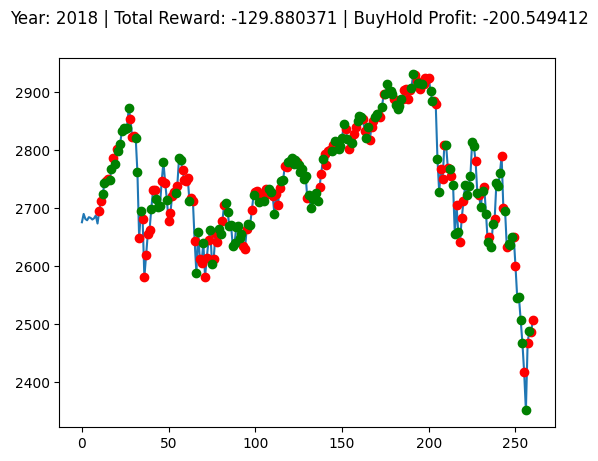

Buy And Hold: 700.9923498535159


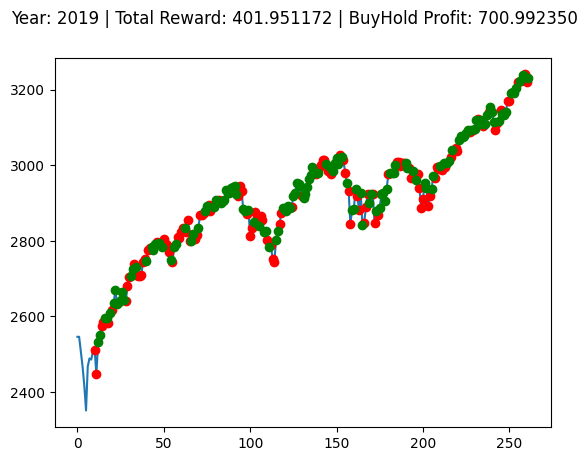

Buy And Hold: 476.9485205078122


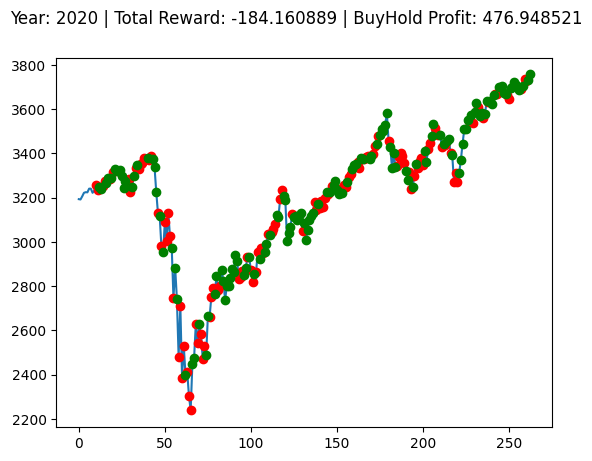

Buy And Hold: 1036.3717211914068


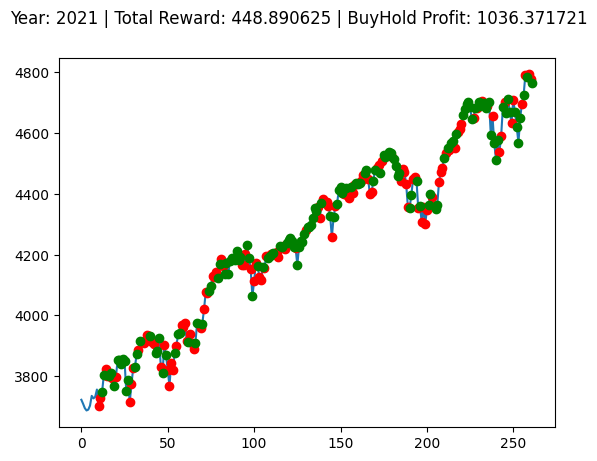

Buy And Hold: -971.472258300781


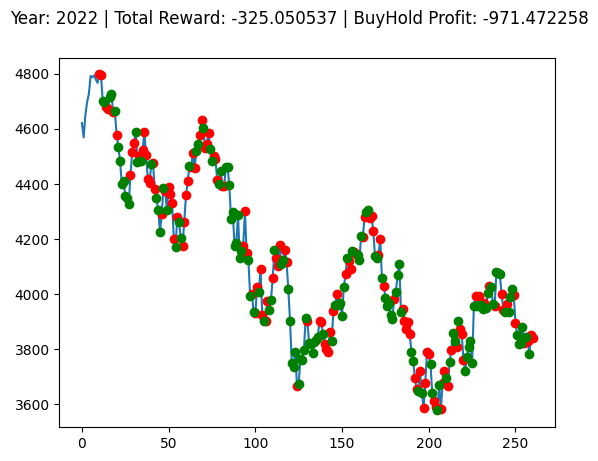

Buy And Hold: 917.112584228516


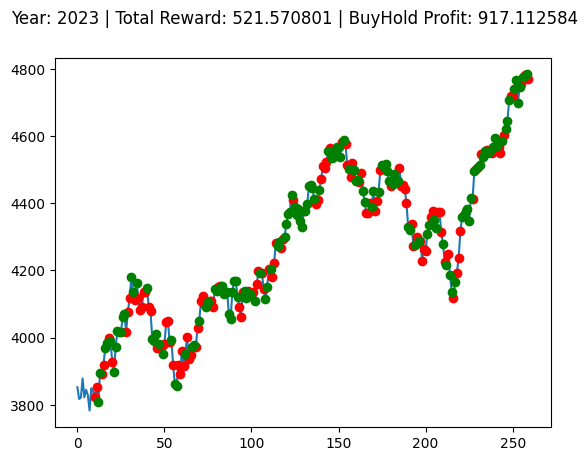

In [ ]:
for env in env_pool:
  observation = env.reset(seed=2023)
  steps = 0
  while True:
      if steps == 0:
        start_price = observation[0][0]
      action = env.action_space.sample()
      observation, reward, terminated, truncated, info = env.step(action)
      done = terminated or truncated
      steps += 1

      # env.render()
      if done:
          end_price = observation[-1][0]
          print("==============================================================")
          print(f"Buy And Hold: {info['buy_hold_profit']}")
          print("==============================================================")
          break

  plt.cla()
  env.unwrapped.render_all()
  plt.show()

#### Encoder Stock Env

In [ ]:
### Load Encoder Model
device = "cuda" if torch.cuda.is_available() else "cpu"
model = StockTrainerTransformerModel(512, device)
path = "/content/drive/MyDrive/code/fintransformer/models/encoder_45days_sp500_eval.pt"
#path = "/content/drive/MyDrive/encoder_45days_sp500_eval.pt"
def load_model(self, path):
    model = StockTrainerTransformerModel(512, device)
    checkpoint = torch.load(path, map_location=torch.device(device))
    model.load_state_dict(checkpoint['model_state_dict'])
    print(f"Model loaded from {path}")
    print(f"Model Accuracy: {checkpoint['acc']}")
    return model

encoder = load_model(model, path)
encoder = model

Model loaded from /content/drive/MyDrive/code/fintransformer/models/encoder_45days_sp500_eval.pt
Model Accuracy: 0.5431952662721894


In [ ]:
def make_encoder_env(min_year, max_year, ticker="^SPX"):
    def thunk():
        data= extract_data("^SPX")
        env = EncoderStocksEnv(
            df=data,
            window_size=10,
            frame_bound=(10, 24232),
            min_year=min_year,
            max_year=max_year,
        )
        return env
    return thunk

In [ ]:
class EncoderAgent(nn.Module):
    def __init__(self, encoder, envs):
        super().__init__()
        self.encoder = encoder
        self.critic = nn.Sequential(
            nn.Conv1d(13, 1, 1, stride=1),
            nn.Tanh(),
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.Linear(512, 1)
        )
        self.actor = nn.Sequential(
            nn.Conv1d(13, 1, 1, stride=1),
            nn.Tanh(),
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.Linear(512, envs.single_action_space.n)
        )

    def get_value(self, x):
        x = self.encoder(x)
        return self.critic(x).squeeze(-1)

    def get_action_and_value(self, x, action=None):
        x = self.encoder(x)
        print(f"encoder out: {x.shape}")
        logits = self.actor(x).squeeze(1)
        #print(f"logits shape: {logits.shape}")
        probs = Categorical(logits=logits)
        if action is None:
            action = probs.sample()
        return action, probs.log_prob(action), probs.entropy(), self.critic(x).squeeze(-1)

In [ ]:
class MultiDimensionalEncoderAgent(nn.Module):
    def __init__(self, encoder, envs):
        super().__init__()
        self.encoder = encoder
        self.conv = nn.Conv1d(4, 1, 1, stride=1)
        self.critic = nn.Sequential(
            nn.Conv1d(10, 1, 1, stride=1),
            nn.Tanh(),
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.Linear(512, 1)
        )
        self.actor = nn.Sequential(
            nn.Conv1d(10, 1, 1, stride=1),
            nn.Tanh(),
            nn.Linear(512, 512),
            nn.Tanh(),
            nn.Linear(512, envs.single_action_space.n)
        )
        self.device = "cuda" if torch.cuda.is_available() else "cpu"

    def get_value(self, x):
        x = torch.Tensor(x).to(self.device)
        x = x.permute(0, 2, 1)
        x = self.conv(x).squeeze(1)
        #print(f"x shape: {x.shape}")
        x = self.encoder(x)
        return self.critic(x).squeeze(-1).squeeze(-1)

    def get_action_and_value(self, x, action=None):
        x = torch.Tensor(x).to(self.device)
        x = x.permute(0, 2, 1)
        x = self.conv(x).squeeze(1)
        #print(f"x shape: {x.shape}")
        #print(f"x: {x}")
        x = self.encoder(x)
        #print(f"encoder out: {x.shape}")
        #print(f"encoder out is nan{torch.isnan(x)}")
        logits = self.actor(x).squeeze(1)
        #print(f"logits shape: {logits.shape}")
        probs = Categorical(logits=logits)
        if action is None:
            action = probs.sample()
        return action, probs.log_prob(action), probs.entropy(), self.critic(x).squeeze(-1).squeeze(-1)

In [ ]:
args = Args()
envs = gym.vector.SyncVectorEnv(
    [make_encoder_env(min_year=args.min_year, max_year=args.max_year, ticker=args.ticker) for i in range(args.num_envs)],
)
print(envs.single_observation_space.shape)

(10, 4)


In [ ]:
next_obs, _ = envs.reset()
next_obs.shape

(4, 10, 4)

In [ ]:
next_obs

array([[[0.4907407 , 0.5336074 , 0.48698622, 0.43822616],
        [0.49382687, 0.53117275, 0.48561633, 0.43808335],
        [0.49382687, 0.52988124, 0.48493138, 0.4380935 ],
        [0.52469116, 0.5224276 , 0.48835605, 0.45334944],
        [0.50617254, 0.5224276 , 0.48835605, 0.45334944],
        [0.47222203, 0.5090147 , 0.48424643, 0.45964292],
        [0.5339503 , 0.50737315, 0.49315056, 0.47979057],
        [0.5339503 , 0.51298237, 0.5020547 , 0.49195984],
        [0.50925905, 0.51098025, 0.49863002, 0.4871085 ],
        [0.43209854, 0.4612706 , 0.48219165, 0.5079451 ]],

       [[0.3933011 , 0.00125693, 0.03593658, 0.07506316],
        [0.4019337 , 0.05350345, 0.07739417, 0.10326155],
        [0.38052475, 0.11675548, 0.10389486, 0.08696485],
        [0.3653313 , 0.14735202, 0.113933  , 0.07316129],
        [0.37258264, 0.16931306, 0.12085927, 0.06266022],
        [0.40711305, 0.16497195, 0.12487447, 0.07619914],
        [0.41609102, 0.15946393, 0.12899007, 0.0912933 ],
        [0.4

In [ ]:
next_obs = torch.Tensor(next_obs).to(device)
encoder = StockTrainerTransformerModel(512, device)
agent = MultiDimensionalEncoderAgent(encoder, envs).to(device)
a, p, _, c = agent.get_action_and_value(next_obs)

In [ ]:
c.shape

torch.Size([4])

In [ ]:
@dataclass
class Args():
    exp_name: str = "S&P500_bollinger_normalized_encoder_run1"
    """the name of this experiment"""
    ticker: str = "^SPX"
    """Ticker of equity"""
    seed: int = 1
    """seed of the experiment"""
    torch_deterministic: bool = True
    """if toggled, `torch.backends.cudnn.deterministic=False`"""
    cuda: bool = True
    """if toggled, cuda will be enabled by default"""
    min_year: int = 1929
    max_year: int = 2023

    # Algorithm specific arguments
    env_id: str = "stocks-v0"
    """the id of the environment"""
    total_timesteps: int = 10000
    """total timesteps of the experiments"""
    learning_rate: float = 2.5e-4
    """the learning rate of the optimizer"""
    num_envs: int = 4
    """the number of parallel game environments"""
    num_steps: int = 365
    """the number of steps to run in each environment per policy rollout"""
    anneal_lr: bool = True
    """Toggle learning rate annealing for policy and value networks"""
    gamma: float = 0.99
    """the discount factor gamma"""
    gae_lambda: float = 0.95
    """the lambda for the general advantage estimation"""
    num_minibatches: int = 4
    """the number of mini-batches"""
    update_epochs: int = 4
    """the K epochs to update the policy"""
    norm_adv: bool = True
    """Toggles advantages normalization"""
    clip_coef: float = 0.2
    """the surrogate clipping coefficient"""
    clip_vloss: bool = True
    """Toggles whether or not to use a clipped loss for the value function, as per the paper."""
    ent_coef: float = 0.01
    """coefficient of the entropy"""
    vf_coef: float = 0.5
    """coefficient of the value function"""
    max_grad_norm: float = 0.5
    """the maximum norm for the gradient clipping"""
    target_kl: float = None
    """the target KL divergence threshold"""

    # to be filled in runtime
    batch_size: int = int(num_envs * num_steps)
    """the batch size (computed in runtime)"""
    minibatch_size: int = int(batch_size // num_minibatches)
    """the mini-batch size (computed in runtime)"""
    num_iterations: int = 1000
    """the number of iterations (computed in runtime)"""

In [ ]:
args = Args
run_name = f"{args.env_id}__{args.exp_name}"

writer = SummaryWriter(f"/content/drive/MyDrive/code/fintransformer/rl_runs/{run_name}") ## main account
#writer = SummaryWriter(f"/content/drive/MyDrive/finrl/{run_name}") ## snu account
writer.add_text(
    "hyperparameters",
    "|param|value|\n|-|-|\n%s" % ("\n".join([f"|{key}|{value}|" for key, value in vars(args).items()])),
)

pretrained_encoder_path = "/content/drive/MyDrive/code/fintransformer/models/encoder_45days_sp500_eval.pt"
try:
  encoder = load_model(model, pretrained_encoder_path)
  print(f"Loaded pretrained encoder model from: {pretrained_encoder_path}")
except:
  encoder = StockTrainerTransformerModel(512, device)
  print("Encoder model is freshly loaded")

# TRY NOT TO MODIFY: seeding
random.seed(args.seed)
np.random.seed(args.seed)
torch.manual_seed(args.seed)
torch.backends.cudnn.deterministic = args.torch_deterministic

device = torch.device("cuda" if torch.cuda.is_available() and args.cuda else "cpu")

envs = gym.vector.SyncVectorEnv(
    [make_encoder_env(min_year=args.min_year, max_year=args.max_year, ticker=args.ticker) for i in range(args.num_envs)],
)
assert isinstance(envs.single_action_space, gym.spaces.Discrete), "only discrete action space is supported"

agent = MultiDimensionalEncoderAgent(encoder, envs).to(device)
optimizer = optim.Adam(agent.parameters(), lr=args.learning_rate, eps=1e-5)

# ALGO Logic: Storage setup
obs = torch.zeros((args.num_steps, args.num_envs) + envs.single_observation_space.shape).to(device)
actions = torch.zeros((args.num_steps, args.num_envs) + envs.single_action_space.shape).to(device)
logprobs = torch.zeros((args.num_steps, args.num_envs)).to(device)
rewards = torch.zeros((args.num_steps, args.num_envs)).to(device)
dones = torch.zeros((args.num_steps, args.num_envs)).to(device)
values = torch.zeros((args.num_steps, args.num_envs)).to(device)

# TRY NOT TO MODIFY: start the game
global_step = 0
start_time = time.time()
next_obs, _ = envs.reset(seed=args.seed)
next_obs = torch.Tensor(next_obs).to(device)
next_done = torch.zeros(args.num_envs).to(device)

loop_range = tqdm.tqdm(range(0, args.num_iterations + 1))
for iteration in loop_range:
    # Annealing the rate if instructed to do so.
    if args.anneal_lr:
        frac = 1.0 - (iteration - 1.0) / args.num_iterations
        lrnow = frac * args.learning_rate
        optimizer.param_groups[0]["lr"] = lrnow


    for step in range(0, args.num_steps):
        global_step += args.num_envs
        obs[step] = next_obs
        dones[step] = next_done

        # ALGO LOGIC: action logic
        with torch.no_grad():
            action, logprob, _, value = agent.get_action_and_value(next_obs)
            values[step] = value.flatten()
        actions[step] = action
        logprobs[step] = logprob

        # TRY NOT TO MODIFY: execute the game and log data.
        next_obs, reward, terminations, truncations, infos = envs.step(action.cpu().numpy())
        next_done = np.logical_or(terminations, truncations)
        rewards[step] = torch.tensor(reward).to(device).view(-1)
        next_obs, next_done = torch.Tensor(next_obs).to(device), torch.Tensor(next_done).to(device)

        #print(f"next_done: {next_done}")
        for idx, d in enumerate(next_done):

            if d:
              for info in infos['final_info']:
                if info is not None:
                  print(f"global_step={global_step}, episodic_return={info['total_reward']}, buyhold={info['buy_hold_profit']}")
                  writer.add_scalar(f"charts/episodic_reward", info["total_reward"], global_step)
                  writer.add_scalar(f"charts/episodic_profit", info["total_profit"], global_step)
                  comparison_benchmark = info["total_reward"] - info["buy_hold_profit"]
                  writer.add_scalar(f"charts/comparison_buyNhold", comparison_benchmark, global_step)

    # bootstrap value if not done
    with torch.no_grad():
        next_value = agent.get_value(next_obs).reshape(1, -1)
        advantages = torch.zeros_like(rewards).to(device)
        lastgaelam = 0
        for t in reversed(range(args.num_steps)):
            if t == args.num_steps - 1:
                nextnonterminal = 1.0 - next_done
                nextvalues = next_value
            else:
                nextnonterminal = 1.0 - dones[t + 1]
                nextvalues = values[t + 1]
            delta = rewards[t] + args.gamma * nextvalues * nextnonterminal - values[t]
            advantages[t] = lastgaelam = delta + args.gamma * args.gae_lambda * nextnonterminal * lastgaelam
        returns = advantages + values

    # flatten the batch
    b_obs = obs.reshape((-1,) + envs.single_observation_space.shape)
    b_logprobs = logprobs.reshape(-1)
    b_actions = actions.reshape((-1,) + envs.single_action_space.shape)
    b_advantages = advantages.reshape(-1)
    b_returns = returns.reshape(-1)
    b_values = values.reshape(-1)

    # Optimizing the policy and value network
    b_inds = np.arange(args.batch_size)
    clipfracs = []
    for epoch in range(args.update_epochs):
        np.random.shuffle(b_inds)
        for start in range(0, args.batch_size, args.minibatch_size):
            end = start + args.minibatch_size
            mb_inds = b_inds[start:end]

            _, newlogprob, entropy, newvalue = agent.get_action_and_value(b_obs[mb_inds], b_actions.long()[mb_inds])
            logratio = newlogprob - b_logprobs[mb_inds]
            ratio = logratio.exp()

            with torch.no_grad():
                # calculate approx_kl http://joschu.net/blog/kl-approx.html
                old_approx_kl = (-logratio).mean()
                approx_kl = ((ratio - 1) - logratio).mean()
                clipfracs += [((ratio - 1.0).abs() > args.clip_coef).float().mean().item()]

            mb_advantages = b_advantages[mb_inds]
            if args.norm_adv:
                mb_advantages = (mb_advantages - mb_advantages.mean()) / (mb_advantages.std() + 1e-8)

            # Policy loss
            pg_loss1 = -mb_advantages * ratio
            pg_loss2 = -mb_advantages * torch.clamp(ratio, 1 - args.clip_coef, 1 + args.clip_coef)
            pg_loss = torch.max(pg_loss1, pg_loss2).mean()

            # Value loss
            newvalue = newvalue.view(-1)
            if args.clip_vloss:
                v_loss_unclipped = (newvalue - b_returns[mb_inds]) ** 2
                v_clipped = b_values[mb_inds] + torch.clamp(
                    newvalue - b_values[mb_inds],
                    -args.clip_coef,
                    args.clip_coef,
                )
                v_loss_clipped = (v_clipped - b_returns[mb_inds]) ** 2
                v_loss_max = torch.max(v_loss_unclipped, v_loss_clipped)
                v_loss = 0.5 * v_loss_max.mean()
            else:
                v_loss = 0.5 * ((newvalue - b_returns[mb_inds]) ** 2).mean()

            entropy_loss = entropy.mean()
            loss = pg_loss - args.ent_coef * entropy_loss + v_loss * args.vf_coef

            optimizer.zero_grad()
            loss.backward()
            nn.utils.clip_grad_norm_(agent.parameters(), args.max_grad_norm)
            optimizer.step()

        if args.target_kl is not None and approx_kl > args.target_kl:
            break

    y_pred, y_true = b_values.cpu().numpy(), b_returns.cpu().numpy()
    var_y = np.var(y_true)
    explained_var = np.nan if var_y == 0 else 1 - np.var(y_true - y_pred) / var_y

    # TRY NOT TO MODIFY: record rewards for plotting purposes
    writer.add_scalar("charts/learning_rate", optimizer.param_groups[0]["lr"], global_step)
    writer.add_scalar("losses/value_loss", v_loss.item(), global_step)
    writer.add_scalar("losses/policy_loss", pg_loss.item(), global_step)
    writer.add_scalar("losses/entropy", entropy_loss.item(), global_step)
    writer.add_scalar("losses/old_approx_kl", old_approx_kl.item(), global_step)
    writer.add_scalar("losses/approx_kl", approx_kl.item(), global_step)
    writer.add_scalar("losses/clipfrac", np.mean(clipfracs), global_step)
    writer.add_scalar("losses/explained_variance", explained_var, global_step)
    print("SPS:", int(global_step / (time.time() - start_time)))
    writer.add_scalar("charts/SPS", int(global_step / (time.time() - start_time)), global_step)

envs.close()
writer.close()

Model loaded from /content/drive/MyDrive/code/fintransformer/models/encoder_45days_sp500_eval.pt
Model Accuracy: 0.5431952662721894
Loaded pretrained encoder model from: /content/drive/MyDrive/code/fintransformer/models/encoder_45days_sp500_eval.pt


  0%|          | 0/1001 [00:00<?, ?it/s]

global_step=1000, episodic_return=0.970001220703125, buyhold=1.5454998874664305
global_step=1004, episodic_return=47.3299560546875, buyhold=75.9325463867188
global_step=1008, episodic_return=12.450027465820312, buyhold=31.206251831054686
global_step=1012, episodic_return=21.43994140625, buyhold=16.179181823730516


  0%|          | 1/1001 [00:46<12:49:29, 46.17s/it]

SPS: 31
global_step=1996, episodic_return=98.870849609375, buyhold=141.2532836914063
global_step=2008, episodic_return=-1.519998550415039, buyhold=-1.824499959945678
global_step=2008, episodic_return=-7.049980163574219, buyhold=-12.316001510620126
global_step=2008, episodic_return=-1.519998550415039, buyhold=-1.824499959945678
global_step=2008, episodic_return=-7.049980163574219, buyhold=-12.316001510620126
global_step=2012, episodic_return=7.909992218017578, buyhold=8.458949546813969


  0%|          | 2/1001 [01:30<12:33:06, 45.23s/it]

SPS: 32
global_step=3004, episodic_return=19.66009521484375, buyhold=88.10133422851561
global_step=3004, episodic_return=-1.9200024604797363, buyhold=-0.6713998675346371
global_step=3004, episodic_return=19.66009521484375, buyhold=88.10133422851561
global_step=3004, episodic_return=-1.9200024604797363, buyhold=-0.6713998675346371
global_step=3012, episodic_return=-4.930000305175781, buyhold=1.7980009078979435
global_step=3020, episodic_return=2.9599456787109375, buyhold=2.347812118530271
global_step=3996, episodic_return=-2.7800064086914062, buyhold=-3.4504487133026096
global_step=4004, episodic_return=-3.770263671875, buyhold=141.6609997558594
global_step=4012, episodic_return=-245.3291015625, buyhold=-200.5494116210939
global_step=4028, episodic_return=13.589935302734375, buyhold=31.206251831054686


  0%|          | 3/1001 [02:14<12:22:08, 44.62s/it]

SPS: 32
global_step=4996, episodic_return=7.66998291015625, buyhold=11.893248043060296
global_step=5008, episodic_return=626.740234375, buyhold=1036.3717211914068
global_step=5016, episodic_return=4.520000457763672, buyhold=14.529547271728518
global_step=5032, episodic_return=50.520263671875, buyhold=96.86326293945308


  0%|          | 4/1001 [02:57<12:12:23, 44.08s/it]

SPS: 32
global_step=5996, episodic_return=0.3299980163574219, buyhold=0.8267501115798943
global_step=6004, episodic_return=-6.260032653808594, buyhold=-12.2709527206421
global_step=6012, episodic_return=-0.9300003051757812, buyhold=-0.6713998675346371
global_step=6036, episodic_return=-3.619999408721924, buyhold=-7.731950492858886
global_step=6992, episodic_return=-1.559999942779541, buyhold=-0.6713998675346371
global_step=7000, episodic_return=152.9599609375, buyhold=141.2532836914063
global_step=7016, episodic_return=-12.7603759765625, buyhold=246.77290252685555
global_step=7036, episodic_return=-2.3100051879882812, buyhold=-5.887500152587892


  0%|          | 5/1001 [03:42<12:12:43, 44.14s/it]

SPS: 32
global_step=7996, episodic_return=-3.7099990844726562, buyhold=-12.316001510620126
global_step=8004, episodic_return=-19.2911376953125, buyhold=213.8450433349608
global_step=8016, episodic_return=-0.779998779296875, buyhold=1.2690983390808128
global_step=8044, episodic_return=2.939910888671875, buyhold=25.632396392822272


  1%|          | 6/1001 [04:26<12:14:00, 44.26s/it]

SPS: 32
global_step=9000, episodic_return=2.5099968910217285, buyhold=-0.6713998675346371
global_step=9000, episodic_return=687.6689453125, buyhold=1036.3717211914068
global_step=9000, episodic_return=2.5099968910217285, buyhold=-0.6713998675346371
global_step=9000, episodic_return=687.6689453125, buyhold=1036.3717211914068
global_step=9028, episodic_return=36.8299560546875, buyhold=115.70625976562496
global_step=9048, episodic_return=0.6700019836425781, buyhold=-6.378899097442627
global_step=10004, episodic_return=21.349990844726562, buyhold=44.62405364990232
global_step=10012, episodic_return=13.380096435546875, buyhold=16.179181823730516
global_step=10032, episodic_return=27.240478515625, buyhold=232.59802429199203
global_step=10052, episodic_return=2.9199981689453125, buyhold=14.529547271728518


  1%|          | 7/1001 [05:09<12:07:39, 43.92s/it]

SPS: 32
global_step=11008, episodic_return=4.120002746582031, buyhold=-21.929995460510256
global_step=11016, episodic_return=3.400005340576172, buyhold=14.529547271728518
global_step=11036, episodic_return=42.439453125, buyhold=-24.40840942382829
global_step=11056, episodic_return=-1.2599906921386719, buyhold=-6.378899097442627


  1%|          | 8/1001 [05:54<12:12:21, 44.25s/it]

SPS: 32
global_step=12016, episodic_return=54.22003173828125, buyhold=-0.6085451507568393
global_step=12020, episodic_return=2.288818359375e-05, buyhold=-12.19239849090576
global_step=12040, episodic_return=-2.3299989700317383, buyhold=-7.731950492858886
global_step=12064, episodic_return=-15.959999084472656, buyhold=17.107301521301267
global_step=13020, episodic_return=185.0596923828125, buyhold=-140.86664184570304
global_step=13024, episodic_return=-44.2100830078125, buyhold=-20.48666931152343
global_step=13036, episodic_return=-0.8100032806396484, buyhold=-1.824499959945678
global_step=13060, episodic_return=-0.239990234375, buyhold=2.623300457000731


  1%|          | 9/1001 [06:38<12:07:38, 44.01s/it]

SPS: 32
global_step=14024, episodic_return=-126.49053955078125, buyhold=176.80798797607417
global_step=14028, episodic_return=166.30078125, buyhold=1036.3717211914068
global_step=14040, episodic_return=-7.52001953125, buyhold=-12.19239849090576
global_step=14060, episodic_return=0.05000114440917969, buyhold=1.5454998874664305


  1%|          | 10/1001 [07:21<12:00:36, 43.63s/it]

SPS: 33
global_step=15032, episodic_return=3.3699951171875, buyhold=10.3748448562622
global_step=15032, episodic_return=628.339599609375, buyhold=1036.3717211914068
global_step=15032, episodic_return=3.3699951171875, buyhold=10.3748448562622
global_step=15032, episodic_return=628.339599609375, buyhold=1036.3717211914068
global_step=15048, episodic_return=65.48095703125, buyhold=476.9485205078122
global_step=15068, episodic_return=38.750091552734375, buyhold=28.58240722656251
global_step=16040, episodic_return=12.35992431640625, buyhold=25.632396392822272
global_step=16040, episodic_return=-19.270050048828125, buyhold=28.58240722656251
global_step=16040, episodic_return=12.35992431640625, buyhold=25.632396392822272
global_step=16040, episodic_return=-19.270050048828125, buyhold=28.58240722656251
global_step=16052, episodic_return=116.2998046875, buyhold=215.4908227539063


  1%|          | 11/1001 [08:05<12:05:54, 43.99s/it]

SPS: 33
global_step=16068, episodic_return=-0.5299930572509766, buyhold=-1.8454014396667482
global_step=17040, episodic_return=-4.4000091552734375, buyhold=15.52720394134522
global_step=17044, episodic_return=1.699981689453125, buyhold=7.696846961975098
global_step=17056, episodic_return=46.3800048828125, buyhold=96.86326293945308
global_step=17080, episodic_return=-17.400146484375, buyhold=16.179181823730516


  1%|          | 12/1001 [08:49<12:02:06, 43.81s/it]

SPS: 33
global_step=18044, episodic_return=-1.3000059127807617, buyhold=3.074450340270997
global_step=18048, episodic_return=5.830078125, buyhold=28.58240722656251
global_step=18052, episodic_return=-2.6199951171875, buyhold=10.614249076843251
global_step=18060, episodic_return=-3.5, buyhold=96.86326293945308


  1%|▏         | 13/1001 [09:32<11:58:55, 43.66s/it]

SPS: 33
global_step=19052, episodic_return=-0.5899696350097656, buyhold=-2.0815492439270074
global_step=19052, episodic_return=-9.110107421875, buyhold=-30.97375122070315
global_step=19052, episodic_return=-0.5899696350097656, buyhold=-2.0815492439270074
global_step=19052, episodic_return=-9.110107421875, buyhold=-30.97375122070315
global_step=19060, episodic_return=5.800018310546875, buyhold=29.171192436218263
global_step=19068, episodic_return=-3.149993896484375, buyhold=17.107301521301267
global_step=20044, episodic_return=1.7499980926513672, buyhold=2.866149997711183
global_step=20056, episodic_return=-43.7293701171875, buyhold=215.4908227539063
global_step=20068, episodic_return=4.810035705566406, buyhold=19.409249076843267
global_step=20072, episodic_return=355.7904052734375, buyhold=232.59802429199203


  1%|▏         | 14/1001 [10:15<11:56:12, 43.54s/it]

SPS: 33
global_step=21044, episodic_return=-95.470703125, buyhold=-200.5494116210939
global_step=21060, episodic_return=36.3294677734375, buyhold=-24.40840942382829
global_step=21064, episodic_return=1086.50830078125, buyhold=917.112584228516
global_step=21080, episodic_return=6.2399749755859375, buyhold=15.93989757537841


  1%|▏         | 15/1001 [10:59<11:55:53, 43.56s/it]

SPS: 33
global_step=22044, episodic_return=1.8000030517578125, buyhold=-2.09265018939972
global_step=22064, episodic_return=12.4000244140625, buyhold=44.62405364990232
global_step=22068, episodic_return=112.5306396484375, buyhold=374.76844177246085
global_step=22084, episodic_return=-26.869964599609375, buyhold=-8.435513305664074
global_step=23044, episodic_return=0.6899971961975098, buyhold=0.8267501115798943
global_step=23060, episodic_return=0.37999725341796875, buyhold=1.7468510961532573
global_step=23072, episodic_return=28.269989013671875, buyhold=152.9562573242187
global_step=23092, episodic_return=1.0999984741210938, buyhold=10.614249076843251


  2%|▏         | 16/1001 [11:42<11:52:25, 43.40s/it]

SPS: 33
global_step=24052, episodic_return=5.870002746582031, buyhold=15.93989757537841
global_step=24068, episodic_return=-1.850067138671875, buyhold=88.10133422851561
global_step=24072, episodic_return=64.591552734375, buyhold=-971.472258300781
global_step=24088, episodic_return=1.970001220703125, buyhold=-0.6713998675346371


  2%|▏         | 17/1001 [12:26<11:57:00, 43.72s/it]

SPS: 33
global_step=24972, episodic_return=2.480010986328125, buyhold=7.191949996948239
global_step=25056, episodic_return=42.840057373046875, buyhold=75.9325463867188
global_step=25060, episodic_return=-1.7300033569335938, buyhold=-0.6544496583938599
global_step=25092, episodic_return=-127.228271484375, buyhold=700.9923498535159
global_step=25972, episodic_return=47.340576171875, buyhold=44.159409790039035
global_step=26060, episodic_return=93.8602294921875, buyhold=96.86326293945308
global_step=26064, episodic_return=41.17987060546875, buyhold=196.31596435546874
global_step=26100, episodic_return=6.0699920654296875, buyhold=10.614249076843251


  2%|▏         | 18/1001 [13:10<11:56:07, 43.71s/it]

SPS: 33
global_step=26976, episodic_return=-87.9703369140625, buyhold=-20.48666931152343
global_step=27052, episodic_return=0.67999267578125, buyhold=3.6490004539489718
global_step=27056, episodic_return=-0.23000335693359375, buyhold=3.6490004539489718
global_step=27108, episodic_return=26.42999267578125, buyhold=28.58240722656251


  2%|▏         | 19/1001 [13:53<11:51:07, 43.45s/it]

SPS: 33
global_step=27980, episodic_return=5.280006408691406, buyhold=14.529547271728518
global_step=28052, episodic_return=-9.36001205444336, buyhold=-5.887500152587892
global_step=28060, episodic_return=5.329999923706055, buyhold=10.794948787689208
global_step=28112, episodic_return=247.21038818359375, buyhold=246.77290252685555
global_step=28984, episodic_return=16.27978515625, buyhold=232.59802429199203
global_step=29056, episodic_return=3.5899887084960938, buyhold=14.529547271728518
global_step=29068, episodic_return=19.32000732421875, buyhold=29.171192436218263
global_step=29116, episodic_return=-27.590118408203125, buyhold=-8.435513305664074


  2%|▏         | 20/1001 [14:36<11:47:13, 43.26s/it]

SPS: 33
global_step=29988, episodic_return=0.28997039794921875, buyhold=-21.929995460510256
global_step=30060, episodic_return=170.23974609375, buyhold=-277.8748864746094
global_step=30076, episodic_return=-8.919979095458984, buyhold=-29.3172027206421
global_step=30124, episodic_return=5.050079345703125, buyhold=-0.6085451507568393


  2%|▏         | 21/1001 [15:19<11:48:20, 43.37s/it]

SPS: 33
global_step=30988, episodic_return=3.3199920654296875, buyhold=11.893248043060296
global_step=31064, episodic_return=32.4996337890625, buyhold=374.76844177246085
global_step=31080, episodic_return=103.370361328125, buyhold=232.59802429199203
global_step=31124, episodic_return=112.2802734375, buyhold=141.6609997558594
global_step=31988, episodic_return=-39.089599609375, buyhold=-971.472258300781
global_step=32056, episodic_return=-4.780002593994141, buyhold=-3.4504487133026096
global_step=32084, episodic_return=1.470001220703125, buyhold=1.7980009078979435
global_step=32120, episodic_return=-1.828125, buyhold=917.112584228516


  2%|▏         | 22/1001 [16:03<11:50:33, 43.55s/it]

SPS: 33
global_step=32992, episodic_return=-28.51007080078125, buyhold=-8.435513305664074
global_step=33036, episodic_return=1.4499921798706055, buyhold=3.9230506801605216
global_step=33088, episodic_return=53.549774169921875, buyhold=152.9562573242187
global_step=33124, episodic_return=-258.2003173828125, buyhold=-140.86664184570304


  2%|▏         | 23/1001 [16:48<11:53:30, 43.77s/it]

SPS: 33
global_step=33996, episodic_return=-1.9799995422363281, buyhold=8.458949546813969
global_step=34044, episodic_return=-3.3599853515625, buyhold=25.632396392822272
global_step=34096, episodic_return=-0.6300039291381836, buyhold=3.675200681686402
global_step=34132, episodic_return=-36.109954833984375, buyhold=-30.97375122070315
global_step=35004, episodic_return=-0.779998779296875, buyhold=19.409249076843267
global_step=35032, episodic_return=-315.45025634765625, buyhold=-140.2545129394532


  2%|▏         | 24/1001 [17:32<11:56:59, 44.03s/it]

SPS: 33
global_step=35100, episodic_return=-3.9500732421875, buyhold=232.59802429199203
global_step=35136, episodic_return=0.6999988555908203, buyhold=10.794948787689208
global_step=36012, episodic_return=-14.989898681640625, buyhold=28.58240722656251
global_step=36040, episodic_return=0.109954833984375, buyhold=-14.33379333496093
global_step=36108, episodic_return=32.870025634765625, buyhold=88.10133422851561
global_step=36144, episodic_return=-4.04998779296875, buyhold=-29.3172027206421


  2%|▏         | 25/1001 [18:16<11:53:49, 43.88s/it]

SPS: 33
global_step=37020, episodic_return=25.59002685546875, buyhold=17.107301521301267
global_step=37044, episodic_return=-0.3800048828125, buyhold=-21.929995460510256
global_step=37100, episodic_return=-2.2600059509277344, buyhold=-3.4504487133026096
global_step=37152, episodic_return=48.8299560546875, buyhold=227.40073303222653


  3%|▎         | 26/1001 [18:59<11:48:26, 43.60s/it]

SPS: 33
global_step=38024, episodic_return=-24.25946044921875, buyhold=246.77290252685555
global_step=38052, episodic_return=-141.87957763671875, buyhold=-545.706734008789
global_step=38100, episodic_return=91.04931640625, buyhold=44.159409790039035
global_step=38160, episodic_return=4.4899749755859375, buyhold=10.3748448562622
global_step=39032, episodic_return=-40.639892578125, buyhold=-0.6085451507568393
global_step=39056, episodic_return=52.2901611328125, buyhold=39.73758239746098
global_step=39096, episodic_return=-2.2000021934509277, buyhold=-0.6713998675346371
global_step=39164, episodic_return=7.2400054931640625, buyhold=14.529547271728518


  3%|▎         | 27/1001 [19:43<11:49:38, 43.71s/it]

SPS: 33
global_step=40036, episodic_return=-49.710205078125, buyhold=117.73857421875005
global_step=40048, episodic_return=-0.7300071716308594, buyhold=2.866149997711183
global_step=40100, episodic_return=51.0596923828125, buyhold=232.59802429199203
global_step=40168, episodic_return=1.16986083984375, buyhold=196.31596435546874


  3%|▎         | 28/1001 [20:26<11:46:58, 43.60s/it]

SPS: 33
global_step=41032, episodic_return=0.10000228881835938, buyhold=2.623300457000731
global_step=41048, episodic_return=-0.3300027847290039, buyhold=-2.09265018939972
global_step=41104, episodic_return=266.7496337890625, buyhold=232.59802429199203
global_step=41164, episodic_return=4.969993591308594, buyhold=13.552353324890142
global_step=41996, episodic_return=1.8000030517578125, buyhold=3.074450340270997
global_step=42052, episodic_return=103.288330078125, buyhold=-24.40840942382829
global_step=42100, episodic_return=-1.480001449584961, buyhold=2.541199884414672
global_step=42156, episodic_return=-0.04000282287597656, buyhold=-0.6791998863220226


  3%|▎         | 29/1001 [21:10<11:48:07, 43.71s/it]

SPS: 33
global_step=43000, episodic_return=-4.360002040863037, buyhold=-7.731950492858886
global_step=43060, episodic_return=32.3399658203125, buyhold=31.206251831054686
global_step=43100, episodic_return=-2.9999876022338867, buyhold=-5.887500152587892
global_step=43164, episodic_return=1.3800582885742188, buyhold=8.849649696350099


  3%|▎         | 30/1001 [21:54<11:48:49, 43.80s/it]

SPS: 33
global_step=44004, episodic_return=1.7500114440917969, buyhold=-2.0815492439270074
global_step=44060, episodic_return=0.4799957275390625, buyhold=11.893248043060296
global_step=44096, episodic_return=1.5300006866455078, buyhold=1.6828999996185292
global_step=44172, episodic_return=-39.2298583984375, buyhold=-545.706734008789
global_step=45000, episodic_return=1.5000019073486328, buyhold=2.623300457000731
global_step=45064, episodic_return=-13.709976196289062, buyhold=-21.929995460510256
global_step=45100, episodic_return=3.8100433349609375, buyhold=-12.19239849090576
global_step=45168, episodic_return=-4.3499956130981445, buyhold=-6.400850114822386


  3%|▎         | 31/1001 [22:38<11:49:02, 43.86s/it]

SPS: 33
global_step=45992, episodic_return=3.480009078979492, buyhold=3.6490004539489718
global_step=46060, episodic_return=0.6400003433227539, buyhold=1.7468510961532573
global_step=46096, episodic_return=3.2000045776367188, buyhold=13.552353324890142
global_step=46180, episodic_return=43.519287109375, buyhold=115.70625976562496


  3%|▎         | 32/1001 [23:21<11:45:32, 43.69s/it]

SPS: 33
global_step=46984, episodic_return=4.739994049072266, buyhold=3.6490004539489718
global_step=47064, episodic_return=166.0902099609375, buyhold=374.76844177246085
global_step=47096, episodic_return=4.269996643066406, buyhold=11.893248043060296
global_step=47184, episodic_return=85.2001953125, buyhold=-20.48666931152343
global_step=47992, episodic_return=395.22998046875, buyhold=476.9485205078122
global_step=48068, episodic_return=-12.449989318847656, buyhold=-12.19239849090576
global_step=48104, episodic_return=-63.51002502441406, buyhold=-0.6085451507568393


  3%|▎         | 33/1001 [24:05<11:44:19, 43.66s/it]

SPS: 33
global_step=48184, episodic_return=-4.0205078125, buyhold=-200.5494116210939
global_step=49004, episodic_return=-6.769981384277344, buyhold=-1.3064984893798766
global_step=49080, episodic_return=-9.100006103515625, buyhold=16.179181823730516
global_step=49108, episodic_return=45.3199462890625, buyhold=75.9325463867188
global_step=49180, episodic_return=2.1399946212768555, buyhold=1.6828999996185292


  3%|▎         | 34/1001 [24:50<11:50:12, 44.07s/it]

SPS: 33
global_step=49980, episodic_return=13.510017395019531, buyhold=7.191949996948239
global_step=50000, episodic_return=2.049999237060547, buyhold=-0.6713998675346371
global_step=50112, episodic_return=2.670013427734375, buyhold=1.7980009078979435
global_step=50180, episodic_return=13.080024719238281, buyhold=15.707854843139643
global_step=50988, episodic_return=15.120033264160156, buyhold=17.107301521301267
global_step=51000, episodic_return=-1.6999988555908203, buyhold=-1.8454014396667482


  3%|▎         | 35/1001 [25:35<11:54:37, 44.39s/it]

SPS: 33
global_step=51116, episodic_return=-11.430004119873047, buyhold=-8.136200599670403
global_step=51180, episodic_return=-0.13000106811523438, buyhold=0.8267501115798943
global_step=51984, episodic_return=8.870010375976562, buyhold=13.552353324890142
global_step=52000, episodic_return=-741.569091796875, buyhold=-971.472258300781
global_step=52120, episodic_return=-6.790008544921875, buyhold=-8.435513305664074
global_step=52184, episodic_return=8.66000747680664, buyhold=8.458949546813969


  4%|▎         | 36/1001 [26:21<12:03:31, 44.99s/it]

SPS: 33
global_step=52984, episodic_return=83.909912109375, buyhold=141.6609997558594
global_step=53008, episodic_return=4.0699462890625, buyhold=2.347812118530271
global_step=53124, episodic_return=-6.37000036239624, buyhold=-7.731950492858886
global_step=53188, episodic_return=-0.6199836730957031, buyhold=-6.378899097442627
global_step=53988, episodic_return=-5.059998512268066, buyhold=-7.731950492858886
global_step=54016, episodic_return=6.7200164794921875, buyhold=10.614249076843251


  4%|▎         | 37/1001 [27:05<11:56:49, 44.62s/it]

SPS: 33
global_step=54120, episodic_return=-0.5200004577636719, buyhold=0.023000378608703187
global_step=54152, episodic_return=3.0300002098083496, buyhold=3.074450340270997
global_step=54992, episodic_return=723.86083984375, buyhold=1036.3717211914068
global_step=55012, episodic_return=1.5600004196166992, buyhold=1.7468510961532573
global_step=55128, episodic_return=37.620025634765625, buyhold=31.206251831054686
global_step=55156, episodic_return=654.759765625, buyhold=700.9923498535159


  4%|▍         | 38/1001 [27:48<11:49:32, 44.21s/it]

SPS: 33
global_step=56000, episodic_return=26.65008544921875, buyhold=28.58240722656251
global_step=56016, episodic_return=137.699951171875, buyhold=-24.40840942382829
global_step=56136, episodic_return=18.940017700195312, buyhold=25.632396392822272
global_step=56160, episodic_return=22.10015869140625, buyhold=246.77290252685555


  4%|▍         | 39/1001 [28:34<11:54:32, 44.57s/it]

SPS: 33
global_step=57004, episodic_return=-7.949989318847656, buyhold=-6.378899097442627
global_step=57020, episodic_return=133.2501220703125, buyhold=176.80798797607417
global_step=57136, episodic_return=278.769775390625, buyhold=400.33307861328103
global_step=57164, episodic_return=153.32998657226562, buyhold=152.9562573242187
global_step=58012, episodic_return=43.899993896484375, buyhold=31.206251831054686
global_step=58024, episodic_return=-4.149982452392578, buyhold=-6.378899097442627
global_step=58148, episodic_return=55.6298828125, buyhold=115.70625976562496
global_step=58160, episodic_return=112.23974609375, buyhold=141.2532836914063


  4%|▍         | 40/1001 [29:19<11:54:30, 44.61s/it]

SPS: 33
global_step=59008, episodic_return=-0.4700031280517578, buyhold=-0.6713998675346371
global_step=59032, episodic_return=7.040000915527344, buyhold=10.614249076843251
global_step=59152, episodic_return=110.180419921875, buyhold=-24.40840942382829
global_step=59164, episodic_return=-320.30987548828125, buyhold=-277.8748864746094


  4%|▍         | 41/1001 [30:02<11:48:22, 44.27s/it]

SPS: 33
global_step=60020, episodic_return=-0.17999267578125, buyhold=-1.3064984893798766
global_step=60036, episodic_return=340.869873046875, buyhold=374.76844177246085
global_step=60156, episodic_return=167.03009033203125, buyhold=176.80798797607417
global_step=60172, episodic_return=13.420013427734375, buyhold=25.632396392822272
global_step=61028, episodic_return=3.460000991821289, buyhold=3.675200681686402
global_step=61032, episodic_return=774.650146484375, buyhold=917.112584228516
global_step=61152, episodic_return=3.2400007247924805, buyhold=3.9230506801605216
global_step=61156, episodic_return=13.709999084472656, buyhold=15.52720394134522


  4%|▍         | 42/1001 [30:46<11:46:42, 44.21s/it]

SPS: 33
global_step=62028, episodic_return=4.010001182556152, buyhold=3.833250074386598
global_step=62028, episodic_return=0.80999755859375, buyhold=1.2690983390808128
global_step=62028, episodic_return=4.010001182556152, buyhold=3.833250074386598
global_step=62028, episodic_return=0.80999755859375, buyhold=1.2690983390808128
global_step=62052, episodic_return=18.04003143310547, buyhold=7.191949996948239
global_step=62152, episodic_return=2.599996566772461, buyhold=2.541199884414672


  4%|▍         | 43/1001 [31:30<11:42:13, 43.98s/it]

SPS: 33
global_step=62928, episodic_return=10.949989318847656, buyhold=7.191949996948239
global_step=63024, episodic_return=1.8199996948242188, buyhold=2.541199884414672
global_step=63052, episodic_return=17.81000518798828, buyhold=15.52720394134522
global_step=63148, episodic_return=1.5100040435791016, buyhold=1.7468510961532573
global_step=63936, episodic_return=12.510009765625, buyhold=17.107301521301267
global_step=64012, episodic_return=-160.7603759765625, buyhold=-140.2545129394532
global_step=64048, episodic_return=8.899986267089844, buyhold=13.552353324890142
global_step=64128, episodic_return=3.119999885559082, buyhold=3.9230506801605216


  4%|▍         | 44/1001 [32:13<11:38:51, 43.82s/it]

SPS: 33
global_step=64936, episodic_return=-6.3899993896484375, buyhold=-5.887500152587892
global_step=65012, episodic_return=1.8399996757507324, buyhold=3.074450340270997
global_step=65016, episodic_return=-25.9097900390625, buyhold=-140.86664184570304
global_step=65132, episodic_return=122.4503173828125, buyhold=96.86326293945308


  4%|▍         | 45/1001 [32:58<11:44:07, 44.19s/it]

SPS: 33
global_step=65936, episodic_return=2.4099998474121094, buyhold=1.2690983390808128
global_step=66000, episodic_return=-78.2601318359375, buyhold=-140.2545129394532
global_step=66024, episodic_return=10.149917602539062, buyhold=-0.6085451507568393
global_step=66124, episodic_return=3.390003204345703, buyhold=3.6490004539489718
global_step=66940, episodic_return=629.860107421875, buyhold=700.9923498535159
global_step=67008, episodic_return=-736.360107421875, buyhold=-545.706734008789
global_step=67028, episodic_return=-6.800079345703125, buyhold=-8.435513305664074
global_step=67088, episodic_return=4.389998912811279, buyhold=3.074450340270997


  5%|▍         | 46/1001 [33:42<11:39:54, 43.97s/it]

SPS: 33
global_step=67944, episodic_return=-10.860000610351562, buyhold=-12.316001510620126
global_step=68012, episodic_return=8.510002136230469, buyhold=10.794948787689208
global_step=68032, episodic_return=-17.8800048828125, buyhold=-21.929995460510256
global_step=68084, episodic_return=-1.8000001907348633, buyhold=-1.824499959945678


  5%|▍         | 47/1001 [34:25<11:35:51, 43.76s/it]

SPS: 33
global_step=68948, episodic_return=12.19000244140625, buyhold=8.458949546813969
global_step=69016, episodic_return=-244.2900390625, buyhold=-277.8748864746094
global_step=69036, episodic_return=-32.079833984375, buyhold=-24.40840942382829
global_step=69092, episodic_return=1.1199951171875, buyhold=2.347812118530271
global_step=69952, episodic_return=43.8099365234375, buyhold=96.86326293945308
global_step=70016, episodic_return=-0.9199962615966797, buyhold=-1.8454014396667482
global_step=70048, episodic_return=14.949981689453125, buyhold=16.179181823730516


  5%|▍         | 48/1001 [35:08<11:31:17, 43.52s/it]

SPS: 33
global_step=70092, episodic_return=0.6000022888183594, buyhold=0.8267501115798943
global_step=70956, episodic_return=219.4097900390625, buyhold=215.4908227539063
global_step=71020, episodic_return=3.3800125122070312, buyhold=1.7980009078979435
global_step=71052, episodic_return=-8.130027770996094, buyhold=-12.19239849090576
global_step=71100, episodic_return=37.759979248046875, buyhold=28.58240722656251


  5%|▍         | 49/1001 [35:52<11:35:12, 43.82s/it]

SPS: 33
global_step=71968, episodic_return=10.02996826171875, buyhold=16.179181823730516
global_step=72024, episodic_return=-7.120002746582031, buyhold=-7.731950492858886
global_step=72064, episodic_return=-11.84002685546875, buyhold=-1.3064984893798766
global_step=72100, episodic_return=42.8602294921875, buyhold=44.159409790039035
global_step=72976, episodic_return=18.919967651367188, buyhold=29.171192436218263


  5%|▍         | 50/1001 [36:36<11:33:47, 43.77s/it]

SPS: 33
global_step=73028, episodic_return=7.589996337890625, buyhold=7.696846961975098
global_step=73068, episodic_return=-9.819998741149902, buyhold=-7.731950492858886
global_step=73096, episodic_return=0.5799980163574219, buyhold=1.7468510961532573
global_step=73980, episodic_return=7.510002136230469, buyhold=10.794948787689208
global_step=74040, episodic_return=-5.3600006103515625, buyhold=-1.3064984893798766
global_step=74056, episodic_return=-303.99993896484375, buyhold=-140.2545129394532
global_step=74092, episodic_return=-0.3899974822998047, buyhold=-2.0167498111724864


  5%|▌         | 51/1001 [37:20<11:33:57, 43.83s/it]

SPS: 33
global_step=74980, episodic_return=9.949996948242188, buyhold=15.707854843139643
global_step=75048, episodic_return=29.339996337890625, buyhold=25.632396392822272
global_step=75056, episodic_return=3.5300025939941406, buyhold=1.2690983390808128
global_step=75092, episodic_return=9.479988098144531, buyhold=11.893248043060296


  5%|▌         | 52/1001 [38:04<11:32:25, 43.78s/it]

SPS: 33
global_step=75984, episodic_return=106.359619140625, buyhold=-24.40840942382829
global_step=76044, episodic_return=-2.070000648498535, buyhold=-1.824499959945678
global_step=76060, episodic_return=-11.169998168945312, buyhold=-12.316001510620126
global_step=76096, episodic_return=102.06982421875, buyhold=232.59802429199203
global_step=76988, episodic_return=-24.509994506835938, buyhold=-21.929995460510256
global_step=77048, episodic_return=138.5902099609375, buyhold=213.8450433349608
global_step=77068, episodic_return=245.2099609375, buyhold=227.40073303222653
global_step=77104, episodic_return=49.140045166015625, buyhold=88.10133422851561


  5%|▌         | 53/1001 [38:47<11:27:33, 43.52s/it]

SPS: 33
global_step=77996, episodic_return=202.2698974609375, buyhold=227.40073303222653
global_step=78056, episodic_return=3.0999984741210938, buyhold=4.128300762176508
global_step=78064, episodic_return=-6.010002136230469, buyhold=-6.400850114822386
global_step=78108, episodic_return=1125.291259765625, buyhold=1036.3717211914068


  5%|▌         | 54/1001 [39:29<11:24:15, 43.35s/it]

SPS: 33
global_step=78988, episodic_return=-0.7299995422363281, buyhold=-0.6544496583938599
global_step=79048, episodic_return=-1.0, buyhold=-0.6791998863220226
global_step=79060, episodic_return=-2.209996223449707, buyhold=-2.0167498111724864
global_step=79100, episodic_return=2.960000991821289, buyhold=3.6490004539489718
global_step=79980, episodic_return=2.1600112915039062, buyhold=3.6490004539489718
global_step=80056, episodic_return=154.80010986328125, buyhold=227.40073303222653
global_step=80060, episodic_return=-0.100006103515625, buyhold=1.2690983390808128
global_step=80100, episodic_return=7.4600067138671875, buyhold=11.893248043060296


  5%|▌         | 55/1001 [40:12<11:21:37, 43.23s/it]

SPS: 33
global_step=80988, episodic_return=8.980010986328125, buyhold=10.3748448562622
global_step=81060, episodic_return=122.5400390625, buyhold=39.73758239746098
global_step=81068, episodic_return=29.790069580078125, buyhold=28.58240722656251
global_step=81096, episodic_return=13.66000747680664, buyhold=13.552353324890142


  6%|▌         | 56/1001 [40:57<11:25:24, 43.52s/it]

SPS: 33
global_step=81996, episodic_return=11.899978637695312, buyhold=15.93989757537841
global_step=82060, episodic_return=14.029998779296875, buyhold=15.707854843139643
global_step=82068, episodic_return=13.480064392089844, buyhold=15.707854843139643
global_step=82092, episodic_return=1.279998779296875, buyhold=1.6828999996185292
global_step=83000, episodic_return=-7.010017395019531, buyhold=-12.19239849090576
global_step=83068, episodic_return=126.6702880859375, buyhold=141.6609997558594
global_step=83068, episodic_return=1.55999755859375, buyhold=4.128300762176508
global_step=83068, episodic_return=126.6702880859375, buyhold=141.6609997558594
global_step=83068, episodic_return=1.55999755859375, buyhold=4.128300762176508
global_step=83100, episodic_return=385.23974609375, buyhold=476.9485205078122


  6%|▌         | 57/1001 [41:40<11:22:32, 43.38s/it]

SPS: 33
global_step=84008, episodic_return=46.050018310546875, buyhold=88.10133422851561
global_step=84064, episodic_return=-1.030003547668457, buyhold=-2.0167498111724864
global_step=84072, episodic_return=113.92999267578125, buyhold=196.31596435546874
global_step=84104, episodic_return=242.97998046875, buyhold=232.59802429199203


  6%|▌         | 58/1001 [42:22<11:19:03, 43.21s/it]

SPS: 33
global_step=85008, episodic_return=1.2100005149841309, buyhold=0.8267501115798943
global_step=85064, episodic_return=-0.8200016021728516, buyhold=-0.6544496583938599
global_step=85076, episodic_return=-1.3100051879882812, buyhold=-1.3064984893798766
global_step=85112, episodic_return=-7.229972839355469, buyhold=-14.33379333496093
global_step=86004, episodic_return=2.700000762939453, buyhold=2.541199884414672
global_step=86068, episodic_return=-13.769996643066406, buyhold=-12.316001510620126
global_step=86072, episodic_return=-0.07000064849853516, buyhold=0.023000378608703187
global_step=86092, episodic_return=3.2600011825561523, buyhold=3.9230506801605216


  6%|▌         | 59/1001 [43:06<11:20:14, 43.33s/it]

SPS: 33
global_step=87004, episodic_return=10.549964904785156, buyhold=15.707854843139643
global_step=87064, episodic_return=0.8599987030029297, buyhold=1.6828999996185292
global_step=87072, episodic_return=17.0098876953125, buyhold=44.159409790039035
global_step=87096, episodic_return=97.079833984375, buyhold=96.86326293945308


  6%|▌         | 60/1001 [43:50<11:22:09, 43.50s/it]

SPS: 33
global_step=88008, episodic_return=-10.320014953613281, buyhold=-12.316001510620126
global_step=88060, episodic_return=1.7999982833862305, buyhold=2.541199884414672
global_step=88076, episodic_return=-140.58001708984375, buyhold=-277.8748864746094
global_step=88100, episodic_return=27.6396484375, buyhold=232.59802429199203
global_step=89012, episodic_return=-2.9199981689453125, buyhold=-6.378899097442627
global_step=89048, episodic_return=-184.19989013671875, buyhold=-140.2545129394532


  6%|▌         | 61/1001 [44:33<11:21:27, 43.50s/it]

SPS: 33
global_step=89068, episodic_return=-1.779998779296875, buyhold=-0.6791998863220226
global_step=89100, episodic_return=9.819999694824219, buyhold=11.893248043060296
global_step=90020, episodic_return=17.839996337890625, buyhold=19.409249076843267
global_step=90052, episodic_return=-8.80999755859375, buyhold=-12.19239849090576
global_step=90056, episodic_return=-133.83013916015625, buyhold=-140.2545129394532
global_step=90108, episodic_return=214.48992919921875, buyhold=227.40073303222653


  6%|▌         | 62/1001 [45:17<11:23:12, 43.66s/it]

SPS: 33
global_step=91016, episodic_return=1.7600021362304688, buyhold=1.6828999996185292
global_step=91060, episodic_return=-25.33001708984375, buyhold=-0.6085451507568393
global_step=91064, episodic_return=7.159996032714844, buyhold=8.849649696350099
global_step=91108, episodic_return=0.5799984931945801, buyhold=0.8267501115798943


  6%|▋         | 63/1001 [46:01<11:23:17, 43.71s/it]

SPS: 33
global_step=92008, episodic_return=-0.7399997711181641, buyhold=-0.6544496583938599
global_step=92064, episodic_return=-6.209997177124023, buyhold=-5.887500152587892
global_step=92064, episodic_return=-7.890007019042969, buyhold=-12.19239849090576
global_step=92064, episodic_return=-6.209997177124023, buyhold=-5.887500152587892
global_step=92064, episodic_return=-7.890007019042969, buyhold=-12.19239849090576
global_step=92108, episodic_return=94.1497802734375, buyhold=44.159409790039035
global_step=93012, episodic_return=169.669677734375, buyhold=215.4908227539063
global_step=93064, episodic_return=-5.85999870300293, buyhold=-5.887500152587892
global_step=93064, episodic_return=-3.5199995040893555, buyhold=-2.09265018939972
global_step=93064, episodic_return=-5.85999870300293, buyhold=-5.887500152587892
global_step=93064, episodic_return=-3.5199995040893555, buyhold=-2.09265018939972
global_step=93116, episodic_return=-17.40998077392578, buyhold=-14.33379333496093


  6%|▋         | 64/1001 [46:45<11:22:45, 43.72s/it]

SPS: 33
global_step=94008, episodic_return=1.3099985122680664, buyhold=1.6828999996185292
global_step=94056, episodic_return=-1.5500001907348633, buyhold=-0.6544496583938599
global_step=94064, episodic_return=-2.020000457763672, buyhold=-1.8454014396667482
global_step=94124, episodic_return=2.8200035095214844, buyhold=4.128300762176508


  6%|▋         | 65/1001 [47:29<11:20:45, 43.64s/it]

SPS: 33
global_step=95012, episodic_return=29.309814453125, buyhold=96.86326293945308
global_step=95060, episodic_return=1.110001564025879, buyhold=1.7468510961532573
global_step=95064, episodic_return=8.590003967285156, buyhold=17.107301521301267
global_step=95120, episodic_return=1.169999122619629, buyhold=1.6828999996185292
global_step=96020, episodic_return=41.720001220703125, buyhold=31.206251831054686
global_step=96052, episodic_return=3.4099979400634766, buyhold=3.6490004539489718
global_step=96068, episodic_return=129.2701416015625, buyhold=213.8450433349608
global_step=96128, episodic_return=2.3800010681152344, buyhold=4.128300762176508


  7%|▋         | 66/1001 [48:12<11:18:49, 43.56s/it]

SPS: 33
global_step=97016, episodic_return=1.109999656677246, buyhold=1.7468510961532573
global_step=97052, episodic_return=0.28999996185302734, buyhold=0.8267501115798943
global_step=97076, episodic_return=6.2500152587890625, buyhold=2.347812118530271
global_step=97132, episodic_return=-10.479995727539062, buyhold=-12.316001510620126


  7%|▋         | 67/1001 [48:57<11:25:37, 44.04s/it]

SPS: 33
global_step=98020, episodic_return=250.06011962890625, buyhold=246.77290252685555
global_step=98056, episodic_return=-16.360000610351562, buyhold=-12.19239849090576
global_step=98080, episodic_return=33.330078125, buyhold=232.59802429199203
global_step=98128, episodic_return=8.189994812011719, buyhold=13.552353324890142
global_step=99028, episodic_return=277.2998046875, buyhold=476.9485205078122
global_step=99064, episodic_return=-36.079986572265625, buyhold=-30.97375122070315
global_step=99076, episodic_return=-11.080001831054688, buyhold=-12.2709527206421
global_step=99124, episodic_return=-1.0700006484985352, buyhold=-1.824499959945678


  7%|▋         | 68/1001 [49:41<11:24:13, 44.00s/it]

SPS: 33
global_step=100032, episodic_return=7.490001678466797, buyhold=8.458949546813969
global_step=100060, episodic_return=166.43017578125, buyhold=141.2532836914063
global_step=100072, episodic_return=-11.450004577636719, buyhold=-12.2709527206421
global_step=100116, episodic_return=-1.1600008010864258, buyhold=-0.6544496583938599


  7%|▋         | 69/1001 [50:25<11:23:02, 43.97s/it]

SPS: 33
global_step=101028, episodic_return=-0.7100005149841309, buyhold=-0.6713998675346371
global_step=101060, episodic_return=-5.500005722045898, buyhold=-5.887500152587892
global_step=101076, episodic_return=-11.100006103515625, buyhold=-12.19239849090576
global_step=101120, episodic_return=1037.940185546875, buyhold=1036.3717211914068
global_step=102032, episodic_return=52.6297607421875, buyhold=39.73758239746098
global_step=102056, episodic_return=-7.1800079345703125, buyhold=-12.2709527206421
global_step=102084, episodic_return=34.44000244140625, buyhold=31.206251831054686
global_step=102128, episodic_return=4.750007629394531, buyhold=10.614249076843251


  7%|▋         | 70/1001 [51:09<11:23:04, 44.02s/it]

SPS: 33
global_step=103028, episodic_return=-12.849983215332031, buyhold=-12.2709527206421
global_step=103064, episodic_return=32.84001159667969, buyhold=29.171192436218263
global_step=103080, episodic_return=-5.079998970031738, buyhold=-6.400850114822386
global_step=103124, episodic_return=-4.479999542236328, buyhold=-6.400850114822386


  7%|▋         | 71/1001 [51:53<11:21:32, 43.97s/it]

SPS: 33
global_step=104024, episodic_return=-13.859992980957031, buyhold=-12.2709527206421
global_step=104068, episodic_return=37.199951171875, buyhold=39.73758239746098
global_step=104088, episodic_return=68.300048828125, buyhold=-0.6085451507568393
global_step=104120, episodic_return=1.239999771118164, buyhold=1.6828999996185292
global_step=105020, episodic_return=14.259994506835938, buyhold=13.552353324890142
global_step=105068, episodic_return=1.5799980163574219, buyhold=1.2690983390808128
global_step=105096, episodic_return=-575.5599365234375, buyhold=-545.706734008789


  7%|▋         | 72/1001 [52:36<11:16:20, 43.68s/it]

SPS: 33
global_step=105124, episodic_return=193.59002685546875, buyhold=246.77290252685555
global_step=106020, episodic_return=272.2802734375, buyhold=400.33307861328103
global_step=106072, episodic_return=59.08001708984375, buyhold=75.9325463867188
global_step=106100, episodic_return=333.989990234375, buyhold=374.76844177246085
global_step=106132, episodic_return=-40.320003509521484, buyhold=-29.3172027206421


  7%|▋         | 73/1001 [53:21<11:21:43, 44.08s/it]

SPS: 33
global_step=107024, episodic_return=-9.790000915527344, buyhold=-8.136200599670403
global_step=107068, episodic_return=0.23999977111816406, buyhold=2.623300457000731
global_step=107104, episodic_return=-28.21002197265625, buyhold=246.77290252685555
global_step=107136, episodic_return=9.439994812011719, buyhold=8.458949546813969
global_step=107924, episodic_return=8.599998474121094, buyhold=7.191949996948239


  7%|▋         | 74/1001 [54:04<11:16:41, 43.80s/it]

SPS: 33
global_step=108072, episodic_return=7.560003280639648, buyhold=10.794948787689208
global_step=108108, episodic_return=-6.119998931884766, buyhold=-2.0815492439270074
global_step=108144, episodic_return=16.789993286132812, buyhold=19.409249076843267
global_step=108916, episodic_return=-0.2499990463256836, buyhold=-0.6791998863220226
global_step=109080, episodic_return=8.049995422363281, buyhold=8.849649696350099
global_step=109108, episodic_return=-2.1700000762939453, buyhold=-2.09265018939972
global_step=109152, episodic_return=43.3699951171875, buyhold=31.206251831054686


  7%|▋         | 75/1001 [54:47<11:13:43, 43.65s/it]

SPS: 33
global_step=109916, episodic_return=-1.1300010681152344, buyhold=-2.09265018939972
global_step=110076, episodic_return=144.9998779296875, buyhold=141.2532836914063
global_step=110112, episodic_return=-237.16986083984375, buyhold=-277.8748864746094
global_step=110156, episodic_return=-182.4798583984375, buyhold=-20.48666931152343
global_step=110916, episodic_return=12.849998474121094, buyhold=15.707854843139643


  8%|▊         | 76/1001 [55:31<11:15:05, 43.79s/it]

SPS: 33
global_step=111056, episodic_return=10.029998779296875, buyhold=7.191949996948239
global_step=111080, episodic_return=12.039993286132812, buyhold=14.529547271728518
global_step=111116, episodic_return=5.389991760253906, buyhold=1.7980009078979435
global_step=111908, episodic_return=-1.7799997329711914, buyhold=-0.6544496583938599
global_step=112068, episodic_return=-1.7700042724609375, buyhold=-1.3064984893798766
global_step=112076, episodic_return=0.1400012969970703, buyhold=2.623300457000731
global_step=112112, episodic_return=-8.80999755859375, buyhold=-12.2709527206421


  8%|▊         | 77/1001 [56:15<11:15:28, 43.86s/it]

SPS: 33
global_step=112912, episodic_return=136.12994384765625, buyhold=196.31596435546874
global_step=113068, episodic_return=12.769989013671875, buyhold=15.52720394134522
global_step=113080, episodic_return=-4.0099945068359375, buyhold=-2.0815492439270074
global_step=113120, episodic_return=-0.9800033569335938, buyhold=10.3748448562622


  8%|▊         | 78/1001 [56:59<11:14:50, 43.87s/it]

SPS: 33
global_step=113908, episodic_return=-1.980001449584961, buyhold=-1.824499959945678
global_step=114072, episodic_return=-61.06024169921875, buyhold=246.77290252685555
global_step=114080, episodic_return=31.3599853515625, buyhold=44.159409790039035
global_step=114124, episodic_return=172.15985107421875, buyhold=196.31596435546874
global_step=114912, episodic_return=74.83984375, buyhold=39.73758239746098
global_step=115072, episodic_return=-2.6200008392333984, buyhold=-2.09265018939972
global_step=115084, episodic_return=-8.449996948242188, buyhold=-2.0815492439270074
global_step=115128, episodic_return=-6.390003204345703, buyhold=-6.378899097442627


  8%|▊         | 79/1001 [57:43<11:10:48, 43.65s/it]

SPS: 33
global_step=115916, episodic_return=-7.15000057220459, buyhold=-7.731950492858886
global_step=116076, episodic_return=-4.780002593994141, buyhold=-2.0815492439270074
global_step=116092, episodic_return=28.399993896484375, buyhold=29.171192436218263
global_step=116124, episodic_return=1.8599977493286133, buyhold=2.541199884414672


  8%|▊         | 80/1001 [58:27<11:12:30, 43.81s/it]

SPS: 33
global_step=116916, episodic_return=11.269989013671875, buyhold=11.893248043060296
global_step=117080, episodic_return=158.64013671875, buyhold=232.59802429199203
global_step=117088, episodic_return=1.649998664855957, buyhold=2.541199884414672
global_step=117124, episodic_return=-1123.220703125, buyhold=-971.472258300781
global_step=117912, episodic_return=1.869999885559082, buyhold=2.541199884414672
global_step=118084, episodic_return=-4.219997406005859, buyhold=-7.731950492858886
global_step=118092, episodic_return=39.1204833984375, buyhold=117.73857421875005
global_step=118124, episodic_return=-5.250001907348633, buyhold=-5.887500152587892


  8%|▊         | 81/1001 [59:11<11:13:33, 43.93s/it]

SPS: 33
global_step=118916, episodic_return=-10.420005798339844, buyhold=-12.19239849090576
global_step=119092, episodic_return=-26.400009155273438, buyhold=-29.3172027206421
global_step=119104, episodic_return=-2.47998046875, buyhold=16.179181823730516
global_step=119128, episodic_return=61.160064697265625, buyhold=75.9325463867188


  8%|▊         | 82/1001 [59:54<11:09:46, 43.73s/it]

SPS: 33
global_step=119916, episodic_return=0.5700054168701172, buyhold=-0.21530034065246717
global_step=120088, episodic_return=-1.460000991821289, buyhold=-1.824499959945678
global_step=120112, episodic_return=28.87005615234375, buyhold=28.58240722656251
global_step=120140, episodic_return=-13.170005798339844, buyhold=-1.3064984893798766
global_step=120912, episodic_return=1.970001220703125, buyhold=2.541199884414672
global_step=121092, episodic_return=-26.470062255859375, buyhold=-8.435513305664074
global_step=121116, episodic_return=296.9197998046875, buyhold=215.4908227539063
global_step=121132, episodic_return=2.5799999237060547, buyhold=2.866149997711183


  8%|▊         | 83/1001 [1:00:38<11:11:23, 43.88s/it]

SPS: 33
global_step=121904, episodic_return=3.25, buyhold=2.866149997711183
global_step=122092, episodic_return=-0.6799983978271484, buyhold=-0.21530034065246717
global_step=122112, episodic_return=-0.9500017166137695, buyhold=0.023000378608703187
global_step=122128, episodic_return=-10.799980163574219, buyhold=-12.2709527206421


  8%|▊         | 84/1001 [1:01:24<11:16:43, 44.28s/it]

SPS: 33
global_step=122804, episodic_return=11.96002197265625, buyhold=7.191949996948239
global_step=123092, episodic_return=1.1800007820129395, buyhold=0.8267501115798943
global_step=123116, episodic_return=819.7802734375, buyhold=700.9923498535159
global_step=123132, episodic_return=7.010040283203125, buyhold=-8.435513305664074
global_step=123804, episodic_return=93.2901611328125, buyhold=141.6609997558594
global_step=124096, episodic_return=-8.559989929199219, buyhold=-12.19239849090576
global_step=124096, episodic_return=2.0299997329711914, buyhold=3.9230506801605216
global_step=124096, episodic_return=-8.559989929199219, buyhold=-12.19239849090576
global_step=124096, episodic_return=2.0299997329711914, buyhold=3.9230506801605216


  8%|▊         | 85/1001 [1:02:07<11:13:03, 44.09s/it]

SPS: 33
global_step=124136, episodic_return=7.950004577636719, buyhold=8.458949546813969
global_step=124800, episodic_return=-0.35000038146972656, buyhold=0.023000378608703187
global_step=125100, episodic_return=36.49005126953125, buyhold=246.77290252685555
global_step=125100, episodic_return=2.3200035095214844, buyhold=3.074450340270997
global_step=125100, episodic_return=840.3896484375, buyhold=1036.3717211914068
global_step=125100, episodic_return=36.49005126953125, buyhold=246.77290252685555
global_step=125100, episodic_return=2.3200035095214844, buyhold=3.074450340270997
global_step=125100, episodic_return=840.3896484375, buyhold=1036.3717211914068
global_step=125100, episodic_return=36.49005126953125, buyhold=246.77290252685555
global_step=125100, episodic_return=2.3200035095214844, buyhold=3.074450340270997
global_step=125100, episodic_return=840.3896484375, buyhold=1036.3717211914068


  9%|▊         | 86/1001 [1:02:52<11:16:18, 44.35s/it]

SPS: 33
global_step=125796, episodic_return=-10.720001220703125, buyhold=-12.2709527206421
global_step=126104, episodic_return=143.1497802734375, buyhold=-24.40840942382829
global_step=126104, episodic_return=213.9200439453125, buyhold=232.59802429199203
global_step=126104, episodic_return=143.1497802734375, buyhold=-24.40840942382829
global_step=126104, episodic_return=213.9200439453125, buyhold=232.59802429199203
global_step=126108, episodic_return=-464.090087890625, buyhold=-545.706734008789
global_step=126796, episodic_return=319.690673828125, buyhold=400.33307861328103


  9%|▊         | 87/1001 [1:03:36<11:12:14, 44.13s/it]

SPS: 33
global_step=127096, episodic_return=2.809995651245117, buyhold=2.866149997711183
global_step=127108, episodic_return=9.3800048828125, buyhold=15.52720394134522
global_step=127108, episodic_return=9.71999740600586, buyhold=8.458949546813969
global_step=127108, episodic_return=9.3800048828125, buyhold=15.52720394134522
global_step=127108, episodic_return=9.71999740600586, buyhold=8.458949546813969
global_step=127804, episodic_return=-1.3700103759765625, buyhold=2.347812118530271
global_step=128104, episodic_return=1.330000877380371, buyhold=1.7468510961532573
global_step=128104, episodic_return=4.990001678466797, buyhold=3.833250074386598
global_step=128104, episodic_return=225.94000244140625, buyhold=227.40073303222653
global_step=128104, episodic_return=1.330000877380371, buyhold=1.7468510961532573
global_step=128104, episodic_return=4.990001678466797, buyhold=3.833250074386598
global_step=128104, episodic_return=225.94000244140625, buyhold=227.40073303222653
global_step=128104

  9%|▉         | 88/1001 [1:04:20<11:10:23, 44.06s/it]

SPS: 33
global_step=128812, episodic_return=140.670166015625, buyhold=476.9485205078122
global_step=129100, episodic_return=12.979988098144531, buyhold=13.552353324890142
global_step=129108, episodic_return=87.770263671875, buyhold=215.4908227539063
global_step=129108, episodic_return=-4.370002746582031, buyhold=-2.0815492439270074
global_step=129108, episodic_return=87.770263671875, buyhold=215.4908227539063
global_step=129108, episodic_return=-4.370002746582031, buyhold=-2.0815492439270074
global_step=129808, episodic_return=-6.700000762939453, buyhold=-6.400850114822386


  9%|▉         | 89/1001 [1:05:04<11:11:20, 44.17s/it]

SPS: 33
global_step=130104, episodic_return=187.0098876953125, buyhold=213.8450433349608
global_step=130116, episodic_return=35.64996337890625, buyhold=31.206251831054686
global_step=130116, episodic_return=3.0899658203125, buyhold=2.347812118530271
global_step=130116, episodic_return=35.64996337890625, buyhold=31.206251831054686
global_step=130116, episodic_return=3.0899658203125, buyhold=2.347812118530271
global_step=130812, episodic_return=156.329833984375, buyhold=232.59802429199203
global_step=131100, episodic_return=13.470008850097656, buyhold=13.552353324890142
global_step=131120, episodic_return=200.4398193359375, buyhold=246.77290252685555
global_step=131120, episodic_return=35.98004150390625, buyhold=44.62405364990232
global_step=131120, episodic_return=200.4398193359375, buyhold=246.77290252685555
global_step=131120, episodic_return=35.98004150390625, buyhold=44.62405364990232


  9%|▉         | 90/1001 [1:05:51<11:21:27, 44.88s/it]

SPS: 33
global_step=131820, episodic_return=202.97991943359375, buyhold=227.40073303222653
global_step=132108, episodic_return=13.770004272460938, buyhold=-0.6085451507568393
global_step=132120, episodic_return=-4.479998588562012, buyhold=-5.887500152587892
global_step=132128, episodic_return=11.739990234375, buyhold=10.614249076843251
global_step=132820, episodic_return=9.010017395019531, buyhold=15.707854843139643


  9%|▉         | 91/1001 [1:06:36<11:21:38, 44.94s/it]

SPS: 33
global_step=133100, episodic_return=3.309999465942383, buyhold=3.6490004539489718
global_step=133124, episodic_return=-10.68997573852539, buyhold=-8.136200599670403
global_step=133136, episodic_return=63.30999755859375, buyhold=88.10133422851561
global_step=133816, episodic_return=1.339998722076416, buyhold=-0.6713998675346371
global_step=134104, episodic_return=-14.8701171875, buyhold=-20.48666931152343
global_step=134132, episodic_return=28.97998809814453, buyhold=17.107301521301267
global_step=134140, episodic_return=-205.84991455078125, buyhold=-277.8748864746094


  9%|▉         | 92/1001 [1:07:20<11:17:44, 44.74s/it]

SPS: 33
global_step=134820, episodic_return=-7.0199995040893555, buyhold=-7.731950492858886
global_step=135112, episodic_return=3.0699987411499023, buyhold=3.675200681686402
global_step=135132, episodic_return=362.650634765625, buyhold=400.33307861328103
global_step=135148, episodic_return=-33.030006408691406, buyhold=-29.3172027206421


  9%|▉         | 93/1001 [1:08:04<11:12:26, 44.43s/it]

SPS: 33
global_step=135824, episodic_return=146.6099853515625, buyhold=196.31596435546874
global_step=136108, episodic_return=-0.8300008773803711, buyhold=-2.0167498111724864
global_step=136128, episodic_return=3.979996681213379, buyhold=3.9230506801605216
global_step=136136, episodic_return=99.0198974609375, buyhold=96.86326293945308
global_step=136820, episodic_return=-0.6600055694580078, buyhold=-2.0167498111724864
global_step=137112, episodic_return=-13.140007019042969, buyhold=-8.136200599670403
global_step=137136, episodic_return=6.239990234375, buyhold=8.849649696350099
global_step=137144, episodic_return=7.199989318847656, buyhold=10.614249076843251


  9%|▉         | 94/1001 [1:08:49<11:13:55, 44.58s/it]

SPS: 33
global_step=137808, episodic_return=-144.46002197265625, buyhold=-140.2545129394532
global_step=138120, episodic_return=25.790016174316406, buyhold=29.171192436218263
global_step=138128, episodic_return=3.5199966430664062, buyhold=2.866149997711183
global_step=138144, episodic_return=-23.7901611328125, buyhold=44.159409790039035


  9%|▉         | 95/1001 [1:09:33<11:10:31, 44.41s/it]

SPS: 33
global_step=138808, episodic_return=0.43000316619873047, buyhold=-2.09265018939972
global_step=139124, episodic_return=11.020008087158203, buyhold=14.529547271728518
global_step=139136, episodic_return=-2.130002975463867, buyhold=-3.4504487133026096
global_step=139136, episodic_return=61.379913330078125, buyhold=88.10133422851561
global_step=139136, episodic_return=-2.130002975463867, buyhold=-3.4504487133026096
global_step=139136, episodic_return=61.379913330078125, buyhold=88.10133422851561
global_step=139800, episodic_return=3.5300025939941406, buyhold=2.866149997711183
global_step=140132, episodic_return=-7.7599945068359375, buyhold=-12.2709527206421
global_step=140136, episodic_return=55.2301025390625, buyhold=115.70625976562496
global_step=140144, episodic_return=40.029998779296875, buyhold=28.58240722656251


 10%|▉         | 96/1001 [1:10:16<11:05:43, 44.14s/it]

SPS: 33
global_step=140796, episodic_return=54.2899169921875, buyhold=141.2532836914063
global_step=141136, episodic_return=35.809967041015625, buyhold=44.62405364990232
global_step=141140, episodic_return=211.349853515625, buyhold=213.8450433349608
global_step=141148, episodic_return=69.3505859375, buyhold=117.73857421875005


 10%|▉         | 97/1001 [1:11:01<11:08:55, 44.40s/it]

SPS: 33
global_step=141796, episodic_return=455.2509765625, buyhold=-971.472258300781
global_step=142140, episodic_return=-3.5899925231933594, buyhold=-6.378899097442627
global_step=142144, episodic_return=-7.629966735839844, buyhold=-12.2709527206421
global_step=142148, episodic_return=-1.1300086975097656, buyhold=4.128300762176508
global_step=142808, episodic_return=15.759918212890625, buyhold=16.179181823730516


 10%|▉         | 98/1001 [1:11:45<11:05:34, 44.22s/it]

SPS: 33
global_step=143144, episodic_return=-76.131103515625, buyhold=213.8450433349608
global_step=143152, episodic_return=4.2698974609375, buyhold=-30.97375122070315
global_step=143152, episodic_return=-3.289997100830078, buyhold=-6.378899097442627
global_step=143152, episodic_return=4.2698974609375, buyhold=-30.97375122070315
global_step=143152, episodic_return=-3.289997100830078, buyhold=-6.378899097442627
global_step=143816, episodic_return=568.78076171875, buyhold=476.9485205078122
global_step=144152, episodic_return=-2.4699783325195312, buyhold=-14.33379333496093
global_step=144152, episodic_return=6.180000305175781, buyhold=15.707854843139643
global_step=144152, episodic_return=-2.4699783325195312, buyhold=-14.33379333496093
global_step=144152, episodic_return=6.180000305175781, buyhold=15.707854843139643
global_step=144156, episodic_return=62.10009765625, buyhold=-140.86664184570304


 10%|▉         | 99/1001 [1:12:28<10:59:45, 43.89s/it]

SPS: 33
global_step=144816, episodic_return=12.919921875, buyhold=44.159409790039035
global_step=145148, episodic_return=132.3399658203125, buyhold=141.2532836914063
global_step=145152, episodic_return=-1350.741455078125, buyhold=-971.472258300781
global_step=145164, episodic_return=0.08000946044921875, buyhold=8.849649696350099
global_step=145820, episodic_return=80.119873046875, buyhold=-20.48666931152343


 10%|▉         | 100/1001 [1:13:13<11:03:00, 44.15s/it]

SPS: 33
global_step=146148, episodic_return=-1.5899972915649414, buyhold=3.833250074386598
global_step=146152, episodic_return=-3.959991455078125, buyhold=-6.378899097442627
global_step=146160, episodic_return=-4.129999160766602, buyhold=2.541199884414672
global_step=146824, episodic_return=-33.000091552734375, buyhold=-8.435513305664074
global_step=147152, episodic_return=-85.4600830078125, buyhold=-20.48666931152343
global_step=147156, episodic_return=-0.2799968719482422, buyhold=1.7468510961532573
global_step=147160, episodic_return=9.489967346191406, buyhold=15.93989757537841


 10%|█         | 101/1001 [1:13:56<10:59:24, 43.96s/it]

SPS: 33
global_step=147828, episodic_return=-23.0400390625, buyhold=-8.435513305664074
global_step=148056, episodic_return=6.19000244140625, buyhold=7.191949996948239
global_step=148156, episodic_return=-0.5999946594238281, buyhold=8.458949546813969
global_step=148160, episodic_return=3.3700180053710938, buyhold=15.52720394134522
global_step=148828, episodic_return=163.430908203125, buyhold=400.33307861328103


 10%|█         | 102/1001 [1:14:40<10:55:50, 43.77s/it]

SPS: 33
global_step=149056, episodic_return=10.409980773925781, buyhold=15.52720394134522
global_step=149160, episodic_return=58.369873046875, buyhold=232.59802429199203
global_step=149168, episodic_return=-0.8800201416015625, buyhold=15.93989757537841
global_step=149820, episodic_return=1.859994888305664, buyhold=3.6490004539489718
global_step=150056, episodic_return=-2.789794921875, buyhold=-200.5494116210939
global_step=150160, episodic_return=272.549072265625, buyhold=-200.5494116210939
global_step=150164, episodic_return=369.810302734375, buyhold=917.112584228516


 10%|█         | 103/1001 [1:15:24<10:55:09, 43.77s/it]

SPS: 33
global_step=150828, episodic_return=16.889938354492188, buyhold=20.282498779296844
global_step=151060, episodic_return=109.6500244140625, buyhold=39.73758239746098
global_step=151152, episodic_return=-0.2400045394897461, buyhold=-0.6791998863220226
global_step=151164, episodic_return=0.410003662109375, buyhold=1.5454998874664305
global_step=151828, episodic_return=128.239990234375, buyhold=141.6609997558594


 10%|█         | 104/1001 [1:16:07<10:54:39, 43.79s/it]

SPS: 33
global_step=152064, episodic_return=17.600006103515625, buyhold=-8.435513305664074
global_step=152156, episodic_return=-209.79974365234375, buyhold=-277.8748864746094
global_step=152168, episodic_return=-8.78997802734375, buyhold=-12.316001510620126
global_step=152820, episodic_return=3.630002975463867, buyhold=2.866149997711183
global_step=153064, episodic_return=1.7700023651123047, buyhold=-0.21530034065246717
global_step=153152, episodic_return=10.80999755859375, buyhold=13.552353324890142
global_step=153176, episodic_return=12.610031127929688, buyhold=25.632396392822272


 10%|█         | 105/1001 [1:16:52<10:56:05, 43.93s/it]

SPS: 33
global_step=153820, episodic_return=1.160003662109375, buyhold=1.2690983390808128
global_step=154052, episodic_return=-230.190185546875, buyhold=-140.2545129394532
global_step=154156, episodic_return=773.58935546875, buyhold=1036.3717211914068
global_step=154172, episodic_return=2.7499961853027344, buyhold=3.833250074386598


 11%|█         | 106/1001 [1:17:35<10:51:56, 43.71s/it]

SPS: 33
global_step=154832, episodic_return=24.47979736328125, buyhold=16.179181823730516
global_step=155056, episodic_return=193.0601806640625, buyhold=213.8450433349608
global_step=155164, episodic_return=9.660011291503906, buyhold=10.614249076843251
global_step=155180, episodic_return=249.057861328125, buyhold=476.9485205078122
global_step=155836, episodic_return=169.9703369140625, buyhold=117.73857421875005
global_step=156060, episodic_return=-26.419998168945312, buyhold=-21.929995460510256
global_step=156168, episodic_return=4.1100311279296875, buyhold=1.7980009078979435
global_step=156184, episodic_return=-12.290191650390625, buyhold=-8.435513305664074


 11%|█         | 107/1001 [1:18:19<10:53:29, 43.86s/it]

SPS: 33
global_step=156828, episodic_return=1.2100048065185547, buyhold=3.6490004539489718
global_step=157064, episodic_return=292.3001708984375, buyhold=246.77290252685555
global_step=157168, episodic_return=-306.459716796875, buyhold=-971.472258300781
global_step=157176, episodic_return=-0.7899999618530273, buyhold=-0.6544496583938599


 11%|█         | 108/1001 [1:19:02<10:48:40, 43.58s/it]

SPS: 33
global_step=157840, episodic_return=49.489990234375, buyhold=115.70625976562496
global_step=158064, episodic_return=-3.1600027084350586, buyhold=-2.09265018939972
global_step=158164, episodic_return=10.390010833740234, buyhold=13.552353324890142
global_step=158180, episodic_return=225.2401123046875, buyhold=176.80798797607417
global_step=158836, episodic_return=-1.8900012969970703, buyhold=-1.824499959945678
global_step=159064, episodic_return=6.610023498535156, buyhold=11.893248043060296


 11%|█         | 109/1001 [1:19:45<10:43:57, 43.32s/it]

SPS: 33
global_step=159160, episodic_return=857.479248046875, buyhold=917.112584228516
global_step=159172, episodic_return=-2.039999008178711, buyhold=-0.6791998863220226
global_step=159832, episodic_return=-3.2500038146972656, buyhold=-2.0167498111724864
global_step=160064, episodic_return=5.980224609375, buyhold=44.159409790039035
global_step=160164, episodic_return=342.659912109375, buyhold=374.76844177246085
global_step=160176, episodic_return=294.0306396484375, buyhold=213.8450433349608


 11%|█         | 110/1001 [1:20:29<10:45:46, 43.49s/it]

SPS: 33
global_step=160832, episodic_return=-417.651123046875, buyhold=-200.5494116210939
global_step=161056, episodic_return=0.23000717163085938, buyhold=-0.6791998863220226
global_step=161168, episodic_return=40.22993469238281, buyhold=44.62405364990232
global_step=161184, episodic_return=0.009998321533203125, buyhold=4.128300762176508
global_step=161836, episodic_return=-10.800010681152344, buyhold=-12.316001510620126


 11%|█         | 111/1001 [1:21:12<10:46:51, 43.61s/it]

SPS: 33
global_step=162064, episodic_return=9.500030517578125, buyhold=2.347812118530271
global_step=162176, episodic_return=8.179946899414062, buyhold=10.614249076843251
global_step=162176, episodic_return=2.4099884033203125, buyhold=3.6490004539489718
global_step=162176, episodic_return=8.179946899414062, buyhold=10.614249076843251
global_step=162176, episodic_return=2.4099884033203125, buyhold=3.6490004539489718
global_step=162848, episodic_return=1.1099853515625, buyhold=-1.3064984893798766
global_step=163068, episodic_return=27.990127563476562, buyhold=44.62405364990232
global_step=163156, episodic_return=1.7499980926513672, buyhold=3.9230506801605216
global_step=163184, episodic_return=-351.48980712890625, buyhold=-545.706734008789


 11%|█         | 112/1001 [1:21:56<10:43:53, 43.46s/it]

SPS: 33
global_step=163856, episodic_return=18.750152587890625, buyhold=88.10133422851561
global_step=164068, episodic_return=1.8700103759765625, buyhold=1.2690983390808128
global_step=164156, episodic_return=0.6699991226196289, buyhold=1.5454998874664305
global_step=164192, episodic_return=-4.429931640625, buyhold=2.347812118530271
global_step=164860, episodic_return=8.8701171875, buyhold=39.73758239746098


 11%|█▏        | 113/1001 [1:22:39<10:44:08, 43.52s/it]

SPS: 33
global_step=165076, episodic_return=88.73004150390625, buyhold=227.40073303222653
global_step=165164, episodic_return=-0.3500213623046875, buyhold=-14.33379333496093
global_step=165192, episodic_return=0.5799999237060547, buyhold=1.5454998874664305
global_step=165864, episodic_return=339.7398681640625, buyhold=374.76844177246085
global_step=166080, episodic_return=-8.900032043457031, buyhold=-12.19239849090576
global_step=166172, episodic_return=10.150009155273438, buyhold=8.849649696350099
global_step=166196, episodic_return=1.5500068664550781, buyhold=-2.0815492439270074


 11%|█▏        | 114/1001 [1:23:23<10:44:35, 43.60s/it]

SPS: 33
global_step=166868, episodic_return=-12.329971313476562, buyhold=-12.316001510620126
global_step=167084, episodic_return=-170.6998291015625, buyhold=-140.86664184570304
global_step=167164, episodic_return=-1.2099990844726562, buyhold=-3.4504487133026096
global_step=167196, episodic_return=-1.9200019836425781, buyhold=-1.8454014396667482
global_step=167880, episodic_return=8.4598388671875, buyhold=115.70625976562496


 11%|█▏        | 115/1001 [1:24:06<10:41:41, 43.45s/it]

SPS: 33
global_step=168088, episodic_return=27.159957885742188, buyhold=44.62405364990232
global_step=168168, episodic_return=114.4398193359375, buyhold=196.31596435546874
global_step=168200, episodic_return=-2.159998893737793, buyhold=-7.731950492858886
global_step=168876, episodic_return=-1.1000003814697266, buyhold=-0.6713998675346371
global_step=169092, episodic_return=124.820068359375, buyhold=176.80798797607417
global_step=169168, episodic_return=57.21044921875, buyhold=141.6609997558594
global_step=169204, episodic_return=0.3400077819824219, buyhold=-2.0815492439270074


 12%|█▏        | 116/1001 [1:24:51<10:46:56, 43.86s/it]

SPS: 33
global_step=169880, episodic_return=-0.709991455078125, buyhold=-8.136200599670403
global_step=170096, episodic_return=-2.1399917602539062, buyhold=8.458949546813969
global_step=170160, episodic_return=1.5700054168701172, buyhold=2.866149997711183
global_step=170208, episodic_return=3.8699874877929688, buyhold=7.696846961975098


 12%|█▏        | 117/1001 [1:25:34<10:44:07, 43.72s/it]

SPS: 33
global_step=170876, episodic_return=0.5400047302246094, buyhold=0.023000378608703187
global_step=171100, episodic_return=132.61041259765625, buyhold=246.77290252685555
global_step=171164, episodic_return=7.0200042724609375, buyhold=10.794948787689208
global_step=171208, episodic_return=7.900001525878906, buyhold=11.893248043060296
global_step=171776, episodic_return=13.339996337890625, buyhold=7.191949996948239
global_step=172104, episodic_return=203.079833984375, buyhold=196.31596435546874
global_step=172160, episodic_return=4.119991302490234, buyhold=13.552353324890142
global_step=172212, episodic_return=234.20947265625, buyhold=213.8450433349608


 12%|█▏        | 118/1001 [1:26:18<10:41:36, 43.60s/it]

SPS: 33
global_step=172784, episodic_return=22.100006103515625, buyhold=31.206251831054686
global_step=173096, episodic_return=3.0900020599365234, buyhold=3.6490004539489718
global_step=173164, episodic_return=99.39007568359375, buyhold=246.77290252685555
global_step=173220, episodic_return=-36.28999328613281, buyhold=-29.3172027206421


 12%|█▏        | 119/1001 [1:27:00<10:37:22, 43.36s/it]

SPS: 33
global_step=173792, episodic_return=104.89999389648438, buyhold=88.10133422851561
global_step=174104, episodic_return=-0.1000213623046875, buyhold=17.107301521301267
global_step=174164, episodic_return=0.40999794006347656, buyhold=1.5454998874664305
global_step=174224, episodic_return=9.129993438720703, buyhold=8.458949546813969
global_step=174796, episodic_return=-346.91015625, buyhold=-277.8748864746094
global_step=175108, episodic_return=0.5699844360351562, buyhold=1.7980009078979435
global_step=175168, episodic_return=5.350013732910156, buyhold=8.458949546813969


 12%|█▏        | 120/1001 [1:27:44<10:39:48, 43.57s/it]

SPS: 33
global_step=175228, episodic_return=3.8900299072265625, buyhold=7.696846961975098
global_step=175796, episodic_return=-0.029996395111083984, buyhold=0.8267501115798943
global_step=176104, episodic_return=1.4600028991699219, buyhold=-0.6713998675346371
global_step=176168, episodic_return=0.7000007629394531, buyhold=1.5454998874664305
global_step=176216, episodic_return=-306.55975341796875, buyhold=-140.2545129394532


 12%|█▏        | 121/1001 [1:28:28<10:37:41, 43.48s/it]

SPS: 33
global_step=176796, episodic_return=-6.109999656677246, buyhold=-5.887500152587892
global_step=177108, episodic_return=188.830322265625, buyhold=246.77290252685555
global_step=177172, episodic_return=-13.429985046386719, buyhold=-12.19239849090576
global_step=177220, episodic_return=-122.449951171875, buyhold=-24.40840942382829
global_step=177800, episodic_return=485.63671875, buyhold=1036.3717211914068
global_step=178104, episodic_return=152.830322265625, buyhold=141.2532836914063


 12%|█▏        | 122/1001 [1:29:11<10:37:31, 43.52s/it]

SPS: 33
global_step=178168, episodic_return=-1.6500015258789062, buyhold=-2.0167498111724864
global_step=178216, episodic_return=0.750004768371582, buyhold=2.541199884414672
global_step=178808, episodic_return=22.72998046875, buyhold=28.58240722656251
global_step=179112, episodic_return=5.020011901855469, buyhold=15.93989757537841
global_step=179116, episodic_return=4.33001708984375, buyhold=7.191949996948239
global_step=179172, episodic_return=-166.2899169921875, buyhold=-277.8748864746094


 12%|█▏        | 123/1001 [1:29:56<10:42:28, 43.90s/it]

SPS: 33
global_step=179816, episodic_return=24.669967651367188, buyhold=2.347812118530271
global_step=180120, episodic_return=-130.53955078125, buyhold=-24.40840942382829
global_step=180120, episodic_return=11.250091552734375, buyhold=28.58240722656251
global_step=180120, episodic_return=-130.53955078125, buyhold=-24.40840942382829
global_step=180120, episodic_return=11.250091552734375, buyhold=28.58240722656251
global_step=180180, episodic_return=-19.55998992919922, buyhold=-29.3172027206421
global_step=180828, episodic_return=26.09014892578125, buyhold=115.70625976562496


 12%|█▏        | 124/1001 [1:30:39<10:38:49, 43.71s/it]

SPS: 33
global_step=181112, episodic_return=4.400001525878906, buyhold=-3.4504487133026096
global_step=181132, episodic_return=-1.7000045776367188, buyhold=-1.3064984893798766
global_step=181180, episodic_return=0.9099931716918945, buyhold=1.5454998874664305
global_step=181832, episodic_return=42.36000061035156, buyhold=44.62405364990232
global_step=182120, episodic_return=-144.91943359375, buyhold=476.9485205078122
global_step=182140, episodic_return=25.130111694335938, buyhold=31.206251831054686
global_step=182184, episodic_return=-23.260009765625, buyhold=-21.929995460510256


 12%|█▏        | 125/1001 [1:31:23<10:37:16, 43.65s/it]

SPS: 33
global_step=182732, episodic_return=6.739997863769531, buyhold=7.191949996948239
global_step=183124, episodic_return=152.93988037109375, buyhold=246.77290252685555
global_step=183148, episodic_return=28.420066833496094, buyhold=29.171192436218263
global_step=183184, episodic_return=5.319984436035156, buyhold=15.707854843139643
global_step=183732, episodic_return=-1656.931640625, buyhold=-971.472258300781


 13%|█▎        | 126/1001 [1:32:07<10:39:47, 43.87s/it]

SPS: 33
global_step=184128, episodic_return=310.509521484375, buyhold=213.8450433349608
global_step=184152, episodic_return=-183.10028076171875, buyhold=-277.8748864746094
global_step=184196, episodic_return=8.3800048828125, buyhold=16.179181823730516
global_step=184728, episodic_return=1.639998435974121, buyhold=1.6828999996185292
global_step=185132, episodic_return=38.5401611328125, buyhold=-20.48666931152343
global_step=185156, episodic_return=-12.719993591308594, buyhold=-12.316001510620126
global_step=185200, episodic_return=-4.059959411621094, buyhold=-12.316001510620126


 13%|█▎        | 127/1001 [1:32:52<10:41:41, 44.05s/it]

SPS: 33
global_step=185732, episodic_return=9.629997253417969, buyhold=8.458949546813969
global_step=186136, episodic_return=22.88916015625, buyhold=-140.86664184570304
global_step=186148, episodic_return=-2.07000732421875, buyhold=-3.4504487133026096
global_step=186208, episodic_return=5.29998779296875, buyhold=8.849649696350099
global_step=186736, episodic_return=-15.6202392578125, buyhold=117.73857421875005


 13%|█▎        | 128/1001 [1:33:35<10:36:15, 43.73s/it]

SPS: 33
global_step=187140, episodic_return=49.7198486328125, buyhold=39.73758239746098
global_step=187152, episodic_return=487.948974609375, buyhold=1036.3717211914068
global_step=187204, episodic_return=529.939208984375, buyhold=917.112584228516
global_step=187736, episodic_return=-559.02099609375, buyhold=-971.472258300781
global_step=188144, episodic_return=-8.97998046875, buyhold=-8.435513305664074
global_step=188156, episodic_return=5.6100006103515625, buyhold=10.794948787689208
global_step=188212, episodic_return=58.010040283203125, buyhold=20.282498779296844


 13%|█▎        | 129/1001 [1:34:19<10:38:26, 43.93s/it]

SPS: 33
global_step=188740, episodic_return=102.189697265625, buyhold=39.73758239746098
global_step=189148, episodic_return=104.52996826171875, buyhold=152.9562573242187
global_step=189164, episodic_return=-17.03998565673828, buyhold=-14.33379333496093
global_step=189220, episodic_return=169.269775390625, buyhold=476.9485205078122
global_step=189640, episodic_return=1.0799942016601562, buyhold=7.191949996948239


 13%|█▎        | 130/1001 [1:35:03<10:35:39, 43.79s/it]

SPS: 33
global_step=190148, episodic_return=-235.8701171875, buyhold=-200.5494116210939
global_step=190156, episodic_return=2.8799915313720703, buyhold=3.6490004539489718
global_step=190228, episodic_return=30.500076293945312, buyhold=31.206251831054686
global_step=190648, episodic_return=-470.25006103515625, buyhold=-545.706734008789
global_step=191152, episodic_return=225.6297607421875, buyhold=215.4908227539063
global_step=191168, episodic_return=115.23992919921875, buyhold=115.70625976562496
global_step=191232, episodic_return=8.10999870300293, buyhold=10.794948787689208


 13%|█▎        | 131/1001 [1:35:46<10:32:47, 43.64s/it]

SPS: 33
global_step=191656, episodic_return=15.360015869140625, buyhold=19.409249076843267
global_step=192160, episodic_return=0.9200077056884766, buyhold=-3.4504487133026096
global_step=192164, episodic_return=126.909912109375, buyhold=115.70625976562496
global_step=192236, episodic_return=127.800048828125, buyhold=-24.40840942382829
global_step=192660, episodic_return=17.16998291015625, buyhold=1.7980009078979435


 13%|█▎        | 132/1001 [1:36:30<10:32:40, 43.68s/it]

SPS: 33
global_step=193164, episodic_return=110.33001708984375, buyhold=196.31596435546874
global_step=193172, episodic_return=12.749954223632812, buyhold=25.632396392822272
global_step=193244, episodic_return=5.320014953613281, buyhold=29.171192436218263
global_step=193660, episodic_return=6.7000274658203125, buyhold=15.707854843139643
global_step=194172, episodic_return=-419.80029296875, buyhold=-545.706734008789
global_step=194176, episodic_return=153.21966552734375, buyhold=196.31596435546874


 13%|█▎        | 133/1001 [1:37:14<10:34:16, 43.84s/it]

SPS: 33
global_step=194244, episodic_return=-347.22998046875, buyhold=-971.472258300781
global_step=194660, episodic_return=218.480712890625, buyhold=-200.5494116210939
global_step=195168, episodic_return=-0.7100067138671875, buyhold=-6.400850114822386
global_step=195188, episodic_return=9.209869384765625, buyhold=16.179181823730516
global_step=195248, episodic_return=-5.389995574951172, buyhold=-2.0815492439270074


 13%|█▎        | 134/1001 [1:37:58<10:34:03, 43.88s/it]

SPS: 33
global_step=195664, episodic_return=19.75, buyhold=117.73857421875005
global_step=196164, episodic_return=-44.840087890625, buyhold=141.2532836914063
global_step=196192, episodic_return=-7.989952087402344, buyhold=-12.19239849090576
global_step=196252, episodic_return=29.27044677734375, buyhold=176.80798797607417
global_step=196668, episodic_return=-2.3000030517578125, buyhold=-7.731950492858886


 13%|█▎        | 135/1001 [1:38:43<10:37:07, 44.14s/it]

SPS: 33
global_step=197172, episodic_return=-16.770004272460938, buyhold=-14.33379333496093
global_step=197196, episodic_return=508.04150390625, buyhold=1036.3717211914068
global_step=197256, episodic_return=65.3802490234375, buyhold=176.80798797607417
global_step=197668, episodic_return=-1.1400022506713867, buyhold=-0.21530034065246717
global_step=198176, episodic_return=40.63983154296875, buyhold=117.73857421875005
global_step=198204, episodic_return=9.6300048828125, buyhold=10.614249076843251
global_step=198256, episodic_return=6.5, buyhold=11.893248043060296


 14%|█▎        | 136/1001 [1:39:27<10:36:54, 44.18s/it]

SPS: 33
global_step=198660, episodic_return=2.8300018310546875, buyhold=2.866149997711183
global_step=199172, episodic_return=0.6999969482421875, buyhold=2.541199884414672
global_step=199204, episodic_return=176.1297607421875, buyhold=141.6609997558594
global_step=199256, episodic_return=-8.570012092590332, buyhold=-5.887500152587892
global_step=199664, episodic_return=-13.690017700195312, buyhold=-21.929995460510256


 14%|█▎        | 137/1001 [1:40:11<10:37:01, 44.24s/it]

SPS: 33
global_step=200176, episodic_return=-13.970001220703125, buyhold=-8.136200599670403
global_step=200208, episodic_return=119.310546875, buyhold=700.9923498535159
global_step=200264, episodic_return=-25.55004119873047, buyhold=-14.33379333496093
global_step=200668, episodic_return=-43.4293212890625, buyhold=213.8450433349608
global_step=201180, episodic_return=200.00006103515625, buyhold=246.77290252685555
global_step=201208, episodic_return=13.549980163574219, buyhold=15.52720394134522
global_step=201264, episodic_return=-1.270003318786621, buyhold=-0.21530034065246717


 14%|█▍        | 138/1001 [1:40:56<10:36:37, 44.26s/it]

SPS: 33
global_step=201676, episodic_return=-19.199996948242188, buyhold=20.282498779296844
global_step=202184, episodic_return=0.5700149536132812, buyhold=-8.136200599670403
global_step=202216, episodic_return=63.280059814453125, buyhold=88.10133422851561
global_step=202256, episodic_return=2.2100048065185547, buyhold=3.6490004539489718
global_step=202684, episodic_return=46.64006042480469, buyhold=20.282498779296844


 14%|█▍        | 139/1001 [1:41:39<10:32:29, 44.02s/it]

SPS: 33
global_step=203188, episodic_return=3.2000732421875, buyhold=-8.435513305664074
global_step=203208, episodic_return=-0.09000110626220703, buyhold=-0.6544496583938599
global_step=203256, episodic_return=8.960006713867188, buyhold=11.893248043060296
global_step=203688, episodic_return=39.92010498046875, buyhold=-8.435513305664074
global_step=204184, episodic_return=-1.9799985885620117, buyhold=-1.824499959945678
global_step=204212, episodic_return=25.3897705078125, buyhold=96.86326293945308
global_step=204264, episodic_return=12.44000244140625, buyhold=25.632396392822272


 14%|█▍        | 140/1001 [1:42:22<10:28:53, 43.82s/it]

SPS: 33
global_step=204684, episodic_return=-4.469989776611328, buyhold=-6.400850114822386
global_step=205192, episodic_return=-33.67001724243164, buyhold=-29.3172027206421
global_step=205208, episodic_return=-6.020003318786621, buyhold=-6.400850114822386
global_step=205268, episodic_return=321.5196533203125, buyhold=374.76844177246085
global_step=205688, episodic_return=10.05999755859375, buyhold=44.62405364990232


 14%|█▍        | 141/1001 [1:43:06<10:28:59, 43.88s/it]

SPS: 33
global_step=206196, episodic_return=-8.979998111724854, buyhold=-7.731950492858886
global_step=206200, episodic_return=0.6599979400634766, buyhold=3.6490004539489718
global_step=206276, episodic_return=17.9100341796875, buyhold=28.58240722656251
global_step=206692, episodic_return=466.570556640625, buyhold=700.9923498535159
global_step=207192, episodic_return=1.289999008178711, buyhold=1.7468510961532573
global_step=207200, episodic_return=195.320068359375, buyhold=400.33307861328103
global_step=207276, episodic_return=-2.2499990463256836, buyhold=-2.09265018939972


 14%|█▍        | 142/1001 [1:43:50<10:25:56, 43.72s/it]

SPS: 33
global_step=207700, episodic_return=17.100013732910156, buyhold=29.171192436218263
global_step=208196, episodic_return=81.19989013671875, buyhold=117.73857421875005
global_step=208200, episodic_return=291.018798828125, buyhold=400.33307861328103
global_step=208284, episodic_return=7.219970703125, buyhold=8.849649696350099
global_step=208700, episodic_return=73.9599609375, buyhold=141.6609997558594


 14%|█▍        | 143/1001 [1:44:33<10:24:11, 43.65s/it]

SPS: 33
global_step=209196, episodic_return=8.82000732421875, buyhold=15.52720394134522
global_step=209204, episodic_return=8.520015716552734, buyhold=8.458949546813969
global_step=209296, episodic_return=79.17987060546875, buyhold=115.70625976562496
global_step=209704, episodic_return=4.57000732421875, buyhold=8.458949546813969
global_step=210204, episodic_return=3.2599945068359375, buyhold=4.128300762176508
global_step=210212, episodic_return=13.630012512207031, buyhold=10.3748448562622


 14%|█▍        | 144/1001 [1:45:17<10:24:18, 43.71s/it]

SPS: 33
global_step=210296, episodic_return=5.269989013671875, buyhold=11.893248043060296
global_step=210700, episodic_return=-2.6399946212768555, buyhold=-6.400850114822386
global_step=211200, episodic_return=-2.680002212524414, buyhold=2.541199884414672
global_step=211212, episodic_return=-260.280029296875, buyhold=-200.5494116210939
global_step=211300, episodic_return=96.07025146484375, buyhold=152.9562573242187


 14%|█▍        | 145/1001 [1:46:01<10:24:09, 43.75s/it]

SPS: 33
global_step=211704, episodic_return=211.3104248046875, buyhold=374.76844177246085
global_step=212208, episodic_return=6.7199859619140625, buyhold=15.93989757537841
global_step=212220, episodic_return=24.58984375, buyhold=20.282498779296844
global_step=212304, episodic_return=39.33984375, buyhold=-8.435513305664074
global_step=212708, episodic_return=-13.75, buyhold=-140.86664184570304


 15%|█▍        | 146/1001 [1:46:44<10:20:38, 43.55s/it]

SPS: 33
global_step=213204, episodic_return=270.67041015625, buyhold=917.112584228516
global_step=213216, episodic_return=0.9800014495849609, buyhold=3.833250074386598
global_step=213296, episodic_return=1.899993896484375, buyhold=3.6490004539489718
global_step=213708, episodic_return=3.5899810791015625, buyhold=15.52720394134522
global_step=214200, episodic_return=203.41943359375, buyhold=141.2532836914063
global_step=214212, episodic_return=636.931640625, buyhold=917.112584228516
global_step=214304, episodic_return=-61.240234375, buyhold=476.9485205078122


 15%|█▍        | 147/1001 [1:47:28<10:21:19, 43.65s/it]

SPS: 33
global_step=214712, episodic_return=-120.89013671875, buyhold=-140.86664184570304
global_step=215200, episodic_return=8.410026550292969, buyhold=11.893248043060296
global_step=215220, episodic_return=-30.179973602294922, buyhold=-29.3172027206421
global_step=215304, episodic_return=-2.14013671875, buyhold=44.159409790039035
global_step=215708, episodic_return=767.9990234375, buyhold=917.112584228516


 15%|█▍        | 148/1001 [1:48:12<10:23:35, 43.86s/it]

SPS: 33
global_step=216204, episodic_return=8.279991149902344, buyhold=14.529547271728518
global_step=216228, episodic_return=7.200019836425781, buyhold=10.614249076843251
global_step=216308, episodic_return=90.060791015625, buyhold=-140.86664184570304
global_step=216716, episodic_return=12.160011291503906, buyhold=29.171192436218263
global_step=217196, episodic_return=1.099996566772461, buyhold=2.866149997711183
global_step=217236, episodic_return=-13.690032958984375, buyhold=-30.97375122070315
global_step=217312, episodic_return=-0.7100028991699219, buyhold=-8.136200599670403


 15%|█▍        | 149/1001 [1:48:55<10:19:14, 43.61s/it]

SPS: 33
global_step=217716, episodic_return=-151.7198486328125, buyhold=44.159409790039035
global_step=218204, episodic_return=0.6299591064453125, buyhold=10.3748448562622
global_step=218244, episodic_return=234.71923828125, buyhold=476.9485205078122
global_step=218316, episodic_return=-7.819999694824219, buyhold=-6.378899097442627
global_step=218720, episodic_return=3.6000137329101562, buyhold=-8.136200599670403


 15%|█▍        | 150/1001 [1:49:39<10:20:22, 43.74s/it]

SPS: 33
global_step=219204, episodic_return=16.3203125, buyhold=44.159409790039035
global_step=219248, episodic_return=585.829345703125, buyhold=700.9923498535159
global_step=219320, episodic_return=-2.4000091552734375, buyhold=-2.0815492439270074
global_step=219724, episodic_return=350.91064453125, buyhold=374.76844177246085
global_step=220200, episodic_return=2.6100010871887207, buyhold=-0.6713998675346371
global_step=220256, episodic_return=-577.2598876953125, buyhold=-545.706734008789
global_step=220328, episodic_return=15.590003967285156, buyhold=29.171192436218263


 15%|█▌        | 151/1001 [1:50:23<10:18:58, 43.69s/it]

SPS: 33
global_step=220720, episodic_return=-11.830024719238281, buyhold=-12.2709527206421
global_step=221208, episodic_return=-16.26995849609375, buyhold=2.347812118530271
global_step=221260, episodic_return=-3.2600021362304688, buyhold=-2.0815492439270074
global_step=221328, episodic_return=7.08001708984375, buyhold=11.893248043060296
global_step=221720, episodic_return=-1.419992446899414, buyhold=-1.8454014396667482


 15%|█▌        | 152/1001 [1:51:06<10:15:57, 43.53s/it]

SPS: 33
global_step=222204, episodic_return=1.4600000381469727, buyhold=2.541199884414672
global_step=222264, episodic_return=291.02044677734375, buyhold=176.80798797607417
global_step=222328, episodic_return=-533.839599609375, buyhold=-971.472258300781
global_step=222712, episodic_return=3.5299930572509766, buyhold=3.6490004539489718
global_step=223208, episodic_return=170.79962158203125, buyhold=196.31596435546874
global_step=223268, episodic_return=46.449981689453125, buyhold=44.62405364990232
global_step=223332, episodic_return=69.82000732421875, buyhold=196.31596435546874


 15%|█▌        | 153/1001 [1:51:51<10:19:16, 43.82s/it]

SPS: 33
global_step=223712, episodic_return=-4.052001953125, buyhold=-971.472258300781
global_step=224204, episodic_return=0.4600057601928711, buyhold=0.023000378608703187
global_step=224268, episodic_return=64.899658203125, buyhold=141.6609997558594
global_step=224336, episodic_return=-4.889995574951172, buyhold=-8.136200599670403
global_step=224720, episodic_return=16.919891357421875, buyhold=-0.6085451507568393


 15%|█▌        | 154/1001 [1:52:34<10:17:28, 43.74s/it]

SPS: 33
global_step=225216, episodic_return=62.3299560546875, buyhold=115.70625976562496
global_step=225264, episodic_return=1.5899982452392578, buyhold=1.7468510961532573
global_step=225332, episodic_return=-1.5699958801269531, buyhold=-2.0167498111724864
global_step=225716, episodic_return=-2.3899927139282227, buyhold=-2.0167498111724864
global_step=226224, episodic_return=573.150390625, buyhold=476.9485205078122
global_step=226268, episodic_return=39.52996826171875, buyhold=44.62405364990232


 15%|█▌        | 155/1001 [1:53:18<10:15:32, 43.66s/it]

SPS: 33
global_step=226340, episodic_return=5.940032958984375, buyhold=19.409249076843267
global_step=226616, episodic_return=12.819992065429688, buyhold=7.191949996948239
global_step=227232, episodic_return=33.590003967285156, buyhold=29.171192436218263
global_step=227276, episodic_return=5.409984588623047, buyhold=4.128300762176508
global_step=227336, episodic_return=0.8400020599365234, buyhold=1.6828999996185292
global_step=227624, episodic_return=424.020751953125, buyhold=476.9485205078122


 16%|█▌        | 156/1001 [1:54:00<10:11:24, 43.41s/it]

SPS: 33
global_step=228236, episodic_return=9.710006713867188, buyhold=8.458949546813969
global_step=228284, episodic_return=1129.730712890625, buyhold=476.9485205078122
global_step=228340, episodic_return=396.170166015625, buyhold=213.8450433349608
global_step=228524, episodic_return=8.199981689453125, buyhold=7.191949996948239


 16%|█▌        | 157/1001 [1:54:45<10:13:54, 43.64s/it]

SPS: 33
global_step=229232, episodic_return=-5.399996757507324, buyhold=-6.400850114822386
global_step=229284, episodic_return=0.23999834060668945, buyhold=0.8267501115798943
global_step=229344, episodic_return=12.1300048828125, buyhold=14.529547271728518
global_step=229532, episodic_return=4.959983825683594, buyhold=10.614249076843251
global_step=230244, episodic_return=-1.019989013671875, buyhold=-1.3064984893798766
global_step=230296, episodic_return=18.310150146484375, buyhold=16.179181823730516
global_step=230340, episodic_return=-1.729996681213379, buyhold=-1.824499959945678
global_step=230528, episodic_return=1.5000019073486328, buyhold=2.623300457000731


 16%|█▌        | 158/1001 [1:55:30<10:18:33, 44.03s/it]

SPS: 33
global_step=231236, episodic_return=-1.6299982070922852, buyhold=-0.6544496583938599
global_step=231304, episodic_return=1.3499975204467773, buyhold=3.675200681686402
global_step=231344, episodic_return=-1.8599853515625, buyhold=39.73758239746098
global_step=231532, episodic_return=-9.050004005432129, buyhold=-7.731950492858886


 16%|█▌        | 159/1001 [1:56:12<10:12:45, 43.66s/it]

SPS: 33
global_step=232236, episodic_return=3.6199913024902344, buyhold=1.2690983390808128
global_step=232308, episodic_return=2.9400010108947754, buyhold=3.074450340270997
global_step=232308, episodic_return=141.76025390625, buyhold=213.8450433349608
global_step=232308, episodic_return=2.9400010108947754, buyhold=3.074450340270997
global_step=232308, episodic_return=141.76025390625, buyhold=213.8450433349608
global_step=232544, episodic_return=10.150115966796875, buyhold=16.179181823730516
global_step=233240, episodic_return=454.27001953125, buyhold=700.9923498535159
global_step=233312, episodic_return=778.920166015625, buyhold=1036.3717211914068
global_step=233320, episodic_return=147.380126953125, buyhold=115.70625976562496
global_step=233544, episodic_return=33.3900146484375, buyhold=44.159409790039035


 16%|█▌        | 160/1001 [1:56:56<10:13:14, 43.75s/it]

SPS: 33
global_step=234244, episodic_return=33.16004943847656, buyhold=44.62405364990232
global_step=234312, episodic_return=13.810012817382812, buyhold=15.707854843139643
global_step=234324, episodic_return=408.490234375, buyhold=374.76844177246085
global_step=234552, episodic_return=9.560012817382812, buyhold=8.849649696350099


 16%|█▌        | 161/1001 [1:57:40<10:11:45, 43.70s/it]

SPS: 33
global_step=235244, episodic_return=1.0199995040893555, buyhold=1.5454998874664305
global_step=235312, episodic_return=-2.530029296875, buyhold=44.159409790039035
global_step=235324, episodic_return=402.780029296875, buyhold=400.33307861328103
global_step=235544, episodic_return=3.3699951171875, buyhold=2.866149997711183
global_step=236240, episodic_return=-1.9200019836425781, buyhold=-1.824499959945678
global_step=236316, episodic_return=-7.140007019042969, buyhold=-6.378899097442627
global_step=236332, episodic_return=30.289993286132812, buyhold=29.171192436218263


 16%|█▌        | 162/1001 [1:58:23<10:09:07, 43.56s/it]

SPS: 33
global_step=236548, episodic_return=12.70001220703125, buyhold=14.529547271728518
global_step=237252, episodic_return=28.070068359375, buyhold=16.179181823730516
global_step=237324, episodic_return=27.980010986328125, buyhold=31.206251831054686
global_step=237336, episodic_return=-9.729988098144531, buyhold=-12.316001510620126
global_step=237540, episodic_return=3.2499923706054688, buyhold=3.6490004539489718


 16%|█▋        | 163/1001 [1:59:08<10:13:49, 43.95s/it]

SPS: 33
global_step=238256, episodic_return=11.460010528564453, buyhold=14.529547271728518
global_step=238332, episodic_return=9.32000732421875, buyhold=4.128300762176508
global_step=238340, episodic_return=4.6499786376953125, buyhold=7.696846961975098
global_step=238548, episodic_return=11.060028076171875, buyhold=20.282498779296844
global_step=239260, episodic_return=252.96044921875, buyhold=232.59802429199203
global_step=239336, episodic_return=191.85992431640625, buyhold=196.31596435546874
global_step=239344, episodic_return=-4.8000030517578125, buyhold=1.7980009078979435


 16%|█▋        | 164/1001 [1:59:52<10:12:17, 43.89s/it]

SPS: 33
global_step=239548, episodic_return=-0.7600021362304688, buyhold=1.2690983390808128
global_step=240268, episodic_return=38.47003173828125, buyhold=31.206251831054686
global_step=240344, episodic_return=443.519287109375, buyhold=476.9485205078122
global_step=240348, episodic_return=-6.799983978271484, buyhold=-8.136200599670403
global_step=240556, episodic_return=9.529998779296875, buyhold=10.3748448562622


 16%|█▋        | 165/1001 [2:00:35<10:07:08, 43.57s/it]

SPS: 33
global_step=241280, episodic_return=14.339996337890625, buyhold=16.179181823730516
global_step=241344, episodic_return=1.4899969100952148, buyhold=1.6828999996185292
global_step=241348, episodic_return=19.909423828125, buyhold=96.86326293945308
global_step=241556, episodic_return=3.079998016357422, buyhold=1.2690983390808128
global_step=242272, episodic_return=-2.1700000762939453, buyhold=-0.6791998863220226
global_step=242336, episodic_return=-1.199995994567871, buyhold=-0.6544496583938599
global_step=242348, episodic_return=-4.160006523132324, buyhold=-5.887500152587892


 17%|█▋        | 166/1001 [2:01:19<10:09:07, 43.77s/it]

SPS: 33
global_step=242548, episodic_return=-1.4799976348876953, buyhold=-3.4504487133026096
global_step=243280, episodic_return=-26.280120849609375, buyhold=-30.97375122070315
global_step=243332, episodic_return=-13.229995727539062, buyhold=-12.2709527206421
global_step=243352, episodic_return=7.000007629394531, buyhold=1.7980009078979435
global_step=243552, episodic_return=117.209716796875, buyhold=196.31596435546874


 17%|█▋        | 167/1001 [2:02:02<10:05:21, 43.55s/it]

SPS: 33
global_step=244284, episodic_return=5.849983215332031, buyhold=7.696846961975098
global_step=244336, episodic_return=5.0399932861328125, buyhold=10.794948787689208
global_step=244360, episodic_return=25.000022888183594, buyhold=29.171192436218263
global_step=244548, episodic_return=0.5600004196166992, buyhold=1.7468510961532573


 17%|█▋        | 168/1001 [2:02:44<10:01:01, 43.29s/it]

SPS: 33
global_step=245288, episodic_return=-7.900146484375, buyhold=-20.48666931152343
global_step=245336, episodic_return=0.5199909210205078, buyhold=-0.21530034065246717
global_step=245356, episodic_return=-1.4400010108947754, buyhold=-0.6713998675346371
global_step=245548, episodic_return=-2.609994888305664, buyhold=-5.887500152587892
global_step=246292, episodic_return=3.7100067138671875, buyhold=1.7980009078979435
global_step=246332, episodic_return=-1.1200017929077148, buyhold=0.023000378608703187
global_step=246360, episodic_return=315.7996826171875, buyhold=215.4908227539063
global_step=246552, episodic_return=186.670166015625, buyhold=246.77290252685555


 17%|█▋        | 169/1001 [2:03:28<10:02:25, 43.44s/it]

SPS: 33
global_step=247300, episodic_return=3.7200002670288086, buyhold=3.675200681686402
global_step=247320, episodic_return=-177.6600341796875, buyhold=-140.2545129394532
global_step=247364, episodic_return=-5.2800140380859375, buyhold=-12.316001510620126
global_step=247548, episodic_return=11.669998168945312, buyhold=13.552353324890142


 17%|█▋        | 170/1001 [2:04:12<10:02:37, 43.51s/it]

SPS: 33
global_step=248280, episodic_return=2.5700035095214844, buyhold=3.9230506801605216
global_step=248312, episodic_return=-0.8900012969970703, buyhold=-0.6791998863220226
global_step=248372, episodic_return=-3.7700958251953125, buyhold=20.282498779296844
global_step=248544, episodic_return=184.230224609375, buyhold=141.2532836914063
global_step=249280, episodic_return=15.109992980957031, buyhold=15.52720394134522
global_step=249312, episodic_return=-6.819993019104004, buyhold=-5.887500152587892
global_step=249336, episodic_return=2.070000648498535, buyhold=3.074450340270997
global_step=249552, episodic_return=139.89007568359375, buyhold=227.40073303222653


 17%|█▋        | 171/1001 [2:04:55<10:00:45, 43.43s/it]

SPS: 33
global_step=250288, episodic_return=4.7000017166137695, buyhold=3.675200681686402
global_step=250316, episodic_return=4.10999870300293, buyhold=3.9230506801605216
global_step=250324, episodic_return=114.93975830078125, buyhold=115.70625976562496
global_step=250544, episodic_return=0.08999919891357422, buyhold=-0.6544496583938599


 17%|█▋        | 172/1001 [2:05:39<9:59:48, 43.41s/it] 

SPS: 33
global_step=251296, episodic_return=9.430000305175781, buyhold=8.849649696350099
global_step=251316, episodic_return=0.8400001525878906, buyhold=1.5454998874664305
global_step=251332, episodic_return=-0.5199737548828125, buyhold=2.347812118530271
global_step=251544, episodic_return=-1.8299999237060547, buyhold=-2.09265018939972
global_step=252296, episodic_return=-2.7600021362304688, buyhold=-1.8454014396667482
global_step=252312, episodic_return=-2.1399993896484375, buyhold=-0.6713998675346371
global_step=252344, episodic_return=-3.999969482421875, buyhold=16.179181823730516
global_step=252548, episodic_return=141.91015625, buyhold=117.73857421875005


 17%|█▋        | 173/1001 [2:06:23<10:02:00, 43.62s/it]

SPS: 33
global_step=253276, episodic_return=2.5700016021728516, buyhold=3.9230506801605216
global_step=253320, episodic_return=6.319984436035156, buyhold=8.849649696350099
global_step=253348, episodic_return=154.39013671875, buyhold=213.8450433349608
global_step=253548, episodic_return=-2.3499984741210938, buyhold=-1.8454014396667482


 17%|█▋        | 174/1001 [2:07:06<10:01:03, 43.61s/it]

SPS: 33
global_step=254280, episodic_return=300.019775390625, buyhold=374.76844177246085
global_step=254328, episodic_return=30.210006713867188, buyhold=31.206251831054686
global_step=254352, episodic_return=0.31998443603515625, buyhold=1.7980009078979435
global_step=254556, episodic_return=7.54998779296875, buyhold=10.3748448562622
global_step=255284, episodic_return=207.65008544921875, buyhold=176.80798797607417
global_step=255328, episodic_return=10.960014343261719, buyhold=11.893248043060296
global_step=255356, episodic_return=-9.439994812011719, buyhold=-8.136200599670403


 17%|█▋        | 175/1001 [2:07:49<9:57:01, 43.37s/it] 

SPS: 33
global_step=255560, episodic_return=55.7999267578125, buyhold=-20.48666931152343
global_step=256288, episodic_return=231.1502685546875, buyhold=117.73857421875005
global_step=256332, episodic_return=0.15999603271484375, buyhold=-2.0815492439270074
global_step=256360, episodic_return=0.8900032043457031, buyhold=-2.0815492439270074
global_step=256568, episodic_return=1.639998435974121, buyhold=3.675200681686402


 18%|█▊        | 176/1001 [2:08:33<10:00:28, 43.67s/it]

SPS: 33
global_step=257292, episodic_return=101.169921875, buyhold=96.86326293945308
global_step=257336, episodic_return=37.7103271484375, buyhold=96.86326293945308
global_step=257352, episodic_return=0.4500007629394531, buyhold=2.866149997711183
global_step=257572, episodic_return=-24.98999786376953, buyhold=-21.929995460510256
global_step=258300, episodic_return=23.95001220703125, buyhold=25.632396392822272
global_step=258336, episodic_return=217.9801025390625, buyhold=141.6609997558594
global_step=258352, episodic_return=-350.16015625, buyhold=-200.5494116210939


 18%|█▊        | 177/1001 [2:09:17<10:00:40, 43.74s/it]

SPS: 33
global_step=258576, episodic_return=24.849853515625, buyhold=-140.86664184570304
global_step=259304, episodic_return=130.21051025390625, buyhold=117.73857421875005
global_step=259340, episodic_return=117.7200927734375, buyhold=152.9562573242187
global_step=259360, episodic_return=4.00999641418457, buyhold=3.675200681686402
global_step=259584, episodic_return=-34.34999084472656, buyhold=-29.3172027206421


 18%|█▊        | 178/1001 [2:10:00<9:57:04, 43.53s/it] 

SPS: 33
global_step=260308, episodic_return=162.2303466796875, buyhold=232.59802429199203
global_step=260348, episodic_return=-14.160003662109375, buyhold=-14.33379333496093
global_step=260368, episodic_return=171.82000732421875, buyhold=227.40073303222653
global_step=260588, episodic_return=5.209999084472656, buyhold=10.794948787689208
global_step=261316, episodic_return=-78.60009765625, buyhold=476.9485205078122


 18%|█▊        | 179/1001 [2:10:44<9:55:40, 43.48s/it]

SPS: 33
global_step=261356, episodic_return=132.19989013671875, buyhold=227.40073303222653
global_step=261376, episodic_return=16.619979858398438, buyhold=25.632396392822272
global_step=261592, episodic_return=383.4300537109375, buyhold=374.76844177246085
global_step=262312, episodic_return=-4.929995536804199, buyhold=-6.400850114822386
global_step=262364, episodic_return=311.089599609375, buyhold=476.9485205078122
global_step=262376, episodic_return=10.329986572265625, buyhold=11.893248043060296
global_step=262592, episodic_return=-45.1998291015625, buyhold=44.159409790039035


 18%|█▊        | 180/1001 [2:11:27<9:55:12, 43.50s/it]

SPS: 33
global_step=263316, episodic_return=937.638671875, buyhold=1036.3717211914068
global_step=263360, episodic_return=2.6400012969970703, buyhold=2.541199884414672
global_step=263372, episodic_return=12.910015106201172, buyhold=13.552353324890142
global_step=263584, episodic_return=4.229997634887695, buyhold=2.866149997711183


 18%|█▊        | 181/1001 [2:12:11<9:53:35, 43.43s/it]

SPS: 33
global_step=264312, episodic_return=-1.0500001907348633, buyhold=-1.824499959945678
global_step=264360, episodic_return=-0.18000030517578125, buyhold=-0.21530034065246717
global_step=264380, episodic_return=3.23000431060791, buyhold=3.675200681686402
global_step=264588, episodic_return=8.279991149902344, buyhold=8.458949546813969
global_step=265320, episodic_return=19.5, buyhold=25.632396392822272
global_step=265352, episodic_return=-1.6900033950805664, buyhold=-0.6544496583938599
global_step=265376, episodic_return=3.290003776550293, buyhold=3.833250074386598
global_step=265592, episodic_return=21.54010009765625, buyhold=117.73857421875005


 18%|█▊        | 182/1001 [2:12:54<9:53:19, 43.47s/it]

SPS: 33
global_step=266320, episodic_return=-2.630002021789551, buyhold=-2.09265018939972
global_step=266356, episodic_return=-12.91009521484375, buyhold=-8.435513305664074
global_step=266380, episodic_return=54.909881591796875, buyhold=75.9325463867188
global_step=266600, episodic_return=33.309967041015625, buyhold=28.58240722656251


 18%|█▊        | 183/1001 [2:13:37<9:50:05, 43.28s/it]

SPS: 33
global_step=267328, episodic_return=12.750015258789062, buyhold=15.93989757537841
global_step=267352, episodic_return=-1.3600006103515625, buyhold=-1.824499959945678
global_step=267376, episodic_return=-10.450019836425781, buyhold=-12.2709527206421
global_step=267592, episodic_return=1.0900020599365234, buyhold=-0.6544496583938599
global_step=268308, episodic_return=2.649998664855957, buyhold=3.9230506801605216
global_step=268340, episodic_return=1.2299981117248535, buyhold=3.074450340270997
global_step=268360, episodic_return=148.32958984375, buyhold=227.40073303222653
global_step=268596, episodic_return=29.569976806640625, buyhold=44.62405364990232


 18%|█▊        | 184/1001 [2:14:21<9:53:37, 43.60s/it]

SPS: 33
global_step=269312, episodic_return=35.0101318359375, buyhold=215.4908227539063
global_step=269320, episodic_return=1.2900018692016602, buyhold=3.9230506801605216
global_step=269368, episodic_return=2.7500381469726562, buyhold=10.614249076843251
global_step=269600, episodic_return=512.599853515625, buyhold=700.9923498535159


 18%|█▊        | 185/1001 [2:15:04<9:51:13, 43.47s/it]

SPS: 33
global_step=270316, episodic_return=-0.9999990463256836, buyhold=-0.6713998675346371
global_step=270320, episodic_return=37.55998229980469, buyhold=31.206251831054686
global_step=270364, episodic_return=412.21337890625, buyhold=917.112584228516
global_step=270612, episodic_return=121.96014404296875, buyhold=115.70625976562496
global_step=271316, episodic_return=9.220024108886719, buyhold=11.893248043060296
global_step=271320, episodic_return=-2.34000301361084, buyhold=-2.09265018939972
global_step=271360, episodic_return=5.200004577636719, buyhold=13.552353324890142


 19%|█▊        | 186/1001 [2:15:48<9:49:04, 43.37s/it]

SPS: 33
global_step=271624, episodic_return=-11.779991149902344, buyhold=-1.3064984893798766
global_step=272308, episodic_return=0.46000099182128906, buyhold=-0.6791998863220226
global_step=272320, episodic_return=15.579986572265625, buyhold=15.52720394134522
global_step=272324, episodic_return=4.5800042152404785, buyhold=3.074450340270997
global_step=272628, episodic_return=3.2100067138671875, buyhold=1.7980009078979435


 19%|█▊        | 187/1001 [2:16:31<9:46:54, 43.26s/it]

SPS: 33
global_step=273316, episodic_return=3.2099990844726562, buyhold=3.675200681686402
global_step=273320, episodic_return=-654.35107421875, buyhold=-971.472258300781
global_step=273328, episodic_return=-2.5600051879882812, buyhold=-8.136200599670403
global_step=273624, episodic_return=-7.880012512207031, buyhold=-12.2709527206421
global_step=274300, episodic_return=3.559999465942383, buyhold=3.9230506801605216
global_step=274312, episodic_return=819.13134765625, buyhold=917.112584228516
global_step=274332, episodic_return=-7.649997711181641, buyhold=-8.136200599670403


 19%|█▉        | 188/1001 [2:17:15<9:49:03, 43.47s/it]

SPS: 33
global_step=274628, episodic_return=-13.550018310546875, buyhold=-12.316001510620126
global_step=275296, episodic_return=0.9700050354003906, buyhold=1.6828999996185292
global_step=275316, episodic_return=-208.7998046875, buyhold=-24.40840942382829
global_step=275332, episodic_return=14.58001708984375, buyhold=15.52720394134522
global_step=275624, episodic_return=-0.8000001907348633, buyhold=-1.824499959945678


 19%|█▉        | 189/1001 [2:17:58<9:48:13, 43.46s/it]

SPS: 33
global_step=276304, episodic_return=2.0799713134765625, buyhold=25.632396392822272
global_step=276320, episodic_return=-1.220001220703125, buyhold=-2.0815492439270074
global_step=276340, episodic_return=38.689910888671875, buyhold=28.58240722656251
global_step=276628, episodic_return=-164.8299560546875, buyhold=-140.86664184570304
global_step=277308, episodic_return=7.209999084472656, buyhold=8.458949546813969
global_step=277328, episodic_return=18.469970703125, buyhold=10.3748448562622
global_step=277340, episodic_return=9.03997802734375, buyhold=15.707854843139643


 19%|█▉        | 190/1001 [2:18:41<9:45:30, 43.32s/it]

SPS: 33
global_step=277632, episodic_return=-50.270111083984375, buyhold=-8.435513305664074
global_step=278316, episodic_return=13.099983215332031, buyhold=10.614249076843251
global_step=278332, episodic_return=67.4501953125, buyhold=196.31596435546874
global_step=278348, episodic_return=-56.370147705078125, buyhold=-30.97375122070315
global_step=278632, episodic_return=1.2399935722351074, buyhold=0.8267501115798943


 19%|█▉        | 191/1001 [2:19:24<9:45:31, 43.37s/it]

SPS: 33
global_step=279296, episodic_return=2.739996910095215, buyhold=3.9230506801605216
global_step=279328, episodic_return=34.020751953125, buyhold=141.2532836914063
global_step=279356, episodic_return=17.239990234375, buyhold=31.206251831054686
global_step=279644, episodic_return=102.90985107421875, buyhold=115.70625976562496
global_step=280300, episodic_return=45.280517578125, buyhold=-140.86664184570304


 19%|█▉        | 192/1001 [2:20:09<9:48:08, 43.62s/it]

SPS: 33
global_step=280332, episodic_return=895.6884765625, buyhold=1036.3717211914068
global_step=280360, episodic_return=71.69012451171875, buyhold=196.31596435546874
global_step=280644, episodic_return=-201.22021484375, buyhold=-200.5494116210939
global_step=281304, episodic_return=87.61996459960938, buyhold=152.9562573242187
global_step=281340, episodic_return=170.9500732421875, buyhold=227.40073303222653
global_step=281356, episodic_return=-3.109996795654297, buyhold=-0.6713998675346371
global_step=281648, episodic_return=-5.69000244140625, buyhold=-12.19239849090576


 19%|█▉        | 193/1001 [2:20:55<9:58:12, 44.42s/it]

SPS: 33
global_step=282300, episodic_return=1.760004997253418, buyhold=1.7468510961532573
global_step=282344, episodic_return=5.470014572143555, buyhold=10.794948787689208
global_step=282364, episodic_return=7.480010986328125, buyhold=15.93989757537841
global_step=282652, episodic_return=-3.27996826171875, buyhold=1.7980009078979435


 19%|█▉        | 194/1001 [2:21:40<10:01:39, 44.73s/it]

SPS: 33
global_step=283304, episodic_return=99.73004150390625, buyhold=152.9562573242187
global_step=283356, episodic_return=-0.8899765014648438, buyhold=-1.3064984893798766
global_step=283360, episodic_return=-1.3199958801269531, buyhold=-1.824499959945678
global_step=283660, episodic_return=-13.450019836425781, buyhold=-14.33379333496093
global_step=284308, episodic_return=-5.5, buyhold=-21.929995460510256
global_step=284336, episodic_return=2.04000186920166, buyhold=3.9230506801605216
global_step=284364, episodic_return=-108.68975830078125, buyhold=-277.8748864746094
global_step=284656, episodic_return=-6.010004043579102, buyhold=-6.400850114822386


 19%|█▉        | 195/1001 [2:22:25<10:01:39, 44.79s/it]

SPS: 33
global_step=285300, episodic_return=-1.7200040817260742, buyhold=-0.6544496583938599
global_step=285336, episodic_return=6.300010681152344, buyhold=15.52720394134522
global_step=285360, episodic_return=144.3497314453125, buyhold=141.2532836914063
global_step=285664, episodic_return=228.2601318359375, buyhold=227.40073303222653


 20%|█▉        | 196/1001 [2:23:10<9:58:24, 44.60s/it] 

SPS: 33
global_step=286296, episodic_return=-8.430000305175781, buyhold=-12.2709527206421
global_step=286344, episodic_return=20.20996856689453, buyhold=17.107301521301267
global_step=286360, episodic_return=8.120002746582031, buyhold=15.52720394134522
global_step=286660, episodic_return=-4.82000732421875, buyhold=-12.2709527206421
global_step=287304, episodic_return=-21.449996948242188, buyhold=-29.3172027206421
global_step=287344, episodic_return=7.300010681152344, buyhold=11.893248043060296
global_step=287372, episodic_return=7.560020446777344, buyhold=-1.3064984893798766


 20%|█▉        | 197/1001 [2:23:54<9:55:42, 44.46s/it]

SPS: 33
global_step=287664, episodic_return=123.55984497070312, buyhold=152.9562573242187
global_step=288312, episodic_return=30.669830322265625, buyhold=28.58240722656251
global_step=288344, episodic_return=-4.240008354187012, buyhold=-5.887500152587892
global_step=288384, episodic_return=92.2099609375, buyhold=115.70625976562496
global_step=288664, episodic_return=1.9600048065185547, buyhold=1.5454998874664305


 20%|█▉        | 198/1001 [2:24:38<9:53:57, 44.38s/it]

SPS: 33
global_step=289312, episodic_return=-0.1999959945678711, buyhold=-0.21530034065246717
global_step=289340, episodic_return=-6.760009765625, buyhold=-12.2709527206421
global_step=289384, episodic_return=-498.5986328125, buyhold=-971.472258300781
global_step=289676, episodic_return=-6.049980163574219, buyhold=-1.3064984893798766
global_step=290324, episodic_return=-6.890022277832031, buyhold=-1.3064984893798766
global_step=290344, episodic_return=-63.9400634765625, buyhold=-277.8748864746094
global_step=290380, episodic_return=-3.539999008178711, buyhold=-6.400850114822386


 20%|█▉        | 199/1001 [2:25:23<9:57:14, 44.68s/it]

SPS: 33
global_step=290684, episodic_return=36.45997619628906, buyhold=31.206251831054686
global_step=291332, episodic_return=6.0899810791015625, buyhold=8.849649696350099
global_step=291352, episodic_return=9.89007568359375, buyhold=-30.97375122070315
global_step=291388, episodic_return=28.680007934570312, buyhold=-0.6085451507568393
global_step=291692, episodic_return=8.209991455078125, buyhold=19.409249076843267


 20%|█▉        | 200/1001 [2:26:07<9:52:56, 44.41s/it]

SPS: 33
global_step=292328, episodic_return=116.989990234375, buyhold=917.112584228516
global_step=292356, episodic_return=-11.72998046875, buyhold=-12.316001510620126
global_step=292380, episodic_return=-1.1500015258789062, buyhold=-0.6791998863220226
global_step=292696, episodic_return=246.29998779296875, buyhold=196.31596435546874
global_step=293336, episodic_return=3.2699947357177734, buyhold=3.675200681686402
global_step=293352, episodic_return=-2.1000146865844727, buyhold=-2.0167498111724864
global_step=293376, episodic_return=3.4499950408935547, buyhold=3.833250074386598


 20%|██        | 201/1001 [2:26:51<9:51:15, 44.34s/it]

SPS: 33
global_step=293708, episodic_return=102.2698974609375, buyhold=115.70625976562496
global_step=294344, episodic_return=115.77001953125, buyhold=88.10133422851561
global_step=294356, episodic_return=-55.60015869140625, buyhold=-277.8748864746094
global_step=294372, episodic_return=10.89999771118164, buyhold=13.552353324890142
global_step=294712, episodic_return=-1.1499977111816406, buyhold=-2.0815492439270074


 20%|██        | 202/1001 [2:27:35<9:46:53, 44.07s/it]

SPS: 33
global_step=295344, episodic_return=-313.981201171875, buyhold=-200.5494116210939
global_step=295360, episodic_return=-154.89971923828125, buyhold=-277.8748864746094
global_step=295372, episodic_return=9.300003051757812, buyhold=15.707854843139643
global_step=295720, episodic_return=13.939994812011719, buyhold=19.409249076843267
global_step=296348, episodic_return=-78.099365234375, buyhold=-20.48666931152343
global_step=296368, episodic_return=8.009994506835938, buyhold=15.93989757537841
global_step=296380, episodic_return=40.629974365234375, buyhold=29.171192436218263


 20%|██        | 203/1001 [2:28:18<9:42:12, 43.78s/it]

SPS: 33
global_step=296620, episodic_return=5.129981994628906, buyhold=7.191949996948239
global_step=297356, episodic_return=8.979995727539062, buyhold=20.282498779296844
global_step=297372, episodic_return=79.349609375, buyhold=39.73758239746098
global_step=297380, episodic_return=9.600028991699219, buyhold=15.707854843139643
global_step=297628, episodic_return=92.72015380859375, buyhold=227.40073303222653


 20%|██        | 204/1001 [2:29:02<9:42:09, 43.83s/it]

SPS: 33
global_step=298364, episodic_return=1.0099964141845703, buyhold=3.6490004539489718
global_step=298364, episodic_return=65.02993774414062, buyhold=28.58240722656251
global_step=298364, episodic_return=1.0099964141845703, buyhold=3.6490004539489718
global_step=298364, episodic_return=65.02993774414062, buyhold=28.58240722656251
global_step=298376, episodic_return=-0.9600028991699219, buyhold=-0.6713998675346371
global_step=298624, episodic_return=0.6000003814697266, buyhold=0.023000378608703187


 20%|██        | 205/1001 [2:29:46<9:42:21, 43.90s/it]

SPS: 33
global_step=299360, episodic_return=5.599998474121094, buyhold=13.552353324890142
global_step=299368, episodic_return=177.25048828125, buyhold=213.8450433349608
global_step=299380, episodic_return=-3.9699935913085938, buyhold=-6.378899097442627
global_step=299612, episodic_return=-26.26007080078125, buyhold=-140.2545129394532
global_step=300356, episodic_return=0.26000118255615234, buyhold=-2.0167498111724864
global_step=300364, episodic_return=0.7999963760375977, buyhold=1.6828999996185292
global_step=300376, episodic_return=1.8399944305419922, buyhold=2.623300457000731
global_step=300620, episodic_return=-7.5099639892578125, buyhold=-14.33379333496093


 21%|██        | 206/1001 [2:30:29<9:37:24, 43.58s/it]

SPS: 33
global_step=301356, episodic_return=-546.05029296875, buyhold=-971.472258300781
global_step=301372, episodic_return=-296.02008056640625, buyhold=-545.706734008789
global_step=301372, episodic_return=1.3100032806396484, buyhold=3.833250074386598
global_step=301372, episodic_return=-296.02008056640625, buyhold=-545.706734008789
global_step=301372, episodic_return=1.3100032806396484, buyhold=3.833250074386598
global_step=301616, episodic_return=-1.7100000381469727, buyhold=-1.824499959945678


 21%|██        | 207/1001 [2:31:11<9:33:59, 43.37s/it]

SPS: 33
global_step=302360, episodic_return=90.0496826171875, buyhold=246.77290252685555
global_step=302372, episodic_return=0.4600067138671875, buyhold=11.893248043060296
global_step=302376, episodic_return=246.600341796875, buyhold=213.8450433349608
global_step=302624, episodic_return=113.43017578125, buyhold=476.9485205078122
global_step=303360, episodic_return=-0.4700021743774414, buyhold=0.8267501115798943
global_step=303376, episodic_return=8.33001708984375, buyhold=8.458949546813969
global_step=303380, episodic_return=-1.9899749755859375, buyhold=-8.136200599670403
global_step=303620, episodic_return=-1.8899917602539062, buyhold=-6.400850114822386


 21%|██        | 208/1001 [2:31:55<9:33:42, 43.41s/it]

SPS: 33
global_step=304364, episodic_return=157.93975830078125, buyhold=176.80798797607417
global_step=304380, episodic_return=-127.689697265625, buyhold=-277.8748864746094
global_step=304392, episodic_return=82.83026123046875, buyhold=115.70625976562496
global_step=304624, episodic_return=-111.4901123046875, buyhold=-20.48666931152343


 21%|██        | 209/1001 [2:32:39<9:35:24, 43.59s/it]

SPS: 33
global_step=305356, episodic_return=0.3800039291381836, buyhold=-0.6791998863220226
global_step=305376, episodic_return=2.929997444152832, buyhold=2.541199884414672
global_step=305392, episodic_return=-1.7400054931640625, buyhold=1.2690983390808128
global_step=305628, episodic_return=171.2401123046875, buyhold=-20.48666931152343
global_step=306348, episodic_return=1.520009994506836, buyhold=2.866149997711183
global_step=306380, episodic_return=14.580047607421875, buyhold=-8.435513305664074
global_step=306400, episodic_return=-1.5699005126953125, buyhold=2.347812118530271


 21%|██        | 210/1001 [2:33:22<9:34:21, 43.57s/it]

SPS: 33
global_step=306632, episodic_return=-3.870004653930664, buyhold=-7.731950492858886
global_step=307352, episodic_return=104.339599609375, buyhold=96.86326293945308
global_step=307388, episodic_return=0.23000335693359375, buyhold=15.93989757537841
global_step=307408, episodic_return=22.199981689453125, buyhold=88.10133422851561
global_step=307636, episodic_return=554.4599609375, buyhold=700.9923498535159


 21%|██        | 211/1001 [2:34:06<9:31:37, 43.41s/it]

SPS: 33
global_step=308356, episodic_return=3.9499893188476562, buyhold=7.696846961975098
global_step=308392, episodic_return=-5.950004577636719, buyhold=-6.378899097442627
global_step=308412, episodic_return=3.920011520385742, buyhold=10.794948787689208
global_step=308640, episodic_return=8.3900146484375, buyhold=39.73758239746098
global_step=309368, episodic_return=-5.13983154296875, buyhold=16.179181823730516
global_step=309400, episodic_return=5.090007781982422, buyhold=4.128300762176508
global_step=309420, episodic_return=15.599929809570312, buyhold=25.632396392822272


 21%|██        | 212/1001 [2:34:49<9:32:24, 43.53s/it]

SPS: 33
global_step=309648, episodic_return=24.910018920898438, buyhold=31.206251831054686
global_step=310372, episodic_return=102.5499267578125, buyhold=-24.40840942382829
global_step=310408, episodic_return=10.450027465820312, buyhold=19.409249076843267
global_step=310424, episodic_return=185.50946044921875, buyhold=246.77290252685555
global_step=310648, episodic_return=-1.4200019836425781, buyhold=-1.8454014396667482


 21%|██▏       | 213/1001 [2:35:32<9:30:00, 43.40s/it]

SPS: 33
global_step=311380, episodic_return=-109.8800048828125, buyhold=-30.97375122070315
global_step=311412, episodic_return=851.591796875, buyhold=1036.3717211914068
global_step=311420, episodic_return=-0.05999565124511719, buyhold=2.541199884414672
global_step=311644, episodic_return=7.200031280517578, buyhold=13.552353324890142
global_step=312388, episodic_return=1.4600372314453125, buyhold=-14.33379333496093
global_step=312416, episodic_return=4.4699859619140625, buyhold=10.794948787689208
global_step=312420, episodic_return=-5.249993324279785, buyhold=-5.887500152587892


 21%|██▏       | 214/1001 [2:36:15<9:27:06, 43.24s/it]

SPS: 33
global_step=312652, episodic_return=159.9801025390625, buyhold=227.40073303222653
global_step=313392, episodic_return=-7.640007019042969, buyhold=-12.316001510620126
global_step=313420, episodic_return=19.970001220703125, buyhold=-8.435513305664074
global_step=313428, episodic_return=44.610015869140625, buyhold=88.10133422851561
global_step=313648, episodic_return=0.10999774932861328, buyhold=2.541199884414672


 21%|██▏       | 215/1001 [2:36:58<9:25:52, 43.20s/it]

SPS: 33
global_step=314400, episodic_return=31.420021057128906, buyhold=29.171192436218263
global_step=314420, episodic_return=-2.0103759765625, buyhold=44.159409790039035
global_step=314432, episodic_return=8.439971923828125, buyhold=-8.435513305664074
global_step=314652, episodic_return=95.07012939453125, buyhold=196.31596435546874


 22%|██▏       | 216/1001 [2:37:42<9:25:31, 43.23s/it]

SPS: 33
global_step=315404, episodic_return=63.25018310546875, buyhold=196.31596435546874
global_step=315424, episodic_return=-0.1999988555908203, buyhold=-0.6544496583938599
global_step=315428, episodic_return=9.809982299804688, buyhold=25.632396392822272
global_step=315660, episodic_return=-20.819984436035156, buyhold=-29.3172027206421
global_step=316412, episodic_return=31.99993896484375, buyhold=-0.6085451507568393
global_step=316416, episodic_return=-3.6899948120117188, buyhold=-3.4504487133026096
global_step=316428, episodic_return=-1.8000011444091797, buyhold=-1.8454014396667482
global_step=316660, episodic_return=3.0099945068359375, buyhold=15.52720394134522


 22%|██▏       | 217/1001 [2:38:25<9:24:51, 43.23s/it]

SPS: 33
global_step=317412, episodic_return=-15.2001953125, buyhold=-200.5494116210939
global_step=317416, episodic_return=105.16064453125, buyhold=400.33307861328103
global_step=317432, episodic_return=104.10009765625, buyhold=-20.48666931152343
global_step=317652, episodic_return=-0.6899890899658203, buyhold=-3.4504487133026096


 22%|██▏       | 218/1001 [2:39:08<9:22:07, 43.07s/it]

SPS: 33
global_step=318416, episodic_return=224.33984375, buyhold=246.77290252685555
global_step=318416, episodic_return=0.8100042343139648, buyhold=1.5454998874664305
global_step=318416, episodic_return=224.33984375, buyhold=246.77290252685555
global_step=318416, episodic_return=0.8100042343139648, buyhold=1.5454998874664305
global_step=318432, episodic_return=12.089996337890625, buyhold=15.52720394134522
global_step=318656, episodic_return=-1.22991943359375, buyhold=-8.435513305664074
global_step=319412, episodic_return=-6.059974670410156, buyhold=-12.2709527206421
global_step=319420, episodic_return=87.15972900390625, buyhold=246.77290252685555
global_step=319436, episodic_return=157.6300048828125, buyhold=-20.48666931152343
global_step=319660, episodic_return=-184.8099365234375, buyhold=-277.8748864746094


 22%|██▏       | 219/1001 [2:39:52<9:26:48, 43.49s/it]

SPS: 33
global_step=320416, episodic_return=238.930419921875, buyhold=232.59802429199203
global_step=320424, episodic_return=3.91998291015625, buyhold=7.696846961975098
global_step=320448, episodic_return=53.4796142578125, buyhold=115.70625976562496
global_step=320668, episodic_return=-19.530014038085938, buyhold=-14.33379333496093


 22%|██▏       | 220/1001 [2:40:38<9:36:15, 44.27s/it]

SPS: 33
global_step=321420, episodic_return=30.5904541015625, buyhold=246.77290252685555
global_step=321428, episodic_return=54.799896240234375, buyhold=152.9562573242187
global_step=321456, episodic_return=-18.639968872070312, buyhold=-14.33379333496093
global_step=321668, episodic_return=53.3701171875, buyhold=141.6609997558594
global_step=322356, episodic_return=-5.3400115966796875, buyhold=7.191949996948239
global_step=322424, episodic_return=-90.809814453125, buyhold=176.80798797607417
global_step=322432, episodic_return=104.63018798828125, buyhold=196.31596435546874


 22%|██▏       | 221/1001 [2:41:22<9:33:52, 44.14s/it]

SPS: 33
global_step=322676, episodic_return=4.6199493408203125, buyhold=31.206251831054686
global_step=323356, episodic_return=-0.9400558471679688, buyhold=15.52720394134522
global_step=323404, episodic_return=2.279995918273926, buyhold=3.9230506801605216
global_step=323440, episodic_return=33.04010009765625, buyhold=28.58240722656251
global_step=323680, episodic_return=40.74000549316406, buyhold=44.62405364990232


 22%|██▏       | 222/1001 [2:42:07<9:34:55, 44.28s/it]

SPS: 33
global_step=324360, episodic_return=86.541015625, buyhold=96.86326293945308
global_step=324400, episodic_return=-2.0499982833862305, buyhold=-2.0167498111724864
global_step=324444, episodic_return=-70.7103271484375, buyhold=232.59802429199203
global_step=324676, episodic_return=0.4699993133544922, buyhold=1.7468510961532573
global_step=325356, episodic_return=3.8699951171875, buyhold=13.552353324890142
global_step=325404, episodic_return=33.4395751953125, buyhold=117.73857421875005
global_step=325444, episodic_return=-4.369987487792969, buyhold=-5.887500152587892


 22%|██▏       | 223/1001 [2:42:51<9:32:59, 44.19s/it]

SPS: 33
global_step=325684, episodic_return=20.860076904296875, buyhold=25.632396392822272
global_step=326352, episodic_return=368.47802734375, buyhold=917.112584228516
global_step=326408, episodic_return=244.16015625, buyhold=374.76844177246085
global_step=326432, episodic_return=-151.84124755859375, buyhold=-140.2545129394532
global_step=326648, episodic_return=1.490002155303955, buyhold=3.074450340270997


 22%|██▏       | 224/1001 [2:43:34<9:30:07, 44.03s/it]

SPS: 33
global_step=327360, episodic_return=5.299995422363281, buyhold=15.93989757537841
global_step=327416, episodic_return=10.920021057128906, buyhold=17.107301521301267
global_step=327440, episodic_return=5.960014343261719, buyhold=29.171192436218263
global_step=327652, episodic_return=-1.1799774169921875, buyhold=7.696846961975098
global_step=328364, episodic_return=247.8289794921875, buyhold=374.76844177246085
global_step=328420, episodic_return=105.6500244140625, buyhold=215.4908227539063
global_step=328444, episodic_return=-1.5900025367736816, buyhold=-7.731950492858886


 22%|██▏       | 225/1001 [2:44:20<9:36:21, 44.56s/it]

SPS: 33
global_step=328652, episodic_return=-0.5499992370605469, buyhold=-2.09265018939972
global_step=329364, episodic_return=-3.0700035095214844, buyhold=-2.09265018939972
global_step=329412, episodic_return=-3.5999984741210938, buyhold=-3.4504487133026096
global_step=329448, episodic_return=-0.35003662109375, buyhold=1.7980009078979435
global_step=329652, episodic_return=5.709968566894531, buyhold=11.893248043060296


 23%|██▎       | 226/1001 [2:45:04<9:33:11, 44.38s/it]

SPS: 33
global_step=330372, episodic_return=17.130096435546875, buyhold=20.282498779296844
global_step=330412, episodic_return=9.349983215332031, buyhold=11.893248043060296
global_step=330456, episodic_return=4.0400238037109375, buyhold=15.93989757537841
global_step=330656, episodic_return=114.79022216796875, buyhold=117.73857421875005
global_step=331380, episodic_return=-12.120025634765625, buyhold=-30.97375122070315
global_step=331412, episodic_return=6.9000244140625, buyhold=15.707854843139643


 23%|██▎       | 227/1001 [2:45:48<9:30:57, 44.26s/it]

SPS: 33
global_step=331460, episodic_return=0.9500045776367188, buyhold=1.7980009078979435
global_step=331664, episodic_return=-11.959869384765625, buyhold=-0.6085451507568393
global_step=332376, episodic_return=3.0199995040893555, buyhold=1.6828999996185292
global_step=332420, episodic_return=24.539947509765625, buyhold=-30.97375122070315
global_step=332468, episodic_return=-21.83000946044922, buyhold=-29.3172027206421
global_step=332660, episodic_return=0.050004005432128906, buyhold=0.023000378608703187


 23%|██▎       | 228/1001 [2:46:33<9:33:51, 44.54s/it]

SPS: 33
global_step=333384, episodic_return=27.810028076171875, buyhold=17.107301521301267
global_step=333416, episodic_return=0.9400005340576172, buyhold=0.023000378608703187
global_step=333472, episodic_return=-2.4900007247924805, buyhold=-7.731950492858886
global_step=333652, episodic_return=2.309999465942383, buyhold=2.866149997711183


 23%|██▎       | 229/1001 [2:47:17<9:31:27, 44.41s/it]

SPS: 33
global_step=334388, episodic_return=-7.9499664306640625, buyhold=-8.136200599670403
global_step=334424, episodic_return=8.240058898925781, buyhold=15.93989757537841
global_step=334452, episodic_return=1.5400056838989258, buyhold=3.9230506801605216
global_step=334656, episodic_return=53.210205078125, buyhold=96.86326293945308
global_step=335392, episodic_return=1.9199905395507812, buyhold=7.696846961975098
global_step=335432, episodic_return=-11.16009521484375, buyhold=-14.33379333496093
global_step=335456, episodic_return=-3.9900360107421875, buyhold=-8.136200599670403
global_step=335660, episodic_return=-21.2200927734375, buyhold=-8.435513305664074


 23%|██▎       | 230/1001 [2:48:03<9:36:09, 44.84s/it]

SPS: 33
global_step=336396, episodic_return=3.9399871826171875, buyhold=7.696846961975098
global_step=336428, episodic_return=714.1103515625, buyhold=917.112584228516
global_step=336464, episodic_return=6.960029602050781, buyhold=17.107301521301267
global_step=336660, episodic_return=291.33056640625, buyhold=400.33307861328103


 23%|██▎       | 231/1001 [2:48:48<9:34:19, 44.75s/it]

SPS: 33
global_step=337404, episodic_return=3.7100067138671875, buyhold=8.849649696350099
global_step=337436, episodic_return=-5.280029296875, buyhold=2.347812118530271
global_step=337472, episodic_return=7.77996826171875, buyhold=10.3748448562622
global_step=337668, episodic_return=86.71005249023438, buyhold=88.10133422851561
global_step=338404, episodic_return=-0.15000534057617188, buyhold=1.2690983390808128
global_step=338444, episodic_return=109.919921875, buyhold=476.9485205078122
global_step=338480, episodic_return=84.58004760742188, buyhold=88.10133422851561
global_step=338676, episodic_return=25.699981689453125, buyhold=29.171192436218263


 23%|██▎       | 232/1001 [2:49:32<9:30:10, 44.49s/it]

SPS: 33
global_step=339412, episodic_return=703.210693359375, buyhold=476.9485205078122
global_step=339452, episodic_return=8.530059814453125, buyhold=25.632396392822272
global_step=339480, episodic_return=-0.8499984741210938, buyhold=-2.09265018939972
global_step=339672, episodic_return=-3.689999580383301, buyhold=-6.400850114822386


 23%|██▎       | 233/1001 [2:50:17<9:32:52, 44.76s/it]

SPS: 33
global_step=340392, episodic_return=3.0900001525878906, buyhold=3.9230506801605216
global_step=340456, episodic_return=4.650001525878906, buyhold=8.458949546813969
global_step=340480, episodic_return=-0.8100042343139648, buyhold=-0.21530034065246717
global_step=340676, episodic_return=9.409988403320312, buyhold=14.529547271728518
global_step=341392, episodic_return=-806.330078125, buyhold=-971.472258300781
global_step=341452, episodic_return=1.5099983215332031, buyhold=-0.6713998675346371
global_step=341480, episodic_return=0.7200031280517578, buyhold=0.8267501115798943


 23%|██▎       | 234/1001 [2:51:02<9:33:29, 44.86s/it]

SPS: 33
global_step=341672, episodic_return=3.790019989013672, buyhold=13.552353324890142
global_step=342392, episodic_return=-1.8799972534179688, buyhold=-0.21530034065246717
global_step=342460, episodic_return=-24.220123291015625, buyhold=-30.97375122070315
global_step=342476, episodic_return=-2.40000057220459, buyhold=-1.824499959945678
global_step=342680, episodic_return=17.939987182617188, buyhold=29.171192436218263


 23%|██▎       | 235/1001 [2:51:48<9:38:14, 45.29s/it]

SPS: 33
global_step=343388, episodic_return=103.7103271484375, buyhold=141.2532836914063
global_step=343464, episodic_return=652.538818359375, buyhold=1036.3717211914068
global_step=343472, episodic_return=2.4599990844726562, buyhold=2.623300457000731
global_step=343672, episodic_return=2.580007553100586, buyhold=-3.4504487133026096
global_step=344388, episodic_return=0.7899999618530273, buyhold=-2.09265018939972
global_step=344472, episodic_return=12.080047607421875, buyhold=25.632396392822272
global_step=344472, episodic_return=263.8795166015625, buyhold=44.159409790039035
global_step=344472, episodic_return=12.080047607421875, buyhold=25.632396392822272
global_step=344472, episodic_return=263.8795166015625, buyhold=44.159409790039035


 24%|██▎       | 236/1001 [2:52:34<9:38:20, 45.36s/it]

SPS: 33
global_step=344668, episodic_return=2.3799962997436523, buyhold=3.833250074386598
global_step=345392, episodic_return=191.0400390625, buyhold=232.59802429199203
global_step=345472, episodic_return=-5.110008239746094, buyhold=1.2690983390808128
global_step=345480, episodic_return=309.090087890625, buyhold=227.40073303222653
global_step=345676, episodic_return=-5.22998046875, buyhold=25.632396392822272


 24%|██▎       | 237/1001 [2:53:18<9:32:10, 44.94s/it]

SPS: 33
global_step=346396, episodic_return=-26.739967346191406, buyhold=-21.929995460510256
global_step=346468, episodic_return=1.3499975204467773, buyhold=3.833250074386598
global_step=346476, episodic_return=51.1297607421875, buyhold=141.2532836914063
global_step=346676, episodic_return=1.179999828338623, buyhold=0.8267501115798943
global_step=347392, episodic_return=704.53173828125, buyhold=917.112584228516
global_step=347472, episodic_return=125.3897705078125, buyhold=232.59802429199203
global_step=347480, episodic_return=-147.431884765625, buyhold=-24.40840942382829


 24%|██▍       | 238/1001 [2:54:03<9:32:40, 45.03s/it]

SPS: 33
global_step=347684, episodic_return=6.250007629394531, buyhold=17.107301521301267
global_step=348396, episodic_return=-148.6802978515625, buyhold=215.4908227539063
global_step=348468, episodic_return=262.650146484375, buyhold=917.112584228516
global_step=348480, episodic_return=0.7099952697753906, buyhold=1.5454998874664305
global_step=348688, episodic_return=-5.979991912841797, buyhold=-8.136200599670403


 24%|██▍       | 239/1001 [2:54:47<9:27:42, 44.70s/it]

SPS: 33
global_step=349400, episodic_return=186.9998779296875, buyhold=213.8450433349608
global_step=349472, episodic_return=1.2999935150146484, buyhold=2.866149997711183
global_step=349476, episodic_return=5.729988098144531, buyhold=8.849649696350099
global_step=349696, episodic_return=8.3499755859375, buyhold=-30.97375122070315


 24%|██▍       | 240/1001 [2:55:31<9:26:04, 44.63s/it]

SPS: 33
global_step=350404, episodic_return=468.910400390625, buyhold=700.9923498535159
global_step=350468, episodic_return=1.2499961853027344, buyhold=3.833250074386598
global_step=350476, episodic_return=-0.339996337890625, buyhold=1.2690983390808128
global_step=350700, episodic_return=118.6708984375, buyhold=-24.40840942382829
global_step=351408, episodic_return=-194.2198486328125, buyhold=-20.48666931152343
global_step=351468, episodic_return=-1.2000017166137695, buyhold=-2.09265018939972
global_step=351480, episodic_return=-6.310020446777344, buyhold=1.7980009078979435
global_step=351700, episodic_return=-0.15999984741210938, buyhold=1.5454998874664305


 24%|██▍       | 241/1001 [2:56:17<9:27:39, 44.81s/it]

SPS: 33
global_step=352412, episodic_return=175.31982421875, buyhold=215.4908227539063
global_step=352476, episodic_return=5.9000091552734375, buyhold=31.206251831054686
global_step=352484, episodic_return=2.0399856567382812, buyhold=-12.19239849090576
global_step=352704, episodic_return=294.0301513671875, buyhold=213.8450433349608


 24%|██▍       | 242/1001 [2:57:01<9:24:08, 44.60s/it]

SPS: 33
global_step=353416, episodic_return=-13.190093994140625, buyhold=-8.435513305664074
global_step=353488, episodic_return=22.82000732421875, buyhold=16.179181823730516
global_step=353492, episodic_return=13.660003662109375, buyhold=10.614249076843251
global_step=353700, episodic_return=0.7599983215332031, buyhold=1.6828999996185292
global_step=354416, episodic_return=109.5390625, buyhold=141.6609997558594
global_step=354492, episodic_return=-0.6499991416931152, buyhold=0.8267501115798943
global_step=354496, episodic_return=-7.659912109375, buyhold=-30.97375122070315
global_step=354700, episodic_return=0.2700061798095703, buyhold=-0.21530034065246717


 24%|██▍       | 243/1001 [2:57:46<9:25:52, 44.79s/it]

SPS: 33
global_step=355420, episodic_return=-4.319999694824219, buyhold=1.7980009078979435
global_step=355492, episodic_return=-196.900390625, buyhold=44.159409790039035
global_step=355496, episodic_return=-116.05029296875, buyhold=-200.5494116210939
global_step=355704, episodic_return=6.750005722045898, buyhold=10.794948787689208


 24%|██▍       | 244/1001 [2:58:32<9:29:08, 45.11s/it]

SPS: 33
global_step=356412, episodic_return=1.6400070190429688, buyhold=3.6490004539489718
global_step=356492, episodic_return=6.039989471435547, buyhold=13.552353324890142
global_step=356496, episodic_return=85.3201904296875, buyhold=152.9562573242187
global_step=356712, episodic_return=-0.5700302124023438, buyhold=17.107301521301267
global_step=357420, episodic_return=168.9000244140625, buyhold=227.40073303222653
global_step=357496, episodic_return=4.120018005371094, buyhold=7.696846961975098
global_step=357508, episodic_return=-16.2000732421875, buyhold=16.179181823730516


 24%|██▍       | 245/1001 [2:59:16<9:25:00, 44.84s/it]

SPS: 33
global_step=357716, episodic_return=205.45977783203125, buyhold=117.73857421875005
global_step=358424, episodic_return=149.35980224609375, buyhold=246.77290252685555
global_step=358496, episodic_return=1.9700088500976562, buyhold=1.2690983390808128
global_step=358516, episodic_return=-111.66986083984375, buyhold=-545.706734008789
global_step=358716, episodic_return=4.379981994628906, buyhold=15.707854843139643


 25%|██▍       | 246/1001 [3:00:01<9:23:45, 44.80s/it]

SPS: 33
global_step=359432, episodic_return=51.639923095703125, buyhold=88.10133422851561
global_step=359496, episodic_return=1.380000114440918, buyhold=0.8267501115798943
global_step=359516, episodic_return=-5.0, buyhold=-5.887500152587892
global_step=359716, episodic_return=-1534.779052734375, buyhold=-971.472258300781
global_step=360436, episodic_return=165.1895751953125, buyhold=374.76844177246085
global_step=360500, episodic_return=-8.400001525878906, buyhold=-21.929995460510256
global_step=360520, episodic_return=621.239990234375, buyhold=700.9923498535159


 25%|██▍       | 247/1001 [3:00:45<9:20:33, 44.61s/it]

SPS: 33
global_step=360716, episodic_return=4.8599700927734375, buyhold=11.893248043060296
global_step=361444, episodic_return=1.5700006484985352, buyhold=3.675200681686402
global_step=361504, episodic_return=21.87969970703125, buyhold=246.77290252685555
global_step=361524, episodic_return=116.10992431640625, buyhold=176.80798797607417
global_step=361720, episodic_return=26.419998168945312, buyhold=44.62405364990232


 25%|██▍       | 248/1001 [3:01:28<9:14:07, 44.15s/it]

SPS: 33
global_step=362444, episodic_return=11.719993591308594, buyhold=15.52720394134522
global_step=362500, episodic_return=-1.0099983215332031, buyhold=-1.824499959945678
global_step=362528, episodic_return=6.170005798339844, buyhold=14.529547271728518
global_step=362724, episodic_return=2.15997314453125, buyhold=-8.435513305664074
global_step=363452, episodic_return=2.6800003051757812, buyhold=8.849649696350099
global_step=363500, episodic_return=5.7499542236328125, buyhold=11.893248043060296
global_step=363532, episodic_return=359.930419921875, buyhold=700.9923498535159


 25%|██▍       | 249/1001 [3:02:13<9:16:00, 44.36s/it]

SPS: 33
global_step=363728, episodic_return=-0.8800010681152344, buyhold=-2.0815492439270074
global_step=364460, episodic_return=-13.3599853515625, buyhold=-14.33379333496093
global_step=364496, episodic_return=-0.1600027084350586, buyhold=0.023000378608703187
global_step=364512, episodic_return=-0.1400003433227539, buyhold=3.9230506801605216
global_step=364724, episodic_return=5.02996826171875, buyhold=13.552353324890142


 25%|██▍       | 250/1001 [3:02:56<9:10:27, 43.98s/it]

SPS: 33
global_step=365460, episodic_return=-0.5000133514404297, buyhold=-1.8454014396667482
global_step=365504, episodic_return=-3.089996337890625, buyhold=-14.33379333496093
global_step=365516, episodic_return=-78.9403076171875, buyhold=-140.86664184570304
global_step=365728, episodic_return=306.2198486328125, buyhold=176.80798797607417


 25%|██▌       | 251/1001 [3:03:39<9:06:00, 43.68s/it]

SPS: 33
global_step=366464, episodic_return=-66.820068359375, buyhold=39.73758239746098
global_step=366512, episodic_return=-0.16000080108642578, buyhold=3.675200681686402
global_step=366524, episodic_return=121.3199462890625, buyhold=227.40073303222653
global_step=366728, episodic_return=217.1903076171875, buyhold=141.6609997558594
global_step=367468, episodic_return=-13.82989501953125, buyhold=-8.435513305664074
global_step=367512, episodic_return=-1.3899955749511719, buyhold=-0.21530034065246717
global_step=367532, episodic_return=-5.570037841796875, buyhold=-14.33379333496093
global_step=367728, episodic_return=-0.7000350952148438, buyhold=11.893248043060296


 25%|██▌       | 252/1001 [3:04:23<9:07:59, 43.90s/it]

SPS: 33
global_step=368476, episodic_return=1.0000152587890625, buyhold=8.849649696350099
global_step=368520, episodic_return=-4.730072021484375, buyhold=-30.97375122070315
global_step=368532, episodic_return=-271.58837890625, buyhold=-200.5494116210939
global_step=368628, episodic_return=1.2700119018554688, buyhold=7.191949996948239


 25%|██▌       | 253/1001 [3:05:06<9:03:25, 43.59s/it]

SPS: 33
global_step=369476, episodic_return=7.4499969482421875, buyhold=11.893248043060296
global_step=369528, episodic_return=37.249969482421875, buyhold=88.10133422851561
global_step=369532, episodic_return=1.2200050354003906, buyhold=1.2690983390808128
global_step=369640, episodic_return=27.99005126953125, buyhold=16.179181823730516
global_step=370484, episodic_return=5.170013427734375, buyhold=15.93989757537841
global_step=370532, episodic_return=50.870361328125, buyhold=39.73758239746098
global_step=370536, episodic_return=42.30975341796875, buyhold=75.9325463867188
global_step=370648, episodic_return=4.860027313232422, buyhold=4.128300762176508


 25%|██▌       | 254/1001 [3:05:51<9:05:08, 43.79s/it]

SPS: 33
global_step=371484, episodic_return=1.4300155639648438, buyhold=15.707854843139643
global_step=371524, episodic_return=1.4700050354003906, buyhold=2.866149997711183
global_step=371536, episodic_return=87.54931640625, buyhold=141.6609997558594
global_step=371644, episodic_return=0.6100082397460938, buyhold=2.623300457000731


 25%|██▌       | 255/1001 [3:06:34<9:04:23, 43.78s/it]

SPS: 33
global_step=372480, episodic_return=67.7607421875, buyhold=917.112584228516
global_step=372528, episodic_return=144.90960693359375, buyhold=196.31596435546874
global_step=372536, episodic_return=250.6103515625, buyhold=400.33307861328103
global_step=372652, episodic_return=72.06990051269531, buyhold=31.206251831054686
global_step=373488, episodic_return=169.0302734375, buyhold=227.40073303222653
global_step=373528, episodic_return=-0.5500106811523438, buyhold=-0.21530034065246717
global_step=373544, episodic_return=3.380000114440918, buyhold=3.675200681686402
global_step=373660, episodic_return=-0.980194091796875, buyhold=28.58240722656251


 26%|██▌       | 256/1001 [3:07:18<9:02:20, 43.68s/it]

SPS: 33
global_step=374500, episodic_return=-6.2800140380859375, buyhold=-1.3064984893798766
global_step=374540, episodic_return=70.690185546875, buyhold=115.70625976562496
global_step=374544, episodic_return=244.41796875, buyhold=400.33307861328103
global_step=374656, episodic_return=-1.5399961471557617, buyhold=-2.0167498111724864


 26%|██▌       | 257/1001 [3:08:00<8:57:58, 43.38s/it]

SPS: 33
global_step=375504, episodic_return=-79.02978515625, buyhold=-20.48666931152343
global_step=375540, episodic_return=-5.79998779296875, buyhold=-12.2709527206421
global_step=375540, episodic_return=0.3200225830078125, buyhold=1.2690983390808128
global_step=375540, episodic_return=-5.79998779296875, buyhold=-12.2709527206421
global_step=375540, episodic_return=0.3200225830078125, buyhold=1.2690983390808128
global_step=375664, episodic_return=256.1705322265625, buyhold=-545.706734008789
global_step=376516, episodic_return=25.719940185546875, buyhold=16.179181823730516
global_step=376548, episodic_return=-31.11004638671875, buyhold=-30.97375122070315
global_step=376548, episodic_return=8.039970397949219, buyhold=10.3748448562622
global_step=376548, episodic_return=-31.11004638671875, buyhold=-30.97375122070315
global_step=376548, episodic_return=8.039970397949219, buyhold=10.3748448562622
global_step=376664, episodic_return=1.4100017547607422, buyhold=1.5454998874664305


 26%|██▌       | 258/1001 [3:08:45<9:01:38, 43.74s/it]

SPS: 33
global_step=377496, episodic_return=2.049999237060547, buyhold=3.9230506801605216
global_step=377544, episodic_return=3.059986114501953, buyhold=-2.0167498111724864
global_step=377548, episodic_return=-155.42041015625, buyhold=-200.5494116210939
global_step=377660, episodic_return=4.610004425048828, buyhold=13.552353324890142


 26%|██▌       | 259/1001 [3:09:28<8:57:34, 43.47s/it]

SPS: 33
global_step=378500, episodic_return=-4.209999084472656, buyhold=-6.378899097442627
global_step=378544, episodic_return=-2.2600021362304688, buyhold=-2.09265018939972
global_step=378552, episodic_return=-2.38031005859375, buyhold=117.73857421875005
global_step=378668, episodic_return=154.56976318359375, buyhold=227.40073303222653
global_step=379500, episodic_return=269.17919921875, buyhold=-200.5494116210939
global_step=379540, episodic_return=1.5399932861328125, buyhold=3.833250074386598
global_step=379540, episodic_return=-115.88983154296875, buyhold=-140.2545129394532
global_step=379540, episodic_return=1.5399932861328125, buyhold=3.833250074386598
global_step=379540, episodic_return=-115.88983154296875, buyhold=-140.2545129394532


 26%|██▌       | 260/1001 [3:10:11<8:55:02, 43.32s/it]

SPS: 33
global_step=379660, episodic_return=0.1599884033203125, buyhold=2.866149997711183
global_step=380504, episodic_return=308.62939453125, buyhold=213.8450433349608
global_step=380536, episodic_return=1.4500007629394531, buyhold=1.6828999996185292
global_step=380544, episodic_return=-1.4099884033203125, buyhold=-6.378899097442627
global_step=380648, episodic_return=-198.4705810546875, buyhold=-140.2545129394532


 26%|██▌       | 261/1001 [3:10:53<8:51:54, 43.13s/it]

SPS: 33
global_step=381508, episodic_return=7.399997711181641, buyhold=10.794948787689208
global_step=381532, episodic_return=-202.36981201171875, buyhold=-140.2545129394532
global_step=381544, episodic_return=7.93988037109375, buyhold=28.58240722656251
global_step=381652, episodic_return=286.9805908203125, buyhold=374.76844177246085
global_step=382408, episodic_return=2.7599945068359375, buyhold=7.191949996948239


 26%|██▌       | 262/1001 [3:11:36<8:50:43, 43.09s/it]

SPS: 33
global_step=382540, episodic_return=20.319992065429688, buyhold=25.632396392822272
global_step=382556, episodic_return=2.029998779296875, buyhold=-1.3064984893798766
global_step=382644, episodic_return=1.3100032806396484, buyhold=-3.4504487133026096
global_step=383412, episodic_return=-1.5000090599060059, buyhold=-7.731950492858886
global_step=383440, episodic_return=-1.1900100708007812, buyhold=7.191949996948239
global_step=383556, episodic_return=-47.489013671875, buyhold=44.159409790039035
global_step=383648, episodic_return=0.1299896240234375, buyhold=-6.378899097442627


 26%|██▋       | 263/1001 [3:12:21<8:55:27, 43.53s/it]

SPS: 33
global_step=384404, episodic_return=-1.1700010299682617, buyhold=-0.6791998863220226
global_step=384444, episodic_return=-3.8700103759765625, buyhold=-6.378899097442627
global_step=384564, episodic_return=4.090019226074219, buyhold=8.849649696350099
global_step=384652, episodic_return=236.6197509765625, buyhold=213.8450433349608
global_step=385408, episodic_return=-84.43975830078125, buyhold=176.80798797607417


 26%|██▋       | 264/1001 [3:13:04<8:51:33, 43.28s/it]

SPS: 33
global_step=385444, episodic_return=8.399986267089844, buyhold=15.707854843139643
global_step=385564, episodic_return=6.470001220703125, buyhold=11.893248043060296
global_step=385656, episodic_return=190.58984375, buyhold=39.73758239746098
global_step=386412, episodic_return=272.4296875, buyhold=1036.3717211914068
global_step=386448, episodic_return=102.95974731445312, buyhold=152.9562573242187
global_step=386568, episodic_return=-12.719970703125, buyhold=-12.316001510620126
global_step=386660, episodic_return=-6.909997463226318, buyhold=-7.731950492858886


 26%|██▋       | 265/1001 [3:13:47<8:51:42, 43.35s/it]

SPS: 33
global_step=387412, episodic_return=1.4099960327148438, buyhold=1.5454998874664305
global_step=387456, episodic_return=5.72003173828125, buyhold=10.3748448562622
global_step=387572, episodic_return=-11.140007019042969, buyhold=-21.929995460510256
global_step=387656, episodic_return=-0.6399917602539062, buyhold=-2.0167498111724864


 27%|██▋       | 266/1001 [3:14:31<8:51:00, 43.35s/it]

SPS: 33
global_step=388408, episodic_return=1.1600008010864258, buyhold=1.6828999996185292
global_step=388452, episodic_return=10.120025634765625, buyhold=13.552353324890142
global_step=388568, episodic_return=-0.7899999618530273, buyhold=0.023000378608703187
global_step=388660, episodic_return=252.63037109375, buyhold=213.8450433349608
global_step=389412, episodic_return=-7.7503662109375, buyhold=-277.8748864746094
global_step=389444, episodic_return=0.5299997329711914, buyhold=-0.6544496583938599
global_step=389572, episodic_return=-13.28997802734375, buyhold=-21.929995460510256
global_step=389656, episodic_return=4.779998779296875, buyhold=2.541199884414672


 27%|██▋       | 267/1001 [3:15:14<8:49:47, 43.31s/it]

SPS: 33
global_step=390412, episodic_return=-0.9200010299682617, buyhold=-2.09265018939972
global_step=390448, episodic_return=146.02001953125, buyhold=1036.3717211914068
global_step=390572, episodic_return=0.9499988555908203, buyhold=0.8267501115798943
global_step=390656, episodic_return=6.9299774169921875, buyhold=15.52720394134522


 27%|██▋       | 268/1001 [3:15:58<8:51:36, 43.51s/it]

SPS: 33
global_step=391408, episodic_return=1.960052490234375, buyhold=-12.2709527206421
global_step=391452, episodic_return=3.2999954223632812, buyhold=-2.0815492439270074
global_step=391572, episodic_return=3.5999679565429688, buyhold=11.893248043060296
global_step=391668, episodic_return=44.05999755859375, buyhold=115.70625976562496
global_step=392404, episodic_return=0.5200052261352539, buyhold=3.833250074386598
global_step=392460, episodic_return=12.089950561523438, buyhold=19.409249076843267
global_step=392568, episodic_return=-1.4400029182434082, buyhold=-0.6713998675346371
global_step=392660, episodic_return=0.25000572204589844, buyhold=-0.6791998863220226


 27%|██▋       | 269/1001 [3:16:42<8:51:43, 43.58s/it]

SPS: 33
global_step=393400, episodic_return=-1.0800037384033203, buyhold=-2.0167498111724864
global_step=393468, episodic_return=13.499992370605469, buyhold=29.171192436218263
global_step=393576, episodic_return=10.480010986328125, buyhold=15.93989757537841
global_step=393664, episodic_return=298.6904296875, buyhold=1036.3717211914068


 27%|██▋       | 270/1001 [3:17:25<8:48:39, 43.39s/it]

SPS: 33
global_step=394404, episodic_return=-122.909912109375, buyhold=117.73857421875005
global_step=394468, episodic_return=191.159423828125, buyhold=400.33307861328103
global_step=394584, episodic_return=-7.550010681152344, buyhold=4.128300762176508
global_step=394660, episodic_return=-0.5100011825561523, buyhold=-1.824499959945678
global_step=395408, episodic_return=-312.359619140625, buyhold=-24.40840942382829
global_step=395476, episodic_return=4.7800140380859375, buyhold=10.3748448562622
global_step=395592, episodic_return=3.5300216674804688, buyhold=8.849649696350099
global_step=395660, episodic_return=-4.689997673034668, buyhold=-5.887500152587892


 27%|██▋       | 271/1001 [3:18:08<8:47:40, 43.37s/it]

SPS: 33
global_step=396412, episodic_return=23.709930419921875, buyhold=-8.435513305664074
global_step=396488, episodic_return=-3.3199844360351562, buyhold=-1.3064984893798766
global_step=396588, episodic_return=2.2399959564208984, buyhold=1.6828999996185292
global_step=396668, episodic_return=-13.21999740600586, buyhold=-29.3172027206421


 27%|██▋       | 272/1001 [3:18:55<9:00:17, 44.47s/it]

SPS: 33
global_step=397416, episodic_return=-236.9400634765625, buyhold=-20.48666931152343
global_step=397492, episodic_return=472.3408203125, buyhold=1036.3717211914068
global_step=397568, episodic_return=2.090005874633789, buyhold=3.9230506801605216
global_step=397668, episodic_return=227.4898681640625, buyhold=141.6609997558594
global_step=398416, episodic_return=5.639984130859375, buyhold=11.893248043060296
global_step=398500, episodic_return=9.740013122558594, buyhold=29.171192436218263
global_step=398568, episodic_return=-1.810002326965332, buyhold=-2.09265018939972


 27%|██▋       | 273/1001 [3:19:47<9:27:06, 46.74s/it]

SPS: 33
global_step=398672, episodic_return=91.490966796875, buyhold=-24.40840942382829
global_step=399420, episodic_return=-6.15069580078125, buyhold=-277.8748864746094
global_step=399508, episodic_return=-306.2603759765625, buyhold=-545.706734008789
global_step=399572, episodic_return=1271.629638671875, buyhold=1036.3717211914068
global_step=399684, episodic_return=118.2999267578125, buyhold=115.70625976562496


 27%|██▋       | 274/1001 [3:20:35<9:29:32, 47.01s/it]

SPS: 33
global_step=400424, episodic_return=5.84002685546875, buyhold=75.9325463867188
global_step=400496, episodic_return=-179.22003173828125, buyhold=-140.2545129394532
global_step=400580, episodic_return=12.329940795898438, buyhold=17.107301521301267
global_step=400692, episodic_return=98.3399658203125, buyhold=227.40073303222653
global_step=401432, episodic_return=7.269989013671875, buyhold=10.614249076843251
global_step=401496, episodic_return=7.7499847412109375, buyhold=15.52720394134522


 27%|██▋       | 275/1001 [3:21:19<9:21:21, 46.39s/it]

SPS: 33
global_step=401584, episodic_return=-5.389995574951172, buyhold=-6.378899097442627
global_step=401696, episodic_return=144.30987548828125, buyhold=176.80798797607417
global_step=402432, episodic_return=12.170005798339844, buyhold=15.52720394134522
global_step=402500, episodic_return=188.9698486328125, buyhold=232.59802429199203
global_step=402580, episodic_return=-5.3199968338012695, buyhold=-2.0167498111724864
global_step=402692, episodic_return=1.239999771118164, buyhold=3.833250074386598


 28%|██▊       | 276/1001 [3:22:04<9:15:15, 45.95s/it]

SPS: 33
global_step=403436, episodic_return=77.44970703125, buyhold=39.73758239746098
global_step=403504, episodic_return=-13.160125732421875, buyhold=-8.435513305664074
global_step=403576, episodic_return=0.9400005340576172, buyhold=1.6828999996185292
global_step=403684, episodic_return=0.33000755310058594, buyhold=2.866149997711183


 28%|██▊       | 277/1001 [3:22:48<9:05:35, 45.21s/it]

SPS: 33
global_step=404444, episodic_return=1.6899871826171875, buyhold=4.128300762176508
global_step=404504, episodic_return=2.2000083923339844, buyhold=1.2690983390808128
global_step=404584, episodic_return=-2.220001220703125, buyhold=2.347812118530271
global_step=404692, episodic_return=6.7599945068359375, buyhold=8.849649696350099
global_step=405448, episodic_return=228.5999755859375, buyhold=246.77290252685555
global_step=405508, episodic_return=-2.090005397796631, buyhold=-7.731950492858886
global_step=405580, episodic_return=-0.11999893188476562, buyhold=13.552353324890142
global_step=405700, episodic_return=62.58001708984375, buyhold=227.40073303222653


 28%|██▊       | 278/1001 [3:23:32<9:01:32, 44.94s/it]

SPS: 33
global_step=406448, episodic_return=5.1299896240234375, buyhold=11.893248043060296
global_step=406520, episodic_return=107.45001220703125, buyhold=115.70625976562496
global_step=406584, episodic_return=-1.8499984741210938, buyhold=-8.136200599670403
global_step=406704, episodic_return=37.999908447265625, buyhold=75.9325463867188


 28%|██▊       | 279/1001 [3:24:17<8:58:42, 44.77s/it]

SPS: 33
global_step=407428, episodic_return=2.340001106262207, buyhold=3.9230506801605216
global_step=407528, episodic_return=24.029998779296875, buyhold=29.171192436218263
global_step=407588, episodic_return=445.850341796875, buyhold=700.9923498535159
global_step=407704, episodic_return=-0.06000185012817383, buyhold=0.8267501115798943
global_step=408436, episodic_return=2.639984130859375, buyhold=15.93989757537841
global_step=408524, episodic_return=-1.8699970245361328, buyhold=-6.400850114822386
global_step=408584, episodic_return=-82.56982421875, buyhold=141.2532836914063
global_step=408708, episodic_return=185.660400390625, buyhold=246.77290252685555


 28%|██▊       | 280/1001 [3:25:02<8:59:38, 44.91s/it]

SPS: 33
global_step=409444, episodic_return=17.239974975585938, buyhold=19.409249076843267
global_step=409528, episodic_return=-92.1700439453125, buyhold=246.77290252685555
global_step=409588, episodic_return=296.929931640625, buyhold=-140.86664184570304
global_step=409712, episodic_return=735.689697265625, buyhold=1036.3717211914068


 28%|██▊       | 281/1001 [3:25:48<9:01:44, 45.15s/it]

SPS: 33
global_step=410452, episodic_return=25.3397216796875, buyhold=28.58240722656251
global_step=410532, episodic_return=151.739013671875, buyhold=213.8450433349608
global_step=410592, episodic_return=55.6600341796875, buyhold=196.31596435546874
global_step=410708, episodic_return=-1.159996509552002, buyhold=-0.6713998675346371
global_step=411432, episodic_return=10.550048828125, buyhold=7.191949996948239
global_step=411460, episodic_return=-27.4703369140625, buyhold=-545.706734008789
global_step=411600, episodic_return=11.509979248046875, buyhold=31.206251831054686
global_step=411712, episodic_return=345.7796630859375, buyhold=213.8450433349608


 28%|██▊       | 282/1001 [3:26:32<8:57:02, 44.82s/it]

SPS: 33
global_step=412412, episodic_return=-0.1900005340576172, buyhold=3.9230506801605216
global_step=412460, episodic_return=-2.5499935150146484, buyhold=-0.21530034065246717
global_step=412596, episodic_return=0.26999664306640625, buyhold=2.541199884414672
global_step=412716, episodic_return=134.39044189453125, buyhold=196.31596435546874


 28%|██▊       | 283/1001 [3:27:16<8:55:12, 44.73s/it]

SPS: 33
global_step=413408, episodic_return=-1.3399934768676758, buyhold=0.023000378608703187
global_step=413464, episodic_return=-208.880126953125, buyhold=-24.40840942382829
global_step=413596, episodic_return=1.9199981689453125, buyhold=1.2690983390808128
global_step=413724, episodic_return=-38.040008544921875, buyhold=-30.97375122070315
global_step=414416, episodic_return=6.660011291503906, buyhold=10.3748448562622
global_step=414472, episodic_return=11.170005798339844, buyhold=19.409249076843267
global_step=414600, episodic_return=-3.6000213623046875, buyhold=-12.19239849090576


 28%|██▊       | 284/1001 [3:28:00<8:52:04, 44.53s/it]

SPS: 33
global_step=414720, episodic_return=0.9999990463256836, buyhold=1.7468510961532573
global_step=415416, episodic_return=-0.15000247955322266, buyhold=-0.21530034065246717
global_step=415476, episodic_return=-6.2099761962890625, buyhold=-12.316001510620126
global_step=415604, episodic_return=23.630020141601562, buyhold=44.62405364990232
global_step=415728, episodic_return=22.129981994628906, buyhold=29.171192436218263


 28%|██▊       | 285/1001 [3:28:45<8:52:39, 44.64s/it]

SPS: 33
global_step=416416, episodic_return=1.400003433227539, buyhold=1.5454998874664305
global_step=416480, episodic_return=32.3101806640625, buyhold=39.73758239746098
global_step=416600, episodic_return=2.2300004959106445, buyhold=0.023000378608703187
global_step=416728, episodic_return=7.7400054931640625, buyhold=11.893248043060296
global_step=417420, episodic_return=-6.079978942871094, buyhold=-12.19239849090576
global_step=417484, episodic_return=69.27978515625, buyhold=215.4908227539063


 29%|██▊       | 286/1001 [3:29:29<8:49:24, 44.43s/it]

SPS: 33
global_step=417604, episodic_return=254.979736328125, buyhold=213.8450433349608
global_step=417732, episodic_return=-25.93975830078125, buyhold=117.73857421875005
global_step=418420, episodic_return=35.9801025390625, buyhold=141.6609997558594
global_step=418484, episodic_return=-4.079998970031738, buyhold=-5.887500152587892
global_step=418612, episodic_return=169.08990478515625, buyhold=227.40073303222653
global_step=418732, episodic_return=-5.649998664855957, buyhold=-5.887500152587892


 29%|██▊       | 287/1001 [3:30:12<8:44:24, 44.07s/it]

SPS: 33
global_step=419424, episodic_return=47.7105712890625, buyhold=-20.48666931152343
global_step=419464, episodic_return=2.970001220703125, buyhold=3.9230506801605216
global_step=419616, episodic_return=-7.709983825683594, buyhold=-12.316001510620126
global_step=419736, episodic_return=27.60986328125, buyhold=-140.86664184570304
global_step=420420, episodic_return=-1.0099964141845703, buyhold=-1.824499959945678
global_step=420472, episodic_return=44.15998840332031, buyhold=-0.6085451507568393


 29%|██▉       | 288/1001 [3:30:55<8:40:31, 43.80s/it]

SPS: 33
global_step=420612, episodic_return=-1.4200034141540527, buyhold=-0.6713998675346371
global_step=420744, episodic_return=9.600021362304688, buyhold=2.347812118530271
global_step=421424, episodic_return=-5.389892578125, buyhold=39.73758239746098
global_step=421476, episodic_return=-67.94970703125, buyhold=-24.40840942382829
global_step=421620, episodic_return=-2.010040283203125, buyhold=25.632396392822272
global_step=421752, episodic_return=4.700004577636719, buyhold=8.849649696350099


 29%|██▉       | 289/1001 [3:31:39<8:39:35, 43.79s/it]

SPS: 33
global_step=422432, episodic_return=4.2400360107421875, buyhold=15.93989757537841
global_step=422484, episodic_return=-21.339988708496094, buyhold=-14.33379333496093
global_step=422628, episodic_return=29.15998077392578, buyhold=29.171192436218263
global_step=422752, episodic_return=176.4005126953125, buyhold=141.6609997558594


 29%|██▉       | 290/1001 [3:32:24<8:41:29, 44.01s/it]

SPS: 33
global_step=423440, episodic_return=37.539886474609375, buyhold=20.282498779296844
global_step=423480, episodic_return=0.9700021743774414, buyhold=3.833250074386598
global_step=423624, episodic_return=-1.4800033569335938, buyhold=-1.824499959945678
global_step=423756, episodic_return=40.530029296875, buyhold=75.9325463867188
global_step=424404, episodic_return=-1.5899972915649414, buyhold=3.074450340270997
global_step=424484, episodic_return=155.4100341796875, buyhold=-20.48666931152343
global_step=424628, episodic_return=336.51123046875, buyhold=700.9923498535159
global_step=424756, episodic_return=-19.940673828125, buyhold=-200.5494116210939


 29%|██▉       | 291/1001 [3:33:07<8:38:37, 43.83s/it]

SPS: 33
global_step=425396, episodic_return=-2.8999977111816406, buyhold=-3.4504487133026096
global_step=425476, episodic_return=-0.8900012969970703, buyhold=-0.6544496583938599
global_step=425624, episodic_return=1.609994888305664, buyhold=1.6828999996185292
global_step=425760, episodic_return=85.620361328125, buyhold=96.86326293945308


 29%|██▉       | 292/1001 [3:33:51<8:36:49, 43.74s/it]

SPS: 33
global_step=426392, episodic_return=1.5499897003173828, buyhold=-2.0167498111724864
global_step=426488, episodic_return=10.2298583984375, buyhold=115.70625976562496
global_step=426628, episodic_return=19.7198486328125, buyhold=-8.435513305664074
global_step=426768, episodic_return=-8.089954376220703, buyhold=-29.3172027206421
global_step=427396, episodic_return=15.27001953125, buyhold=232.59802429199203
global_step=427488, episodic_return=11.019973754882812, buyhold=11.893248043060296
global_step=427616, episodic_return=-139.160400390625, buyhold=-140.2545129394532
global_step=427764, episodic_return=118.31005859375, buyhold=141.2532836914063


 29%|██▉       | 293/1001 [3:34:35<8:36:55, 43.81s/it]

SPS: 33
global_step=428404, episodic_return=-15.030029296875, buyhold=-29.3172027206421
global_step=428492, episodic_return=41.67999267578125, buyhold=75.9325463867188
global_step=428616, episodic_return=-379.559326171875, buyhold=-200.5494116210939
global_step=428768, episodic_return=2.8299942016601562, buyhold=-2.0815492439270074


 29%|██▉       | 294/1001 [3:35:19<8:37:33, 43.92s/it]

SPS: 33
global_step=429412, episodic_return=-122.71002197265625, buyhold=-545.706734008789
global_step=429500, episodic_return=4.390003204345703, buyhold=4.128300762176508
global_step=429616, episodic_return=0.42000293731689453, buyhold=0.8267501115798943
global_step=429772, episodic_return=-193.6708984375, buyhold=-140.86664184570304
global_step=430420, episodic_return=-5.6600189208984375, buyhold=-29.3172027206421
global_step=430496, episodic_return=0.48000049591064453, buyhold=1.7468510961532573
global_step=430612, episodic_return=-0.12000274658203125, buyhold=1.6828999996185292


 29%|██▉       | 295/1001 [3:36:03<8:38:25, 44.06s/it]

SPS: 33
global_step=430764, episodic_return=1.7999992370605469, buyhold=-0.6544496583938599
global_step=431424, episodic_return=238.650146484375, buyhold=700.9923498535159
global_step=431492, episodic_return=-7.5499725341796875, buyhold=-12.2709527206421
global_step=431620, episodic_return=33.790069580078125, buyhold=25.632396392822272
global_step=431764, episodic_return=-535.22021484375, buyhold=-971.472258300781


 30%|██▉       | 296/1001 [3:36:47<8:36:38, 43.97s/it]

SPS: 33
global_step=432428, episodic_return=-8.279991149902344, buyhold=-21.929995460510256
global_step=432488, episodic_return=1.2499656677246094, buyhold=13.552353324890142
global_step=432624, episodic_return=155.2100830078125, buyhold=374.76844177246085
global_step=432768, episodic_return=227.92022705078125, buyhold=176.80798797607417
global_step=433436, episodic_return=1.110006332397461, buyhold=3.675200681686402
global_step=433488, episodic_return=191.5697021484375, buyhold=44.159409790039035


 30%|██▉       | 297/1001 [3:37:30<8:34:06, 43.82s/it]

SPS: 33
global_step=433632, episodic_return=-7.66998291015625, buyhold=2.347812118530271
global_step=433776, episodic_return=6.809944152832031, buyhold=17.107301521301267
global_step=434440, episodic_return=-6.980010986328125, buyhold=-12.316001510620126
global_step=434496, episodic_return=1.8299942016601562, buyhold=-29.3172027206421
global_step=434636, episodic_return=0.02002716064453125, buyhold=-12.19239849090576
global_step=434776, episodic_return=11.049995422363281, buyhold=15.707854843139643


 30%|██▉       | 298/1001 [3:38:14<8:31:38, 43.67s/it]

SPS: 33
global_step=435444, episodic_return=29.890045166015625, buyhold=44.62405364990232
global_step=435496, episodic_return=128.90087890625, buyhold=-200.5494116210939
global_step=435644, episodic_return=-1.2299995422363281, buyhold=4.128300762176508
global_step=435780, episodic_return=285.50006103515625, buyhold=117.73857421875005
global_step=436444, episodic_return=159.2593994140625, buyhold=44.159409790039035
global_step=436500, episodic_return=81.49005126953125, buyhold=152.9562573242187


 30%|██▉       | 299/1001 [3:38:59<8:35:25, 44.05s/it]

SPS: 33
global_step=436640, episodic_return=-0.20000457763671875, buyhold=0.023000378608703187
global_step=436788, episodic_return=-0.8600006103515625, buyhold=3.675200681686402
global_step=437444, episodic_return=1.8900299072265625, buyhold=15.707854843139643
global_step=437504, episodic_return=-13.8204345703125, buyhold=-24.40840942382829
global_step=437636, episodic_return=0.7300004959106445, buyhold=1.6828999996185292
global_step=437792, episodic_return=44.36993408203125, buyhold=-8.435513305664074


 30%|██▉       | 300/1001 [3:39:42<8:33:49, 43.98s/it]

SPS: 33
global_step=438436, episodic_return=0.44000244140625, buyhold=2.866149997711183
global_step=438508, episodic_return=-39.42987060546875, buyhold=246.77290252685555
global_step=438640, episodic_return=47.9197998046875, buyhold=-20.48666931152343
global_step=438796, episodic_return=268.2901611328125, buyhold=176.80798797607417
global_step=439444, episodic_return=43.340118408203125, buyhold=88.10133422851561


 30%|███       | 301/1001 [3:40:26<8:31:17, 43.82s/it]

SPS: 33
global_step=439508, episodic_return=1.7400131225585938, buyhold=15.707854843139643
global_step=439644, episodic_return=548.360107421875, buyhold=700.9923498535159
global_step=439796, episodic_return=0.3800058364868164, buyhold=1.5454998874664305
global_step=440448, episodic_return=142.55999755859375, buyhold=196.31596435546874
global_step=440512, episodic_return=-2.209996223449707, buyhold=-7.731950492858886
global_step=440652, episodic_return=-33.91015625, buyhold=-30.97375122070315
global_step=440800, episodic_return=2.449981689453125, buyhold=8.458949546813969


 30%|███       | 302/1001 [3:41:10<8:30:55, 43.86s/it]

SPS: 33
global_step=441452, episodic_return=1.430023193359375, buyhold=1.7980009078979435
global_step=441516, episodic_return=9.60980224609375, buyhold=176.80798797607417
global_step=441644, episodic_return=0.44000816345214844, buyhold=2.866149997711183
global_step=441808, episodic_return=0.7500152587890625, buyhold=10.614249076843251


 30%|███       | 303/1001 [3:41:54<8:31:57, 44.01s/it]

SPS: 33
global_step=442460, episodic_return=-114.159912109375, buyhold=476.9485205078122
global_step=442520, episodic_return=5.140018463134766, buyhold=14.529547271728518
global_step=442640, episodic_return=0.3900003433227539, buyhold=-1.824499959945678
global_step=442812, episodic_return=-1.8699874877929688, buyhold=-2.0815492439270074
global_step=443468, episodic_return=-1.1700210571289062, buyhold=10.3748448562622
global_step=443528, episodic_return=0.6500015258789062, buyhold=10.3748448562622
global_step=443644, episodic_return=-29.7403564453125, buyhold=374.76844177246085
global_step=443816, episodic_return=-0.889984130859375, buyhold=-2.0815492439270074


 30%|███       | 304/1001 [3:42:39<8:33:38, 44.22s/it]

SPS: 33
global_step=444472, episodic_return=27.6895751953125, buyhold=-24.40840942382829
global_step=444536, episodic_return=-5.589935302734375, buyhold=20.282498779296844
global_step=444648, episodic_return=13.7498779296875, buyhold=75.9325463867188
global_step=444824, episodic_return=-0.9200210571289062, buyhold=15.93989757537841


 30%|███       | 305/1001 [3:43:23<8:31:48, 44.12s/it]

SPS: 33
global_step=445484, episodic_return=-9.24005126953125, buyhold=16.179181823730516
global_step=445532, episodic_return=41.1697998046875, buyhold=141.2532836914063
global_step=445652, episodic_return=149.6103515625, buyhold=374.76844177246085
global_step=445828, episodic_return=-83.44091796875, buyhold=1036.3717211914068
global_step=446484, episodic_return=-2.6299991607666016, buyhold=-1.8454014396667482
global_step=446540, episodic_return=-13.310012817382812, buyhold=2.347812118530271
global_step=446656, episodic_return=23.249969482421875, buyhold=44.62405364990232


 31%|███       | 306/1001 [3:44:07<8:31:05, 44.12s/it]

SPS: 33
global_step=446836, episodic_return=-1.83001708984375, buyhold=29.171192436218263
global_step=447488, episodic_return=-37.51947021484375, buyhold=246.77290252685555
global_step=447540, episodic_return=0.1499948501586914, buyhold=1.5454998874664305
global_step=447660, episodic_return=-18.80999755859375, buyhold=-277.8748864746094
global_step=447844, episodic_return=75.530029296875, buyhold=88.10133422851561


 31%|███       | 307/1001 [3:44:53<8:36:02, 44.61s/it]

SPS: 33
global_step=448488, episodic_return=0.12000274658203125, buyhold=11.893248043060296
global_step=448520, episodic_return=2.0399961471557617, buyhold=3.9230506801605216
global_step=448660, episodic_return=2.259998321533203, buyhold=-0.21530034065246717
global_step=448844, episodic_return=-5.579990386962891, buyhold=-5.887500152587892
global_step=449492, episodic_return=0.5600051879882812, buyhold=-12.316001510620126
global_step=449528, episodic_return=11.599967956542969, buyhold=17.107301521301267
global_step=449660, episodic_return=1.530003547668457, buyhold=0.8267501115798943


 31%|███       | 308/1001 [3:45:36<8:32:12, 44.35s/it]

SPS: 33
global_step=449840, episodic_return=0.009997844696044922, buyhold=-0.6713998675346371
global_step=450488, episodic_return=72.5294189453125, buyhold=141.2532836914063
global_step=450524, episodic_return=3.5000038146972656, buyhold=2.541199884414672
global_step=450656, episodic_return=0.08999061584472656, buyhold=2.623300457000731
global_step=450848, episodic_return=11.849945068359375, buyhold=-0.6085451507568393


 31%|███       | 309/1001 [3:46:20<8:28:46, 44.11s/it]

SPS: 33
global_step=451492, episodic_return=-5.370025634765625, buyhold=-12.316001510620126
global_step=451528, episodic_return=190.2701416015625, buyhold=215.4908227539063
global_step=451664, episodic_return=-21.959930419921875, buyhold=28.58240722656251
global_step=451852, episodic_return=-0.4599609375, buyhold=7.696846961975098
global_step=452492, episodic_return=0.38001155853271484, buyhold=-0.21530034065246717
global_step=452528, episodic_return=0.3400106430053711, buyhold=-0.21530034065246717


 31%|███       | 310/1001 [3:47:03<8:25:24, 43.89s/it]

SPS: 33
global_step=452676, episodic_return=124.1199951171875, buyhold=115.70625976562496
global_step=452852, episodic_return=0.8700037002563477, buyhold=0.8267501115798943
global_step=453488, episodic_return=2.19000244140625, buyhold=13.552353324890142
global_step=453532, episodic_return=-7.320001602172852, buyhold=-7.731950492858886
global_step=453684, episodic_return=-25.110000610351562, buyhold=20.282498779296844
global_step=453860, episodic_return=7.58001708984375, buyhold=10.614249076843251


 31%|███       | 311/1001 [3:47:48<8:25:54, 43.99s/it]

SPS: 33
global_step=454492, episodic_return=-55.44049072265625, buyhold=117.73857421875005
global_step=454536, episodic_return=460.609130859375, buyhold=700.9923498535159
global_step=454680, episodic_return=389.99072265625, buyhold=917.112584228516
global_step=454864, episodic_return=10.160003662109375, buyhold=14.529547271728518
global_step=455500, episodic_return=59.10986328125, buyhold=227.40073303222653


 31%|███       | 312/1001 [3:48:32<8:25:28, 44.02s/it]

SPS: 33
global_step=455536, episodic_return=-137.8291015625, buyhold=-200.5494116210939
global_step=455688, episodic_return=-5.500038146972656, buyhold=10.614249076843251
global_step=455856, episodic_return=-2.219999313354492, buyhold=-3.4504487133026096
global_step=456504, episodic_return=74.68951416015625, buyhold=246.77290252685555
global_step=456540, episodic_return=6.569999694824219, buyhold=-2.0815492439270074
global_step=456696, episodic_return=4.4100494384765625, buyhold=25.632396392822272
global_step=456852, episodic_return=0.28000450134277344, buyhold=1.7468510961532573


 31%|███▏      | 313/1001 [3:49:15<8:21:31, 43.74s/it]

SPS: 33
global_step=457508, episodic_return=199.71044921875, buyhold=374.76844177246085
global_step=457532, episodic_return=2.690000534057617, buyhold=2.866149997711183
global_step=457696, episodic_return=19.11004638671875, buyhold=15.707854843139643
global_step=457856, episodic_return=170.569580078125, buyhold=374.76844177246085


 31%|███▏      | 314/1001 [3:49:59<8:23:20, 43.96s/it]

SPS: 33
global_step=458516, episodic_return=6.830009460449219, buyhold=4.128300762176508
global_step=458528, episodic_return=-3.189997673034668, buyhold=2.541199884414672
global_step=458704, episodic_return=-7.23028564453125, buyhold=227.40073303222653
global_step=458860, episodic_return=38.7694091796875, buyhold=-140.86664184570304
global_step=459512, episodic_return=-0.19000244140625, buyhold=1.7468510961532573
global_step=459520, episodic_return=1.680002212524414, buyhold=2.866149997711183
global_step=459708, episodic_return=-12.829986572265625, buyhold=-12.316001510620126
global_step=459864, episodic_return=223.14013671875, buyhold=196.31596435546874


 31%|███▏      | 315/1001 [3:50:43<8:22:38, 43.96s/it]

SPS: 33
global_step=460516, episodic_return=-8.249994277954102, buyhold=-7.731950492858886
global_step=460524, episodic_return=14.240020751953125, buyhold=-8.435513305664074
global_step=460708, episodic_return=1.5700149536132812, buyhold=1.2690983390808128
global_step=460872, episodic_return=4.3699188232421875, buyhold=25.632396392822272


 32%|███▏      | 316/1001 [3:51:28<8:24:17, 44.17s/it]

SPS: 33
global_step=461516, episodic_return=0.09000110626220703, buyhold=-0.6544496583938599
global_step=461524, episodic_return=-0.6300048828125, buyhold=4.128300762176508
global_step=461712, episodic_return=129.41012573242188, buyhold=152.9562573242187
global_step=461876, episodic_return=675.509033203125, buyhold=1036.3717211914068
global_step=462516, episodic_return=-1.7199974060058594, buyhold=-1.8454014396667482
global_step=462524, episodic_return=45.25048828125, buyhold=-200.5494116210939
global_step=462720, episodic_return=53.23004150390625, buyhold=28.58240722656251


 32%|███▏      | 317/1001 [3:52:12<8:23:45, 44.19s/it]

SPS: 33
global_step=462876, episodic_return=319.46923828125, buyhold=400.33307861328103
global_step=463516, episodic_return=126.4298095703125, buyhold=44.159409790039035
global_step=463520, episodic_return=45.0498046875, buyhold=141.2532836914063
global_step=463728, episodic_return=173.8897705078125, buyhold=227.40073303222653
global_step=463872, episodic_return=4.009997367858887, buyhold=2.541199884414672


 32%|███▏      | 318/1001 [3:52:55<8:20:23, 43.96s/it]

SPS: 33
global_step=464520, episodic_return=-1.9199981689453125, buyhold=-2.0815492439270074
global_step=464528, episodic_return=8.649971008300781, buyhold=10.614249076843251
global_step=464736, episodic_return=49.92991638183594, buyhold=20.282498779296844
global_step=464872, episodic_return=1.090001106262207, buyhold=1.5454998874664305
global_step=465508, episodic_return=-54.1195068359375, buyhold=-140.2545129394532
global_step=465532, episodic_return=2.650390625, buyhold=-20.48666931152343
global_step=465732, episodic_return=1.989999771118164, buyhold=3.833250074386598


 32%|███▏      | 319/1001 [3:53:39<8:17:07, 43.73s/it]

SPS: 33
global_step=465876, episodic_return=1.0300140380859375, buyhold=1.7980009078979435
global_step=466508, episodic_return=-2.0500049591064453, buyhold=-2.09265018939972
global_step=466536, episodic_return=-9.1494140625, buyhold=-140.86664184570304
global_step=466728, episodic_return=-2.299992561340332, buyhold=-1.824499959945678
global_step=466880, episodic_return=199.3199462890625, buyhold=-20.48666931152343


 32%|███▏      | 320/1001 [3:54:24<8:21:56, 44.22s/it]

SPS: 33
global_step=467516, episodic_return=-26.769989013671875, buyhold=-30.97375122070315
global_step=467528, episodic_return=-0.10999870300292969, buyhold=-0.6544496583938599
global_step=467732, episodic_return=99.48965454101562, buyhold=152.9562573242187
global_step=467888, episodic_return=4.399993896484375, buyhold=4.128300762176508
global_step=468516, episodic_return=-5.569995880126953, buyhold=-5.887500152587892
global_step=468532, episodic_return=-8.169996738433838, buyhold=-7.731950492858886
global_step=468632, episodic_return=7.480003356933594, buyhold=7.191949996948239


 32%|███▏      | 321/1001 [3:55:08<8:20:09, 44.13s/it]

SPS: 33
global_step=468896, episodic_return=-18.14990234375, buyhold=20.282498779296844
global_step=469524, episodic_return=6.170005798339844, buyhold=8.849649696350099
global_step=469536, episodic_return=806.6005859375, buyhold=1036.3717211914068
global_step=469640, episodic_return=15.139968872070312, buyhold=17.107301521301267
global_step=469888, episodic_return=1.79998779296875, buyhold=3.6490004539489718


 32%|███▏      | 322/1001 [3:55:52<8:19:31, 44.14s/it]

SPS: 33
global_step=470528, episodic_return=24.109375, buyhold=39.73758239746098
global_step=470532, episodic_return=-2.129995346069336, buyhold=-2.0167498111724864
global_step=470644, episodic_return=6.6693115234375, buyhold=-140.86664184570304
global_step=470892, episodic_return=670.12939453125, buyhold=700.9923498535159
global_step=471524, episodic_return=-8.200004577636719, buyhold=-12.2709527206421
global_step=471540, episodic_return=120.17010498046875, buyhold=227.40073303222653


 32%|███▏      | 323/1001 [3:56:36<8:17:30, 44.03s/it]

SPS: 33
global_step=471648, episodic_return=-15.9801025390625, buyhold=117.73857421875005
global_step=471900, episodic_return=3.719940185546875, buyhold=31.206251831054686
global_step=472532, episodic_return=56.13006591796875, buyhold=28.58240722656251
global_step=472548, episodic_return=5.54998779296875, buyhold=17.107301521301267
global_step=472652, episodic_return=-67.240234375, buyhold=232.59802429199203
global_step=472892, episodic_return=2.760000228881836, buyhold=3.6490004539489718


 32%|███▏      | 324/1001 [3:57:20<8:18:25, 44.17s/it]

SPS: 33
global_step=473532, episodic_return=-32.0302734375, buyhold=-200.5494116210939
global_step=473556, episodic_return=3.82000732421875, buyhold=10.614249076843251
global_step=473652, episodic_return=110.660888671875, buyhold=-200.5494116210939
global_step=473896, episodic_return=2.2700119018554688, buyhold=1.7980009078979435


 32%|███▏      | 325/1001 [3:58:06<8:22:38, 44.61s/it]

SPS: 33
global_step=474536, episodic_return=7.820005416870117, buyhold=10.794948787689208
global_step=474568, episodic_return=57.30987548828125, buyhold=16.179181823730516
global_step=474660, episodic_return=9.500022888183594, buyhold=8.849649696350099
global_step=474904, episodic_return=14.389991760253906, buyhold=19.409249076843267
global_step=475536, episodic_return=1.5700044631958008, buyhold=-0.21530034065246717
global_step=475572, episodic_return=-1.779998779296875, buyhold=-8.136200599670403
global_step=475648, episodic_return=50.41973876953125, buyhold=-140.2545129394532
global_step=475912, episodic_return=4.3799896240234375, buyhold=8.849649696350099


 33%|███▎      | 326/1001 [3:58:51<8:21:34, 44.58s/it]

SPS: 33
global_step=476528, episodic_return=-0.14000701904296875, buyhold=2.866149997711183
global_step=476576, episodic_return=651.5908203125, buyhold=1036.3717211914068
global_step=476656, episodic_return=-48.58050537109375, buyhold=-545.706734008789
global_step=476904, episodic_return=0.5299959182739258, buyhold=-0.6791998863220226


 33%|███▎      | 327/1001 [3:59:35<8:21:44, 44.66s/it]

SPS: 33
global_step=477528, episodic_return=-446.25048828125, buyhold=-971.472258300781
global_step=477584, episodic_return=21.279998779296875, buyhold=19.409249076843267
global_step=477656, episodic_return=8.910011291503906, buyhold=15.707854843139643
global_step=477900, episodic_return=0.7299985885620117, buyhold=0.023000378608703187
global_step=478532, episodic_return=-10.85000991821289, buyhold=-8.136200599670403
global_step=478580, episodic_return=7.869998931884766, buyhold=13.552353324890142
global_step=478652, episodic_return=10.390018463134766, buyhold=13.552353324890142


 33%|███▎      | 328/1001 [4:00:20<8:21:45, 44.73s/it]

SPS: 33
global_step=478904, episodic_return=-6.889976501464844, buyhold=-21.929995460510256
global_step=479536, episodic_return=-3.0700225830078125, buyhold=1.7980009078979435
global_step=479588, episodic_return=4.82000732421875, buyhold=8.849649696350099
global_step=479640, episodic_return=-286.58013916015625, buyhold=-140.2545129394532
global_step=479912, episodic_return=-14.99993896484375, buyhold=20.282498779296844


 33%|███▎      | 329/1001 [4:01:04<8:17:45, 44.44s/it]

SPS: 33
global_step=480536, episodic_return=-5.869996070861816, buyhold=-5.887500152587892
global_step=480588, episodic_return=-0.42999935150146484, buyhold=-0.21530034065246717
global_step=480620, episodic_return=1.9600028991699219, buyhold=3.9230506801605216
global_step=480908, episodic_return=2.410053253173828, buyhold=13.552353324890142
global_step=481540, episodic_return=-0.8400077819824219, buyhold=-6.378899097442627
global_step=481592, episodic_return=6.250005722045898, buyhold=10.794948787689208
global_step=481616, episodic_return=-1.5999994277954102, buyhold=2.541199884414672


 33%|███▎      | 330/1001 [4:01:50<8:20:32, 44.76s/it]

SPS: 33
global_step=481912, episodic_return=228.0303955078125, buyhold=196.31596435546874
global_step=482548, episodic_return=178.00994873046875, buyhold=227.40073303222653
global_step=482600, episodic_return=-557.3903198242188, buyhold=-545.706734008789
global_step=482620, episodic_return=7.940006256103516, buyhold=10.794948787689208
global_step=482916, episodic_return=276.42083740234375, buyhold=246.77290252685555


 33%|███▎      | 331/1001 [4:02:33<8:16:06, 44.43s/it]

SPS: 33
global_step=483556, episodic_return=11.930007934570312, buyhold=25.632396392822272
global_step=483608, episodic_return=-114.439453125, buyhold=476.9485205078122
global_step=483628, episodic_return=2.630023956298828, buyhold=4.128300762176508
global_step=483920, episodic_return=-95.620361328125, buyhold=-277.8748864746094
global_step=484552, episodic_return=-2.160006523132324, buyhold=-2.0167498111724864
global_step=484612, episodic_return=57.729248046875, buyhold=232.59802429199203
global_step=484636, episodic_return=14.319992065429688, buyhold=-0.6085451507568393


 33%|███▎      | 332/1001 [4:03:17<8:13:10, 44.23s/it]

SPS: 33
global_step=484928, episodic_return=3.0399856567382812, buyhold=10.614249076843251
global_step=485560, episodic_return=-196.72998046875, buyhold=476.9485205078122
global_step=485616, episodic_return=7.549991607666016, buyhold=10.794948787689208
global_step=485628, episodic_return=-2.0200023651123047, buyhold=-0.6791998863220226
global_step=485932, episodic_return=65.860107421875, buyhold=176.80798797607417


 33%|███▎      | 333/1001 [4:04:02<8:14:04, 44.38s/it]

SPS: 33
global_step=486556, episodic_return=1.1300020217895508, buyhold=2.541199884414672
global_step=486616, episodic_return=0.7199993133544922, buyhold=-0.21530034065246717
global_step=486632, episodic_return=223.56103515625, buyhold=215.4908227539063
global_step=486940, episodic_return=5.720005989074707, buyhold=3.675200681686402
global_step=487552, episodic_return=2.2100014686584473, buyhold=-0.6713998675346371
global_step=487624, episodic_return=9.059959411621094, buyhold=29.171192436218263
global_step=487636, episodic_return=-3.5900192260742188, buyhold=-12.316001510620126


 33%|███▎      | 334/1001 [4:04:46<8:13:45, 44.42s/it]

SPS: 33
global_step=487948, episodic_return=7.669975280761719, buyhold=17.107301521301267
global_step=488556, episodic_return=-8.2593994140625, buyhold=213.8450433349608
global_step=488620, episodic_return=-2.629993438720703, buyhold=-2.0167498111724864
global_step=488640, episodic_return=102.230224609375, buyhold=96.86326293945308
global_step=488952, episodic_return=-61.1898193359375, buyhold=39.73758239746098


 33%|███▎      | 335/1001 [4:05:30<8:10:37, 44.20s/it]

SPS: 33
global_step=489536, episodic_return=2.4699954986572266, buyhold=3.9230506801605216
global_step=489624, episodic_return=-215.7301025390625, buyhold=-24.40840942382829
global_step=489648, episodic_return=148.11968994140625, buyhold=227.40073303222653
global_step=489956, episodic_return=73.15057373046875, buyhold=246.77290252685555
global_step=490532, episodic_return=2.1500024795532227, buyhold=2.541199884414672


 34%|███▎      | 336/1001 [4:06:14<8:09:45, 44.19s/it]

SPS: 33
global_step=490632, episodic_return=7.170013427734375, buyhold=4.128300762176508
global_step=490652, episodic_return=-2.1900100708007812, buyhold=-12.316001510620126
global_step=490952, episodic_return=-1.9200019836425781, buyhold=-2.0167498111724864
global_step=491536, episodic_return=0.2200164794921875, buyhold=7.696846961975098
global_step=491636, episodic_return=7.169994354248047, buyhold=10.794948787689208
global_step=491656, episodic_return=156.099853515625, buyhold=374.76844177246085
global_step=491956, episodic_return=1149.399169921875, buyhold=1036.3717211914068


 34%|███▎      | 337/1001 [4:06:58<8:08:01, 44.10s/it]

SPS: 33
global_step=492544, episodic_return=10.320022583007812, buyhold=10.614249076843251
global_step=492644, episodic_return=-24.98000717163086, buyhold=-29.3172027206421
global_step=492648, episodic_return=1.1999988555908203, buyhold=2.866149997711183
global_step=492960, episodic_return=-2.969989776611328, buyhold=-6.378899097442627


 34%|███▍      | 338/1001 [4:07:42<8:07:12, 44.09s/it]

SPS: 33
global_step=493544, episodic_return=14.469993591308594, buyhold=15.52720394134522
global_step=493644, episodic_return=0.2500028610229492, buyhold=0.023000378608703187
global_step=493648, episodic_return=805.1904296875, buyhold=700.9923498535159
global_step=493964, episodic_return=-29.84003448486328, buyhold=-21.929995460510256
global_step=494552, episodic_return=16.590057373046875, buyhold=88.10133422851561
global_step=494652, episodic_return=252.25994873046875, buyhold=227.40073303222653
global_step=494652, episodic_return=-6.22998046875, buyhold=-12.19239849090576
global_step=494652, episodic_return=252.25994873046875, buyhold=227.40073303222653
global_step=494652, episodic_return=-6.22998046875, buyhold=-12.19239849090576


 34%|███▍      | 339/1001 [4:08:27<8:09:01, 44.32s/it]

SPS: 33
global_step=494964, episodic_return=-1.6600027084350586, buyhold=-2.09265018939972
global_step=495556, episodic_return=-5.709991455078125, buyhold=-8.435513305664074
global_step=495652, episodic_return=16.489990234375, buyhold=15.52720394134522
global_step=495656, episodic_return=8.08999252319336, buyhold=8.458949546813969
global_step=495968, episodic_return=353.2001953125, buyhold=700.9923498535159


 34%|███▍      | 340/1001 [4:09:11<8:07:27, 44.25s/it]

SPS: 33
global_step=496564, episodic_return=14.670074462890625, buyhold=20.282498779296844
global_step=496656, episodic_return=-6.899997711181641, buyhold=-7.731950492858886
global_step=496660, episodic_return=-8.6199951171875, buyhold=-12.19239849090576
global_step=496976, episodic_return=-575.4003295898438, buyhold=-545.706734008789
global_step=497568, episodic_return=20.049560546875, buyhold=96.86326293945308
global_step=497656, episodic_return=-0.029996871948242188, buyhold=0.8267501115798943
global_step=497660, episodic_return=-69.449951171875, buyhold=44.159409790039035


 34%|███▍      | 341/1001 [4:09:54<8:04:14, 44.02s/it]

SPS: 33
global_step=497984, episodic_return=10.849998474121094, buyhold=15.93989757537841
global_step=498572, episodic_return=28.059921264648438, buyhold=44.62405364990232
global_step=498652, episodic_return=7.409999847412109, buyhold=13.552353324890142
global_step=498668, episodic_return=-9.6595458984375, buyhold=-545.706734008789
global_step=498992, episodic_return=3.8699960708618164, buyhold=3.675200681686402


 34%|███▍      | 342/1001 [4:10:39<8:05:30, 44.20s/it]

SPS: 33
global_step=499568, episodic_return=0.26000213623046875, buyhold=3.833250074386598
global_step=499648, episodic_return=-13.150001525878906, buyhold=-12.2709527206421
global_step=499664, episodic_return=1.9800043106079102, buyhold=1.7468510961532573
global_step=499972, episodic_return=2.4300012588500977, buyhold=3.9230506801605216
global_step=500572, episodic_return=194.14019775390625, buyhold=176.80798797607417
global_step=500648, episodic_return=-0.09999942779541016, buyhold=0.8267501115798943
global_step=500660, episodic_return=0.619999885559082, buyhold=1.6828999996185292


 34%|███▍      | 343/1001 [4:11:22<8:01:54, 43.94s/it]

SPS: 33
global_step=500980, episodic_return=-5.3900146484375, buyhold=2.347812118530271
global_step=501576, episodic_return=41.199462890625, buyhold=117.73857421875005
global_step=501652, episodic_return=-13.01953125, buyhold=96.86326293945308
global_step=501664, episodic_return=-0.07000350952148438, buyhold=-2.0815492439270074
global_step=501984, episodic_return=10.55999755859375, buyhold=8.458949546813969


 34%|███▍      | 344/1001 [4:12:06<7:59:44, 43.81s/it]

SPS: 33
global_step=502584, episodic_return=37.550018310546875, buyhold=28.58240722656251
global_step=502660, episodic_return=33.019989013671875, buyhold=28.58240722656251
global_step=502672, episodic_return=7.54998779296875, buyhold=10.614249076843251
global_step=502984, episodic_return=1.5199947357177734, buyhold=1.5454998874664305
global_step=503588, episodic_return=640.97021484375, buyhold=700.9923498535159
global_step=503660, episodic_return=-1.7900047302246094, buyhold=1.2690983390808128
global_step=503676, episodic_return=2.2700042724609375, buyhold=1.7980009078979435


 34%|███▍      | 345/1001 [4:12:51<8:02:43, 44.15s/it]

SPS: 33
global_step=503988, episodic_return=263.6795654296875, buyhold=374.76844177246085
global_step=504592, episodic_return=113.18002319335938, buyhold=152.9562573242187
global_step=504656, episodic_return=-0.4499988555908203, buyhold=-2.0167498111724864
global_step=504684, episodic_return=305.809814453125, buyhold=476.9485205078122
global_step=504992, episodic_return=119.30023193359375, buyhold=196.31596435546874


 35%|███▍      | 346/1001 [4:13:34<7:59:06, 43.89s/it]

SPS: 33
global_step=505588, episodic_return=7.8799896240234375, buyhold=13.552353324890142
global_step=505660, episodic_return=794.1611328125, buyhold=1036.3717211914068
global_step=505676, episodic_return=0.5800037384033203, buyhold=-3.4504487133026096
global_step=506000, episodic_return=1164.248779296875, buyhold=476.9485205078122
global_step=506588, episodic_return=0.4699993133544922, buyhold=1.5454998874664305


 35%|███▍      | 347/1001 [4:14:17<7:55:35, 43.63s/it]

SPS: 33
global_step=506664, episodic_return=7.370004653930664, buyhold=10.794948787689208
global_step=506664, episodic_return=65.2003173828125, buyhold=-140.2545129394532
global_step=506664, episodic_return=7.370004653930664, buyhold=10.794948787689208
global_step=506664, episodic_return=65.2003173828125, buyhold=-140.2545129394532
global_step=507004, episodic_return=-5.4400177001953125, buyhold=-12.316001510620126
global_step=507592, episodic_return=280.8704833984375, buyhold=374.76844177246085
global_step=507668, episodic_return=177.05010986328125, buyhold=246.77290252685555
global_step=507672, episodic_return=-56.340087890625, buyhold=-30.97375122070315
global_step=508004, episodic_return=-168.76025390625, buyhold=44.159409790039035


 35%|███▍      | 348/1001 [4:15:01<7:56:18, 43.76s/it]

SPS: 33
global_step=508596, episodic_return=7.69000244140625, buyhold=14.529547271728518
global_step=508636, episodic_return=2.6599984169006348, buyhold=3.074450340270997
global_step=508668, episodic_return=9.170021057128906, buyhold=11.893248043060296
global_step=509008, episodic_return=193.820068359375, buyhold=117.73857421875005


 35%|███▍      | 349/1001 [4:15:47<8:00:26, 44.21s/it]

SPS: 33
global_step=509588, episodic_return=2.1600074768066406, buyhold=3.6490004539489718
global_step=509640, episodic_return=230.2498779296875, buyhold=215.4908227539063
global_step=509672, episodic_return=268.4395751953125, buyhold=215.4908227539063
global_step=510012, episodic_return=180.0, buyhold=232.59802429199203
global_step=510596, episodic_return=42.150054931640625, buyhold=28.58240722656251
global_step=510644, episodic_return=13.370006561279297, buyhold=14.529547271728518
global_step=510680, episodic_return=-1.2100982666015625, buyhold=-14.33379333496093


 35%|███▍      | 350/1001 [4:16:30<7:57:04, 43.97s/it]

SPS: 33
global_step=511020, episodic_return=8.410011291503906, buyhold=8.849649696350099
global_step=511600, episodic_return=284.81005859375, buyhold=374.76844177246085
global_step=511652, episodic_return=31.139976501464844, buyhold=17.107301521301267
global_step=511688, episodic_return=25.370025634765625, buyhold=29.171192436218263
global_step=512020, episodic_return=9.22998046875, buyhold=11.893248043060296


 35%|███▌      | 351/1001 [4:17:14<7:57:52, 44.11s/it]

SPS: 33
global_step=512612, episodic_return=12.189971923828125, buyhold=16.179181823730516
global_step=512648, episodic_return=-1.7500028610229492, buyhold=-1.824499959945678
global_step=512692, episodic_return=98.7802734375, buyhold=215.4908227539063
global_step=513000, episodic_return=2.8800086975097656, buyhold=3.9230506801605216
global_step=513608, episodic_return=0.5200042724609375, buyhold=2.623300457000731
global_step=513652, episodic_return=-169.839599609375, buyhold=-140.86664184570304
global_step=513696, episodic_return=-7.870001316070557, buyhold=-7.731950492858886


 35%|███▌      | 352/1001 [4:17:59<7:59:21, 44.32s/it]

SPS: 33
global_step=514008, episodic_return=-56.84010314941406, buyhold=-0.6085451507568393
global_step=514600, episodic_return=-1.0299978256225586, buyhold=-0.6544496583938599
global_step=514660, episodic_return=101.50994873046875, buyhold=88.10133422851561
global_step=514696, episodic_return=3.1899986267089844, buyhold=1.2690983390808128
global_step=515016, episodic_return=15.160018920898438, buyhold=10.614249076843251


 35%|███▌      | 353/1001 [4:18:43<7:56:25, 44.11s/it]

SPS: 33
global_step=515600, episodic_return=-1041.63916015625, buyhold=-971.472258300781
global_step=515668, episodic_return=140.58001708984375, buyhold=227.40073303222653
global_step=515696, episodic_return=9.660057067871094, buyhold=15.707854843139643
global_step=516020, episodic_return=1.1600074768066406, buyhold=-2.0815492439270074
global_step=516596, episodic_return=-2.2400007247924805, buyhold=-1.824499959945678
global_step=516664, episodic_return=1.4800033569335938, buyhold=2.541199884414672
global_step=516700, episodic_return=-60.4091796875, buyhold=-24.40840942382829


 35%|███▌      | 354/1001 [4:19:27<7:54:42, 44.02s/it]

SPS: 33
global_step=517012, episodic_return=-1.3599958419799805, buyhold=-0.6544496583938599
global_step=517604, episodic_return=20.940032958984375, buyhold=25.632396392822272
global_step=517668, episodic_return=29.950042724609375, buyhold=44.62405364990232
global_step=517700, episodic_return=-1.3000068664550781, buyhold=-1.8454014396667482
global_step=518004, episodic_return=2.9899959564208984, buyhold=2.866149997711183


 35%|███▌      | 355/1001 [4:20:10<7:52:11, 43.86s/it]

SPS: 33
global_step=518608, episodic_return=112.73046875, buyhold=39.73758239746098
global_step=518676, episodic_return=26.1400146484375, buyhold=28.58240722656251
global_step=518700, episodic_return=-2.140003204345703, buyhold=-1.8454014396667482
global_step=519008, episodic_return=-5.02001953125, buyhold=-8.435513305664074
global_step=519612, episodic_return=2.83001708984375, buyhold=1.7980009078979435
global_step=519680, episodic_return=86.72003173828125, buyhold=152.9562573242187
global_step=519708, episodic_return=10.010002136230469, buyhold=19.409249076843267


 36%|███▌      | 356/1001 [4:20:54<7:52:09, 43.92s/it]

SPS: 33
global_step=520012, episodic_return=7.679998397827148, buyhold=10.794948787689208
global_step=520616, episodic_return=10.740028381347656, buyhold=14.529547271728518
global_step=520688, episodic_return=4.2799835205078125, buyhold=19.409249076843267
global_step=520712, episodic_return=333.1195068359375, buyhold=374.76844177246085
global_step=521016, episodic_return=-6.0303955078125, buyhold=96.86326293945308


 36%|███▌      | 357/1001 [4:21:38<7:49:52, 43.78s/it]

SPS: 33
global_step=521612, episodic_return=-3.5099973678588867, buyhold=-6.400850114822386
global_step=521688, episodic_return=6.5399932861328125, buyhold=15.707854843139643
global_step=521708, episodic_return=1.369999885559082, buyhold=3.833250074386598
global_step=522024, episodic_return=28.600051879882812, buyhold=-0.6085451507568393
global_step=522604, episodic_return=-1.119999885559082, buyhold=-0.6544496583938599


 36%|███▌      | 358/1001 [4:22:21<7:47:01, 43.58s/it]

SPS: 33
global_step=522688, episodic_return=144.549560546875, buyhold=44.159409790039035
global_step=522700, episodic_return=0.7899971008300781, buyhold=2.866149997711183
global_step=523020, episodic_return=-0.4000062942504883, buyhold=0.023000378608703187
global_step=523608, episodic_return=7.090003967285156, buyhold=7.696846961975098
global_step=523692, episodic_return=41.639892578125, buyhold=75.9325463867188
global_step=523692, episodic_return=0.8999967575073242, buyhold=-0.6544496583938599
global_step=523692, episodic_return=41.639892578125, buyhold=75.9325463867188
global_step=523692, episodic_return=0.8999967575073242, buyhold=-0.6544496583938599
global_step=524024, episodic_return=146.77044677734375, buyhold=196.31596435546874


 36%|███▌      | 359/1001 [4:23:04<7:46:13, 43.57s/it]

SPS: 33
global_step=524616, episodic_return=34.560150146484375, buyhold=28.58240722656251
global_step=524680, episodic_return=-204.88970947265625, buyhold=-140.2545129394532
global_step=524688, episodic_return=-6.130007743835449, buyhold=-6.400850114822386
global_step=525032, episodic_return=4.8900146484375, buyhold=10.614249076843251


 36%|███▌      | 360/1001 [4:23:48<7:46:01, 43.62s/it]

SPS: 33
global_step=525616, episodic_return=-1.569997787475586, buyhold=-2.09265018939972
global_step=525688, episodic_return=15.710014343261719, buyhold=29.171192436218263
global_step=525692, episodic_return=-20.3099365234375, buyhold=-8.435513305664074
global_step=526036, episodic_return=-132.18023681640625, buyhold=-277.8748864746094
global_step=526620, episodic_return=64.56005859375, buyhold=-20.48666931152343
global_step=526688, episodic_return=4.1300048828125, buyhold=15.52720394134522
global_step=526700, episodic_return=14.019989013671875, buyhold=10.614249076843251
global_step=527036, episodic_return=6.8599853515625, buyhold=11.893248043060296


 36%|███▌      | 361/1001 [4:24:31<7:43:50, 43.49s/it]

SPS: 33
global_step=527628, episodic_return=-15.060020446777344, buyhold=-29.3172027206421
global_step=527692, episodic_return=30.500030517578125, buyhold=75.9325463867188
global_step=527696, episodic_return=-0.6100006103515625, buyhold=3.833250074386598
global_step=528040, episodic_return=92.10009765625, buyhold=232.59802429199203


 36%|███▌      | 362/1001 [4:25:14<7:40:23, 43.23s/it]

SPS: 33
global_step=528636, episodic_return=-71.57992553710938, buyhold=-30.97375122070315
global_step=528696, episodic_return=-3.1200013160705566, buyhold=-7.731950492858886
global_step=528704, episodic_return=6.180084228515625, buyhold=25.632396392822272
global_step=529040, episodic_return=6.6899566650390625, buyhold=15.52720394134522
global_step=529640, episodic_return=75.18017578125, buyhold=96.86326293945308
global_step=529692, episodic_return=-8.039970397949219, buyhold=-12.2709527206421
global_step=529704, episodic_return=-1.2500019073486328, buyhold=-0.21530034065246717


 36%|███▋      | 363/1001 [4:25:58<7:43:44, 43.61s/it]

SPS: 33
global_step=530044, episodic_return=67.4498291015625, buyhold=39.73758239746098
global_step=530644, episodic_return=92.4500732421875, buyhold=96.86326293945308
global_step=530696, episodic_return=-218.058837890625, buyhold=-140.86664184570304
global_step=530712, episodic_return=4.180046081542969, buyhold=8.849649696350099
global_step=531040, episodic_return=-3.569995880126953, buyhold=-6.400850114822386


 36%|███▋      | 364/1001 [4:26:42<7:42:01, 43.52s/it]

SPS: 33
global_step=531644, episodic_return=100.64990234375, buyhold=141.6609997558594
global_step=531704, episodic_return=11.379989624023438, buyhold=19.409249076843267
global_step=531720, episodic_return=23.79998016357422, buyhold=17.107301521301267
global_step=532048, episodic_return=3.459991455078125, buyhold=10.614249076843251
global_step=532648, episodic_return=70.74014282226562, buyhold=152.9562573242187
global_step=532700, episodic_return=-1.4800009727478027, buyhold=-0.6713998675346371
global_step=532724, episodic_return=-48.2901611328125, buyhold=-277.8748864746094


 36%|███▋      | 365/1001 [4:27:25<7:41:30, 43.54s/it]

SPS: 33
global_step=533052, episodic_return=109.45001220703125, buyhold=196.31596435546874
global_step=533644, episodic_return=1.5200004577636719, buyhold=1.6828999996185292
global_step=533664, episodic_return=1.6600022315979004, buyhold=3.074450340270997
global_step=533728, episodic_return=-207.11004638671875, buyhold=-277.8748864746094
global_step=534064, episodic_return=79.48004150390625, buyhold=115.70625976562496


 37%|███▋      | 366/1001 [4:28:08<7:38:05, 43.28s/it]

SPS: 33
global_step=534644, episodic_return=-0.6399955749511719, buyhold=-5.887500152587892
global_step=534660, episodic_return=-0.8699979782104492, buyhold=-1.824499959945678
global_step=534736, episodic_return=4.5099945068359375, buyhold=10.3748448562622
global_step=535064, episodic_return=9.800003051757812, buyhold=15.707854843139643
global_step=535652, episodic_return=3.9800491333007812, buyhold=15.93989757537841
global_step=535664, episodic_return=149.969970703125, buyhold=232.59802429199203
global_step=535700, episodic_return=-1.119999885559082, buyhold=3.074450340270997


 37%|███▋      | 367/1001 [4:28:52<7:40:26, 43.57s/it]

SPS: 33
global_step=536068, episodic_return=-26.209716796875, buyhold=117.73857421875005
global_step=536660, episodic_return=4.9800262451171875, buyhold=15.93989757537841
global_step=536668, episodic_return=88.1195068359375, buyhold=196.31596435546874
global_step=536696, episodic_return=0.4600038528442383, buyhold=2.541199884414672
global_step=537076, episodic_return=56.64990234375, buyhold=88.10133422851561


 37%|███▋      | 368/1001 [4:29:35<7:37:58, 43.41s/it]

SPS: 33
global_step=537660, episodic_return=0.6300020217895508, buyhold=-0.6791998863220226
global_step=537664, episodic_return=-94.1905517578125, buyhold=117.73857421875005
global_step=537700, episodic_return=34.75921630859375, buyhold=246.77290252685555
global_step=538084, episodic_return=49.12998962402344, buyhold=31.206251831054686
global_step=538668, episodic_return=6.749969482421875, buyhold=10.3748448562622
global_step=538672, episodic_return=9.770050048828125, buyhold=28.58240722656251
global_step=538704, episodic_return=76.12982177734375, buyhold=246.77290252685555


 37%|███▋      | 369/1001 [4:30:18<7:35:15, 43.22s/it]

SPS: 33
global_step=539076, episodic_return=-1.150003433227539, buyhold=-3.4504487133026096
global_step=539664, episodic_return=2.0800085067749023, buyhold=1.7468510961532573
global_step=539684, episodic_return=-2.3400115966796875, buyhold=-1.3064984893798766
global_step=539712, episodic_return=8.750045776367188, buyhold=19.409249076843267
global_step=540076, episodic_return=1.0000190734863281, buyhold=1.2690983390808128


 37%|███▋      | 370/1001 [4:31:03<7:40:09, 43.76s/it]

SPS: 33
global_step=540660, episodic_return=1.1899995803833008, buyhold=0.023000378608703187
global_step=540688, episodic_return=114.22027587890625, buyhold=196.31596435546874
global_step=540708, episodic_return=1.1600017547607422, buyhold=0.023000378608703187
global_step=541080, episodic_return=-36.930419921875, buyhold=96.86326293945308
global_step=541660, episodic_return=0.09000396728515625, buyhold=0.8267501115798943


 37%|███▋      | 371/1001 [4:31:46<7:37:19, 43.55s/it]

SPS: 33
global_step=541696, episodic_return=20.52001190185547, buyhold=29.171192436218263
global_step=541704, episodic_return=-12.469993591308594, buyhold=-12.2709527206421
global_step=542084, episodic_return=-11.269866943359375, buyhold=-8.435513305664074
global_step=542668, episodic_return=8.389991760253906, buyhold=17.107301521301267
global_step=542704, episodic_return=7.310028076171875, buyhold=15.707854843139643
global_step=542704, episodic_return=4.550025939941406, buyhold=19.409249076843267
global_step=542704, episodic_return=7.310028076171875, buyhold=15.707854843139643
global_step=542704, episodic_return=4.550025939941406, buyhold=19.409249076843267
global_step=543088, episodic_return=-7.350002288818359, buyhold=-8.136200599670403


 37%|███▋      | 372/1001 [4:32:29<7:33:30, 43.26s/it]

SPS: 33
global_step=543668, episodic_return=116.7896728515625, buyhold=141.6609997558594
global_step=543668, episodic_return=0.309999942779541, buyhold=3.074450340270997
global_step=543668, episodic_return=116.7896728515625, buyhold=141.6609997558594
global_step=543668, episodic_return=0.309999942779541, buyhold=3.074450340270997
global_step=543712, episodic_return=12.510009765625, buyhold=15.93989757537841
global_step=544096, episodic_return=240.10888671875, buyhold=476.9485205078122


 37%|███▋      | 373/1001 [4:33:12<7:32:13, 43.21s/it]

SPS: 33
global_step=544664, episodic_return=-4.320005416870117, buyhold=-6.400850114822386
global_step=544672, episodic_return=77.920166015625, buyhold=176.80798797607417
global_step=544716, episodic_return=2.729999542236328, buyhold=-2.0815492439270074
global_step=545100, episodic_return=1.5100212097167969, buyhold=-8.136200599670403
global_step=545672, episodic_return=1.7099838256835938, buyhold=10.614249076843251
global_step=545676, episodic_return=340.8201904296875, buyhold=232.59802429199203
global_step=545720, episodic_return=5.680000305175781, buyhold=7.696846961975098


 37%|███▋      | 374/1001 [4:33:55<7:31:35, 43.21s/it]

SPS: 33
global_step=546104, episodic_return=-123.13037109375, buyhold=-277.8748864746094
global_step=546668, episodic_return=-1.6100025177001953, buyhold=-0.6791998863220226
global_step=546680, episodic_return=-148.05010986328125, buyhold=-545.706734008789
global_step=546716, episodic_return=2.9099998474121094, buyhold=2.541199884414672
global_step=547108, episodic_return=478.549560546875, buyhold=700.9923498535159


 37%|███▋      | 375/1001 [4:34:38<7:30:02, 43.14s/it]

SPS: 33
global_step=547660, episodic_return=2.8100013732910156, buyhold=3.6490004539489718
global_step=547680, episodic_return=5.249977111816406, buyhold=11.893248043060296
global_step=547724, episodic_return=-22.82996368408203, buyhold=-14.33379333496093
global_step=548100, episodic_return=1.820002555847168, buyhold=-0.6791998863220226
global_step=548640, episodic_return=1.9699993133544922, buyhold=3.9230506801605216
global_step=548684, episodic_return=4.309989929199219, buyhold=7.696846961975098
global_step=548728, episodic_return=163.489990234375, buyhold=232.59802429199203


 38%|███▊      | 376/1001 [4:35:21<7:28:34, 43.06s/it]

SPS: 33
global_step=549104, episodic_return=315.260498046875, buyhold=1036.3717211914068
global_step=549644, episodic_return=-78.769287109375, buyhold=-20.48666931152343
global_step=549688, episodic_return=-6.329990386962891, buyhold=-8.136200599670403
global_step=549736, episodic_return=7.290000915527344, buyhold=4.128300762176508
global_step=550108, episodic_return=9.639999389648438, buyhold=8.458949546813969


 38%|███▊      | 377/1001 [4:36:05<7:32:49, 43.54s/it]

SPS: 33
global_step=550640, episodic_return=-2.9000015258789062, buyhold=-1.824499959945678
global_step=550696, episodic_return=6.1999969482421875, buyhold=8.849649696350099
global_step=550740, episodic_return=144.7001953125, buyhold=1036.3717211914068
global_step=551116, episodic_return=-22.44012451171875, buyhold=-30.97375122070315
global_step=551636, episodic_return=4.119998931884766, buyhold=3.833250074386598
global_step=551692, episodic_return=415.83203125, buyhold=917.112584228516
global_step=551744, episodic_return=36.27001953125, buyhold=-8.435513305664074


 38%|███▊      | 378/1001 [4:36:48<7:30:36, 43.40s/it]

SPS: 33
global_step=552116, episodic_return=7.4700164794921875, buyhold=15.52720394134522
global_step=552640, episodic_return=5.200004577636719, buyhold=8.458949546813969
global_step=552696, episodic_return=233.6998291015625, buyhold=246.77290252685555
global_step=552740, episodic_return=1.710000991821289, buyhold=2.541199884414672
global_step=553120, episodic_return=158.449462890625, buyhold=232.59802429199203


 38%|███▊      | 379/1001 [4:37:31<7:28:15, 43.24s/it]

SPS: 33
global_step=553636, episodic_return=-0.720001220703125, buyhold=-12.2709527206421
global_step=553696, episodic_return=9.730049133300781, buyhold=15.707854843139643
global_step=553744, episodic_return=-11.16998291015625, buyhold=-12.19239849090576
global_step=554124, episodic_return=111.86990356445312, buyhold=152.9562573242187
global_step=554632, episodic_return=-3.5200071334838867, buyhold=-2.0167498111724864
global_step=554660, episodic_return=2.690000534057617, buyhold=3.074450340270997
global_step=554748, episodic_return=26.84991455078125, buyhold=44.62405364990232


 38%|███▊      | 380/1001 [4:38:14<7:26:02, 43.10s/it]

SPS: 33
global_step=555132, episodic_return=7.780029296875, buyhold=19.409249076843267
global_step=555596, episodic_return=3.530000686645508, buyhold=3.074450340270997
global_step=555656, episodic_return=-2.400001049041748, buyhold=-0.6713998675346371
global_step=555744, episodic_return=-11.479995727539062, buyhold=-12.2709527206421
global_step=556140, episodic_return=24.059982299804688, buyhold=17.107301521301267


 38%|███▊      | 381/1001 [4:38:59<7:31:16, 43.67s/it]

SPS: 33
global_step=556592, episodic_return=2.5600032806396484, buyhold=1.7468510961532573
global_step=556660, episodic_return=-227.1297607421875, buyhold=-140.86664184570304
global_step=556736, episodic_return=0.9299993515014648, buyhold=-0.6544496583938599
global_step=557144, episodic_return=1070.33984375, buyhold=700.9923498535159
global_step=557596, episodic_return=65.1195068359375, buyhold=96.86326293945308
global_step=557660, episodic_return=-361.420166015625, buyhold=-200.5494116210939


 38%|███▊      | 382/1001 [4:39:42<7:29:01, 43.52s/it]

SPS: 33
global_step=557740, episodic_return=335.690185546875, buyhold=374.76844177246085
global_step=558148, episodic_return=254.2099609375, buyhold=176.80798797607417
global_step=558608, episodic_return=151.20001220703125, buyhold=115.70625976562496
global_step=558668, episodic_return=13.149948120117188, buyhold=25.632396392822272
global_step=558736, episodic_return=1.4999980926513672, buyhold=2.623300457000731
global_step=559152, episodic_return=9.659997940063477, buyhold=10.794948787689208


 38%|███▊      | 383/1001 [4:40:25<7:26:23, 43.34s/it]

SPS: 33
global_step=559612, episodic_return=11.919994354248047, buyhold=14.529547271728518
global_step=559664, episodic_return=1.3700027465820312, buyhold=1.6828999996185292
global_step=559740, episodic_return=7.8701171875, buyhold=96.86326293945308
global_step=560132, episodic_return=3.5100011825561523, buyhold=3.9230506801605216
global_step=560616, episodic_return=114.5697021484375, buyhold=96.86326293945308


 38%|███▊      | 384/1001 [4:41:08<7:23:23, 43.12s/it]

SPS: 33
global_step=560672, episodic_return=45.3099365234375, buyhold=28.58240722656251
global_step=560740, episodic_return=0.7800006866455078, buyhold=1.5454998874664305
global_step=561136, episodic_return=974.26123046875, buyhold=1036.3717211914068
global_step=561616, episodic_return=11.560020446777344, buyhold=11.893248043060296
global_step=561680, episodic_return=-27.699966430664062, buyhold=-0.6085451507568393
global_step=561744, episodic_return=10.220001220703125, buyhold=10.794948787689208


 38%|███▊      | 385/1001 [4:41:52<7:25:58, 43.44s/it]

SPS: 33
global_step=562144, episodic_return=3.1999950408935547, buyhold=3.675200681686402
global_step=562624, episodic_return=11.410018920898438, buyhold=19.409249076843267
global_step=562688, episodic_return=-38.07005310058594, buyhold=-0.6085451507568393
global_step=562752, episodic_return=9.799980163574219, buyhold=10.3748448562622
global_step=563144, episodic_return=58.4298095703125, buyhold=44.159409790039035


 39%|███▊      | 386/1001 [4:42:35<7:23:43, 43.29s/it]

SPS: 33
global_step=563628, episodic_return=496.719970703125, buyhold=1036.3717211914068
global_step=563696, episodic_return=-29.05002212524414, buyhold=-29.3172027206421
global_step=563756, episodic_return=-7.180004119873047, buyhold=-6.378899097442627
global_step=564148, episodic_return=-3.219970703125, buyhold=117.73857421875005
global_step=564628, episodic_return=-4.659991264343262, buyhold=-5.887500152587892
global_step=564696, episodic_return=-6.320004463195801, buyhold=-5.887500152587892
global_step=564764, episodic_return=89.12997436523438, buyhold=88.10133422851561


 39%|███▊      | 387/1001 [4:43:18<7:22:10, 43.21s/it]

SPS: 33
global_step=565112, episodic_return=1.7400007247924805, buyhold=3.074450340270997
global_step=565620, episodic_return=2.5600051879882812, buyhold=3.6490004539489718
global_step=565692, episodic_return=10.800003051757812, buyhold=13.552353324890142
global_step=565768, episodic_return=8.9998779296875, buyhold=232.59802429199203
global_step=566104, episodic_return=1.6299962997436523, buyhold=-0.6544496583938599


 39%|███▉      | 388/1001 [4:44:02<7:24:43, 43.53s/it]

SPS: 33
global_step=566620, episodic_return=-1.400014877319336, buyhold=-5.887500152587892
global_step=566696, episodic_return=11.56002426147461, buyhold=14.529547271728518
global_step=566760, episodic_return=0.8899993896484375, buyhold=-0.6791998863220226
global_step=567116, episodic_return=10.9102783203125, buyhold=115.70625976562496
global_step=567612, episodic_return=-0.9899978637695312, buyhold=2.866149997711183
global_step=567660, episodic_return=-1.820000171661377, buyhold=3.074450340270997
global_step=567772, episodic_return=86.89019775390625, buyhold=115.70625976562496


 39%|███▉      | 389/1001 [4:44:45<7:21:50, 43.32s/it]

SPS: 33
global_step=568120, episodic_return=6.409982681274414, buyhold=10.794948787689208
global_step=568616, episodic_return=3.3200111389160156, buyhold=8.458949546813969
global_step=568664, episodic_return=29.949935913085938, buyhold=44.62405364990232
global_step=568776, episodic_return=4.54998779296875, buyhold=7.696846961975098
global_step=569124, episodic_return=-2.4699859619140625, buyhold=-2.0815492439270074


 39%|███▉      | 390/1001 [4:45:28<7:19:23, 43.15s/it]

SPS: 33
global_step=569624, episodic_return=59.830078125, buyhold=88.10133422851561
global_step=569672, episodic_return=32.5299072265625, buyhold=28.58240722656251
global_step=569784, episodic_return=8.510009765625, buyhold=15.93989757537841
global_step=570136, episodic_return=-3.2299957275390625, buyhold=-1.3064984893798766
global_step=570632, episodic_return=10.469985961914062, buyhold=10.614249076843251
global_step=570668, episodic_return=154.7506103515625, buyhold=141.2532836914063
global_step=570780, episodic_return=1.4300012588500977, buyhold=2.541199884414672


 39%|███▉      | 391/1001 [4:46:11<7:18:54, 43.17s/it]

SPS: 33
global_step=571136, episodic_return=-0.6399955749511719, buyhold=-1.8454014396667482
global_step=571636, episodic_return=24.150390625, buyhold=39.73758239746098
global_step=571664, episodic_return=2.3599929809570312, buyhold=2.623300457000731
global_step=571780, episodic_return=-0.009990692138671875, buyhold=-1.8454014396667482
global_step=572140, episodic_return=238.9700927734375, buyhold=213.8450433349608


 39%|███▉      | 392/1001 [4:46:55<7:21:21, 43.48s/it]

SPS: 33
global_step=572644, episodic_return=-638.2598876953125, buyhold=-545.706734008789
global_step=572664, episodic_return=17.959991455078125, buyhold=15.52720394134522
global_step=572784, episodic_return=99.8800048828125, buyhold=196.31596435546874
global_step=573148, episodic_return=18.38995361328125, buyhold=25.632396392822272
global_step=573644, episodic_return=117.2498779296875, buyhold=44.159409790039035
global_step=573668, episodic_return=48.480010986328125, buyhold=75.9325463867188


 39%|███▉      | 393/1001 [4:47:38<7:18:29, 43.27s/it]

SPS: 33
global_step=573792, episodic_return=14.800025939941406, buyhold=19.409249076843267
global_step=574152, episodic_return=-3.339999198913574, buyhold=-7.731950492858886
global_step=574652, episodic_return=79.77996826171875, buyhold=88.10133422851561
global_step=574672, episodic_return=-6.089991092681885, buyhold=-7.731950492858886
global_step=574792, episodic_return=0.31999921798706055, buyhold=0.8267501115798943
global_step=575156, episodic_return=243.2100830078125, buyhold=374.76844177246085


 39%|███▉      | 394/1001 [4:48:21<7:15:30, 43.05s/it]

SPS: 33
global_step=575656, episodic_return=190.230224609375, buyhold=176.80798797607417
global_step=575676, episodic_return=-154.2398681640625, buyhold=-277.8748864746094
global_step=575796, episodic_return=104.7801513671875, buyhold=215.4908227539063
global_step=576164, episodic_return=-411.4403076171875, buyhold=-545.706734008789
global_step=576664, episodic_return=-2.6599273681640625, buyhold=2.347812118530271
global_step=576680, episodic_return=583.579345703125, buyhold=700.9923498535159


 39%|███▉      | 395/1001 [4:49:04<7:17:03, 43.27s/it]

SPS: 33
global_step=576800, episodic_return=105.48992919921875, buyhold=196.31596435546874
global_step=577164, episodic_return=11.289993286132812, buyhold=15.707854843139643
global_step=577664, episodic_return=11.870063781738281, buyhold=15.707854843139643
global_step=577676, episodic_return=0.1999979019165039, buyhold=2.541199884414672
global_step=577804, episodic_return=-204.3797607421875, buyhold=-20.48666931152343


 40%|███▉      | 396/1001 [4:49:48<7:18:50, 43.52s/it]

SPS: 33
global_step=578172, episodic_return=1.3800048828125, buyhold=17.107301521301267
global_step=578664, episodic_return=-0.5100040435791016, buyhold=-1.8454014396667482
global_step=578676, episodic_return=133.40087890625, buyhold=-200.5494116210939
global_step=578808, episodic_return=1.10992431640625, buyhold=-8.435513305664074
global_step=579184, episodic_return=10.95001220703125, buyhold=16.179181823730516


 40%|███▉      | 397/1001 [4:50:32<7:16:57, 43.41s/it]

SPS: 33
global_step=579664, episodic_return=-222.41015625, buyhold=-140.2545129394532
global_step=579664, episodic_return=124.3599853515625, buyhold=141.6609997558594
global_step=579664, episodic_return=-222.41015625, buyhold=-140.2545129394532
global_step=579664, episodic_return=124.3599853515625, buyhold=141.6609997558594
global_step=579812, episodic_return=312.2593994140625, buyhold=374.76844177246085
global_step=580188, episodic_return=43.0599365234375, buyhold=232.59802429199203
global_step=580672, episodic_return=31.199951171875, buyhold=28.58240722656251
global_step=580672, episodic_return=-28.800079345703125, buyhold=-30.97375122070315
global_step=580672, episodic_return=31.199951171875, buyhold=28.58240722656251
global_step=580672, episodic_return=-28.800079345703125, buyhold=-30.97375122070315
global_step=580816, episodic_return=-18.330078125, buyhold=39.73758239746098


 40%|███▉      | 398/1001 [4:51:16<7:18:04, 43.59s/it]

SPS: 33
global_step=581192, episodic_return=297.7210693359375, buyhold=213.8450433349608
global_step=581668, episodic_return=950.289794921875, buyhold=917.112584228516
global_step=581676, episodic_return=-266.74981689453125, buyhold=-277.8748864746094
global_step=581824, episodic_return=13.480010986328125, buyhold=31.206251831054686
global_step=582192, episodic_return=67.9505615234375, buyhold=141.6609997558594


 40%|███▉      | 399/1001 [4:51:59<7:16:09, 43.47s/it]

SPS: 33
global_step=582668, episodic_return=3.5199928283691406, buyhold=3.6490004539489718
global_step=582672, episodic_return=52.0400390625, buyhold=75.9325463867188
global_step=582824, episodic_return=4.0, buyhold=11.893248043060296
global_step=583196, episodic_return=13.93115234375, buyhold=-24.40840942382829
global_step=583672, episodic_return=11.409988403320312, buyhold=15.52720394134522
global_step=583680, episodic_return=112.51995849609375, buyhold=115.70625976562496
global_step=583812, episodic_return=-186.430419921875, buyhold=-140.2545129394532


 40%|███▉      | 400/1001 [4:52:43<7:16:24, 43.57s/it]

SPS: 33
global_step=584204, episodic_return=5.9300079345703125, buyhold=10.614249076843251
global_step=584672, episodic_return=77.4697265625, buyhold=141.6609997558594
global_step=584684, episodic_return=254.14031982421875, buyhold=246.77290252685555
global_step=584816, episodic_return=-11.349994659423828, buyhold=-8.136200599670403
global_step=585200, episodic_return=13.919990539550781, buyhold=13.552353324890142


 40%|████      | 401/1001 [4:53:26<7:14:56, 43.49s/it]

SPS: 33
global_step=585572, episodic_return=6.8399658203125, buyhold=7.191949996948239
global_step=585684, episodic_return=-7.2300004959106445, buyhold=-5.887500152587892
global_step=585816, episodic_return=29.1197509765625, buyhold=141.6609997558594
global_step=586192, episodic_return=0.5200004577636719, buyhold=-0.6544496583938599
global_step=586580, episodic_return=-13.9300537109375, buyhold=-0.6085451507568393
global_step=586692, episodic_return=-39.320068359375, buyhold=-0.6085451507568393
global_step=586824, episodic_return=-31.79996109008789, buyhold=-29.3172027206421


 40%|████      | 402/1001 [4:54:09<7:14:05, 43.48s/it]

SPS: 33
global_step=587196, episodic_return=10.69000244140625, buyhold=14.529547271728518
global_step=587584, episodic_return=-23.14996337890625, buyhold=-8.435513305664074
global_step=587696, episodic_return=34.06001281738281, buyhold=44.62405364990232
global_step=587828, episodic_return=7.689994812011719, buyhold=8.458949546813969
global_step=588196, episodic_return=-246.94921875, buyhold=-200.5494116210939


 40%|████      | 403/1001 [4:54:53<7:13:54, 43.54s/it]

SPS: 33
global_step=588588, episodic_return=63.480010986328125, buyhold=75.9325463867188
global_step=588704, episodic_return=11.120025634765625, buyhold=10.3748448562622
global_step=588828, episodic_return=-147.760009765625, buyhold=-200.5494116210939
global_step=589200, episodic_return=79.02978515625, buyhold=176.80798797607417
global_step=589584, episodic_return=0.5300006866455078, buyhold=0.023000378608703187
global_step=589708, episodic_return=6.789985656738281, buyhold=1.7980009078979435
global_step=589836, episodic_return=0.5900115966796875, buyhold=2.347812118530271


 40%|████      | 404/1001 [4:55:36<7:12:50, 43.50s/it]

SPS: 33
global_step=590196, episodic_return=3.000002861022949, buyhold=3.833250074386598
global_step=590588, episodic_return=-98.4697265625, buyhold=-20.48666931152343
global_step=590704, episodic_return=1.0900030136108398, buyhold=1.6828999996185292
global_step=590844, episodic_return=-13.94000244140625, buyhold=-29.3172027206421
global_step=591196, episodic_return=-5.720002174377441, buyhold=-5.887500152587892


 40%|████      | 405/1001 [4:56:19<7:10:05, 43.30s/it]

SPS: 33
global_step=591584, episodic_return=12.05999755859375, buyhold=13.552353324890142
global_step=591708, episodic_return=12.93988037109375, buyhold=246.77290252685555
global_step=591840, episodic_return=481.439453125, buyhold=917.112584228516
global_step=592192, episodic_return=3.6900014877319336, buyhold=3.833250074386598
global_step=592484, episodic_return=5.640037536621094, buyhold=7.191949996948239
global_step=592712, episodic_return=-3.2199783325195312, buyhold=-12.316001510620126


 41%|████      | 406/1001 [4:57:03<7:09:43, 43.33s/it]

SPS: 33
global_step=592840, episodic_return=-5.999996185302734, buyhold=-5.887500152587892
global_step=593204, episodic_return=-2.6800003051757812, buyhold=-1.3064984893798766
global_step=593484, episodic_return=14.870010375976562, buyhold=15.707854843139643
global_step=593612, episodic_return=0.7299880981445312, buyhold=7.191949996948239
global_step=593844, episodic_return=64.4500732421875, buyhold=96.86326293945308
global_step=594200, episodic_return=2.9899978637695312, buyhold=3.833250074386598


 41%|████      | 407/1001 [4:57:46<7:10:20, 43.47s/it]

SPS: 33
global_step=594488, episodic_return=9.639995574951172, buyhold=8.458949546813969
global_step=594620, episodic_return=554.47021484375, buyhold=476.9485205078122
global_step=594836, episodic_return=0.3099985122680664, buyhold=-0.6791998863220226
global_step=595208, episodic_return=7.799995422363281, buyhold=10.3748448562622
global_step=595488, episodic_return=1.5200004577636719, buyhold=1.5454998874664305
global_step=595624, episodic_return=86.4703369140625, buyhold=215.4908227539063


 41%|████      | 408/1001 [4:58:31<7:11:48, 43.69s/it]

SPS: 33
global_step=595840, episodic_return=-212.7301025390625, buyhold=-20.48666931152343
global_step=596204, episodic_return=-4.959996223449707, buyhold=-6.400850114822386
global_step=596468, episodic_return=3.880000114440918, buyhold=3.9230506801605216
global_step=596624, episodic_return=476.4609375, buyhold=400.33307861328103
global_step=596844, episodic_return=-11.789985656738281, buyhold=-12.19239849090576


 41%|████      | 409/1001 [4:59:14<7:11:03, 43.69s/it]

SPS: 33
global_step=597212, episodic_return=-20.679977416992188, buyhold=-14.33379333496093
global_step=597468, episodic_return=144.72021484375, buyhold=141.6609997558594
global_step=597624, episodic_return=13.520004272460938, buyhold=15.707854843139643
global_step=597848, episodic_return=10.980003356933594, buyhold=14.529547271728518
global_step=598208, episodic_return=-0.969998836517334, buyhold=-0.6713998675346371
global_step=598472, episodic_return=-6.580078125, buyhold=-20.48666931152343


 41%|████      | 410/1001 [4:59:58<7:08:54, 43.54s/it]

SPS: 33
global_step=598624, episodic_return=-111.759765625, buyhold=-200.5494116210939
global_step=598848, episodic_return=296.271240234375, buyhold=400.33307861328103
global_step=599204, episodic_return=1.5599937438964844, buyhold=2.623300457000731
global_step=599480, episodic_return=-3.30999755859375, buyhold=28.58240722656251
global_step=599628, episodic_return=-217.1898193359375, buyhold=-277.8748864746094
global_step=599852, episodic_return=-51.0799560546875, buyhold=-20.48666931152343


 41%|████      | 411/1001 [5:00:41<7:08:55, 43.62s/it]

SPS: 33
global_step=600212, episodic_return=15.220024108886719, buyhold=19.409249076843267
global_step=600480, episodic_return=9.819984436035156, buyhold=15.52720394134522
global_step=600632, episodic_return=-1.6300201416015625, buyhold=-12.19239849090576
global_step=600856, episodic_return=-10.989990234375, buyhold=-12.316001510620126
global_step=601220, episodic_return=16.590003967285156, buyhold=17.107301521301267
global_step=601492, episodic_return=149.63995361328125, buyhold=115.70625976562496


 41%|████      | 412/1001 [5:01:25<7:07:23, 43.54s/it]

SPS: 33
global_step=601640, episodic_return=38.62992858886719, buyhold=20.282498779296844
global_step=601852, episodic_return=-1.4399995803833008, buyhold=2.541199884414672
global_step=602224, episodic_return=8.760004043579102, buyhold=10.794948787689208
global_step=602500, episodic_return=-10.250030517578125, buyhold=-14.33379333496093
global_step=602644, episodic_return=10.169994354248047, buyhold=14.529547271728518
global_step=602852, episodic_return=-0.139892578125, buyhold=141.6609997558594


 41%|████▏     | 413/1001 [5:02:08<7:06:53, 43.56s/it]

SPS: 33
global_step=603216, episodic_return=-1.0100040435791016, buyhold=-0.6544496583938599
global_step=603508, episodic_return=-494.4302978515625, buyhold=-545.706734008789
global_step=603652, episodic_return=4.2800140380859375, buyhold=4.128300762176508
global_step=603856, episodic_return=214.28021240234375, buyhold=176.80798797607417
global_step=604220, episodic_return=-7.410007476806641, buyhold=-6.378899097442627


 41%|████▏     | 414/1001 [5:02:52<7:07:03, 43.65s/it]

SPS: 33
global_step=604512, episodic_return=-2.25, buyhold=-2.0815492439270074
global_step=604660, episodic_return=1188.389892578125, buyhold=476.9485205078122
global_step=604864, episodic_return=11.54998779296875, buyhold=10.614249076843251
global_step=605224, episodic_return=-6.790000915527344, buyhold=-12.316001510620126
global_step=605516, episodic_return=3.419971466064453, buyhold=8.458949546813969
global_step=605668, episodic_return=-74.40008544921875, buyhold=-545.706734008789
global_step=605864, episodic_return=-1.8799943923950195, buyhold=-0.21530034065246717


 41%|████▏     | 415/1001 [5:03:36<7:07:24, 43.76s/it]

SPS: 33
global_step=606228, episodic_return=60.179931640625, buyhold=1036.3717211914068
global_step=606516, episodic_return=15.589996337890625, buyhold=15.52720394134522
global_step=606672, episodic_return=1103.160888671875, buyhold=1036.3717211914068
global_step=606872, episodic_return=17.65998077392578, buyhold=19.409249076843267
global_step=607220, episodic_return=-1.9299964904785156, buyhold=-3.4504487133026096


 42%|████▏     | 416/1001 [5:04:19<7:04:35, 43.55s/it]

SPS: 33
global_step=607524, episodic_return=508.958984375, buyhold=476.9485205078122
global_step=607676, episodic_return=744.48974609375, buyhold=700.9923498535159
global_step=607876, episodic_return=119.7105712890625, buyhold=213.8450433349608
global_step=608120, episodic_return=5.800010681152344, buyhold=7.191949996948239
global_step=608528, episodic_return=38.56999206542969, buyhold=44.62405364990232
global_step=608688, episodic_return=-8.55999755859375, buyhold=16.179181823730516


 42%|████▏     | 417/1001 [5:05:02<7:02:02, 43.36s/it]

SPS: 33
global_step=608868, episodic_return=3.25, buyhold=3.6490004539489718
global_step=609124, episodic_return=53.4698486328125, buyhold=-24.40840942382829
global_step=609524, episodic_return=0.7500019073486328, buyhold=0.023000378608703187
global_step=609684, episodic_return=-2.669999122619629, buyhold=-0.6713998675346371
global_step=609876, episodic_return=2.6499786376953125, buyhold=15.93989757537841
global_step=610132, episodic_return=-0.550018310546875, buyhold=2.347812118530271


 42%|████▏     | 418/1001 [5:05:46<7:03:22, 43.57s/it]

SPS: 33
global_step=610528, episodic_return=213.68994140625, buyhold=232.59802429199203
global_step=610684, episodic_return=12.1300048828125, buyhold=15.707854843139643
global_step=610880, episodic_return=1.309967041015625, buyhold=-8.435513305664074
global_step=611140, episodic_return=42.629852294921875, buyhold=88.10133422851561
global_step=611524, episodic_return=-11.169990539550781, buyhold=-12.2709527206421
global_step=611684, episodic_return=122.01025390625, buyhold=141.6609997558594


 42%|████▏     | 419/1001 [5:06:30<7:04:12, 43.73s/it]

SPS: 33
global_step=611876, episodic_return=2.059999465942383, buyhold=1.6828999996185292
global_step=612144, episodic_return=67.01947021484375, buyhold=196.31596435546874
global_step=612528, episodic_return=-168.599853515625, buyhold=-20.48666931152343
global_step=612688, episodic_return=-4.9599761962890625, buyhold=-12.19239849090576
global_step=612880, episodic_return=-18.85009765625, buyhold=232.59802429199203
global_step=613148, episodic_return=287.549560546875, buyhold=374.76844177246085


 42%|████▏     | 420/1001 [5:07:13<7:01:22, 43.52s/it]

SPS: 33
global_step=613536, episodic_return=7.8099822998046875, buyhold=8.849649696350099
global_step=613696, episodic_return=20.539993286132812, buyhold=25.632396392822272
global_step=613880, episodic_return=-0.899998664855957, buyhold=-5.887500152587892
global_step=614048, episodic_return=8.78997802734375, buyhold=7.191949996948239
global_step=614536, episodic_return=-2.279998779296875, buyhold=-2.09265018939972


 42%|████▏     | 421/1001 [5:07:56<6:59:21, 43.38s/it]

SPS: 33
global_step=614700, episodic_return=61.45989990234375, buyhold=117.73857421875005
global_step=614888, episodic_return=83.1800537109375, buyhold=88.10133422851561
global_step=615044, episodic_return=2.0500001907348633, buyhold=1.6828999996185292
global_step=615544, episodic_return=38.64990234375, buyhold=28.58240722656251
global_step=615704, episodic_return=-7.440010070800781, buyhold=-6.378899097442627
global_step=615888, episodic_return=111.670166015625, buyhold=141.6609997558594
global_step=616048, episodic_return=-81.31982421875, buyhold=-20.48666931152343


 42%|████▏     | 422/1001 [5:08:42<7:05:22, 44.08s/it]

SPS: 33
global_step=616548, episodic_return=-11.099979400634766, buyhold=-8.136200599670403
global_step=616712, episodic_return=-5.3699951171875, buyhold=2.347812118530271
global_step=616896, episodic_return=-0.46002197265625, buyhold=15.93989757537841
global_step=617052, episodic_return=11.930011749267578, buyhold=14.529547271728518
global_step=617544, episodic_return=4.909999847412109, buyhold=3.833250074386598


 42%|████▏     | 423/1001 [5:09:25<7:01:46, 43.78s/it]

SPS: 33
global_step=617712, episodic_return=0.7999944686889648, buyhold=0.8267501115798943
global_step=617900, episodic_return=50.2899169921875, buyhold=39.73758239746098
global_step=618056, episodic_return=-39.599822998046875, buyhold=-8.435513305664074
global_step=618548, episodic_return=-31.01983642578125, buyhold=-8.435513305664074
global_step=618716, episodic_return=16.62994384765625, buyhold=-8.435513305664074
global_step=618896, episodic_return=0.21999835968017578, buyhold=1.7468510961532573
global_step=619036, episodic_return=2.6999988555908203, buyhold=3.9230506801605216


 42%|████▏     | 424/1001 [5:10:08<6:57:47, 43.44s/it]

SPS: 33
global_step=619552, episodic_return=-7.630027770996094, buyhold=-12.19239849090576
global_step=619712, episodic_return=1.7500028610229492, buyhold=3.833250074386598
global_step=619892, episodic_return=-4.110008239746094, buyhold=-6.400850114822386
global_step=620036, episodic_return=-2.0799903869628906, buyhold=1.2690983390808128


 42%|████▏     | 425/1001 [5:10:52<6:58:13, 43.57s/it]

SPS: 33
global_step=620544, episodic_return=-2.0200061798095703, buyhold=-3.4504487133026096
global_step=620716, episodic_return=26.3004150390625, buyhold=-24.40840942382829
global_step=620900, episodic_return=1.5599937438964844, buyhold=3.675200681686402
global_step=621044, episodic_return=10.360031127929688, buyhold=25.632396392822272
global_step=621544, episodic_return=-798.841552734375, buyhold=-971.472258300781
global_step=621724, episodic_return=1556.71142578125, buyhold=476.9485205078122
global_step=621904, episodic_return=-4.6999969482421875, buyhold=-7.731950492858886


 43%|████▎     | 426/1001 [5:11:36<6:59:15, 43.75s/it]

SPS: 33
global_step=622040, episodic_return=-5.130001068115234, buyhold=-6.400850114822386
global_step=622552, episodic_return=0.9300031661987305, buyhold=3.675200681686402
global_step=622724, episodic_return=-4.749999046325684, buyhold=-5.887500152587892
global_step=622868, episodic_return=2.1300010681152344, buyhold=3.074450340270997
global_step=623048, episodic_return=122.56024169921875, buyhold=227.40073303222653


 43%|████▎     | 427/1001 [5:12:19<6:55:57, 43.48s/it]

SPS: 33
global_step=623552, episodic_return=0.6200027465820312, buyhold=15.707854843139643
global_step=623732, episodic_return=15.249992370605469, buyhold=10.3748448562622
global_step=623872, episodic_return=-6.630003452301025, buyhold=-7.731950492858886
global_step=624048, episodic_return=65.60009765625, buyhold=44.159409790039035
global_step=624552, episodic_return=-8.070006370544434, buyhold=-5.887500152587892
global_step=624736, episodic_return=-69.5201416015625, buyhold=-140.86664184570304
global_step=624872, episodic_return=3.029998779296875, buyhold=1.2690983390808128


 43%|████▎     | 428/1001 [5:13:02<6:53:28, 43.30s/it]

SPS: 33
global_step=625052, episodic_return=40.340179443359375, buyhold=75.9325463867188
global_step=625556, episodic_return=5.299997329711914, buyhold=10.794948787689208
global_step=625736, episodic_return=7.239997863769531, buyhold=11.893248043060296
global_step=625876, episodic_return=-6.390022277832031, buyhold=-12.19239849090576
global_step=626056, episodic_return=119.7802734375, buyhold=196.31596435546874


 43%|████▎     | 429/1001 [5:13:45<6:53:21, 43.36s/it]

SPS: 33
global_step=626560, episodic_return=215.3299560546875, buyhold=232.59802429199203
global_step=626740, episodic_return=99.60012817382812, buyhold=152.9562573242187
global_step=626872, episodic_return=10.44998550415039, buyhold=13.552353324890142
global_step=627060, episodic_return=11.250007629394531, buyhold=14.529547271728518
global_step=627556, episodic_return=1.7700023651123047, buyhold=2.623300457000731
global_step=627744, episodic_return=7.299995422363281, buyhold=8.458949546813969


 43%|████▎     | 430/1001 [5:14:30<6:55:32, 43.67s/it]

SPS: 33
global_step=627880, episodic_return=6.8300018310546875, buyhold=10.614249076843251
global_step=628068, episodic_return=2.499997138977051, buyhold=3.675200681686402
global_step=628564, episodic_return=4.569999694824219, buyhold=4.128300762176508
global_step=628748, episodic_return=71.32958984375, buyhold=-140.86664184570304
global_step=628880, episodic_return=-195.75, buyhold=-200.5494116210939
global_step=629076, episodic_return=16.139984130859375, buyhold=31.206251831054686


 43%|████▎     | 431/1001 [5:15:13<6:53:12, 43.50s/it]

SPS: 33
global_step=629528, episodic_return=-1.2500033378601074, buyhold=3.074450340270997
global_step=629756, episodic_return=9.919990539550781, buyhold=10.3748448562622
global_step=629892, episodic_return=-2.57000732421875, buyhold=-1.3064984893798766
global_step=630084, episodic_return=-24.3299560546875, buyhold=-14.33379333496093
global_step=630528, episodic_return=1.4500007629394531, buyhold=1.5454998874664305


 43%|████▎     | 432/1001 [5:15:57<6:54:12, 43.68s/it]

SPS: 33
global_step=630760, episodic_return=-5.029994010925293, buyhold=-7.731950492858886
global_step=630880, episodic_return=-2.8800048828125, buyhold=-140.2545129394532
global_step=631080, episodic_return=3.050006866455078, buyhold=2.623300457000731
global_step=631536, episodic_return=11.279998779296875, buyhold=28.58240722656251
global_step=631764, episodic_return=70.150146484375, buyhold=117.73857421875005
global_step=631880, episodic_return=-1.6200065612792969, buyhold=-2.09265018939972
global_step=632076, episodic_return=3.100004196166992, buyhold=2.623300457000731


 43%|████▎     | 433/1001 [5:16:40<6:51:54, 43.51s/it]

SPS: 33
global_step=632536, episodic_return=4.979991912841797, buyhold=1.2690983390808128
global_step=632768, episodic_return=-7.340003967285156, buyhold=-6.378899097442627
global_step=632872, episodic_return=1.6300010681152344, buyhold=2.866149997711183
global_step=633076, episodic_return=12.419975280761719, buyhold=15.52720394134522
global_step=633532, episodic_return=-1.2399988174438477, buyhold=-1.824499959945678


 43%|████▎     | 434/1001 [5:17:23<6:49:57, 43.38s/it]

SPS: 33
global_step=633776, episodic_return=3.149993896484375, buyhold=3.675200681686402
global_step=633868, episodic_return=-7.529991149902344, buyhold=-12.2709527206421
global_step=634080, episodic_return=682.280517578125, buyhold=1036.3717211914068
global_step=634528, episodic_return=0.10999774932861328, buyhold=0.023000378608703187
global_step=634772, episodic_return=-1.5799999237060547, buyhold=-6.400850114822386
global_step=634872, episodic_return=39.179931640625, buyhold=44.62405364990232
global_step=635080, episodic_return=-0.20000171661376953, buyhold=-0.21530034065246717


 43%|████▎     | 435/1001 [5:18:07<6:51:18, 43.60s/it]

SPS: 33
global_step=635532, episodic_return=13.090011596679688, buyhold=14.529547271728518
global_step=635764, episodic_return=2.269998550415039, buyhold=-0.6544496583938599
global_step=635876, episodic_return=3.1500091552734375, buyhold=7.696846961975098
global_step=636084, episodic_return=-16.770004272460938, buyhold=-21.929995460510256
global_step=636540, episodic_return=1.2800045013427734, buyhold=3.675200681686402


 44%|████▎     | 436/1001 [5:18:50<6:49:11, 43.45s/it]

SPS: 33
global_step=636768, episodic_return=7.8096923828125, buyhold=96.86326293945308
global_step=636876, episodic_return=-1.119999885559082, buyhold=-2.09265018939972
global_step=637088, episodic_return=31.289947509765625, buyhold=44.62405364990232
global_step=637544, episodic_return=7.410001754760742, buyhold=10.794948787689208
global_step=637772, episodic_return=7.959995269775391, buyhold=14.529547271728518
global_step=637880, episodic_return=29.9697265625, buyhold=215.4908227539063


 44%|████▎     | 437/1001 [5:19:33<6:47:38, 43.37s/it]

SPS: 33
global_step=638084, episodic_return=3.489988327026367, buyhold=2.623300457000731
global_step=638544, episodic_return=0.8299989700317383, buyhold=1.5454998874664305
global_step=638780, episodic_return=1.9099998474121094, buyhold=3.675200681686402
global_step=638884, episodic_return=8.269994735717773, buyhold=10.794948787689208
global_step=639080, episodic_return=2.2699966430664062, buyhold=3.833250074386598


 44%|████▍     | 438/1001 [5:20:18<6:51:20, 43.84s/it]

SPS: 33
global_step=639544, episodic_return=-320.908203125, buyhold=-971.472258300781
global_step=639776, episodic_return=0.779998779296875, buyhold=1.6828999996185292
global_step=639884, episodic_return=-0.7200002670288086, buyhold=-2.09265018939972
global_step=640084, episodic_return=-0.75, buyhold=-6.378899097442627
global_step=640548, episodic_return=2.1999969482421875, buyhold=7.696846961975098
global_step=640784, episodic_return=42.339599609375, buyhold=476.9485205078122
global_step=640880, episodic_return=-0.3299827575683594, buyhold=13.552353324890142


 44%|████▍     | 439/1001 [5:21:02<6:51:40, 43.95s/it]

SPS: 33
global_step=641096, episodic_return=173.500244140625, buyhold=115.70625976562496
global_step=641556, episodic_return=25.57000732421875, buyhold=25.632396392822272
global_step=641788, episodic_return=1.0299873352050781, buyhold=-2.0815492439270074
global_step=641884, episodic_return=170.1806640625, buyhold=1036.3717211914068
global_step=642060, episodic_return=2.1399965286254883, buyhold=3.074450340270997


 44%|████▍     | 440/1001 [5:21:46<6:50:54, 43.95s/it]

SPS: 33
global_step=642560, episodic_return=812.528564453125, buyhold=1036.3717211914068
global_step=642784, episodic_return=4.990013122558594, buyhold=13.552353324890142
global_step=642884, episodic_return=-2.0899906158447266, buyhold=-1.8454014396667482
global_step=643072, episodic_return=-9.47998046875, buyhold=-1.3064984893798766
global_step=643564, episodic_return=-14.940017700195312, buyhold=-21.929995460510256
global_step=643792, episodic_return=-22.72997283935547, buyhold=-29.3172027206421


 44%|████▍     | 441/1001 [5:22:30<6:50:13, 43.95s/it]

SPS: 33
global_step=643892, episodic_return=-16.759918212890625, buyhold=-0.6085451507568393
global_step=644076, episodic_return=237.47021484375, buyhold=374.76844177246085
global_step=644564, episodic_return=131.8797607421875, buyhold=44.159409790039035
global_step=644796, episodic_return=-7.30999755859375, buyhold=-12.316001510620126
global_step=644896, episodic_return=-16.119384765625, buyhold=-24.40840942382829
global_step=645080, episodic_return=5.869956970214844, buyhold=1.7980009078979435


 44%|████▍     | 442/1001 [5:23:14<6:49:25, 43.95s/it]

SPS: 33
global_step=645564, episodic_return=-1.0199995040893555, buyhold=-2.09265018939972
global_step=645804, episodic_return=29.139938354492188, buyhold=25.632396392822272
global_step=645900, episodic_return=-4.19000244140625, buyhold=-2.0815492439270074
global_step=646088, episodic_return=19.040069580078125, buyhold=88.10133422851561
global_step=646564, episodic_return=10.779960632324219, buyhold=15.707854843139643


 44%|████▍     | 443/1001 [5:23:58<6:47:47, 43.85s/it]

SPS: 33
global_step=646796, episodic_return=2.420001983642578, buyhold=2.866149997711183
global_step=646900, episodic_return=144.3594970703125, buyhold=141.6609997558594
global_step=647084, episodic_return=56.86962890625, buyhold=141.2532836914063
global_step=647560, episodic_return=0.9799957275390625, buyhold=1.6828999996185292
global_step=647804, episodic_return=2.1900177001953125, buyhold=4.128300762176508
global_step=647896, episodic_return=1.7100028991699219, buyhold=2.541199884414672
global_step=648092, episodic_return=-8.240036010742188, buyhold=2.347812118530271


 44%|████▍     | 444/1001 [5:24:42<6:46:25, 43.78s/it]

SPS: 33
global_step=648568, episodic_return=4.060035705566406, buyhold=8.849649696350099
global_step=648812, episodic_return=161.0001220703125, buyhold=227.40073303222653
global_step=648896, episodic_return=14.549964904785156, buyhold=15.52720394134522
global_step=649100, episodic_return=5.659980773925781, buyhold=10.3748448562622
global_step=649576, episodic_return=14.660018920898438, buyhold=15.93989757537841


 44%|████▍     | 445/1001 [5:25:26<6:48:47, 44.11s/it]

SPS: 33
global_step=649820, episodic_return=-3.5499649047851562, buyhold=-14.33379333496093
global_step=649904, episodic_return=-19.199996948242188, buyhold=-0.6085451507568393
global_step=650108, episodic_return=17.939987182617188, buyhold=19.409249076843267
global_step=650584, episodic_return=-24.06003189086914, buyhold=-29.3172027206421
global_step=650816, episodic_return=-10.439979553222656, buyhold=-12.2709527206421
global_step=650912, episodic_return=13.799995422363281, buyhold=10.614249076843251
global_step=651112, episodic_return=19.800048828125, buyhold=75.9325463867188


 45%|████▍     | 446/1001 [5:26:10<6:46:37, 43.96s/it]

SPS: 33
global_step=651588, episodic_return=-14.589935302734375, buyhold=-8.435513305664074
global_step=651820, episodic_return=-7.259993553161621, buyhold=-7.731950492858886
global_step=651920, episodic_return=14.720008850097656, buyhold=15.93989757537841
global_step=652092, episodic_return=3.279998779296875, buyhold=3.9230506801605216
global_step=652588, episodic_return=14.819984436035156, buyhold=15.52720394134522


 45%|████▍     | 447/1001 [5:26:54<6:44:38, 43.82s/it]

SPS: 33
global_step=652812, episodic_return=3.8000030517578125, buyhold=3.6490004539489718
global_step=652920, episodic_return=7.889976501464844, buyhold=15.52720394134522
global_step=653080, episodic_return=-83.72015380859375, buyhold=-140.2545129394532
global_step=653568, episodic_return=2.2100067138671875, buyhold=3.9230506801605216
global_step=653816, episodic_return=21.330078125, buyhold=232.59802429199203
global_step=653928, episodic_return=702.26953125, buyhold=476.9485205078122
global_step=654080, episodic_return=130.549072265625, buyhold=-971.472258300781


 45%|████▍     | 448/1001 [5:27:37<6:43:21, 43.76s/it]

SPS: 33
global_step=654568, episodic_return=1.1200027465820312, buyhold=-0.21530034065246717
global_step=654808, episodic_return=0.8700008392333984, buyhold=3.6490004539489718
global_step=654936, episodic_return=-56.34007263183594, buyhold=-0.6085451507568393
global_step=655084, episodic_return=123.0592041015625, buyhold=-20.48666931152343


 45%|████▍     | 449/1001 [5:28:21<6:41:45, 43.67s/it]

SPS: 33
global_step=655572, episodic_return=99.9996337890625, buyhold=176.80798797607417
global_step=655808, episodic_return=1.1199922561645508, buyhold=-0.21530034065246717
global_step=655932, episodic_return=-1.3300037384033203, buyhold=-2.0167498111724864
global_step=656080, episodic_return=1.3099966049194336, buyhold=1.7468510961532573
global_step=656564, episodic_return=-0.01999950408935547, buyhold=-0.6791998863220226
global_step=656808, episodic_return=146.259765625, buyhold=44.159409790039035
global_step=656928, episodic_return=10.960006713867188, buyhold=13.552353324890142


 45%|████▍     | 450/1001 [5:29:04<6:38:54, 43.44s/it]

SPS: 33
global_step=657088, episodic_return=4.859973907470703, buyhold=4.128300762176508
global_step=657572, episodic_return=-14.900005340576172, buyhold=-29.3172027206421
global_step=657812, episodic_return=128.3302001953125, buyhold=-20.48666931152343
global_step=657924, episodic_return=-14.970001220703125, buyhold=-12.2709527206421
global_step=658080, episodic_return=4.319995880126953, buyhold=3.6490004539489718


 45%|████▌     | 451/1001 [5:29:47<6:38:29, 43.47s/it]

SPS: 33
global_step=658580, episodic_return=7.579994201660156, buyhold=8.849649696350099
global_step=658816, episodic_return=45.76007080078125, buyhold=75.9325463867188
global_step=658824, episodic_return=0.7200088500976562, buyhold=7.191949996948239
global_step=659076, episodic_return=1.9200029373168945, buyhold=2.541199884414672
global_step=659588, episodic_return=14.3800048828125, buyhold=25.632396392822272
global_step=659816, episodic_return=-0.06999969482421875, buyhold=-0.21530034065246717
global_step=659828, episodic_return=423.250244140625, buyhold=232.59802429199203


 45%|████▌     | 452/1001 [5:30:30<6:36:48, 43.37s/it]

SPS: 33
global_step=660084, episodic_return=-24.780017852783203, buyhold=-29.3172027206421
global_step=660596, episodic_return=32.62995910644531, buyhold=31.206251831054686
global_step=660816, episodic_return=-0.019997119903564453, buyhold=0.8267501115798943
global_step=660828, episodic_return=0.26999855041503906, buyhold=-0.21530034065246717
global_step=661088, episodic_return=2.1597900390625, buyhold=213.8450433349608


 45%|████▌     | 453/1001 [5:31:14<6:37:37, 43.54s/it]

SPS: 33
global_step=661592, episodic_return=-3.6000213623046875, buyhold=-12.2709527206421
global_step=661812, episodic_return=-2.8699989318847656, buyhold=-6.400850114822386
global_step=661832, episodic_return=63.1605224609375, buyhold=213.8450433349608
global_step=662084, episodic_return=2.149995803833008, buyhold=2.623300457000731
global_step=662600, episodic_return=-10.65997314453125, buyhold=-30.97375122070315
global_step=662796, episodic_return=2.859994888305664, buyhold=3.074450340270997
global_step=662820, episodic_return=225.8294677734375, buyhold=227.40073303222653


 45%|████▌     | 454/1001 [5:31:58<6:38:05, 43.67s/it]

SPS: 33
global_step=663076, episodic_return=0.1999979019165039, buyhold=-0.6544496583938599
global_step=663604, episodic_return=927.540283203125, buyhold=1036.3717211914068
global_step=663796, episodic_return=-1.6999893188476562, buyhold=-1.8454014396667482
global_step=663816, episodic_return=142.019775390625, buyhold=141.2532836914063
global_step=664084, episodic_return=-24.800003051757812, buyhold=-29.3172027206421


 45%|████▌     | 455/1001 [5:32:41<6:36:33, 43.58s/it]

SPS: 33
global_step=664600, episodic_return=973.01025390625, buyhold=917.112584228516
global_step=664804, episodic_return=6.069969177246094, buyhold=19.409249076843267
global_step=664824, episodic_return=47.4200439453125, buyhold=28.58240722656251
global_step=665092, episodic_return=-18.009986877441406, buyhold=-29.3172027206421
global_step=665608, episodic_return=42.360198974609375, buyhold=28.58240722656251


 46%|████▌     | 456/1001 [5:33:25<6:34:45, 43.46s/it]

SPS: 33
global_step=665808, episodic_return=140.71002197265625, buyhold=176.80798797607417
global_step=665828, episodic_return=240.7603759765625, buyhold=215.4908227539063
global_step=666100, episodic_return=7.349983215332031, buyhold=15.93989757537841
global_step=666608, episodic_return=14.319992065429688, buyhold=15.707854843139643
global_step=666804, episodic_return=-4.7998046875, buyhold=141.2532836914063
global_step=666828, episodic_return=0.5800056457519531, buyhold=1.5454998874664305
global_step=667096, episodic_return=0.6600074768066406, buyhold=2.623300457000731


 46%|████▌     | 457/1001 [5:34:09<6:37:35, 43.85s/it]

SPS: 33
global_step=667612, episodic_return=-16.079994201660156, buyhold=-12.316001510620126
global_step=667768, episodic_return=2.0800018310546875, buyhold=3.074450340270997
global_step=667828, episodic_return=7.010009765625, buyhold=11.893248043060296
global_step=668096, episodic_return=88.1993408203125, buyhold=44.159409790039035
global_step=668620, episodic_return=618.71044921875, buyhold=476.9485205078122


 46%|████▌     | 458/1001 [5:34:52<6:34:40, 43.61s/it]

SPS: 33
global_step=668772, episodic_return=8.780006408691406, buyhold=8.458949546813969
global_step=668836, episodic_return=3.310011863708496, buyhold=3.675200681686402
global_step=669100, episodic_return=-8.160003662109375, buyhold=-2.0815492439270074
global_step=669620, episodic_return=14.42999267578125, buyhold=15.52720394134522
global_step=669784, episodic_return=7.2299652099609375, buyhold=-1.3064984893798766
global_step=669824, episodic_return=-194.33013916015625, buyhold=-140.2545129394532
global_step=670108, episodic_return=32.43000793457031, buyhold=29.171192436218263


 46%|████▌     | 459/1001 [5:35:36<6:33:04, 43.51s/it]

SPS: 33
global_step=670624, episodic_return=-0.8399925231933594, buyhold=-2.0815492439270074
global_step=670792, episodic_return=10.150016784667969, buyhold=19.409249076843267
global_step=670820, episodic_return=4.269998550415039, buyhold=3.833250074386598
global_step=671112, episodic_return=11.76999282836914, buyhold=14.529547271728518


 46%|████▌     | 460/1001 [5:36:22<6:40:52, 44.46s/it]

SPS: 33
global_step=671628, episodic_return=-0.37998199462890625, buyhold=-12.19239849090576
global_step=671792, episodic_return=-388.159912109375, buyhold=-200.5494116210939
global_step=671808, episodic_return=-204.76031494140625, buyhold=-140.2545129394532
global_step=672104, episodic_return=-5.239999771118164, buyhold=-3.4504487133026096
global_step=672632, episodic_return=9.810005187988281, buyhold=10.794948787689208
global_step=672788, episodic_return=-1.6800041198730469, buyhold=-1.824499959945678
global_step=672804, episodic_return=-2.360004425048828, buyhold=-2.0167498111724864


 46%|████▌     | 461/1001 [5:37:06<6:38:34, 44.29s/it]

SPS: 33
global_step=673108, episodic_return=-5.320003509521484, buyhold=-6.378899097442627
global_step=673640, episodic_return=8.070014953613281, buyhold=15.93989757537841
global_step=673796, episodic_return=35.6900634765625, buyhold=28.58240722656251
global_step=673804, episodic_return=4.4100341796875, buyhold=11.893248043060296
global_step=674104, episodic_return=-1.9800004959106445, buyhold=0.023000378608703187


 46%|████▌     | 462/1001 [5:37:49<6:34:00, 43.86s/it]

SPS: 33
global_step=674636, episodic_return=0.8400030136108398, buyhold=1.7468510961532573
global_step=674800, episodic_return=10.669986724853516, buyhold=14.529547271728518
global_step=674800, episodic_return=0.19000244140625, buyhold=2.541199884414672
global_step=674800, episodic_return=10.669986724853516, buyhold=14.529547271728518
global_step=674800, episodic_return=0.19000244140625, buyhold=2.541199884414672
global_step=675004, episodic_return=6.0999908447265625, buyhold=7.191949996948239
global_step=675640, episodic_return=-154.4698486328125, buyhold=-277.8748864746094
global_step=675804, episodic_return=-3.749969482421875, buyhold=-8.435513305664074
global_step=675804, episodic_return=-0.960052490234375, buyhold=-8.435513305664074
global_step=675804, episodic_return=-3.749969482421875, buyhold=-8.435513305664074
global_step=675804, episodic_return=-0.960052490234375, buyhold=-8.435513305664074


 46%|████▋     | 463/1001 [5:38:33<6:34:03, 43.95s/it]

SPS: 33
global_step=676008, episodic_return=218.459716796875, buyhold=246.77290252685555
global_step=676644, episodic_return=46.249755859375, buyhold=39.73758239746098
global_step=676808, episodic_return=23.679931640625, buyhold=246.77290252685555
global_step=676812, episodic_return=-1.660003662109375, buyhold=2.347812118530271
global_step=677012, episodic_return=32.32991027832031, buyhold=44.62405364990232


 46%|████▋     | 464/1001 [5:39:17<6:32:06, 43.81s/it]

SPS: 33
global_step=677648, episodic_return=78.5596923828125, buyhold=196.31596435546874
global_step=677812, episodic_return=-7.760162353515625, buyhold=-8.435513305664074
global_step=677816, episodic_return=65.13995361328125, buyhold=75.9325463867188
global_step=678008, episodic_return=1.5500030517578125, buyhold=2.623300457000731
global_step=678652, episodic_return=-5.040069580078125, buyhold=-8.435513305664074
global_step=678820, episodic_return=-17.670047760009766, buyhold=-29.3172027206421
global_step=678820, episodic_return=8.879995346069336, buyhold=10.794948787689208
global_step=678820, episodic_return=-17.670047760009766, buyhold=-29.3172027206421
global_step=678820, episodic_return=8.879995346069336, buyhold=10.794948787689208


 46%|████▋     | 465/1001 [5:40:00<6:29:47, 43.63s/it]

SPS: 33
global_step=679016, episodic_return=5.160003662109375, buyhold=2.347812118530271
global_step=679648, episodic_return=-2.529998779296875, buyhold=2.541199884414672
global_step=679824, episodic_return=4.670001983642578, buyhold=8.458949546813969
global_step=679828, episodic_return=8.409988403320312, buyhold=8.849649696350099
global_step=680020, episodic_return=8.280006408691406, buyhold=14.529547271728518


 47%|████▋     | 466/1001 [5:40:44<6:29:55, 43.73s/it]

SPS: 33
global_step=680644, episodic_return=0.6899957656860352, buyhold=0.023000378608703187
global_step=680820, episodic_return=0.6700019836425781, buyhold=-2.0167498111724864
global_step=680832, episodic_return=11.370006561279297, buyhold=8.458949546813969
global_step=681024, episodic_return=-8.56999683380127, buyhold=-7.731950492858886
global_step=681640, episodic_return=0.9999980926513672, buyhold=1.7468510961532573


 47%|████▋     | 467/1001 [5:41:27<6:26:54, 43.47s/it]

SPS: 33
global_step=681828, episodic_return=99.980224609375, buyhold=88.10133422851561
global_step=681840, episodic_return=14.669998168945312, buyhold=19.409249076843267
global_step=682020, episodic_return=0.8799915313720703, buyhold=2.623300457000731
global_step=682636, episodic_return=3.499997138977051, buyhold=3.833250074386598
global_step=682832, episodic_return=-1.6099987030029297, buyhold=-0.6791998863220226
global_step=682836, episodic_return=14.3800048828125, buyhold=19.409249076843267
global_step=683020, episodic_return=-102.859619140625, buyhold=44.159409790039035


 47%|████▋     | 468/1001 [5:42:10<6:25:32, 43.40s/it]

SPS: 33
global_step=683644, episodic_return=2.530010223388672, buyhold=4.128300762176508
global_step=683836, episodic_return=112.0108642578125, buyhold=-24.40840942382829
global_step=683836, episodic_return=55.480712890625, buyhold=-200.5494116210939
global_step=683836, episodic_return=112.0108642578125, buyhold=-24.40840942382829
global_step=683836, episodic_return=55.480712890625, buyhold=-200.5494116210939
global_step=684020, episodic_return=2.3300018310546875, buyhold=1.2690983390808128
global_step=684644, episodic_return=-2.5399961471557617, buyhold=-2.09265018939972


 47%|████▋     | 469/1001 [5:42:54<6:25:33, 43.48s/it]

SPS: 33
global_step=684840, episodic_return=27.720046997070312, buyhold=44.62405364990232
global_step=684840, episodic_return=95.5703125, buyhold=-20.48666931152343
global_step=684840, episodic_return=27.720046997070312, buyhold=44.62405364990232
global_step=684840, episodic_return=95.5703125, buyhold=-20.48666931152343
global_step=685016, episodic_return=17.3297119140625, buyhold=141.2532836914063
global_step=685648, episodic_return=7.660009384155273, buyhold=10.794948787689208
global_step=685840, episodic_return=37.1898193359375, buyhold=141.6609997558594
global_step=685840, episodic_return=8.180030822753906, buyhold=15.707854843139643
global_step=685840, episodic_return=37.1898193359375, buyhold=141.6609997558594
global_step=685840, episodic_return=8.180030822753906, buyhold=15.707854843139643
global_step=686008, episodic_return=0.9899978637695312, buyhold=3.6490004539489718


 47%|████▋     | 470/1001 [5:43:37<6:24:28, 43.44s/it]

SPS: 33
global_step=686652, episodic_return=-199.81060791015625, buyhold=-277.8748864746094
global_step=686840, episodic_return=153.329345703125, buyhold=400.33307861328103
global_step=686844, episodic_return=92.71044921875, buyhold=215.4908227539063
global_step=687012, episodic_return=734.559814453125, buyhold=700.9923498535159
global_step=687656, episodic_return=-4.410005569458008, buyhold=-7.731950492858886


 47%|████▋     | 471/1001 [5:44:21<6:24:27, 43.52s/it]

SPS: 33
global_step=687840, episodic_return=1.6099929809570312, buyhold=1.2690983390808128
global_step=687840, episodic_return=-1.2300262451171875, buyhold=-12.2709527206421
global_step=687840, episodic_return=1.6099929809570312, buyhold=1.2690983390808128
global_step=687840, episodic_return=-1.2300262451171875, buyhold=-12.2709527206421
global_step=688020, episodic_return=16.13006591796875, buyhold=-30.97375122070315
global_step=688660, episodic_return=138.5101318359375, buyhold=232.59802429199203
global_step=688804, episodic_return=1.4299979209899902, buyhold=3.074450340270997
global_step=688836, episodic_return=1.6800003051757812, buyhold=3.833250074386598
global_step=689028, episodic_return=20.690017700195312, buyhold=19.409249076843267


 47%|████▋     | 472/1001 [5:45:05<6:24:26, 43.60s/it]

SPS: 33
global_step=689672, episodic_return=1.9898681640625, buyhold=16.179181823730516
global_step=689808, episodic_return=-51.2103271484375, buyhold=-140.86664184570304
global_step=689840, episodic_return=-14.000015258789062, buyhold=-21.929995460510256
global_step=690024, episodic_return=-1.3300085067749023, buyhold=-2.0167498111724864


 47%|████▋     | 473/1001 [5:45:48<6:23:24, 43.57s/it]

SPS: 33
global_step=690680, episodic_return=42.36993408203125, buyhold=88.10133422851561
global_step=690804, episodic_return=-3.709994316101074, buyhold=-6.400850114822386
global_step=690844, episodic_return=-8.889892578125, buyhold=-8.435513305664074
global_step=691020, episodic_return=-12.060012817382812, buyhold=-12.2709527206421
global_step=691684, episodic_return=377.52978515625, buyhold=215.4908227539063
global_step=691800, episodic_return=718.750244140625, buyhold=917.112584228516
global_step=691832, episodic_return=-229.290283203125, buyhold=-140.2545129394532
global_step=692024, episodic_return=92.13037109375, buyhold=215.4908227539063


 47%|████▋     | 474/1001 [5:46:31<6:20:25, 43.31s/it]

SPS: 33
global_step=692584, episodic_return=5.650032043457031, buyhold=7.191949996948239
global_step=692800, episodic_return=124.0101318359375, buyhold=141.6609997558594
global_step=692828, episodic_return=-6.6400299072265625, buyhold=-12.2709527206421
global_step=693028, episodic_return=-210.489990234375, buyhold=-277.8748864746094


 47%|████▋     | 475/1001 [5:47:15<6:20:55, 43.45s/it]

SPS: 33
global_step=693584, episodic_return=-2.089999198913574, buyhold=-2.09265018939972
global_step=693808, episodic_return=29.00006103515625, buyhold=-30.97375122070315
global_step=693828, episodic_return=6.269981384277344, buyhold=15.707854843139643
global_step=694036, episodic_return=20.779998779296875, buyhold=17.107301521301267
global_step=694580, episodic_return=2.439999580383301, buyhold=2.541199884414672
global_step=694812, episodic_return=-8.170013427734375, buyhold=-8.136200599670403
global_step=694824, episodic_return=-1.950002670288086, buyhold=-6.400850114822386


 48%|████▊     | 476/1001 [5:47:58<6:20:11, 43.45s/it]

SPS: 33
global_step=695040, episodic_return=275.210205078125, buyhold=374.76844177246085
global_step=695584, episodic_return=-30.2301025390625, buyhold=-20.48666931152343
global_step=695824, episodic_return=-3.529998779296875, buyhold=-1.3064984893798766
global_step=695828, episodic_return=-7.84999942779541, buyhold=-7.731950492858886
global_step=696036, episodic_return=3.1399993896484375, buyhold=2.623300457000731


 48%|████▊     | 477/1001 [5:48:41<6:18:31, 43.34s/it]

SPS: 33
global_step=696596, episodic_return=-7.5400238037109375, buyhold=-1.3064984893798766
global_step=696824, episodic_return=-2.8100509643554688, buyhold=-12.2709527206421
global_step=696828, episodic_return=-3.039958953857422, buyhold=-6.378899097442627
global_step=697040, episodic_return=-11.270008087158203, buyhold=-8.136200599670403
global_step=697592, episodic_return=4.740032196044922, buyhold=13.552353324890142
global_step=697724, episodic_return=11.079994201660156, buyhold=7.191949996948239
global_step=697836, episodic_return=21.219970703125, buyhold=88.10133422851561


 48%|████▊     | 478/1001 [5:49:25<6:19:10, 43.50s/it]

SPS: 33
global_step=698048, episodic_return=30.680007934570312, buyhold=17.107301521301267
global_step=698592, episodic_return=-3.369999885559082, buyhold=-5.887500152587892
global_step=698728, episodic_return=-8.400009155273438, buyhold=-12.19239849090576
global_step=698832, episodic_return=1.160003662109375, buyhold=1.7468510961532573
global_step=699052, episodic_return=102.43011474609375, buyhold=117.73857421875005


 48%|████▊     | 479/1001 [5:50:09<6:19:07, 43.58s/it]

SPS: 33
global_step=699596, episodic_return=-12.550025939941406, buyhold=-12.19239849090576
global_step=699724, episodic_return=0.8400020599365234, buyhold=3.833250074386598
global_step=699828, episodic_return=0.840001106262207, buyhold=1.6828999996185292
global_step=700060, episodic_return=1.799957275390625, buyhold=2.347812118530271
global_step=700604, episodic_return=-22.859970092773438, buyhold=2.347812118530271
global_step=700724, episodic_return=151.250244140625, buyhold=44.159409790039035


 48%|████▊     | 480/1001 [5:50:52<6:17:36, 43.49s/it]

SPS: 33
global_step=700828, episodic_return=-4.619987487792969, buyhold=1.2690983390808128
global_step=701068, episodic_return=4.089958190917969, buyhold=8.849649696350099
global_step=701612, episodic_return=-18.58999252319336, buyhold=-29.3172027206421
global_step=701720, episodic_return=192.2408447265625, buyhold=141.2532836914063
global_step=701832, episodic_return=442.958984375, buyhold=1036.3717211914068
global_step=702056, episodic_return=-139.9600830078125, buyhold=-140.2545129394532


 48%|████▊     | 481/1001 [5:51:35<6:15:18, 43.31s/it]

SPS: 33
global_step=702624, episodic_return=15.95013427734375, buyhold=16.179181823730516
global_step=702724, episodic_return=-193.09979248046875, buyhold=-277.8748864746094
global_step=702836, episodic_return=2.9000015258789062, buyhold=7.696846961975098
global_step=703056, episodic_return=136.2503662109375, buyhold=141.6609997558594
global_step=703620, episodic_return=5.930027008056641, buyhold=13.552353324890142


 48%|████▊     | 482/1001 [5:52:19<6:17:48, 43.68s/it]

SPS: 33
global_step=703728, episodic_return=-23.7198486328125, buyhold=-24.40840942382829
global_step=703828, episodic_return=-0.6800060272216797, buyhold=2.866149997711183
global_step=704068, episodic_return=-2.420013427734375, buyhold=-1.3064984893798766
global_step=704616, episodic_return=0.21000003814697266, buyhold=0.023000378608703187
global_step=704736, episodic_return=-19.58001708984375, buyhold=-29.3172027206421
global_step=704824, episodic_return=-2.659998893737793, buyhold=-1.824499959945678
global_step=705076, episodic_return=3.5200119018554688, buyhold=10.614249076843251


 48%|████▊     | 483/1001 [5:53:02<6:14:52, 43.42s/it]

SPS: 33
global_step=705624, episodic_return=-16.54998016357422, buyhold=-29.3172027206421
global_step=705740, episodic_return=106.02008056640625, buyhold=152.9562573242187
global_step=705812, episodic_return=-208.490478515625, buyhold=-140.2545129394532
global_step=706076, episodic_return=-330.859130859375, buyhold=-200.5494116210939
global_step=706624, episodic_return=-1.6400012969970703, buyhold=-1.8454014396667482


 48%|████▊     | 484/1001 [5:53:46<6:16:02, 43.64s/it]

SPS: 33
global_step=706748, episodic_return=-1.5300064086914062, buyhold=10.614249076843251
global_step=706820, episodic_return=39.43000793457031, buyhold=31.206251831054686
global_step=707076, episodic_return=0.4800071716308594, buyhold=-0.21530034065246717
global_step=707632, episodic_return=1.0098876953125, buyhold=-30.97375122070315
global_step=707748, episodic_return=-654.439697265625, buyhold=-200.5494116210939
global_step=707824, episodic_return=-2.289997100830078, buyhold=-2.0815492439270074
global_step=708040, episodic_return=0.9199953079223633, buyhold=3.074450340270997


 48%|████▊     | 485/1001 [5:54:31<6:18:51, 44.05s/it]

SPS: 33
global_step=708632, episodic_return=-427.419677734375, buyhold=-971.472258300781
global_step=708752, episodic_return=120.5499267578125, buyhold=117.73857421875005
global_step=708828, episodic_return=-0.4999885559082031, buyhold=-2.0815492439270074
global_step=709032, episodic_return=-1.94000244140625, buyhold=-0.6791998863220226


 49%|████▊     | 486/1001 [5:55:14<6:14:42, 43.65s/it]

SPS: 33
global_step=709628, episodic_return=586.99853515625, buyhold=917.112584228516
global_step=709748, episodic_return=1.5000057220458984, buyhold=2.541199884414672
global_step=709792, episodic_return=-0.03000020980834961, buyhold=3.074450340270997
global_step=710036, episodic_return=84.87008666992188, buyhold=152.9562573242187
global_step=710636, episodic_return=-3.41986083984375, buyhold=28.58240722656251
global_step=710752, episodic_return=54.410064697265625, buyhold=75.9325463867188
global_step=710780, episodic_return=-148.8895263671875, buyhold=-140.2545129394532


 49%|████▊     | 487/1001 [5:55:57<6:12:51, 43.52s/it]

SPS: 33
global_step=711044, episodic_return=25.119903564453125, buyhold=-30.97375122070315
global_step=711636, episodic_return=-290.300048828125, buyhold=-200.5494116210939
global_step=711764, episodic_return=-12.199989318847656, buyhold=-1.3064984893798766
global_step=711784, episodic_return=113.37002563476562, buyhold=152.9562573242187
global_step=712036, episodic_return=3.7099990844726562, buyhold=3.6490004539489718


 49%|████▉     | 488/1001 [5:56:41<6:11:47, 43.48s/it]

SPS: 33
global_step=712624, episodic_return=-87.72039794921875, buyhold=-140.2545129394532
global_step=712768, episodic_return=326.60986328125, buyhold=700.9923498535159
global_step=712796, episodic_return=14.639923095703125, buyhold=16.179181823730516
global_step=713044, episodic_return=10.730018615722656, buyhold=10.614249076843251
global_step=713624, episodic_return=-2.3800039291381836, buyhold=-5.887500152587892
global_step=713772, episodic_return=0.9599761962890625, buyhold=1.7980009078979435
global_step=713800, episodic_return=53.5101318359375, buyhold=232.59802429199203


 49%|████▉     | 489/1001 [5:57:24<6:11:33, 43.54s/it]

SPS: 33
global_step=714048, episodic_return=934.0380859375, buyhold=1036.3717211914068
global_step=714628, episodic_return=-264.389892578125, buyhold=-140.86664184570304
global_step=714768, episodic_return=598.05126953125, buyhold=917.112584228516
global_step=714808, episodic_return=18.570037841796875, buyhold=31.206251831054686
global_step=715040, episodic_return=1.6599979400634766, buyhold=3.6490004539489718


 49%|████▉     | 490/1001 [5:58:08<6:09:45, 43.42s/it]

SPS: 33
global_step=715632, episodic_return=115.380615234375, buyhold=96.86326293945308
global_step=715772, episodic_return=-34.610107421875, buyhold=96.86326293945308
global_step=715816, episodic_return=13.740028381347656, buyhold=15.93989757537841
global_step=716036, episodic_return=1.1799993515014648, buyhold=3.833250074386598
global_step=716636, episodic_return=716.46044921875, buyhold=1036.3717211914068
global_step=716780, episodic_return=-1.600006103515625, buyhold=15.93989757537841
global_step=716824, episodic_return=-20.660018920898438, buyhold=-29.3172027206421


 49%|████▉     | 491/1001 [5:58:50<6:07:42, 43.26s/it]

SPS: 33
global_step=717040, episodic_return=24.449996948242188, buyhold=44.62405364990232
global_step=717644, episodic_return=0.9499931335449219, buyhold=4.128300762176508
global_step=717780, episodic_return=222.781005859375, buyhold=400.33307861328103
global_step=717828, episodic_return=145.9700927734375, buyhold=-20.48666931152343
global_step=718044, episodic_return=304.079833984375, buyhold=374.76844177246085


 49%|████▉     | 492/1001 [5:59:34<6:06:47, 43.24s/it]

SPS: 33
global_step=718648, episodic_return=145.730224609375, buyhold=246.77290252685555
global_step=718780, episodic_return=9.559989929199219, buyhold=15.52720394134522
global_step=718828, episodic_return=-2.200002670288086, buyhold=-2.09265018939972
global_step=719048, episodic_return=36.65995788574219, buyhold=44.62405364990232
global_step=719656, episodic_return=-14.67000961303711, buyhold=-29.3172027206421
global_step=719780, episodic_return=-1.440011978149414, buyhold=-1.8454014396667482


 49%|████▉     | 493/1001 [6:00:17<6:05:43, 43.20s/it]

SPS: 33
global_step=719824, episodic_return=1.8099985122680664, buyhold=1.7468510961532573
global_step=720044, episodic_return=-0.43999290466308594, buyhold=-2.0167498111724864
global_step=720660, episodic_return=27.30999755859375, buyhold=44.62405364990232
global_step=720772, episodic_return=-0.4200019836425781, buyhold=-0.6544496583938599
global_step=720832, episodic_return=18.469985961914062, buyhold=19.409249076843267
global_step=721032, episodic_return=-251.9998779296875, buyhold=-140.2545129394532


 49%|████▉     | 494/1001 [6:00:59<6:03:14, 42.99s/it]

SPS: 33
global_step=721660, episodic_return=4.729972839355469, buyhold=15.707854843139643
global_step=721764, episodic_return=1.949991226196289, buyhold=2.866149997711183
global_step=721820, episodic_return=-41.06036376953125, buyhold=-140.2545129394532
global_step=722040, episodic_return=64.27987670898438, buyhold=88.10133422851561
global_step=722668, episodic_return=5.599822998046875, buyhold=-30.97375122070315


 49%|████▉     | 495/1001 [6:01:44<6:07:18, 43.56s/it]

SPS: 33
global_step=722764, episodic_return=-1.0100154876708984, buyhold=-5.887500152587892
global_step=722824, episodic_return=-81.46026611328125, buyhold=-277.8748864746094
global_step=723044, episodic_return=9.490001678466797, buyhold=14.529547271728518
global_step=723668, episodic_return=302.21923828125, buyhold=44.159409790039035
global_step=723772, episodic_return=2.620006561279297, buyhold=3.675200681686402
global_step=723828, episodic_return=22.760055541992188, buyhold=44.62405364990232
global_step=724040, episodic_return=202.5001220703125, buyhold=141.2532836914063


 50%|████▉     | 496/1001 [6:02:27<6:05:04, 43.37s/it]

SPS: 33
global_step=724664, episodic_return=2.239999771118164, buyhold=1.7468510961532573
global_step=724776, episodic_return=-24.06011962890625, buyhold=-8.435513305664074
global_step=724832, episodic_return=6.230003356933594, buyhold=8.458949546813969
global_step=725048, episodic_return=24.079978942871094, buyhold=29.171192436218263


 50%|████▉     | 497/1001 [6:03:10<6:02:44, 43.18s/it]

SPS: 33
global_step=725672, episodic_return=33.75996398925781, buyhold=20.282498779296844
global_step=725776, episodic_return=1.0199956893920898, buyhold=1.5454998874664305
global_step=725828, episodic_return=-3.7900161743164062, buyhold=-12.2709527206421
global_step=726052, episodic_return=-4.910011291503906, buyhold=-8.136200599670403
global_step=726668, episodic_return=-0.8799972534179688, buyhold=-2.0167498111724864
global_step=726768, episodic_return=3.3299999237060547, buyhold=3.6490004539489718
global_step=726836, episodic_return=8.290046691894531, buyhold=10.3748448562622
global_step=727032, episodic_return=3.560000419616699, buyhold=3.9230506801605216


 50%|████▉     | 498/1001 [6:03:53<6:01:05, 43.07s/it]

SPS: 33
global_step=727664, episodic_return=3.620014190673828, buyhold=2.623300457000731
global_step=727764, episodic_return=367.888916015625, buyhold=917.112584228516
global_step=727844, episodic_return=-111.50006103515625, buyhold=-545.706734008789
global_step=728044, episodic_return=29.99981689453125, buyhold=115.70625976562496


 50%|████▉     | 499/1001 [6:04:37<6:04:12, 43.53s/it]

SPS: 33
global_step=728564, episodic_return=7.0200347900390625, buyhold=7.191949996948239
global_step=728768, episodic_return=8.960002899169922, buyhold=14.529547271728518
global_step=728848, episodic_return=66.9798583984375, buyhold=232.59802429199203
global_step=729048, episodic_return=453.29931640625, buyhold=700.9923498535159
global_step=729572, episodic_return=5.9500274658203125, buyhold=25.632396392822272
global_step=729776, episodic_return=-31.979888916015625, buyhold=20.282498779296844
global_step=729856, episodic_return=3.360076904296875, buyhold=-0.6085451507568393


 50%|████▉     | 500/1001 [6:05:21<6:04:10, 43.61s/it]

SPS: 33
global_step=730052, episodic_return=20.089996337890625, buyhold=-8.435513305664074
global_step=730576, episodic_return=281.6202392578125, buyhold=232.59802429199203
global_step=730676, episodic_return=4.840057373046875, buyhold=7.191949996948239
global_step=730848, episodic_return=4.989999771118164, buyhold=3.6490004539489718
global_step=731056, episodic_return=125.59979248046875, buyhold=152.9562573242187


 50%|█████     | 501/1001 [6:06:04<6:02:29, 43.50s/it]

SPS: 33
global_step=731576, episodic_return=-94.7298583984375, buyhold=44.159409790039035
global_step=731684, episodic_return=-10.639984130859375, buyhold=28.58240722656251
global_step=731748, episodic_return=0.6099624633789062, buyhold=7.191949996948239
global_step=732060, episodic_return=27.26953125, buyhold=96.86326293945308
global_step=732580, episodic_return=7.729999542236328, buyhold=8.458949546813969
global_step=732688, episodic_return=5.079986572265625, buyhold=7.696846961975098
global_step=732752, episodic_return=-20.6005859375, buyhold=-24.40840942382829


 50%|█████     | 502/1001 [6:06:48<6:02:10, 43.55s/it]

SPS: 33
global_step=733060, episodic_return=1.3500022888183594, buyhold=-0.21530034065246717
global_step=733584, episodic_return=189.3294677734375, buyhold=213.8450433349608
global_step=733680, episodic_return=6.1699981689453125, buyhold=-3.4504487133026096
global_step=733752, episodic_return=7.080024719238281, buyhold=15.707854843139643
global_step=734060, episodic_return=1.0800046920776367, buyhold=1.5454998874664305


 50%|█████     | 503/1001 [6:07:31<6:01:04, 43.50s/it]

SPS: 33
global_step=734592, episodic_return=7.6499786376953125, buyhold=25.632396392822272
global_step=734684, episodic_return=0.48999786376953125, buyhold=-12.316001510620126
global_step=734760, episodic_return=982.009521484375, buyhold=476.9485205078122
global_step=735056, episodic_return=201.5496826171875, buyhold=141.2532836914063
global_step=735596, episodic_return=-19.60009765625, buyhold=-8.435513305664074
global_step=735680, episodic_return=585.4482421875, buyhold=917.112584228516
global_step=735752, episodic_return=2.2099952697753906, buyhold=2.866149997711183


 50%|█████     | 504/1001 [6:08:14<5:59:19, 43.38s/it]

SPS: 33
global_step=736064, episodic_return=-176.2901611328125, buyhold=-545.706734008789
global_step=736600, episodic_return=42.00001525878906, buyhold=44.62405364990232
global_step=736688, episodic_return=9.780014038085938, buyhold=31.206251831054686
global_step=736760, episodic_return=243.32000732421875, buyhold=227.40073303222653
global_step=737068, episodic_return=19.220077514648438, buyhold=44.62405364990232


 50%|█████     | 505/1001 [6:08:58<5:57:58, 43.30s/it]

SPS: 33
global_step=737608, episodic_return=5.360038757324219, buyhold=19.409249076843267
global_step=737692, episodic_return=3.1500015258789062, buyhold=8.458949546813969
global_step=737756, episodic_return=-0.9299983978271484, buyhold=3.833250074386598
global_step=738060, episodic_return=-0.17999839782714844, buyhold=-0.6791998863220226
global_step=738612, episodic_return=141.640380859375, buyhold=1036.3717211914068
global_step=738692, episodic_return=0.5199971199035645, buyhold=0.8267501115798943
global_step=738752, episodic_return=-0.8100004196166992, buyhold=-1.824499959945678


 51%|█████     | 506/1001 [6:09:43<6:01:33, 43.83s/it]

SPS: 33
global_step=739068, episodic_return=90.22021484375, buyhold=227.40073303222653
global_step=739616, episodic_return=5.699989318847656, buyhold=1.7980009078979435
global_step=739688, episodic_return=-3.160006523132324, buyhold=-2.0167498111724864
global_step=739756, episodic_return=15.860031127929688, buyhold=44.62405364990232
global_step=740076, episodic_return=-0.06998443603515625, buyhold=10.614249076843251


 51%|█████     | 507/1001 [6:10:26<5:59:52, 43.71s/it]

SPS: 33
global_step=740612, episodic_return=1.4000072479248047, buyhold=2.623300457000731
global_step=740692, episodic_return=43.879852294921875, buyhold=75.9325463867188
global_step=740764, episodic_return=-0.8599853515625, buyhold=31.206251831054686
global_step=741080, episodic_return=79.30990600585938, buyhold=152.9562573242187
global_step=741616, episodic_return=83.1397705078125, buyhold=96.86326293945308
global_step=741656, episodic_return=7.670003414154053, buyhold=3.074450340270997


 51%|█████     | 508/1001 [6:11:09<5:57:05, 43.46s/it]

SPS: 33
global_step=741768, episodic_return=14.539794921875, buyhold=96.86326293945308
global_step=742080, episodic_return=-1.5600128173828125, buyhold=-1.8454014396667482
global_step=742620, episodic_return=137.9803466796875, buyhold=96.86326293945308
global_step=742664, episodic_return=33.36997985839844, buyhold=31.206251831054686
global_step=742776, episodic_return=57.579925537109375, buyhold=88.10133422851561
global_step=743084, episodic_return=3.0500030517578125, buyhold=1.7980009078979435


 51%|█████     | 509/1001 [6:11:54<6:00:36, 43.98s/it]

SPS: 33
global_step=743624, episodic_return=-2.5300140380859375, buyhold=-12.19239849090576
global_step=743668, episodic_return=5.730010986328125, buyhold=-21.929995460510256
global_step=743768, episodic_return=1.5100021362304688, buyhold=2.866149997711183
global_step=744088, episodic_return=-14.5101318359375, buyhold=39.73758239746098


 51%|█████     | 510/1001 [6:12:37<5:58:23, 43.80s/it]

SPS: 33
global_step=744624, episodic_return=4.590034484863281, buyhold=11.893248043060296
global_step=744664, episodic_return=2.3500099182128906, buyhold=2.623300457000731
global_step=744764, episodic_return=1.1800007820129395, buyhold=-0.6713998675346371
global_step=745092, episodic_return=-76.7099609375, buyhold=-140.86664184570304
global_step=745632, episodic_return=1.5100011825561523, buyhold=3.675200681686402
global_step=745668, episodic_return=111.749755859375, buyhold=215.4908227539063
global_step=745760, episodic_return=-6.640000343322754, buyhold=-6.400850114822386


 51%|█████     | 511/1001 [6:13:21<5:56:15, 43.62s/it]

SPS: 33
global_step=746096, episodic_return=-55.640380859375, buyhold=232.59802429199203
global_step=746636, episodic_return=2.420013427734375, buyhold=14.529547271728518
global_step=746676, episodic_return=7.750091552734375, buyhold=31.206251831054686
global_step=746756, episodic_return=-4.539955139160156, buyhold=-12.2709527206421
global_step=747100, episodic_return=31.309906005859375, buyhold=44.62405364990232


 51%|█████     | 512/1001 [6:14:06<5:58:33, 43.99s/it]

SPS: 33
global_step=747644, episodic_return=2.6100387573242188, buyhold=10.3748448562622
global_step=747676, episodic_return=0.10000228881835938, buyhold=0.8267501115798943
global_step=747760, episodic_return=2.0499954223632812, buyhold=1.7980009078979435
global_step=748096, episodic_return=1.2700014114379883, buyhold=3.833250074386598
global_step=748652, episodic_return=-9.120071411132812, buyhold=20.282498779296844
global_step=748684, episodic_return=4.6999969482421875, buyhold=8.849649696350099
global_step=748768, episodic_return=5.10003662109375, buyhold=-14.33379333496093


 51%|█████     | 513/1001 [6:14:50<5:57:51, 44.00s/it]

SPS: 33
global_step=749104, episodic_return=17.26995849609375, buyhold=20.282498779296844
global_step=749660, episodic_return=-3.2200164794921875, buyhold=10.3748448562622
global_step=749692, episodic_return=24.030029296875, buyhold=28.58240722656251
global_step=749764, episodic_return=-0.32000255584716797, buyhold=-1.824499959945678
global_step=750096, episodic_return=1.0699939727783203, buyhold=3.6490004539489718


 51%|█████▏    | 514/1001 [6:15:33<5:55:47, 43.83s/it]

SPS: 33
global_step=750668, episodic_return=0.7799453735351562, buyhold=29.171192436218263
global_step=750696, episodic_return=367.780517578125, buyhold=246.77290252685555
global_step=750772, episodic_return=2.9399566650390625, buyhold=25.632396392822272
global_step=751096, episodic_return=221.7203369140625, buyhold=44.159409790039035
global_step=751664, episodic_return=703.562255859375, buyhold=917.112584228516
global_step=751704, episodic_return=-3.2701416015625, buyhold=-30.97375122070315
global_step=751780, episodic_return=-5.02001953125, buyhold=28.58240722656251


 51%|█████▏    | 515/1001 [6:16:16<5:52:17, 43.49s/it]

SPS: 33
global_step=752096, episodic_return=-0.060004234313964844, buyhold=-0.21530034065246717
global_step=752660, episodic_return=-6.07000732421875, buyhold=-12.2709527206421
global_step=752700, episodic_return=-1.6600017547607422, buyhold=0.023000378608703187
global_step=752784, episodic_return=-27.63994598388672, buyhold=-21.929995460510256
global_step=753092, episodic_return=-0.3399991989135742, buyhold=-2.0167498111724864


 52%|█████▏    | 516/1001 [6:17:00<5:53:58, 43.79s/it]

SPS: 33
global_step=753660, episodic_return=15.10009765625, buyhold=44.159409790039035
global_step=753700, episodic_return=0.28998756408691406, buyhold=-1.8454014396667482
global_step=753788, episodic_return=-2.7800064086914062, buyhold=-6.378899097442627
global_step=754092, episodic_return=5.559993743896484, buyhold=1.2690983390808128
global_step=754668, episodic_return=-19.290008544921875, buyhold=-0.6085451507568393
global_step=754696, episodic_return=175.929931640625, buyhold=141.2532836914063
global_step=754788, episodic_return=-3.979996681213379, buyhold=-0.21530034065246717


 52%|█████▏    | 517/1001 [6:17:44<5:52:15, 43.67s/it]

SPS: 33
global_step=755092, episodic_return=0.1500072479248047, buyhold=0.8267501115798943
global_step=755668, episodic_return=-608.491455078125, buyhold=-200.5494116210939
global_step=755696, episodic_return=1.0000014305114746, buyhold=0.8267501115798943
global_step=755796, episodic_return=12.639877319335938, buyhold=25.632396392822272
global_step=756088, episodic_return=2.7200002670288086, buyhold=3.833250074386598


 52%|█████▏    | 518/1001 [6:18:27<5:50:39, 43.56s/it]

SPS: 33
global_step=756676, episodic_return=-43.74980163574219, buyhold=-0.6085451507568393
global_step=756696, episodic_return=0.5099983215332031, buyhold=-0.21530034065246717
global_step=756804, episodic_return=6.589988708496094, buyhold=15.93989757537841
global_step=757092, episodic_return=-228.29931640625, buyhold=-140.86664184570304
global_step=757688, episodic_return=-3.7200393676757812, buyhold=-1.3064984893798766
global_step=757704, episodic_return=8.839996337890625, buyhold=8.849649696350099


 52%|█████▏    | 519/1001 [6:19:12<5:53:35, 44.02s/it]

SPS: 33
global_step=757812, episodic_return=13.270027160644531, buyhold=10.614249076843251
global_step=758092, episodic_return=-6.490002632141113, buyhold=-5.887500152587892
global_step=758692, episodic_return=3.7499771118164062, buyhold=1.7980009078979435
global_step=758712, episodic_return=85.32992553710938, buyhold=88.10133422851561
global_step=758820, episodic_return=-553.759521484375, buyhold=476.9485205078122
global_step=759100, episodic_return=20.1099853515625, buyhold=31.206251831054686


 52%|█████▏    | 520/1001 [6:19:55<5:50:46, 43.76s/it]

SPS: 33
global_step=759692, episodic_return=14.849952697753906, buyhold=15.52720394134522
global_step=759708, episodic_return=364.9306640625, buyhold=917.112584228516
global_step=759828, episodic_return=244.17919921875, buyhold=476.9485205078122
global_step=760100, episodic_return=3.4199905395507812, buyhold=15.52720394134522


 52%|█████▏    | 521/1001 [6:20:39<5:50:19, 43.79s/it]

SPS: 33
global_step=760696, episodic_return=-65.4091796875, buyhold=-20.48666931152343
global_step=760712, episodic_return=260.98004150390625, buyhold=196.31596435546874
global_step=760832, episodic_return=4.149993896484375, buyhold=1.7980009078979435
global_step=761096, episodic_return=-5.859992980957031, buyhold=-12.2709527206421
global_step=761700, episodic_return=0.0999908447265625, buyhold=-12.19239849090576
global_step=761704, episodic_return=-0.7100009918212891, buyhold=2.866149997711183
global_step=761828, episodic_return=-0.7199983596801758, buyhold=-1.824499959945678
global_step=762104, episodic_return=23.00994873046875, buyhold=88.10133422851561


 52%|█████▏    | 522/1001 [6:21:23<5:49:25, 43.77s/it]

SPS: 33
global_step=762696, episodic_return=1.7999992370605469, buyhold=2.623300457000731
global_step=762712, episodic_return=27.730010986328125, buyhold=31.206251831054686
global_step=762828, episodic_return=1.1600017547607422, buyhold=-0.21530034065246717
global_step=763112, episodic_return=-31.04998779296875, buyhold=-0.6085451507568393


 52%|█████▏    | 523/1001 [6:22:05<5:45:54, 43.42s/it]

SPS: 33
global_step=763696, episodic_return=0.40000295639038086, buyhold=0.8267501115798943
global_step=763720, episodic_return=150.52996826171875, buyhold=227.40073303222653
global_step=763828, episodic_return=0.8199958801269531, buyhold=1.5454998874664305
global_step=764120, episodic_return=116.0997314453125, buyhold=227.40073303222653
global_step=764692, episodic_return=-4.5900115966796875, buyhold=-12.2709527206421
global_step=764716, episodic_return=-10.039993286132812, buyhold=-12.2709527206421
global_step=764840, episodic_return=3.300048828125, buyhold=16.179181823730516


 52%|█████▏    | 524/1001 [6:22:48<5:42:59, 43.14s/it]

SPS: 33
global_step=765124, episodic_return=-174.59033203125, buyhold=-24.40840942382829
global_step=765696, episodic_return=262.7099609375, buyhold=-140.86664184570304
global_step=765720, episodic_return=-32.2596435546875, buyhold=117.73857421875005
global_step=765840, episodic_return=4.629974365234375, buyhold=15.707854843139643
global_step=766128, episodic_return=714.28955078125, buyhold=1036.3717211914068


 52%|█████▏    | 525/1001 [6:23:31<5:43:28, 43.29s/it]

SPS: 33
global_step=766700, episodic_return=81.0496826171875, buyhold=196.31596435546874
global_step=766716, episodic_return=-11.349952697753906, buyhold=-12.2709527206421
global_step=766844, episodic_return=-7.8099365234375, buyhold=-140.86664184570304
global_step=767132, episodic_return=107.9493408203125, buyhold=96.86326293945308
global_step=767708, episodic_return=3.780120849609375, buyhold=20.282498779296844
global_step=767728, episodic_return=-8.679954528808594, buyhold=-1.3064984893798766
global_step=767852, episodic_return=4.910003662109375, buyhold=88.10133422851561


 53%|█████▎    | 526/1001 [6:24:15<5:44:28, 43.51s/it]

SPS: 33
global_step=768132, episodic_return=227.271240234375, buyhold=400.33307861328103
global_step=768716, episodic_return=7.0600128173828125, buyhold=10.614249076843251
global_step=768736, episodic_return=31.89013671875, buyhold=227.40073303222653
global_step=768852, episodic_return=-0.15000152587890625, buyhold=1.2690983390808128
global_step=769124, episodic_return=1.069997787475586, buyhold=3.6490004539489718


 53%|█████▎    | 527/1001 [6:24:58<5:42:33, 43.36s/it]

SPS: 33
global_step=769724, episodic_return=6.069995880126953, buyhold=4.128300762176508
global_step=769744, episodic_return=74.4705810546875, buyhold=227.40073303222653
global_step=769856, episodic_return=5.189998626708984, buyhold=10.794948787689208
global_step=770128, episodic_return=7.410400390625, buyhold=39.73758239746098
global_step=770728, episodic_return=-1.2099952697753906, buyhold=-2.0815492439270074
global_step=770740, episodic_return=1.7999963760375977, buyhold=3.833250074386598
global_step=770868, episodic_return=4.30999755859375, buyhold=-1.3064984893798766


 53%|█████▎    | 528/1001 [6:25:42<5:42:30, 43.45s/it]

SPS: 33
global_step=771136, episodic_return=-392.629150390625, buyhold=-545.706734008789
global_step=771736, episodic_return=0.10999870300292969, buyhold=3.675200681686402
global_step=771748, episodic_return=0.40003204345703125, buyhold=10.3748448562622
global_step=771876, episodic_return=30.240028381347656, buyhold=17.107301521301267
global_step=772132, episodic_return=-0.3899979591369629, buyhold=-0.6713998675346371


 53%|█████▎    | 529/1001 [6:26:25<5:40:30, 43.29s/it]

SPS: 33
global_step=772740, episodic_return=-19.440017700195312, buyhold=-21.929995460510256
global_step=772756, episodic_return=12.540000915527344, buyhold=19.409249076843267
global_step=772884, episodic_return=10.780014038085938, buyhold=19.409249076843267
global_step=773136, episodic_return=-30.4801025390625, buyhold=39.73758239746098
global_step=773744, episodic_return=132.5704345703125, buyhold=39.73758239746098
global_step=773760, episodic_return=258.5001220703125, buyhold=374.76844177246085


 53%|█████▎    | 530/1001 [6:27:08<5:38:52, 43.17s/it]

SPS: 33
global_step=773892, episodic_return=-21.139930725097656, buyhold=-14.33379333496093
global_step=774140, episodic_return=2.060009002685547, buyhold=8.458949546813969
global_step=774748, episodic_return=7.339988708496094, buyhold=7.696846961975098
global_step=774764, episodic_return=-4.160003662109375, buyhold=-6.378899097442627
global_step=774888, episodic_return=-2.3600311279296875, buyhold=-12.2709527206421
global_step=775148, episodic_return=14.770004272460938, buyhold=10.614249076843251


 53%|█████▎    | 531/1001 [6:27:50<5:36:41, 42.98s/it]

SPS: 33
global_step=775748, episodic_return=50.0322265625, buyhold=-200.5494116210939
global_step=775768, episodic_return=0.5, buyhold=1.7980009078979435
global_step=775892, episodic_return=188.5595703125, buyhold=215.4908227539063
global_step=776140, episodic_return=3.450000762939453, buyhold=2.866149997711183


 53%|█████▎    | 532/1001 [6:28:34<5:37:59, 43.24s/it]

SPS: 33
global_step=776748, episodic_return=-6.620006561279297, buyhold=-5.887500152587892
global_step=776772, episodic_return=2.1199874877929688, buyhold=1.7980009078979435
global_step=776888, episodic_return=255.4703369140625, buyhold=141.2532836914063
global_step=777144, episodic_return=-14.929977416992188, buyhold=-21.929995460510256
global_step=777748, episodic_return=54.6903076171875, buyhold=141.6609997558594
global_step=777772, episodic_return=50.85009765625, buyhold=44.159409790039035
global_step=777892, episodic_return=-9.079986572265625, buyhold=-6.378899097442627
global_step=778148, episodic_return=10.970008850097656, buyhold=14.529547271728518


 53%|█████▎    | 533/1001 [6:29:18<5:37:33, 43.28s/it]

SPS: 33
global_step=778744, episodic_return=-5.649996757507324, buyhold=-6.400850114822386
global_step=778772, episodic_return=42.9703369140625, buyhold=44.159409790039035
global_step=778888, episodic_return=-3.5099716186523438, buyhold=-12.2709527206421
global_step=779152, episodic_return=0.2299957275390625, buyhold=1.7980009078979435


 53%|█████▎    | 534/1001 [6:30:00<5:35:32, 43.11s/it]

SPS: 33
global_step=779748, episodic_return=3.729991912841797, buyhold=8.458949546813969
global_step=779776, episodic_return=352.671630859375, buyhold=700.9923498535159
global_step=779892, episodic_return=-13.479988098144531, buyhold=-12.19239849090576
global_step=780148, episodic_return=-1.3899955749511719, buyhold=-1.824499959945678
global_step=780756, episodic_return=-19.850006103515625, buyhold=2.347812118530271
global_step=780768, episodic_return=-1.2699966430664062, buyhold=-3.4504487133026096
global_step=780896, episodic_return=-17.9000244140625, buyhold=-21.929995460510256


 53%|█████▎    | 535/1001 [6:30:44<5:35:16, 43.17s/it]

SPS: 33
global_step=781148, episodic_return=-1.4399967193603516, buyhold=-2.09265018939972
global_step=781764, episodic_return=-3.1699142456054688, buyhold=-14.33379333496093
global_step=781768, episodic_return=0.9999961853027344, buyhold=-0.21530034065246717
global_step=781892, episodic_return=0.5899953842163086, buyhold=1.6828999996185292
global_step=782156, episodic_return=12.9996337890625, buyhold=227.40073303222653


 54%|█████▎    | 536/1001 [6:31:27<5:35:52, 43.34s/it]

SPS: 33
global_step=782760, episodic_return=1.9199943542480469, buyhold=2.866149997711183
global_step=782764, episodic_return=-668.668701171875, buyhold=-971.472258300781
global_step=782892, episodic_return=-6.530021667480469, buyhold=15.707854843139643
global_step=783152, episodic_return=0.17999935150146484, buyhold=0.023000378608703187
global_step=783764, episodic_return=-6.519989013671875, buyhold=-12.316001510620126
global_step=783772, episodic_return=18.229949951171875, buyhold=2.347812118530271
global_step=783904, episodic_return=2.7899856567382812, buyhold=-1.3064984893798766


 54%|█████▎    | 537/1001 [6:32:10<5:34:26, 43.25s/it]

SPS: 33
global_step=784156, episodic_return=220.68994140625, buyhold=246.77290252685555
global_step=784768, episodic_return=182.9105224609375, buyhold=117.73857421875005
global_step=784772, episodic_return=-269.699951171875, buyhold=-200.5494116210939
global_step=784908, episodic_return=94.8702392578125, buyhold=152.9562573242187
global_step=785164, episodic_return=0.1399993896484375, buyhold=8.849649696350099


 54%|█████▎    | 538/1001 [6:32:54<5:33:27, 43.21s/it]

SPS: 33
global_step=785772, episodic_return=-0.020002365112304688, buyhold=-1.8454014396667482
global_step=785772, episodic_return=1.5999946594238281, buyhold=8.458949546813969
global_step=785772, episodic_return=-0.020002365112304688, buyhold=-1.8454014396667482
global_step=785772, episodic_return=1.5999946594238281, buyhold=8.458949546813969
global_step=785904, episodic_return=0.5400009155273438, buyhold=1.7468510961532573
global_step=786156, episodic_return=1.6299934387207031, buyhold=3.6490004539489718
global_step=786768, episodic_return=0.6199932098388672, buyhold=1.7468510961532573
global_step=786780, episodic_return=201.54998779296875, buyhold=227.40073303222653
global_step=786900, episodic_return=0.14000225067138672, buyhold=0.023000378608703187


 54%|█████▍    | 539/1001 [6:33:37<5:34:14, 43.41s/it]

SPS: 33
global_step=787156, episodic_return=0.4100027084350586, buyhold=1.5454998874664305
global_step=787772, episodic_return=12.969970703125, buyhold=44.62405364990232
global_step=787784, episodic_return=76.59967041015625, buyhold=196.31596435546874
global_step=787904, episodic_return=59.900054931640625, buyhold=152.9562573242187
global_step=788136, episodic_return=-0.5300083160400391, buyhold=3.9230506801605216


 54%|█████▍    | 540/1001 [6:34:21<5:33:00, 43.34s/it]

SPS: 33
global_step=788780, episodic_return=0.09999942779541016, buyhold=-2.0167498111724864
global_step=788780, episodic_return=15.75, buyhold=2.347812118530271
global_step=788780, episodic_return=0.09999942779541016, buyhold=-2.0167498111724864
global_step=788780, episodic_return=15.75, buyhold=2.347812118530271
global_step=788912, episodic_return=12.699966430664062, buyhold=10.3748448562622
global_step=789136, episodic_return=35.1492919921875, buyhold=141.6609997558594
global_step=789780, episodic_return=-391.931396484375, buyhold=-971.472258300781
global_step=789780, episodic_return=-299.990966796875, buyhold=-200.5494116210939
global_step=789780, episodic_return=-391.931396484375, buyhold=-971.472258300781
global_step=789780, episodic_return=-299.990966796875, buyhold=-200.5494116210939


 54%|█████▍    | 541/1001 [6:35:04<5:31:16, 43.21s/it]

SPS: 33
global_step=789916, episodic_return=12.441650390625, buyhold=213.8450433349608
global_step=790132, episodic_return=-0.2599945068359375, buyhold=-12.2709527206421
global_step=790776, episodic_return=-0.1600046157836914, buyhold=-2.0167498111724864
global_step=790784, episodic_return=-16.219970703125, buyhold=39.73758239746098
global_step=790920, episodic_return=-2.0200023651123047, buyhold=-7.731950492858886
global_step=791140, episodic_return=-5.200004577636719, buyhold=-29.3172027206421


 54%|█████▍    | 542/1001 [6:35:48<5:32:39, 43.48s/it]

SPS: 33
global_step=791768, episodic_return=0.649993896484375, buyhold=2.866149997711183
global_step=791788, episodic_return=-4.760021209716797, buyhold=-6.378899097442627
global_step=791928, episodic_return=3.420013427734375, buyhold=4.128300762176508
global_step=792140, episodic_return=175.608642578125, buyhold=400.33307861328103
global_step=792780, episodic_return=2.830078125, buyhold=16.179181823730516


 54%|█████▍    | 543/1001 [6:36:32<5:32:39, 43.58s/it]

SPS: 33
global_step=792792, episodic_return=-76.9796142578125, buyhold=96.86326293945308
global_step=792936, episodic_return=16.6800537109375, buyhold=88.10133422851561
global_step=793104, episodic_return=3.820004463195801, buyhold=3.074450340270997
global_step=793776, episodic_return=90.710693359375, buyhold=141.2532836914063
global_step=793792, episodic_return=-0.9399995803833008, buyhold=-2.09265018939972
global_step=793932, episodic_return=-0.32000732421875, buyhold=-2.0167498111724864
global_step=794112, episodic_return=-18.199951171875, buyhold=227.40073303222653


 54%|█████▍    | 544/1001 [6:37:15<5:30:51, 43.44s/it]

SPS: 33
global_step=794780, episodic_return=-53.12017822265625, buyhold=-140.2545129394532
global_step=794780, episodic_return=46.35028076171875, buyhold=75.9325463867188
global_step=794780, episodic_return=-53.12017822265625, buyhold=-140.2545129394532
global_step=794780, episodic_return=46.35028076171875, buyhold=75.9325463867188
global_step=794928, episodic_return=-0.5599918365478516, buyhold=0.023000378608703187
global_step=795116, episodic_return=11.250011444091797, buyhold=8.458949546813969


 54%|█████▍    | 545/1001 [6:37:57<5:28:40, 43.25s/it]

SPS: 33
global_step=795784, episodic_return=440.73095703125, buyhold=700.9923498535159
global_step=795788, episodic_return=7.8799896240234375, buyhold=19.409249076843267
global_step=795924, episodic_return=2.3099966049194336, buyhold=-2.0167498111724864
global_step=796124, episodic_return=3.2099838256835938, buyhold=8.849649696350099
global_step=796780, episodic_return=221.139404296875, buyhold=917.112584228516
global_step=796792, episodic_return=-4.820037841796875, buyhold=-21.929995460510256
global_step=796920, episodic_return=-3.1800031661987305, buyhold=-6.400850114822386
global_step=797128, episodic_return=5.540000915527344, buyhold=1.7980009078979435


 55%|█████▍    | 546/1001 [6:38:41<5:28:11, 43.28s/it]

SPS: 33
global_step=797784, episodic_return=44.419891357421875, buyhold=75.9325463867188
global_step=797788, episodic_return=-1.8200011253356934, buyhold=-0.6713998675346371
global_step=797932, episodic_return=56.259521484375, buyhold=115.70625976562496
global_step=798136, episodic_return=0.6100311279296875, buyhold=20.282498779296844


 55%|█████▍    | 547/1001 [6:39:25<5:28:36, 43.43s/it]

SPS: 33
global_step=798788, episodic_return=6.739994049072266, buyhold=10.794948787689208
global_step=798792, episodic_return=512.049072265625, buyhold=1036.3717211914068
global_step=798940, episodic_return=2.9399871826171875, buyhold=4.128300762176508
global_step=799140, episodic_return=5.739997863769531, buyhold=8.458949546813969
global_step=799784, episodic_return=-4.640005111694336, buyhold=-3.4504487133026096
global_step=799788, episodic_return=207.140625, buyhold=400.33307861328103
global_step=799944, episodic_return=546.8095703125, buyhold=1036.3717211914068


 55%|█████▍    | 548/1001 [6:40:08<5:28:36, 43.52s/it]

SPS: 33
global_step=800140, episodic_return=-115.0107421875, buyhold=-200.5494116210939
global_step=800780, episodic_return=0.2199993133544922, buyhold=-0.6544496583938599
global_step=800784, episodic_return=4.449989318847656, buyhold=15.52720394134522
global_step=800944, episodic_return=1.6299591064453125, buyhold=11.893248043060296
global_step=801144, episodic_return=79.99002075195312, buyhold=152.9562573242187


 55%|█████▍    | 549/1001 [6:40:52<5:27:12, 43.43s/it]

SPS: 33
global_step=801780, episodic_return=1.119999885559082, buyhold=2.541199884414672
global_step=801780, episodic_return=-1.0000114440917969, buyhold=-1.8454014396667482
global_step=801780, episodic_return=1.119999885559082, buyhold=2.541199884414672
global_step=801780, episodic_return=-1.0000114440917969, buyhold=-1.8454014396667482
global_step=801944, episodic_return=-0.01999950408935547, buyhold=0.8267501115798943
global_step=802140, episodic_return=1.3800048828125, buyhold=1.6828999996185292
global_step=802788, episodic_return=18.220001220703125, buyhold=29.171192436218263
global_step=802788, episodic_return=7.770011901855469, buyhold=10.3748448562622
global_step=802788, episodic_return=18.220001220703125, buyhold=29.171192436218263
global_step=802788, episodic_return=7.770011901855469, buyhold=10.3748448562622
global_step=802944, episodic_return=1.2099967002868652, buyhold=0.8267501115798943


 55%|█████▍    | 550/1001 [6:41:36<5:28:49, 43.75s/it]

SPS: 33
global_step=803148, episodic_return=-3.9399566650390625, buyhold=31.206251831054686
global_step=803792, episodic_return=-97.2298583984375, buyhold=-277.8748864746094
global_step=803796, episodic_return=515.06005859375, buyhold=476.9485205078122
global_step=803948, episodic_return=88.25009155273438, buyhold=152.9562573242187
global_step=804152, episodic_return=367.73095703125, buyhold=700.9923498535159


 55%|█████▌    | 551/1001 [6:42:19<5:27:01, 43.60s/it]

SPS: 33
global_step=804788, episodic_return=-72.1104736328125, buyhold=141.2532836914063
global_step=804804, episodic_return=-16.350006103515625, buyhold=-30.97375122070315
global_step=804952, episodic_return=-17.118896484375, buyhold=215.4908227539063
global_step=805160, episodic_return=5.3399810791015625, buyhold=8.849649696350099
global_step=805784, episodic_return=-0.27999305725097656, buyhold=0.023000378608703187
global_step=805812, episodic_return=12.570068359375, buyhold=2.347812118530271


 55%|█████▌    | 552/1001 [6:43:02<5:24:58, 43.43s/it]

SPS: 33
global_step=805960, episodic_return=11.500015258789062, buyhold=15.93989757537841
global_step=806164, episodic_return=180.020263671875, buyhold=-20.48666931152343
global_step=806788, episodic_return=-14.350006103515625, buyhold=-21.929995460510256
global_step=806816, episodic_return=-0.23998260498046875, buyhold=1.7980009078979435
global_step=806968, episodic_return=-20.040069580078125, buyhold=-14.33379333496093
global_step=807172, episodic_return=16.35009765625, buyhold=2.347812118530271


 55%|█████▌    | 553/1001 [6:43:47<5:26:10, 43.68s/it]

SPS: 33
global_step=807796, episodic_return=5.27001953125, buyhold=15.93989757537841
global_step=807820, episodic_return=166.18017578125, buyhold=232.59802429199203
global_step=807972, episodic_return=2.739990234375, buyhold=8.458949546813969
global_step=808176, episodic_return=7.480007171630859, buyhold=10.794948787689208
global_step=808792, episodic_return=-2.2899999618530273, buyhold=-6.400850114822386
global_step=808816, episodic_return=-0.660003662109375, buyhold=0.023000378608703187


 55%|█████▌    | 554/1001 [6:44:30<5:25:58, 43.76s/it]

SPS: 33
global_step=808980, episodic_return=0.9199714660644531, buyhold=4.128300762176508
global_step=809184, episodic_return=-0.8400039672851562, buyhold=4.128300762176508
global_step=809796, episodic_return=-3.6199965476989746, buyhold=-7.731950492858886
global_step=809824, episodic_return=-0.3899955749511719, buyhold=4.128300762176508
global_step=809984, episodic_return=185.8995361328125, buyhold=215.4908227539063
global_step=810192, episodic_return=6.800025939941406, buyhold=10.614249076843251


 55%|█████▌    | 555/1001 [6:45:13<5:23:20, 43.50s/it]

SPS: 33
global_step=810804, episodic_return=23.95013427734375, buyhold=-0.6085451507568393
global_step=810824, episodic_return=61.360107421875, buyhold=44.159409790039035
global_step=810988, episodic_return=25.490005493164062, buyhold=44.62405364990232
global_step=811180, episodic_return=-139.7799072265625, buyhold=-140.2545129394532


 56%|█████▌    | 556/1001 [6:45:56<5:21:32, 43.35s/it]

SPS: 33
global_step=811800, episodic_return=-1.6300010681152344, buyhold=-1.824499959945678
global_step=811820, episodic_return=3.3100032806396484, buyhold=3.833250074386598
global_step=811980, episodic_return=2.069986343383789, buyhold=2.866149997711183
global_step=812192, episodic_return=82.8599853515625, buyhold=115.70625976562496
global_step=812792, episodic_return=-5.609996795654297, buyhold=-3.4504487133026096
global_step=812812, episodic_return=1.3600034713745117, buyhold=-0.6544496583938599
global_step=812988, episodic_return=-0.669952392578125, buyhold=2.347812118530271
global_step=813200, episodic_return=7.279945373535156, buyhold=8.849649696350099


 56%|█████▌    | 557/1001 [6:46:41<5:24:00, 43.78s/it]

SPS: 33
global_step=813792, episodic_return=2.939997673034668, buyhold=3.9230506801605216
global_step=813800, episodic_return=20.580001831054688, buyhold=17.107301521301267
global_step=813996, episodic_return=0.8899955749511719, buyhold=4.128300762176508
global_step=814200, episodic_return=224.2197265625, buyhold=400.33307861328103


 56%|█████▌    | 558/1001 [6:47:24<5:21:52, 43.60s/it]

SPS: 33
global_step=814796, episodic_return=56.0693359375, buyhold=374.76844177246085
global_step=814808, episodic_return=9.429962158203125, buyhold=15.93989757537841
global_step=815004, episodic_return=13.389999389648438, buyhold=17.107301521301267
global_step=815200, episodic_return=6.9399566650390625, buyhold=15.707854843139643
global_step=815800, episodic_return=73.980224609375, buyhold=196.31596435546874
global_step=815804, episodic_return=3.0000009536743164, buyhold=3.833250074386598
global_step=816012, episodic_return=5.519989013671875, buyhold=28.58240722656251


 56%|█████▌    | 559/1001 [6:48:07<5:20:06, 43.45s/it]

SPS: 33
global_step=816208, episodic_return=9.74005126953125, buyhold=-0.6085451507568393
global_step=816780, episodic_return=2.7000045776367188, buyhold=3.9230506801605216
global_step=816804, episodic_return=211.131103515625, buyhold=400.33307861328103
global_step=817016, episodic_return=99.49996948242188, buyhold=152.9562573242187
global_step=817216, episodic_return=19.25, buyhold=19.409249076843267


 56%|█████▌    | 560/1001 [6:48:53<5:23:22, 44.00s/it]

SPS: 33
global_step=817784, episodic_return=110.879638671875, buyhold=196.31596435546874
global_step=817812, episodic_return=3.1300010681152344, buyhold=3.675200681686402
global_step=818020, episodic_return=-13.709976196289062, buyhold=-21.929995460510256
global_step=818216, episodic_return=0.659998893737793, buyhold=1.5454998874664305
global_step=818788, episodic_return=1.4100074768066406, buyhold=-2.0815492439270074
global_step=818816, episodic_return=-21.740478515625, buyhold=117.73857421875005
global_step=819024, episodic_return=-11.83056640625, buyhold=117.73857421875005


 56%|█████▌    | 561/1001 [6:49:36<5:21:42, 43.87s/it]

SPS: 33
global_step=819216, episodic_return=1.7400016784667969, buyhold=1.5454998874664305
global_step=819796, episodic_return=9.7000732421875, buyhold=2.347812118530271
global_step=819816, episodic_return=0.0800008773803711, buyhold=-0.21530034065246717
global_step=820028, episodic_return=-4.5999932289123535, buyhold=-7.731950492858886
global_step=820224, episodic_return=13.529975891113281, buyhold=19.409249076843267


 56%|█████▌    | 562/1001 [6:50:20<5:19:51, 43.72s/it]

SPS: 33
global_step=820776, episodic_return=2.57999324798584, buyhold=3.9230506801605216
global_step=820816, episodic_return=-1.4900035858154297, buyhold=-0.21530034065246717
global_step=821032, episodic_return=1.8900222778320312, buyhold=7.696846961975098
global_step=821220, episodic_return=-1.7600007057189941, buyhold=-0.6713998675346371
global_step=821780, episodic_return=6.12994384765625, buyhold=75.9325463867188
global_step=821820, episodic_return=136.44012451171875, buyhold=117.73857421875005


 56%|█████▌    | 563/1001 [6:51:04<5:20:29, 43.90s/it]

SPS: 33
global_step=822028, episodic_return=-1.1200017929077148, buyhold=-0.6713998675346371
global_step=822228, episodic_return=-8.82000732421875, buyhold=-30.97375122070315
global_step=822776, episodic_return=-2.989999771118164, buyhold=-6.400850114822386
global_step=822824, episodic_return=28.9896240234375, buyhold=96.86326293945308
global_step=823036, episodic_return=9.729995727539062, buyhold=2.347812118530271
global_step=823228, episodic_return=-2.7699966430664062, buyhold=-2.09265018939972


 56%|█████▋    | 564/1001 [6:51:48<5:19:10, 43.82s/it]

SPS: 33
global_step=823780, episodic_return=60.179962158203125, buyhold=75.9325463867188
global_step=823828, episodic_return=297.1201171875, buyhold=246.77290252685555
global_step=824036, episodic_return=102.2596435546875, buyhold=141.6609997558594
global_step=824236, episodic_return=20.98016357421875, buyhold=28.58240722656251
global_step=824776, episodic_return=-1.4700021743774414, buyhold=-1.824499959945678
global_step=824808, episodic_return=2.3499975204467773, buyhold=3.9230506801605216


 56%|█████▋    | 565/1001 [6:52:31<5:17:51, 43.74s/it]

SPS: 33
global_step=825044, episodic_return=150.22003173828125, buyhold=227.40073303222653
global_step=825240, episodic_return=159.6904296875, buyhold=-24.40840942382829
global_step=825780, episodic_return=358.880615234375, buyhold=700.9923498535159
global_step=825816, episodic_return=8.240013122558594, buyhold=10.614249076843251
global_step=826048, episodic_return=-103.3404541015625, buyhold=-20.48666931152343
global_step=826240, episodic_return=-23.110107421875, buyhold=141.6609997558594


 57%|█████▋    | 566/1001 [6:53:15<5:16:30, 43.66s/it]

SPS: 33
global_step=826784, episodic_return=161.8905029296875, buyhold=246.77290252685555
global_step=826824, episodic_return=8.890022277832031, buyhold=-14.33379333496093
global_step=827056, episodic_return=4.4699859619140625, buyhold=4.128300762176508
global_step=827244, episodic_return=80.16009521484375, buyhold=152.9562573242187
global_step=827788, episodic_return=-3.2399826049804688, buyhold=-12.316001510620126


 57%|█████▋    | 567/1001 [6:53:58<5:14:50, 43.53s/it]

SPS: 33
global_step=827832, episodic_return=0.199859619140625, buyhold=-30.97375122070315
global_step=828056, episodic_return=-313.899169921875, buyhold=-971.472258300781
global_step=828240, episodic_return=-8.710037231445312, buyhold=-12.2709527206421
global_step=828792, episodic_return=10.3599853515625, buyhold=44.62405364990232
global_step=828828, episodic_return=0.8799982070922852, buyhold=1.6828999996185292
global_step=829052, episodic_return=-2.899998664855957, buyhold=-6.400850114822386
global_step=829244, episodic_return=-0.8500099182128906, buyhold=8.458949546813969


 57%|█████▋    | 568/1001 [6:54:41<5:14:13, 43.54s/it]

SPS: 33
global_step=829796, episodic_return=52.799560546875, buyhold=96.86326293945308
global_step=829828, episodic_return=-162.6895751953125, buyhold=44.159409790039035
global_step=830052, episodic_return=-4.470458984375, buyhold=-200.5494116210939
global_step=830252, episodic_return=6.569999694824219, buyhold=15.93989757537841


 57%|█████▋    | 569/1001 [6:55:25<5:13:38, 43.56s/it]

SPS: 33
global_step=830796, episodic_return=0.43999719619750977, buyhold=0.8267501115798943
global_step=830824, episodic_return=-1.4000043869018555, buyhold=-1.824499959945678
global_step=831060, episodic_return=-3.8799972534179688, buyhold=-29.3172027206421
global_step=831252, episodic_return=-0.5600028038024902, buyhold=0.8267501115798943
global_step=831800, episodic_return=3.340005874633789, buyhold=10.794948787689208
global_step=831820, episodic_return=1.5400028228759766, buyhold=1.6828999996185292
global_step=832060, episodic_return=243.639892578125, buyhold=400.33307861328103


 57%|█████▋    | 570/1001 [6:56:09<5:13:27, 43.64s/it]

SPS: 33
global_step=832248, episodic_return=91.5496826171875, buyhold=141.2532836914063
global_step=832804, episodic_return=77.739990234375, buyhold=96.86326293945308
global_step=832820, episodic_return=-0.2500038146972656, buyhold=-2.09265018939972
global_step=833052, episodic_return=4.040004730224609, buyhold=-3.4504487133026096
global_step=833252, episodic_return=-24.77996826171875, buyhold=-8.435513305664074


 57%|█████▋    | 571/1001 [6:56:52<5:12:10, 43.56s/it]

SPS: 33
global_step=833812, episodic_return=12.740005493164062, buyhold=2.347812118530271
global_step=833828, episodic_return=2.3199729919433594, buyhold=4.128300762176508
global_step=834052, episodic_return=0.1600017547607422, buyhold=-2.09265018939972
global_step=834152, episodic_return=7.840003967285156, buyhold=7.191949996948239
global_step=834820, episodic_return=34.57000732421875, buyhold=88.10133422851561
global_step=834828, episodic_return=8.63037109375, buyhold=44.159409790039035
global_step=835060, episodic_return=2.710000991821289, buyhold=3.675200681686402


 57%|█████▋    | 572/1001 [6:57:37<5:13:04, 43.79s/it]

SPS: 33
global_step=835156, episodic_return=-337.56005859375, buyhold=-277.8748864746094
global_step=835828, episodic_return=24.9100341796875, buyhold=25.632396392822272
global_step=835832, episodic_return=-63.240478515625, buyhold=-140.86664184570304
global_step=836060, episodic_return=6.340034484863281, buyhold=15.52720394134522
global_step=836164, episodic_return=1.3900222778320312, buyhold=10.614249076843251


 57%|█████▋    | 573/1001 [6:58:20<5:10:55, 43.59s/it]

SPS: 33
global_step=836824, episodic_return=-1.5000038146972656, buyhold=-0.6544496583938599
global_step=836832, episodic_return=33.5198974609375, buyhold=176.80798797607417
global_step=837064, episodic_return=212.7598876953125, buyhold=215.4908227539063
global_step=837168, episodic_return=-77.44970703125, buyhold=39.73758239746098
global_step=837820, episodic_return=-1.2899999618530273, buyhold=-0.6713998675346371
global_step=837840, episodic_return=5.6600341796875, buyhold=8.849649696350099


 57%|█████▋    | 574/1001 [6:59:03<5:10:33, 43.64s/it]

SPS: 33
global_step=838072, episodic_return=-157.18975830078125, buyhold=-545.706734008789
global_step=838176, episodic_return=-53.739990234375, buyhold=-30.97375122070315
global_step=838824, episodic_return=26.720077514648438, buyhold=44.62405364990232
global_step=838844, episodic_return=-4.810016632080078, buyhold=-6.378899097442627
global_step=839072, episodic_return=5.6099700927734375, buyhold=11.893248043060296
global_step=839188, episodic_return=-1.910003662109375, buyhold=-1.3064984893798766


 57%|█████▋    | 575/1001 [6:59:47<5:10:40, 43.76s/it]

SPS: 33
global_step=839832, episodic_return=-27.719940185546875, buyhold=-30.97375122070315
global_step=839848, episodic_return=20.919967651367188, buyhold=44.62405364990232
global_step=840080, episodic_return=230.89996337890625, buyhold=227.40073303222653
global_step=840196, episodic_return=4.169994354248047, buyhold=3.675200681686402
global_step=840832, episodic_return=5.5999908447265625, buyhold=11.893248043060296
global_step=840852, episodic_return=30.14990234375, buyhold=-8.435513305664074


 58%|█████▊    | 576/1001 [7:00:32<5:10:45, 43.87s/it]

SPS: 33
global_step=841072, episodic_return=1.859994888305664, buyhold=2.866149997711183
global_step=841200, episodic_return=435.67041015625, buyhold=700.9923498535159
global_step=841836, episodic_return=22.210098266601562, buyhold=44.62405364990232
global_step=841860, episodic_return=12.58990478515625, buyhold=-0.6085451507568393
global_step=842076, episodic_return=-7.709999084472656, buyhold=-12.19239849090576
global_step=842204, episodic_return=125.4998779296875, buyhold=196.31596435546874


 58%|█████▊    | 577/1001 [7:01:15<5:09:45, 43.83s/it]

SPS: 33
global_step=842840, episodic_return=139.72021484375, buyhold=96.86326293945308
global_step=842856, episodic_return=2.1700000762939453, buyhold=2.623300457000731
global_step=843088, episodic_return=-0.18000030517578125, buyhold=-1.3064984893798766
global_step=843208, episodic_return=21.53997802734375, buyhold=-8.435513305664074
global_step=843844, episodic_return=185.4298095703125, buyhold=374.76844177246085
global_step=843864, episodic_return=16.369964599609375, buyhold=10.614249076843251


 58%|█████▊    | 578/1001 [7:02:00<5:09:42, 43.93s/it]

SPS: 33
global_step=844092, episodic_return=396.9803466796875, buyhold=215.4908227539063
global_step=844208, episodic_return=307.130126953125, buyhold=400.33307861328103
global_step=844852, episodic_return=-9.839950561523438, buyhold=-14.33379333496093
global_step=844868, episodic_return=78.740478515625, buyhold=213.8450433349608
global_step=845096, episodic_return=-5.05029296875, buyhold=-140.86664184570304
global_step=845212, episodic_return=107.66015625, buyhold=39.73758239746098


 58%|█████▊    | 579/1001 [7:02:43<5:07:48, 43.76s/it]

SPS: 33
global_step=845860, episodic_return=10.510025024414062, buyhold=10.614249076843251
global_step=845876, episodic_return=22.019927978515625, buyhold=-30.97375122070315
global_step=846100, episodic_return=133.7703857421875, buyhold=176.80798797607417
global_step=846216, episodic_return=-4.459999084472656, buyhold=-6.378899097442627
global_step=846760, episodic_return=5.149993896484375, buyhold=7.191949996948239


 58%|█████▊    | 580/1001 [7:03:26<5:06:24, 43.67s/it]

SPS: 33
global_step=846880, episodic_return=-2.490001678466797, buyhold=-7.731950492858886
global_step=847096, episodic_return=-3.2899999618530273, buyhold=-6.400850114822386
global_step=847212, episodic_return=-0.7899942398071289, buyhold=0.023000378608703187
global_step=847772, episodic_return=23.39996337890625, buyhold=16.179181823730516
global_step=847876, episodic_return=1.460000991821289, buyhold=1.6828999996185292
global_step=848104, episodic_return=8.870010375976562, buyhold=19.409249076843267
global_step=848216, episodic_return=-14.580024719238281, buyhold=-8.136200599670403


 58%|█████▊    | 581/1001 [7:04:11<5:07:37, 43.95s/it]

SPS: 33
global_step=848672, episodic_return=7.989990234375, buyhold=7.191949996948239
global_step=848880, episodic_return=205.66973876953125, buyhold=246.77290252685555
global_step=849104, episodic_return=7.249977111816406, buyhold=15.52720394134522
global_step=849212, episodic_return=-2.0800085067749023, buyhold=-2.0167498111724864
global_step=849672, episodic_return=-0.13000202178955078, buyhold=0.8267501115798943


 58%|█████▊    | 582/1001 [7:04:53<5:03:48, 43.51s/it]

SPS: 33
global_step=849888, episodic_return=17.24005126953125, buyhold=28.58240722656251
global_step=850100, episodic_return=-1.1900062561035156, buyhold=-2.0167498111724864
global_step=850220, episodic_return=-51.200042724609375, buyhold=-0.6085451507568393
global_step=850636, episodic_return=0.6999988555908203, buyhold=3.074450340270997
global_step=850896, episodic_return=43.47999572753906, buyhold=31.206251831054686
global_step=851104, episodic_return=64.070068359375, buyhold=75.9325463867188


 58%|█████▊    | 583/1001 [7:05:37<5:04:08, 43.66s/it]

SPS: 33
global_step=851220, episodic_return=-1098.239501953125, buyhold=-971.472258300781
global_step=851624, episodic_return=-184.16009521484375, buyhold=-140.2545129394532
global_step=851908, episodic_return=-1.0799331665039062, buyhold=-1.3064984893798766
global_step=852108, episodic_return=128.4503173828125, buyhold=246.77290252685555
global_step=852228, episodic_return=10.110000610351562, buyhold=15.93989757537841
global_step=852604, episodic_return=3.5800046920776367, buyhold=3.9230506801605216


 58%|█████▊    | 584/1001 [7:06:21<5:03:57, 43.74s/it]

SPS: 33
global_step=852916, episodic_return=142.9404296875, buyhold=476.9485205078122
global_step=853108, episodic_return=-4.930001258850098, buyhold=-5.887500152587892
global_step=853236, episodic_return=89.0, buyhold=227.40073303222653
global_step=853608, episodic_return=9.080009460449219, buyhold=10.794948787689208
global_step=853916, episodic_return=6.1399688720703125, buyhold=11.893248043060296


 58%|█████▊    | 585/1001 [7:07:05<5:02:13, 43.59s/it]

SPS: 33
global_step=854116, episodic_return=-436.0797119140625, buyhold=-545.706734008789
global_step=854232, episodic_return=-4.079999923706055, buyhold=-6.400850114822386
global_step=854616, episodic_return=0.0, buyhold=20.282498779296844
global_step=854920, episodic_return=5.570014953613281, buyhold=7.696846961975098
global_step=855116, episodic_return=-6.499999046325684, buyhold=-5.887500152587892
global_step=855236, episodic_return=57.99951171875, buyhold=-20.48666931152343


 59%|█████▊    | 586/1001 [7:07:48<5:00:57, 43.51s/it]

SPS: 33
global_step=855616, episodic_return=7.89996337890625, buyhold=11.893248043060296
global_step=855924, episodic_return=683.63916015625, buyhold=1036.3717211914068
global_step=856124, episodic_return=33.470123291015625, buyhold=28.58240722656251
global_step=856236, episodic_return=231.0302734375, buyhold=400.33307861328103
global_step=856620, episodic_return=-6.5800018310546875, buyhold=-7.731950492858886
global_step=856912, episodic_return=-214.03997802734375, buyhold=-140.2545129394532


 59%|█████▊    | 587/1001 [7:08:32<5:01:52, 43.75s/it]

SPS: 33
global_step=857132, episodic_return=15.42999267578125, buyhold=29.171192436218263
global_step=857232, episodic_return=1.4699974060058594, buyhold=1.6828999996185292
global_step=857616, episodic_return=-1.6399993896484375, buyhold=-1.824499959945678
global_step=857916, episodic_return=133.9605712890625, buyhold=213.8450433349608
global_step=858144, episodic_return=12.659965515136719, buyhold=-1.3064984893798766
global_step=858232, episodic_return=159.02978515625, buyhold=141.6609997558594


 59%|█████▊    | 588/1001 [7:09:15<4:58:51, 43.42s/it]

SPS: 33
global_step=858624, episodic_return=-496.9801025390625, buyhold=-545.706734008789
global_step=858920, episodic_return=84.79998779296875, buyhold=117.73857421875005
global_step=859144, episodic_return=-180.781494140625, buyhold=-200.5494116210939
global_step=859232, episodic_return=297.189208984375, buyhold=400.33307861328103
global_step=859628, episodic_return=-327.5003662109375, buyhold=-277.8748864746094
global_step=859928, episodic_return=31.870025634765625, buyhold=31.206251831054686


 59%|█████▉    | 589/1001 [7:09:58<4:58:10, 43.42s/it]

SPS: 33
global_step=860144, episodic_return=-1.4299993515014648, buyhold=-2.09265018939972
global_step=860232, episodic_return=149.590576171875, buyhold=44.159409790039035
global_step=860640, episodic_return=17.65997314453125, buyhold=16.179181823730516
global_step=860940, episodic_return=119.06005859375, buyhold=115.70625976562496
global_step=861144, episodic_return=14.65997314453125, buyhold=15.707854843139643
global_step=861236, episodic_return=115.8494873046875, buyhold=96.86326293945308


 59%|█████▉    | 590/1001 [7:10:42<4:58:25, 43.57s/it]

SPS: 33
global_step=861644, episodic_return=107.4599609375, buyhold=-24.40840942382829
global_step=861932, episodic_return=-0.19999980926513672, buyhold=-0.6544496583938599
global_step=862144, episodic_return=-2.6400089263916016, buyhold=-1.8454014396667482
global_step=862228, episodic_return=1.939992904663086, buyhold=3.6490004539489718
global_step=862652, episodic_return=1.6800012588500977, buyhold=3.675200681686402


 59%|█████▉    | 591/1001 [7:11:25<4:55:18, 43.22s/it]

SPS: 33
global_step=862932, episodic_return=2.2305908203125, buyhold=44.159409790039035
global_step=863140, episodic_return=0.4399995803833008, buyhold=1.6828999996185292
global_step=863220, episodic_return=-0.06000041961669922, buyhold=-0.6544496583938599
global_step=863652, episodic_return=0.8200006484985352, buyhold=1.5454998874664305
global_step=863936, episodic_return=112.1397705078125, buyhold=-140.86664184570304
global_step=864120, episodic_return=3.9499969482421875, buyhold=7.191949996948239
global_step=864152, episodic_return=152.10003662109375, buyhold=115.70625976562496


 59%|█████▉    | 592/1001 [7:12:08<4:55:31, 43.35s/it]

SPS: 33
global_step=864656, episodic_return=8.150014877319336, buyhold=10.794948787689208
global_step=864932, episodic_return=2.199995994567871, buyhold=1.7468510961532573
global_step=865128, episodic_return=89.8699951171875, buyhold=227.40073303222653
global_step=865152, episodic_return=0.4499940872192383, buyhold=-0.21530034065246717
global_step=865660, episodic_return=8.060005187988281, buyhold=14.529547271728518


 59%|█████▉    | 593/1001 [7:12:52<4:55:42, 43.49s/it]

SPS: 33
global_step=865932, episodic_return=1.7100181579589844, buyhold=1.2690983390808128
global_step=866128, episodic_return=-0.8500032424926758, buyhold=-2.09265018939972
global_step=866160, episodic_return=40.019989013671875, buyhold=28.58240722656251
global_step=866668, episodic_return=-40.680030822753906, buyhold=-29.3172027206421
global_step=866932, episodic_return=238.970458984375, buyhold=400.33307861328103
global_step=867116, episodic_return=75.72979736328125, buyhold=-140.2545129394532
global_step=867168, episodic_return=-0.1599884033203125, buyhold=2.347812118530271


 59%|█████▉    | 594/1001 [7:13:35<4:53:33, 43.28s/it]

SPS: 33
global_step=867668, episodic_return=6.549980163574219, buyhold=11.893248043060296
global_step=867932, episodic_return=76.99951171875, buyhold=44.159409790039035
global_step=868112, episodic_return=-0.5700006484985352, buyhold=-2.0167498111724864
global_step=868172, episodic_return=14.099998474121094, buyhold=7.696846961975098
global_step=868672, episodic_return=-38.98016357421875, buyhold=-277.8748864746094


 59%|█████▉    | 595/1001 [7:14:17<4:51:25, 43.07s/it]

SPS: 33
global_step=868936, episodic_return=-3.1600112915039062, buyhold=-2.0815492439270074
global_step=869108, episodic_return=-5.019997596740723, buyhold=-6.400850114822386
global_step=869176, episodic_return=58.4698486328125, buyhold=39.73758239746098
global_step=869676, episodic_return=5.8400115966796875, buyhold=-8.136200599670403
global_step=869944, episodic_return=2.34999942779541, buyhold=3.675200681686402
global_step=870112, episodic_return=-2.970001697540283, buyhold=-7.731950492858886


 60%|█████▉    | 596/1001 [7:15:02<4:54:04, 43.57s/it]

SPS: 33
global_step=870184, episodic_return=-9.569900512695312, buyhold=2.347812118530271
global_step=870676, episodic_return=20.3599853515625, buyhold=44.159409790039035
global_step=870948, episodic_return=3.05999755859375, buyhold=7.696846961975098
global_step=871116, episodic_return=28.8099365234375, buyhold=75.9325463867188
global_step=871192, episodic_return=18.070037841796875, buyhold=25.632396392822272


 60%|█████▉    | 597/1001 [7:15:45<4:52:34, 43.45s/it]

SPS: 33
global_step=871684, episodic_return=-16.77001953125, buyhold=2.347812118530271
global_step=871944, episodic_return=-4.429998397827148, buyhold=-6.400850114822386
global_step=872112, episodic_return=1.1900043487548828, buyhold=2.623300457000731
global_step=872192, episodic_return=2.7400169372558594, buyhold=1.2690983390808128
global_step=872688, episodic_return=-3.050048828125, buyhold=-24.40840942382829
global_step=872908, episodic_return=2.549999713897705, buyhold=3.074450340270997


 60%|█████▉    | 598/1001 [7:16:28<4:50:01, 43.18s/it]

SPS: 33
global_step=873116, episodic_return=58.1903076171875, buyhold=117.73857421875005
global_step=873200, episodic_return=13.940017700195312, buyhold=25.632396392822272
global_step=873696, episodic_return=7.230010986328125, buyhold=17.107301521301267
global_step=873916, episodic_return=-29.789997100830078, buyhold=-29.3172027206421
global_step=874124, episodic_return=-21.970008850097656, buyhold=-29.3172027206421
global_step=874204, episodic_return=23.999908447265625, buyhold=-8.435513305664074


 60%|█████▉    | 599/1001 [7:17:13<4:53:09, 43.75s/it]

SPS: 33
global_step=874692, episodic_return=0.8599939346313477, buyhold=0.023000378608703187
global_step=874908, episodic_return=2.6500110626220703, buyhold=2.866149997711183
global_step=875128, episodic_return=0.6399955749511719, buyhold=-6.378899097442627
global_step=875208, episodic_return=9.520023345947266, buyhold=14.529547271728518
global_step=875700, episodic_return=1.230001449584961, buyhold=3.675200681686402
global_step=875916, episodic_return=22.340003967285156, buyhold=19.409249076843267


 60%|█████▉    | 600/1001 [7:17:56<4:51:36, 43.63s/it]

SPS: 33
global_step=876124, episodic_return=-5.4499969482421875, buyhold=-6.400850114822386
global_step=876216, episodic_return=52.65003967285156, buyhold=31.206251831054686
global_step=876712, episodic_return=-6.7700042724609375, buyhold=-1.3064984893798766
global_step=876916, episodic_return=-1.4500007629394531, buyhold=1.2690983390808128
global_step=877128, episodic_return=-5.930000305175781, buyhold=-6.378899097442627
global_step=877212, episodic_return=8.14999008178711, buyhold=13.552353324890142


 60%|██████    | 601/1001 [7:18:39<4:49:05, 43.36s/it]

SPS: 33
global_step=877712, episodic_return=3.220001220703125, buyhold=-0.21530034065246717
global_step=877916, episodic_return=318.620361328125, buyhold=400.33307861328103
global_step=878132, episodic_return=580.220703125, buyhold=700.9923498535159
global_step=878216, episodic_return=99.14993286132812, buyhold=152.9562573242187
global_step=878716, episodic_return=-7.3900146484375, buyhold=-12.316001510620126
global_step=878916, episodic_return=-0.5600008964538574, buyhold=0.8267501115798943


 60%|██████    | 602/1001 [7:19:23<4:50:08, 43.63s/it]

SPS: 33
global_step=879140, episodic_return=-6.599884033203125, buyhold=-30.97375122070315
global_step=879220, episodic_return=295.410400390625, buyhold=213.8450433349608
global_step=879716, episodic_return=-253.999267578125, buyhold=-971.472258300781
global_step=879916, episodic_return=103.75048828125, buyhold=44.159409790039035
global_step=880132, episodic_return=-5.709999084472656, buyhold=-3.4504487133026096
global_step=880224, episodic_return=37.480010986328125, buyhold=75.9325463867188


 60%|██████    | 603/1001 [7:20:07<4:49:03, 43.58s/it]

SPS: 33
global_step=880616, episodic_return=4.8000030517578125, buyhold=7.191949996948239
global_step=880920, episodic_return=-12.040000915527344, buyhold=-8.136200599670403
global_step=881132, episodic_return=-194.140869140625, buyhold=-200.5494116210939
global_step=881228, episodic_return=1.4200057983398438, buyhold=-12.19239849090576
global_step=881620, episodic_return=7.549991607666016, buyhold=8.458949546813969


 60%|██████    | 604/1001 [7:20:50<4:46:57, 43.37s/it]

SPS: 33
global_step=881900, episodic_return=3.1499977111816406, buyhold=3.9230506801605216
global_step=882132, episodic_return=254.77001953125, buyhold=400.33307861328103
global_step=882232, episodic_return=148.6103515625, buyhold=117.73857421875005
global_step=882624, episodic_return=-13.420013427734375, buyhold=-12.316001510620126
global_step=882904, episodic_return=175.3597412109375, buyhold=374.76844177246085
global_step=883096, episodic_return=-0.5799961090087891, buyhold=3.074450340270997
global_step=883236, episodic_return=-5.440010070800781, buyhold=-12.316001510620126


 60%|██████    | 605/1001 [7:21:34<4:48:56, 43.78s/it]

SPS: 33
global_step=883632, episodic_return=26.729873657226562, buyhold=-0.6085451507568393
global_step=883912, episodic_return=41.52008056640625, buyhold=227.40073303222653
global_step=884092, episodic_return=1.9299960136413574, buyhold=-0.6713998675346371
global_step=884216, episodic_return=3.59000301361084, buyhold=3.9230506801605216
global_step=884636, episodic_return=12.309989929199219, buyhold=14.529547271728518


 61%|██████    | 606/1001 [7:22:18<4:47:30, 43.67s/it]

SPS: 33
global_step=884924, episodic_return=26.409912109375, buyhold=16.179181823730516
global_step=885096, episodic_return=53.7000732421875, buyhold=-20.48666931152343
global_step=885212, episodic_return=-2.1500024795532227, buyhold=-1.824499959945678
global_step=885640, episodic_return=-9.140045166015625, buyhold=-12.19239849090576
global_step=885924, episodic_return=-123.28076171875, buyhold=-200.5494116210939
global_step=886104, episodic_return=-843.0701293945312, buyhold=-545.706734008789
global_step=886220, episodic_return=-2.4300079345703125, buyhold=2.347812118530271


 61%|██████    | 607/1001 [7:23:01<4:45:36, 43.49s/it]

SPS: 33
global_step=886644, episodic_return=7.060009002685547, buyhold=10.794948787689208
global_step=886928, episodic_return=107.05007934570312, buyhold=152.9562573242187
global_step=887112, episodic_return=3.509979248046875, buyhold=10.3748448562622
global_step=887216, episodic_return=-1.3700037002563477, buyhold=-1.824499959945678
global_step=887648, episodic_return=-8.180000305175781, buyhold=-2.0815492439270074


 61%|██████    | 608/1001 [7:23:45<4:46:22, 43.72s/it]

SPS: 33
global_step=887932, episodic_return=2.5900001525878906, buyhold=-2.0815492439270074
global_step=888120, episodic_return=45.65997314453125, buyhold=88.10133422851561
global_step=888220, episodic_return=-108.39019775390625, buyhold=-277.8748864746094
global_step=888644, episodic_return=1.3699960708618164, buyhold=1.6828999996185292
global_step=888924, episodic_return=1.3000030517578125, buyhold=2.866149997711183
global_step=889132, episodic_return=11.0999755859375, buyhold=16.179181823730516


 61%|██████    | 609/1001 [7:24:29<4:45:04, 43.63s/it]

SPS: 33
global_step=889228, episodic_return=-23.180030822753906, buyhold=-29.3172027206421
global_step=889648, episodic_return=583.750732421875, buyhold=700.9923498535159
global_step=889928, episodic_return=251.9598388671875, buyhold=-20.48666931152343
global_step=890136, episodic_return=43.1500244140625, buyhold=39.73758239746098
global_step=890232, episodic_return=217.900390625, buyhold=117.73857421875005


 61%|██████    | 610/1001 [7:25:11<4:42:50, 43.40s/it]

SPS: 33
global_step=890656, episodic_return=-850.0996704101562, buyhold=-545.706734008789
global_step=890936, episodic_return=11.770050048828125, buyhold=2.347812118530271
global_step=891144, episodic_return=34.60997772216797, buyhold=29.171192436218263
global_step=891236, episodic_return=122.75927734375, buyhold=232.59802429199203
global_step=891664, episodic_return=30.84001922607422, buyhold=17.107301521301267
global_step=891932, episodic_return=-1.8600001335144043, buyhold=-0.6713998675346371


 61%|██████    | 611/1001 [7:25:56<4:44:10, 43.72s/it]

SPS: 33
global_step=892148, episodic_return=43.760009765625, buyhold=176.80798797607417
global_step=892244, episodic_return=30.400001525878906, buyhold=29.171192436218263
global_step=892660, episodic_return=-0.2200002670288086, buyhold=0.023000378608703187
global_step=892940, episodic_return=23.510025024414062, buyhold=25.632396392822272
global_step=893128, episodic_return=2.9799976348876953, buyhold=3.9230506801605216
global_step=893252, episodic_return=0.6100025177001953, buyhold=3.675200681686402


 61%|██████    | 612/1001 [7:26:40<4:43:24, 43.71s/it]

SPS: 33
global_step=893664, episodic_return=-9.140007019042969, buyhold=-12.19239849090576
global_step=893944, episodic_return=2.7899703979492188, buyhold=1.7980009078979435
global_step=894128, episodic_return=-92.210205078125, buyhold=44.159409790039035
global_step=894260, episodic_return=-12.050033569335938, buyhold=2.347812118530271
global_step=894668, episodic_return=131.97015380859375, buyhold=117.73857421875005
global_step=894940, episodic_return=-1.600001335144043, buyhold=-1.824499959945678


 61%|██████    | 613/1001 [7:27:23<4:41:27, 43.53s/it]

SPS: 33
global_step=895132, episodic_return=7.640012741088867, buyhold=10.794948787689208
global_step=895264, episodic_return=126.5205078125, buyhold=39.73758239746098
global_step=895668, episodic_return=7.2699737548828125, buyhold=11.893248043060296
global_step=895948, episodic_return=-27.24005126953125, buyhold=-30.97375122070315
global_step=896136, episodic_return=53.130126953125, buyhold=39.73758239746098
global_step=896272, episodic_return=10.359954833984375, buyhold=25.632396392822272


 61%|██████▏   | 614/1001 [7:28:07<4:41:50, 43.70s/it]

SPS: 33
global_step=896672, episodic_return=-7.159980773925781, buyhold=-8.136200599670403
global_step=896952, episodic_return=-10.660064697265625, buyhold=-8.435513305664074
global_step=897136, episodic_return=-0.6299943923950195, buyhold=0.8267501115798943
global_step=897284, episodic_return=-2.95001220703125, buyhold=-1.3064984893798766
global_step=897672, episodic_return=0.970001220703125, buyhold=-0.21530034065246717


 61%|██████▏   | 615/1001 [7:28:51<4:41:25, 43.74s/it]

SPS: 33
global_step=897956, episodic_return=-101.6800537109375, buyhold=-140.86664184570304
global_step=898144, episodic_return=1026.05810546875, buyhold=476.9485205078122
global_step=898292, episodic_return=92.0799560546875, buyhold=227.40073303222653
global_step=898676, episodic_return=-7.929985046386719, buyhold=-8.136200599670403
global_step=898960, episodic_return=-122.019775390625, buyhold=-24.40840942382829
global_step=899148, episodic_return=-166.3807373046875, buyhold=-24.40840942382829
global_step=899288, episodic_return=-1.700002670288086, buyhold=-0.6713998675346371


 62%|██████▏   | 616/1001 [7:29:34<4:39:20, 43.53s/it]

SPS: 33
global_step=899680, episodic_return=237.8602294921875, buyhold=-140.86664184570304
global_step=899964, episodic_return=141.14990234375, buyhold=374.76844177246085
global_step=900148, episodic_return=-186.670166015625, buyhold=-971.472258300781
global_step=900284, episodic_return=-1.5200004577636719, buyhold=-1.824499959945678
global_step=900688, episodic_return=10.719985961914062, buyhold=15.93989757537841


 62%|██████▏   | 617/1001 [7:30:17<4:37:57, 43.43s/it]

SPS: 33
global_step=900972, episodic_return=-52.479949951171875, buyhold=-0.6085451507568393
global_step=901152, episodic_return=-2.5600242614746094, buyhold=-8.136200599670403
global_step=901280, episodic_return=-1.7400035858154297, buyhold=-1.824499959945678
global_step=901692, episodic_return=2.2999725341796875, buyhold=7.696846961975098
global_step=901968, episodic_return=-3.5300025939941406, buyhold=-2.0167498111724864
global_step=902144, episodic_return=-1.720001220703125, buyhold=-0.6791998863220226


 62%|██████▏   | 618/1001 [7:31:00<4:37:25, 43.46s/it]

SPS: 33
global_step=902288, episodic_return=-17.100006103515625, buyhold=-14.33379333496093
global_step=902696, episodic_return=649.14892578125, buyhold=700.9923498535159
global_step=902972, episodic_return=-13.42999267578125, buyhold=-12.316001510620126
global_step=903140, episodic_return=-1.0300025939941406, buyhold=-0.6713998675346371
global_step=903296, episodic_return=-18.239776611328125, buyhold=-30.97375122070315
global_step=903700, episodic_return=135.8099365234375, buyhold=196.31596435546874


 62%|██████▏   | 619/1001 [7:31:44<4:36:57, 43.50s/it]

SPS: 33
global_step=903976, episodic_return=643.54052734375, buyhold=1036.3717211914068
global_step=904120, episodic_return=1.7700042724609375, buyhold=3.9230506801605216
global_step=904300, episodic_return=137.3394775390625, buyhold=-140.86664184570304
global_step=904708, episodic_return=-2.4399795532226562, buyhold=10.614249076843251
global_step=904984, episodic_return=47.71002197265625, buyhold=88.10133422851561
global_step=905124, episodic_return=9.720016479492188, buyhold=14.529547271728518


 62%|██████▏   | 620/1001 [7:32:28<4:36:18, 43.51s/it]

SPS: 33
global_step=905304, episodic_return=-11.449981689453125, buyhold=-8.435513305664074
global_step=905704, episodic_return=-0.8999996185302734, buyhold=-0.6713998675346371
global_step=905988, episodic_return=-5.900016784667969, buyhold=-12.316001510620126
global_step=906132, episodic_return=4.180002212524414, buyhold=3.675200681686402
global_step=906312, episodic_return=-13.769981384277344, buyhold=-14.33379333496093


 62%|██████▏   | 621/1001 [7:33:10<4:34:08, 43.28s/it]

SPS: 33
global_step=906708, episodic_return=59.8299560546875, buyhold=39.73758239746098
global_step=906980, episodic_return=-1.0799980163574219, buyhold=-0.6791998863220226
global_step=907136, episodic_return=-1.6000175476074219, buyhold=-2.0815492439270074
global_step=907316, episodic_return=-39.759521484375, buyhold=-24.40840942382829
global_step=907700, episodic_return=-1.9599990844726562, buyhold=-0.6544496583938599
global_step=907988, episodic_return=26.029998779296875, buyhold=-0.6085451507568393


 62%|██████▏   | 622/1001 [7:33:54<4:34:19, 43.43s/it]

SPS: 33
global_step=908128, episodic_return=-1.5000028610229492, buyhold=-0.6791998863220226
global_step=908320, episodic_return=-7.109992980957031, buyhold=-12.19239849090576
global_step=908700, episodic_return=49.520263671875, buyhold=44.159409790039035
global_step=908980, episodic_return=-0.3699960708618164, buyhold=-0.6544496583938599
global_step=909132, episodic_return=-12.040000915527344, buyhold=-21.929995460510256
global_step=909312, episodic_return=0.7900009155273438, buyhold=-0.6544496583938599


 62%|██████▏   | 623/1001 [7:34:38<4:34:45, 43.61s/it]

SPS: 33
global_step=909696, episodic_return=-5.640002250671387, buyhold=-6.400850114822386
global_step=909976, episodic_return=3.120001792907715, buyhold=2.541199884414672
global_step=910124, episodic_return=-1.8800010681152344, buyhold=-0.6544496583938599
global_step=910316, episodic_return=50.949951171875, buyhold=196.31596435546874
global_step=910596, episodic_return=5.0099945068359375, buyhold=7.191949996948239
global_step=910984, episodic_return=-27.76000213623047, buyhold=-29.3172027206421
global_step=911024, episodic_return=5.190025329589844, buyhold=7.191949996948239


 62%|██████▏   | 624/1001 [7:35:21<4:32:41, 43.40s/it]

SPS: 33
global_step=911316, episodic_return=-4.069999694824219, buyhold=-2.09265018939972
global_step=911604, episodic_return=56.47998046875, buyhold=227.40073303222653
global_step=911988, episodic_return=47.139892578125, buyhold=75.9325463867188
global_step=912032, episodic_return=-568.4502563476562, buyhold=-545.706734008789
global_step=912324, episodic_return=-28.319995880126953, buyhold=-29.3172027206421


 62%|██████▏   | 625/1001 [7:36:05<4:32:55, 43.55s/it]

SPS: 33
global_step=912616, episodic_return=-0.8699798583984375, buyhold=-1.3064984893798766
global_step=912980, episodic_return=3.4999923706054688, buyhold=3.6490004539489718
global_step=913036, episodic_return=202.76983642578125, buyhold=176.80798797607417
global_step=913332, episodic_return=-10.870002746582031, buyhold=-29.3172027206421
global_step=913628, episodic_return=150.5098876953125, buyhold=115.70625976562496


 63%|██████▎   | 626/1001 [7:36:49<4:33:09, 43.71s/it]

SPS: 33
global_step=913984, episodic_return=-1.7099990844726562, buyhold=-2.0815492439270074
global_step=914048, episodic_return=-4.3099822998046875, buyhold=-1.3064984893798766
global_step=914332, episodic_return=132.1195068359375, buyhold=141.6609997558594
global_step=914632, episodic_return=12.779998779296875, buyhold=14.529547271728518
global_step=914988, episodic_return=0.13000869750976562, buyhold=-2.0815492439270074
global_step=915052, episodic_return=54.94970703125, buyhold=117.73857421875005
global_step=915332, episodic_return=-291.879638671875, buyhold=-200.5494116210939


 63%|██████▎   | 627/1001 [7:37:32<4:30:31, 43.40s/it]

SPS: 33
global_step=915632, episodic_return=2.2800025939941406, buyhold=1.2690983390808128
global_step=915888, episodic_return=11.709999084472656, buyhold=7.191949996948239
global_step=915952, episodic_return=1.370025634765625, buyhold=7.191949996948239
global_step=916340, episodic_return=112.77001953125, buyhold=227.40073303222653
global_step=916644, episodic_return=-3.8999710083007812, buyhold=-1.3064984893798766


 63%|██████▎   | 628/1001 [7:38:15<4:29:57, 43.43s/it]

SPS: 33
global_step=916896, episodic_return=158.479248046875, buyhold=476.9485205078122
global_step=916952, episodic_return=6.880027770996094, buyhold=15.52720394134522
global_step=917344, episodic_return=92.3594970703125, buyhold=96.86326293945308
global_step=917636, episodic_return=-0.3899993896484375, buyhold=-3.4504487133026096
global_step=917900, episodic_return=260.6607666015625, buyhold=374.76844177246085
global_step=917960, episodic_return=-5.000091552734375, buyhold=-30.97375122070315
global_step=918340, episodic_return=12.170005798339844, buyhold=13.552353324890142


 63%|██████▎   | 629/1001 [7:38:59<4:29:43, 43.51s/it]

SPS: 33
global_step=918640, episodic_return=239.700439453125, buyhold=374.76844177246085
global_step=918904, episodic_return=10.639999389648438, buyhold=14.529547271728518
global_step=918956, episodic_return=-1.0800018310546875, buyhold=0.023000378608703187
global_step=919348, episodic_return=0.4900054931640625, buyhold=4.128300762176508
global_step=919636, episodic_return=-0.05999946594238281, buyhold=1.7468510961532573


 63%|██████▎   | 630/1001 [7:39:41<4:26:58, 43.18s/it]

SPS: 33
global_step=919896, episodic_return=-0.3800010681152344, buyhold=-0.6791998863220226
global_step=919960, episodic_return=-8.189987182617188, buyhold=-8.136200599670403
global_step=920356, episodic_return=22.97998809814453, buyhold=29.171192436218263
global_step=920640, episodic_return=5.630002975463867, buyhold=10.794948787689208
global_step=920892, episodic_return=-2.399989128112793, buyhold=-2.0167498111724864
global_step=920952, episodic_return=1.4400100708007812, buyhold=3.6490004539489718


 63%|██████▎   | 631/1001 [7:40:24<4:26:23, 43.20s/it]

SPS: 33
global_step=921360, episodic_return=315.0897216796875, buyhold=232.59802429199203
global_step=921648, episodic_return=-381.35015869140625, buyhold=-545.706734008789
global_step=921888, episodic_return=1.8399991989135742, buyhold=2.541199884414672
global_step=921948, episodic_return=-14.860000610351562, buyhold=-12.2709527206421
global_step=922364, episodic_return=1.1699752807617188, buyhold=1.7980009078979435
global_step=922652, episodic_return=512.699462890625, buyhold=700.9923498535159


 63%|██████▎   | 632/1001 [7:41:09<4:27:34, 43.51s/it]

SPS: 33
global_step=922888, episodic_return=-5.2100067138671875, buyhold=1.2690983390808128
global_step=922944, episodic_return=0.9200019836425781, buyhold=1.7468510961532573
global_step=923328, episodic_return=3.150002956390381, buyhold=3.074450340270997
global_step=923660, episodic_return=29.94000244140625, buyhold=31.206251831054686
global_step=923888, episodic_return=2.5099945068359375, buyhold=1.2690983390808128
global_step=923952, episodic_return=31.410011291503906, buyhold=29.171192436218263


 63%|██████▎   | 633/1001 [7:41:52<4:25:49, 43.34s/it]

SPS: 33
global_step=924324, episodic_return=1.8899955749511719, buyhold=1.6828999996185292
global_step=924660, episodic_return=39.239501953125, buyhold=-200.5494116210939
global_step=924788, episodic_return=7.810035705566406, buyhold=7.191949996948239
global_step=924956, episodic_return=-2.7200050354003906, buyhold=-6.378899097442627
global_step=925328, episodic_return=610.30712890625, buyhold=1036.3717211914068


 63%|██████▎   | 634/1001 [7:42:34<4:23:21, 43.06s/it]

SPS: 33
global_step=925664, episodic_return=-9.65997314453125, buyhold=117.73857421875005
global_step=925792, episodic_return=-3.9300079345703125, buyhold=-12.19239849090576
global_step=925960, episodic_return=-5.0299072265625, buyhold=-8.435513305664074
global_step=926324, episodic_return=21.070068359375, buyhold=141.2532836914063
global_step=926672, episodic_return=19.959930419921875, buyhold=31.206251831054686
global_step=926792, episodic_return=8.420036315917969, buyhold=15.707854843139643
global_step=926952, episodic_return=0.16999530792236328, buyhold=-0.6791998863220226


 63%|██████▎   | 635/1001 [7:43:18<4:24:19, 43.33s/it]

SPS: 33
global_step=927320, episodic_return=-2.9899988174438477, buyhold=-6.400850114822386
global_step=927668, episodic_return=1.6700029373168945, buyhold=2.541199884414672
global_step=927796, episodic_return=7.260002136230469, buyhold=14.529547271728518
global_step=927952, episodic_return=0.9499979019165039, buyhold=1.5454998874664305
global_step=928332, episodic_return=49.2000732421875, buyhold=115.70625976562496


 64%|██████▎   | 636/1001 [7:44:01<4:23:07, 43.25s/it]

SPS: 33
global_step=928676, episodic_return=-22.75, buyhold=20.282498779296844
global_step=928804, episodic_return=509.3310546875, buyhold=476.9485205078122
global_step=928956, episodic_return=-110.5296630859375, buyhold=-140.86664184570304
global_step=929340, episodic_return=-27.099929809570312, buyhold=-0.6085451507568393
global_step=929676, episodic_return=-7.45999813079834, buyhold=-5.887500152587892
global_step=929808, episodic_return=68.170654296875, buyhold=39.73758239746098
global_step=929948, episodic_return=2.229999542236328, buyhold=3.6490004539489718


 64%|██████▎   | 637/1001 [7:44:44<4:21:36, 43.12s/it]

SPS: 33
global_step=930348, episodic_return=13.85992431640625, buyhold=-0.6085451507568393
global_step=930684, episodic_return=15.6800537109375, buyhold=2.347812118530271
global_step=930812, episodic_return=85.000244140625, buyhold=246.77290252685555
global_step=930944, episodic_return=1.259993553161621, buyhold=1.6828999996185292
global_step=931348, episodic_return=-2.029989242553711, buyhold=-1.8454014396667482


 64%|██████▎   | 638/1001 [7:45:29<4:23:33, 43.56s/it]

SPS: 33
global_step=931684, episodic_return=-4.400006294250488, buyhold=-5.887500152587892
global_step=931816, episodic_return=-2.7400054931640625, buyhold=-2.0815492439270074
global_step=931844, episodic_return=10.550018310546875, buyhold=7.191949996948239
global_step=932348, episodic_return=-2.790008544921875, buyhold=1.2690983390808128
global_step=932688, episodic_return=112.07974243164062, buyhold=152.9562573242187
global_step=932816, episodic_return=16.9996337890625, buyhold=141.6609997558594
global_step=932848, episodic_return=-1.8699722290039062, buyhold=-12.19239849090576


 64%|██████▍   | 639/1001 [7:46:11<4:21:46, 43.39s/it]

SPS: 33
global_step=933248, episodic_return=3.970001220703125, buyhold=7.191949996948239
global_step=933692, episodic_return=-1.69000244140625, buyhold=-8.136200599670403
global_step=933820, episodic_return=-6.600013732910156, buyhold=-21.929995460510256
global_step=933848, episodic_return=7.639991760253906, buyhold=11.893248043060296
global_step=934252, episodic_return=4.8000030517578125, buyhold=7.696846961975098


 64%|██████▍   | 640/1001 [7:46:54<4:20:02, 43.22s/it]

SPS: 33
global_step=934688, episodic_return=3.990004539489746, buyhold=3.833250074386598
global_step=934816, episodic_return=1.2399992942810059, buyhold=-0.6713998675346371
global_step=934848, episodic_return=-4.320002555847168, buyhold=-5.887500152587892
global_step=935256, episodic_return=276.70025634765625, buyhold=176.80798797607417
global_step=935692, episodic_return=31.850021362304688, buyhold=44.62405364990232
global_step=935808, episodic_return=-1.0300006866455078, buyhold=-0.6544496583938599
global_step=935852, episodic_return=5.5900115966796875, buyhold=8.458949546813969


 64%|██████▍   | 641/1001 [7:47:39<4:21:29, 43.58s/it]

SPS: 33
global_step=936252, episodic_return=1.7699956893920898, buyhold=2.541199884414672
global_step=936688, episodic_return=-8.649978637695312, buyhold=-12.2709527206421
global_step=936816, episodic_return=7.5200347900390625, buyhold=31.206251831054686
global_step=936856, episodic_return=222.360107421875, buyhold=374.76844177246085
global_step=937252, episodic_return=18.76000213623047, buyhold=15.52720394134522


 64%|██████▍   | 642/1001 [7:48:22<4:20:35, 43.55s/it]

SPS: 33
global_step=937684, episodic_return=1.3099985122680664, buyhold=1.6828999996185292
global_step=937820, episodic_return=0.8700065612792969, buyhold=-2.0815492439270074
global_step=937860, episodic_return=-17.2010498046875, buyhold=-24.40840942382829
global_step=938248, episodic_return=-0.4099998474121094, buyhold=1.6828999996185292
global_step=938684, episodic_return=-1.4400005340576172, buyhold=-1.8454014396667482


 64%|██████▍   | 643/1001 [7:49:05<4:18:39, 43.35s/it]

SPS: 33
global_step=938816, episodic_return=-0.8999981880187988, buyhold=-0.6713998675346371
global_step=938860, episodic_return=-1.809988021850586, buyhold=-1.8454014396667482
global_step=939252, episodic_return=202.1202392578125, buyhold=117.73857421875005
global_step=939680, episodic_return=-4.609996795654297, buyhold=-2.0167498111724864
global_step=939824, episodic_return=-252.4202880859375, buyhold=-545.706734008789
global_step=939864, episodic_return=22.240234375, buyhold=39.73758239746098


 64%|██████▍   | 644/1001 [7:49:49<4:19:23, 43.59s/it]

SPS: 33
global_step=940256, episodic_return=33.8802490234375, buyhold=213.8450433349608
global_step=940684, episodic_return=171.1097412109375, buyhold=215.4908227539063
global_step=940820, episodic_return=-0.19999933242797852, buyhold=-0.6713998675346371
global_step=940868, episodic_return=20.87994384765625, buyhold=44.62405364990232
global_step=941256, episodic_return=11.429931640625, buyhold=-971.472258300781
global_step=941680, episodic_return=-4.260000228881836, buyhold=-0.6713998675346371


 64%|██████▍   | 645/1001 [7:50:33<4:18:08, 43.51s/it]

SPS: 33
global_step=941824, episodic_return=195.790771484375, buyhold=-140.86664184570304
global_step=941872, episodic_return=9.469989776611328, buyhold=14.529547271728518
global_step=942260, episodic_return=66.62985229492188, buyhold=75.9325463867188
global_step=942672, episodic_return=1.5600109100341797, buyhold=2.866149997711183
global_step=942832, episodic_return=269.94012451171875, buyhold=227.40073303222653
global_step=942872, episodic_return=-4.1899919509887695, buyhold=-5.887500152587892


 65%|██████▍   | 646/1001 [7:51:16<4:16:30, 43.35s/it]

SPS: 33
global_step=943264, episodic_return=-3.710002899169922, buyhold=-6.378899097442627
global_step=943668, episodic_return=0.24999141693115234, buyhold=-2.0167498111724864
global_step=943828, episodic_return=-1.7100086212158203, buyhold=-6.400850114822386
global_step=943876, episodic_return=-6.140002727508545, buyhold=-7.731950492858886
global_step=944260, episodic_return=-3.6600046157836914, buyhold=-2.0167498111724864


 65%|██████▍   | 647/1001 [7:51:59<4:16:34, 43.49s/it]

SPS: 33
global_step=944680, episodic_return=4.10003662109375, buyhold=-1.3064984893798766
global_step=944832, episodic_return=-335.8302001953125, buyhold=-277.8748864746094
global_step=944868, episodic_return=-1.6400032043457031, buyhold=-0.6791998863220226
global_step=945264, episodic_return=112.77005004882812, buyhold=152.9562573242187
global_step=945684, episodic_return=48.0806884765625, buyhold=246.77290252685555
global_step=945836, episodic_return=-9.999992370605469, buyhold=-8.136200599670403
global_step=945868, episodic_return=0.030000686645507812, buyhold=-1.8454014396667482


 65%|██████▍   | 648/1001 [7:52:43<4:16:02, 43.52s/it]

SPS: 33
global_step=946272, episodic_return=13.640022277832031, buyhold=10.614249076843251
global_step=946684, episodic_return=-1.7799968719482422, buyhold=-5.887500152587892
global_step=946840, episodic_return=101.52001953125, buyhold=246.77290252685555
global_step=946876, episodic_return=6.430046081542969, buyhold=8.849649696350099
global_step=947280, episodic_return=-16.299964904785156, buyhold=-29.3172027206421


 65%|██████▍   | 649/1001 [7:53:26<4:14:25, 43.37s/it]

SPS: 33
global_step=947688, episodic_return=-7.759975433349609, buyhold=-8.136200599670403
global_step=947844, episodic_return=213.5601806640625, buyhold=246.77290252685555
global_step=947880, episodic_return=-1.810028076171875, buyhold=1.7980009078979435
global_step=948288, episodic_return=24.84003448486328, buyhold=29.171192436218263
global_step=948700, episodic_return=93.929931640625, buyhold=115.70625976562496
global_step=948856, episodic_return=77.71990966796875, buyhold=115.70625976562496
global_step=948888, episodic_return=108.44989013671875, buyhold=227.40073303222653


 65%|██████▍   | 650/1001 [7:54:09<4:13:01, 43.25s/it]

SPS: 33
global_step=949296, episodic_return=29.57000732421875, buyhold=20.282498779296844
global_step=949708, episodic_return=6.030021667480469, buyhold=8.849649696350099
global_step=949856, episodic_return=-2.160000801086426, buyhold=-2.09265018939972
global_step=949884, episodic_return=1.8499984741210938, buyhold=2.623300457000731
global_step=950304, episodic_return=0.130157470703125, buyhold=-30.97375122070315


 65%|██████▌   | 651/1001 [7:54:52<4:11:14, 43.07s/it]

SPS: 33
global_step=950696, episodic_return=-238.60992431640625, buyhold=-140.2545129394532
global_step=950864, episodic_return=16.69000244140625, buyhold=10.614249076843251
global_step=950880, episodic_return=-3.029998779296875, buyhold=-2.0167498111724864
global_step=951312, episodic_return=-603.8399658203125, buyhold=-545.706734008789
global_step=951700, episodic_return=9.669990539550781, buyhold=8.458949546813969
global_step=951876, episodic_return=150.14996337890625, buyhold=115.70625976562496
global_step=951876, episodic_return=-1.7100019454956055, buyhold=-0.6713998675346371
global_step=951876, episodic_return=150.14996337890625, buyhold=115.70625976562496
global_step=951876, episodic_return=-1.7100019454956055, buyhold=-0.6713998675346371


 65%|██████▌   | 652/1001 [7:55:35<4:11:30, 43.24s/it]

SPS: 33
global_step=952316, episodic_return=129.1103515625, buyhold=152.9562573242187
global_step=952696, episodic_return=5.410003662109375, buyhold=3.833250074386598
global_step=952872, episodic_return=-6.510002136230469, buyhold=-12.2709527206421
global_step=952872, episodic_return=-0.48999595642089844, buyhold=0.023000378608703187
global_step=952872, episodic_return=-6.510002136230469, buyhold=-12.2709527206421
global_step=952872, episodic_return=-0.48999595642089844, buyhold=0.023000378608703187
global_step=953320, episodic_return=-1.5299949645996094, buyhold=-6.378899097442627


 65%|██████▌   | 653/1001 [7:56:18<4:10:38, 43.21s/it]

SPS: 33
global_step=953692, episodic_return=-14.889999389648438, buyhold=-12.2709527206421
global_step=953864, episodic_return=-1.3599977493286133, buyhold=-0.6544496583938599
global_step=953880, episodic_return=7.530006408691406, buyhold=10.614249076843251
global_step=954328, episodic_return=-22.950035095214844, buyhold=-14.33379333496093
global_step=954692, episodic_return=-1603.427978515625, buyhold=-971.472258300781


 65%|██████▌   | 654/1001 [7:57:01<4:08:36, 42.99s/it]

SPS: 33
global_step=954868, episodic_return=116.8095703125, buyhold=96.86326293945308
global_step=954884, episodic_return=78.36001586914062, buyhold=75.9325463867188
global_step=955336, episodic_return=-0.7900390625, buyhold=28.58240722656251
global_step=955688, episodic_return=-6.810005187988281, buyhold=-6.400850114822386
global_step=955848, episodic_return=3.9900012016296387, buyhold=3.074450340270997
global_step=955868, episodic_return=369.770263671875, buyhold=400.33307861328103


 65%|██████▌   | 655/1001 [7:57:44<4:08:44, 43.13s/it]

SPS: 33
global_step=956316, episodic_return=4.349996566772461, buyhold=3.9230506801605216
global_step=956692, episodic_return=-18.1998291015625, buyhold=-140.86664184570304
global_step=956856, episodic_return=-9.080039978027344, buyhold=-14.33379333496093
global_step=956872, episodic_return=135.40997314453125, buyhold=246.77290252685555
global_step=957320, episodic_return=11.270004272460938, buyhold=1.7980009078979435
global_step=957696, episodic_return=42.759765625, buyhold=246.77290252685555


 66%|██████▌   | 656/1001 [7:58:28<4:08:10, 43.16s/it]

SPS: 33
global_step=957856, episodic_return=8.239944458007812, buyhold=11.893248043060296
global_step=957876, episodic_return=0.94970703125, buyhold=96.86326293945308
global_step=958312, episodic_return=-0.01999950408935547, buyhold=-0.6544496583938599
global_step=958696, episodic_return=-0.48000335693359375, buyhold=1.2690983390808128
global_step=958856, episodic_return=-2.7800064086914062, buyhold=-1.8454014396667482
global_step=958876, episodic_return=8.129989624023438, buyhold=15.52720394134522


 66%|██████▌   | 657/1001 [7:59:10<4:06:16, 42.95s/it]

SPS: 33
global_step=959316, episodic_return=490.380126953125, buyhold=700.9923498535159
global_step=959700, episodic_return=-4.6400299072265625, buyhold=-12.316001510620126
global_step=959856, episodic_return=13.970016479492188, buyhold=15.52720394134522
global_step=959880, episodic_return=109.39999389648438, buyhold=152.9562573242187
global_step=960320, episodic_return=-7.9600019454956055, buyhold=-7.731950492858886


 66%|██████▌   | 658/1001 [7:59:53<4:05:07, 42.88s/it]

SPS: 33
global_step=960688, episodic_return=-83.71954345703125, buyhold=-140.2545129394532
global_step=960856, episodic_return=9.080024719238281, buyhold=11.893248043060296
global_step=960880, episodic_return=-0.8900051116943359, buyhold=-1.8454014396667482
global_step=961328, episodic_return=285.590087890625, buyhold=227.40073303222653
global_step=961692, episodic_return=95.31979370117188, buyhold=152.9562573242187
global_step=961852, episodic_return=702.4306640625, buyhold=917.112584228516
global_step=961888, episodic_return=72.9901123046875, buyhold=227.40073303222653


 66%|██████▌   | 659/1001 [8:00:38<4:07:41, 43.45s/it]

SPS: 33
global_step=962324, episodic_return=1.080000877380371, buyhold=1.7468510961532573
global_step=962696, episodic_return=12.41000747680664, buyhold=14.529547271728518
global_step=962852, episodic_return=-2.970001220703125, buyhold=-2.09265018939972
global_step=962892, episodic_return=6.029991149902344, buyhold=8.458949546813969
global_step=963332, episodic_return=-52.2100830078125, buyhold=-30.97375122070315


 66%|██████▌   | 660/1001 [8:01:20<4:05:38, 43.22s/it]

SPS: 33
global_step=963688, episodic_return=3.359994888305664, buyhold=3.6490004539489718
global_step=963848, episodic_return=2.5999984741210938, buyhold=3.833250074386598
global_step=963896, episodic_return=252.1204833984375, buyhold=374.76844177246085
global_step=964340, episodic_return=37.36003875732422, buyhold=29.171192436218263
global_step=964692, episodic_return=8.8399658203125, buyhold=7.696846961975098
global_step=964848, episodic_return=-2.880000114440918, buyhold=-5.887500152587892
global_step=964896, episodic_return=0.6199989318847656, buyhold=-0.21530034065246717


 66%|██████▌   | 661/1001 [8:02:03<4:04:46, 43.20s/it]

SPS: 33
global_step=965336, episodic_return=-2.1400022506713867, buyhold=-1.824499959945678
global_step=965684, episodic_return=-0.43000125885009766, buyhold=-0.6544496583938599
global_step=965852, episodic_return=672.96875, buyhold=700.9923498535159
global_step=965900, episodic_return=58.7899169921875, buyhold=96.86326293945308
global_step=966344, episodic_return=2.4699859619140625, buyhold=2.347812118530271


 66%|██████▌   | 662/1001 [8:02:48<4:05:57, 43.53s/it]

SPS: 33
global_step=966688, episodic_return=64.34002685546875, buyhold=75.9325463867188
global_step=966844, episodic_return=2.259998321533203, buyhold=2.866149997711183
global_step=966900, episodic_return=-1.25, buyhold=1.2690983390808128
global_step=967332, episodic_return=-276.520263671875, buyhold=-140.2545129394532
global_step=967696, episodic_return=43.23997497558594, buyhold=20.282498779296844
global_step=967848, episodic_return=235.8397216796875, buyhold=374.76844177246085
global_step=967900, episodic_return=0.19000005722045898, buyhold=0.8267501115798943


 66%|██████▌   | 663/1001 [8:03:31<4:05:28, 43.58s/it]

SPS: 33
global_step=968336, episodic_return=317.7899169921875, buyhold=374.76844177246085
global_step=968704, episodic_return=29.029983520507812, buyhold=29.171192436218263
global_step=968852, episodic_return=-5.959991455078125, buyhold=-6.378899097442627
global_step=968896, episodic_return=-6.309992790222168, buyhold=-6.400850114822386
global_step=969316, episodic_return=3.090001106262207, buyhold=3.9230506801605216


 66%|██████▋   | 664/1001 [8:04:16<4:06:58, 43.97s/it]

SPS: 33
global_step=969704, episodic_return=16.36004638671875, buyhold=15.707854843139643
global_step=969860, episodic_return=20.339935302734375, buyhold=28.58240722656251
global_step=969900, episodic_return=38.120025634765625, buyhold=75.9325463867188
global_step=970328, episodic_return=23.68994140625, buyhold=16.179181823730516
global_step=970708, episodic_return=-8.6800537109375, buyhold=-8.435513305664074
global_step=970864, episodic_return=170.5396728515625, buyhold=374.76844177246085


 66%|██████▋   | 665/1001 [8:05:03<4:11:26, 44.90s/it]

SPS: 33
global_step=970908, episodic_return=14.680030822753906, buyhold=15.93989757537841
global_step=971336, episodic_return=-11.420059204101562, buyhold=2.347812118530271
global_step=971712, episodic_return=117.4195556640625, buyhold=196.31596435546874
global_step=971868, episodic_return=-1.5499954223632812, buyhold=-2.0815492439270074
global_step=971912, episodic_return=29.850006103515625, buyhold=44.62405364990232
global_step=972340, episodic_return=-6.510017395019531, buyhold=-8.136200599670403


 67%|██████▋   | 666/1001 [8:05:48<4:10:11, 44.81s/it]

SPS: 33
global_step=972720, episodic_return=22.87000274658203, buyhold=29.171192436218263
global_step=972876, episodic_return=-18.609989166259766, buyhold=-29.3172027206421
global_step=972916, episodic_return=-2.190032958984375, buyhold=1.7980009078979435
global_step=973328, episodic_return=-303.500732421875, buyhold=-140.2545129394532
global_step=973724, episodic_return=10.32999038696289, buyhold=14.529547271728518


 67%|██████▋   | 667/1001 [8:06:34<4:11:35, 45.20s/it]

SPS: 33
global_step=973880, episodic_return=-4.749992370605469, buyhold=-12.316001510620126
global_step=973924, episodic_return=-537.870361328125, buyhold=-545.706734008789
global_step=974328, episodic_return=0.5199966430664062, buyhold=0.8267501115798943
global_step=974720, episodic_return=2.740001678466797, buyhold=2.623300457000731
global_step=974884, episodic_return=168.659912109375, buyhold=213.8450433349608
global_step=974928, episodic_return=67.640380859375, buyhold=39.73758239746098


 67%|██████▋   | 668/1001 [8:07:18<4:08:24, 44.76s/it]

SPS: 33
global_step=975332, episodic_return=162.4898681640625, buyhold=176.80798797607417
global_step=975724, episodic_return=-23.58000946044922, buyhold=-21.929995460510256
global_step=975880, episodic_return=0.2700023651123047, buyhold=2.541199884414672
global_step=975924, episodic_return=-0.32999753952026367, buyhold=-0.6713998675346371
global_step=976340, episodic_return=22.25000762939453, buyhold=17.107301521301267
global_step=976728, episodic_return=97.2095947265625, buyhold=96.86326293945308


 67%|██████▋   | 669/1001 [8:08:00<4:04:11, 44.13s/it]

SPS: 33
global_step=976892, episodic_return=17.58013916015625, buyhold=16.179181823730516
global_step=976932, episodic_return=2.029994010925293, buyhold=3.675200681686402
global_step=977348, episodic_return=69.52001953125, buyhold=-0.6085451507568393
global_step=977724, episodic_return=1.6300020217895508, buyhold=1.6828999996185292
global_step=977896, episodic_return=130.70001220703125, buyhold=176.80798797607417
global_step=977936, episodic_return=94.89013671875, buyhold=-20.48666931152343


 67%|██████▋   | 670/1001 [8:08:44<4:03:07, 44.07s/it]

SPS: 33
global_step=978352, episodic_return=11.300018310546875, buyhold=14.529547271728518
global_step=978732, episodic_return=-10.340057373046875, buyhold=-0.6085451507568393
global_step=978900, episodic_return=-11.079986572265625, buyhold=-21.929995460510256
global_step=978940, episodic_return=2.699920654296875, buyhold=-8.435513305664074
global_step=979352, episodic_return=-0.840001106262207, buyhold=-2.09265018939972


 67%|██████▋   | 671/1001 [8:09:30<4:04:31, 44.46s/it]

SPS: 33
global_step=979740, episodic_return=0.2599945068359375, buyhold=10.3748448562622
global_step=979904, episodic_return=141.59033203125, buyhold=-24.40840942382829
global_step=979904, episodic_return=0.40999841690063477, buyhold=3.074450340270997
global_step=979904, episodic_return=141.59033203125, buyhold=-24.40840942382829
global_step=979904, episodic_return=0.40999841690063477, buyhold=3.074450340270997
global_step=980360, episodic_return=6.239967346191406, buyhold=8.849649696350099
global_step=980744, episodic_return=127.6199951171875, buyhold=96.86326293945308
global_step=980904, episodic_return=45.8505859375, buyhold=44.159409790039035
global_step=980916, episodic_return=117.550048828125, buyhold=115.70625976562496


 67%|██████▋   | 672/1001 [8:10:12<4:00:58, 43.95s/it]

SPS: 33
global_step=981368, episodic_return=-4.689979553222656, buyhold=10.3748448562622
global_step=981724, episodic_return=3.8000011444091797, buyhold=3.9230506801605216
global_step=981908, episodic_return=2.100006103515625, buyhold=3.6490004539489718
global_step=981908, episodic_return=-205.94000244140625, buyhold=-277.8748864746094
global_step=981908, episodic_return=2.100006103515625, buyhold=3.6490004539489718
global_step=981908, episodic_return=-205.94000244140625, buyhold=-277.8748864746094
global_step=982376, episodic_return=6.050048828125, buyhold=2.347812118530271


 67%|██████▋   | 673/1001 [8:10:56<3:59:14, 43.76s/it]

SPS: 33
global_step=982728, episodic_return=355.6295166015625, buyhold=213.8450433349608
global_step=982808, episodic_return=7.169990539550781, buyhold=7.191949996948239
global_step=982916, episodic_return=596.640380859375, buyhold=476.9485205078122
global_step=983380, episodic_return=19.979995727539062, buyhold=44.62405364990232
global_step=983728, episodic_return=-471.67822265625, buyhold=-971.472258300781
global_step=983812, episodic_return=-5.049995422363281, buyhold=-2.0815492439270074
global_step=983924, episodic_return=72.60003662109375, buyhold=88.10133422851561


 67%|██████▋   | 674/1001 [8:11:41<4:01:12, 44.26s/it]

SPS: 33
global_step=984384, episodic_return=3.3199996948242188, buyhold=1.7980009078979435
global_step=984724, episodic_return=-3.1299996376037598, buyhold=-0.6713998675346371
global_step=984820, episodic_return=27.14996337890625, buyhold=28.58240722656251
global_step=984920, episodic_return=7.1400146484375, buyhold=13.552353324890142
global_step=985384, episodic_return=0.5099954605102539, buyhold=1.5454998874664305


 67%|██████▋   | 675/1001 [8:12:24<3:57:50, 43.77s/it]

SPS: 33
global_step=985728, episodic_return=3.6299896240234375, buyhold=7.696846961975098
global_step=985824, episodic_return=-8.119983673095703, buyhold=-8.136200599670403
global_step=985916, episodic_return=-4.180001735687256, buyhold=-0.6713998675346371
global_step=986372, episodic_return=-392.130126953125, buyhold=-140.2545129394532
global_step=986720, episodic_return=-0.5099973678588867, buyhold=-0.6791998863220226
global_step=986836, episodic_return=2.4200210571289062, buyhold=-1.3064984893798766
global_step=986920, episodic_return=315.8402099609375, buyhold=176.80798797607417


 68%|██████▊   | 676/1001 [8:13:06<3:55:00, 43.39s/it]

SPS: 33
global_step=987376, episodic_return=-0.5899658203125, buyhold=-8.435513305664074
global_step=987724, episodic_return=248.0704345703125, buyhold=374.76844177246085
global_step=987832, episodic_return=1.0099925994873047, buyhold=2.623300457000731
global_step=987924, episodic_return=-2.0500106811523438, buyhold=-6.378899097442627
global_step=988380, episodic_return=-5.560005187988281, buyhold=-12.19239849090576


 68%|██████▊   | 677/1001 [8:13:50<3:55:13, 43.56s/it]

SPS: 33
global_step=988720, episodic_return=794.989990234375, buyhold=917.112584228516
global_step=988824, episodic_return=-0.39999961853027344, buyhold=-0.6791998863220226
global_step=988916, episodic_return=3.330005645751953, buyhold=3.6490004539489718
global_step=989388, episodic_return=-4.7399749755859375, buyhold=-0.6085451507568393
global_step=989728, episodic_return=16.83000946044922, buyhold=15.93989757537841
global_step=989832, episodic_return=10.980026245117188, buyhold=29.171192436218263


 68%|██████▊   | 678/1001 [8:14:33<3:53:30, 43.38s/it]

SPS: 33
global_step=989920, episodic_return=3.01025390625, buyhold=117.73857421875005
global_step=990396, episodic_return=46.66999816894531, buyhold=31.206251831054686
global_step=990732, episodic_return=129.0291748046875, buyhold=-24.40840942382829
global_step=990836, episodic_return=57.429962158203125, buyhold=75.9325463867188
global_step=990924, episodic_return=208.350341796875, buyhold=215.4908227539063


 68%|██████▊   | 679/1001 [8:15:17<3:53:19, 43.48s/it]

SPS: 33
global_step=991400, episodic_return=419.719970703125, buyhold=374.76844177246085
global_step=991732, episodic_return=0.4200019836425781, buyhold=0.8267501115798943
global_step=991824, episodic_return=-260.64080810546875, buyhold=-140.2545129394532
global_step=991932, episodic_return=75.99990844726562, buyhold=88.10133422851561
global_step=992388, episodic_return=-218.19000244140625, buyhold=-140.2545129394532
global_step=992724, episodic_return=2.069997787475586, buyhold=-0.6791998863220226


 68%|██████▊   | 680/1001 [8:16:02<3:54:42, 43.87s/it]

SPS: 33
global_step=992828, episodic_return=127.6300048828125, buyhold=215.4908227539063
global_step=992896, episodic_return=0.8700017929077148, buyhold=3.074450340270997
global_step=993396, episodic_return=2.010003089904785, buyhold=3.675200681686402
global_step=993728, episodic_return=-4.610001564025879, buyhold=-7.731950492858886
global_step=993836, episodic_return=5.4499969482421875, buyhold=8.849649696350099
global_step=993860, episodic_return=1.2799997329711914, buyhold=3.074450340270997


 68%|██████▊   | 681/1001 [8:16:45<3:52:47, 43.65s/it]

SPS: 33
global_step=994396, episodic_return=11.790008544921875, buyhold=11.893248043060296
global_step=994628, episodic_return=9.510002136230469, buyhold=7.191949996948239
global_step=994828, episodic_return=1.510000228881836, buyhold=2.866149997711183
global_step=994868, episodic_return=96.16998291015625, buyhold=227.40073303222653
global_step=995404, episodic_return=-26.49005126953125, buyhold=-30.97375122070315
global_step=995636, episodic_return=-319.62005615234375, buyhold=-545.706734008789


 68%|██████▊   | 682/1001 [8:17:28<3:51:08, 43.47s/it]

SPS: 33
global_step=995836, episodic_return=28.239990234375, buyhold=476.9485205078122
global_step=995872, episodic_return=104.3594970703125, buyhold=213.8450433349608
global_step=996404, episodic_return=15.079986572265625, buyhold=15.707854843139643
global_step=996640, episodic_return=-5.14000129699707, buyhold=-7.731950492858886
global_step=996844, episodic_return=-32.529937744140625, buyhold=-0.6085451507568393
global_step=996872, episodic_return=5.050018310546875, buyhold=15.707854843139643


 68%|██████▊   | 683/1001 [8:18:12<3:51:33, 43.69s/it]

SPS: 33
global_step=997412, episodic_return=5.950016021728516, buyhold=4.128300762176508
global_step=997644, episodic_return=-6.619987487792969, buyhold=-6.378899097442627
global_step=997848, episodic_return=-24.730026245117188, buyhold=-21.929995460510256
global_step=997868, episodic_return=828.547607421875, buyhold=917.112584228516
global_step=998420, episodic_return=-13.580322265625, buyhold=476.9485205078122


 68%|██████▊   | 684/1001 [8:18:56<3:50:32, 43.64s/it]

SPS: 33
global_step=998652, episodic_return=3.26999568939209, buyhold=3.675200681686402
global_step=998852, episodic_return=-5.200002670288086, buyhold=-7.731950492858886
global_step=998872, episodic_return=50.84999084472656, buyhold=44.62405364990232
global_step=999424, episodic_return=-3.510040283203125, buyhold=-8.435513305664074
global_step=999656, episodic_return=9.409996032714844, buyhold=10.794948787689208
global_step=999860, episodic_return=13.159980773925781, buyhold=10.614249076843251
global_step=999872, episodic_return=-0.8500022888183594, buyhold=-0.21530034065246717


 68%|██████▊   | 685/1001 [8:19:40<3:51:45, 44.00s/it]

SPS: 33
global_step=1000416, episodic_return=1.4299964904785156, buyhold=2.866149997711183
global_step=1000660, episodic_return=9.909992218017578, buyhold=14.529547271728518
global_step=1000852, episodic_return=-0.9699983596801758, buyhold=-0.6791998863220226
global_step=1000880, episodic_return=10.379989624023438, buyhold=10.614249076843251
global_step=1001408, episodic_return=-2.5100021362304688, buyhold=-0.6544496583938599


 69%|██████▊   | 686/1001 [8:20:26<3:53:15, 44.43s/it]

SPS: 33
global_step=1001652, episodic_return=0.28999900817871094, buyhold=2.866149997711183
global_step=1001848, episodic_return=-13.279975891113281, buyhold=-12.2709527206421
global_step=1001872, episodic_return=-10.019996643066406, buyhold=-3.4504487133026096
global_step=1002416, episodic_return=-12.750076293945312, buyhold=-0.6085451507568393
global_step=1002660, episodic_return=52.48004150390625, buyhold=227.40073303222653
global_step=1002856, episodic_return=-601.920166015625, buyhold=-545.706734008789
global_step=1002884, episodic_return=70.10980224609375, buyhold=115.70625976562496


 69%|██████▊   | 687/1001 [8:21:09<3:50:54, 44.12s/it]

SPS: 33
global_step=1003412, episodic_return=1.3399982452392578, buyhold=1.7468510961532573
global_step=1003624, episodic_return=1.5899996757507324, buyhold=3.074450340270997
global_step=1003864, episodic_return=10.21002197265625, buyhold=25.632396392822272
global_step=1003888, episodic_return=-5.580005645751953, buyhold=-6.378899097442627
global_step=1004408, episodic_return=5.980030059814453, buyhold=13.552353324890142


 69%|██████▊   | 688/1001 [8:21:53<3:49:34, 44.01s/it]

SPS: 33
global_step=1004628, episodic_return=9.859619140625, buyhold=-24.40840942382829
global_step=1004868, episodic_return=120.34002685546875, buyhold=152.9562573242187
global_step=1004892, episodic_return=30.05999755859375, buyhold=44.62405364990232
global_step=1005408, episodic_return=-1.0500125885009766, buyhold=-1.8454014396667482
global_step=1005620, episodic_return=-1.5100040435791016, buyhold=-0.6544496583938599
global_step=1005868, episodic_return=87.3897705078125, buyhold=141.6609997558594
global_step=1005900, episodic_return=526.1298828125, buyhold=476.9485205078122


 69%|██████▉   | 689/1001 [8:22:37<3:49:01, 44.04s/it]

SPS: 33
global_step=1006412, episodic_return=-5.069999694824219, buyhold=-12.316001510620126
global_step=1006628, episodic_return=-5.419990539550781, buyhold=-14.33379333496093
global_step=1006876, episodic_return=30.599998474121094, buyhold=29.171192436218263
global_step=1006904, episodic_return=-20.840057373046875, buyhold=-8.435513305664074


 69%|██████▉   | 690/1001 [8:23:21<3:48:06, 44.01s/it]

SPS: 33
global_step=1007420, episodic_return=16.589889526367188, buyhold=25.632396392822272
global_step=1007628, episodic_return=10.199996948242188, buyhold=11.893248043060296
global_step=1007880, episodic_return=18.569976806640625, buyhold=44.62405364990232
global_step=1007904, episodic_return=13.060005187988281, buyhold=15.707854843139643
global_step=1008408, episodic_return=-55.9796142578125, buyhold=-140.2545129394532
global_step=1008624, episodic_return=0.3900022506713867, buyhold=-0.6713998675346371


 69%|██████▉   | 691/1001 [8:24:05<3:47:40, 44.07s/it]

SPS: 33
global_step=1008872, episodic_return=-0.21000289916992188, buyhold=-0.6791998863220226
global_step=1008908, episodic_return=43.5799560546875, buyhold=75.9325463867188
global_step=1009408, episodic_return=-1459.37841796875, buyhold=-971.472258300781
global_step=1009632, episodic_return=22.20000457763672, buyhold=17.107301521301267
global_step=1009868, episodic_return=0.5000038146972656, buyhold=1.7468510961532573
global_step=1009916, episodic_return=-5.3799896240234375, buyhold=2.347812118530271


 69%|██████▉   | 692/1001 [8:24:49<3:46:39, 44.01s/it]

SPS: 33
global_step=1010404, episodic_return=1.9299993515014648, buyhold=1.7468510961532573
global_step=1010636, episodic_return=22.5301513671875, buyhold=246.77290252685555
global_step=1010872, episodic_return=-8.33013916015625, buyhold=-8.435513305664074
global_step=1010924, episodic_return=26.39013671875, buyhold=28.58240722656251
global_step=1011404, episodic_return=-386.49169921875, buyhold=-971.472258300781
global_step=1011644, episodic_return=11.5899658203125, buyhold=28.58240722656251


 69%|██████▉   | 693/1001 [8:25:33<3:45:28, 43.93s/it]

SPS: 33
global_step=1011880, episodic_return=-553.1198120117188, buyhold=-545.706734008789
global_step=1011916, episodic_return=1.670003890991211, buyhold=2.866149997711183
global_step=1012404, episodic_return=11.439994812011719, buyhold=11.893248043060296
global_step=1012652, episodic_return=-7.3900299072265625, buyhold=-14.33379333496093
global_step=1012888, episodic_return=0.429901123046875, buyhold=-30.97375122070315
global_step=1012920, episodic_return=10.100006103515625, buyhold=7.696846961975098


 69%|██████▉   | 694/1001 [8:26:19<3:47:41, 44.50s/it]

SPS: 33
global_step=1013408, episodic_return=-21.730003356933594, buyhold=-21.929995460510256
global_step=1013656, episodic_return=571.500732421875, buyhold=700.9923498535159
global_step=1013896, episodic_return=-46.47996520996094, buyhold=-0.6085451507568393
global_step=1013928, episodic_return=9.33001708984375, buyhold=10.614249076843251
global_step=1014412, episodic_return=169.660888671875, buyhold=232.59802429199203
global_step=1014660, episodic_return=-4.859977722167969, buyhold=-12.316001510620126


 69%|██████▉   | 695/1001 [8:27:03<3:47:17, 44.57s/it]

SPS: 33
global_step=1014900, episodic_return=12.119987487792969, buyhold=7.696846961975098
global_step=1014936, episodic_return=0.24999618530273438, buyhold=4.128300762176508
global_step=1015420, episodic_return=-3.7800025939941406, buyhold=-29.3172027206421
global_step=1015664, episodic_return=365.5794677734375, buyhold=246.77290252685555
global_step=1015904, episodic_return=348.72003173828125, buyhold=246.77290252685555
global_step=1015944, episodic_return=84.989013671875, buyhold=476.9485205078122


 70%|██████▉   | 696/1001 [8:27:47<3:45:07, 44.29s/it]

SPS: 33
global_step=1016424, episodic_return=541.39990234375, buyhold=700.9923498535159
global_step=1016676, episodic_return=91.2998046875, buyhold=115.70625976562496
global_step=1016908, episodic_return=-5.920005798339844, buyhold=-6.378899097442627
global_step=1016948, episodic_return=-0.3300018310546875, buyhold=-8.136200599670403
global_step=1017428, episodic_return=-4.540000915527344, buyhold=-7.731950492858886


 70%|██████▉   | 697/1001 [8:28:31<3:43:18, 44.07s/it]

SPS: 33
global_step=1017680, episodic_return=321.15966796875, buyhold=374.76844177246085
global_step=1017904, episodic_return=1.319997787475586, buyhold=2.541199884414672
global_step=1017952, episodic_return=3.2799835205078125, buyhold=-8.136200599670403
global_step=1018432, episodic_return=595.68017578125, buyhold=700.9923498535159
global_step=1018684, episodic_return=2.209991455078125, buyhold=1.7980009078979435
global_step=1018900, episodic_return=-0.6699972152709961, buyhold=1.7468510961532573
global_step=1018956, episodic_return=-11.069984436035156, buyhold=-8.136200599670403


 70%|██████▉   | 698/1001 [8:29:14<3:41:54, 43.94s/it]

SPS: 33
global_step=1019436, episodic_return=43.1201171875, buyhold=96.86326293945308
global_step=1019680, episodic_return=11.079975128173828, buyhold=13.552353324890142
global_step=1019908, episodic_return=52.529998779296875, buyhold=88.10133422851561
global_step=1019960, episodic_return=-7.340002059936523, buyhold=-7.731950492858886
global_step=1020432, episodic_return=0.9800004959106445, buyhold=1.7468510961532573


 70%|██████▉   | 699/1001 [8:29:59<3:41:43, 44.05s/it]

SPS: 33
global_step=1020688, episodic_return=-22.49993896484375, buyhold=-30.97375122070315
global_step=1020904, episodic_return=0.9399986267089844, buyhold=1.6828999996185292
global_step=1020964, episodic_return=-2.4799957275390625, buyhold=-6.378899097442627
global_step=1021432, episodic_return=-0.4499979019165039, buyhold=-0.21530034065246717
global_step=1021684, episodic_return=1.7300004959106445, buyhold=1.6828999996185292
global_step=1021908, episodic_return=-3.94000244140625, buyhold=1.7980009078979435
global_step=1021972, episodic_return=5.040003776550293, buyhold=3.675200681686402


 70%|██████▉   | 700/1001 [8:30:43<3:41:44, 44.20s/it]

SPS: 33
global_step=1022424, episodic_return=2.180002212524414, buyhold=2.866149997711183
global_step=1022680, episodic_return=-4.040002822875977, buyhold=-6.400850114822386
global_step=1022904, episodic_return=-1.1699962615966797, buyhold=-1.824499959945678
global_step=1022980, episodic_return=-9.550048828125, buyhold=20.282498779296844
global_step=1023428, episodic_return=222.7392578125, buyhold=232.59802429199203


 70%|███████   | 701/1001 [8:31:27<3:40:26, 44.09s/it]

SPS: 33
global_step=1023680, episodic_return=-570.461669921875, buyhold=-971.472258300781
global_step=1023900, episodic_return=132.489501953125, buyhold=141.2532836914063
global_step=1023988, episodic_return=4.629852294921875, buyhold=20.282498779296844
global_step=1024424, episodic_return=-0.660001277923584, buyhold=-0.6713998675346371
global_step=1024688, episodic_return=3.3700075149536133, buyhold=3.675200681686402
global_step=1024900, episodic_return=9.040008544921875, buyhold=11.893248043060296


 70%|███████   | 702/1001 [8:32:11<3:39:37, 44.07s/it]

SPS: 33
global_step=1024984, episodic_return=1.949995994567871, buyhold=3.833250074386598
global_step=1025436, episodic_return=121.8995361328125, buyhold=115.70625976562496
global_step=1025692, episodic_return=62.59991455078125, buyhold=75.9325463867188
global_step=1025896, episodic_return=555.23876953125, buyhold=917.112584228516
global_step=1025988, episodic_return=-99.5697021484375, buyhold=-20.48666931152343


 70%|███████   | 703/1001 [8:32:55<3:38:15, 43.94s/it]

SPS: 33
global_step=1026440, episodic_return=7.2500152587890625, buyhold=8.458949546813969
global_step=1026700, episodic_return=-20.299999237060547, buyhold=-29.3172027206421
global_step=1026900, episodic_return=19.259765625, buyhold=39.73758239746098
global_step=1026992, episodic_return=50.71003723144531, buyhold=44.62405364990232
global_step=1027436, episodic_return=1.139998435974121, buyhold=1.6828999996185292
global_step=1027700, episodic_return=8.65008544921875, buyhold=15.707854843139643


 70%|███████   | 704/1001 [8:33:39<3:37:30, 43.94s/it]

SPS: 33
global_step=1027896, episodic_return=-12.069976806640625, buyhold=-12.2709527206421
global_step=1027996, episodic_return=-7.3400115966796875, buyhold=-12.316001510620126
global_step=1028432, episodic_return=17.259765625, buyhold=141.2532836914063
global_step=1028704, episodic_return=5.879997253417969, buyhold=1.7980009078979435
global_step=1028900, episodic_return=1.670013427734375, buyhold=-12.19239849090576
global_step=1028988, episodic_return=-2.9900074005126953, buyhold=-0.6791998863220226


 70%|███████   | 705/1001 [8:34:21<3:34:53, 43.56s/it]

SPS: 33
global_step=1029436, episodic_return=9.640010833740234, buyhold=14.529547271728518
global_step=1029708, episodic_return=696.149169921875, buyhold=1036.3717211914068
global_step=1029904, episodic_return=32.029937744140625, buyhold=44.62405364990232
global_step=1029992, episodic_return=-155.7808837890625, buyhold=-140.86664184570304
global_step=1030440, episodic_return=-16.969985961914062, buyhold=-21.929995460510256
global_step=1030716, episodic_return=12.449905395507812, buyhold=25.632396392822272


 71%|███████   | 706/1001 [8:35:06<3:35:08, 43.76s/it]

SPS: 33
global_step=1030912, episodic_return=-0.070037841796875, buyhold=2.347812118530271
global_step=1030996, episodic_return=547.868896484375, buyhold=700.9923498535159
global_step=1031440, episodic_return=-708.177734375, buyhold=-971.472258300781
global_step=1031724, episodic_return=-11.010055541992188, buyhold=2.347812118530271
global_step=1031916, episodic_return=-5.1905517578125, buyhold=96.86326293945308
global_step=1031996, episodic_return=7.219978332519531, buyhold=11.893248043060296


 71%|███████   | 707/1001 [8:35:50<3:35:12, 43.92s/it]

SPS: 33
global_step=1032436, episodic_return=1.8999919891357422, buyhold=2.623300457000731
global_step=1032724, episodic_return=-0.679997444152832, buyhold=-0.21530034065246717
global_step=1032912, episodic_return=0.5500020980834961, buyhold=3.833250074386598
global_step=1033004, episodic_return=3.1099929809570312, buyhold=10.3748448562622
global_step=1033444, episodic_return=-20.789997100830078, buyhold=-29.3172027206421


 71%|███████   | 708/1001 [8:36:32<3:32:34, 43.53s/it]

SPS: 33
global_step=1033728, episodic_return=-10.250038146972656, buyhold=-12.316001510620126
global_step=1033908, episodic_return=-5.029991149902344, buyhold=-6.400850114822386
global_step=1034008, episodic_return=124.6002197265625, buyhold=176.80798797607417
global_step=1034448, episodic_return=166.7999267578125, buyhold=96.86326293945308
global_step=1034724, episodic_return=-13.940032958984375, buyhold=-12.2709527206421
global_step=1034912, episodic_return=-190.34002685546875, buyhold=-277.8748864746094
global_step=1035000, episodic_return=2.7099952697753906, buyhold=2.866149997711183


 71%|███████   | 709/1001 [8:37:16<3:31:14, 43.41s/it]

SPS: 33
global_step=1035444, episodic_return=-0.1600027084350586, buyhold=0.023000378608703187
global_step=1035728, episodic_return=773.100830078125, buyhold=1036.3717211914068
global_step=1035916, episodic_return=119.98046875, buyhold=176.80798797607417
global_step=1035996, episodic_return=1.7900018692016602, buyhold=1.6828999996185292
global_step=1036452, episodic_return=77.85009765625, buyhold=227.40073303222653


 71%|███████   | 710/1001 [8:38:00<3:32:09, 43.74s/it]

SPS: 33
global_step=1036732, episodic_return=10.109992980957031, buyhold=8.458949546813969
global_step=1036924, episodic_return=-9.830047607421875, buyhold=-30.97375122070315
global_step=1037000, episodic_return=670.171142578125, buyhold=700.9923498535159
global_step=1037456, episodic_return=10.290000915527344, buyhold=14.529547271728518
global_step=1037740, episodic_return=-32.08002471923828, buyhold=-29.3172027206421
global_step=1037924, episodic_return=205.85009765625, buyhold=44.159409790039035
global_step=1038012, episodic_return=72.4300537109375, buyhold=115.70625976562496


 71%|███████   | 711/1001 [8:38:43<3:30:25, 43.54s/it]

SPS: 33
global_step=1038460, episodic_return=392.61981201171875, buyhold=176.80798797607417
global_step=1038748, episodic_return=-276.138916015625, buyhold=476.9485205078122
global_step=1038920, episodic_return=-0.03000164031982422, buyhold=1.7468510961532573
global_step=1039016, episodic_return=6.489994049072266, buyhold=8.458949546813969
global_step=1039460, episodic_return=12.390007019042969, buyhold=15.52720394134522


 71%|███████   | 712/1001 [8:39:26<3:28:59, 43.39s/it]

SPS: 33
global_step=1039740, episodic_return=2.3899993896484375, buyhold=3.6490004539489718
global_step=1039916, episodic_return=-1.5100059509277344, buyhold=-2.0167498111724864
global_step=1040020, episodic_return=153.4100341796875, buyhold=-20.48666931152343
global_step=1040468, episodic_return=41.060020446777344, buyhold=29.171192436218263
global_step=1040748, episodic_return=30.939971923828125, buyhold=25.632396392822272
global_step=1040924, episodic_return=47.16986083984375, buyhold=88.10133422851561


 71%|███████   | 713/1001 [8:40:11<3:30:07, 43.78s/it]

SPS: 33
global_step=1041024, episodic_return=-12.590019226074219, buyhold=-21.929995460510256
global_step=1041472, episodic_return=432.199462890625, buyhold=700.9923498535159
global_step=1041712, episodic_return=0.5699992179870605, buyhold=3.074450340270997
global_step=1041932, episodic_return=220.9998779296875, buyhold=227.40073303222653
global_step=1042020, episodic_return=2.2599992752075195, buyhold=2.541199884414672


 71%|███████▏  | 714/1001 [8:40:54<3:28:31, 43.60s/it]

SPS: 33
global_step=1042468, episodic_return=-2.7100038528442383, buyhold=-0.6713998675346371
global_step=1042720, episodic_return=9.910018920898438, buyhold=15.93989757537841
global_step=1042936, episodic_return=4.159999847412109, buyhold=-2.0815492439270074
global_step=1043020, episodic_return=-1.1799993515014648, buyhold=-0.21530034065246717
global_step=1043468, episodic_return=0.06999588012695312, buyhold=1.2690983390808128
global_step=1043728, episodic_return=4.5899810791015625, buyhold=10.614249076843251


 71%|███████▏  | 715/1001 [8:41:37<3:26:29, 43.32s/it]

SPS: 33
global_step=1043940, episodic_return=19.8499755859375, buyhold=44.62405364990232
global_step=1044024, episodic_return=-25.129791259765625, buyhold=-8.435513305664074
global_step=1044472, episodic_return=170.0697021484375, buyhold=96.86326293945308
global_step=1044728, episodic_return=13.459991455078125, buyhold=11.893248043060296
global_step=1044948, episodic_return=21.000045776367188, buyhold=25.632396392822272
global_step=1045028, episodic_return=118.6407470703125, buyhold=39.73758239746098


 72%|███████▏  | 716/1001 [8:42:21<3:27:34, 43.70s/it]

SPS: 33
global_step=1045472, episodic_return=13.650001525878906, buyhold=15.707854843139643
global_step=1045736, episodic_return=-30.99993896484375, buyhold=-30.97375122070315
global_step=1045948, episodic_return=8.46002197265625, buyhold=15.707854843139643
global_step=1046020, episodic_return=0.40999794006347656, buyhold=-0.6791998863220226
global_step=1046476, episodic_return=-23.5401611328125, buyhold=96.86326293945308
global_step=1046736, episodic_return=-26.2598876953125, buyhold=44.159409790039035


 72%|███████▏  | 717/1001 [8:43:05<3:26:10, 43.56s/it]

SPS: 33
global_step=1046956, episodic_return=0.24000167846679688, buyhold=3.675200681686402
global_step=1047016, episodic_return=-0.13999557495117188, buyhold=-2.0167498111724864
global_step=1047480, episodic_return=159.4398193359375, buyhold=-140.86664184570304
global_step=1047740, episodic_return=63.519927978515625, buyhold=75.9325463867188
global_step=1047948, episodic_return=3.2799949645996094, buyhold=2.866149997711183
global_step=1048016, episodic_return=-3.1300048828125, buyhold=-2.09265018939972


 72%|███████▏  | 718/1001 [8:43:49<3:26:55, 43.87s/it]

SPS: 33
global_step=1048480, episodic_return=-3.6700010299682617, buyhold=-5.887500152587892
global_step=1048736, episodic_return=-2.2299909591674805, buyhold=-6.400850114822386
global_step=1048944, episodic_return=-1.0499954223632812, buyhold=-0.6713998675346371
global_step=1049012, episodic_return=1.8899974822998047, buyhold=2.623300457000731
global_step=1049488, episodic_return=2.4900054931640625, buyhold=8.849649696350099
global_step=1049736, episodic_return=-0.8799972534179688, buyhold=-1.8454014396667482


 72%|███████▏  | 719/1001 [8:44:37<3:32:00, 45.11s/it]

SPS: 33
global_step=1049948, episodic_return=691.809326171875, buyhold=1036.3717211914068
global_step=1050020, episodic_return=39.45001220703125, buyhold=-0.6085451507568393
global_step=1050496, episodic_return=10.449981689453125, buyhold=29.171192436218263
global_step=1050744, episodic_return=827.64990234375, buyhold=476.9485205078122
global_step=1050952, episodic_return=318.47967529296875, buyhold=246.77290252685555
global_step=1051024, episodic_return=-3.78997802734375, buyhold=-8.435513305664074


 72%|███████▏  | 720/1001 [8:45:20<3:28:26, 44.51s/it]

SPS: 33
global_step=1051496, episodic_return=13.790000915527344, buyhold=11.893248043060296
global_step=1051744, episodic_return=-184.52978515625, buyhold=-200.5494116210939
global_step=1051956, episodic_return=304.8798828125, buyhold=213.8450433349608
global_step=1052028, episodic_return=-6.520008087158203, buyhold=-8.136200599670403
global_step=1052500, episodic_return=-205.2303466796875, buyhold=-140.86664184570304


 72%|███████▏  | 721/1001 [8:46:04<3:26:35, 44.27s/it]

SPS: 33
global_step=1052748, episodic_return=0.009979248046875, buyhold=1.7980009078979435
global_step=1052956, episodic_return=0.5300006866455078, buyhold=0.8267501115798943
global_step=1053032, episodic_return=469.37060546875, buyhold=700.9923498535159
global_step=1053508, episodic_return=7.250007629394531, buyhold=10.614249076843251
global_step=1053756, episodic_return=35.169921875, buyhold=20.282498779296844
global_step=1053964, episodic_return=2.6200218200683594, buyhold=4.128300762176508
global_step=1054028, episodic_return=2.899993896484375, buyhold=2.541199884414672


 72%|███████▏  | 722/1001 [8:46:48<3:25:25, 44.18s/it]

SPS: 33
global_step=1054508, episodic_return=-529.10888671875, buyhold=-971.472258300781
global_step=1054756, episodic_return=292.859375, buyhold=-971.472258300781
global_step=1054960, episodic_return=1.4099578857421875, buyhold=-12.2709527206421
global_step=1055024, episodic_return=-1.3500032424926758, buyhold=-2.0167498111724864
global_step=1055512, episodic_return=2.0206298828125, buyhold=213.8450433349608


 72%|███████▏  | 723/1001 [8:47:31<3:23:00, 43.81s/it]

SPS: 33
global_step=1055756, episodic_return=34.439453125, buyhold=141.6609997558594
global_step=1055956, episodic_return=-0.8900022506713867, buyhold=-0.6713998675346371
global_step=1056028, episodic_return=81.9200439453125, buyhold=176.80798797607417
global_step=1056516, episodic_return=557.439697265625, buyhold=700.9923498535159
global_step=1056760, episodic_return=-6.679962158203125, buyhold=-12.316001510620126
global_step=1056960, episodic_return=70.70977783203125, buyhold=117.73857421875005
global_step=1057036, episodic_return=2.2699899673461914, buyhold=3.675200681686402


 72%|███████▏  | 724/1001 [8:48:15<3:22:09, 43.79s/it]

SPS: 33
global_step=1057520, episodic_return=-6.249977111816406, buyhold=-12.19239849090576
global_step=1057764, episodic_return=-23.04003143310547, buyhold=-21.929995460510256
global_step=1057964, episodic_return=293.9901123046875, buyhold=374.76844177246085
global_step=1058040, episodic_return=-5.2799973487854, buyhold=-7.731950492858886


 72%|███████▏  | 725/1001 [8:48:58<3:21:20, 43.77s/it]

SPS: 33
global_step=1058520, episodic_return=123.29052734375, buyhold=400.33307861328103
global_step=1058772, episodic_return=-40.920654296875, buyhold=-545.706734008789
global_step=1058968, episodic_return=26.94000244140625, buyhold=44.62405364990232
global_step=1059036, episodic_return=0.7300033569335938, buyhold=-12.2709527206421
global_step=1059524, episodic_return=231.02020263671875, buyhold=196.31596435546874
global_step=1059772, episodic_return=-0.37999439239501953, buyhold=-5.887500152587892


 73%|███████▎  | 726/1001 [8:49:42<3:20:09, 43.67s/it]

SPS: 33
global_step=1059976, episodic_return=258.3702392578125, buyhold=227.40073303222653
global_step=1060032, episodic_return=-7.1599884033203125, buyhold=-12.2709527206421
global_step=1060524, episodic_return=-941.77099609375, buyhold=-971.472258300781
global_step=1060780, episodic_return=17.74999237060547, buyhold=10.614249076843251
global_step=1060976, episodic_return=214.459716796875, buyhold=400.33307861328103
global_step=1061032, episodic_return=-1349.660400390625, buyhold=-971.472258300781


 73%|███████▎  | 727/1001 [8:50:24<3:17:57, 43.35s/it]

SPS: 33
global_step=1061520, episodic_return=1.7599964141845703, buyhold=3.833250074386598
global_step=1061784, episodic_return=140.090087890625, buyhold=196.31596435546874
global_step=1061980, episodic_return=305.1796875, buyhold=213.8450433349608
global_step=1062040, episodic_return=48.87004089355469, buyhold=31.206251831054686
global_step=1062524, episodic_return=142.7987060546875, buyhold=213.8450433349608
global_step=1062784, episodic_return=282.669677734375, buyhold=400.33307861328103


 73%|███████▎  | 728/1001 [8:51:08<3:17:29, 43.41s/it]

SPS: 33
global_step=1062976, episodic_return=117.7906494140625, buyhold=141.2532836914063
global_step=1063036, episodic_return=-1.3899993896484375, buyhold=-1.824499959945678
global_step=1063532, episodic_return=17.399948120117188, buyhold=25.632396392822272
global_step=1063792, episodic_return=27.56000518798828, buyhold=29.171192436218263
global_step=1063972, episodic_return=751.919677734375, buyhold=917.112584228516
global_step=1064036, episodic_return=0.709996223449707, buyhold=1.5454998874664305


 73%|███████▎  | 729/1001 [8:51:52<3:17:20, 43.53s/it]

SPS: 33
global_step=1064520, episodic_return=-220.50921630859375, buyhold=-140.2545129394532
global_step=1064796, episodic_return=-8.88000202178955, buyhold=-7.731950492858886
global_step=1064972, episodic_return=-1.6300010681152344, buyhold=-5.887500152587892
global_step=1065040, episodic_return=-259.7799072265625, buyhold=-140.86664184570304
global_step=1065524, episodic_return=-2.389892578125, buyhold=39.73758239746098


 73%|███████▎  | 730/1001 [8:52:35<3:16:47, 43.57s/it]

SPS: 33
global_step=1065804, episodic_return=-0.39002227783203125, buyhold=-14.33379333496093
global_step=1065976, episodic_return=-17.57000732421875, buyhold=-21.929995460510256
global_step=1066032, episodic_return=1.160003662109375, buyhold=2.866149997711183
global_step=1066532, episodic_return=8.429977416992188, buyhold=29.171192436218263
global_step=1066800, episodic_return=632.12060546875, buyhold=917.112584228516
global_step=1066968, episodic_return=0.7200002670288086, buyhold=-0.6544496583938599
global_step=1067028, episodic_return=-0.8600015640258789, buyhold=0.023000378608703187


 73%|███████▎  | 731/1001 [8:53:19<3:15:52, 43.53s/it]

SPS: 33
global_step=1067536, episodic_return=0.01999664306640625, buyhold=7.696846961975098
global_step=1067804, episodic_return=80.06002807617188, buyhold=152.9562573242187
global_step=1067968, episodic_return=342.329833984375, buyhold=-200.5494116210939
global_step=1068028, episodic_return=158.22021484375, buyhold=44.159409790039035
global_step=1068544, episodic_return=-8.710014343261719, buyhold=-14.33379333496093


 73%|███████▎  | 732/1001 [8:54:04<3:16:46, 43.89s/it]

SPS: 33
global_step=1068808, episodic_return=-2.9498291015625, buyhold=-20.48666931152343
global_step=1068960, episodic_return=3.6500072479248047, buyhold=3.6490004539489718
global_step=1069016, episodic_return=-14.3099365234375, buyhold=-140.2545129394532
global_step=1069548, episodic_return=60.380035400390625, buyhold=75.9325463867188
global_step=1069812, episodic_return=1209.008544921875, buyhold=1036.3717211914068
global_step=1069964, episodic_return=-9.419990539550781, buyhold=-12.19239849090576
global_step=1070020, episodic_return=165.81005859375, buyhold=196.31596435546874


 73%|███████▎  | 733/1001 [8:54:46<3:14:34, 43.56s/it]

SPS: 33
global_step=1070552, episodic_return=133.150146484375, buyhold=39.73758239746098
global_step=1070808, episodic_return=3.7700233459472656, buyhold=13.552353324890142
global_step=1070960, episodic_return=539.041259765625, buyhold=917.112584228516
global_step=1071024, episodic_return=-253.2701416015625, buyhold=-24.40840942382829
global_step=1071516, episodic_return=3.489999771118164, buyhold=3.074450340270997


 73%|███████▎  | 734/1001 [8:55:29<3:12:46, 43.32s/it]

SPS: 33
global_step=1071816, episodic_return=5.4599609375, buyhold=10.614249076843251
global_step=1071964, episodic_return=243.2103271484375, buyhold=246.77290252685555
global_step=1072028, episodic_return=114.480712890625, buyhold=96.86326293945308
global_step=1072524, episodic_return=-0.3400421142578125, buyhold=-14.33379333496093
global_step=1072812, episodic_return=0.29000282287597656, buyhold=0.023000378608703187
global_step=1072976, episodic_return=-1.779998779296875, buyhold=-1.3064984893798766
global_step=1073020, episodic_return=3.0500049591064453, buyhold=3.6490004539489718


 73%|███████▎  | 735/1001 [8:56:14<3:14:06, 43.78s/it]

SPS: 33
global_step=1073532, episodic_return=-28.159881591796875, buyhold=-0.6085451507568393
global_step=1073820, episodic_return=3.79998779296875, buyhold=10.614249076843251
global_step=1073980, episodic_return=-77.620361328125, buyhold=-277.8748864746094
global_step=1074024, episodic_return=-152.170654296875, buyhold=-140.86664184570304
global_step=1074536, episodic_return=193.649658203125, buyhold=374.76844177246085


 74%|███████▎  | 736/1001 [8:56:57<3:12:33, 43.60s/it]

SPS: 33
global_step=1074800, episodic_return=4.440009117126465, buyhold=3.9230506801605216
global_step=1074988, episodic_return=16.660003662109375, buyhold=28.58240722656251
global_step=1075028, episodic_return=101.2901611328125, buyhold=-20.48666931152343
global_step=1075528, episodic_return=-4.1200056076049805, buyhold=-0.6791998863220226
global_step=1075800, episodic_return=60.4798583984375, buyhold=141.6609997558594
global_step=1075992, episodic_return=94.8404541015625, buyhold=96.86326293945308


 74%|███████▎  | 737/1001 [8:57:40<3:10:39, 43.33s/it]

SPS: 33
global_step=1076028, episodic_return=50.3406982421875, buyhold=44.159409790039035
global_step=1076536, episodic_return=4.7199859619140625, buyhold=10.614249076843251
global_step=1076804, episodic_return=-11.390018463134766, buyhold=-8.136200599670403
global_step=1077000, episodic_return=4.509971618652344, buyhold=10.614249076843251
global_step=1077036, episodic_return=81.95989990234375, buyhold=88.10133422851561


 74%|███████▎  | 738/1001 [8:58:24<3:10:55, 43.56s/it]

SPS: 33
global_step=1077536, episodic_return=-732.889892578125, buyhold=-971.472258300781
global_step=1077768, episodic_return=-0.8299975395202637, buyhold=3.074450340270997
global_step=1078004, episodic_return=218.3096923828125, buyhold=176.80798797607417
global_step=1078032, episodic_return=697.52001953125, buyhold=917.112584228516
global_step=1078540, episodic_return=-1.8700180053710938, buyhold=-12.19239849090576
global_step=1078764, episodic_return=1.260004997253418, buyhold=1.7468510961532573


 74%|███████▍  | 739/1001 [8:59:07<3:09:07, 43.31s/it]

SPS: 33
global_step=1079008, episodic_return=139.430419921875, buyhold=117.73857421875005
global_step=1079032, episodic_return=6.339996337890625, buyhold=11.893248043060296
global_step=1079544, episodic_return=-1.6999740600585938, buyhold=1.7980009078979435
global_step=1079772, episodic_return=4.250030517578125, buyhold=8.849649696350099
global_step=1080008, episodic_return=1.0100021362304688, buyhold=1.5454998874664305
global_step=1080028, episodic_return=7.789981842041016, buyhold=13.552353324890142


 74%|███████▍  | 740/1001 [8:59:50<3:08:08, 43.25s/it]

SPS: 33
global_step=1080544, episodic_return=-3.399998664855957, buyhold=-5.887500152587892
global_step=1080772, episodic_return=0.36999988555908203, buyhold=1.5454998874664305
global_step=1081012, episodic_return=185.540283203125, buyhold=215.4908227539063
global_step=1081028, episodic_return=0.5200033187866211, buyhold=0.8267501115798943
global_step=1081552, episodic_return=21.239990234375, buyhold=20.282498779296844
global_step=1081772, episodic_return=-3.169999122619629, buyhold=-0.21530034065246717


 74%|███████▍  | 741/1001 [9:00:34<3:08:48, 43.57s/it]

SPS: 33
global_step=1082020, episodic_return=-4.20013427734375, buyhold=20.282498779296844
global_step=1082036, episodic_return=1.2599983215332031, buyhold=4.128300762176508
global_step=1082560, episodic_return=2.5599899291992188, buyhold=4.128300762176508
global_step=1082764, episodic_return=-2.259998321533203, buyhold=-0.6544496583938599
global_step=1083024, episodic_return=-6.029987335205078, buyhold=-6.378899097442627
global_step=1083028, episodic_return=-0.7800016403198242, buyhold=-0.6791998863220226


 74%|███████▍  | 742/1001 [9:01:18<3:08:38, 43.70s/it]

SPS: 33
global_step=1083560, episodic_return=0.15999841690063477, buyhold=0.8267501115798943
global_step=1083760, episodic_return=-1.75, buyhold=-1.824499959945678
global_step=1083992, episodic_return=2.609997272491455, buyhold=3.074450340270997
global_step=1084024, episodic_return=-353.09912109375, buyhold=-971.472258300781
global_step=1084564, episodic_return=116.8900146484375, buyhold=196.31596435546874
global_step=1084764, episodic_return=237.679931640625, buyhold=374.76844177246085


 74%|███████▍  | 743/1001 [9:02:01<3:06:49, 43.45s/it]

SPS: 33
global_step=1084988, episodic_return=0.9999990463256836, buyhold=1.6828999996185292
global_step=1085016, episodic_return=0.37999916076660156, buyhold=-0.6544496583938599
global_step=1085560, episodic_return=8.759979248046875, buyhold=13.552353324890142
global_step=1085772, episodic_return=-1.4299774169921875, buyhold=17.107301521301267
global_step=1085984, episodic_return=0.7499971389770508, buyhold=0.023000378608703187
global_step=1086020, episodic_return=-5.600028991699219, buyhold=-21.929995460510256


 74%|███████▍  | 744/1001 [9:02:44<3:05:29, 43.31s/it]

SPS: 33
global_step=1086556, episodic_return=1.7400007247924805, buyhold=1.6828999996185292
global_step=1086768, episodic_return=1.730001449584961, buyhold=3.833250074386598
global_step=1086988, episodic_return=1.9800033569335938, buyhold=1.7980009078979435
global_step=1087020, episodic_return=7.7496337890625, buyhold=44.159409790039035
global_step=1087564, episodic_return=-377.910400390625, buyhold=-545.706734008789


 74%|███████▍  | 745/1001 [9:03:28<3:06:17, 43.66s/it]

SPS: 33
global_step=1087772, episodic_return=-2.7499961853027344, buyhold=-6.378899097442627
global_step=1087984, episodic_return=1.220005989074707, buyhold=1.7468510961532573
global_step=1088028, episodic_return=92.57012939453125, buyhold=227.40073303222653
global_step=1088568, episodic_return=-28.7802734375, buyhold=-277.8748864746094
global_step=1088780, episodic_return=100.66995239257812, buyhold=88.10133422851561
global_step=1088976, episodic_return=0.2299976348876953, buyhold=3.6490004539489718
global_step=1089036, episodic_return=-22.04999542236328, buyhold=-29.3172027206421


 75%|███████▍  | 746/1001 [9:04:12<3:05:01, 43.54s/it]

SPS: 33
global_step=1089568, episodic_return=65.6700439453125, buyhold=141.6609997558594
global_step=1089788, episodic_return=16.60997772216797, buyhold=10.614249076843251
global_step=1089980, episodic_return=2.34979248046875, buyhold=-8.435513305664074
global_step=1090024, episodic_return=-156.5601806640625, buyhold=-140.2545129394532
global_step=1090572, episodic_return=225.0897216796875, buyhold=215.4908227539063


 75%|███████▍  | 747/1001 [9:04:54<3:02:45, 43.17s/it]

SPS: 33
global_step=1090780, episodic_return=4.279994964599609, buyhold=3.6490004539489718
global_step=1090992, episodic_return=-1.83001708984375, buyhold=-1.3064984893798766
global_step=1091036, episodic_return=110.8201904296875, buyhold=115.70625976562496
global_step=1091568, episodic_return=1.44000244140625, buyhold=2.541199884414672
global_step=1091784, episodic_return=260.840087890625, buyhold=176.80798797607417
global_step=1091988, episodic_return=3.070002555847168, buyhold=3.833250074386598
global_step=1092036, episodic_return=-3.9600038528442383, buyhold=-5.887500152587892


 75%|███████▍  | 748/1001 [9:05:39<3:03:45, 43.58s/it]

SPS: 33
global_step=1092572, episodic_return=-209.47991943359375, buyhold=-277.8748864746094
global_step=1092784, episodic_return=12.790031433105469, buyhold=15.52720394134522
global_step=1092984, episodic_return=-1.1299962997436523, buyhold=-1.824499959945678
global_step=1093044, episodic_return=36.309967041015625, buyhold=31.206251831054686


 75%|███████▍  | 749/1001 [9:06:21<3:01:57, 43.32s/it]

SPS: 33
global_step=1093572, episodic_return=-2.299999237060547, buyhold=-2.09265018939972
global_step=1093776, episodic_return=5.42999267578125, buyhold=-3.4504487133026096
global_step=1093988, episodic_return=209.830078125, buyhold=374.76844177246085
global_step=1094040, episodic_return=3.720004081726074, buyhold=3.833250074386598
global_step=1094568, episodic_return=689.28955078125, buyhold=917.112584228516
global_step=1094784, episodic_return=3.0799789428710938, buyhold=8.849649696350099
global_step=1094940, episodic_return=12.629989624023438, buyhold=7.191949996948239
global_step=1094992, episodic_return=146.7998046875, buyhold=232.59802429199203


 75%|███████▍  | 750/1001 [9:07:04<3:00:46, 43.21s/it]

SPS: 33
global_step=1095572, episodic_return=21.0296630859375, buyhold=96.86326293945308
global_step=1095792, episodic_return=-878.3905029296875, buyhold=-545.706734008789
global_step=1095936, episodic_return=7.149986267089844, buyhold=13.552353324890142
global_step=1096000, episodic_return=-51.51995849609375, buyhold=-0.6085451507568393


 75%|███████▌  | 751/1001 [9:07:48<3:00:39, 43.36s/it]

SPS: 33
global_step=1096576, episodic_return=5.250007629394531, buyhold=1.7980009078979435
global_step=1096792, episodic_return=0.43999576568603516, buyhold=1.5454998874664305
global_step=1096940, episodic_return=203.270751953125, buyhold=-20.48666931152343
global_step=1097004, episodic_return=-5.540008544921875, buyhold=-6.378899097442627
global_step=1097476, episodic_return=10.7900390625, buyhold=7.191949996948239
global_step=1097796, episodic_return=37.52099609375, buyhold=-20.48666931152343


 75%|███████▌  | 752/1001 [9:08:31<3:00:06, 43.40s/it]

SPS: 33
global_step=1097944, episodic_return=292.5399169921875, buyhold=215.4908227539063
global_step=1097984, episodic_return=3.5799999237060547, buyhold=3.9230506801605216
global_step=1098480, episodic_return=-39.01995849609375, buyhold=-8.435513305664074
global_step=1098804, episodic_return=42.780059814453125, buyhold=28.58240722656251
global_step=1098940, episodic_return=-2.90000057220459, buyhold=-0.6713998675346371
global_step=1098992, episodic_return=17.320030212402344, buyhold=19.409249076843267


 75%|███████▌  | 753/1001 [9:09:15<2:59:24, 43.41s/it]

SPS: 33
global_step=1099484, episodic_return=516.719970703125, buyhold=700.9923498535159
global_step=1099812, episodic_return=9.600067138671875, buyhold=31.206251831054686
global_step=1099936, episodic_return=-1.2800006866455078, buyhold=-1.824499959945678
global_step=1100000, episodic_return=7.5699615478515625, buyhold=2.347812118530271
global_step=1100488, episodic_return=-117.5491943359375, buyhold=-24.40840942382829
global_step=1100812, episodic_return=-0.10999774932861328, buyhold=-0.21530034065246717


 75%|███████▌  | 754/1001 [9:09:59<2:59:12, 43.53s/it]

SPS: 33
global_step=1100944, episodic_return=3.47998046875, buyhold=8.849649696350099
global_step=1100996, episodic_return=1.6000003814697266, buyhold=1.6828999996185292
global_step=1101496, episodic_return=12.010002136230469, buyhold=15.93989757537841
global_step=1101808, episodic_return=10.36996841430664, buyhold=13.552353324890142
global_step=1101944, episodic_return=-1.83001708984375, buyhold=1.2690983390808128
global_step=1102004, episodic_return=3.639984130859375, buyhold=10.3748448562622


 75%|███████▌  | 755/1001 [9:10:43<2:59:26, 43.76s/it]

SPS: 33
global_step=1102504, episodic_return=-651.409912109375, buyhold=-545.706734008789
global_step=1102804, episodic_return=0.10000228881835938, buyhold=0.023000378608703187
global_step=1102948, episodic_return=41.829833984375, buyhold=-140.86664184570304
global_step=1103008, episodic_return=-6.249992370605469, buyhold=-6.378899097442627
global_step=1103504, episodic_return=46.1300048828125, buyhold=44.159409790039035


 76%|███████▌  | 756/1001 [9:11:27<2:58:54, 43.82s/it]

SPS: 33
global_step=1103796, episodic_return=-1.6299934387207031, buyhold=-3.4504487133026096
global_step=1103952, episodic_return=8.630016326904297, buyhold=14.529547271728518
global_step=1104012, episodic_return=300.0888671875, buyhold=700.9923498535159
global_step=1104512, episodic_return=-11.12994384765625, buyhold=-30.97375122070315
global_step=1104804, episodic_return=-27.20001983642578, buyhold=-29.3172027206421
global_step=1104956, episodic_return=257.1697998046875, buyhold=-20.48666931152343
global_step=1104992, episodic_return=2.899993896484375, buyhold=3.9230506801605216


 76%|███████▌  | 757/1001 [9:12:11<2:58:02, 43.78s/it]

SPS: 33
global_step=1105520, episodic_return=-9.470001220703125, buyhold=-14.33379333496093
global_step=1105808, episodic_return=165.4405517578125, buyhold=215.4908227539063
global_step=1105956, episodic_return=14.640022277832031, buyhold=15.707854843139643
global_step=1106000, episodic_return=15.210098266601562, buyhold=25.632396392822272
global_step=1106528, episodic_return=-355.84979248046875, buyhold=-545.706734008789


 76%|███████▌  | 758/1001 [9:12:55<2:57:46, 43.90s/it]

SPS: 33
global_step=1106812, episodic_return=40.15000915527344, buyhold=44.62405364990232
global_step=1106952, episodic_return=1.5900020599365234, buyhold=1.6828999996185292
global_step=1106996, episodic_return=8.769996643066406, buyhold=13.552353324890142
global_step=1107524, episodic_return=2.8400001525878906, buyhold=3.833250074386598
global_step=1107824, episodic_return=63.510009765625, buyhold=115.70625976562496
global_step=1107956, episodic_return=-7.650016784667969, buyhold=-12.19239849090576
global_step=1108004, episodic_return=669.5, buyhold=476.9485205078122


 76%|███████▌  | 759/1001 [9:13:38<2:56:31, 43.77s/it]

SPS: 33
global_step=1108528, episodic_return=2.329986572265625, buyhold=-8.435513305664074
global_step=1108820, episodic_return=-17.19001007080078, buyhold=-12.2709527206421
global_step=1108960, episodic_return=8.530012130737305, buyhold=10.794948787689208
global_step=1109008, episodic_return=4.439983367919922, buyhold=8.458949546813969
global_step=1109532, episodic_return=8.789993286132812, buyhold=14.529547271728518


 76%|███████▌  | 760/1001 [9:14:22<2:55:35, 43.72s/it]

SPS: 33
global_step=1109816, episodic_return=620.190673828125, buyhold=917.112584228516
global_step=1109968, episodic_return=-0.07000350952148438, buyhold=4.128300762176508
global_step=1110012, episodic_return=-9.980010986328125, buyhold=-12.316001510620126
global_step=1110536, episodic_return=-20.03002166748047, buyhold=-21.929995460510256
global_step=1110812, episodic_return=6.699989318847656, buyhold=13.552353324890142
global_step=1110960, episodic_return=-0.3800010681152344, buyhold=-3.4504487133026096
global_step=1111020, episodic_return=48.489959716796875, buyhold=88.10133422851561


 76%|███████▌  | 761/1001 [9:15:06<2:55:20, 43.84s/it]

SPS: 33
global_step=1111544, episodic_return=27.039947509765625, buyhold=28.58240722656251
global_step=1111808, episodic_return=-2.779989242553711, buyhold=-2.0167498111724864
global_step=1111968, episodic_return=16.520050048828125, buyhold=25.632396392822272
global_step=1112028, episodic_return=-39.400115966796875, buyhold=-30.97375122070315


 76%|███████▌  | 762/1001 [9:15:49<2:53:39, 43.59s/it]

SPS: 33
global_step=1112544, episodic_return=-2.060000419616699, buyhold=-2.09265018939972
global_step=1112812, episodic_return=120.59002685546875, buyhold=152.9562573242187
global_step=1112976, episodic_return=7.110008239746094, buyhold=8.849649696350099
global_step=1113024, episodic_return=-0.9800004959106445, buyhold=-1.824499959945678
global_step=1113548, episodic_return=-7.799983978271484, buyhold=-6.378899097442627
global_step=1113812, episodic_return=0.3299989700317383, buyhold=0.8267501115798943


 76%|███████▌  | 763/1001 [9:16:32<2:52:18, 43.44s/it]

SPS: 33
global_step=1113984, episodic_return=14.140045166015625, buyhold=25.632396392822272
global_step=1114032, episodic_return=11.029998779296875, buyhold=29.171192436218263
global_step=1114544, episodic_return=-0.6500005722045898, buyhold=0.023000378608703187
global_step=1114808, episodic_return=1.0599985122680664, buyhold=1.6828999996185292
global_step=1114988, episodic_return=161.519775390625, buyhold=215.4908227539063
global_step=1115036, episodic_return=39.08000183105469, buyhold=44.62405364990232


 76%|███████▋  | 764/1001 [9:17:15<2:51:26, 43.40s/it]

SPS: 33
global_step=1115548, episodic_return=131.2301025390625, buyhold=152.9562573242187
global_step=1115812, episodic_return=120.5396728515625, buyhold=215.4908227539063
global_step=1115988, episodic_return=0.9900054931640625, buyhold=1.2690983390808128
global_step=1116032, episodic_return=1.2299995422363281, buyhold=1.7468510961532573
global_step=1116548, episodic_return=-0.7999954223632812, buyhold=1.2690983390808128
global_step=1116812, episodic_return=6.279960632324219, buyhold=11.893248043060296


 76%|███████▋  | 765/1001 [9:17:59<2:51:21, 43.57s/it]

SPS: 33
global_step=1116996, episodic_return=10.910011291503906, buyhold=19.409249076843267
global_step=1117036, episodic_return=592.96044921875, buyhold=700.9923498535159
global_step=1117560, episodic_return=-4.7700042724609375, buyhold=-1.3064984893798766
global_step=1117816, episodic_return=-16.990005493164062, buyhold=-21.929995460510256
global_step=1117992, episodic_return=10.200000762939453, buyhold=13.552353324890142
global_step=1118024, episodic_return=-187.1097412109375, buyhold=-140.2545129394532


 77%|███████▋  | 766/1001 [9:18:42<2:49:36, 43.31s/it]

SPS: 33
global_step=1118560, episodic_return=1.1700010299682617, buyhold=-0.21530034065246717
global_step=1118812, episodic_return=-1.5999994277954102, buyhold=-0.6713998675346371
global_step=1118996, episodic_return=-2.4099960327148438, buyhold=-6.378899097442627
global_step=1119020, episodic_return=10.060001373291016, buyhold=13.552353324890142
global_step=1119568, episodic_return=-10.9801025390625, buyhold=-30.97375122070315
global_step=1119816, episodic_return=-44.8001708984375, buyhold=39.73758239746098


 77%|███████▋  | 767/1001 [9:19:25<2:48:12, 43.13s/it]

SPS: 33
global_step=1120004, episodic_return=215.28997802734375, buyhold=227.40073303222653
global_step=1120024, episodic_return=-6.189996719360352, buyhold=-7.731950492858886
global_step=1120568, episodic_return=8.390037536621094, buyhold=15.707854843139643
global_step=1120820, episodic_return=-6.519996643066406, buyhold=-7.731950492858886
global_step=1120996, episodic_return=2.2699966430664062, buyhold=2.866149997711183
global_step=1121024, episodic_return=-212.14990234375, buyhold=-200.5494116210939


 77%|███████▋  | 768/1001 [9:20:10<2:49:30, 43.65s/it]

SPS: 33
global_step=1121572, episodic_return=8.780025482177734, buyhold=10.794948787689208
global_step=1121824, episodic_return=-5.79998779296875, buyhold=-8.136200599670403
global_step=1122000, episodic_return=-49.4296875, buyhold=-20.48666931152343
global_step=1122028, episodic_return=10.090015411376953, buyhold=14.529547271728518
global_step=1122568, episodic_return=0.5900039672851562, buyhold=2.541199884414672


 77%|███████▋  | 769/1001 [9:20:53<2:48:25, 43.56s/it]

SPS: 33
global_step=1122832, episodic_return=35.280059814453125, buyhold=25.632396392822272
global_step=1123000, episodic_return=435.6396484375, buyhold=400.33307861328103
global_step=1123036, episodic_return=17.839981079101562, buyhold=15.93989757537841
global_step=1123568, episodic_return=385.98974609375, buyhold=400.33307861328103
global_step=1123840, episodic_return=12.149993896484375, buyhold=15.93989757537841
global_step=1124000, episodic_return=-1.9000015258789062, buyhold=-1.8454014396667482
global_step=1124036, episodic_return=0.20999813079833984, buyhold=0.8267501115798943


 77%|███████▋  | 770/1001 [9:21:36<2:47:17, 43.45s/it]

SPS: 33
global_step=1124560, episodic_return=-3.629995346069336, buyhold=-3.4504487133026096
global_step=1124848, episodic_return=5.760017395019531, buyhold=10.614249076843251
global_step=1125000, episodic_return=13.599990844726562, buyhold=15.707854843139643
global_step=1125040, episodic_return=-146.18988037109375, buyhold=-277.8748864746094
global_step=1125568, episodic_return=12.209983825683594, buyhold=10.3748448562622


 77%|███████▋  | 771/1001 [9:22:21<2:47:54, 43.80s/it]

SPS: 33
global_step=1125852, episodic_return=242.71044921875, buyhold=213.8450433349608
global_step=1126008, episodic_return=-16.16002655029297, buyhold=-14.33379333496093
global_step=1126040, episodic_return=10.090003967285156, buyhold=15.707854843139643
global_step=1126572, episodic_return=147.5006103515625, buyhold=96.86326293945308
global_step=1126852, episodic_return=365.869384765625, buyhold=400.33307861328103
global_step=1127004, episodic_return=10.96999740600586, buyhold=13.552353324890142
global_step=1127048, episodic_return=35.45001983642578, buyhold=29.171192436218263


 77%|███████▋  | 772/1001 [9:23:04<2:46:26, 43.61s/it]

SPS: 33
global_step=1127572, episodic_return=-138.3094482421875, buyhold=44.159409790039035
global_step=1127860, episodic_return=7.680000305175781, buyhold=8.849649696350099
global_step=1128012, episodic_return=-35.879974365234375, buyhold=-29.3172027206421
global_step=1128048, episodic_return=125.349853515625, buyhold=44.159409790039035
global_step=1128568, episodic_return=-2.970001220703125, buyhold=2.541199884414672


 77%|███████▋  | 773/1001 [9:23:47<2:44:57, 43.41s/it]

SPS: 33
global_step=1128868, episodic_return=-7.6800079345703125, buyhold=2.347812118530271
global_step=1129016, episodic_return=-6.899997711181641, buyhold=-6.378899097442627
global_step=1129048, episodic_return=1.4105224609375, buyhold=44.159409790039035
global_step=1129572, episodic_return=57.6300048828125, buyhold=75.9325463867188
global_step=1129872, episodic_return=-27.629974365234375, buyhold=-21.929995460510256
global_step=1130020, episodic_return=6.1300048828125, buyhold=7.696846961975098


 77%|███████▋  | 774/1001 [9:24:31<2:44:32, 43.49s/it]

SPS: 33
global_step=1130056, episodic_return=-140.759765625, buyhold=476.9485205078122
global_step=1130568, episodic_return=0.009997367858886719, buyhold=-0.6713998675346371
global_step=1130872, episodic_return=0.8299999237060547, buyhold=0.8267501115798943
global_step=1131024, episodic_return=92.5400390625, buyhold=39.73758239746098
global_step=1131068, episodic_return=163.06011962890625, buyhold=115.70625976562496


 77%|███████▋  | 775/1001 [9:25:14<2:43:55, 43.52s/it]

SPS: 33
global_step=1131564, episodic_return=4.119998931884766, buyhold=3.833250074386598
global_step=1131864, episodic_return=2.6799983978271484, buyhold=3.6490004539489718
global_step=1132032, episodic_return=-511.980224609375, buyhold=-545.706734008789
global_step=1132072, episodic_return=-6.4799957275390625, buyhold=-6.378899097442627
global_step=1132572, episodic_return=156.3902587890625, buyhold=227.40073303222653
global_step=1132868, episodic_return=42.379974365234375, buyhold=44.62405364990232


 78%|███████▊  | 776/1001 [9:25:57<2:42:46, 43.41s/it]

SPS: 33
global_step=1133036, episodic_return=-8.799995422363281, buyhold=-12.19239849090576
global_step=1133080, episodic_return=22.6099853515625, buyhold=25.632396392822272
global_step=1133580, episodic_return=18.039947509765625, buyhold=29.171192436218263
global_step=1133876, episodic_return=-360.309814453125, buyhold=-545.706734008789
global_step=1134028, episodic_return=-5.789997100830078, buyhold=-3.4504487133026096
global_step=1134076, episodic_return=-5.899993896484375, buyhold=-6.400850114822386


 78%|███████▊  | 777/1001 [9:26:40<2:41:45, 43.33s/it]

SPS: 33
global_step=1134588, episodic_return=10.200027465820312, buyhold=10.614249076843251
global_step=1134876, episodic_return=1.8699941635131836, buyhold=-0.21530034065246717
global_step=1135028, episodic_return=-829.991943359375, buyhold=-971.472258300781
global_step=1135080, episodic_return=67.73974609375, buyhold=96.86326293945308
global_step=1135592, episodic_return=7.239986419677734, buyhold=8.458949546813969
global_step=1135880, episodic_return=53.70989990234375, buyhold=75.9325463867188


 78%|███████▊  | 778/1001 [9:27:25<2:42:20, 43.68s/it]

SPS: 33
global_step=1136032, episodic_return=328.340087890625, buyhold=215.4908227539063
global_step=1136088, episodic_return=2.6999893188476562, buyhold=10.614249076843251
global_step=1136604, episodic_return=-10.60986328125, buyhold=16.179181823730516
global_step=1136876, episodic_return=-2.020000457763672, buyhold=-1.824499959945678
global_step=1137040, episodic_return=-23.150001525878906, buyhold=-14.33379333496093
global_step=1137092, episodic_return=-208.0098876953125, buyhold=-20.48666931152343


 78%|███████▊  | 779/1001 [9:28:08<2:41:14, 43.58s/it]

SPS: 33
global_step=1137596, episodic_return=2.709993362426758, buyhold=3.6490004539489718
global_step=1137884, episodic_return=-155.030029296875, buyhold=476.9485205078122
global_step=1138044, episodic_return=284.2904052734375, buyhold=374.76844177246085
global_step=1138104, episodic_return=10.66009521484375, buyhold=16.179181823730516
global_step=1138596, episodic_return=3.0600128173828125, buyhold=1.2690983390808128


 78%|███████▊  | 780/1001 [9:28:51<2:39:43, 43.36s/it]

SPS: 33
global_step=1138880, episodic_return=33.3802490234375, buyhold=141.2532836914063
global_step=1138944, episodic_return=3.92999267578125, buyhold=7.191949996948239
global_step=1139108, episodic_return=-35.8297119140625, buyhold=-140.86664184570304
global_step=1139560, episodic_return=0.26999711990356445, buyhold=3.074450340270997
global_step=1139880, episodic_return=14.489982604980469, buyhold=15.52720394134522
global_step=1139948, episodic_return=-7.899971008300781, buyhold=-12.19239849090576
global_step=1140104, episodic_return=0.08000469207763672, buyhold=-2.0167498111724864


 78%|███████▊  | 781/1001 [9:29:36<2:40:18, 43.72s/it]

SPS: 33
global_step=1140556, episodic_return=10.759994506835938, buyhold=13.552353324890142
global_step=1140884, episodic_return=-84.48974609375, buyhold=-20.48666931152343
global_step=1140952, episodic_return=-0.09991455078125, buyhold=-8.435513305664074
global_step=1141104, episodic_return=8.739997863769531, buyhold=15.52720394134522
global_step=1141560, episodic_return=69.9097900390625, buyhold=75.9325463867188


 78%|███████▊  | 782/1001 [9:30:19<2:38:43, 43.49s/it]

SPS: 33
global_step=1141880, episodic_return=-1.1100091934204102, buyhold=-2.0167498111724864
global_step=1141960, episodic_return=-1.439971923828125, buyhold=2.347812118530271
global_step=1142112, episodic_return=12.149978637695312, buyhold=10.3748448562622
global_step=1142564, episodic_return=144.88995361328125, buyhold=152.9562573242187
global_step=1142892, episodic_return=-0.7399978637695312, buyhold=-1.3064984893798766
global_step=1142964, episodic_return=7.220005035400391, buyhold=8.458949546813969
global_step=1143120, episodic_return=7.9999847412109375, buyhold=8.849649696350099


 78%|███████▊  | 783/1001 [9:31:01<2:36:55, 43.19s/it]

SPS: 33
global_step=1143556, episodic_return=-0.5799970626831055, buyhold=-0.6544496583938599
global_step=1143792, episodic_return=4.470008850097656, buyhold=7.191949996948239
global_step=1143972, episodic_return=7.2298583984375, buyhold=28.58240722656251
global_step=1144124, episodic_return=-160.97003173828125, buyhold=-277.8748864746094
global_step=1144560, episodic_return=-10.580001831054688, buyhold=-12.19239849090576


 78%|███████▊  | 784/1001 [9:31:44<2:35:58, 43.13s/it]

SPS: 33
global_step=1144804, episodic_return=11.850128173828125, buyhold=16.179181823730516
global_step=1144972, episodic_return=15.08001708984375, buyhold=15.52720394134522
global_step=1145128, episodic_return=-14.590003967285156, buyhold=-8.136200599670403
global_step=1145556, episodic_return=1.3299989700317383, buyhold=1.7468510961532573
global_step=1145808, episodic_return=-16.33000946044922, buyhold=-12.19239849090576
global_step=1145976, episodic_return=-5.799995422363281, buyhold=-8.136200599670403


 78%|███████▊  | 785/1001 [9:32:28<2:36:18, 43.42s/it]

SPS: 33
global_step=1146136, episodic_return=6.239990234375, buyhold=10.3748448562622
global_step=1146556, episodic_return=-0.6400012969970703, buyhold=-0.21530034065246717
global_step=1146812, episodic_return=-2.4799880981445312, buyhold=-8.136200599670403
global_step=1146980, episodic_return=0.48001861572265625, buyhold=1.7980009078979435
global_step=1147140, episodic_return=37.080322265625, buyhold=-24.40840942382829
global_step=1147560, episodic_return=30.249923706054688, buyhold=44.62405364990232


 79%|███████▊  | 786/1001 [9:33:11<2:34:56, 43.24s/it]

SPS: 33
global_step=1147816, episodic_return=250.8797607421875, buyhold=374.76844177246085
global_step=1147992, episodic_return=8.8199462890625, buyhold=16.179181823730516
global_step=1148144, episodic_return=489.19873046875, buyhold=1036.3717211914068
global_step=1148552, episodic_return=0.8399982452392578, buyhold=3.6490004539489718
global_step=1148820, episodic_return=2.3800201416015625, buyhold=1.7980009078979435
global_step=1148984, episodic_return=-0.5999975204467773, buyhold=-0.6544496583938599


 79%|███████▊  | 787/1001 [9:33:54<2:33:39, 43.08s/it]

SPS: 33
global_step=1149144, episodic_return=-1.0899982452392578, buyhold=-2.09265018939972
global_step=1149556, episodic_return=133.209716796875, buyhold=196.31596435546874
global_step=1149824, episodic_return=6.400001525878906, buyhold=8.458949546813969
global_step=1149980, episodic_return=-9.029975891113281, buyhold=-12.2709527206421
global_step=1150140, episodic_return=3.339998245239258, buyhold=3.833250074386598


 79%|███████▊  | 788/1001 [9:34:38<2:34:36, 43.55s/it]

SPS: 33
global_step=1150560, episodic_return=110.17007446289062, buyhold=152.9562573242187
global_step=1150724, episodic_return=3.4600448608398438, buyhold=7.191949996948239
global_step=1150972, episodic_return=0.7400045394897461, buyhold=-0.6544496583938599
global_step=1151148, episodic_return=9.850021362304688, buyhold=17.107301521301267
global_step=1151560, episodic_return=1.2499990463256836, buyhold=0.8267501115798943
global_step=1151732, episodic_return=-506.379638671875, buyhold=-545.706734008789


 79%|███████▉  | 789/1001 [9:35:22<2:33:46, 43.52s/it]

SPS: 33
global_step=1151976, episodic_return=110.43988037109375, buyhold=176.80798797607417
global_step=1152148, episodic_return=-384.009765625, buyhold=-200.5494116210939
global_step=1152572, episodic_return=-1.9499664306640625, buyhold=-1.3064984893798766
global_step=1152712, episodic_return=3.4799957275390625, buyhold=3.9230506801605216
global_step=1152976, episodic_return=-4.169997215270996, buyhold=-5.887500152587892
global_step=1153152, episodic_return=-15.27001953125, buyhold=-21.929995460510256


 79%|███████▉  | 790/1001 [9:36:06<2:33:52, 43.76s/it]

SPS: 33
global_step=1153580, episodic_return=4.439998626708984, buyhold=4.128300762176508
global_step=1153720, episodic_return=-460.6800537109375, buyhold=-545.706734008789
global_step=1153984, episodic_return=-26.489948272705078, buyhold=-29.3172027206421
global_step=1154156, episodic_return=112.4200439453125, buyhold=152.9562573242187
global_step=1154588, episodic_return=16.080032348632812, buyhold=2.347812118530271
global_step=1154728, episodic_return=1428.011474609375, buyhold=476.9485205078122


 79%|███████▉  | 791/1001 [9:36:50<2:33:45, 43.93s/it]

SPS: 33
global_step=1154992, episodic_return=5.739990234375, buyhold=4.128300762176508
global_step=1155160, episodic_return=101.91021728515625, buyhold=152.9562573242187
global_step=1155580, episodic_return=-0.26000308990478516, buyhold=-0.6791998863220226
global_step=1155692, episodic_return=3.4299979209899902, buyhold=3.074450340270997
global_step=1156000, episodic_return=2.8700180053710938, buyhold=10.3748448562622
global_step=1156164, episodic_return=-6.4900031089782715, buyhold=-7.731950492858886


 79%|███████▉  | 792/1001 [9:37:34<2:32:55, 43.90s/it]

SPS: 33
global_step=1156576, episodic_return=88.14013671875, buyhold=141.2532836914063
global_step=1156696, episodic_return=33.17999267578125, buyhold=44.62405364990232
global_step=1156996, episodic_return=-2.2700023651123047, buyhold=-0.6713998675346371
global_step=1157156, episodic_return=1.7599945068359375, buyhold=3.6490004539489718
global_step=1157584, episodic_return=8.230010986328125, buyhold=8.849649696350099
global_step=1157700, episodic_return=352.6600341796875, buyhold=215.4908227539063


 79%|███████▉  | 793/1001 [9:38:17<2:31:25, 43.68s/it]

SPS: 33
global_step=1157996, episodic_return=10.730224609375, buyhold=44.159409790039035
global_step=1158160, episodic_return=5.629993438720703, buyhold=8.458949546813969
global_step=1158592, episodic_return=17.700042724609375, buyhold=25.632396392822272
global_step=1158704, episodic_return=-17.06000518798828, buyhold=-12.19239849090576
global_step=1159000, episodic_return=30.9998779296875, buyhold=176.80798797607417
global_step=1159152, episodic_return=2.2099990844726562, buyhold=3.6490004539489718


 79%|███████▉  | 794/1001 [9:39:00<2:29:36, 43.36s/it]

SPS: 33
global_step=1159584, episodic_return=-1.1400022506713867, buyhold=-0.6544496583938599
global_step=1159668, episodic_return=-0.21999645233154297, buyhold=3.074450340270997
global_step=1160012, episodic_return=27.2100830078125, buyhold=16.179181823730516
global_step=1160156, episodic_return=9.309974670410156, buyhold=1.7980009078979435
global_step=1160588, episodic_return=204.6300048828125, buyhold=246.77290252685555
global_step=1160672, episodic_return=271.4404296875, buyhold=213.8450433349608


 79%|███████▉  | 795/1001 [9:39:45<2:30:31, 43.84s/it]

SPS: 33
global_step=1161016, episodic_return=204.7596435546875, buyhold=374.76844177246085
global_step=1161152, episodic_return=1.159998893737793, buyhold=1.6828999996185292
global_step=1161592, episodic_return=-6.5899810791015625, buyhold=-12.316001510620126
global_step=1161676, episodic_return=9.340011596679688, buyhold=7.696846961975098
global_step=1162024, episodic_return=-0.5699462890625, buyhold=2.347812118530271
global_step=1162148, episodic_return=3.1899967193603516, buyhold=3.833250074386598


 80%|███████▉  | 796/1001 [9:40:28<2:28:49, 43.56s/it]

SPS: 33
global_step=1162596, episodic_return=8.459991455078125, buyhold=14.529547271728518
global_step=1162684, episodic_return=7.370018005371094, buyhold=10.3748448562622
global_step=1163032, episodic_return=30.369979858398438, buyhold=17.107301521301267
global_step=1163152, episodic_return=93.5703125, buyhold=96.86326293945308
global_step=1163600, episodic_return=-59.13018798828125, buyhold=-277.8748864746094


 80%|███████▉  | 797/1001 [9:41:10<2:27:02, 43.25s/it]

SPS: 33
global_step=1163692, episodic_return=70.57998657226562, buyhold=88.10133422851561
global_step=1164036, episodic_return=49.829833984375, buyhold=39.73758239746098
global_step=1164156, episodic_return=5.239997863769531, buyhold=8.458949546813969
global_step=1164604, episodic_return=128.73028564453125, buyhold=196.31596435546874
global_step=1164696, episodic_return=11.579986572265625, buyhold=-8.435513305664074
global_step=1165040, episodic_return=67.7098388671875, buyhold=-24.40840942382829


 80%|███████▉  | 798/1001 [9:41:55<2:27:15, 43.52s/it]

SPS: 33
global_step=1165156, episodic_return=-2.250002861022949, buyhold=-2.09265018939972
global_step=1165604, episodic_return=13.650009155273438, buyhold=15.707854843139643
global_step=1165700, episodic_return=139.020263671875, buyhold=117.73857421875005
global_step=1166048, episodic_return=19.069976806640625, buyhold=29.171192436218263
global_step=1166152, episodic_return=122.6796875, buyhold=141.2532836914063


 80%|███████▉  | 799/1001 [9:42:38<2:26:14, 43.44s/it]

SPS: 33
global_step=1166596, episodic_return=1.8699932098388672, buyhold=2.866149997711183
global_step=1166708, episodic_return=3.4699935913085938, buyhold=4.128300762176508
global_step=1167052, episodic_return=125.1802978515625, buyhold=152.9562573242187
global_step=1167160, episodic_return=63.500030517578125, buyhold=88.10133422851561
global_step=1167592, episodic_return=3.060000419616699, buyhold=2.541199884414672
global_step=1167712, episodic_return=153.6505126953125, buyhold=117.73857421875005


 80%|███████▉  | 800/1001 [9:43:21<2:25:07, 43.32s/it]

SPS: 33
global_step=1168060, episodic_return=24.110008239746094, buyhold=17.107301521301267
global_step=1168164, episodic_return=-34.2701416015625, buyhold=-24.40840942382829
global_step=1168600, episodic_return=13.779998779296875, buyhold=10.614249076843251
global_step=1168712, episodic_return=5.6899871826171875, buyhold=1.2690983390808128
global_step=1169056, episodic_return=10.090019226074219, buyhold=13.552353324890142
global_step=1169156, episodic_return=-5.620000839233398, buyhold=-3.4504487133026096


 80%|████████  | 801/1001 [9:44:04<2:24:14, 43.27s/it]

SPS: 33
global_step=1169604, episodic_return=3.8700027465820312, buyhold=7.696846961975098
global_step=1169676, episodic_return=0.5000033378601074, buyhold=3.074450340270997
global_step=1170060, episodic_return=-5.890007019042969, buyhold=-8.136200599670403
global_step=1170148, episodic_return=-2.290006637573242, buyhold=-0.6791998863220226
global_step=1170600, episodic_return=1.7100086212158203, buyhold=2.623300457000731
global_step=1170684, episodic_return=-428.22943115234375, buyhold=-545.706734008789


 80%|████████  | 802/1001 [9:44:49<2:24:45, 43.65s/it]

SPS: 33
global_step=1171056, episodic_return=11.419975280761719, buyhold=13.552353324890142
global_step=1171156, episodic_return=39.329986572265625, buyhold=31.206251831054686
global_step=1171600, episodic_return=261.40966796875, buyhold=400.33307861328103
global_step=1171692, episodic_return=4.6299896240234375, buyhold=2.347812118530271
global_step=1171956, episodic_return=7.1900177001953125, buyhold=7.191949996948239
global_step=1172152, episodic_return=-0.6900005340576172, buyhold=-1.824499959945678


 80%|████████  | 803/1001 [9:45:32<2:23:49, 43.58s/it]

SPS: 33
global_step=1172600, episodic_return=10.0999755859375, buyhold=15.52720394134522
global_step=1172688, episodic_return=2.749998092651367, buyhold=3.833250074386598
global_step=1172964, episodic_return=1.699981689453125, buyhold=-30.97375122070315
global_step=1173144, episodic_return=2.670001983642578, buyhold=2.866149997711183
global_step=1173596, episodic_return=9.909992218017578, buyhold=13.552353324890142
global_step=1173692, episodic_return=247.3697509765625, buyhold=232.59802429199203


 80%|████████  | 804/1001 [9:46:16<2:23:01, 43.56s/it]

SPS: 33
global_step=1173968, episodic_return=5.760005950927734, buyhold=8.458949546813969
global_step=1174124, episodic_return=3.310000419616699, buyhold=3.9230506801605216
global_step=1174588, episodic_return=-0.9500026702880859, buyhold=-0.6544496583938599
global_step=1174696, episodic_return=64.47119140625, buyhold=-24.40840942382829
global_step=1174976, episodic_return=20.27001190185547, buyhold=29.171192436218263
global_step=1175128, episodic_return=-8.0906982421875, buyhold=232.59802429199203


 80%|████████  | 805/1001 [9:47:00<2:23:24, 43.90s/it]

SPS: 33
global_step=1175588, episodic_return=-1.1299972534179688, buyhold=-5.887500152587892
global_step=1175684, episodic_return=-153.8804931640625, buyhold=-140.2545129394532
global_step=1175984, episodic_return=47.14984130859375, buyhold=28.58240722656251
global_step=1176128, episodic_return=13.389999389648438, buyhold=15.52720394134522
global_step=1176580, episodic_return=-5.570003509521484, buyhold=-3.4504487133026096
global_step=1176684, episodic_return=-867.61083984375, buyhold=-971.472258300781


 81%|████████  | 806/1001 [9:47:45<2:23:12, 44.06s/it]

SPS: 33
global_step=1176988, episodic_return=-5.149993896484375, buyhold=-12.316001510620126
global_step=1177128, episodic_return=8.970008850097656, buyhold=15.707854843139643
global_step=1177576, episodic_return=-1.7299985885620117, buyhold=-1.824499959945678
global_step=1177680, episodic_return=10.30002212524414, buyhold=13.552353324890142
global_step=1177984, episodic_return=0.030002593994140625, buyhold=1.7468510961532573
global_step=1178132, episodic_return=-29.1700439453125, buyhold=39.73758239746098


 81%|████████  | 807/1001 [9:48:28<2:21:56, 43.90s/it]

SPS: 33
global_step=1178576, episodic_return=78.049560546875, buyhold=-200.5494116210939
global_step=1178684, episodic_return=8.580001831054688, buyhold=10.794948787689208
global_step=1178980, episodic_return=0.8600034713745117, buyhold=2.541199884414672
global_step=1179124, episodic_return=2.700000762939453, buyhold=2.866149997711183
global_step=1179576, episodic_return=-287.189453125, buyhold=-200.5494116210939


 81%|████████  | 808/1001 [9:49:14<2:22:51, 44.41s/it]

SPS: 33
global_step=1179688, episodic_return=206.310546875, buyhold=213.8450433349608
global_step=1179984, episodic_return=-106.0697021484375, buyhold=-277.8748864746094
global_step=1180128, episodic_return=-0.3897705078125, buyhold=-20.48666931152343
global_step=1180580, episodic_return=-12.230003356933594, buyhold=-12.316001510620126
global_step=1180700, episodic_return=147.9598388671875, buyhold=115.70625976562496
global_step=1180972, episodic_return=-216.09967041015625, buyhold=-140.2545129394532
global_step=1181132, episodic_return=1022.47802734375, buyhold=1036.3717211914068


 81%|████████  | 809/1001 [9:49:58<2:21:35, 44.25s/it]

SPS: 33
global_step=1181584, episodic_return=-9.779998779296875, buyhold=-7.731950492858886
global_step=1181704, episodic_return=-5.959995269775391, buyhold=-6.378899097442627
global_step=1181980, episodic_return=30.85997772216797, buyhold=29.171192436218263
global_step=1182136, episodic_return=9.3902587890625, buyhold=213.8450433349608
global_step=1182588, episodic_return=-6.469995021820068, buyhold=-7.731950492858886


 81%|████████  | 810/1001 [9:50:42<2:20:30, 44.14s/it]

SPS: 33
global_step=1182708, episodic_return=144.009765625, buyhold=215.4908227539063
global_step=1182972, episodic_return=0.3400001525878906, buyhold=-3.4504487133026096
global_step=1183148, episodic_return=96.54986572265625, buyhold=115.70625976562496
global_step=1183596, episodic_return=14.589996337890625, buyhold=17.107301521301267
global_step=1183708, episodic_return=6.5001220703125, buyhold=44.159409790039035
global_step=1183964, episodic_return=2.0100021362304688, buyhold=2.866149997711183


 81%|████████  | 811/1001 [9:51:27<2:21:13, 44.60s/it]

SPS: 33
global_step=1184144, episodic_return=2.699997901916504, buyhold=3.833250074386598
global_step=1184592, episodic_return=922.910400390625, buyhold=917.112584228516
global_step=1184716, episodic_return=10.55999755859375, buyhold=10.614249076843251
global_step=1184960, episodic_return=159.83984375, buyhold=141.2532836914063
global_step=1185152, episodic_return=9.730010986328125, buyhold=17.107301521301267


 81%|████████  | 812/1001 [9:52:12<2:20:17, 44.54s/it]

SPS: 33
global_step=1185592, episodic_return=-0.6899948120117188, buyhold=-1.8454014396667482
global_step=1185712, episodic_return=1.3799991607666016, buyhold=1.7468510961532573
global_step=1185964, episodic_return=-3.620006561279297, buyhold=-6.378899097442627
global_step=1186152, episodic_return=-2.310004234313965, buyhold=-2.09265018939972
global_step=1186592, episodic_return=45.75, buyhold=44.159409790039035
global_step=1186720, episodic_return=50.349945068359375, buyhold=31.206251831054686
global_step=1186968, episodic_return=218.21990966796875, buyhold=246.77290252685555


 81%|████████  | 813/1001 [9:52:55<2:18:42, 44.27s/it]

SPS: 33
global_step=1187156, episodic_return=155.7099609375, buyhold=246.77290252685555
global_step=1187600, episodic_return=8.319969177246094, buyhold=10.3748448562622
global_step=1187724, episodic_return=211.439697265625, buyhold=215.4908227539063
global_step=1187972, episodic_return=195.0897216796875, buyhold=215.4908227539063
global_step=1188152, episodic_return=11.790000915527344, buyhold=13.552353324890142


 81%|████████▏ | 814/1001 [9:53:40<2:18:03, 44.30s/it]

SPS: 33
global_step=1188600, episodic_return=-0.09998703002929688, buyhold=-1.8454014396667482
global_step=1188732, episodic_return=23.58001708984375, buyhold=28.58240722656251
global_step=1188976, episodic_return=71.2999267578125, buyhold=39.73758239746098
global_step=1189148, episodic_return=7.980030059814453, buyhold=13.552353324890142
global_step=1189604, episodic_return=-2.2400054931640625, buyhold=1.7980009078979435
global_step=1189736, episodic_return=-1.2300033569335938, buyhold=-2.0815492439270074


 81%|████████▏ | 815/1001 [9:54:25<2:17:56, 44.50s/it]

SPS: 33
global_step=1189980, episodic_return=229.360107421875, buyhold=215.4908227539063
global_step=1190152, episodic_return=-7.459991455078125, buyhold=-12.19239849090576
global_step=1190612, episodic_return=-374.69964599609375, buyhold=-545.706734008789
global_step=1190732, episodic_return=11.669994354248047, buyhold=13.552353324890142
global_step=1190988, episodic_return=289.139892578125, buyhold=476.9485205078122
global_step=1191148, episodic_return=-0.9200010299682617, buyhold=0.023000378608703187


 82%|████████▏ | 816/1001 [9:55:08<2:16:11, 44.17s/it]

SPS: 33
global_step=1191620, episodic_return=-204.7705078125, buyhold=476.9485205078122
global_step=1191736, episodic_return=103.9398193359375, buyhold=176.80798797607417
global_step=1191988, episodic_return=7.8499908447265625, buyhold=11.893248043060296
global_step=1192156, episodic_return=16.689979553222656, buyhold=19.409249076843267
global_step=1192624, episodic_return=127.43994140625, buyhold=196.31596435546874
global_step=1192740, episodic_return=872.79833984375, buyhold=1036.3717211914068


 82%|████████▏ | 817/1001 [9:55:53<2:16:08, 44.39s/it]

SPS: 33
global_step=1192996, episodic_return=3.4199752807617188, buyhold=8.849649696350099
global_step=1193164, episodic_return=36.620025634765625, buyhold=28.58240722656251
global_step=1193628, episodic_return=-55.1700439453125, buyhold=-20.48666931152343
global_step=1193744, episodic_return=-3.8400001525878906, buyhold=-6.378899097442627
global_step=1193996, episodic_return=-1.8499984741210938, buyhold=-1.8454014396667482
global_step=1194172, episodic_return=101.2598876953125, buyhold=227.40073303222653


 82%|████████▏ | 818/1001 [9:56:36<2:14:38, 44.14s/it]

SPS: 33
global_step=1194632, episodic_return=248.2698974609375, buyhold=374.76844177246085
global_step=1194748, episodic_return=-2.970000743865967, buyhold=-7.731950492858886
global_step=1194996, episodic_return=0.6400012969970703, buyhold=0.8267501115798943
global_step=1195172, episodic_return=0.10999679565429688, buyhold=1.2690983390808128
global_step=1195640, episodic_return=6.02996826171875, buyhold=8.849649696350099
global_step=1195740, episodic_return=2.9099960327148438, buyhold=3.6490004539489718


 82%|████████▏ | 819/1001 [9:57:21<2:14:08, 44.22s/it]

SPS: 33
global_step=1195992, episodic_return=493.169677734375, buyhold=917.112584228516
global_step=1196184, episodic_return=-3.7300186157226562, buyhold=-1.3064984893798766
global_step=1196644, episodic_return=-3.280010223388672, buyhold=-6.378899097442627
global_step=1196736, episodic_return=1.0700016021728516, buyhold=1.7468510961532573
global_step=1196988, episodic_return=115.9197998046875, buyhold=141.2532836914063
global_step=1197188, episodic_return=11.20068359375, buyhold=-20.48666931152343


 82%|████████▏ | 820/1001 [9:58:05<2:13:08, 44.14s/it]

SPS: 33
global_step=1197608, episodic_return=3.5199990272521973, buyhold=3.074450340270997
global_step=1197736, episodic_return=109.770263671875, buyhold=141.6609997558594
global_step=1197992, episodic_return=-9.33999252319336, buyhold=-6.378899097442627
global_step=1198192, episodic_return=2.5699844360351562, buyhold=1.7980009078979435
global_step=1198612, episodic_return=-10.309989929199219, buyhold=-8.136200599670403


 82%|████████▏ | 821/1001 [9:58:49<2:12:17, 44.10s/it]

SPS: 33
global_step=1198732, episodic_return=10.630020141601562, buyhold=13.552353324890142
global_step=1198992, episodic_return=-0.5199928283691406, buyhold=1.2690983390808128
global_step=1199196, episodic_return=164.47039794921875, buyhold=117.73857421875005
global_step=1199616, episodic_return=-4.239967346191406, buyhold=-8.136200599670403
global_step=1199736, episodic_return=-9.369979858398438, buyhold=-12.316001510620126
global_step=1199984, episodic_return=-0.2299976348876953, buyhold=-0.6544496583938599


 82%|████████▏ | 822/1001 [9:59:35<2:13:07, 44.62s/it]

SPS: 33
global_step=1200160, episodic_return=3.249997615814209, buyhold=3.074450340270997
global_step=1200616, episodic_return=0.5399971008300781, buyhold=-0.21530034065246717
global_step=1200740, episodic_return=766.860595703125, buyhold=1036.3717211914068
global_step=1200996, episodic_return=8.949951171875, buyhold=16.179181823730516
global_step=1201168, episodic_return=9.379928588867188, buyhold=2.347812118530271


 82%|████████▏ | 823/1001 [10:00:19<2:11:51, 44.44s/it]

SPS: 33
global_step=1201616, episodic_return=12.5899658203125, buyhold=15.52720394134522
global_step=1201748, episodic_return=16.589981079101562, buyhold=19.409249076843267
global_step=1202004, episodic_return=9.869987487792969, buyhold=29.171192436218263
global_step=1202176, episodic_return=-21.84998321533203, buyhold=-29.3172027206421
global_step=1202624, episodic_return=-609.0202026367188, buyhold=-545.706734008789
global_step=1202752, episodic_return=7.519992828369141, buyhold=10.794948787689208
global_step=1203008, episodic_return=5.480033874511719, buyhold=7.696846961975098


 82%|████████▏ | 824/1001 [10:01:02<2:10:01, 44.08s/it]

SPS: 33
global_step=1203184, episodic_return=6.53997802734375, buyhold=8.849649696350099
global_step=1203628, episodic_return=-5.330020904541016, buyhold=-8.136200599670403
global_step=1203760, episodic_return=-12.640167236328125, buyhold=-30.97375122070315
global_step=1204016, episodic_return=-604.8006591796875, buyhold=-545.706734008789
global_step=1204184, episodic_return=1.6700019836425781, buyhold=-0.21530034065246717


 82%|████████▏ | 825/1001 [10:01:46<2:09:09, 44.03s/it]

SPS: 33
global_step=1204632, episodic_return=163.719970703125, buyhold=196.31596435546874
global_step=1204768, episodic_return=-19.150028228759766, buyhold=-29.3172027206421
global_step=1205012, episodic_return=1.1799983978271484, buyhold=0.023000378608703187
global_step=1205188, episodic_return=3.279998779296875, buyhold=1.7980009078979435
global_step=1205640, episodic_return=4.200000762939453, buyhold=3.675200681686402
global_step=1205764, episodic_return=1.4000005722045898, buyhold=2.541199884414672


 83%|████████▎ | 826/1001 [10:02:30<2:08:28, 44.05s/it]

SPS: 33
global_step=1206016, episodic_return=-7.27001953125, buyhold=-8.136200599670403
global_step=1206184, episodic_return=1.7999982833862305, buyhold=2.541199884414672
global_step=1206652, episodic_return=-0.410064697265625, buyhold=16.179181823730516
global_step=1206768, episodic_return=3.54998779296875, buyhold=8.458949546813969
global_step=1207024, episodic_return=-1.6100006103515625, buyhold=-0.6085451507568393
global_step=1207084, episodic_return=2.7500076293945312, buyhold=7.191949996948239


 83%|████████▎ | 827/1001 [10:03:13<2:06:57, 43.78s/it]

SPS: 33
global_step=1207644, episodic_return=0.18999862670898438, buyhold=-0.6544496583938599
global_step=1207768, episodic_return=7.510009765625, buyhold=11.893248043060296
global_step=1208024, episodic_return=12.530021667480469, buyhold=15.707854843139643
global_step=1208076, episodic_return=-2.3999996185302734, buyhold=-3.4504487133026096
global_step=1208644, episodic_return=304.130615234375, buyhold=400.33307861328103
global_step=1208772, episodic_return=-188.2703857421875, buyhold=-24.40840942382829


 83%|████████▎ | 828/1001 [10:03:56<2:05:48, 43.63s/it]

SPS: 33
global_step=1209024, episodic_return=155.480224609375, buyhold=44.159409790039035
global_step=1209088, episodic_return=1.759979248046875, buyhold=16.179181823730516
global_step=1209652, episodic_return=-21.8499755859375, buyhold=2.347812118530271
global_step=1209780, episodic_return=5.080047607421875, buyhold=2.347812118530271
global_step=1210032, episodic_return=21.91998291015625, buyhold=25.632396392822272
global_step=1210096, episodic_return=16.37999725341797, buyhold=19.409249076843267


 83%|████████▎ | 829/1001 [10:04:41<2:06:10, 44.01s/it]

SPS: 33
global_step=1210652, episodic_return=97.5203857421875, buyhold=141.6609997558594
global_step=1210784, episodic_return=856.3408203125, buyhold=1036.3717211914068
global_step=1211040, episodic_return=52.180084228515625, buyhold=88.10133422851561
global_step=1211096, episodic_return=0.20001220703125, buyhold=-1.8454014396667482
global_step=1211648, episodic_return=540.4912109375, buyhold=917.112584228516
global_step=1211792, episodic_return=16.250045776367188, buyhold=2.347812118530271


 83%|████████▎ | 830/1001 [10:05:25<2:04:59, 43.86s/it]

SPS: 33
global_step=1212048, episodic_return=11.489997863769531, buyhold=10.614249076843251
global_step=1212100, episodic_return=-4.1200103759765625, buyhold=-12.19239849090576
global_step=1212644, episodic_return=-1.8800010681152344, buyhold=-1.824499959945678
global_step=1212784, episodic_return=-0.23999977111816406, buyhold=-0.6791998863220226
global_step=1213048, episodic_return=-678.409912109375, buyhold=-971.472258300781
global_step=1213096, episodic_return=2.1199951171875, buyhold=1.7468510961532573


 83%|████████▎ | 831/1001 [10:06:08<2:03:32, 43.60s/it]

SPS: 33
global_step=1213648, episodic_return=538.379638671875, buyhold=700.9923498535159
global_step=1213784, episodic_return=10.669998168945312, buyhold=15.707854843139643
global_step=1214056, episodic_return=21.98004150390625, buyhold=19.409249076843267
global_step=1214084, episodic_return=-130.940185546875, buyhold=-140.2545129394532
global_step=1214656, episodic_return=25.69000244140625, buyhold=25.632396392822272


 83%|████████▎ | 832/1001 [10:06:51<2:02:49, 43.61s/it]

SPS: 33
global_step=1214788, episodic_return=580.540771484375, buyhold=700.9923498535159
global_step=1215060, episodic_return=-12.440040588378906, buyhold=-12.316001510620126
global_step=1215084, episodic_return=1.1300048828125, buyhold=1.5454998874664305
global_step=1215660, episodic_return=-10.789985656738281, buyhold=-12.316001510620126
global_step=1215784, episodic_return=3.9499988555908203, buyhold=3.833250074386598
global_step=1216068, episodic_return=-9.000076293945312, buyhold=2.347812118530271
global_step=1216084, episodic_return=107.8304443359375, buyhold=141.6609997558594


 83%|████████▎ | 833/1001 [10:07:36<2:02:45, 43.84s/it]

SPS: 33
global_step=1216664, episodic_return=8.609992980957031, buyhold=10.794948787689208
global_step=1216780, episodic_return=1.4999990463256836, buyhold=1.6828999996185292
global_step=1217072, episodic_return=10.080005645751953, buyhold=14.529547271728518
global_step=1217084, episodic_return=292.980224609375, buyhold=400.33307861328103


 83%|████████▎ | 834/1001 [10:08:19<2:01:16, 43.57s/it]

SPS: 33
global_step=1217672, episodic_return=-32.849945068359375, buyhold=-30.97375122070315
global_step=1217784, episodic_return=-2.0399856567382812, buyhold=1.7980009078979435
global_step=1218064, episodic_return=1.6000003814697266, buyhold=2.866149997711183
global_step=1218088, episodic_return=187.07958984375, buyhold=213.8450433349608
global_step=1218668, episodic_return=-0.3899974822998047, buyhold=-2.0167498111724864
global_step=1218788, episodic_return=-11.479995727539062, buyhold=-6.378899097442627
global_step=1219072, episodic_return=-691.7205200195312, buyhold=-545.706734008789
global_step=1219084, episodic_return=-1.610001564025879, buyhold=-1.824499959945678


 83%|████████▎ | 835/1001 [10:09:03<2:00:53, 43.70s/it]

SPS: 33
global_step=1219668, episodic_return=456.339599609375, buyhold=400.33307861328103
global_step=1219792, episodic_return=-10.19000244140625, buyhold=-21.929995460510256
global_step=1220084, episodic_return=-0.2299652099609375, buyhold=-1.3064984893798766
global_step=1220092, episodic_return=25.219970703125, buyhold=28.58240722656251


 84%|████████▎ | 836/1001 [10:09:47<2:00:31, 43.83s/it]

SPS: 33
global_step=1220672, episodic_return=40.8199462890625, buyhold=44.62405364990232
global_step=1220784, episodic_return=2.3400020599365234, buyhold=3.6490004539489718
global_step=1221088, episodic_return=-12.849960327148438, buyhold=-12.316001510620126
global_step=1221096, episodic_return=19.8502197265625, buyhold=176.80798797607417
global_step=1221680, episodic_return=-54.440032958984375, buyhold=-30.97375122070315
global_step=1221772, episodic_return=-97.13970947265625, buyhold=-140.2545129394532


 84%|████████▎ | 837/1001 [10:10:30<1:59:09, 43.59s/it]

SPS: 33
global_step=1222060, episodic_return=1.5999994277954102, buyhold=3.074450340270997
global_step=1222084, episodic_return=2.399995803833008, buyhold=2.623300457000731
global_step=1222688, episodic_return=41.370025634765625, buyhold=28.58240722656251
global_step=1222776, episodic_return=7.260005950927734, buyhold=10.794948787689208
global_step=1223064, episodic_return=95.95068359375, buyhold=213.8450433349608
global_step=1223088, episodic_return=-0.5900039672851562, buyhold=-2.0815492439270074


 84%|████████▎ | 838/1001 [10:11:14<1:58:43, 43.70s/it]

SPS: 33
global_step=1223668, episodic_return=2.6999998092651367, buyhold=3.9230506801605216
global_step=1223776, episodic_return=0.9900016784667969, buyhold=1.5454998874664305
global_step=1224072, episodic_return=9.710037231445312, buyhold=8.849649696350099
global_step=1224092, episodic_return=-12.4200439453125, buyhold=-140.86664184570304
global_step=1224668, episodic_return=-7.239994049072266, buyhold=-5.887500152587892
global_step=1224768, episodic_return=0.7599983215332031, buyhold=-3.4504487133026096


 84%|████████▍ | 839/1001 [10:11:58<1:58:34, 43.92s/it]

SPS: 33
global_step=1225080, episodic_return=12.439994812011719, buyhold=15.93989757537841
global_step=1225096, episodic_return=5.510032653808594, buyhold=7.696846961975098
global_step=1225668, episodic_return=2.1100082397460938, buyhold=1.2690983390808128
global_step=1225764, episodic_return=3.270000457763672, buyhold=3.833250074386598
global_step=1225980, episodic_return=10.260025024414062, buyhold=7.191949996948239
global_step=1226100, episodic_return=235.5003662109375, buyhold=374.76844177246085


 84%|████████▍ | 840/1001 [10:12:43<1:58:23, 44.12s/it]

SPS: 33
global_step=1226672, episodic_return=0.330078125, buyhold=-24.40840942382829
global_step=1226760, episodic_return=1.2099990844726562, buyhold=0.023000378608703187
global_step=1226960, episodic_return=2.9700050354003906, buyhold=3.9230506801605216
global_step=1227096, episodic_return=-6.720005035400391, buyhold=-6.400850114822386
global_step=1227680, episodic_return=118.1396484375, buyhold=476.9485205078122
global_step=1227756, episodic_return=0.5699958801269531, buyhold=1.7468510961532573


 84%|████████▍ | 841/1001 [10:13:27<1:57:26, 44.04s/it]

SPS: 33
global_step=1227964, episodic_return=90.830322265625, buyhold=96.86326293945308
global_step=1228104, episodic_return=21.97997283935547, buyhold=17.107301521301267
global_step=1228680, episodic_return=7.680000305175781, buyhold=11.893248043060296
global_step=1228736, episodic_return=2.59999942779541, buyhold=3.9230506801605216
global_step=1228960, episodic_return=2.299999237060547, buyhold=2.541199884414672
global_step=1229104, episodic_return=-1.6800041198730469, buyhold=-1.8454014396667482


 84%|████████▍ | 842/1001 [10:14:10<1:56:01, 43.78s/it]

SPS: 33
global_step=1229676, episodic_return=2.0500030517578125, buyhold=1.7468510961532573
global_step=1229736, episodic_return=90.719970703125, buyhold=141.6609997558594
global_step=1229968, episodic_return=19.889999389648438, buyhold=17.107301521301267
global_step=1230104, episodic_return=2.7400054931640625, buyhold=1.2690983390808128
global_step=1230684, episodic_return=10.839988708496094, buyhold=10.614249076843251
global_step=1230740, episodic_return=183.68939208984375, buyhold=246.77290252685555


 84%|████████▍ | 843/1001 [10:14:54<1:55:37, 43.91s/it]

SPS: 33
global_step=1230976, episodic_return=8.01995849609375, buyhold=88.10133422851561
global_step=1231096, episodic_return=4.219999313354492, buyhold=2.866149997711183
global_step=1231684, episodic_return=251.750244140625, buyhold=141.6609997558594
global_step=1231736, episodic_return=-7.710000991821289, buyhold=-6.400850114822386
global_step=1231988, episodic_return=22.920074462890625, buyhold=16.179181823730516
global_step=1232100, episodic_return=-1.8700141906738281, buyhold=-2.0815492439270074


 84%|████████▍ | 844/1001 [10:15:38<1:54:54, 43.91s/it]

SPS: 33
global_step=1232688, episodic_return=3.709991455078125, buyhold=8.458949546813969
global_step=1232732, episodic_return=9.5367431640625e-07, buyhold=2.541199884414672
global_step=1232992, episodic_return=-49.260498046875, buyhold=213.8450433349608
global_step=1233100, episodic_return=1.3700008392333984, buyhold=-0.21530034065246717
global_step=1233692, episodic_return=-5.010017395019531, buyhold=-2.0815492439270074


 84%|████████▍ | 845/1001 [10:16:22<1:54:00, 43.85s/it]

SPS: 33
global_step=1233732, episodic_return=-2.1899986267089844, buyhold=-1.8454014396667482
global_step=1233992, episodic_return=15.6495361328125, buyhold=44.159409790039035
global_step=1234100, episodic_return=90.1898193359375, buyhold=44.159409790039035
global_step=1234692, episodic_return=-157.270751953125, buyhold=-200.5494116210939
global_step=1234728, episodic_return=-0.7599964141845703, buyhold=0.023000378608703187
global_step=1234996, episodic_return=117.359619140625, buyhold=232.59802429199203
global_step=1235104, episodic_return=-9.54001235961914, buyhold=-8.136200599670403


 85%|████████▍ | 846/1001 [10:17:05<1:52:51, 43.68s/it]

SPS: 33
global_step=1235688, episodic_return=-5.110001564025879, buyhold=-6.400850114822386
global_step=1235732, episodic_return=-286.7401123046875, buyhold=-277.8748864746094
global_step=1236004, episodic_return=6.920013427734375, buyhold=15.93989757537841
global_step=1236096, episodic_return=-0.0500030517578125, buyhold=-0.6791998863220226


 85%|████████▍ | 847/1001 [10:17:49<1:52:27, 43.81s/it]

SPS: 33
global_step=1236696, episodic_return=-26.740013122558594, buyhold=-29.3172027206421
global_step=1236744, episodic_return=47.54998779296875, buyhold=115.70625976562496
global_step=1237012, episodic_return=5.3499908447265625, buyhold=8.849649696350099
global_step=1237088, episodic_return=2.3499984741210938, buyhold=2.866149997711183
global_step=1237700, episodic_return=124.52001953125, buyhold=374.76844177246085
global_step=1237732, episodic_return=-38.04034423828125, buyhold=-140.2545129394532
global_step=1238016, episodic_return=9.63006591796875, buyhold=75.9325463867188


 85%|████████▍ | 848/1001 [10:18:33<1:52:02, 43.94s/it]

SPS: 33
global_step=1238096, episodic_return=-7.2499847412109375, buyhold=2.347812118530271
global_step=1238704, episodic_return=-104.1402587890625, buyhold=-140.86664184570304
global_step=1238736, episodic_return=-21.84027099609375, buyhold=-277.8748864746094
global_step=1239020, episodic_return=680.67041015625, buyhold=700.9923498535159
global_step=1239100, episodic_return=-108.489990234375, buyhold=-140.86664184570304


 85%|████████▍ | 849/1001 [10:19:16<1:50:30, 43.62s/it]

SPS: 33
global_step=1239708, episodic_return=-3.169994354248047, buyhold=-6.378899097442627
global_step=1239716, episodic_return=1.6700000762939453, buyhold=3.9230506801605216
global_step=1240024, episodic_return=228.5506591796875, buyhold=232.59802429199203
global_step=1240104, episodic_return=104.8499755859375, buyhold=96.86326293945308
global_step=1240708, episodic_return=0.4700040817260742, buyhold=1.5454998874664305
global_step=1240724, episodic_return=-10.429962158203125, buyhold=2.347812118530271


 85%|████████▍ | 850/1001 [10:19:59<1:49:18, 43.44s/it]

SPS: 33
global_step=1241020, episodic_return=672.2705078125, buyhold=917.112584228516
global_step=1241112, episodic_return=8.289932250976562, buyhold=25.632396392822272
global_step=1241716, episodic_return=10.769920349121094, buyhold=15.93989757537841
global_step=1241728, episodic_return=-5.5399932861328125, buyhold=-6.378899097442627
global_step=1242024, episodic_return=18.449996948242188, buyhold=44.62405364990232
global_step=1242116, episodic_return=-16.4510498046875, buyhold=-24.40840942382829


 85%|████████▌ | 851/1001 [10:20:44<1:49:46, 43.91s/it]

SPS: 33
global_step=1242720, episodic_return=-261.9197998046875, buyhold=-140.86664184570304
global_step=1242736, episodic_return=7.690010070800781, buyhold=10.614249076843251
global_step=1243032, episodic_return=11.520027160644531, buyhold=10.3748448562622
global_step=1243120, episodic_return=72.090576171875, buyhold=215.4908227539063
global_step=1243708, episodic_return=-184.46026611328125, buyhold=-140.2545129394532
global_step=1243732, episodic_return=0.8599967956542969, buyhold=2.623300457000731


 85%|████████▌ | 852/1001 [10:21:27<1:48:25, 43.66s/it]

SPS: 33
global_step=1244028, episodic_return=3.9200010299682617, buyhold=3.833250074386598
global_step=1244116, episodic_return=2.0099964141845703, buyhold=3.833250074386598
global_step=1244716, episodic_return=6.700004577636719, buyhold=15.93989757537841
global_step=1244740, episodic_return=-304.1304931640625, buyhold=-545.706734008789
global_step=1245036, episodic_return=21.770004272460938, buyhold=20.282498779296844
global_step=1245112, episodic_return=2.6399974822998047, buyhold=1.7468510961532573


 85%|████████▌ | 853/1001 [10:22:10<1:46:58, 43.37s/it]

SPS: 33
global_step=1245720, episodic_return=283.7098388671875, buyhold=374.76844177246085
global_step=1245744, episodic_return=552.43994140625, buyhold=1036.3717211914068
global_step=1246044, episodic_return=15.439971923828125, buyhold=20.282498779296844
global_step=1246116, episodic_return=-53.330078125, buyhold=-277.8748864746094
global_step=1246728, episodic_return=10.3699951171875, buyhold=15.93989757537841
global_step=1246752, episodic_return=-8.45998764038086, buyhold=-29.3172027206421


 85%|████████▌ | 854/1001 [10:22:54<1:46:54, 43.64s/it]

SPS: 33
global_step=1247044, episodic_return=0.26000118255615234, buyhold=-0.21530034065246717
global_step=1247124, episodic_return=18.98992919921875, buyhold=-0.6085451507568393
global_step=1247732, episodic_return=7.840009689331055, buyhold=10.794948787689208
global_step=1247756, episodic_return=172.6103515625, buyhold=246.77290252685555
global_step=1248052, episodic_return=-7.169952392578125, buyhold=-30.97375122070315
global_step=1248132, episodic_return=244.53985595703125, buyhold=227.40073303222653


 85%|████████▌ | 855/1001 [10:23:38<1:45:52, 43.51s/it]

SPS: 33
global_step=1248736, episodic_return=6.720001220703125, buyhold=7.696846961975098
global_step=1248760, episodic_return=-31.9298095703125, buyhold=39.73758239746098
global_step=1249056, episodic_return=5.139991760253906, buyhold=8.458949546813969
global_step=1249112, episodic_return=3.120001792907715, buyhold=3.9230506801605216
global_step=1249736, episodic_return=55.1099853515625, buyhold=141.6609997558594


 86%|████████▌ | 856/1001 [10:24:21<1:44:47, 43.37s/it]

SPS: 33
global_step=1249764, episodic_return=-5.920005798339844, buyhold=-6.378899097442627
global_step=1250060, episodic_return=13.000007629394531, buyhold=7.696846961975098
global_step=1250112, episodic_return=0.030002593994140625, buyhold=0.8267501115798943
global_step=1250740, episodic_return=150.499267578125, buyhold=215.4908227539063
global_step=1250764, episodic_return=-1.8799982070922852, buyhold=-2.09265018939972
global_step=1251056, episodic_return=159.0994873046875, buyhold=141.2532836914063
global_step=1251116, episodic_return=7.619991302490234, buyhold=14.529547271728518


 86%|████████▌ | 857/1001 [10:25:04<1:44:01, 43.34s/it]

SPS: 33
global_step=1251748, episodic_return=11.420013427734375, buyhold=25.632396392822272
global_step=1251768, episodic_return=10.100067138671875, buyhold=-8.435513305664074
global_step=1252056, episodic_return=0.6499977111816406, buyhold=1.2690983390808128
global_step=1252120, episodic_return=201.850341796875, buyhold=215.4908227539063


 86%|████████▌ | 858/1001 [10:25:48<1:44:06, 43.68s/it]

SPS: 33
global_step=1252748, episodic_return=12.679985046386719, buyhold=15.52720394134522
global_step=1252780, episodic_return=13.840087890625, buyhold=16.179181823730516
global_step=1253064, episodic_return=620.4912109375, buyhold=476.9485205078122
global_step=1253128, episodic_return=2.9300012588500977, buyhold=3.675200681686402
global_step=1253752, episodic_return=-3.6199874877929688, buyhold=-12.316001510620126
global_step=1253784, episodic_return=8.700000762939453, buyhold=8.458949546813969
global_step=1254068, episodic_return=47.36053466796875, buyhold=117.73857421875005
global_step=1254128, episodic_return=-224.34912109375, buyhold=-200.5494116210939


 86%|████████▌ | 859/1001 [10:26:31<1:42:58, 43.51s/it]

SPS: 33
global_step=1254684, episodic_return=6.379974365234375, buyhold=7.191949996948239
global_step=1254748, episodic_return=3.65000057220459, buyhold=3.833250074386598
global_step=1255068, episodic_return=12.540016174316406, buyhold=15.52720394134522
global_step=1255136, episodic_return=-413.3201904296875, buyhold=-545.706734008789


 86%|████████▌ | 860/1001 [10:27:14<1:41:51, 43.34s/it]

SPS: 33
global_step=1255688, episodic_return=2.4800033569335938, buyhold=8.458949546813969
global_step=1255756, episodic_return=6.899932861328125, buyhold=25.632396392822272
global_step=1256068, episodic_return=-7.720003128051758, buyhold=-5.887500152587892
global_step=1256144, episodic_return=-62.94001770019531, buyhold=-0.6085451507568393
global_step=1256700, episodic_return=-0.32999420166015625, buyhold=-1.3064984893798766
global_step=1256764, episodic_return=25.740005493164062, buyhold=17.107301521301267


 86%|████████▌ | 861/1001 [10:27:58<1:41:18, 43.42s/it]

SPS: 33
global_step=1257072, episodic_return=-2.530029296875, buyhold=-2.0815492439270074
global_step=1257148, episodic_return=149.4501953125, buyhold=-20.48666931152343
global_step=1257700, episodic_return=0.5999999046325684, buyhold=0.8267501115798943
global_step=1257756, episodic_return=5.289999008178711, buyhold=3.6490004539489718
global_step=1258080, episodic_return=20.280029296875, buyhold=28.58240722656251
global_step=1258144, episodic_return=0.8199987411499023, buyhold=3.833250074386598


 86%|████████▌ | 862/1001 [10:28:42<1:41:00, 43.60s/it]

SPS: 33
global_step=1258696, episodic_return=1037.3115234375, buyhold=917.112584228516
global_step=1258760, episodic_return=-10.649993896484375, buyhold=-12.316001510620126
global_step=1259076, episodic_return=0.15999889373779297, buyhold=1.7468510961532573
global_step=1259148, episodic_return=-3.30999755859375, buyhold=-7.731950492858886
global_step=1259700, episodic_return=22.179931640625, buyhold=-8.435513305664074
global_step=1259772, episodic_return=29.16009521484375, buyhold=16.179181823730516


 86%|████████▌ | 863/1001 [10:29:25<1:39:40, 43.34s/it]

SPS: 33
global_step=1260084, episodic_return=21.669952392578125, buyhold=88.10133422851561
global_step=1260156, episodic_return=2.9699935913085938, buyhold=15.93989757537841
global_step=1260704, episodic_return=187.0101318359375, buyhold=232.59802429199203
global_step=1260780, episodic_return=2.4199066162109375, buyhold=25.632396392822272
global_step=1261080, episodic_return=1.9599990844726562, buyhold=-0.6713998675346371
global_step=1261160, episodic_return=250.3900146484375, buyhold=-20.48666931152343


 86%|████████▋ | 864/1001 [10:30:08<1:39:14, 43.46s/it]

SPS: 33
global_step=1261708, episodic_return=52.2501220703125, buyhold=39.73758239746098
global_step=1261784, episodic_return=218.4197998046875, buyhold=215.4908227539063
global_step=1262088, episodic_return=-11.270034790039062, buyhold=2.347812118530271
global_step=1262164, episodic_return=-7.3399810791015625, buyhold=1.7980009078979435
global_step=1262716, episodic_return=2.7000083923339844, buyhold=4.128300762176508
global_step=1262788, episodic_return=95.51995849609375, buyhold=152.9562573242187


 86%|████████▋ | 865/1001 [10:30:51<1:38:10, 43.31s/it]

SPS: 33
global_step=1263088, episodic_return=-5.620001792907715, buyhold=-5.887500152587892
global_step=1263168, episodic_return=-168.9803466796875, buyhold=-140.86664184570304
global_step=1263720, episodic_return=247.52008056640625, buyhold=176.80798797607417
global_step=1263780, episodic_return=-1.1000003814697266, buyhold=-0.6544496583938599
global_step=1264084, episodic_return=36.2003173828125, buyhold=141.2532836914063
global_step=1264172, episodic_return=7.850011825561523, buyhold=10.794948787689208


 87%|████████▋ | 866/1001 [10:31:35<1:37:37, 43.39s/it]

SPS: 33
global_step=1264724, episodic_return=122.68994140625, buyhold=-20.48666931152343
global_step=1264776, episodic_return=-1.8999557495117188, buyhold=-12.2709527206421
global_step=1265048, episodic_return=1.9299983978271484, buyhold=3.074450340270997
global_step=1265168, episodic_return=-2.9399986267089844, buyhold=-2.0167498111724864
global_step=1265728, episodic_return=35.6300048828125, buyhold=44.62405364990232
global_step=1265776, episodic_return=-47.899658203125, buyhold=-200.5494116210939


 87%|████████▋ | 867/1001 [10:32:19<1:37:24, 43.61s/it]

SPS: 33
global_step=1266040, episodic_return=2.8000011444091797, buyhold=2.866149997711183
global_step=1266176, episodic_return=23.949996948242188, buyhold=31.206251831054686
global_step=1266724, episodic_return=-0.32000064849853516, buyhold=0.023000378608703187
global_step=1266772, episodic_return=0.7299995422363281, buyhold=0.023000378608703187
global_step=1267036, episodic_return=11.759986877441406, buyhold=13.552353324890142
global_step=1267184, episodic_return=9.859893798828125, buyhold=28.58240722656251


 87%|████████▋ | 868/1001 [10:33:02<1:36:29, 43.53s/it]

SPS: 33
global_step=1267728, episodic_return=-4.600013732910156, buyhold=-12.316001510620126
global_step=1267772, episodic_return=347.18994140625, buyhold=400.33307861328103
global_step=1268036, episodic_return=-2.2399988174438477, buyhold=-2.09265018939972
global_step=1268188, episodic_return=-36.260009765625, buyhold=-8.435513305664074
global_step=1268728, episodic_return=0.55999755859375, buyhold=1.5454998874664305


 87%|████████▋ | 869/1001 [10:33:46<1:35:26, 43.38s/it]

SPS: 33
global_step=1268768, episodic_return=1.3499994277954102, buyhold=2.541199884414672
global_step=1269036, episodic_return=-26.689208984375, buyhold=-200.5494116210939
global_step=1269192, episodic_return=3.800018310546875, buyhold=1.7980009078979435
global_step=1269736, episodic_return=-3.80010986328125, buyhold=-30.97375122070315
global_step=1269776, episodic_return=15.259994506835938, buyhold=19.409249076843267
global_step=1270040, episodic_return=6.160003662109375, buyhold=8.458949546813969
global_step=1270156, episodic_return=1.240002155303955, buyhold=3.074450340270997


 87%|████████▋ | 870/1001 [10:34:29<1:34:59, 43.51s/it]

SPS: 33
global_step=1270748, episodic_return=50.84033203125, buyhold=115.70625976562496
global_step=1270784, episodic_return=-8.650062561035156, buyhold=-14.33379333496093
global_step=1271044, episodic_return=-4.179981231689453, buyhold=-6.378899097442627
global_step=1271164, episodic_return=17.22998046875, buyhold=-30.97375122070315


 87%|████████▋ | 871/1001 [10:35:13<1:34:13, 43.49s/it]

SPS: 33
global_step=1271752, episodic_return=7.430002212524414, buyhold=10.794948787689208
global_step=1271776, episodic_return=1.6099967956542969, buyhold=3.6490004539489718
global_step=1272052, episodic_return=6.340015411376953, buyhold=4.128300762176508
global_step=1272168, episodic_return=5.960000991821289, buyhold=10.794948787689208
global_step=1272764, episodic_return=64.539794921875, buyhold=115.70625976562496
global_step=1272780, episodic_return=180.550048828125, buyhold=215.4908227539063
global_step=1273052, episodic_return=7.189964294433594, buyhold=15.707854843139643


 87%|████████▋ | 872/1001 [10:35:57<1:33:46, 43.62s/it]

SPS: 33
global_step=1273172, episodic_return=160.369873046875, buyhold=-20.48666931152343
global_step=1273764, episodic_return=-392.908935546875, buyhold=-200.5494116210939
global_step=1273780, episodic_return=10.750007629394531, buyhold=15.52720394134522
global_step=1274060, episodic_return=-56.90008544921875, buyhold=-30.97375122070315
global_step=1274172, episodic_return=75.6903076171875, buyhold=44.159409790039035


 87%|████████▋ | 873/1001 [10:36:41<1:33:37, 43.89s/it]

SPS: 33
global_step=1274768, episodic_return=-71.599853515625, buyhold=-277.8748864746094
global_step=1274788, episodic_return=37.05987548828125, buyhold=28.58240722656251
global_step=1275068, episodic_return=6.30999755859375, buyhold=4.128300762176508
global_step=1275172, episodic_return=-1.2099952697753906, buyhold=1.2690983390808128
global_step=1275772, episodic_return=6.620002746582031, buyhold=7.696846961975098
global_step=1275788, episodic_return=0.9499988555908203, buyhold=1.5454998874664305


 87%|████████▋ | 874/1001 [10:37:25<1:32:42, 43.80s/it]

SPS: 33
global_step=1276056, episodic_return=-82.7896728515625, buyhold=-140.2545129394532
global_step=1276172, episodic_return=-5.789996147155762, buyhold=-5.887500152587892
global_step=1276736, episodic_return=5.0699992179870605, buyhold=3.074450340270997
global_step=1276796, episodic_return=-577.9401245117188, buyhold=-545.706734008789
global_step=1277052, episodic_return=-6.0200042724609375, buyhold=-12.2709527206421
global_step=1277172, episodic_return=-0.1900033950805664, buyhold=-2.09265018939972


 87%|████████▋ | 875/1001 [10:38:08<1:31:39, 43.65s/it]

SPS: 33
global_step=1277748, episodic_return=135.3404541015625, buyhold=115.70625976562496
global_step=1277792, episodic_return=97.350341796875, buyhold=141.2532836914063
global_step=1278044, episodic_return=3.2700023651123047, buyhold=2.866149997711183
global_step=1278180, episodic_return=-0.32000732421875, buyhold=-0.6085451507568393
global_step=1278752, episodic_return=83.2501220703125, buyhold=246.77290252685555
global_step=1278784, episodic_return=-0.6799955368041992, buyhold=-0.6791998863220226


 88%|████████▊ | 876/1001 [10:38:51<1:30:20, 43.37s/it]

SPS: 33
global_step=1279052, episodic_return=-7.549957275390625, buyhold=-14.33379333496093
global_step=1279184, episodic_return=367.740478515625, buyhold=1036.3717211914068
global_step=1279748, episodic_return=-1.1800031661987305, buyhold=-2.0167498111724864
global_step=1279788, episodic_return=283.51983642578125, buyhold=246.77290252685555
global_step=1280044, episodic_return=-0.48999691009521484, buyhold=-0.6544496583938599
global_step=1280192, episodic_return=204.530029296875, buyhold=476.9485205078122


 88%|████████▊ | 877/1001 [10:39:36<1:30:31, 43.80s/it]

SPS: 33
global_step=1280744, episodic_return=-1.4499969482421875, buyhold=-2.0167498111724864
global_step=1280784, episodic_return=-2.9799575805664062, buyhold=-12.2709527206421
global_step=1281048, episodic_return=320.1402587890625, buyhold=215.4908227539063
global_step=1281200, episodic_return=-34.200016021728516, buyhold=-29.3172027206421
global_step=1281752, episodic_return=22.059982299804688, buyhold=31.206251831054686
global_step=1281784, episodic_return=-1.329996109008789, buyhold=-1.8454014396667482


 88%|████████▊ | 878/1001 [10:40:19<1:29:44, 43.78s/it]

SPS: 33
global_step=1282056, episodic_return=16.850006103515625, buyhold=29.171192436218263
global_step=1282208, episodic_return=36.08009338378906, buyhold=20.282498779296844
global_step=1282744, episodic_return=-0.26999855041503906, buyhold=-0.6791998863220226
global_step=1282792, episodic_return=6.7900238037109375, buyhold=10.614249076843251
global_step=1283064, episodic_return=13.360031127929688, buyhold=19.409249076843267
global_step=1283208, episodic_return=-10.269991874694824, buyhold=-5.887500152587892


 88%|████████▊ | 879/1001 [10:41:03<1:28:42, 43.62s/it]

SPS: 33
global_step=1283748, episodic_return=3.0000076293945312, buyhold=7.696846961975098
global_step=1283792, episodic_return=1.649993896484375, buyhold=1.2690983390808128
global_step=1284068, episodic_return=67.759765625, buyhold=196.31596435546874
global_step=1284216, episodic_return=-2.629985809326172, buyhold=-29.3172027206421
global_step=1284756, episodic_return=8.769996643066406, buyhold=15.93989757537841
global_step=1284796, episodic_return=138.2093505859375, buyhold=176.80798797607417


 88%|████████▊ | 880/1001 [10:41:46<1:28:05, 43.68s/it]

SPS: 33
global_step=1285060, episodic_return=-6.249998092651367, buyhold=-3.4504487133026096
global_step=1285212, episodic_return=-1.2300043106079102, buyhold=-1.824499959945678
global_step=1285764, episodic_return=34.85992431640625, buyhold=31.206251831054686
global_step=1285804, episodic_return=18.670028686523438, buyhold=29.171192436218263
global_step=1285960, episodic_return=5.08001708984375, buyhold=7.191949996948239
global_step=1286212, episodic_return=173.330810546875, buyhold=-200.5494116210939


 88%|████████▊ | 881/1001 [10:42:30<1:27:16, 43.64s/it]

SPS: 33
global_step=1286756, episodic_return=2.05999755859375, buyhold=2.866149997711183
global_step=1286804, episodic_return=11.330009460449219, buyhold=15.52720394134522
global_step=1286956, episodic_return=896.191650390625, buyhold=917.112584228516
global_step=1287208, episodic_return=153.4698486328125, buyhold=141.2532836914063


 88%|████████▊ | 882/1001 [10:43:13<1:25:56, 43.33s/it]

SPS: 33
global_step=1287760, episodic_return=-3.080005645751953, buyhold=-6.378899097442627
global_step=1287812, episodic_return=10.479995727539062, buyhold=10.3748448562622
global_step=1287964, episodic_return=0.7599563598632812, buyhold=10.3748448562622
global_step=1288208, episodic_return=2.260009765625, buyhold=1.2690983390808128
global_step=1288752, episodic_return=-0.8199977874755859, buyhold=-0.6544496583938599
global_step=1288808, episodic_return=4.239998817443848, buyhold=3.833250074386598
global_step=1288968, episodic_return=-6.410001754760742, buyhold=-7.731950492858886


 88%|████████▊ | 883/1001 [10:43:56<1:25:32, 43.49s/it]

SPS: 33
global_step=1289212, episodic_return=767.1904296875, buyhold=700.9923498535159
global_step=1289748, episodic_return=1.1599922180175781, buyhold=2.623300457000731
global_step=1289812, episodic_return=105.9400634765625, buyhold=39.73758239746098
global_step=1289976, episodic_return=2.610015869140625, buyhold=20.282498779296844
global_step=1290224, episodic_return=-5.949974060058594, buyhold=-1.3064984893798766


 88%|████████▊ | 884/1001 [10:44:39<1:24:31, 43.35s/it]

SPS: 33
global_step=1290756, episodic_return=1084.630615234375, buyhold=476.9485205078122
global_step=1290776, episodic_return=-2.6700048446655273, buyhold=3.074450340270997
global_step=1290976, episodic_return=13.449996948242188, buyhold=11.893248043060296
global_step=1291228, episodic_return=70.169189453125, buyhold=96.86326293945308
global_step=1291768, episodic_return=126.58984375, buyhold=115.70625976562496
global_step=1291776, episodic_return=9.720001220703125, buyhold=11.893248043060296
global_step=1291972, episodic_return=-3.2500057220458984, buyhold=-6.400850114822386


 88%|████████▊ | 885/1001 [10:45:24<1:24:17, 43.60s/it]

SPS: 33
global_step=1292236, episodic_return=352.599609375, buyhold=476.9485205078122
global_step=1292772, episodic_return=231.95977783203125, buyhold=117.73857421875005
global_step=1292780, episodic_return=-0.9700050354003906, buyhold=-2.0815492439270074
global_step=1292972, episodic_return=-1.5599994659423828, buyhold=-5.887500152587892
global_step=1293216, episodic_return=3.820000648498535, buyhold=3.9230506801605216


 89%|████████▊ | 886/1001 [10:46:07<1:23:12, 43.41s/it]

SPS: 33
global_step=1293780, episodic_return=-18.82989501953125, buyhold=-14.33379333496093
global_step=1293784, episodic_return=-22.040000915527344, buyhold=-21.929995460510256
global_step=1293972, episodic_return=5.390007019042969, buyhold=11.893248043060296
global_step=1294228, episodic_return=11.6800537109375, buyhold=16.179181823730516
global_step=1294744, episodic_return=4.599998950958252, buyhold=3.074450340270997
global_step=1294788, episodic_return=15.569976806640625, buyhold=1.7980009078979435
global_step=1294968, episodic_return=1.5000009536743164, buyhold=1.6828999996185292


 89%|████████▊ | 887/1001 [10:46:50<1:22:26, 43.39s/it]

SPS: 33
global_step=1295128, episodic_return=9.919990539550781, buyhold=7.191949996948239
global_step=1295744, episodic_return=346.30029296875, buyhold=400.33307861328103
global_step=1295796, episodic_return=11.159965515136719, buyhold=17.107301521301267
global_step=1295972, episodic_return=-2.6999893188476562, buyhold=-2.0815492439270074
global_step=1296132, episodic_return=12.159988403320312, buyhold=14.529547271728518


 89%|████████▊ | 888/1001 [10:47:33<1:21:24, 43.22s/it]

SPS: 33
global_step=1296748, episodic_return=111.47006225585938, buyhold=152.9562573242187
global_step=1296800, episodic_return=165.030029296875, buyhold=196.31596435546874
global_step=1296980, episodic_return=-0.4899749755859375, buyhold=2.347812118530271
global_step=1297120, episodic_return=-194.540283203125, buyhold=-140.2545129394532
global_step=1297752, episodic_return=-14.390003204345703, buyhold=-8.136200599670403
global_step=1297800, episodic_return=-6.05000114440918, buyhold=-5.887500152587892


 89%|████████▉ | 889/1001 [10:48:17<1:21:16, 43.54s/it]

SPS: 33
global_step=1297972, episodic_return=-3.5600109100341797, buyhold=-3.4504487133026096
global_step=1298120, episodic_return=0.17999553680419922, buyhold=-0.21530034065246717
global_step=1298756, episodic_return=33.730072021484375, buyhold=75.9325463867188
global_step=1298804, episodic_return=459.730712890625, buyhold=700.9923498535159
global_step=1298972, episodic_return=0.030005455017089844, buyhold=-0.21530034065246717
global_step=1299124, episodic_return=-16.590003967285156, buyhold=-21.929995460510256


 89%|████████▉ | 890/1001 [10:49:00<1:20:24, 43.47s/it]

SPS: 33
global_step=1299752, episodic_return=-1.7600011825561523, buyhold=2.541199884414672
global_step=1299808, episodic_return=64.78955078125, buyhold=39.73758239746098
global_step=1299976, episodic_return=-0.9599952697753906, buyhold=-2.0815492439270074
global_step=1300128, episodic_return=-51.5198974609375, buyhold=-140.86664184570304
global_step=1300756, episodic_return=-96.839599609375, buyhold=-20.48666931152343
global_step=1300812, episodic_return=119.880126953125, buyhold=232.59802429199203


 89%|████████▉ | 891/1001 [10:49:43<1:19:22, 43.30s/it]

SPS: 33
global_step=1300976, episodic_return=0.6699962615966797, buyhold=-0.21530034065246717
global_step=1301108, episodic_return=2.250004768371582, buyhold=3.9230506801605216
global_step=1301764, episodic_return=31.179962158203125, buyhold=29.171192436218263
global_step=1301808, episodic_return=-1.8300056457519531, buyhold=-2.0167498111724864
global_step=1301976, episodic_return=-8.1300048828125, buyhold=44.159409790039035
global_step=1302108, episodic_return=297.289794921875, buyhold=400.33307861328103


 89%|████████▉ | 892/1001 [10:50:26<1:18:25, 43.17s/it]

SPS: 33
global_step=1302764, episodic_return=-1211.640869140625, buyhold=-971.472258300781
global_step=1302816, episodic_return=6.539985656738281, buyhold=10.3748448562622
global_step=1302976, episodic_return=0.4500083923339844, buyhold=-1.8454014396667482
global_step=1303088, episodic_return=2.559995651245117, buyhold=3.9230506801605216
global_step=1303760, episodic_return=-1.2000102996826172, buyhold=-2.0167498111724864


 89%|████████▉ | 893/1001 [10:51:10<1:18:14, 43.47s/it]

SPS: 33
global_step=1303816, episodic_return=97.17041015625, buyhold=141.6609997558594
global_step=1303976, episodic_return=246.010498046875, buyhold=400.33307861328103
global_step=1304084, episodic_return=1.5099983215332031, buyhold=1.6828999996185292
global_step=1304740, episodic_return=3.999998092651367, buyhold=3.9230506801605216
global_step=1304780, episodic_return=4.439999103546143, buyhold=3.074450340270997
global_step=1304980, episodic_return=-9.52001953125, buyhold=39.73758239746098
global_step=1305092, episodic_return=5.6899871826171875, buyhold=8.849649696350099


 89%|████████▉ | 894/1001 [10:51:54<1:17:48, 43.63s/it]

SPS: 33
global_step=1305740, episodic_return=-0.259979248046875, buyhold=11.893248043060296
global_step=1305788, episodic_return=-31.300006866455078, buyhold=-29.3172027206421
global_step=1305972, episodic_return=3.160003662109375, buyhold=-3.4504487133026096
global_step=1306088, episodic_return=-1.0800056457519531, buyhold=0.023000378608703187


 89%|████████▉ | 895/1001 [10:52:37<1:16:37, 43.38s/it]

SPS: 33
global_step=1306740, episodic_return=36.86962890625, buyhold=-200.5494116210939
global_step=1306788, episodic_return=-5.220003128051758, buyhold=-5.887500152587892
global_step=1306968, episodic_return=-3.2699995040893555, buyhold=-6.400850114822386
global_step=1307096, episodic_return=-37.20994567871094, buyhold=-0.6085451507568393
global_step=1307748, episodic_return=851.31982421875, buyhold=476.9485205078122
global_step=1307796, episodic_return=15.220016479492188, buyhold=2.347812118530271
global_step=1307976, episodic_return=-135.88134765625, buyhold=476.9485205078122
global_step=1308104, episodic_return=5.120002746582031, buyhold=10.614249076843251


 90%|████████▉ | 896/1001 [10:53:20<1:15:30, 43.15s/it]

SPS: 33
global_step=1308648, episodic_return=11.779975891113281, buyhold=7.191949996948239
global_step=1308800, episodic_return=80.4700927734375, buyhold=213.8450433349608
global_step=1308972, episodic_return=0.10999202728271484, buyhold=-2.0167498111724864
global_step=1309112, episodic_return=7.7100067138671875, buyhold=10.614249076843251


 90%|████████▉ | 897/1001 [10:54:04<1:15:38, 43.64s/it]

SPS: 33
global_step=1309656, episodic_return=10.330032348632812, buyhold=25.632396392822272
global_step=1309808, episodic_return=14.669990539550781, buyhold=19.409249076843267
global_step=1309980, episodic_return=40.720001220703125, buyhold=31.206251831054686
global_step=1310116, episodic_return=-11.3699951171875, buyhold=-21.929995460510256
global_step=1310660, episodic_return=-12.590011596679688, buyhold=-12.19239849090576
global_step=1310812, episodic_return=30.329864501953125, buyhold=75.9325463867188
global_step=1310976, episodic_return=1.950002670288086, buyhold=2.623300457000731


 90%|████████▉ | 898/1001 [10:54:47<1:14:32, 43.43s/it]

SPS: 33
global_step=1311116, episodic_return=7.7599945068359375, buyhold=11.893248043060296
global_step=1311660, episodic_return=-8.430002212524414, buyhold=-5.887500152587892
global_step=1311712, episodic_return=8.040008544921875, buyhold=7.191949996948239
global_step=1311980, episodic_return=9.569992065429688, buyhold=14.529547271728518
global_step=1312116, episodic_return=243.080322265625, buyhold=400.33307861328103


 90%|████████▉ | 899/1001 [10:55:30<1:13:29, 43.23s/it]

SPS: 33
global_step=1312656, episodic_return=4.0800018310546875, buyhold=3.833250074386598
global_step=1312724, episodic_return=-6.769866943359375, buyhold=16.179181823730516
global_step=1312988, episodic_return=2.0500011444091797, buyhold=3.675200681686402
global_step=1313108, episodic_return=-6.349992752075195, buyhold=-3.4504487133026096
global_step=1313648, episodic_return=1.2000045776367188, buyhold=-0.6791998863220226
global_step=1313728, episodic_return=131.8096923828125, buyhold=39.73758239746098
global_step=1313996, episodic_return=8.159957885742188, buyhold=20.282498779296844


 90%|████████▉ | 900/1001 [10:56:14<1:12:50, 43.27s/it]

SPS: 33
global_step=1314100, episodic_return=-5.6300048828125, buyhold=-3.4504487133026096
global_step=1314652, episodic_return=222.1898193359375, buyhold=117.73857421875005
global_step=1314732, episodic_return=-2.359996795654297, buyhold=-2.0815492439270074
global_step=1314976, episodic_return=4.449995040893555, buyhold=3.9230506801605216
global_step=1315108, episodic_return=153.90966796875, buyhold=476.9485205078122


 90%|█████████ | 901/1001 [10:56:57<1:12:26, 43.46s/it]

SPS: 33
global_step=1315660, episodic_return=7.600013732910156, buyhold=10.614249076843251
global_step=1315728, episodic_return=751.371337890625, buyhold=917.112584228516
global_step=1315976, episodic_return=-23.1202392578125, buyhold=44.159409790039035
global_step=1316112, episodic_return=6.060028076171875, buyhold=1.7980009078979435
global_step=1316664, episodic_return=0.9699897766113281, buyhold=-6.378899097442627
global_step=1316732, episodic_return=-20.830078125, buyhold=96.86326293945308


 90%|█████████ | 902/1001 [10:57:40<1:11:24, 43.27s/it]

SPS: 33
global_step=1316984, episodic_return=-267.5001220703125, buyhold=-545.706734008789
global_step=1317120, episodic_return=8.010017395019531, buyhold=8.849649696350099
global_step=1317660, episodic_return=1.9699878692626953, buyhold=2.623300457000731
global_step=1317736, episodic_return=444.510498046875, buyhold=1036.3717211914068
global_step=1317984, episodic_return=-3.6499977111816406, buyhold=1.2690983390808128
global_step=1318116, episodic_return=1.6099987030029297, buyhold=1.7468510961532573


 90%|█████████ | 903/1001 [10:58:23<1:10:37, 43.24s/it]

SPS: 33
global_step=1318660, episodic_return=-3.139998435974121, buyhold=-2.09265018939972
global_step=1318744, episodic_return=5.110008239746094, buyhold=10.3748448562622
global_step=1318988, episodic_return=-21.96001434326172, buyhold=-21.929995460510256
global_step=1319116, episodic_return=-2.6800003051757812, buyhold=-2.09265018939972
global_step=1319660, episodic_return=1.9000005722045898, buyhold=1.5454998874664305
global_step=1319748, episodic_return=13.439697265625, buyhold=-140.86664184570304


 90%|█████████ | 904/1001 [10:59:07<1:10:01, 43.31s/it]

SPS: 33
global_step=1319992, episodic_return=10.19000244140625, buyhold=14.529547271728518
global_step=1320120, episodic_return=5.189994812011719, buyhold=8.458949546813969
global_step=1320668, episodic_return=10.079994201660156, buyhold=10.3748448562622
global_step=1320752, episodic_return=-263.960205078125, buyhold=-140.86664184570304
global_step=1321000, episodic_return=202.00006103515625, buyhold=227.40073303222653
global_step=1321128, episodic_return=34.199951171875, buyhold=31.206251831054686


 90%|█████████ | 905/1001 [10:59:51<1:09:39, 43.54s/it]

SPS: 33
global_step=1321672, episodic_return=462.3798828125, buyhold=700.9923498535159
global_step=1321744, episodic_return=-0.6499996185302734, buyhold=-0.6791998863220226
global_step=1322008, episodic_return=-2.6200103759765625, buyhold=2.347812118530271
global_step=1322132, episodic_return=-229.919677734375, buyhold=-277.8748864746094
global_step=1322680, episodic_return=-27.0999755859375, buyhold=-29.3172027206421
global_step=1322736, episodic_return=5.60999870300293, buyhold=3.6490004539489718


 91%|█████████ | 906/1001 [11:00:34<1:08:37, 43.34s/it]

SPS: 33
global_step=1323004, episodic_return=2.340007781982422, buyhold=2.623300457000731
global_step=1323140, episodic_return=-585.6199951171875, buyhold=-545.706734008789
global_step=1323680, episodic_return=0.5299954414367676, buyhold=0.8267501115798943
global_step=1323744, episodic_return=-16.539997100830078, buyhold=-29.3172027206421
global_step=1324000, episodic_return=2.190004348754883, buyhold=2.623300457000731
global_step=1324144, episodic_return=87.219970703125, buyhold=213.8450433349608


 91%|█████████ | 907/1001 [11:01:17<1:08:00, 43.41s/it]

SPS: 33
global_step=1324692, episodic_return=2.090087890625, buyhold=16.179181823730516
global_step=1324744, episodic_return=142.560302734375, buyhold=44.159409790039035
global_step=1324992, episodic_return=-0.9899978637695312, buyhold=-0.6791998863220226
global_step=1325152, episodic_return=21.979904174804688, buyhold=-0.6085451507568393


 91%|█████████ | 908/1001 [11:02:01<1:07:28, 43.53s/it]

SPS: 33
global_step=1325700, episodic_return=-4.38006591796875, buyhold=2.347812118530271
global_step=1325744, episodic_return=2.649993896484375, buyhold=1.2690983390808128
global_step=1325988, episodic_return=-4.129996299743652, buyhold=-6.400850114822386
global_step=1326148, episodic_return=-5.160001754760742, buyhold=-6.400850114822386
global_step=1326704, episodic_return=156.1798095703125, buyhold=215.4908227539063
global_step=1326748, episodic_return=92.969970703125, buyhold=117.73857421875005
global_step=1326984, episodic_return=9.79000473022461, buyhold=13.552353324890142


 91%|█████████ | 909/1001 [11:02:44<1:06:21, 43.27s/it]

SPS: 33
global_step=1327156, episodic_return=2.260009765625, buyhold=10.3748448562622
global_step=1327712, episodic_return=14.310005187988281, buyhold=10.614249076843251
global_step=1327756, episodic_return=9.72998046875, buyhold=15.93989757537841
global_step=1327988, episodic_return=49.47955322265625, buyhold=196.31596435546874
global_step=1328168, episodic_return=-1.1499862670898438, buyhold=-1.3064984893798766


 91%|█████████ | 910/1001 [11:03:27<1:05:33, 43.23s/it]

SPS: 33
global_step=1328720, episodic_return=-2.3000640869140625, buyhold=2.347812118530271
global_step=1328760, episodic_return=113.5501708984375, buyhold=152.9562573242187
global_step=1328996, episodic_return=-880.8202514648438, buyhold=-545.706734008789
global_step=1329172, episodic_return=16.1595458984375, buyhold=39.73758239746098
global_step=1329716, episodic_return=85.6800537109375, buyhold=141.2532836914063
global_step=1329756, episodic_return=0.5899982452392578, buyhold=2.541199884414672
global_step=1329996, episodic_return=-1.5200042724609375, buyhold=-1.8454014396667482


 91%|█████████ | 911/1001 [11:04:11<1:05:00, 43.34s/it]

SPS: 33
global_step=1330180, episodic_return=-17.459915161132812, buyhold=-14.33379333496093
global_step=1330720, episodic_return=-25.409996032714844, buyhold=-21.929995460510256
global_step=1330768, episodic_return=142.6600341796875, buyhold=115.70625976562496
global_step=1330992, episodic_return=879.89208984375, buyhold=917.112584228516
global_step=1331192, episodic_return=23.280029296875, buyhold=16.179181823730516


 91%|█████████ | 912/1001 [11:04:55<1:04:31, 43.50s/it]

SPS: 33
global_step=1331724, episodic_return=-20.390037536621094, buyhold=-21.929995460510256
global_step=1331768, episodic_return=220.70068359375, buyhold=400.33307861328103
global_step=1331992, episodic_return=-0.009998321533203125, buyhold=1.5454998874664305
global_step=1332200, episodic_return=16.92999267578125, buyhold=31.206251831054686
global_step=1332732, episodic_return=8.229988098144531, buyhold=10.3748448562622
global_step=1332768, episodic_return=-3.8099985122680664, buyhold=-5.887500152587892


 91%|█████████ | 913/1001 [11:05:38<1:03:42, 43.44s/it]

SPS: 33
global_step=1332996, episodic_return=-8.40999984741211, buyhold=-6.378899097442627
global_step=1333200, episodic_return=13.719978332519531, buyhold=15.52720394134522
global_step=1333740, episodic_return=-14.540016174316406, buyhold=-14.33379333496093
global_step=1333772, episodic_return=253.0302734375, buyhold=215.4908227539063
global_step=1334000, episodic_return=98.889404296875, buyhold=-24.40840942382829
global_step=1334196, episodic_return=-0.9800052642822266, buyhold=-2.0167498111724864


 91%|█████████▏| 914/1001 [11:06:21<1:02:58, 43.43s/it]

SPS: 33
global_step=1334740, episodic_return=-0.779998779296875, buyhold=-1.8454014396667482
global_step=1334780, episodic_return=6.709968566894531, buyhold=8.849649696350099
global_step=1335004, episodic_return=418.36181640625, buyhold=700.9923498535159
global_step=1335200, episodic_return=-26.600067138671875, buyhold=-8.435513305664074
global_step=1335740, episodic_return=-132.549560546875, buyhold=44.159409790039035
global_step=1335772, episodic_return=0.7300024032592773, buyhold=-0.6544496583938599


 91%|█████████▏| 915/1001 [11:07:04<1:01:55, 43.20s/it]

SPS: 33
global_step=1336000, episodic_return=1.340005874633789, buyhold=1.7468510961532573
global_step=1336204, episodic_return=111.82000732421875, buyhold=196.31596435546874
global_step=1336640, episodic_return=10.569976806640625, buyhold=7.191949996948239
global_step=1336780, episodic_return=1.099996566772461, buyhold=3.675200681686402
global_step=1337004, episodic_return=253.830078125, buyhold=374.76844177246085
global_step=1337200, episodic_return=1.7599992752075195, buyhold=1.6828999996185292


 92%|█████████▏| 916/1001 [11:07:48<1:01:33, 43.45s/it]

SPS: 33
global_step=1337640, episodic_return=11.070014953613281, buyhold=11.893248043060296
global_step=1337784, episodic_return=38.410400390625, buyhold=117.73857421875005
global_step=1338008, episodic_return=-78.03955078125, buyhold=96.86326293945308
global_step=1338196, episodic_return=0.720001220703125, buyhold=1.6828999996185292
global_step=1338636, episodic_return=1.8300037384033203, buyhold=2.623300457000731
global_step=1338788, episodic_return=429.721435546875, buyhold=700.9923498535159


 92%|█████████▏| 917/1001 [11:08:31<1:00:38, 43.32s/it]

SPS: 33
global_step=1339012, episodic_return=137.57000732421875, buyhold=117.73857421875005
global_step=1339200, episodic_return=-125.679443359375, buyhold=-140.86664184570304
global_step=1339644, episodic_return=18.94000244140625, buyhold=31.206251831054686
global_step=1339776, episodic_return=-10.6905517578125, buyhold=-140.2545129394532
global_step=1340016, episodic_return=-2.9100189208984375, buyhold=-2.0815492439270074
global_step=1340208, episodic_return=44.9100341796875, buyhold=20.282498779296844


 92%|█████████▏| 918/1001 [11:09:14<59:49, 43.25s/it]  

SPS: 33
global_step=1340652, episodic_return=9.250030517578125, buyhold=2.347812118530271
global_step=1340772, episodic_return=1.7100000381469727, buyhold=3.833250074386598
global_step=1341012, episodic_return=0.6400041580200195, buyhold=0.023000378608703187
global_step=1341220, episodic_return=32.16015625, buyhold=16.179181823730516
global_step=1341660, episodic_return=4.079986572265625, buyhold=19.409249076843267


 92%|█████████▏| 919/1001 [11:09:57<58:56, 43.13s/it]

SPS: 33
global_step=1341780, episodic_return=30.29986572265625, buyhold=28.58240722656251
global_step=1342016, episodic_return=-10.960014343261719, buyhold=-12.19239849090576
global_step=1342224, episodic_return=-8.899993896484375, buyhold=-12.316001510620126
global_step=1342660, episodic_return=-1.669999122619629, buyhold=-2.09265018939972
global_step=1342768, episodic_return=-168.85986328125, buyhold=-140.2545129394532
global_step=1343024, episodic_return=-12.62994384765625, buyhold=2.347812118530271


 92%|█████████▏| 920/1001 [11:10:40<58:21, 43.23s/it]

SPS: 33
global_step=1343204, episodic_return=2.6999988555908203, buyhold=3.9230506801605216
global_step=1343664, episodic_return=-20.6104736328125, buyhold=213.8450433349608
global_step=1343768, episodic_return=84.23046875, buyhold=-200.5494116210939
global_step=1344028, episodic_return=8.33978271484375, buyhold=-8.435513305664074
global_step=1344208, episodic_return=13.039993286132812, buyhold=14.529547271728518


 92%|█████████▏| 921/1001 [11:11:24<57:39, 43.24s/it]

SPS: 33
global_step=1344672, episodic_return=7.27001953125, buyhold=25.632396392822272
global_step=1344776, episodic_return=89.94009399414062, buyhold=88.10133422851561
global_step=1345024, episodic_return=-4.870000839233398, buyhold=-6.400850114822386
global_step=1345212, episodic_return=27.2103271484375, buyhold=96.86326293945308
global_step=1345676, episodic_return=705.131591796875, buyhold=1036.3717211914068
global_step=1345784, episodic_return=-5.9099884033203125, buyhold=19.409249076843267
global_step=1346032, episodic_return=126.6697998046875, buyhold=227.40073303222653


 92%|█████████▏| 922/1001 [11:12:07<56:50, 43.17s/it]

SPS: 33
global_step=1346216, episodic_return=123.28997802734375, buyhold=152.9562573242187
global_step=1346672, episodic_return=1.7100048065185547, buyhold=2.623300457000731
global_step=1346792, episodic_return=2.46999454498291, buyhold=3.675200681686402
global_step=1347036, episodic_return=550.149658203125, buyhold=700.9923498535159
global_step=1347220, episodic_return=-0.2699775695800781, buyhold=8.458949546813969


 92%|█████████▏| 923/1001 [11:12:49<55:50, 42.95s/it]

SPS: 33
global_step=1347672, episodic_return=-1.510000228881836, buyhold=-1.8454014396667482
global_step=1347796, episodic_return=-6.079999923706055, buyhold=-7.731950492858886
global_step=1348040, episodic_return=-18.80998992919922, buyhold=-21.929995460510256
global_step=1348228, episodic_return=6.5099945068359375, buyhold=4.128300762176508
global_step=1348680, episodic_return=0.3299903869628906, buyhold=4.128300762176508
global_step=1348800, episodic_return=712.3798828125, buyhold=700.9923498535159


 92%|█████████▏| 924/1001 [11:13:34<55:44, 43.43s/it]

SPS: 33
global_step=1349052, episodic_return=96.9200439453125, buyhold=115.70625976562496
global_step=1349240, episodic_return=106.43994140625, buyhold=115.70625976562496
global_step=1349676, episodic_return=136.2398681640625, buyhold=141.2532836914063
global_step=1349808, episodic_return=-2.3499908447265625, buyhold=-14.33379333496093
global_step=1350056, episodic_return=36.4105224609375, buyhold=-140.86664184570304
global_step=1350248, episodic_return=27.649986267089844, buyhold=17.107301521301267


 92%|█████████▏| 925/1001 [11:14:17<54:55, 43.36s/it]

SPS: 33
global_step=1350668, episodic_return=0.6800041198730469, buyhold=3.6490004539489718
global_step=1350816, episodic_return=6.460014343261719, buyhold=4.128300762176508
global_step=1351048, episodic_return=-6.729991912841797, buyhold=-3.4504487133026096
global_step=1351252, episodic_return=-0.38999176025390625, buyhold=-6.378899097442627
global_step=1351672, episodic_return=15.550079345703125, buyhold=-8.435513305664074
global_step=1351824, episodic_return=182.999755859375, buyhold=227.40073303222653


 93%|█████████▎| 926/1001 [11:15:00<53:59, 43.19s/it]

SPS: 33
global_step=1352056, episodic_return=2.5899972915649414, buyhold=3.675200681686402
global_step=1352248, episodic_return=135.029052734375, buyhold=141.2532836914063
global_step=1352672, episodic_return=-1.950002670288086, buyhold=-0.21530034065246717
global_step=1352828, episodic_return=114.52978515625, buyhold=232.59802429199203
global_step=1353056, episodic_return=-2.920003890991211, buyhold=-2.09265018939972
global_step=1353244, episodic_return=-0.42999887466430664, buyhold=-0.6713998675346371


 93%|█████████▎| 927/1001 [11:15:43<53:14, 43.17s/it]

SPS: 33
global_step=1353668, episodic_return=0.26999759674072266, buyhold=0.023000378608703187
global_step=1353832, episodic_return=-47.16009521484375, buyhold=246.77290252685555
global_step=1354056, episodic_return=10.239997863769531, buyhold=11.893248043060296
global_step=1354248, episodic_return=11.339988708496094, buyhold=14.529547271728518
global_step=1354676, episodic_return=2.9999465942382812, buyhold=19.409249076843267
global_step=1354840, episodic_return=3.9999771118164062, buyhold=10.3748448562622


 93%|█████████▎| 928/1001 [11:16:27<53:06, 43.65s/it]

SPS: 33
global_step=1355056, episodic_return=-448.3388671875, buyhold=-971.472258300781
global_step=1355244, episodic_return=-3.510006904602051, buyhold=-2.0167498111724864
global_step=1355672, episodic_return=-1.7900009155273438, buyhold=-1.824499959945678
global_step=1355836, episodic_return=10.919994354248047, buyhold=13.552353324890142
global_step=1356064, episodic_return=-9.180000305175781, buyhold=-14.33379333496093
global_step=1356252, episodic_return=-22.400028228759766, buyhold=-29.3172027206421


 93%|█████████▎| 929/1001 [11:17:10<52:02, 43.37s/it]

SPS: 33
global_step=1356676, episodic_return=82.2598876953125, buyhold=39.73758239746098
global_step=1356828, episodic_return=-3.1699981689453125, buyhold=-0.6544496583938599
global_step=1357068, episodic_return=22.789794921875, buyhold=232.59802429199203
global_step=1357260, episodic_return=1.570002555847168, buyhold=3.675200681686402
global_step=1357680, episodic_return=-194.2291259765625, buyhold=-24.40840942382829


 93%|█████████▎| 930/1001 [11:17:54<51:19, 43.37s/it]

SPS: 33
global_step=1357836, episodic_return=74.91006469726562, buyhold=-0.6085451507568393
global_step=1358032, episodic_return=1.0999975204467773, buyhold=3.074450340270997
global_step=1358260, episodic_return=-860.85986328125, buyhold=-971.472258300781
global_step=1358684, episodic_return=100.83026123046875, buyhold=117.73857421875005
global_step=1358832, episodic_return=-8.979965209960938, buyhold=-12.2709527206421
global_step=1358932, episodic_return=7.369987487792969, buyhold=7.191949996948239
global_step=1359260, episodic_return=9.820014953613281, buyhold=15.52720394134522


 93%|█████████▎| 931/1001 [11:18:37<50:34, 43.35s/it]

SPS: 33
global_step=1359688, episodic_return=146.2196044921875, buyhold=-24.40840942382829
global_step=1359828, episodic_return=422.94140625, buyhold=917.112584228516
global_step=1359936, episodic_return=1.0599746704101562, buyhold=1.7980009078979435
global_step=1360160, episodic_return=-2.1100311279296875, buyhold=7.191949996948239
global_step=1360692, episodic_return=-2.4999847412109375, buyhold=1.7980009078979435


 93%|█████████▎| 932/1001 [11:19:21<49:57, 43.45s/it]

SPS: 33
global_step=1360836, episodic_return=-8.860076904296875, buyhold=-30.97375122070315
global_step=1360940, episodic_return=-8.440010070800781, buyhold=-12.19239849090576
global_step=1361164, episodic_return=31.3494873046875, buyhold=-24.40840942382829
global_step=1361692, episodic_return=0.6300020217895508, buyhold=1.5454998874664305
global_step=1361840, episodic_return=144.76007080078125, buyhold=196.31596435546874
global_step=1361944, episodic_return=247.900146484375, buyhold=213.8450433349608
global_step=1362160, episodic_return=17.1297607421875, buyhold=141.2532836914063


 93%|█████████▎| 933/1001 [11:20:04<49:19, 43.52s/it]

SPS: 33
global_step=1362692, episodic_return=-3.5999889373779297, buyhold=-5.887500152587892
global_step=1362848, episodic_return=-42.26025390625, buyhold=476.9485205078122
global_step=1362944, episodic_return=0.530003547668457, buyhold=0.8267501115798943
global_step=1363168, episodic_return=8.880035400390625, buyhold=25.632396392822272


 93%|█████████▎| 934/1001 [11:20:48<48:32, 43.47s/it]

SPS: 33
global_step=1363688, episodic_return=3.770000457763672, buyhold=2.541199884414672
global_step=1363852, episodic_return=5.280002593994141, buyhold=8.458949546813969
global_step=1363944, episodic_return=0.8099966049194336, buyhold=1.5454998874664305
global_step=1364172, episodic_return=358.7100830078125, buyhold=176.80798797607417
global_step=1364688, episodic_return=-3.3700075149536133, buyhold=-5.887500152587892
global_step=1364856, episodic_return=0.8400039672851562, buyhold=-2.0815492439270074
global_step=1364948, episodic_return=43.710113525390625, buyhold=75.9325463867188


 93%|█████████▎| 935/1001 [11:21:31<47:38, 43.31s/it]

SPS: 33
global_step=1365168, episodic_return=-0.779998779296875, buyhold=2.541199884414672
global_step=1365688, episodic_return=-2.9000091552734375, buyhold=1.2690983390808128
global_step=1365856, episodic_return=5.960044860839844, buyhold=15.707854843139643
global_step=1365948, episodic_return=0.5499916076660156, buyhold=1.2690983390808128
global_step=1366172, episodic_return=-14.459983825683594, buyhold=-12.19239849090576


 94%|█████████▎| 936/1001 [11:22:13<46:44, 43.15s/it]

SPS: 33
global_step=1366692, episodic_return=5.9099884033203125, buyhold=7.696846961975098
global_step=1366864, episodic_return=18.91009521484375, buyhold=20.282498779296844
global_step=1366956, episodic_return=8.6300048828125, buyhold=20.282498779296844
global_step=1367172, episodic_return=-656.740478515625, buyhold=-200.5494116210939
global_step=1367696, episodic_return=-114.5997314453125, buyhold=-140.86664184570304
global_step=1367868, episodic_return=-343.57989501953125, buyhold=-277.8748864746094
global_step=1367964, episodic_return=881.93017578125, buyhold=476.9485205078122


 94%|█████████▎| 937/1001 [11:22:57<46:08, 43.26s/it]

SPS: 33
global_step=1368176, episodic_return=-7.139923095703125, buyhold=-8.435513305664074
global_step=1368700, episodic_return=9.440006256103516, buyhold=8.458949546813969
global_step=1368868, episodic_return=-653.929443359375, buyhold=-200.5494116210939
global_step=1368972, episodic_return=19.630081176757812, buyhold=20.282498779296844
global_step=1369180, episodic_return=-12.019996643066406, buyhold=-12.316001510620126


 94%|█████████▎| 938/1001 [11:23:40<45:18, 43.16s/it]

SPS: 33
global_step=1369692, episodic_return=-0.3600015640258789, buyhold=-0.6791998863220226
global_step=1369868, episodic_return=-1417.239013671875, buyhold=-971.472258300781
global_step=1369968, episodic_return=-0.9399991035461426, buyhold=-0.6713998675346371
global_step=1370176, episodic_return=0.20000076293945312, buyhold=2.541199884414672
global_step=1370692, episodic_return=12.17999267578125, buyhold=15.52720394134522
global_step=1370872, episodic_return=943.018310546875, buyhold=1036.3717211914068


 94%|█████████▍| 939/1001 [11:24:23<44:33, 43.12s/it]

SPS: 33
global_step=1370976, episodic_return=-349.10980224609375, buyhold=-545.706734008789
global_step=1371184, episodic_return=36.2900390625, buyhold=31.206251831054686
global_step=1371696, episodic_return=0.8699913024902344, buyhold=8.458949546813969
global_step=1371876, episodic_return=636.290771484375, buyhold=1036.3717211914068
global_step=1371980, episodic_return=-1.52587890625e-05, buyhold=-12.19239849090576
global_step=1372192, episodic_return=17.049942016601562, buyhold=17.107301521301267


 94%|█████████▍| 940/1001 [11:25:06<43:55, 43.21s/it]

SPS: 33
global_step=1372692, episodic_return=2.910001754760742, buyhold=2.623300457000731
global_step=1372880, episodic_return=-161.1798095703125, buyhold=-20.48666931152343
global_step=1372980, episodic_return=164.26025390625, buyhold=141.6609997558594
global_step=1373196, episodic_return=171.6402587890625, buyhold=215.4908227539063
global_step=1373700, episodic_return=-0.2999725341796875, buyhold=10.614249076843251


 94%|█████████▍| 941/1001 [11:25:50<43:20, 43.33s/it]

SPS: 33
global_step=1373884, episodic_return=-7.34002685546875, buyhold=-12.316001510620126
global_step=1373980, episodic_return=160.72119140625, buyhold=-971.472258300781
global_step=1374204, episodic_return=36.05995178222656, buyhold=20.282498779296844
global_step=1374704, episodic_return=-3.229991912841797, buyhold=-6.378899097442627
global_step=1374888, episodic_return=-3.5000038146972656, buyhold=-2.0815492439270074
global_step=1374992, episodic_return=5.51007080078125, buyhold=16.179181823730516
global_step=1375204, episodic_return=-5.599997520446777, buyhold=-5.887500152587892


 94%|█████████▍| 942/1001 [11:26:33<42:31, 43.24s/it]

SPS: 33
global_step=1375708, episodic_return=-8.730026245117188, buyhold=-12.19239849090576
global_step=1375888, episodic_return=6.950004577636719, buyhold=11.893248043060296
global_step=1375996, episodic_return=43.68011474609375, buyhold=75.9325463867188
global_step=1376216, episodic_return=54.259979248046875, buyhold=16.179181823730516
global_step=1376716, episodic_return=-20.48001480102539, buyhold=-29.3172027206421


 94%|█████████▍| 943/1001 [11:27:16<41:39, 43.09s/it]

SPS: 33
global_step=1376884, episodic_return=1.3600006103515625, buyhold=1.6828999996185292
global_step=1377000, episodic_return=77.639404296875, buyhold=96.86326293945308
global_step=1377220, episodic_return=625.369140625, buyhold=1036.3717211914068
global_step=1377716, episodic_return=132.900146484375, buyhold=400.33307861328103
global_step=1377888, episodic_return=260.7403564453125, buyhold=215.4908227539063
global_step=1378000, episodic_return=0.45000648498535156, buyhold=1.5454998874664305
global_step=1378220, episodic_return=2.7499961853027344, buyhold=1.2690983390808128


 94%|█████████▍| 944/1001 [11:28:01<41:29, 43.67s/it]

SPS: 33
global_step=1378716, episodic_return=325.38037109375, buyhold=400.33307861328103
global_step=1378896, episodic_return=38.820037841796875, buyhold=31.206251831054686
global_step=1379004, episodic_return=8.779983520507812, buyhold=1.7980009078979435
global_step=1379220, episodic_return=1.2800064086914062, buyhold=1.2690983390808128


 94%|█████████▍| 945/1001 [11:28:44<40:34, 43.48s/it]

SPS: 33
global_step=1379724, episodic_return=10.329978942871094, buyhold=17.107301521301267
global_step=1379904, episodic_return=2.5400009155273438, buyhold=3.675200681686402
global_step=1380004, episodic_return=-458.302001953125, buyhold=-971.472258300781
global_step=1380212, episodic_return=-0.020000457763671875, buyhold=2.866149997711183
global_step=1380724, episodic_return=-380.41015625, buyhold=-200.5494116210939
global_step=1380908, episodic_return=-50.5892333984375, buyhold=213.8450433349608
global_step=1381008, episodic_return=-5.850013732910156, buyhold=1.7980009078979435


 95%|█████████▍| 946/1001 [11:29:26<39:36, 43.20s/it]

SPS: 33
global_step=1381220, episodic_return=15.520034790039062, buyhold=25.632396392822272
global_step=1381732, episodic_return=11.309982299804688, buyhold=15.93989757537841
global_step=1381920, episodic_return=90.25, buyhold=115.70625976562496
global_step=1382004, episodic_return=-0.8899946212768555, buyhold=0.023000378608703187
global_step=1382216, episodic_return=-5.409997940063477, buyhold=-6.400850114822386


 95%|█████████▍| 947/1001 [11:30:09<38:51, 43.18s/it]

SPS: 33
global_step=1382736, episodic_return=4.41998291015625, buyhold=-8.435513305664074
global_step=1382928, episodic_return=377.00927734375, buyhold=476.9485205078122
global_step=1383000, episodic_return=0.5799970626831055, buyhold=1.7468510961532573
global_step=1383208, episodic_return=-0.39999961853027344, buyhold=-0.6544496583938599
global_step=1383740, episodic_return=194.86962890625, buyhold=196.31596435546874
global_step=1383928, episodic_return=1.1700096130371094, buyhold=1.2690983390808128
global_step=1384008, episodic_return=26.27984619140625, buyhold=28.58240722656251


 95%|█████████▍| 948/1001 [11:30:54<38:25, 43.51s/it]

SPS: 33
global_step=1384212, episodic_return=77.0301513671875, buyhold=246.77290252685555
global_step=1384744, episodic_return=539.06103515625, buyhold=1036.3717211914068
global_step=1384936, episodic_return=9.27996826171875, buyhold=20.282498779296844
global_step=1385004, episodic_return=155.439697265625, buyhold=141.2532836914063
global_step=1385112, episodic_return=8.52001953125, buyhold=7.191949996948239


 95%|█████████▍| 949/1001 [11:31:37<37:33, 43.34s/it]

SPS: 33
global_step=1385744, episodic_return=-0.32999420166015625, buyhold=15.52720394134522
global_step=1385940, episodic_return=52.649993896484375, buyhold=75.9325463867188
global_step=1386000, episodic_return=-3.4099998474121094, buyhold=-2.0167498111724864
global_step=1386116, episodic_return=-4.660004615783691, buyhold=-7.731950492858886
global_step=1386748, episodic_return=820.789794921875, buyhold=700.9923498535159
global_step=1386948, episodic_return=27.780014038085938, buyhold=31.206251831054686


 95%|█████████▍| 950/1001 [11:32:20<36:50, 43.35s/it]

SPS: 33
global_step=1387008, episodic_return=-0.420013427734375, buyhold=2.347812118530271
global_step=1387120, episodic_return=153.81982421875, buyhold=215.4908227539063
global_step=1387752, episodic_return=-78.8302001953125, buyhold=-24.40840942382829
global_step=1387952, episodic_return=66.50006103515625, buyhold=196.31596435546874
global_step=1388012, episodic_return=-14.619987487792969, buyhold=-21.929995460510256
global_step=1388128, episodic_return=9.180007934570312, buyhold=2.347812118530271


 95%|█████████▌| 951/1001 [11:33:03<36:10, 43.41s/it]

SPS: 33
global_step=1388760, episodic_return=1071.3603515625, buyhold=476.9485205078122
global_step=1388960, episodic_return=22.029991149902344, buyhold=19.409249076843267
global_step=1389012, episodic_return=2.0199813842773438, buyhold=1.2690983390808128
global_step=1389128, episodic_return=3.5900192260742188, buyhold=11.893248043060296
global_step=1389764, episodic_return=8.109989166259766, buyhold=8.458949546813969


 95%|█████████▌| 952/1001 [11:33:47<35:27, 43.41s/it]

SPS: 33
global_step=1389964, episodic_return=152.8104248046875, buyhold=215.4908227539063
global_step=1390020, episodic_return=-2.4199981689453125, buyhold=20.282498779296844
global_step=1390132, episodic_return=-221.91009521484375, buyhold=-277.8748864746094
global_step=1390768, episodic_return=41.559967041015625, buyhold=75.9325463867188
global_step=1390964, episodic_return=11.649971008300781, buyhold=11.893248043060296
global_step=1391024, episodic_return=99.9783935546875, buyhold=213.8450433349608
global_step=1391140, episodic_return=-132.1400146484375, buyhold=-545.706734008789


 95%|█████████▌| 953/1001 [11:34:30<34:34, 43.21s/it]

SPS: 33
global_step=1391776, episodic_return=-12.670005798339844, buyhold=17.107301521301267
global_step=1391968, episodic_return=6.720024108886719, buyhold=7.696846961975098
global_step=1392032, episodic_return=6.80999755859375, buyhold=8.849649696350099
global_step=1392144, episodic_return=22.190048217773438, buyhold=44.62405364990232
global_step=1392772, episodic_return=-5.599998474121094, buyhold=-6.400850114822386


 95%|█████████▌| 954/1001 [11:35:13<33:54, 43.28s/it]

SPS: 33
global_step=1392964, episodic_return=2.0199966430664062, buyhold=1.6828999996185292
global_step=1393044, episodic_return=-3.0799942016601562, buyhold=-1.3064984893798766
global_step=1393152, episodic_return=25.520004272460938, buyhold=31.206251831054686
global_step=1393776, episodic_return=157.250732421875, buyhold=213.8450433349608
global_step=1393968, episodic_return=76.9002685546875, buyhold=-24.40840942382829
global_step=1394048, episodic_return=9.619972229003906, buyhold=7.696846961975098
global_step=1394156, episodic_return=112.84002685546875, buyhold=152.9562573242187


 95%|█████████▌| 955/1001 [11:35:57<33:17, 43.42s/it]

SPS: 33
global_step=1394780, episodic_return=8.229972839355469, buyhold=14.529547271728518
global_step=1394972, episodic_return=-9.4501953125, buyhold=-8.435513305664074
global_step=1395044, episodic_return=-9.199981689453125, buyhold=-12.2709527206421
global_step=1395160, episodic_return=-2.5699920654296875, buyhold=-2.0815492439270074


 96%|█████████▌| 956/1001 [11:36:41<32:44, 43.66s/it]

SPS: 33
global_step=1395780, episodic_return=-0.4200010299682617, buyhold=-0.21530034065246717
global_step=1395968, episodic_return=0.470001220703125, buyhold=1.7468510961532573
global_step=1396040, episodic_return=9.530006408691406, buyhold=13.552353324890142
global_step=1396164, episodic_return=425.539794921875, buyhold=700.9923498535159
global_step=1396784, episodic_return=0.3600044250488281, buyhold=-2.0815492439270074
global_step=1396976, episodic_return=-5.029998779296875, buyhold=-14.33379333496093
global_step=1397036, episodic_return=0.12000179290771484, buyhold=-0.6713998675346371
global_step=1397168, episodic_return=149.5106201171875, buyhold=-24.40840942382829


 96%|█████████▌| 957/1001 [11:37:24<31:57, 43.57s/it]

SPS: 33
global_step=1397792, episodic_return=12.8099365234375, buyhold=25.632396392822272
global_step=1397984, episodic_return=11.240036010742188, buyhold=10.614249076843251
global_step=1398040, episodic_return=-4.290012359619141, buyhold=-6.378899097442627
global_step=1398164, episodic_return=-3.079998016357422, buyhold=-2.0167498111724864


 96%|█████████▌| 958/1001 [11:38:08<31:09, 43.48s/it]

SPS: 33
global_step=1398788, episodic_return=0.7700004577636719, buyhold=2.541199884414672
global_step=1398976, episodic_return=0.9899997711181641, buyhold=-0.6791998863220226
global_step=1399032, episodic_return=1.7900047302246094, buyhold=3.6490004539489718
global_step=1399172, episodic_return=49.40997314453125, buyhold=20.282498779296844
global_step=1399788, episodic_return=151.3797607421875, buyhold=141.6609997558594
global_step=1399976, episodic_return=-995.269287109375, buyhold=-971.472258300781
global_step=1400036, episodic_return=-10.560028076171875, buyhold=-12.316001510620126


 96%|█████████▌| 959/1001 [11:38:51<30:20, 43.36s/it]

SPS: 33
global_step=1400176, episodic_return=-5.709991455078125, buyhold=-6.378899097442627
global_step=1400792, episodic_return=-4.52996826171875, buyhold=-12.19239849090576
global_step=1400976, episodic_return=46.410400390625, buyhold=141.6609997558594
global_step=1401044, episodic_return=3.0300064086914062, buyhold=10.614249076843251
global_step=1401176, episodic_return=8.699974060058594, buyhold=11.893248043060296


 96%|█████████▌| 960/1001 [11:39:35<29:47, 43.59s/it]

SPS: 33
global_step=1401792, episodic_return=-1.2799911499023438, buyhold=-5.887500152587892
global_step=1401980, episodic_return=4.339988708496094, buyhold=7.696846961975098
global_step=1402044, episodic_return=1.4700021743774414, buyhold=-0.21530034065246717
global_step=1402176, episodic_return=0.5399999618530273, buyhold=1.5454998874664305
global_step=1402788, episodic_return=518.449462890625, buyhold=917.112584228516
global_step=1402988, episodic_return=1.0899658203125, buyhold=2.347812118530271
global_step=1403048, episodic_return=5.6400146484375, buyhold=7.696846961975098


 96%|█████████▌| 961/1001 [11:40:19<29:10, 43.75s/it]

SPS: 33
global_step=1403172, episodic_return=672.708984375, buyhold=917.112584228516
global_step=1403792, episodic_return=51.4000244140625, buyhold=215.4908227539063
global_step=1403988, episodic_return=8.6199951171875, buyhold=15.52720394134522
global_step=1404048, episodic_return=252.349853515625, buyhold=400.33307861328103
global_step=1404180, episodic_return=24.26000213623047, buyhold=17.107301521301267


 96%|█████████▌| 962/1001 [11:41:02<28:14, 43.44s/it]

SPS: 33
global_step=1404796, episodic_return=318.699951171875, buyhold=232.59802429199203
global_step=1404996, episodic_return=3.510009765625, buyhold=3.675200681686402
global_step=1405052, episodic_return=344.8697509765625, buyhold=374.76844177246085
global_step=1405184, episodic_return=225.3009033203125, buyhold=213.8450433349608
global_step=1405796, episodic_return=-0.7000007629394531, buyhold=-0.21530034065246717


 96%|█████████▌| 963/1001 [11:41:44<27:17, 43.09s/it]

SPS: 33
global_step=1405992, episodic_return=-0.23000240325927734, buyhold=-1.824499959945678
global_step=1406044, episodic_return=2.900003433227539, buyhold=3.6490004539489718
global_step=1406188, episodic_return=138.95040893554688, buyhold=152.9562573242187
global_step=1406804, episodic_return=32.77008056640625, buyhold=88.10133422851561
global_step=1407000, episodic_return=14.749984741210938, buyhold=2.347812118530271
global_step=1407040, episodic_return=0.8100004196166992, buyhold=1.6828999996185292
global_step=1407196, episodic_return=3.100001335144043, buyhold=3.675200681686402


 96%|█████████▋| 964/1001 [11:42:28<26:47, 43.45s/it]

SPS: 33
global_step=1407812, episodic_return=-31.879985809326172, buyhold=-29.3172027206421
global_step=1408004, episodic_return=144.640380859375, buyhold=-20.48666931152343
global_step=1408036, episodic_return=-10.099990844726562, buyhold=-12.2709527206421
global_step=1408096, episodic_return=3.63995361328125, buyhold=7.191949996948239
global_step=1408776, episodic_return=3.4699997901916504, buyhold=3.074450340270997


 96%|█████████▋| 965/1001 [11:43:11<25:59, 43.33s/it]

SPS: 33
global_step=1408904, episodic_return=7.6700286865234375, buyhold=7.191949996948239
global_step=1409044, episodic_return=10.899917602539062, buyhold=31.206251831054686
global_step=1409060, episodic_return=2.4599967002868652, buyhold=3.074450340270997
global_step=1409780, episodic_return=-14.039962768554688, buyhold=-21.929995460510256
global_step=1409908, episodic_return=5.9099578857421875, buyhold=7.696846961975098
global_step=1410048, episodic_return=-217.9395751953125, buyhold=-140.86664184570304
global_step=1410064, episodic_return=196.739990234375, buyhold=176.80798797607417


 97%|█████████▋| 966/1001 [11:43:54<25:12, 43.23s/it]

SPS: 33
global_step=1410780, episodic_return=2.0899925231933594, buyhold=1.2690983390808128
global_step=1410912, episodic_return=-13.669998168945312, buyhold=-8.136200599670403
global_step=1411056, episodic_return=2.170003890991211, buyhold=3.6490004539489718
global_step=1411056, episodic_return=3.7900009155273438, buyhold=8.849649696350099
global_step=1411056, episodic_return=2.170003890991211, buyhold=3.6490004539489718
global_step=1411056, episodic_return=3.7900009155273438, buyhold=8.849649696350099
global_step=1411784, episodic_return=6.69000244140625, buyhold=7.696846961975098


 97%|█████████▋| 967/1001 [11:44:38<24:31, 43.28s/it]

SPS: 33
global_step=1411916, episodic_return=8.500030517578125, buyhold=-8.435513305664074
global_step=1412056, episodic_return=3.1299819946289062, buyhold=15.707854843139643
global_step=1412060, episodic_return=278.4998779296875, buyhold=-140.86664184570304
global_step=1412784, episodic_return=-0.39999961853027344, buyhold=-2.09265018939972
global_step=1412916, episodic_return=-69.421142578125, buyhold=-200.5494116210939
global_step=1413020, episodic_return=0.08999824523925781, buyhold=3.074450340270997
global_step=1413040, episodic_return=2.7100048065185547, buyhold=3.9230506801605216


 97%|█████████▋| 968/1001 [11:45:22<24:00, 43.66s/it]

SPS: 33
global_step=1413764, episodic_return=2.0100021362304688, buyhold=3.9230506801605216
global_step=1413920, episodic_return=5.6800384521484375, buyhold=1.7980009078979435
global_step=1414032, episodic_return=-5.309989929199219, buyhold=-1.3064984893798766
global_step=1414040, episodic_return=9.990020751953125, buyhold=15.707854843139643


 97%|█████████▋| 969/1001 [11:46:05<23:07, 43.36s/it]

SPS: 33
global_step=1414768, episodic_return=61.330047607421875, buyhold=75.9325463867188
global_step=1414912, episodic_return=1.2899971008300781, buyhold=3.6490004539489718
global_step=1415036, episodic_return=-4.7100067138671875, buyhold=-12.19239849090576
global_step=1415036, episodic_return=1.6499996185302734, buyhold=-0.6713998675346371
global_step=1415036, episodic_return=-4.7100067138671875, buyhold=-12.19239849090576
global_step=1415036, episodic_return=1.6499996185302734, buyhold=-0.6713998675346371
global_step=1415772, episodic_return=-7.110008239746094, buyhold=-8.136200599670403
global_step=1415916, episodic_return=-5.429999828338623, buyhold=-7.731950492858886
global_step=1416040, episodic_return=75.6197509765625, buyhold=246.77290252685555
global_step=1416040, episodic_return=162.00091552734375, buyhold=117.73857421875005
global_step=1416040, episodic_return=75.6197509765625, buyhold=246.77290252685555
global_step=1416040, episodic_return=162.00091552734375, buyhold=117.7

 97%|█████████▋| 970/1001 [11:46:47<22:15, 43.08s/it]

SPS: 33
global_step=1416772, episodic_return=-146.239990234375, buyhold=44.159409790039035
global_step=1416904, episodic_return=-143.54974365234375, buyhold=-140.2545129394532
global_step=1417044, episodic_return=-3.4600048065185547, buyhold=-7.731950492858886
global_step=1417048, episodic_return=19.510025024414062, buyhold=17.107301521301267


 97%|█████████▋| 971/1001 [11:47:31<21:36, 43.21s/it]

SPS: 33
global_step=1417776, episodic_return=163.6204833984375, buyhold=246.77290252685555
global_step=1417912, episodic_return=-5.9700164794921875, buyhold=20.282498779296844
global_step=1418040, episodic_return=-2.839998722076416, buyhold=-0.6713998675346371
global_step=1418056, episodic_return=-640.02978515625, buyhold=-545.706734008789
global_step=1418780, episodic_return=4.869964599609375, buyhold=-8.435513305664074
global_step=1418916, episodic_return=3.0800094604492188, buyhold=1.7980009078979435
global_step=1419040, episodic_return=-0.15000104904174805, buyhold=0.8267501115798943
global_step=1419056, episodic_return=0.8800029754638672, buyhold=1.5454998874664305


 97%|█████████▋| 972/1001 [11:48:15<20:59, 43.43s/it]

SPS: 33
global_step=1419784, episodic_return=-342.280029296875, buyhold=-277.8748864746094
global_step=1419904, episodic_return=-107.63018798828125, buyhold=-140.2545129394532
global_step=1420044, episodic_return=-4.740002155303955, buyhold=-7.731950492858886
global_step=1420060, episodic_return=-5.370002746582031, buyhold=1.7980009078979435


 97%|█████████▋| 973/1001 [11:48:58<20:10, 43.24s/it]

SPS: 33
global_step=1420784, episodic_return=-1.620004653930664, buyhold=-2.09265018939972
global_step=1420916, episodic_return=17.240020751953125, buyhold=16.179181823730516
global_step=1421044, episodic_return=3.3899803161621094, buyhold=1.2690983390808128
global_step=1421068, episodic_return=-34.8699951171875, buyhold=-29.3172027206421
global_step=1421788, episodic_return=76.24981689453125, buyhold=196.31596435546874
global_step=1421880, episodic_return=0.02000141143798828, buyhold=3.074450340270997


 97%|█████████▋| 974/1001 [11:49:41<19:28, 43.29s/it]

SPS: 33
global_step=1422052, episodic_return=-25.040000915527344, buyhold=-14.33379333496093
global_step=1422072, episodic_return=65.3599853515625, buyhold=75.9325463867188
global_step=1422792, episodic_return=218.2696533203125, buyhold=246.77290252685555
global_step=1422876, episodic_return=-2.5699386596679688, buyhold=-12.2709527206421
global_step=1423052, episodic_return=0.020002365112304688, buyhold=-1.8454014396667482
global_step=1423072, episodic_return=-5.319997787475586, buyhold=-5.887500152587892


 97%|█████████▋| 975/1001 [11:50:24<18:43, 43.22s/it]

SPS: 33
global_step=1423772, episodic_return=2.030003547668457, buyhold=3.9230506801605216
global_step=1423880, episodic_return=20.129974365234375, buyhold=75.9325463867188
global_step=1424056, episodic_return=43.22991943359375, buyhold=75.9325463867188
global_step=1424068, episodic_return=10.780036926269531, buyhold=13.552353324890142
global_step=1424780, episodic_return=-12.219924926757812, buyhold=2.347812118530271
global_step=1424884, episodic_return=189.0799560546875, buyhold=176.80798797607417


 98%|█████████▊| 976/1001 [11:51:07<18:01, 43.27s/it]

SPS: 33
global_step=1425060, episodic_return=-24.60986328125, buyhold=-8.435513305664074
global_step=1425064, episodic_return=-1.4799985885620117, buyhold=-1.824499959945678
global_step=1425788, episodic_return=0.8699951171875, buyhold=17.107301521301267
global_step=1425892, episodic_return=37.82002258300781, buyhold=31.206251831054686
global_step=1426064, episodic_return=185.2806396484375, buyhold=232.59802429199203
global_step=1426068, episodic_return=94.16006469726562, buyhold=152.9562573242187


 98%|█████████▊| 977/1001 [11:51:52<17:24, 43.52s/it]

SPS: 33
global_step=1426792, episodic_return=-6.889984130859375, buyhold=-12.19239849090576
global_step=1426892, episodic_return=-1.5599994659423828, buyhold=-2.09265018939972
global_step=1427060, episodic_return=1.5500001907348633, buyhold=3.833250074386598
global_step=1427076, episodic_return=15.290069580078125, buyhold=25.632396392822272
global_step=1427792, episodic_return=-2.3100061416625977, buyhold=-0.21530034065246717


 98%|█████████▊| 978/1001 [11:52:35<16:37, 43.37s/it]

SPS: 33
global_step=1427896, episodic_return=-16.77996063232422, buyhold=-21.929995460510256
global_step=1428064, episodic_return=5.1300048828125, buyhold=10.794948787689208
global_step=1428068, episodic_return=-0.9199981689453125, buyhold=-0.6791998863220226
global_step=1428800, episodic_return=-26.000076293945312, buyhold=-0.6085451507568393
global_step=1428904, episodic_return=16.60999298095703, buyhold=19.409249076843267
global_step=1429060, episodic_return=0.7699985504150391, buyhold=1.6828999996185292
global_step=1429072, episodic_return=176.7901611328125, buyhold=96.86326293945308


 98%|█████████▊| 979/1001 [11:53:17<15:50, 43.19s/it]

SPS: 33
global_step=1429800, episodic_return=80.4696044921875, buyhold=141.6609997558594
global_step=1429912, episodic_return=15.180023193359375, buyhold=10.3748448562622
global_step=1430064, episodic_return=186.429443359375, buyhold=374.76844177246085
global_step=1430068, episodic_return=-1.760000228881836, buyhold=-1.824499959945678


 98%|█████████▊| 980/1001 [11:54:01<15:11, 43.38s/it]

SPS: 33
global_step=1430804, episodic_return=8.810001373291016, buyhold=8.458949546813969
global_step=1430912, episodic_return=178.4805908203125, buyhold=141.6609997558594
global_step=1431060, episodic_return=-9.360023498535156, buyhold=-12.2709527206421
global_step=1431064, episodic_return=0.6200008392333984, buyhold=1.7468510961532573
global_step=1431800, episodic_return=0.8499994277954102, buyhold=1.7468510961532573
global_step=1431920, episodic_return=4.239959716796875, buyhold=10.3748448562622
global_step=1432052, episodic_return=-1.0699968338012695, buyhold=-0.6791998863220226
global_step=1432068, episodic_return=5.520008087158203, buyhold=8.458949546813969


 98%|█████████▊| 981/1001 [11:54:45<14:28, 43.45s/it]

SPS: 33
global_step=1432804, episodic_return=-7.880043029785156, buyhold=-12.19239849090576
global_step=1432924, episodic_return=-81.0498046875, buyhold=-140.86664184570304
global_step=1433056, episodic_return=39.0400390625, buyhold=196.31596435546874
global_step=1433064, episodic_return=-5.199994087219238, buyhold=-6.400850114822386


 98%|█████████▊| 982/1001 [11:55:28<13:46, 43.51s/it]

SPS: 33
global_step=1433812, episodic_return=50.489898681640625, buyhold=88.10133422851561
global_step=1433912, episodic_return=-10.0496826171875, buyhold=-140.2545129394532
global_step=1434064, episodic_return=-10.36004638671875, buyhold=20.282498779296844
global_step=1434072, episodic_return=33.1300048828125, buyhold=28.58240722656251
global_step=1434816, episodic_return=38.30992126464844, buyhold=44.62405364990232
global_step=1434916, episodic_return=11.969985961914062, buyhold=1.7980009078979435
global_step=1435072, episodic_return=22.67998504638672, buyhold=19.409249076843267
global_step=1435076, episodic_return=72.71978759765625, buyhold=152.9562573242187


 98%|█████████▊| 983/1001 [11:56:12<13:02, 43.49s/it]

SPS: 33
global_step=1435820, episodic_return=-6.16009521484375, buyhold=117.73857421875005
global_step=1435928, episodic_return=49.9700927734375, buyhold=115.70625976562496
global_step=1436068, episodic_return=0.43999481201171875, buyhold=2.866149997711183
global_step=1436076, episodic_return=31.329864501953125, buyhold=75.9325463867188


 98%|█████████▊| 984/1001 [11:56:56<12:22, 43.68s/it]

SPS: 33
global_step=1436824, episodic_return=324.879638671875, buyhold=-24.40840942382829
global_step=1436924, episodic_return=-0.16000747680664062, buyhold=0.023000378608703187
global_step=1437060, episodic_return=-2.7700023651123047, buyhold=-3.4504487133026096
global_step=1437068, episodic_return=3.3700008392333984, buyhold=2.866149997711183
global_step=1437724, episodic_return=12.090003967285156, buyhold=7.191949996948239
global_step=1437916, episodic_return=2.930002212524414, buyhold=2.866149997711183
global_step=1438056, episodic_return=-115.1600341796875, buyhold=141.2532836914063
global_step=1438072, episodic_return=114.1898193359375, buyhold=117.73857421875005


 98%|█████████▊| 985/1001 [11:57:39<11:34, 43.41s/it]

SPS: 33
global_step=1438724, episodic_return=0.600001335144043, buyhold=-0.21530034065246717
global_step=1438920, episodic_return=5.859992980957031, buyhold=8.458949546813969
global_step=1439052, episodic_return=1.1500091552734375, buyhold=-2.0167498111724864
global_step=1439072, episodic_return=290.908935546875, buyhold=400.33307861328103


 99%|█████████▊| 986/1001 [11:58:21<10:46, 43.11s/it]

SPS: 33
global_step=1439728, episodic_return=-2.1000137329101562, buyhold=-2.0815492439270074
global_step=1439928, episodic_return=-24.389938354492188, buyhold=-0.6085451507568393
global_step=1440048, episodic_return=-3.999988555908203, buyhold=-2.0167498111724864
global_step=1440064, episodic_return=1.7600069046020508, buyhold=-0.6791998863220226
global_step=1440736, episodic_return=74.0999755859375, buyhold=88.10133422851561
global_step=1440936, episodic_return=30.300048828125, buyhold=28.58240722656251


 99%|█████████▊| 987/1001 [11:59:04<10:03, 43.08s/it]

SPS: 33
global_step=1441052, episodic_return=-63.790283203125, buyhold=232.59802429199203
global_step=1441068, episodic_return=7.969993591308594, buyhold=1.7980009078979435
global_step=1441744, episodic_return=7.469993591308594, buyhold=10.614249076843251
global_step=1441936, episodic_return=170.1300048828125, buyhold=44.159409790039035
global_step=1442056, episodic_return=95.27972412109375, buyhold=117.73857421875005
global_step=1442076, episodic_return=21.58001708984375, buyhold=25.632396392822272


 99%|█████████▊| 988/1001 [11:59:48<09:21, 43.16s/it]

SPS: 33
global_step=1442748, episodic_return=208.0697021484375, buyhold=246.77290252685555
global_step=1442940, episodic_return=-91.6700439453125, buyhold=-20.48666931152343
global_step=1443064, episodic_return=44.41998291015625, buyhold=28.58240722656251
global_step=1443080, episodic_return=157.4603271484375, buyhold=213.8450433349608
global_step=1443752, episodic_return=-205.461181640625, buyhold=213.8450433349608


 99%|█████████▉| 989/1001 [12:00:32<08:41, 43.43s/it]

SPS: 33
global_step=1443948, episodic_return=12.569992065429688, buyhold=2.347812118530271
global_step=1444068, episodic_return=45.81982421875, buyhold=75.9325463867188
global_step=1444088, episodic_return=7.269996643066406, buyhold=8.849649696350099
global_step=1444760, episodic_return=-13.430084228515625, buyhold=-30.97375122070315
global_step=1444928, episodic_return=2.5700035095214844, buyhold=3.9230506801605216
global_step=1445072, episodic_return=223.289794921875, buyhold=215.4908227539063
global_step=1445092, episodic_return=291.1895751953125, buyhold=374.76844177246085


 99%|█████████▉| 990/1001 [12:01:14<07:55, 43.23s/it]

SPS: 33
global_step=1445764, episodic_return=7.250009536743164, buyhold=10.794948787689208
global_step=1445932, episodic_return=-10.039993286132812, buyhold=-12.316001510620126
global_step=1446036, episodic_return=3.129997730255127, buyhold=3.074450340270997
global_step=1446100, episodic_return=7.3300323486328125, buyhold=8.849649696350099
global_step=1446764, episodic_return=-149.7100830078125, buyhold=44.159409790039035


 99%|█████████▉| 991/1001 [12:01:58<07:13, 43.39s/it]

SPS: 33
global_step=1446928, episodic_return=-1.550004005432129, buyhold=-2.0167498111724864
global_step=1447040, episodic_return=37.78001403808594, buyhold=44.62405364990232
global_step=1447100, episodic_return=7.290004730224609, buyhold=1.2690983390808128
global_step=1447764, episodic_return=-1.069997787475586, buyhold=-0.21530034065246717
global_step=1447932, episodic_return=8.189971923828125, buyhold=1.7980009078979435
global_step=1448044, episodic_return=40.95001220703125, buyhold=44.62405364990232
global_step=1448104, episodic_return=83.07965087890625, buyhold=176.80798797607417


 99%|█████████▉| 992/1001 [12:02:41<06:29, 43.28s/it]

SPS: 33
global_step=1448768, episodic_return=52.2296142578125, buyhold=-24.40840942382829
global_step=1448940, episodic_return=2.439999580383301, buyhold=3.675200681686402
global_step=1449048, episodic_return=-9.800010681152344, buyhold=-21.929995460510256
global_step=1449108, episodic_return=466.47998046875, buyhold=700.9923498535159
global_step=1449772, episodic_return=-2.080005645751953, buyhold=-6.378899097442627


 99%|█████████▉| 993/1001 [12:03:25<05:46, 43.37s/it]

SPS: 33
global_step=1449944, episodic_return=301.2396240234375, buyhold=215.4908227539063
global_step=1450048, episodic_return=-0.26000118255615234, buyhold=-0.21530034065246717
global_step=1450112, episodic_return=5.739982604980469, buyhold=7.696846961975098
global_step=1450776, episodic_return=77.8699951171875, buyhold=96.86326293945308
global_step=1450948, episodic_return=141.7890625, buyhold=213.8450433349608
global_step=1451036, episodic_return=-403.42010498046875, buyhold=-140.2545129394532
global_step=1451120, episodic_return=62.309967041015625, buyhold=88.10133422851561


 99%|█████████▉| 994/1001 [12:04:09<05:04, 43.51s/it]

SPS: 33
global_step=1451784, episodic_return=3.449981689453125, buyhold=10.3748448562622
global_step=1451948, episodic_return=0.26999473571777344, buyhold=-0.21530034065246717
global_step=1452040, episodic_return=7.060302734375, buyhold=39.73758239746098
global_step=1452124, episodic_return=-41.0706787109375, buyhold=117.73857421875005


 99%|█████████▉| 995/1001 [12:04:51<04:19, 43.31s/it]

SPS: 33
global_step=1452788, episodic_return=604.698486328125, buyhold=1036.3717211914068
global_step=1452944, episodic_return=-3.9099912643432617, buyhold=-6.400850114822386
global_step=1453044, episodic_return=254.539794921875, buyhold=374.76844177246085
global_step=1453132, episodic_return=-407.0604248046875, buyhold=-545.706734008789
global_step=1453796, episodic_return=14.740020751953125, buyhold=10.614249076843251
global_step=1453948, episodic_return=117.0595703125, buyhold=215.4908227539063
global_step=1454040, episodic_return=3.0199966430664062, buyhold=2.541199884414672
global_step=1454128, episodic_return=0.4699993133544922, buyhold=2.541199884414672


100%|█████████▉| 996/1001 [12:05:35<03:36, 43.29s/it]

SPS: 33
global_step=1454788, episodic_return=4.429996490478516, buyhold=-3.4504487133026096
global_step=1454944, episodic_return=1.450000286102295, buyhold=-0.6713998675346371
global_step=1455044, episodic_return=86.9705810546875, buyhold=215.4908227539063
global_step=1455124, episodic_return=3.0799970626831055, buyhold=2.541199884414672


100%|█████████▉| 997/1001 [12:06:17<02:52, 43.15s/it]

SPS: 33
global_step=1455788, episodic_return=-2.19000244140625, buyhold=-2.09265018939972
global_step=1455924, episodic_return=2.8199996948242188, buyhold=3.9230506801605216
global_step=1456048, episodic_return=287.540283203125, buyhold=232.59802429199203
global_step=1456120, episodic_return=9.570003509521484, buyhold=13.552353324890142
global_step=1456796, episodic_return=3.299999237060547, buyhold=3.675200681686402
global_step=1456928, episodic_return=9.52001953125, buyhold=8.458949546813969
global_step=1457056, episodic_return=-4.3499908447265625, buyhold=2.347812118530271


100%|█████████▉| 998/1001 [12:07:01<02:10, 43.34s/it]

SPS: 33
global_step=1457120, episodic_return=0.5, buyhold=15.707854843139643
global_step=1457800, episodic_return=187.369873046875, buyhold=213.8450433349608
global_step=1457936, episodic_return=6.820045471191406, buyhold=8.849649696350099
global_step=1458060, episodic_return=302.2196044921875, buyhold=374.76844177246085
global_step=1458128, episodic_return=-28.670013427734375, buyhold=-29.3172027206421


100%|█████████▉| 999/1001 [12:07:44<01:26, 43.22s/it]

SPS: 33
global_step=1458804, episodic_return=7.059995651245117, buyhold=10.794948787689208
global_step=1458940, episodic_return=221.6190185546875, buyhold=213.8450433349608
global_step=1459056, episodic_return=0.9799976348876953, buyhold=1.7468510961532573
global_step=1459136, episodic_return=-12.97998046875, buyhold=-14.33379333496093
global_step=1459796, episodic_return=-0.04000282287597656, buyhold=-0.6791998863220226
global_step=1459948, episodic_return=-18.48003387451172, buyhold=-29.3172027206421


100%|█████████▉| 1000/1001 [12:08:27<00:43, 43.16s/it]

SPS: 33
global_step=1460052, episodic_return=1.6899957656860352, buyhold=1.6828999996185292
global_step=1460144, episodic_return=8.619979858398438, buyhold=25.632396392822272
global_step=1460804, episodic_return=20.429916381835938, buyhold=31.206251831054686
global_step=1460956, episodic_return=9.149986267089844, buyhold=10.3748448562622
global_step=1461060, episodic_return=18.72998046875, buyhold=28.58240722656251
global_step=1461144, episodic_return=1.7200007438659668, buyhold=0.8267501115798943


100%|██████████| 1001/1001 [12:09:11<00:00, 43.71s/it]

SPS: 33


In [ ]:
# Save model
def save(agent, optimizer):
  #save_path = f"/content/drive/MyDrive/rl_models/{run_name}" + "_model.pth"
  save_path = f"/content/drive/MyDrive/code/fintransformer/rl_models/{run_name}" + "_model.pth"
  print(f"Saving Model to {save_path}")
  torch.save({
          'model_state_dict': agent.state_dict(),
          'optimizer_state_dict': optimizer.state_dict(),
          }, save_path)
save(agent, optimizer)

Saving Model to /content/drive/MyDrive/code/fintransformer/rl_models/stocks-v0__S&P500_bollinger_normalized_encoder_run1_model.pth


##### Test

In [ ]:
test_years = [2018, 2019, 2020, 2021, 2022, 2023]
data= extract_data("^SPX")
env_pool = [EncoderStocksEnv(
    df=data,
    window_size=10,
    frame_bound=(10, 24232),
    min_year=item,
    max_year=item
) for item in test_years]

  0%|          | 0/100 [00:00<?, ?it/s]

Buy And Hold: -200.5494116210939


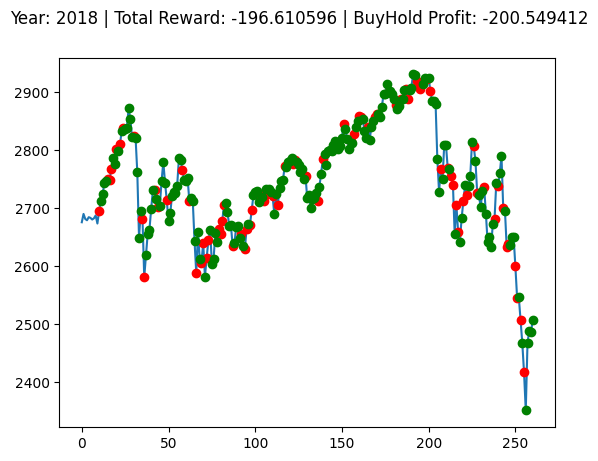

Buy And Hold: 700.9923498535159


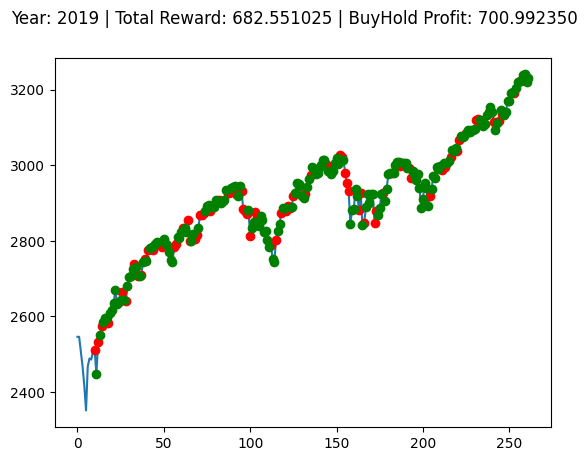

Buy And Hold: 476.9485205078122


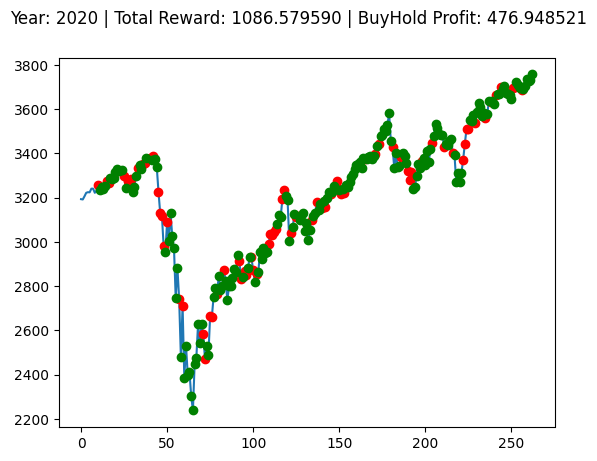

Buy And Hold: 1036.3717211914068


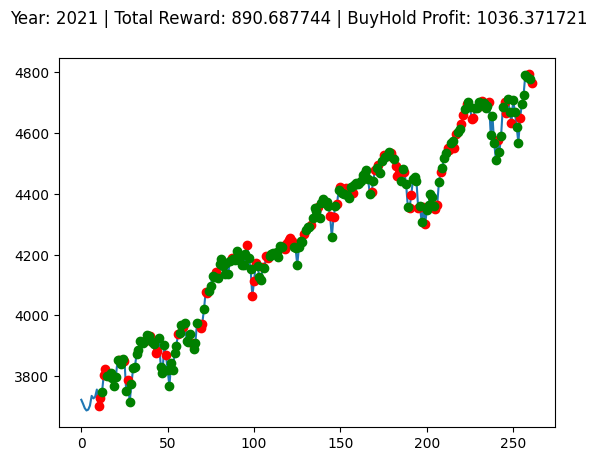

Buy And Hold: -971.472258300781


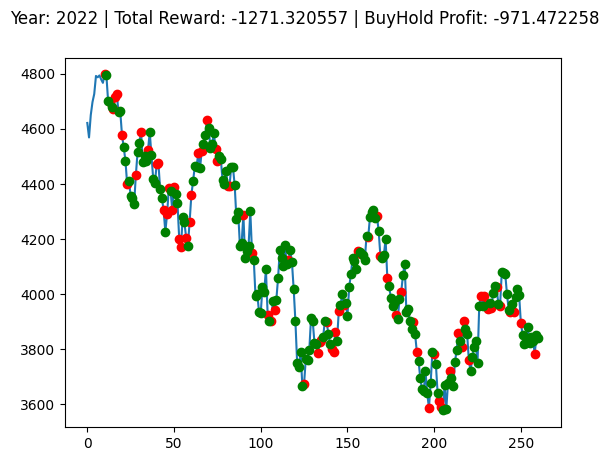

Buy And Hold: 917.112584228516


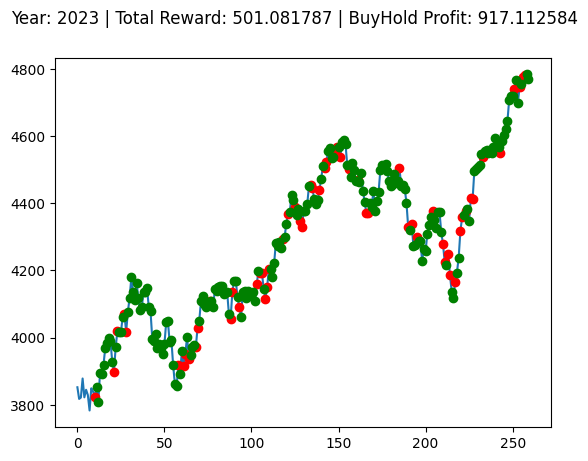

  1%|          | 1/100 [00:22<37:04, 22.47s/it]

Buy And Hold: -200.5494116210939


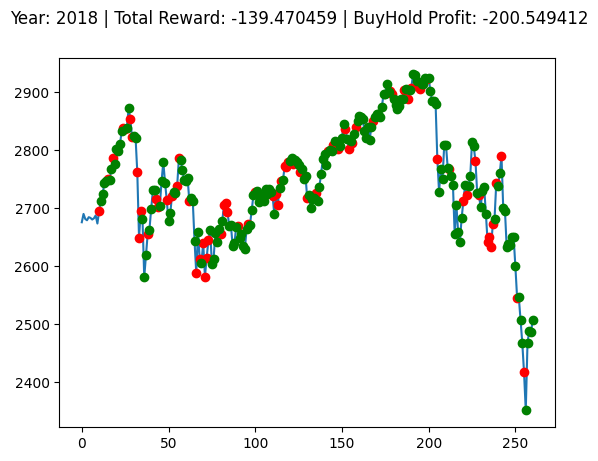

Buy And Hold: 700.9923498535159


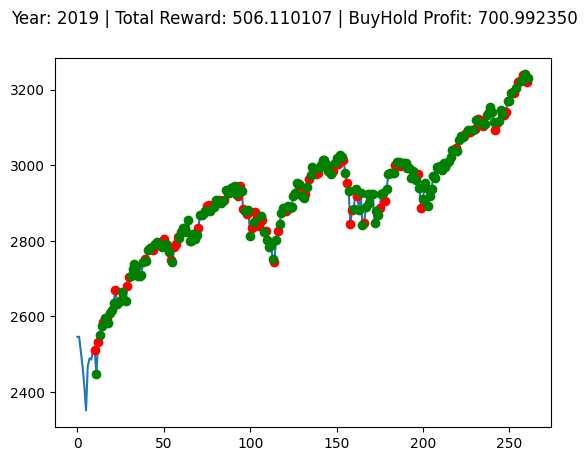

Buy And Hold: 476.9485205078122


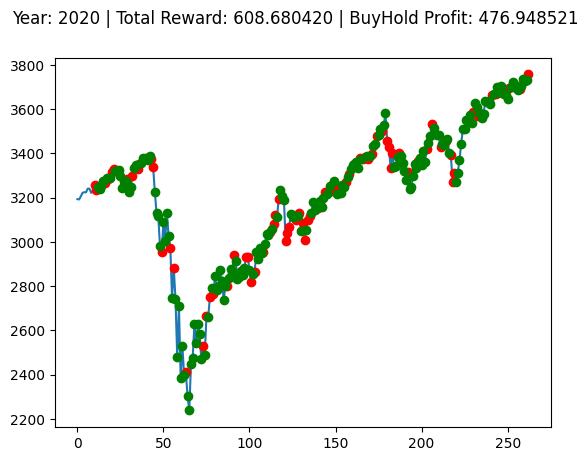

Buy And Hold: 1036.3717211914068


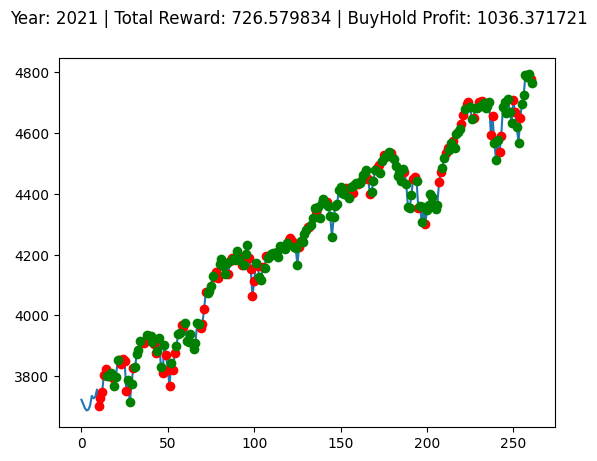

Buy And Hold: -971.472258300781


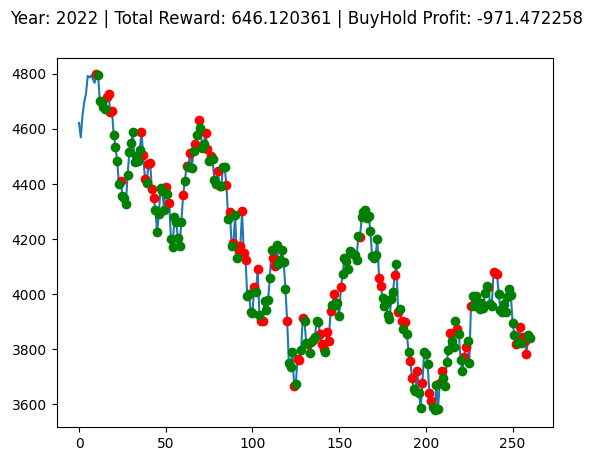

Buy And Hold: 917.112584228516


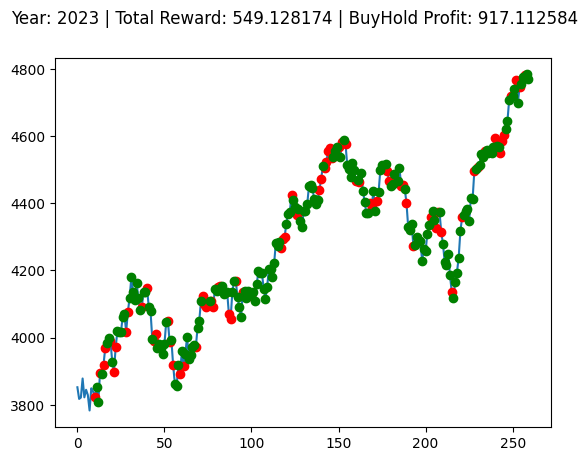

  2%|▏         | 2/100 [00:45<36:58, 22.64s/it]

Buy And Hold: -200.5494116210939


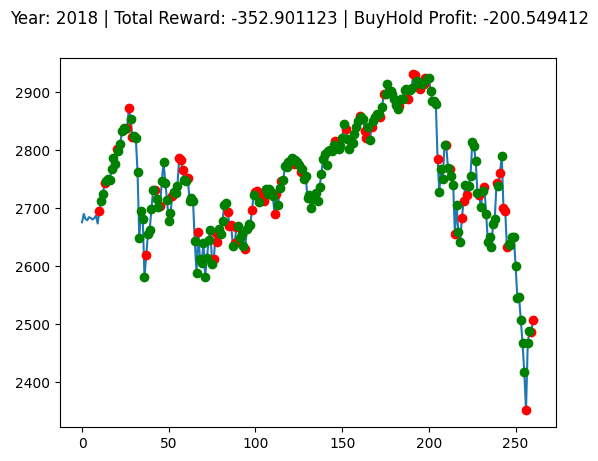

Buy And Hold: 700.9923498535159


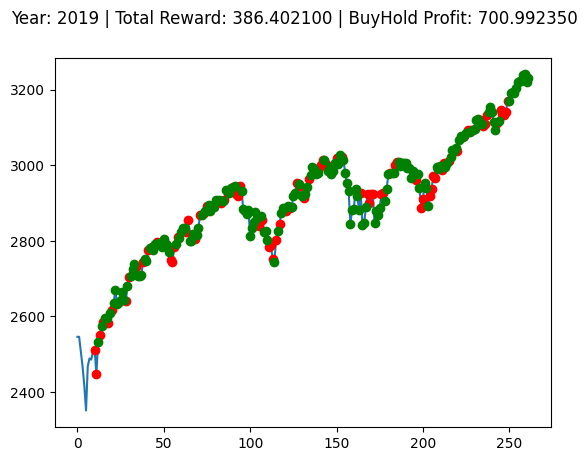

Buy And Hold: 476.9485205078122


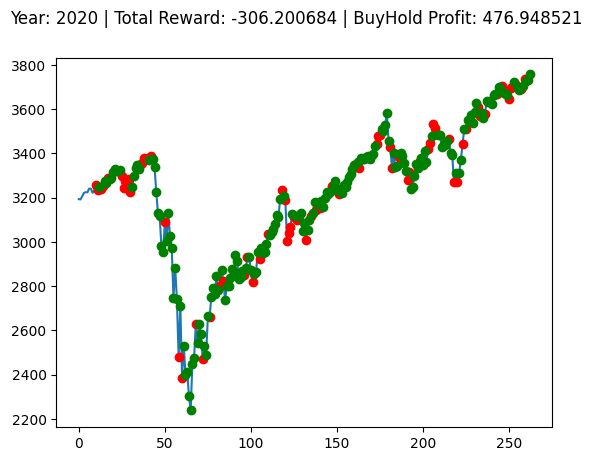

Buy And Hold: 1036.3717211914068


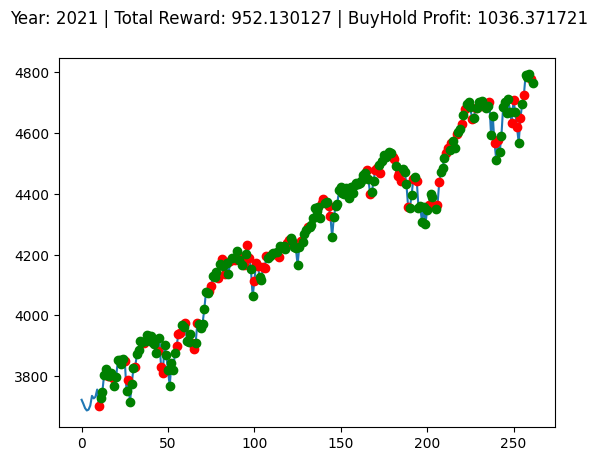

Buy And Hold: -971.472258300781


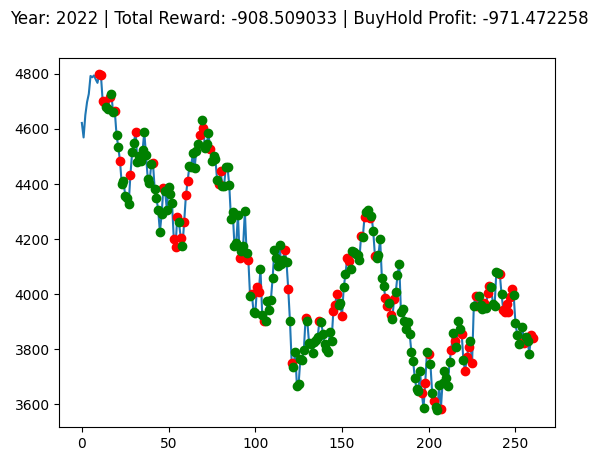

Buy And Hold: 917.112584228516


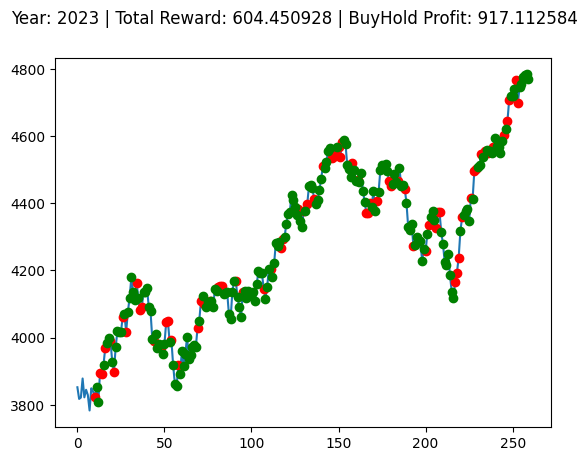

  3%|▎         | 3/100 [01:07<36:15, 22.43s/it]

Buy And Hold: -200.5494116210939


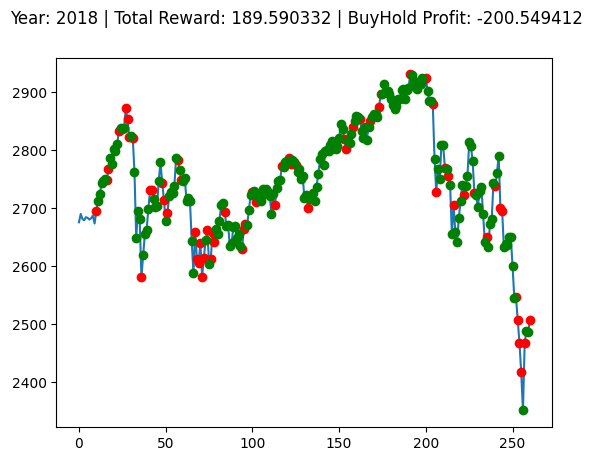

Buy And Hold: 700.9923498535159


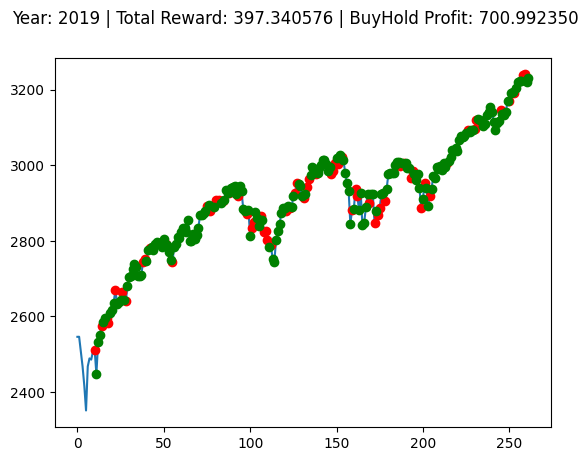

Buy And Hold: 476.9485205078122


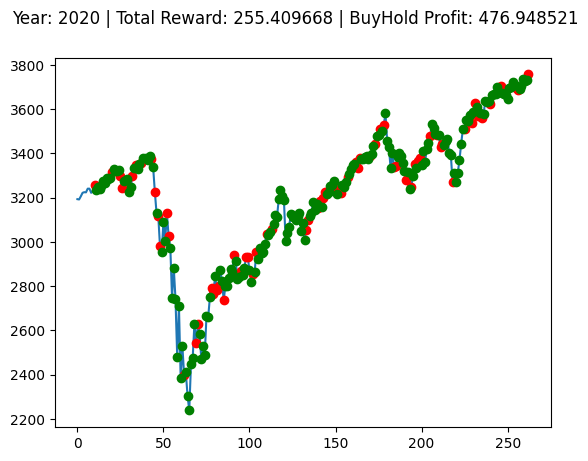

Buy And Hold: 1036.3717211914068


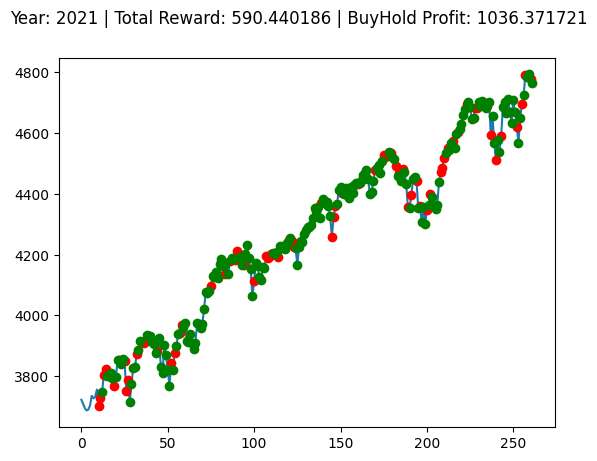

Buy And Hold: -971.472258300781


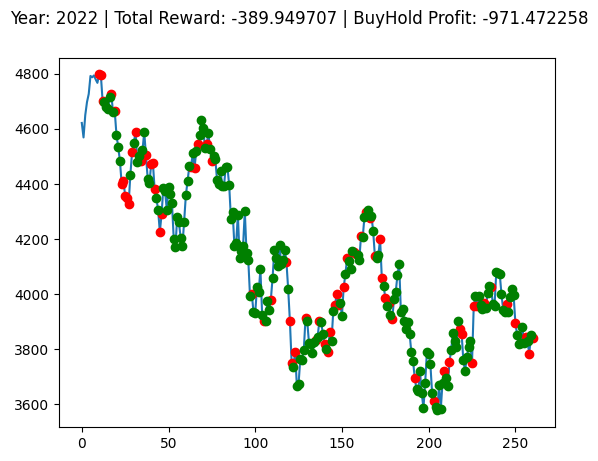

Buy And Hold: 917.112584228516


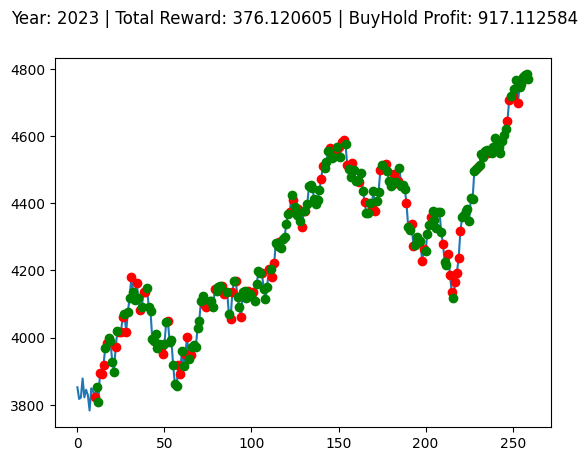

  4%|▍         | 4/100 [01:29<35:48, 22.38s/it]

Buy And Hold: -200.5494116210939


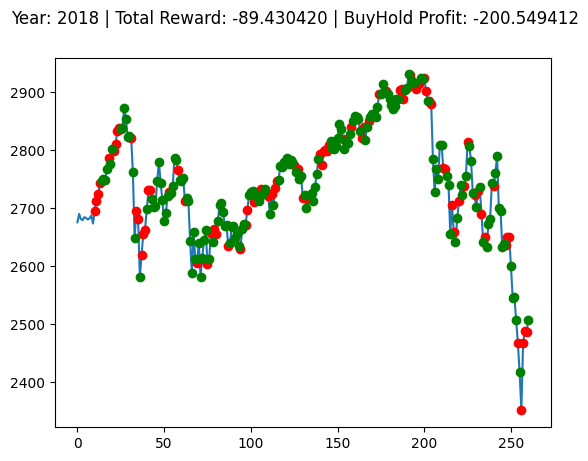

Buy And Hold: 700.9923498535159


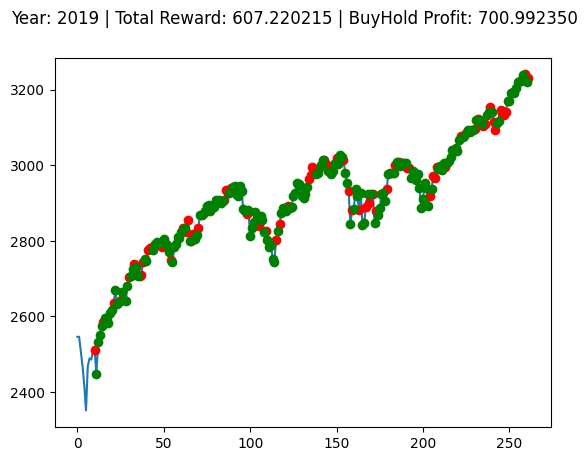

Buy And Hold: 476.9485205078122


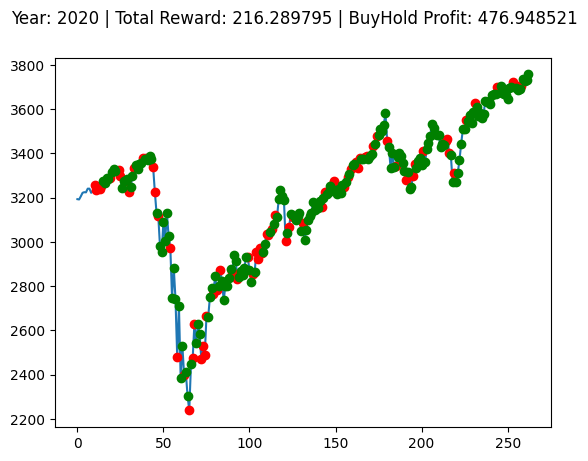

Buy And Hold: 1036.3717211914068


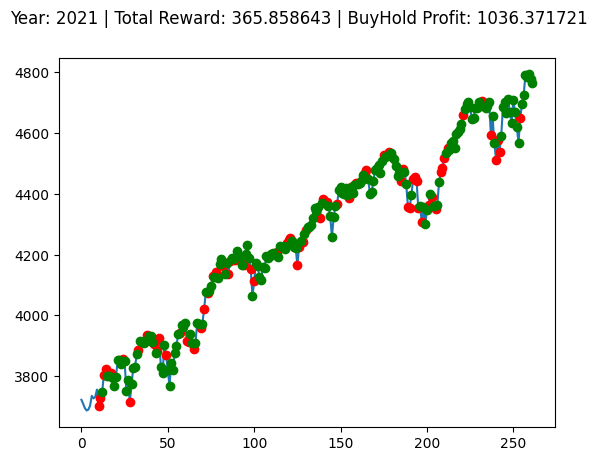

Buy And Hold: -971.472258300781


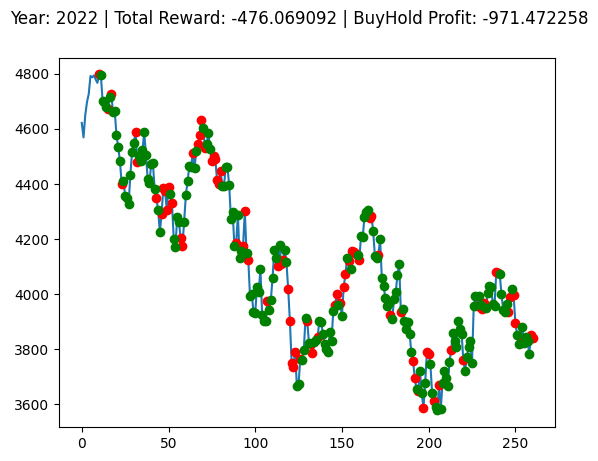

Buy And Hold: 917.112584228516


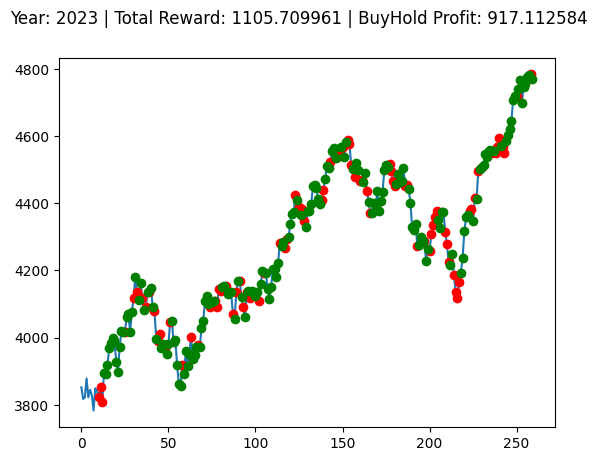

  5%|▌         | 5/100 [01:51<35:15, 22.27s/it]

Buy And Hold: -200.5494116210939


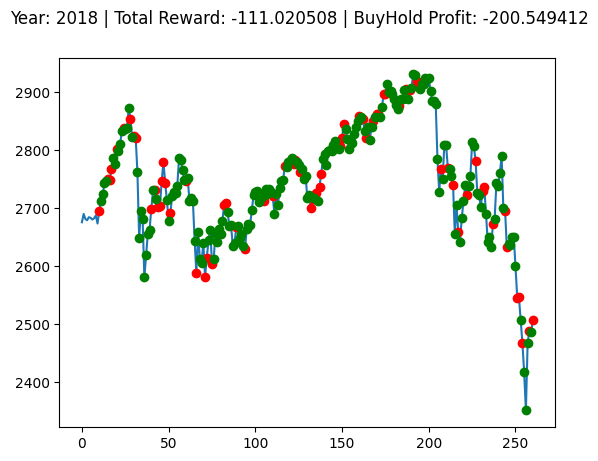

Buy And Hold: 700.9923498535159


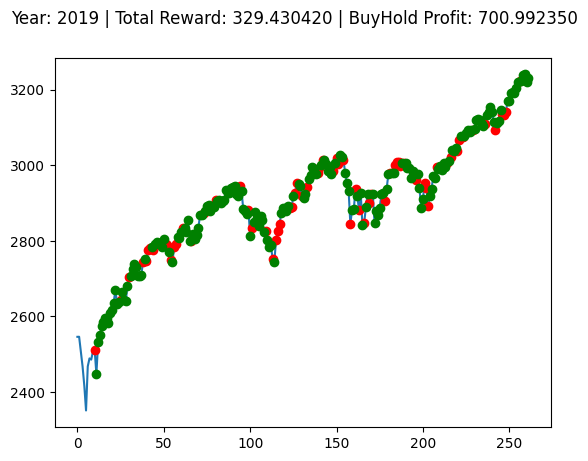

Buy And Hold: 476.9485205078122


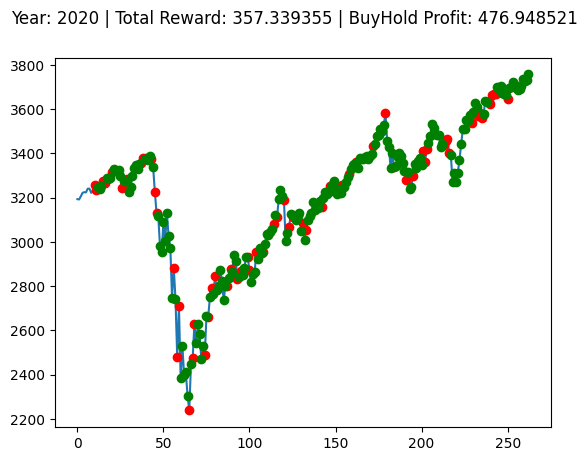

Buy And Hold: 1036.3717211914068


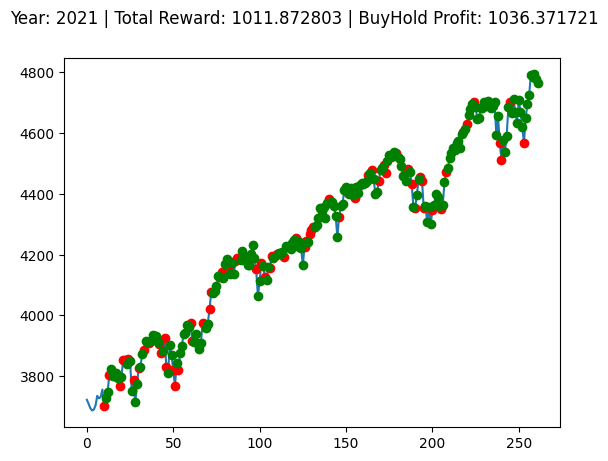

Buy And Hold: -971.472258300781


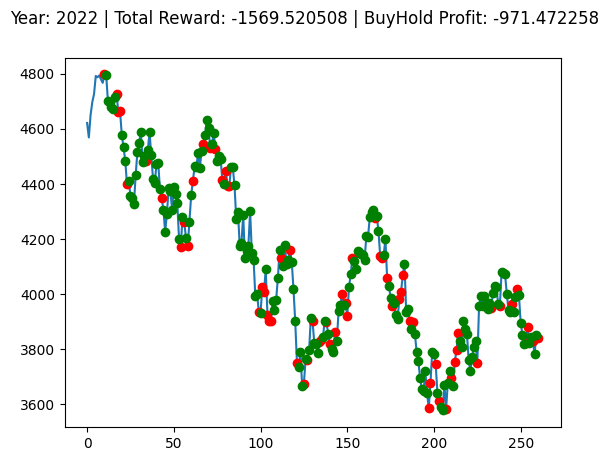

Buy And Hold: 917.112584228516


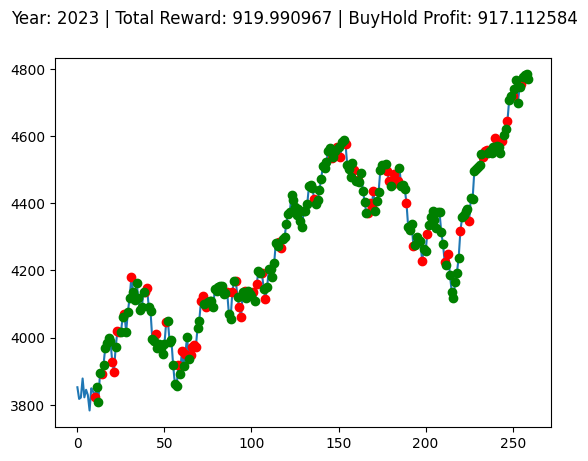

  6%|▌         | 6/100 [02:14<35:12, 22.47s/it]

Buy And Hold: -200.5494116210939


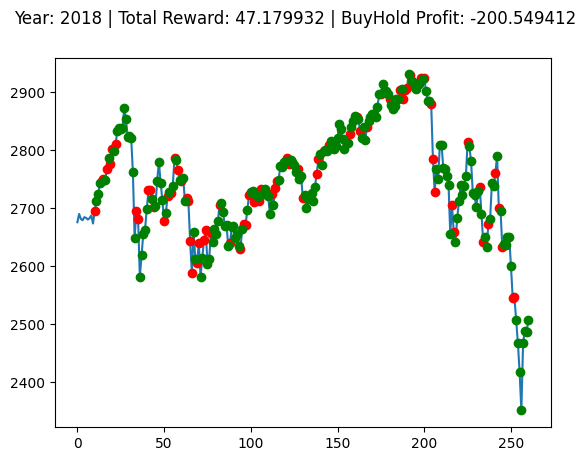

Buy And Hold: 700.9923498535159


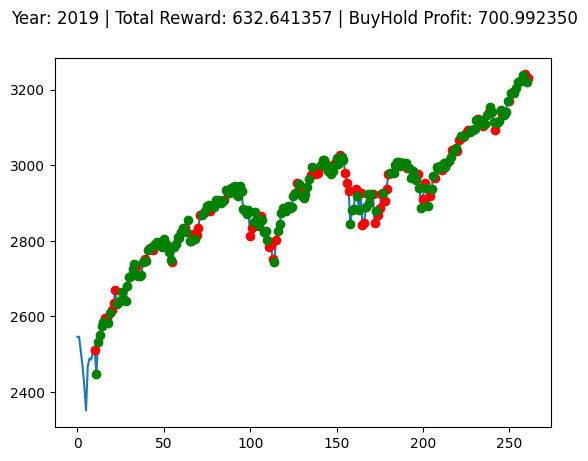

Buy And Hold: 476.9485205078122


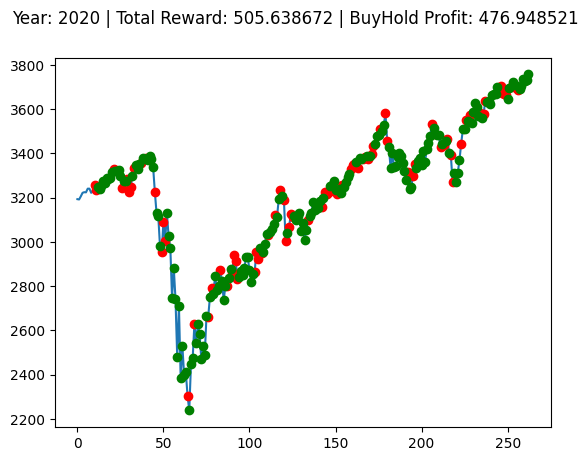

Buy And Hold: 1036.3717211914068


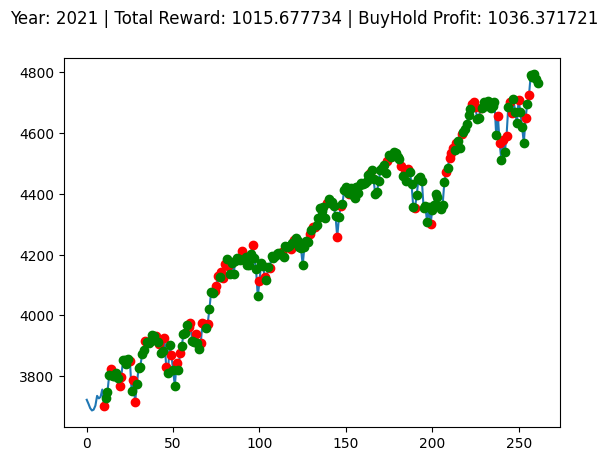

Buy And Hold: -971.472258300781


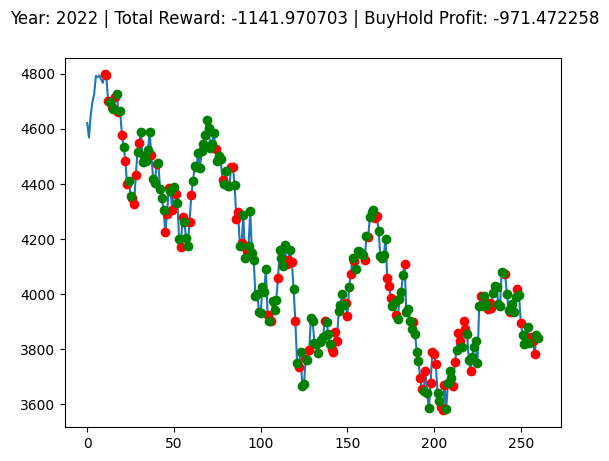

Buy And Hold: 917.112584228516


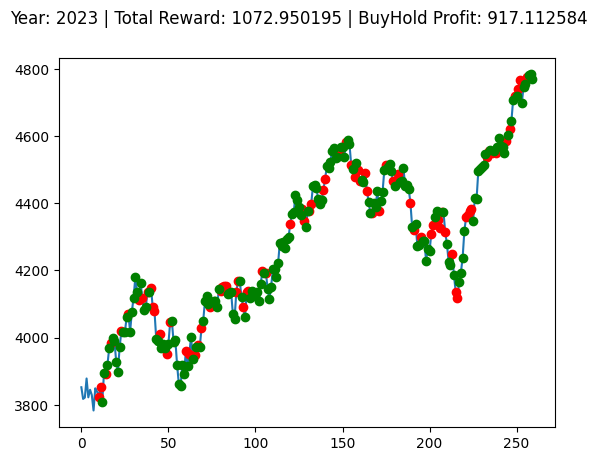

  7%|▋         | 7/100 [02:37<34:53, 22.51s/it]

Buy And Hold: -200.5494116210939


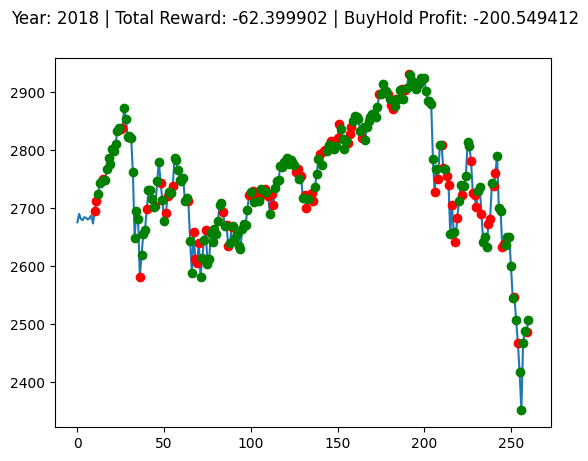

Buy And Hold: 700.9923498535159


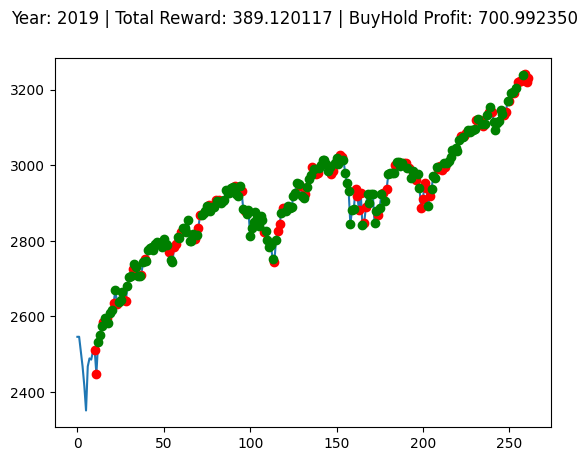

Buy And Hold: 476.9485205078122


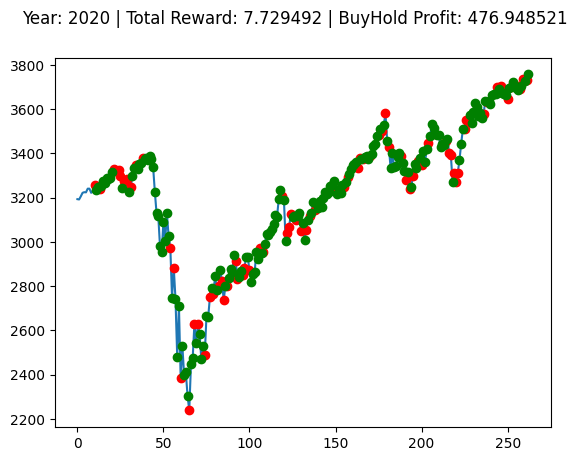

Buy And Hold: 1036.3717211914068


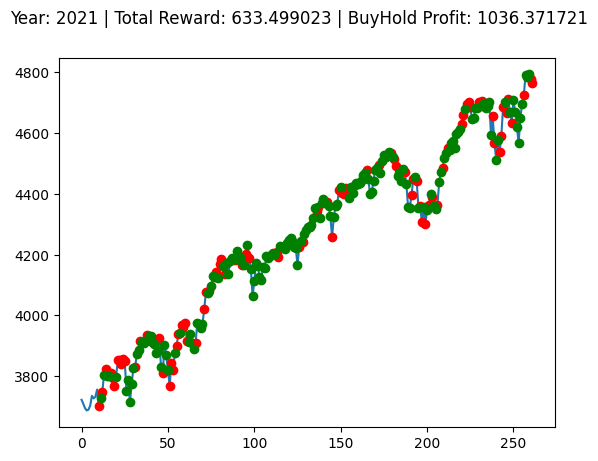

Buy And Hold: -971.472258300781


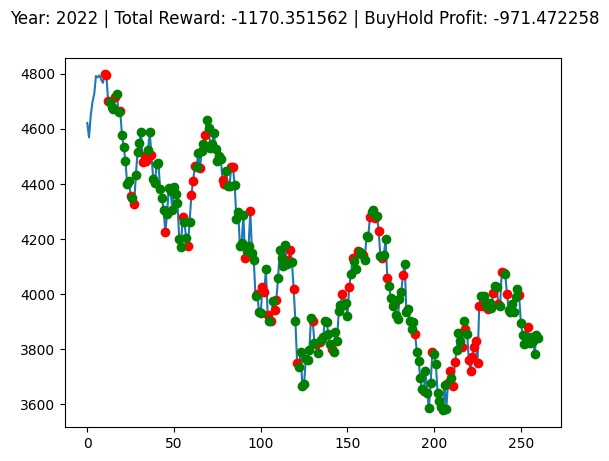

Buy And Hold: 917.112584228516


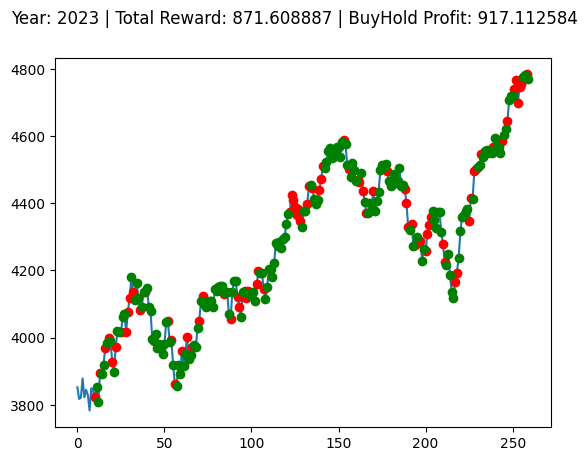

  8%|▊         | 8/100 [02:59<34:29, 22.49s/it]

Buy And Hold: -200.5494116210939


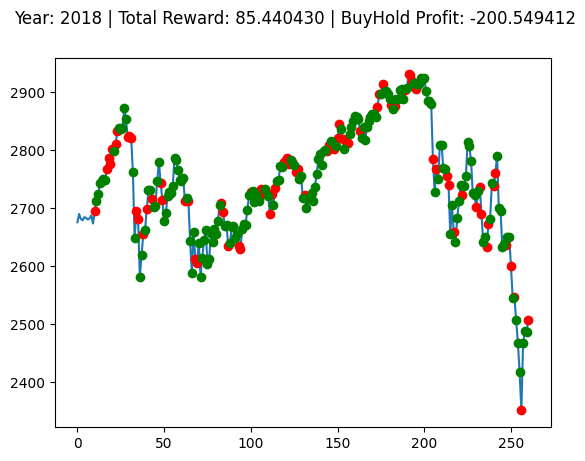

Buy And Hold: 700.9923498535159


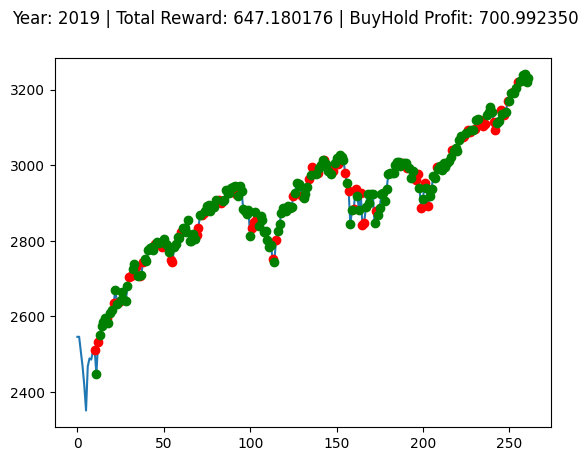

Buy And Hold: 476.9485205078122


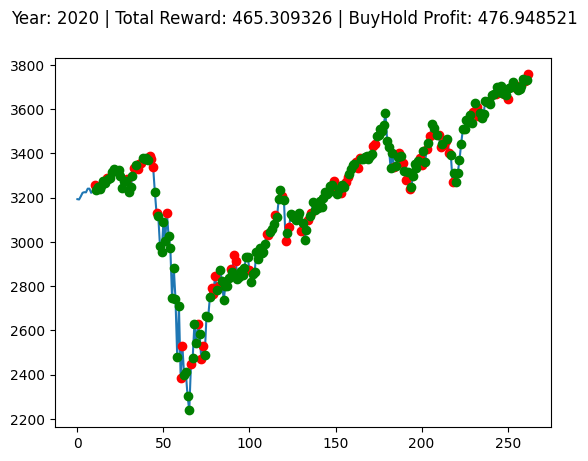

Buy And Hold: 1036.3717211914068


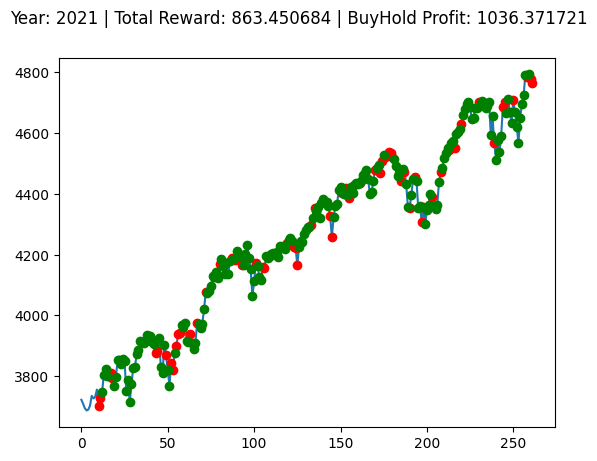

Buy And Hold: -971.472258300781


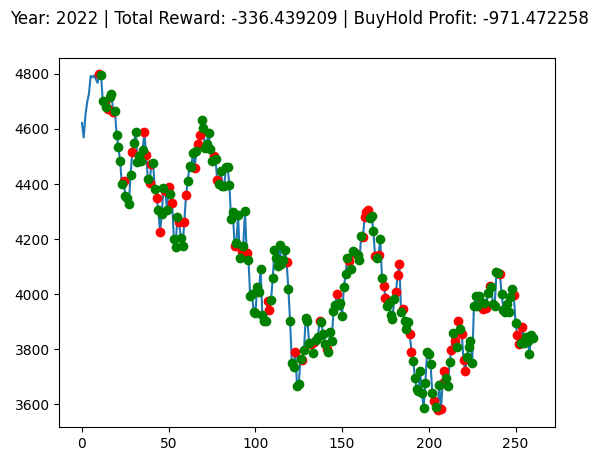

Buy And Hold: 917.112584228516


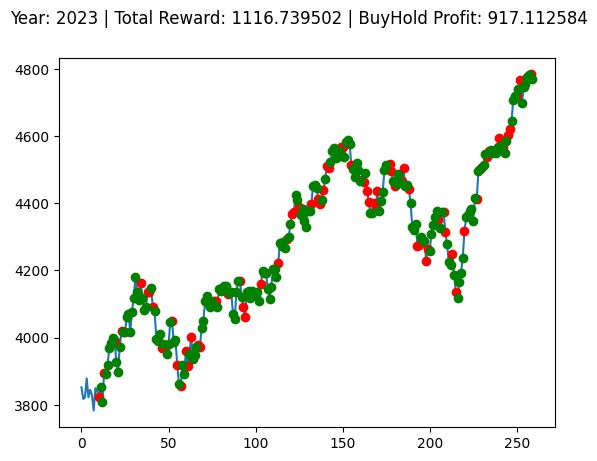

  9%|▉         | 9/100 [03:22<34:07, 22.50s/it]

Buy And Hold: -200.5494116210939


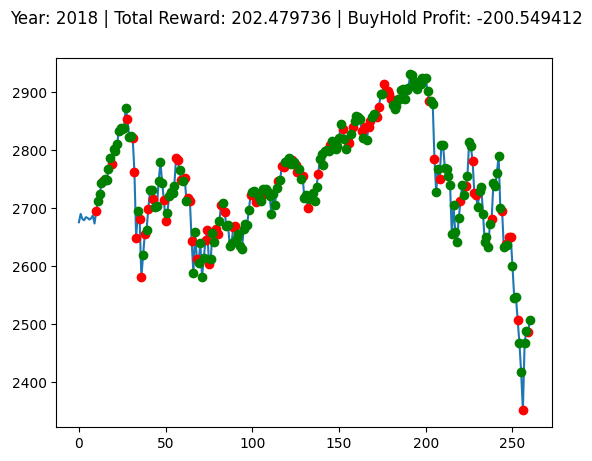

Buy And Hold: 700.9923498535159


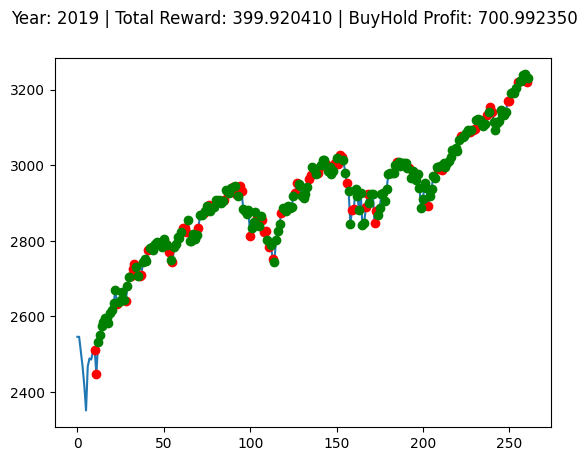

Buy And Hold: 476.9485205078122


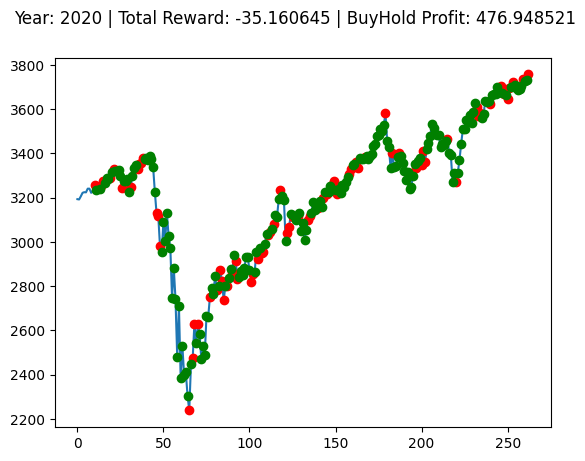

Buy And Hold: 1036.3717211914068


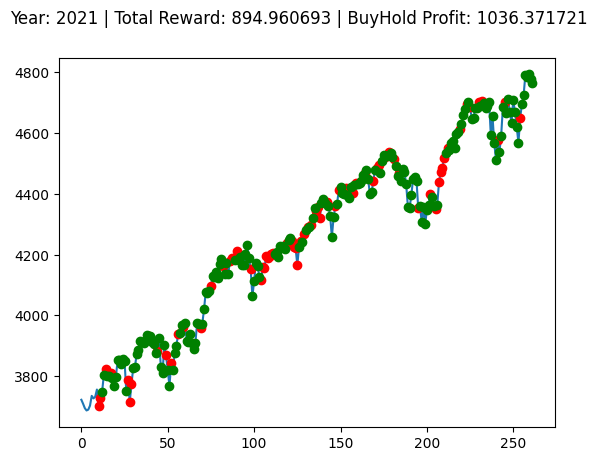

Buy And Hold: -971.472258300781


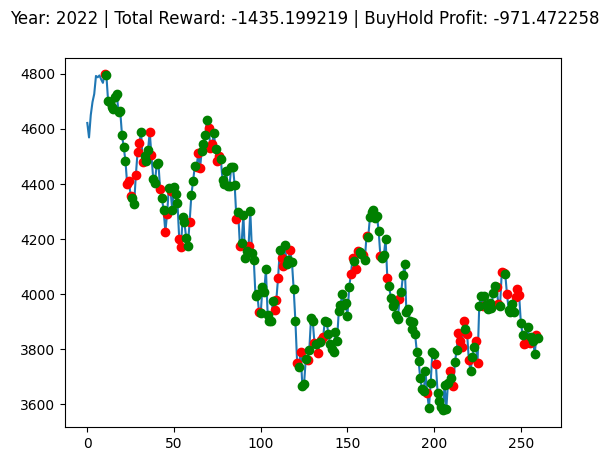

Buy And Hold: 917.112584228516


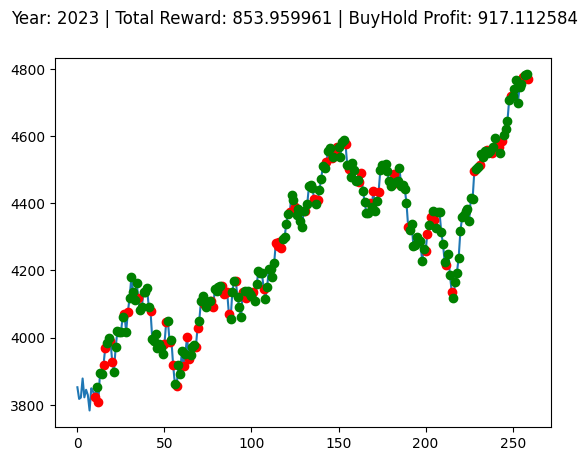

 10%|█         | 10/100 [03:44<33:31, 22.35s/it]

Buy And Hold: -200.5494116210939


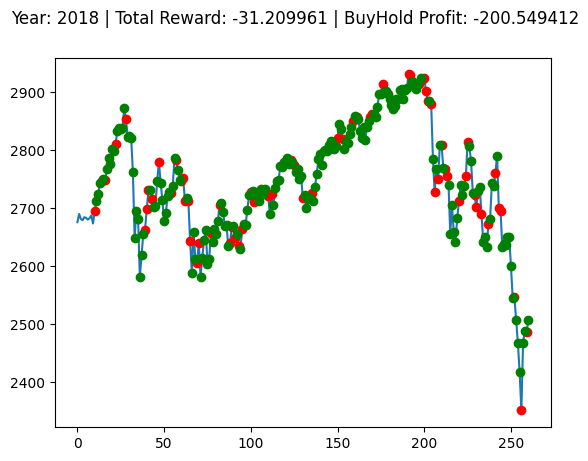

Buy And Hold: 700.9923498535159


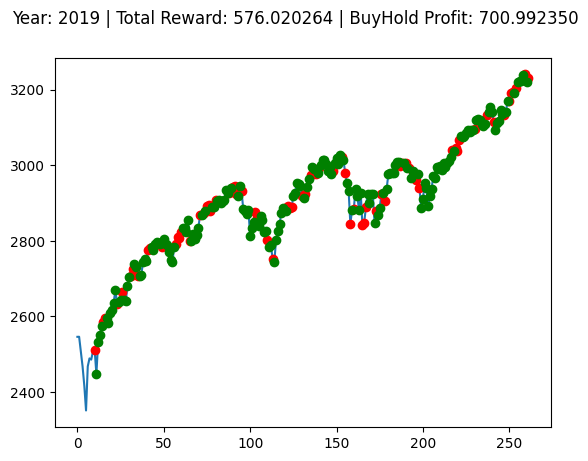

Buy And Hold: 476.9485205078122


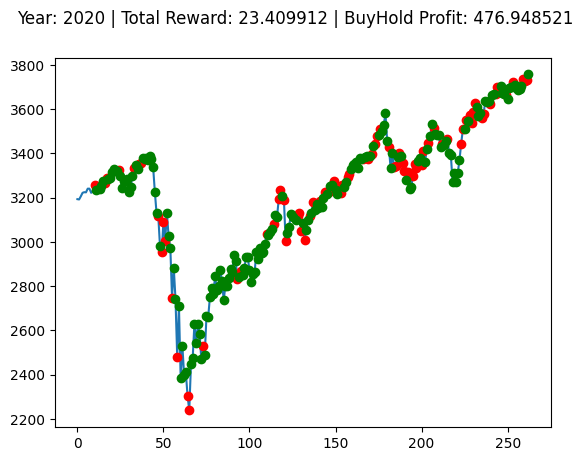

Buy And Hold: 1036.3717211914068


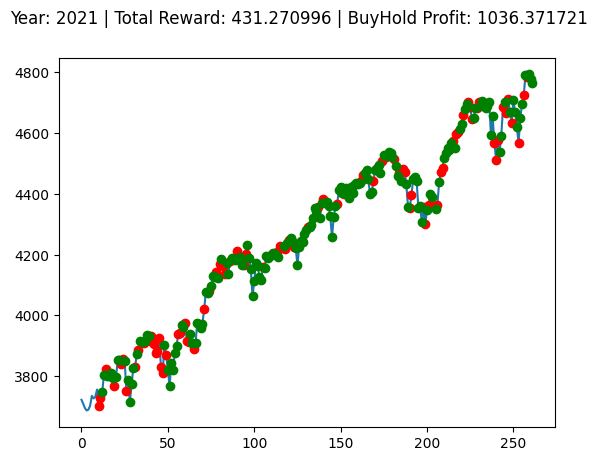

Buy And Hold: -971.472258300781


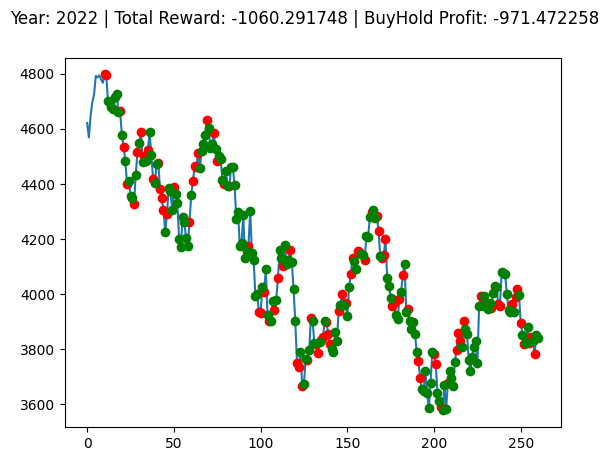

Buy And Hold: 917.112584228516


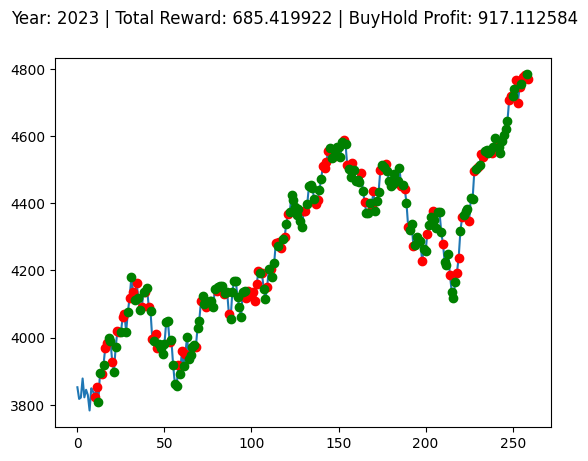

 11%|█         | 11/100 [04:06<33:11, 22.38s/it]

Buy And Hold: -200.5494116210939


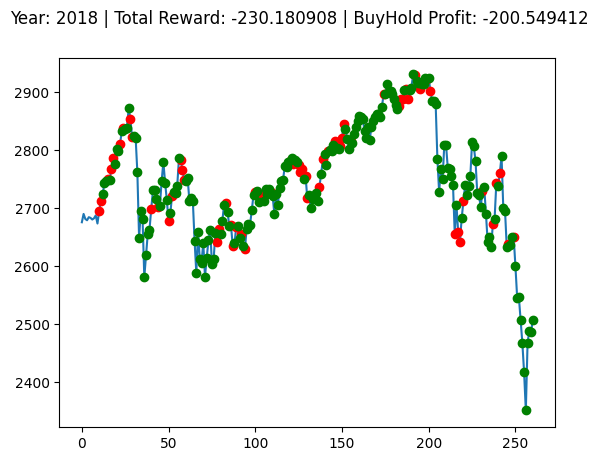

Buy And Hold: 700.9923498535159


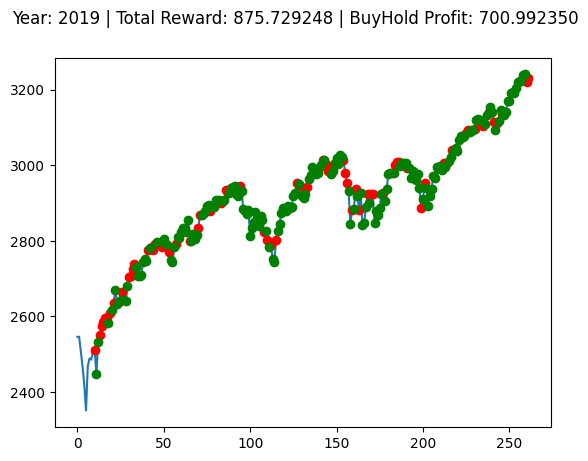

Buy And Hold: 476.9485205078122


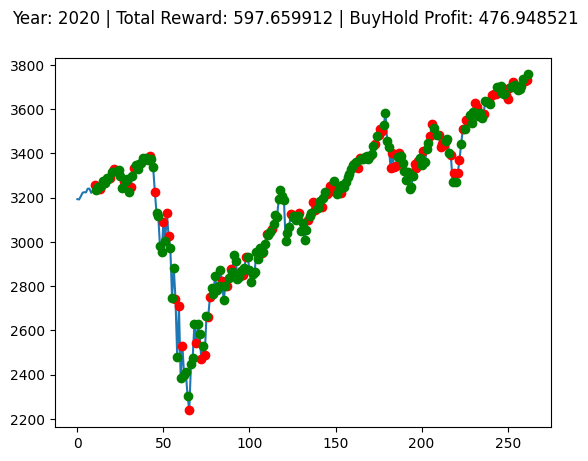

Buy And Hold: 1036.3717211914068


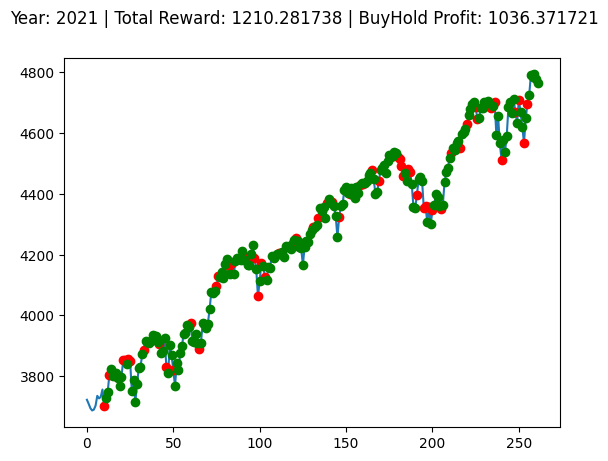

Buy And Hold: -971.472258300781


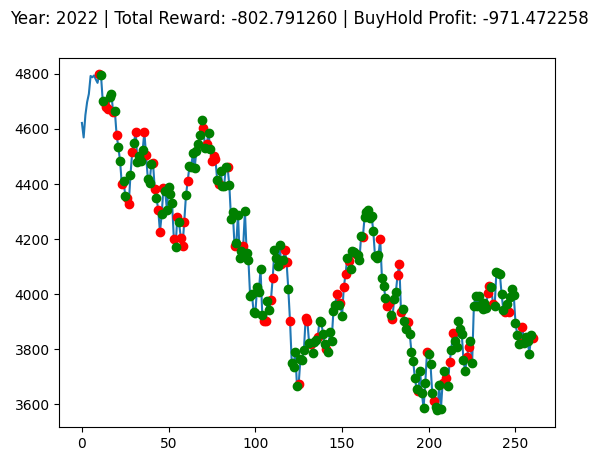

Buy And Hold: 917.112584228516


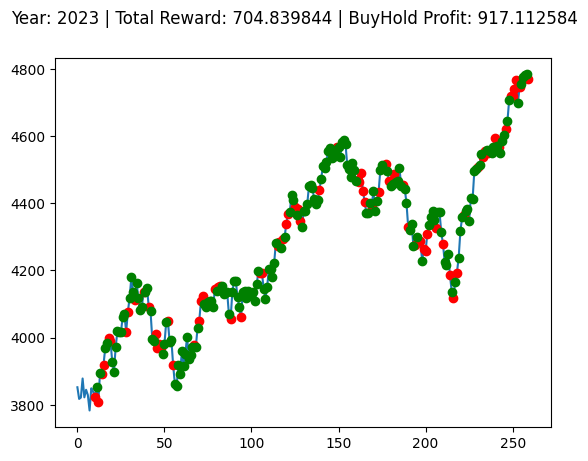

 12%|█▏        | 12/100 [04:29<32:50, 22.40s/it]

Buy And Hold: -200.5494116210939


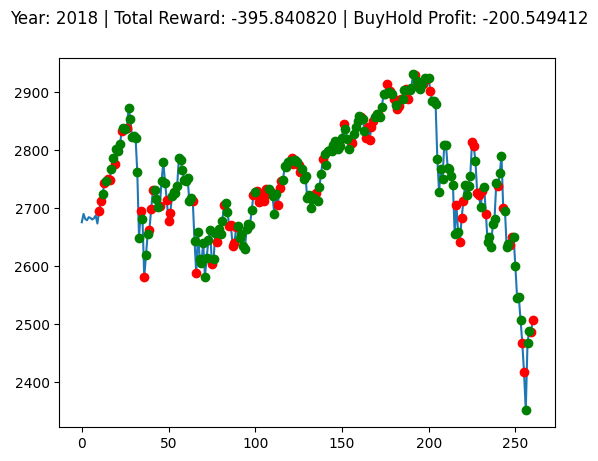

Buy And Hold: 700.9923498535159


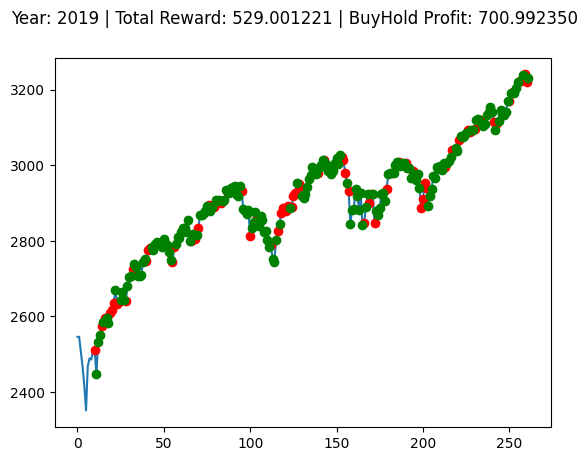

Buy And Hold: 476.9485205078122


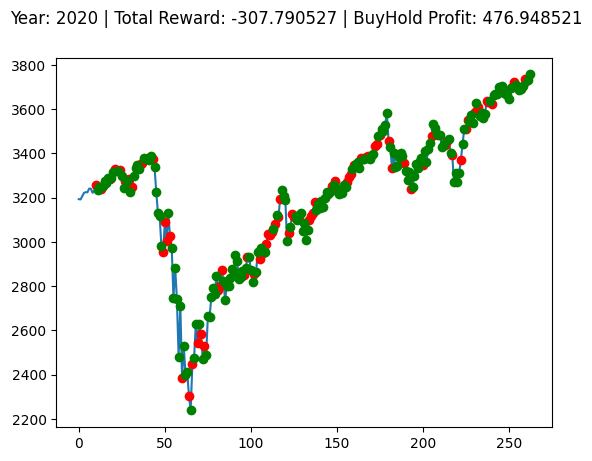

Buy And Hold: 1036.3717211914068


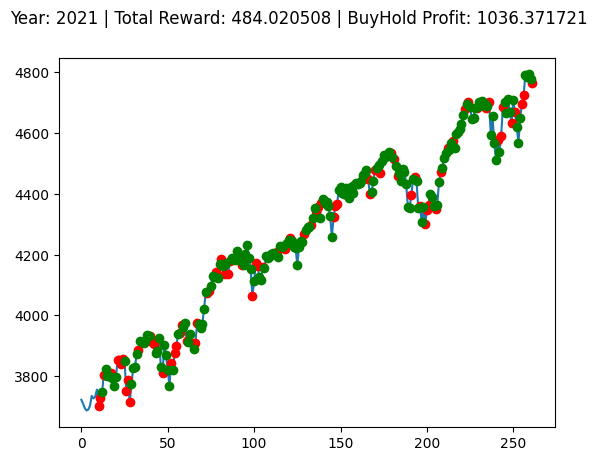

Buy And Hold: -971.472258300781


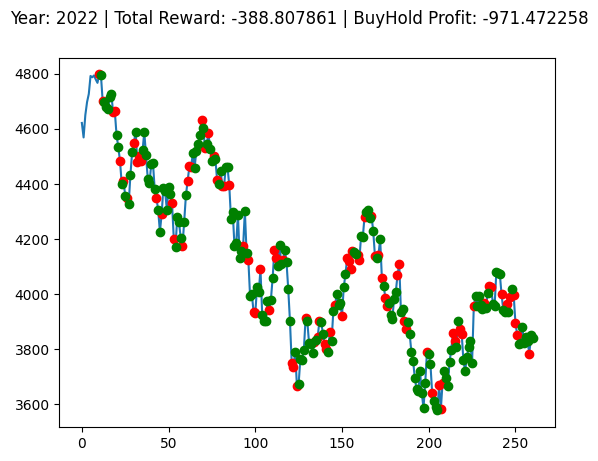

Buy And Hold: 917.112584228516


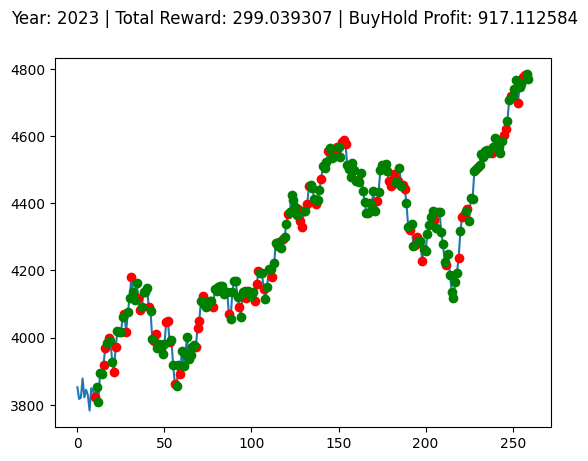

 13%|█▎        | 13/100 [04:51<32:22, 22.33s/it]

Buy And Hold: -200.5494116210939


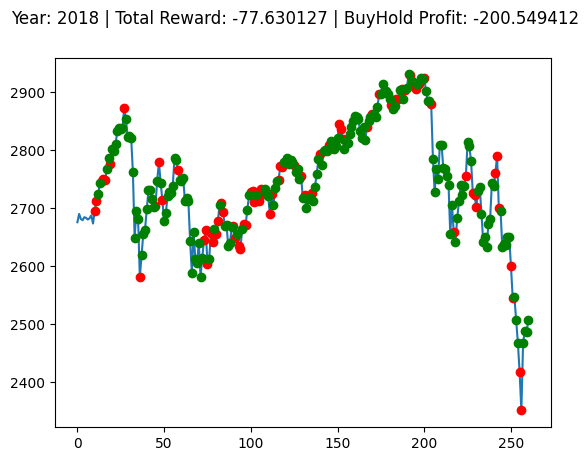

Buy And Hold: 700.9923498535159


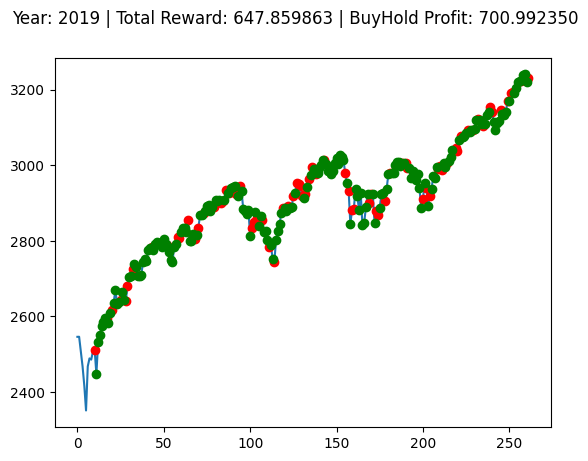

Buy And Hold: 476.9485205078122


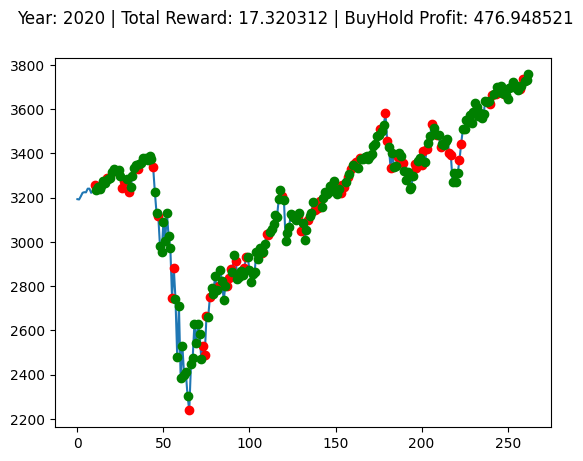

Buy And Hold: 1036.3717211914068


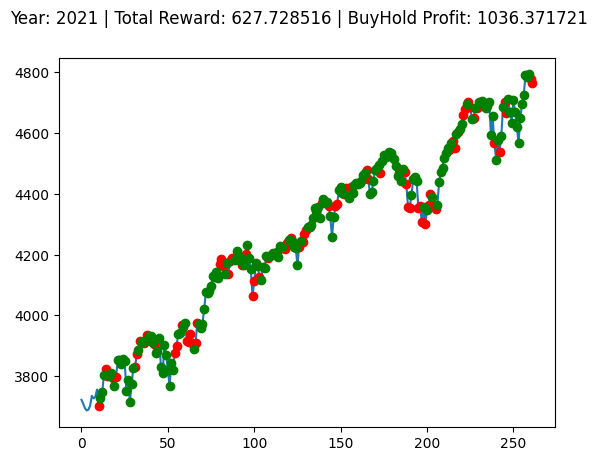

Buy And Hold: -971.472258300781


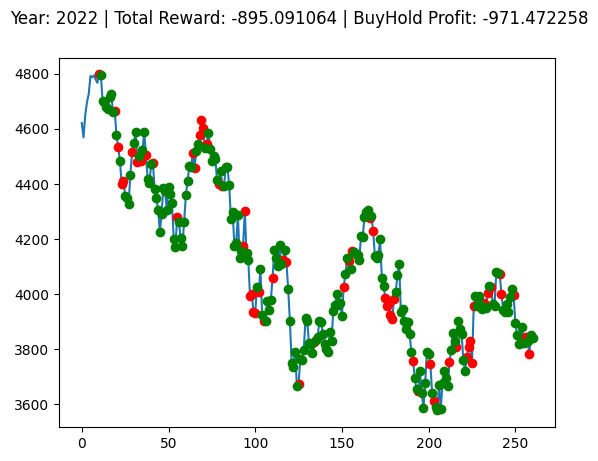

Buy And Hold: 917.112584228516


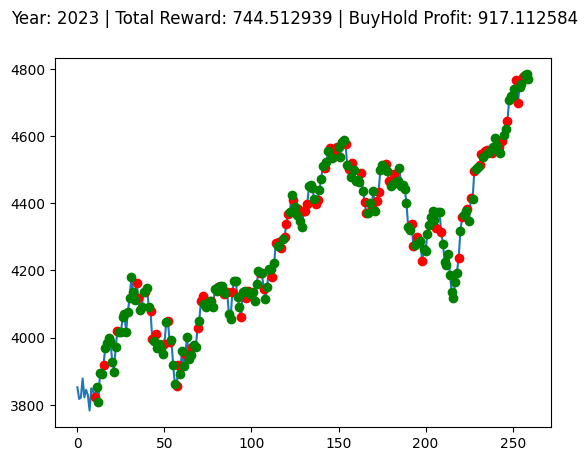

 14%|█▍        | 14/100 [05:13<32:04, 22.38s/it]

Buy And Hold: -200.5494116210939


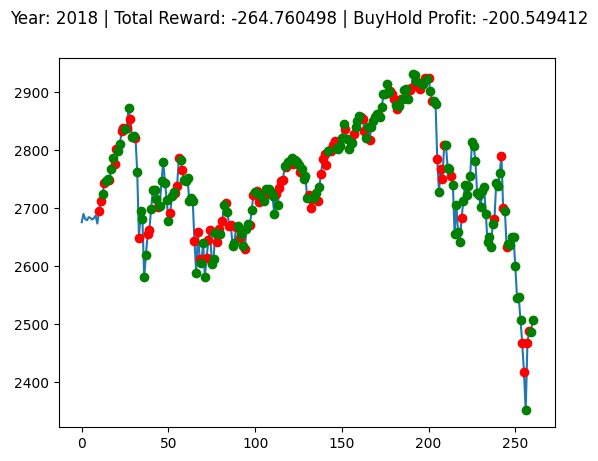

Buy And Hold: 700.9923498535159


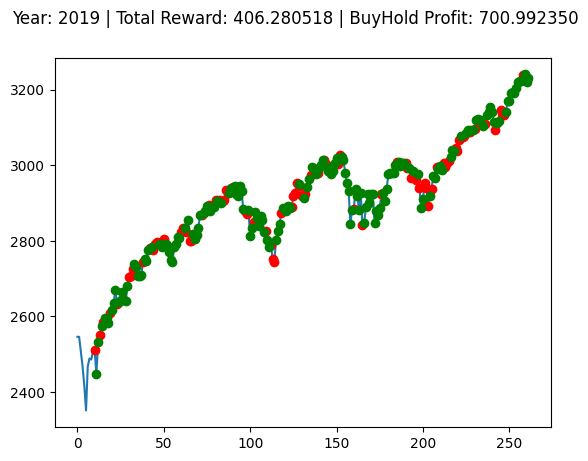

Buy And Hold: 476.9485205078122


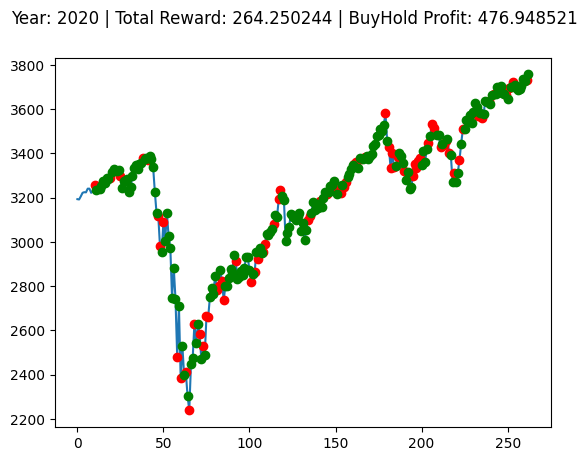

Buy And Hold: 1036.3717211914068


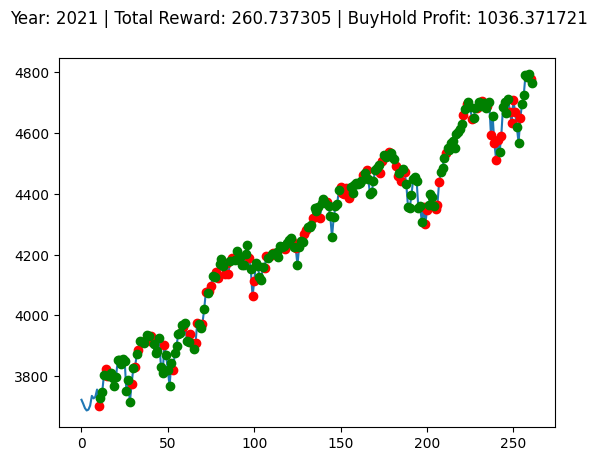

Buy And Hold: -971.472258300781


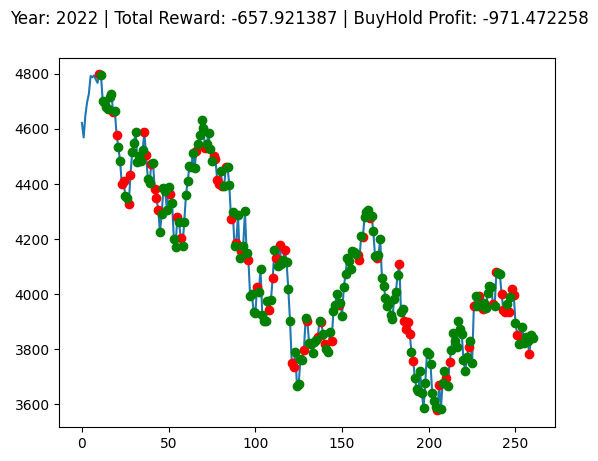

Buy And Hold: 917.112584228516


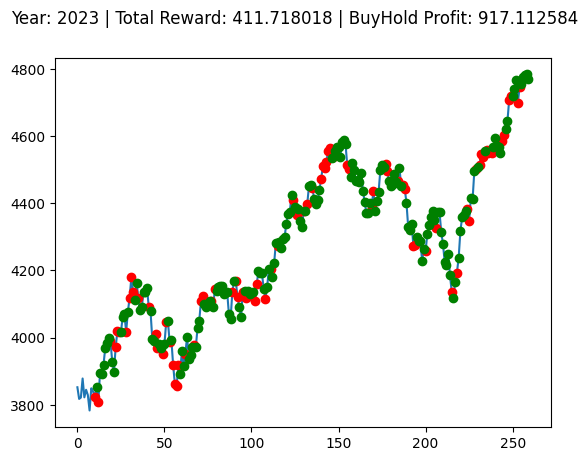

 15%|█▌        | 15/100 [05:36<31:58, 22.56s/it]

Buy And Hold: -200.5494116210939


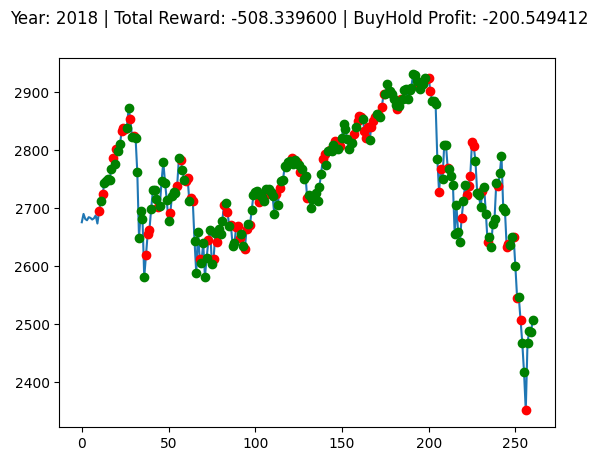

Buy And Hold: 700.9923498535159


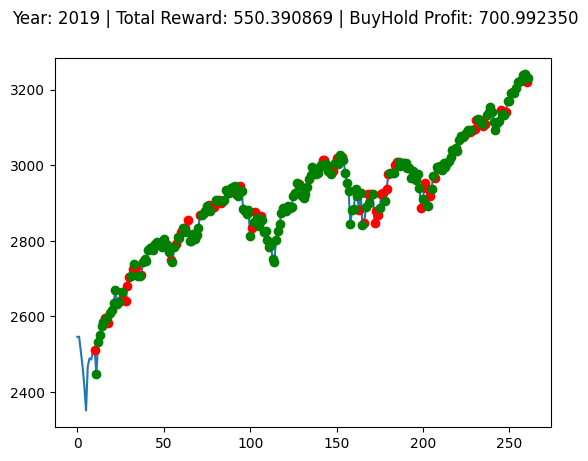

Buy And Hold: 476.9485205078122


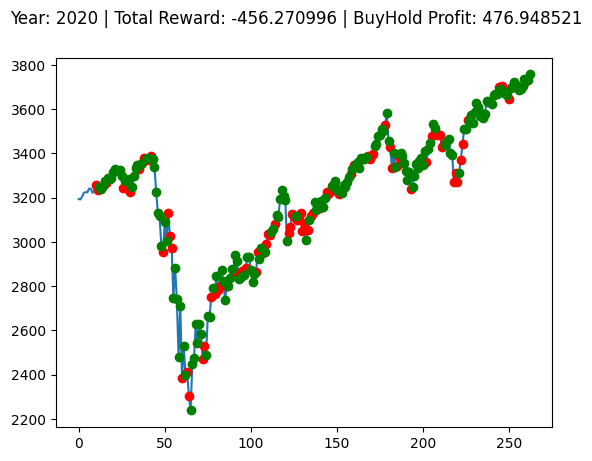

Buy And Hold: 1036.3717211914068


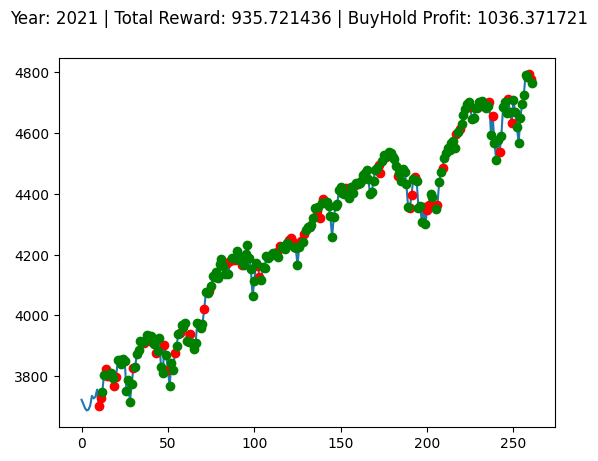

Buy And Hold: -971.472258300781


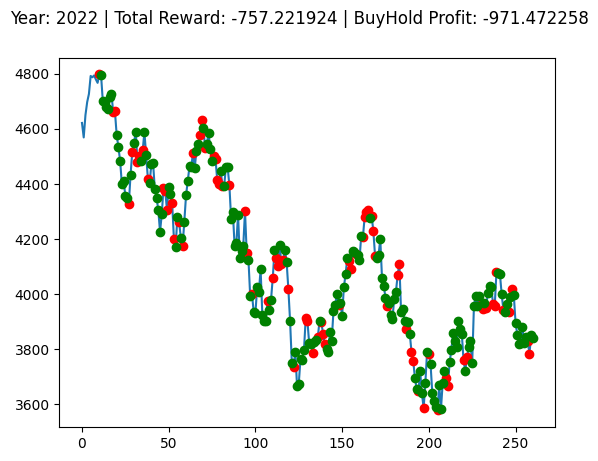

Buy And Hold: 917.112584228516


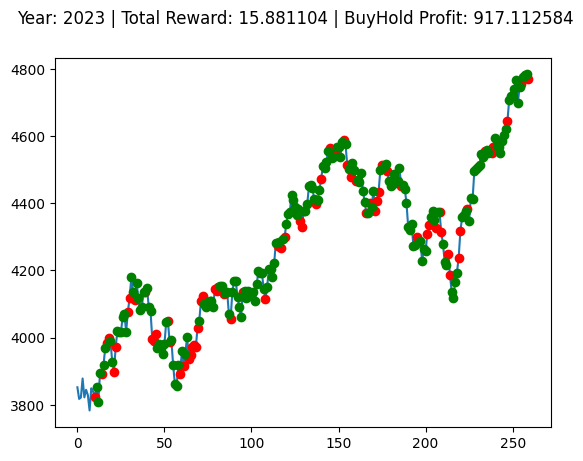

 16%|█▌        | 16/100 [05:59<31:39, 22.61s/it]

Buy And Hold: -200.5494116210939


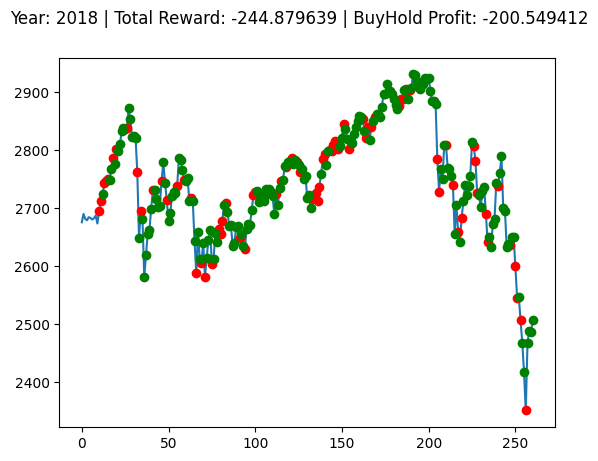

Buy And Hold: 700.9923498535159


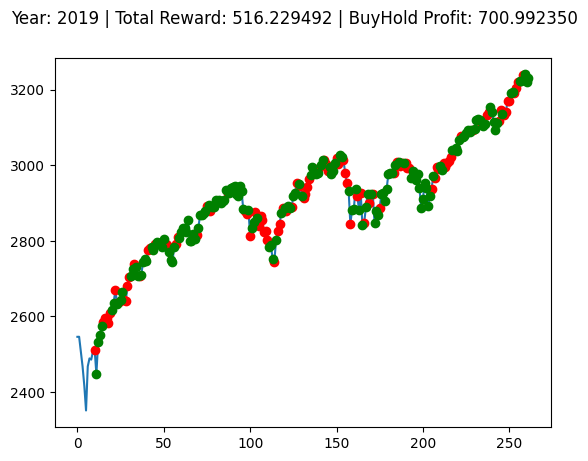

Buy And Hold: 476.9485205078122


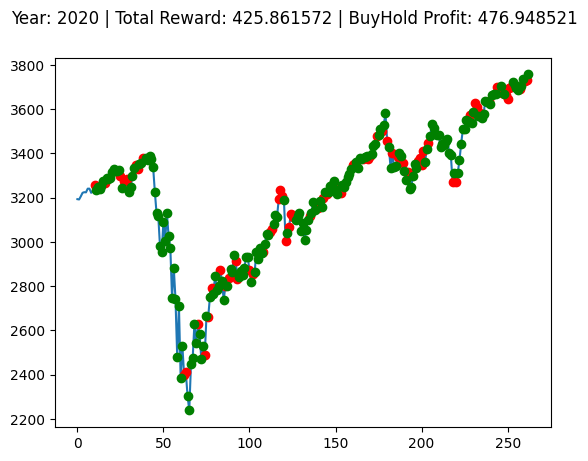

Buy And Hold: 1036.3717211914068


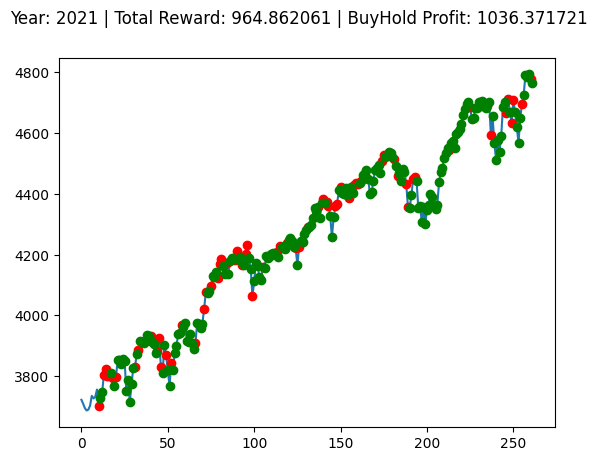

Buy And Hold: -971.472258300781


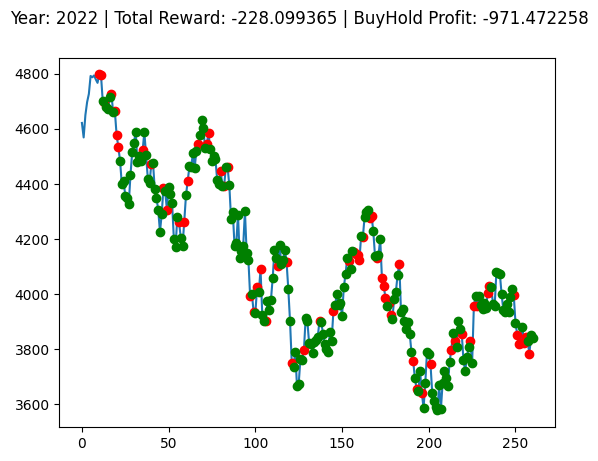

Buy And Hold: 917.112584228516


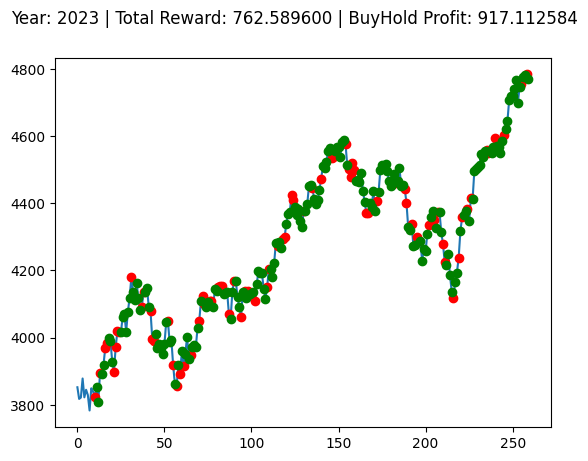

 17%|█▋        | 17/100 [06:21<31:05, 22.47s/it]

Buy And Hold: -200.5494116210939


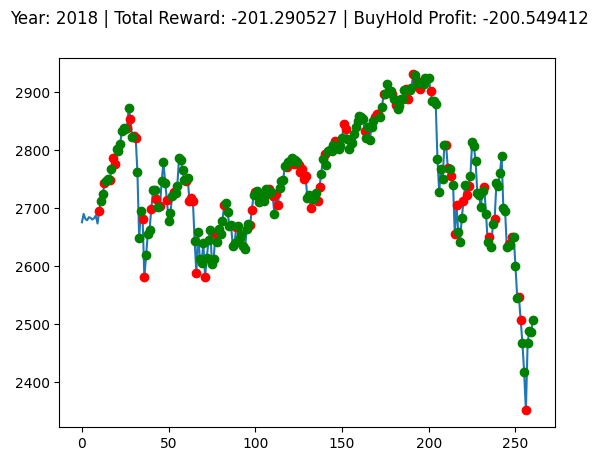

Buy And Hold: 700.9923498535159


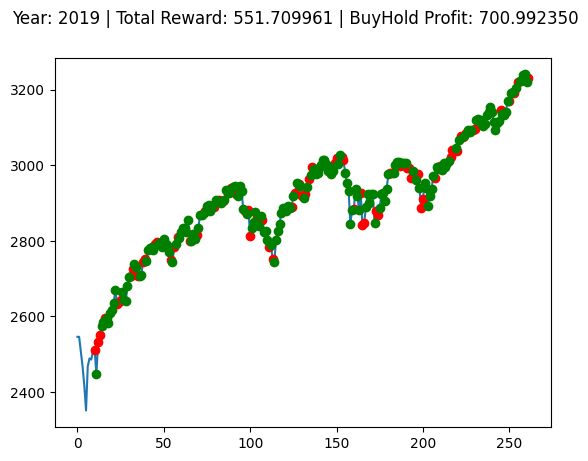

Buy And Hold: 476.9485205078122


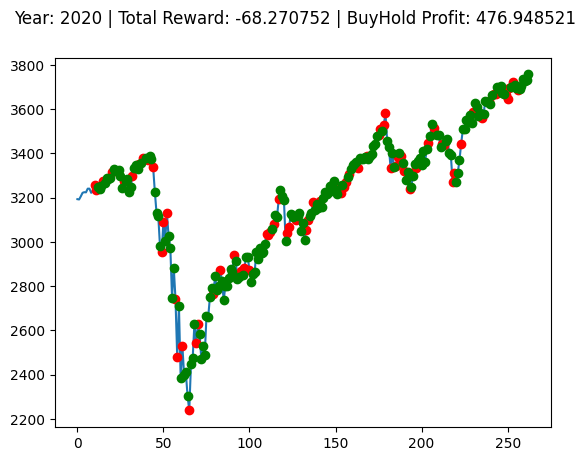

Buy And Hold: 1036.3717211914068


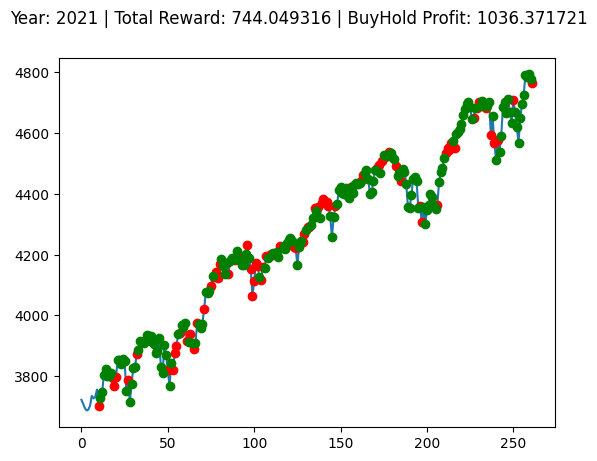

Buy And Hold: -971.472258300781


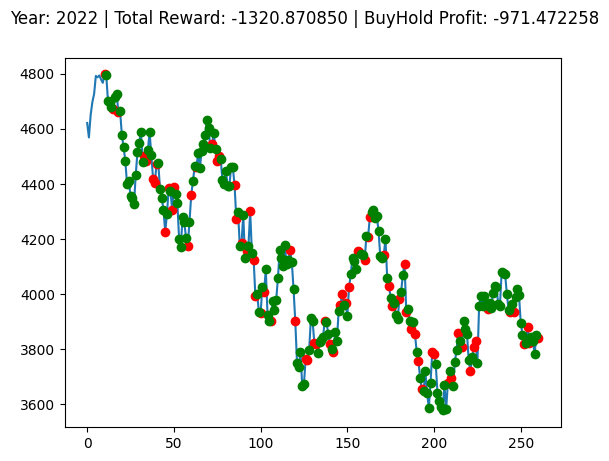

Buy And Hold: 917.112584228516


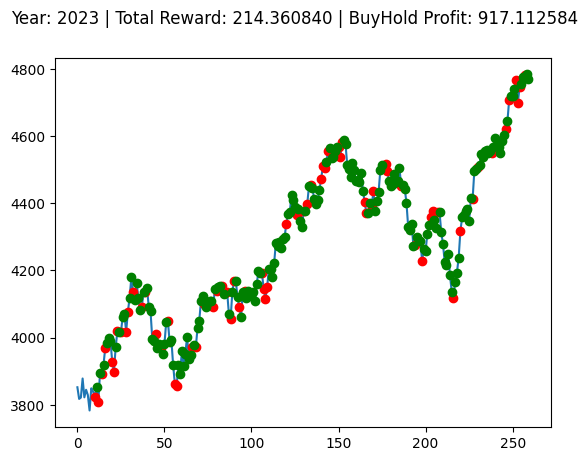

 18%|█▊        | 18/100 [06:43<30:33, 22.37s/it]

Buy And Hold: -200.5494116210939


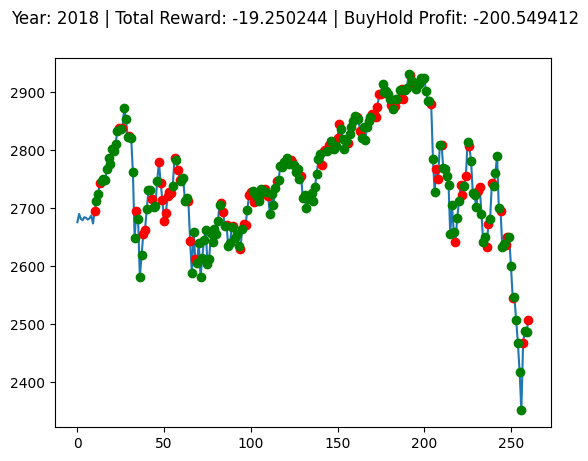

Buy And Hold: 700.9923498535159


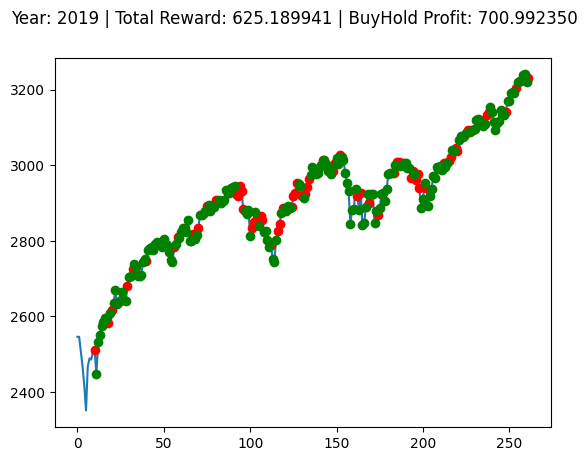

Buy And Hold: 476.9485205078122


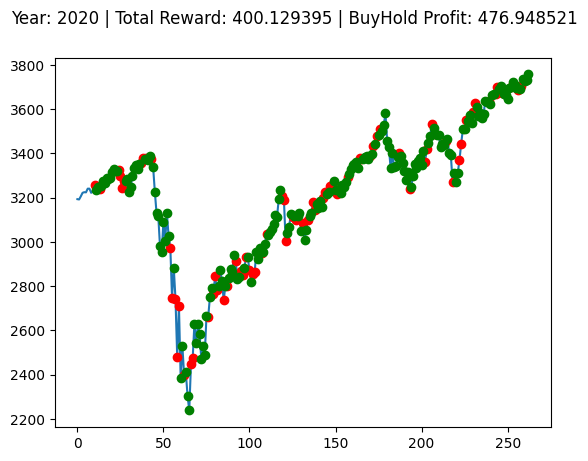

Buy And Hold: 1036.3717211914068


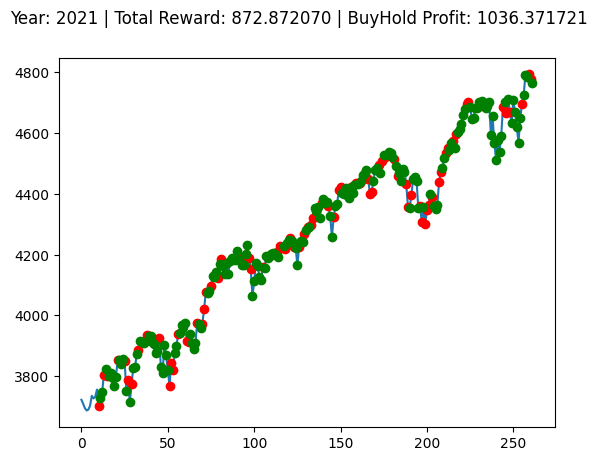

Buy And Hold: -971.472258300781


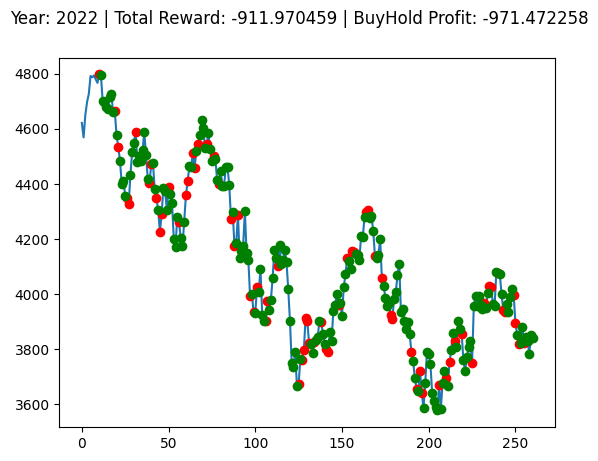

Buy And Hold: 917.112584228516


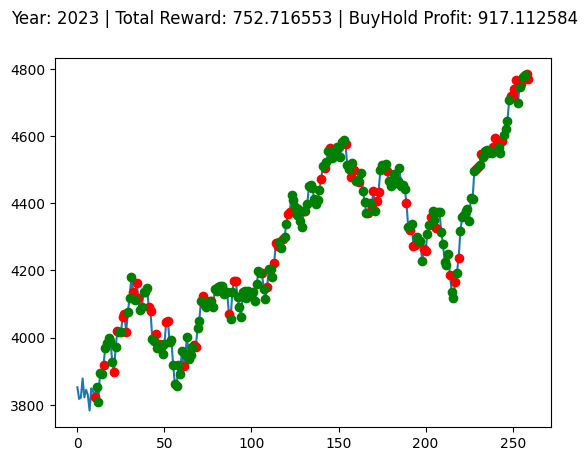

 19%|█▉        | 19/100 [07:06<30:10, 22.35s/it]

Buy And Hold: -200.5494116210939


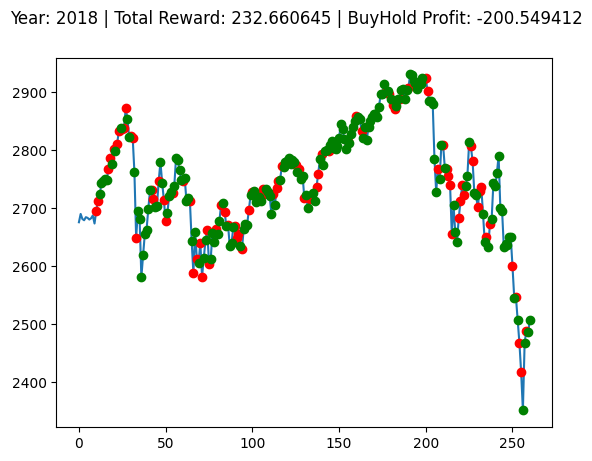

Buy And Hold: 700.9923498535159


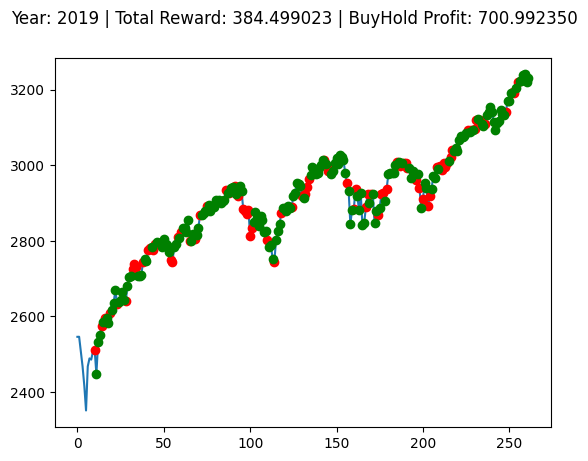

Buy And Hold: 476.9485205078122


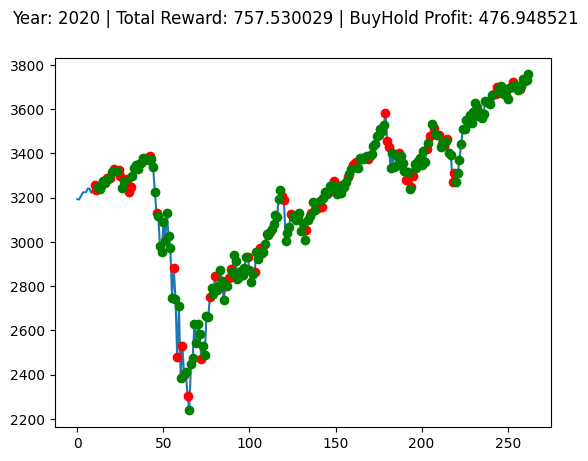

Buy And Hold: 1036.3717211914068


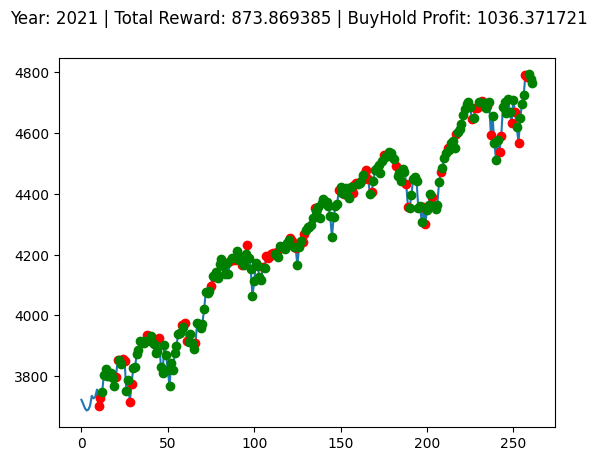

Buy And Hold: -971.472258300781


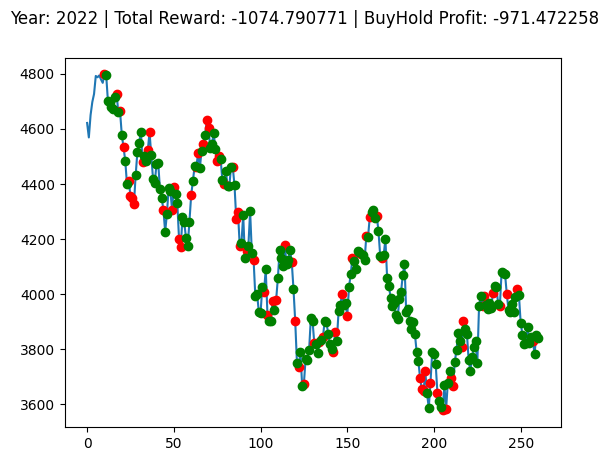

Buy And Hold: 917.112584228516


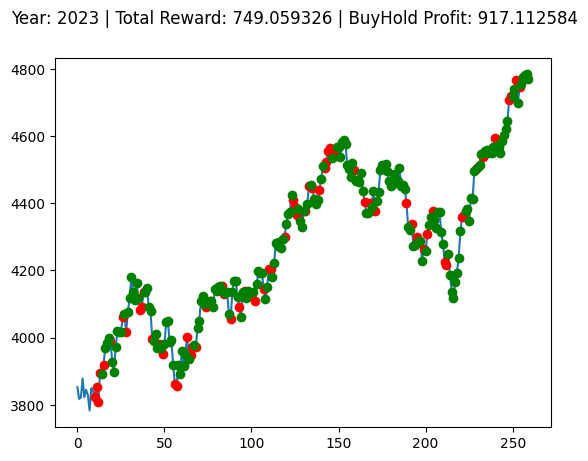

 20%|██        | 20/100 [07:28<30:01, 22.52s/it]

Buy And Hold: -200.5494116210939


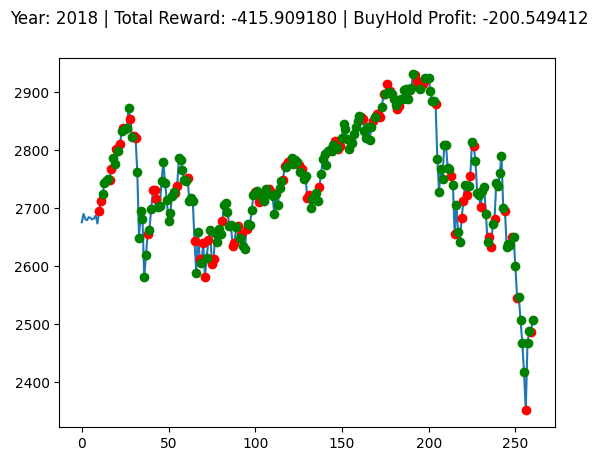

Buy And Hold: 700.9923498535159


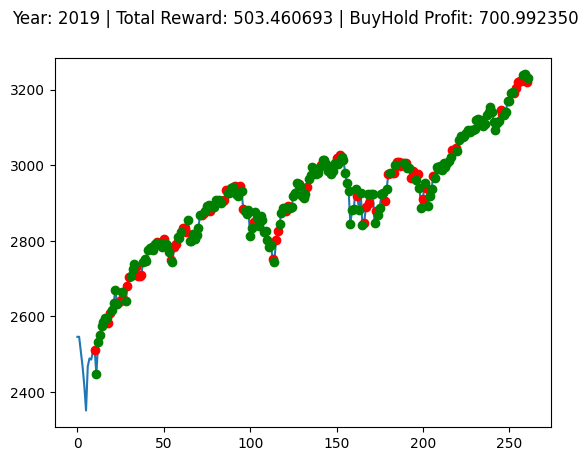

Buy And Hold: 476.9485205078122


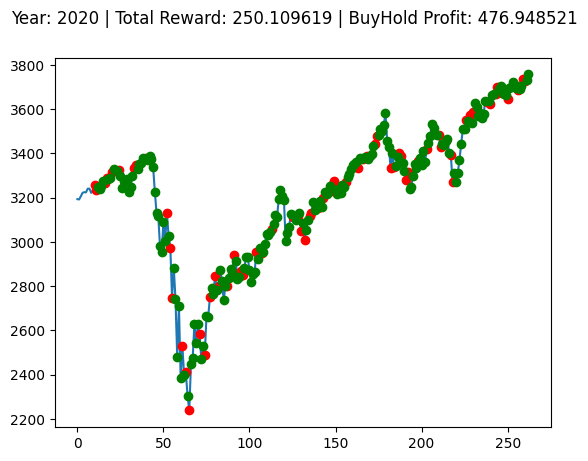

Buy And Hold: 1036.3717211914068


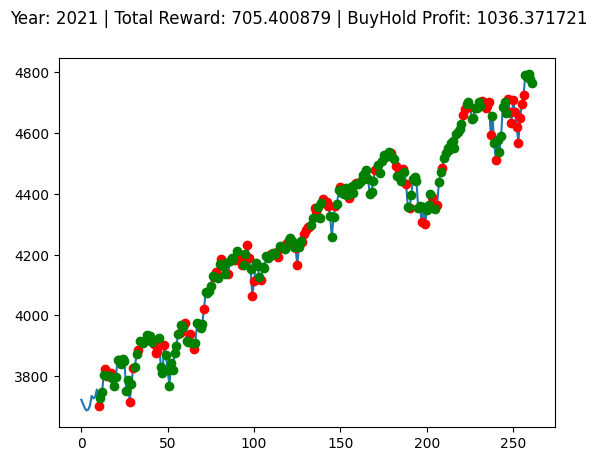

Buy And Hold: -971.472258300781


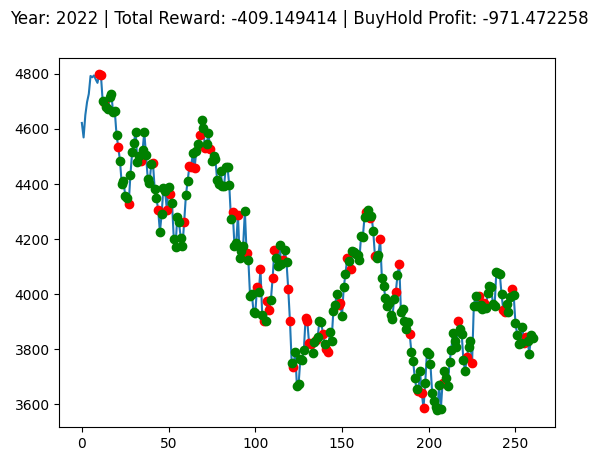

Buy And Hold: 917.112584228516


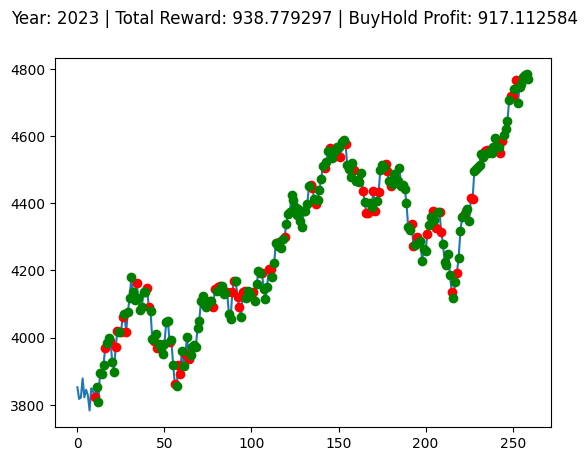

 21%|██        | 21/100 [07:51<29:37, 22.50s/it]

Buy And Hold: -200.5494116210939


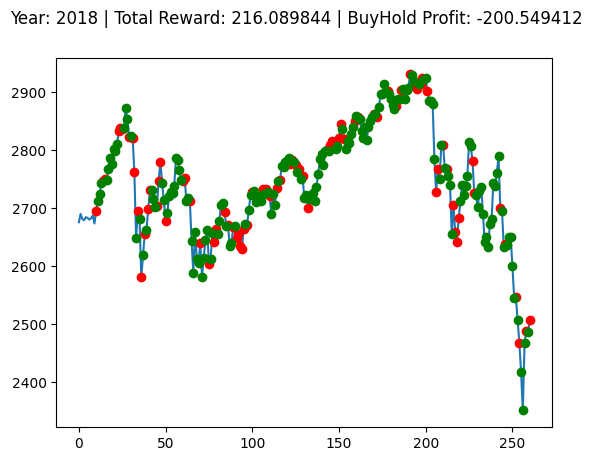

Buy And Hold: 700.9923498535159


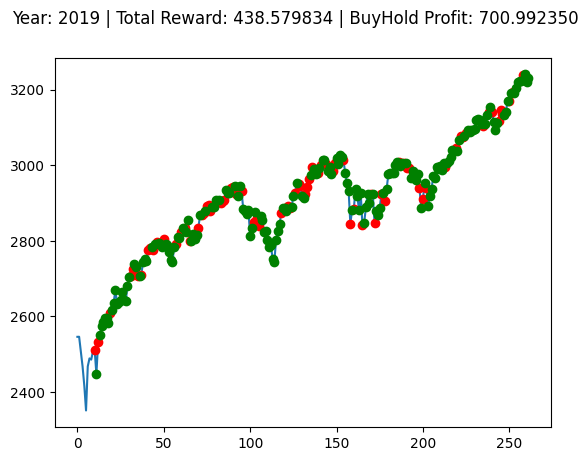

Buy And Hold: 476.9485205078122


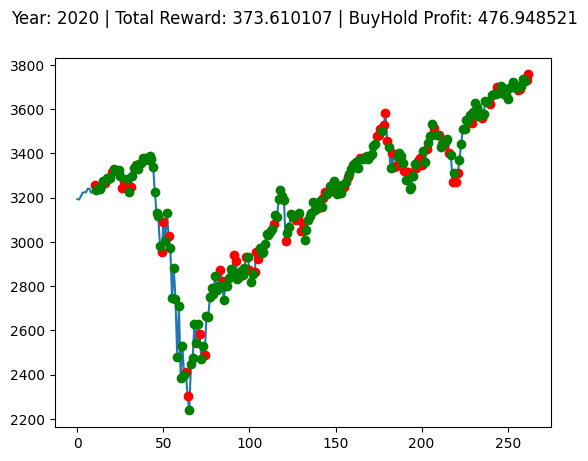

Buy And Hold: 1036.3717211914068


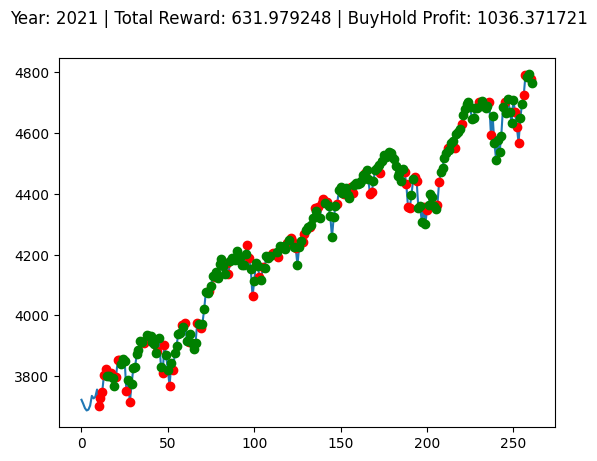

Buy And Hold: -971.472258300781


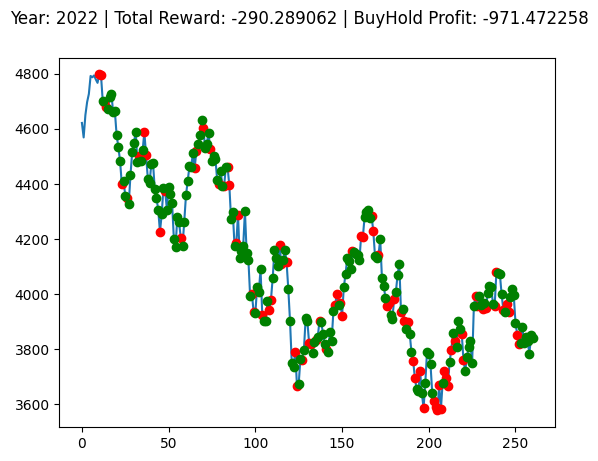

Buy And Hold: 917.112584228516


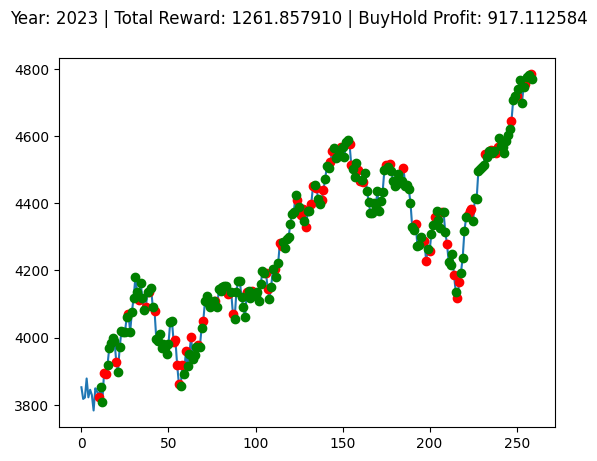

 22%|██▏       | 22/100 [08:14<29:30, 22.69s/it]

Buy And Hold: -200.5494116210939


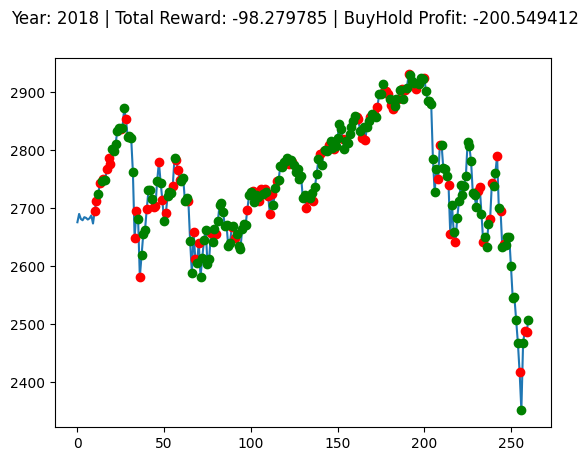

Buy And Hold: 700.9923498535159


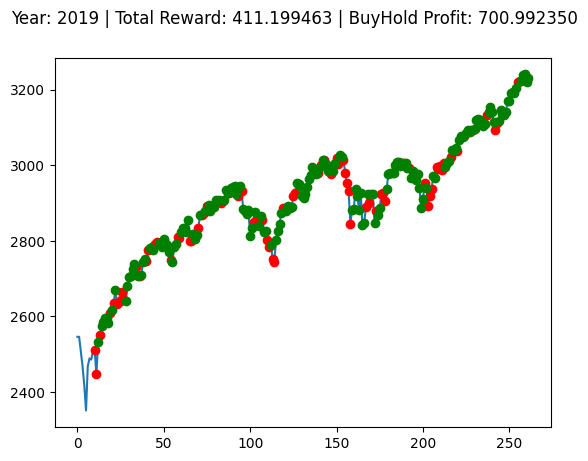

Buy And Hold: 476.9485205078122


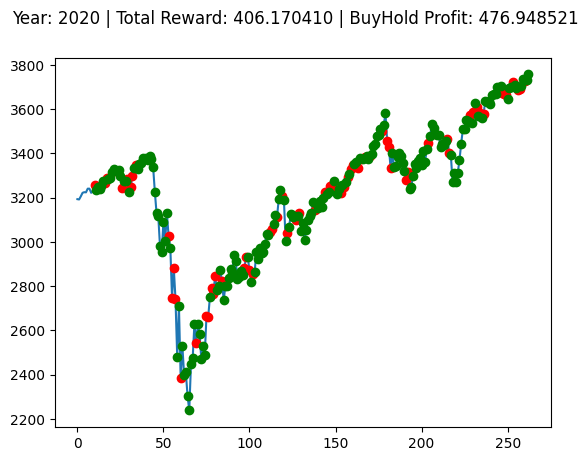

Buy And Hold: 1036.3717211914068


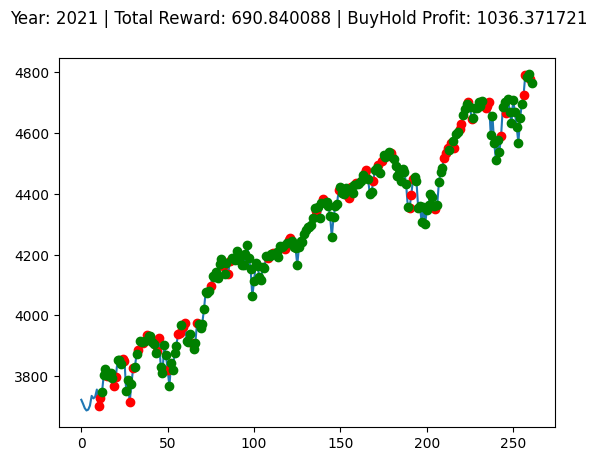

Buy And Hold: -971.472258300781


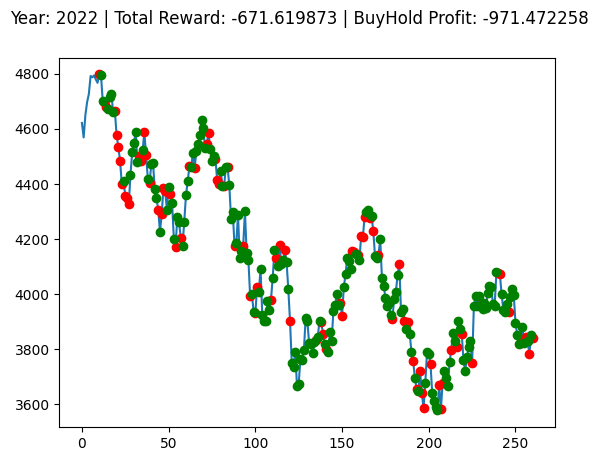

Buy And Hold: 917.112584228516


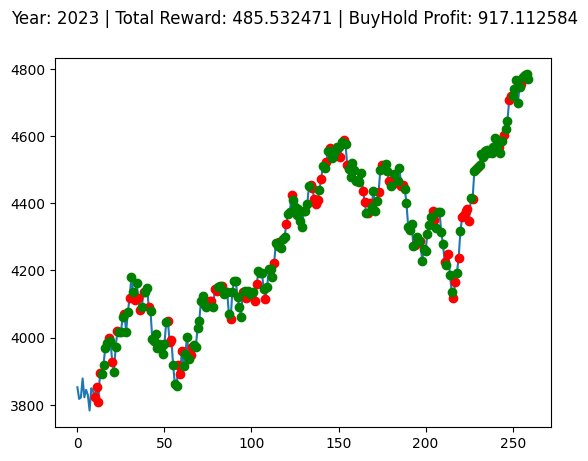

 23%|██▎       | 23/100 [08:37<29:11, 22.74s/it]

Buy And Hold: -200.5494116210939


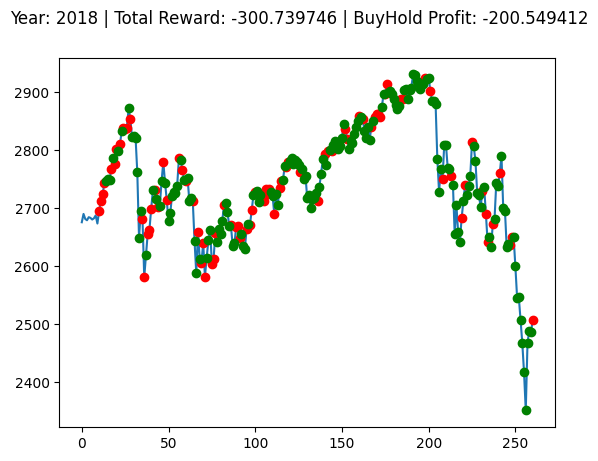

Buy And Hold: 700.9923498535159


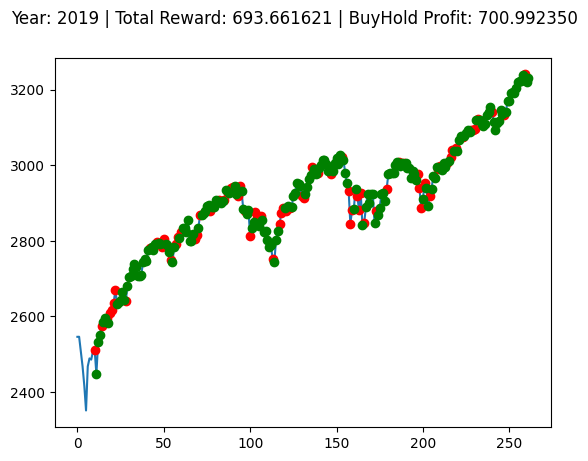

Buy And Hold: 476.9485205078122


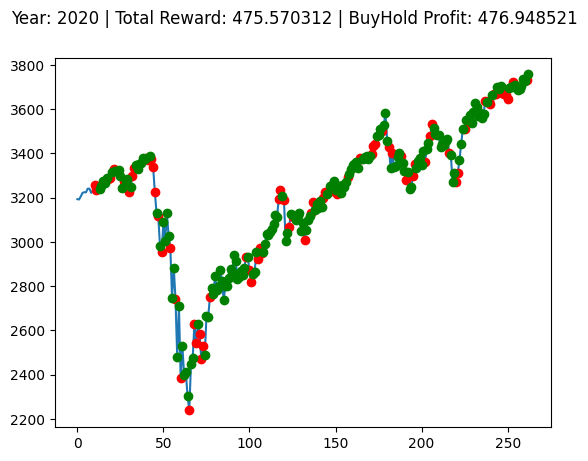

Buy And Hold: 1036.3717211914068


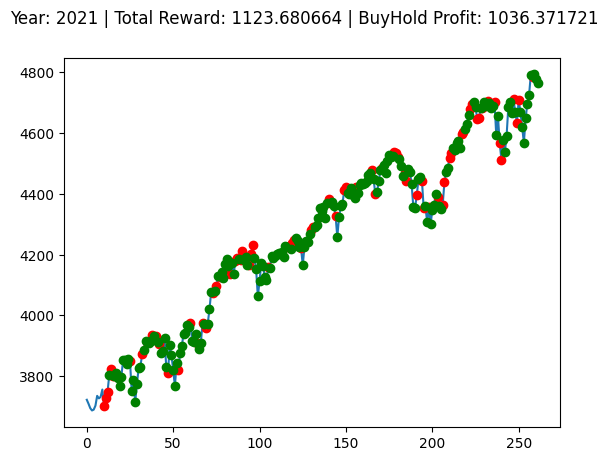

Buy And Hold: -971.472258300781


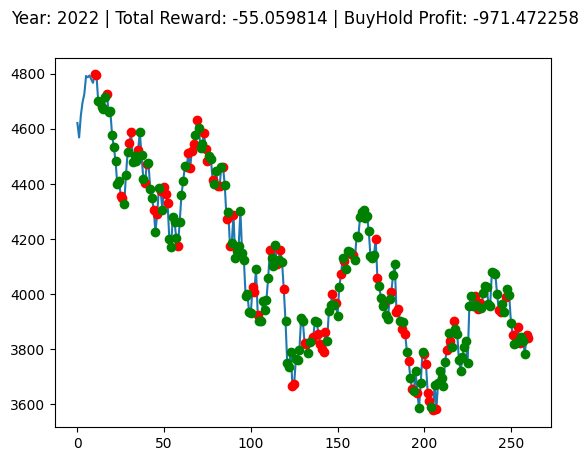

Buy And Hold: 917.112584228516


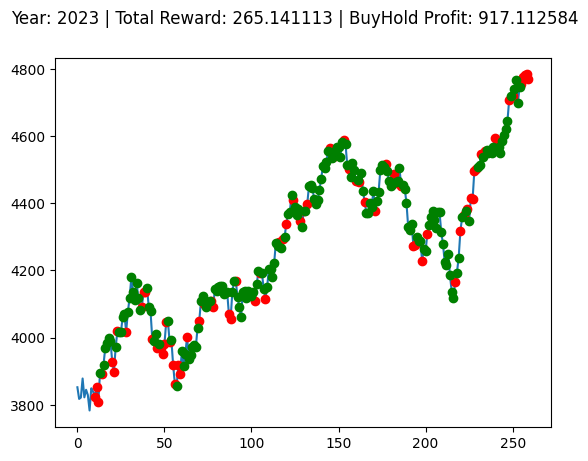

 24%|██▍       | 24/100 [08:59<28:40, 22.63s/it]

Buy And Hold: -200.5494116210939


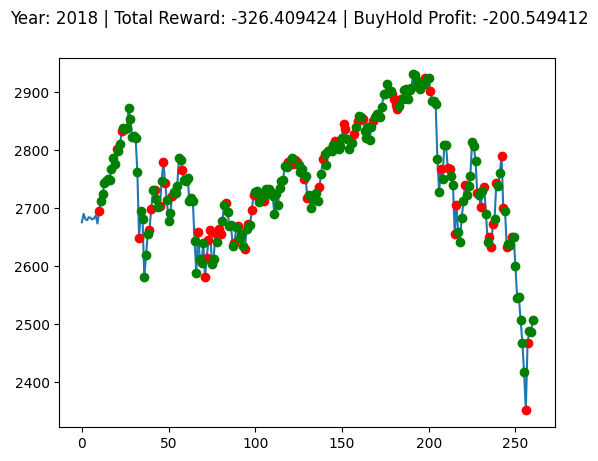

Buy And Hold: 700.9923498535159


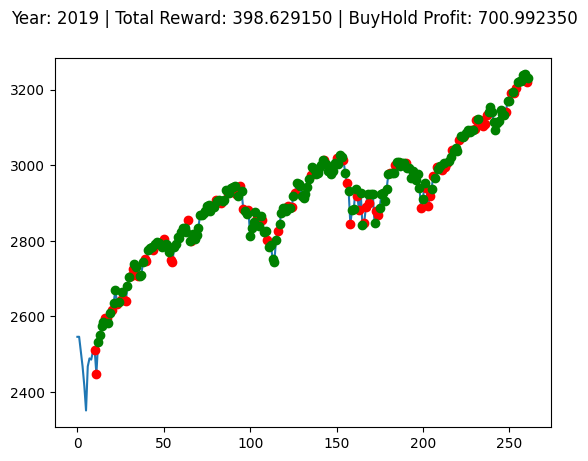

Buy And Hold: 476.9485205078122


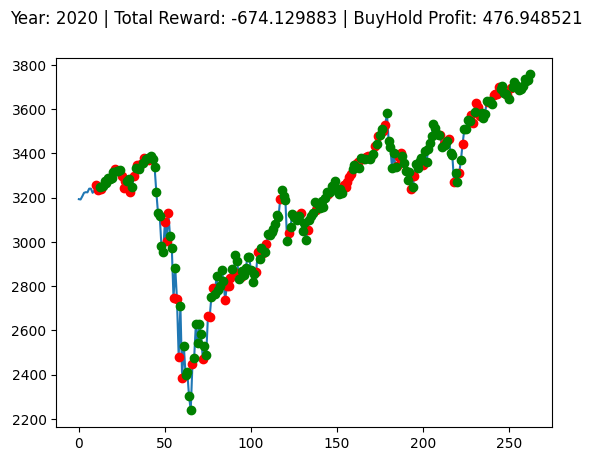

Buy And Hold: 1036.3717211914068


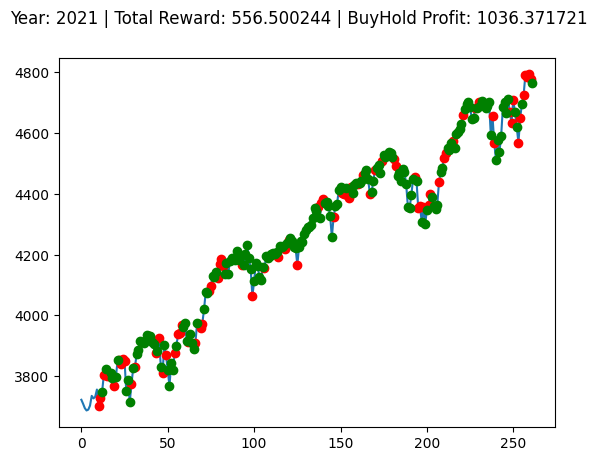

Buy And Hold: -971.472258300781


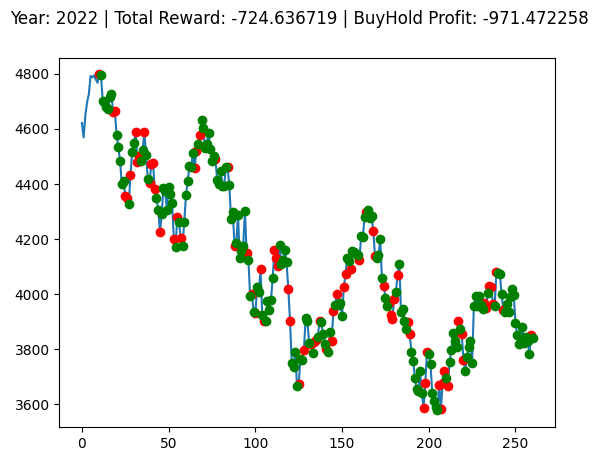

Buy And Hold: 917.112584228516


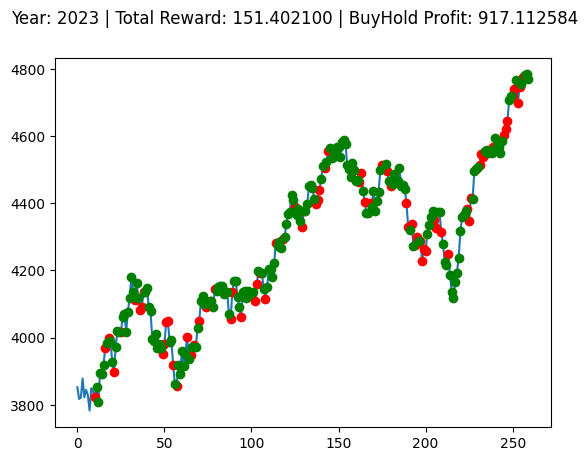

 25%|██▌       | 25/100 [09:22<28:08, 22.52s/it]

Buy And Hold: -200.5494116210939


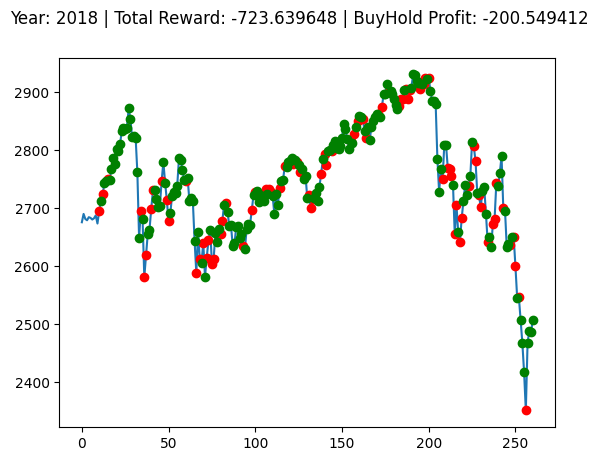

Buy And Hold: 700.9923498535159


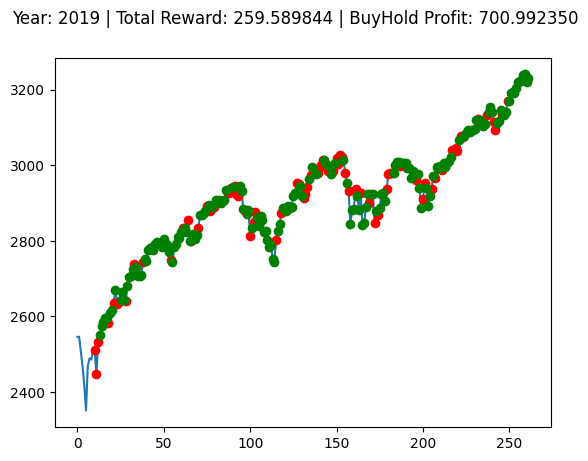

Buy And Hold: 476.9485205078122


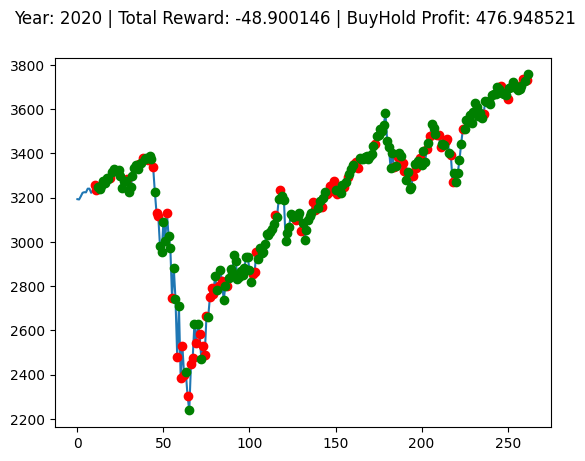

Buy And Hold: 1036.3717211914068


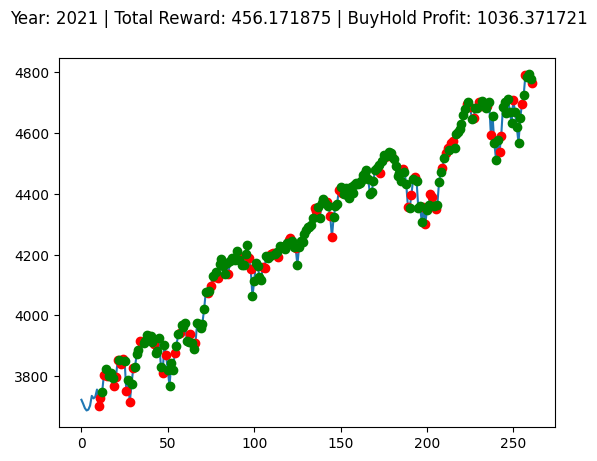

Buy And Hold: -971.472258300781


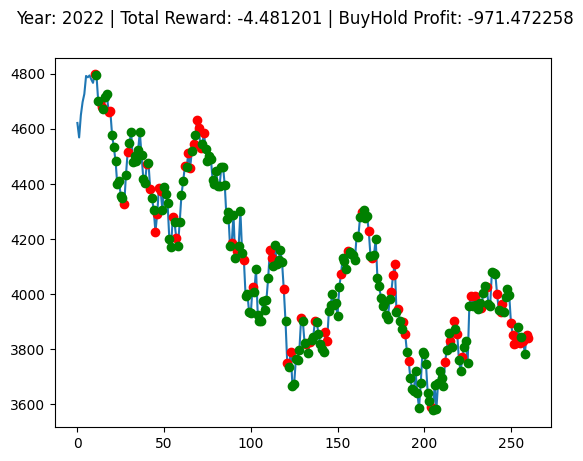

Buy And Hold: 917.112584228516


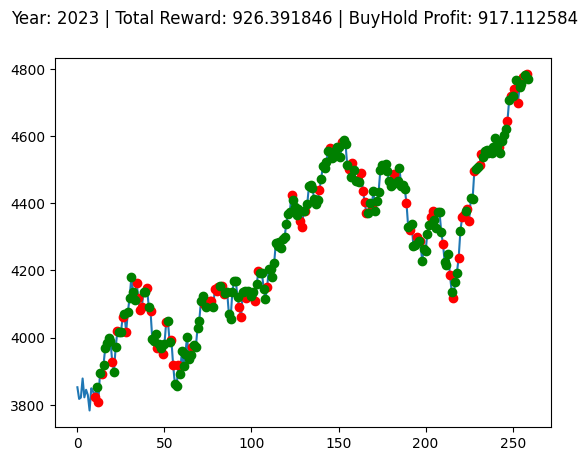

 26%|██▌       | 26/100 [09:44<27:40, 22.44s/it]

Buy And Hold: -200.5494116210939


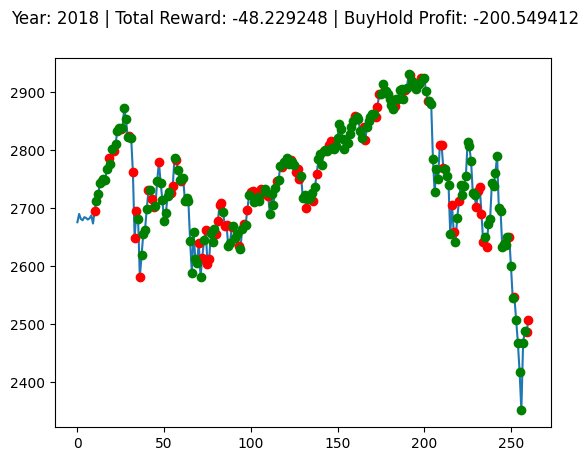

Buy And Hold: 700.9923498535159


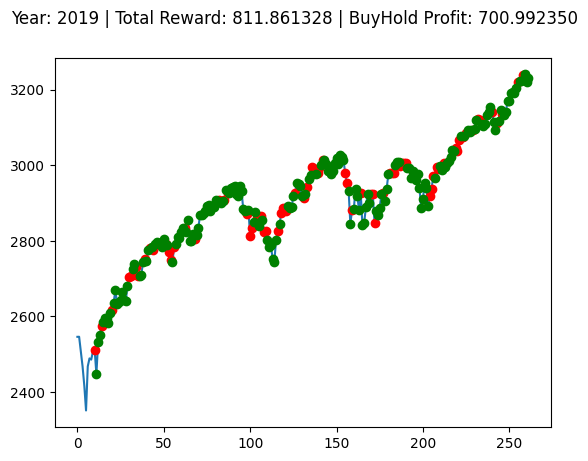

Buy And Hold: 476.9485205078122


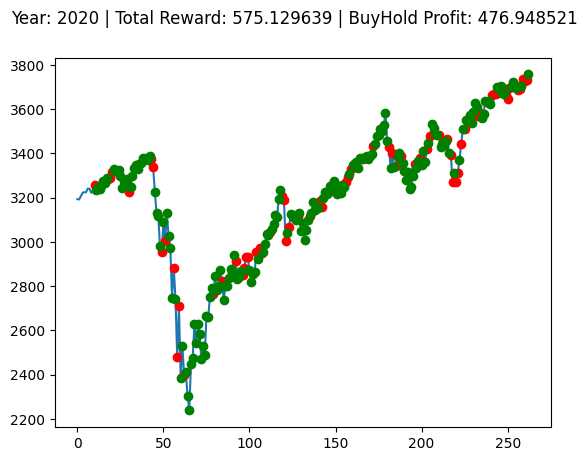

Buy And Hold: 1036.3717211914068


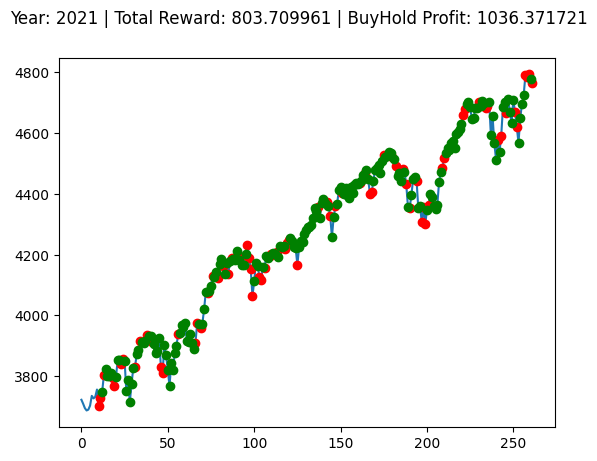

Buy And Hold: -971.472258300781


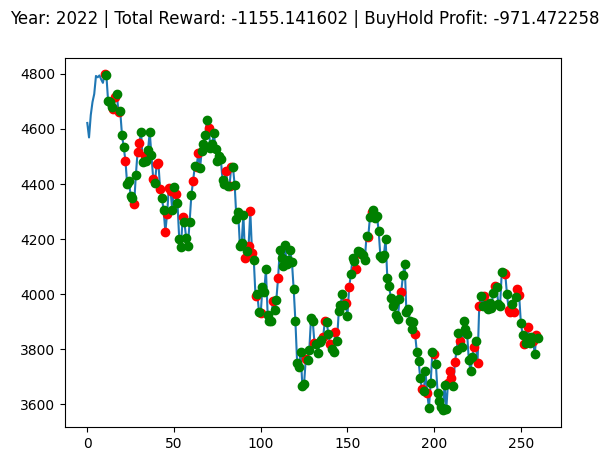

Buy And Hold: 917.112584228516


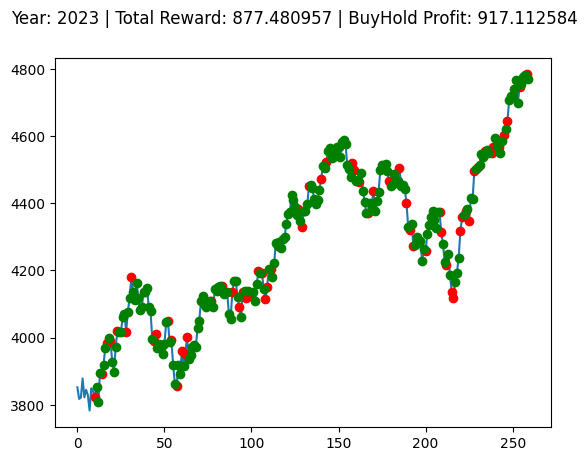

 27%|██▋       | 27/100 [10:07<27:32, 22.64s/it]

Buy And Hold: -200.5494116210939


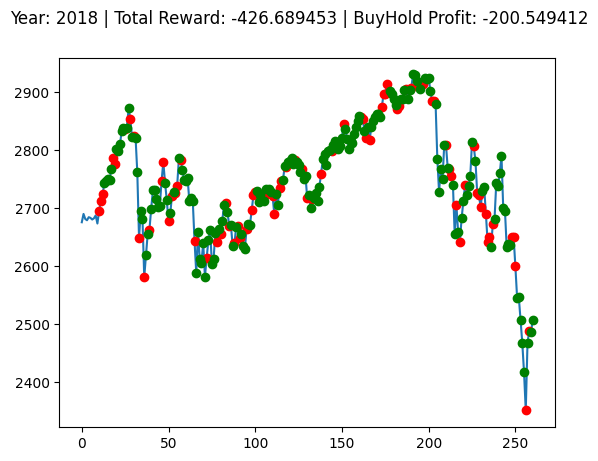

Buy And Hold: 700.9923498535159


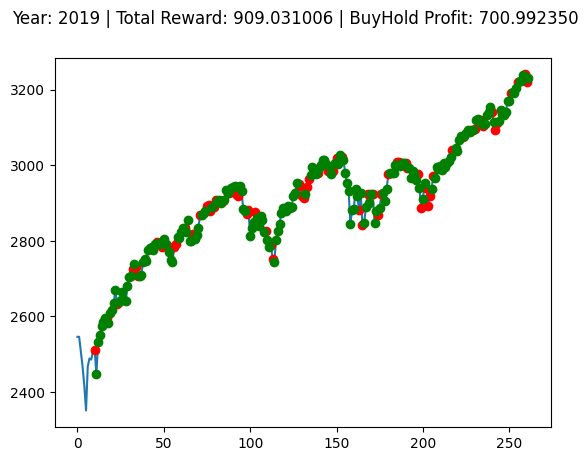

Buy And Hold: 476.9485205078122


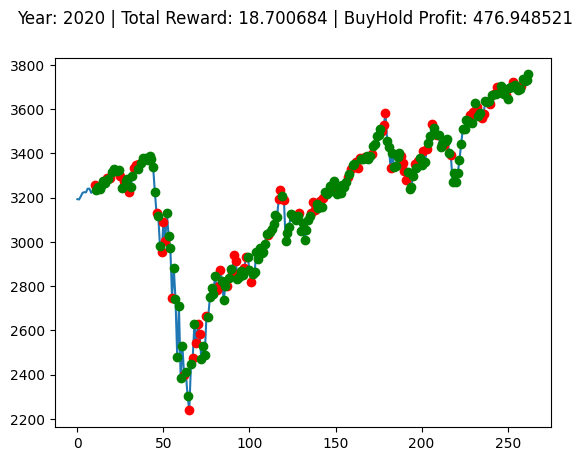

Buy And Hold: 1036.3717211914068


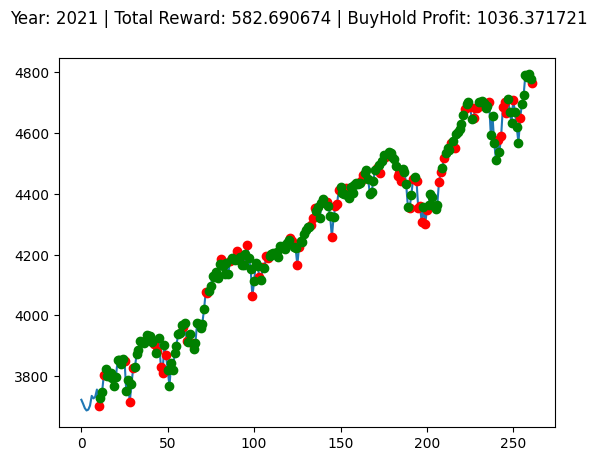

Buy And Hold: -971.472258300781


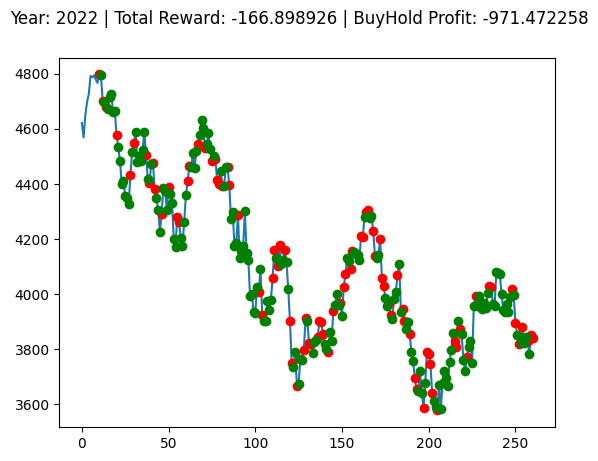

Buy And Hold: 917.112584228516


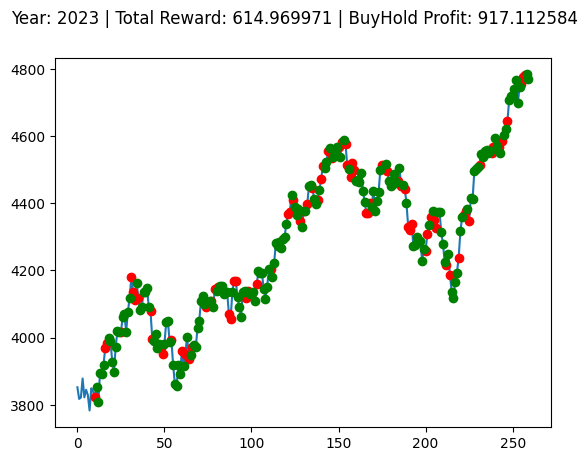

 28%|██▊       | 28/100 [10:30<27:14, 22.70s/it]

Buy And Hold: -200.5494116210939


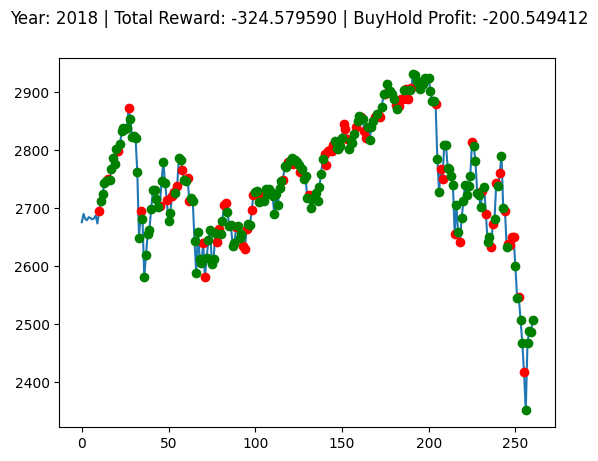

Buy And Hold: 700.9923498535159


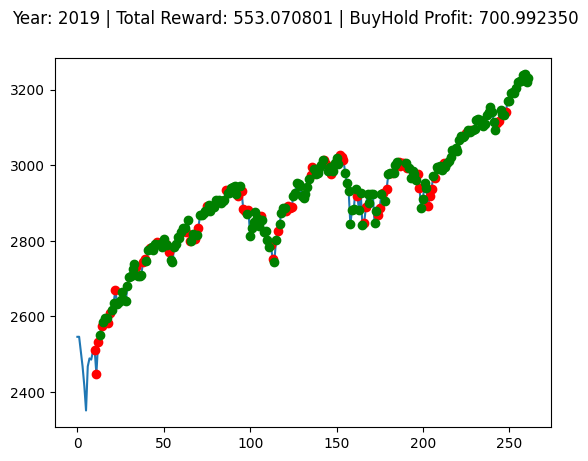

Buy And Hold: 476.9485205078122


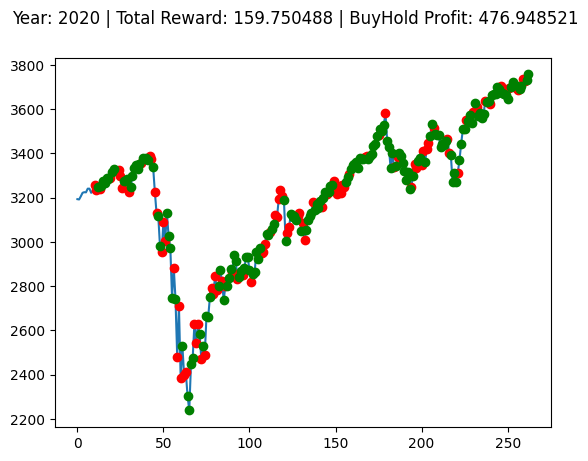

Buy And Hold: 1036.3717211914068


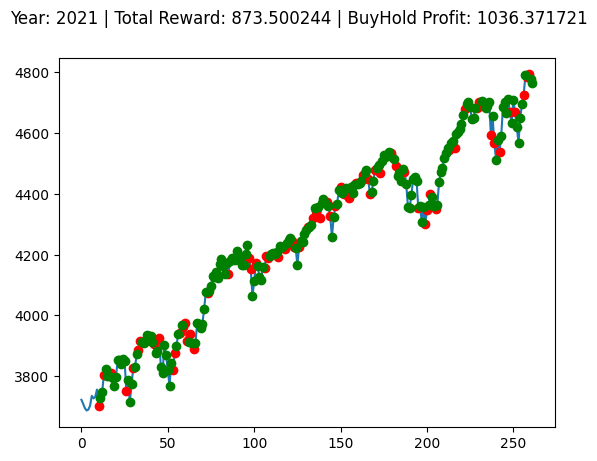

Buy And Hold: -971.472258300781


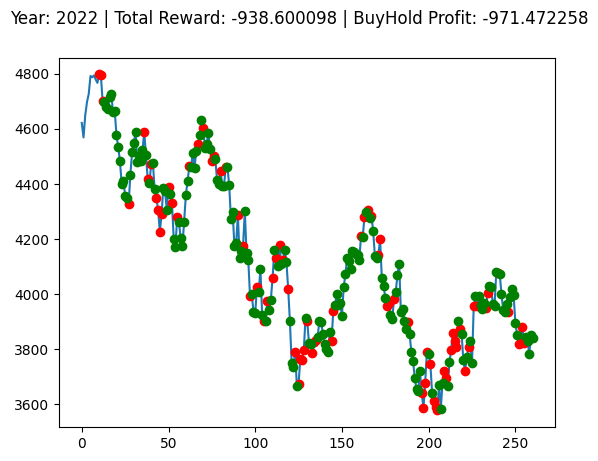

Buy And Hold: 917.112584228516


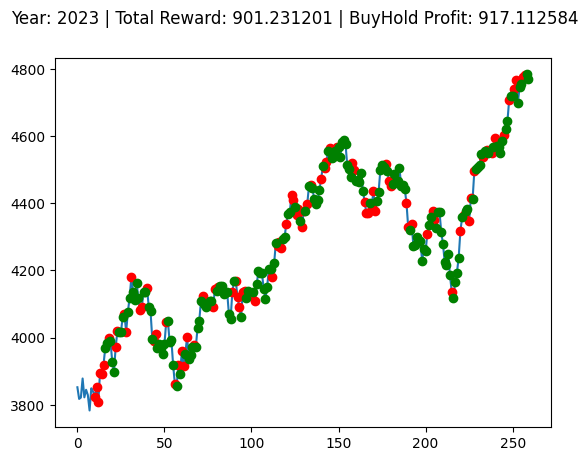

 29%|██▉       | 29/100 [10:52<26:49, 22.67s/it]

Buy And Hold: -200.5494116210939


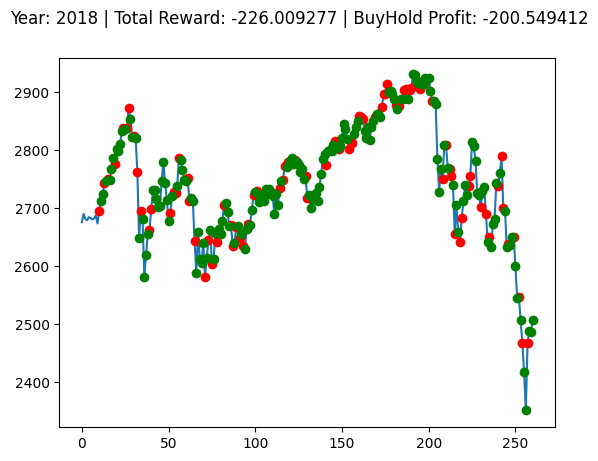

Buy And Hold: 700.9923498535159


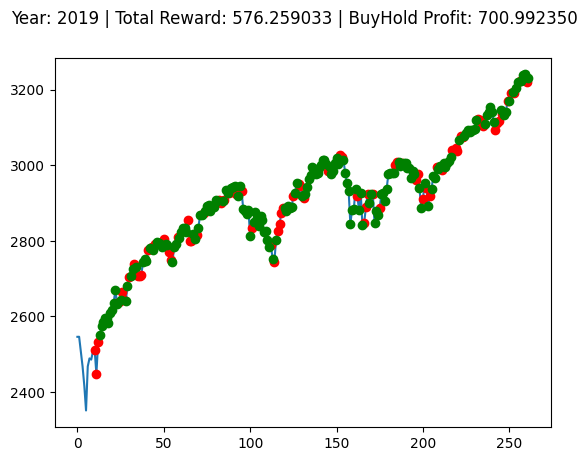

Buy And Hold: 476.9485205078122


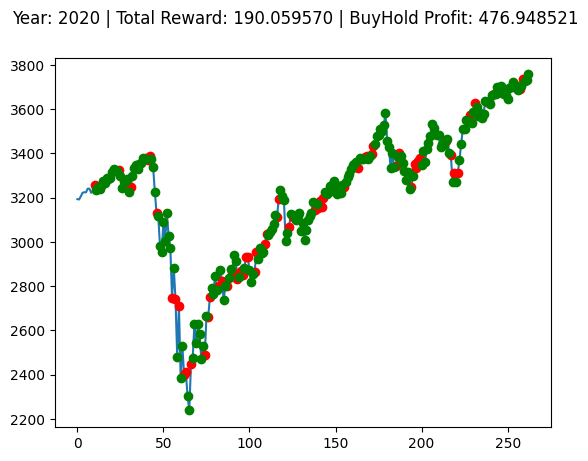

Buy And Hold: 1036.3717211914068


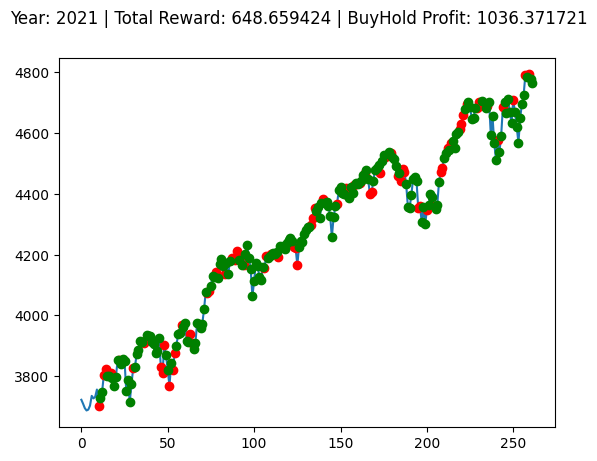

Buy And Hold: -971.472258300781


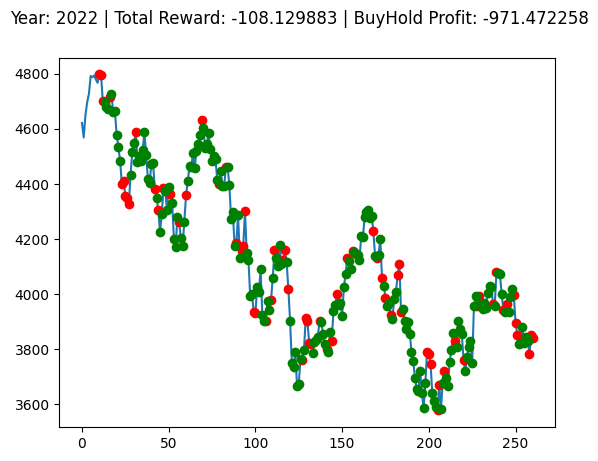

Buy And Hold: 917.112584228516


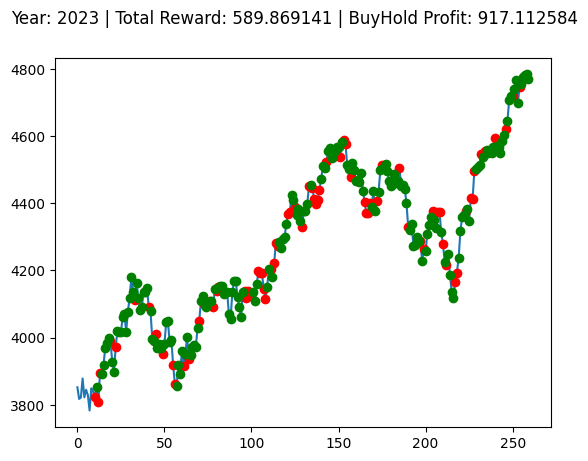

 30%|███       | 30/100 [11:16<26:48, 22.98s/it]

Buy And Hold: -200.5494116210939


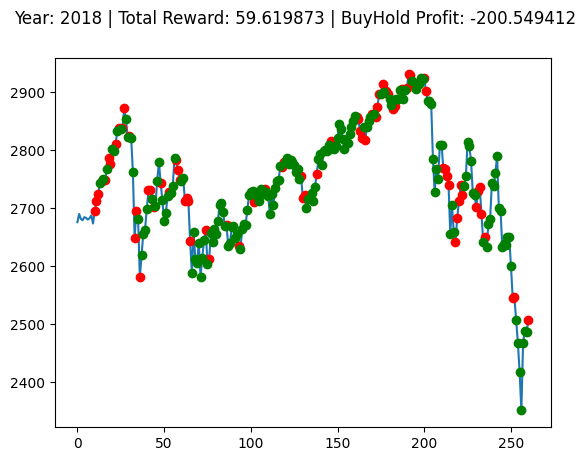

Buy And Hold: 700.9923498535159


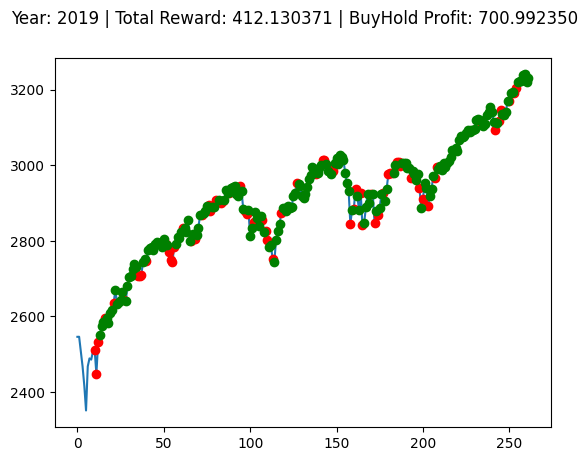

Buy And Hold: 476.9485205078122


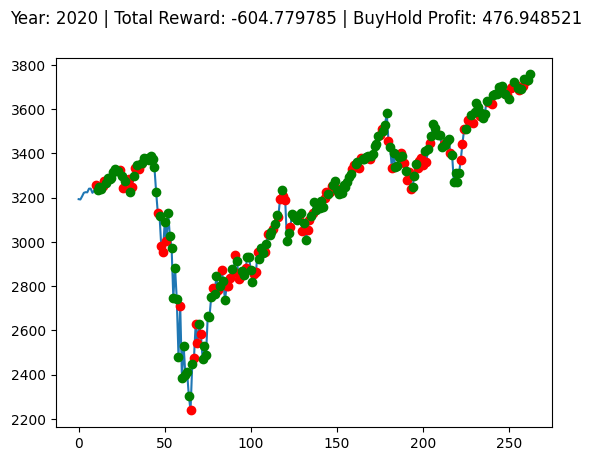

Buy And Hold: 1036.3717211914068


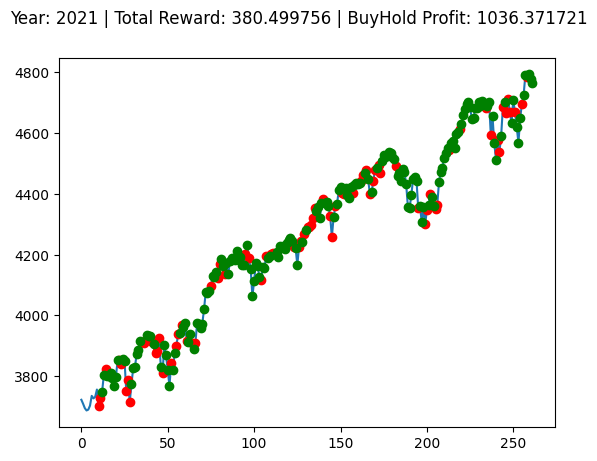

Buy And Hold: -971.472258300781


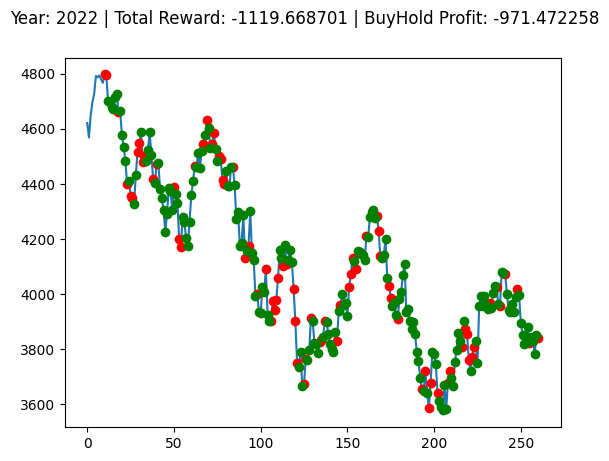

Buy And Hold: 917.112584228516


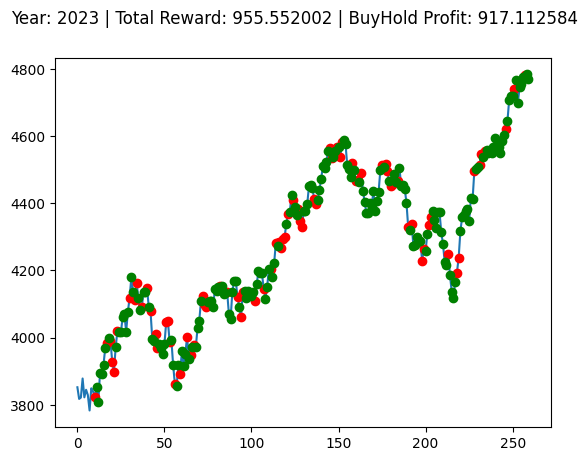

 31%|███       | 31/100 [11:39<26:21, 22.92s/it]

Buy And Hold: -200.5494116210939


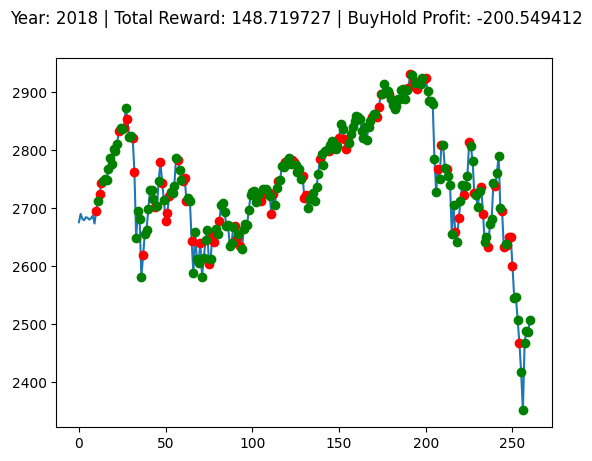

Buy And Hold: 700.9923498535159


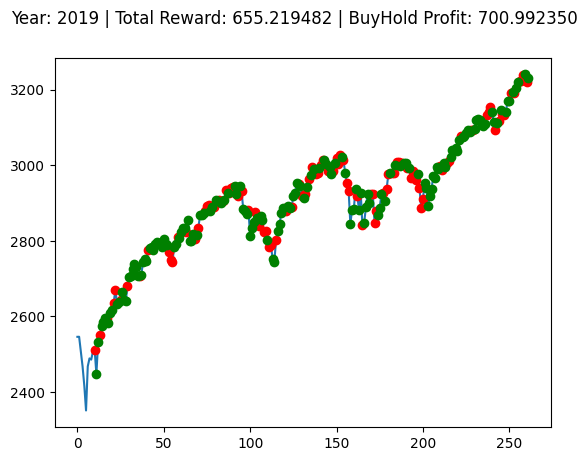

Buy And Hold: 476.9485205078122


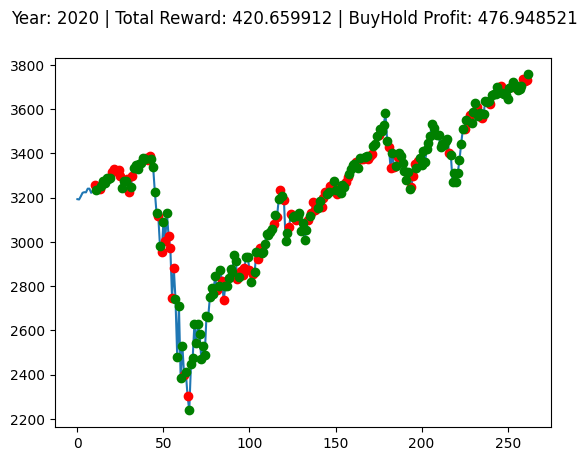

Buy And Hold: 1036.3717211914068


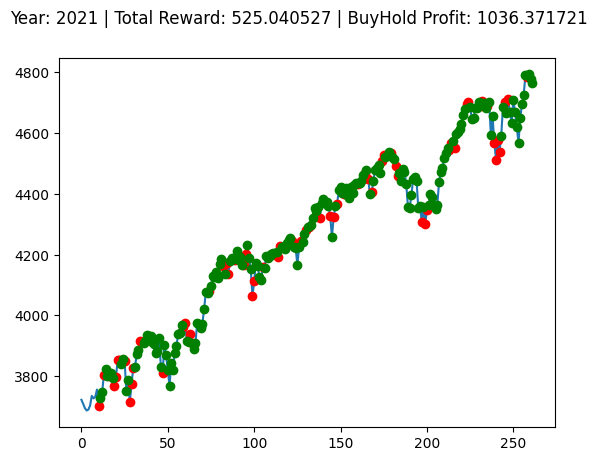

Buy And Hold: -971.472258300781


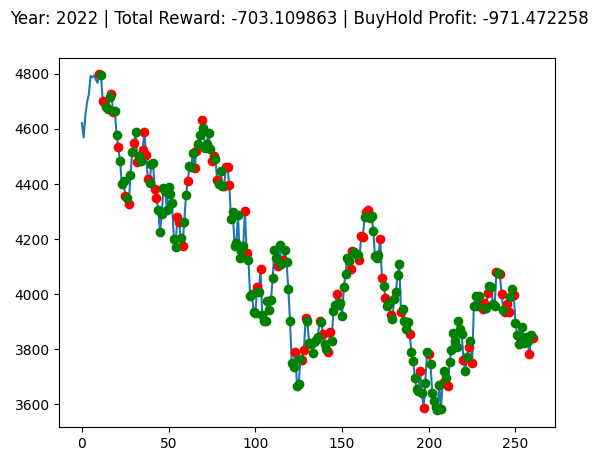

Buy And Hold: 917.112584228516


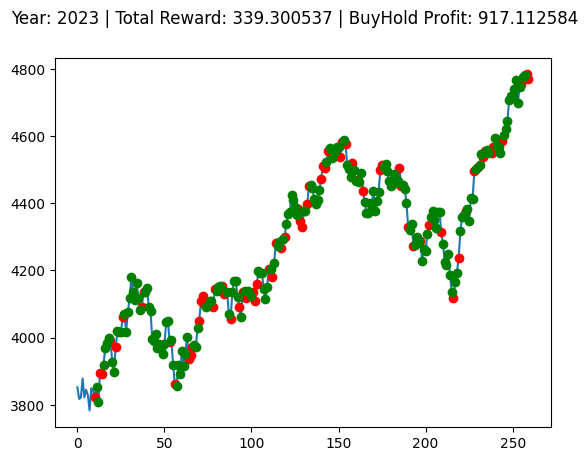

 32%|███▏      | 32/100 [12:02<25:57, 22.90s/it]

Buy And Hold: -200.5494116210939


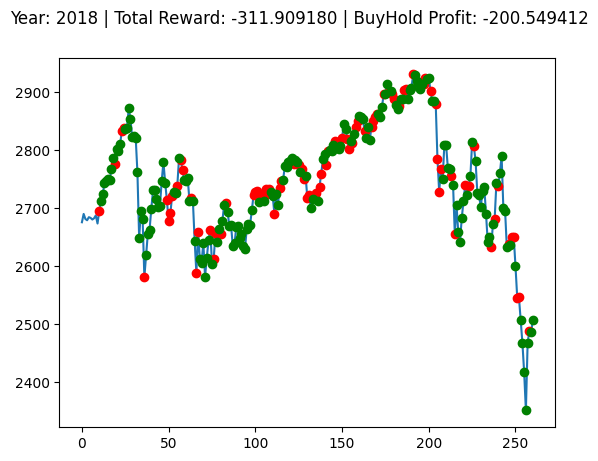

Buy And Hold: 700.9923498535159


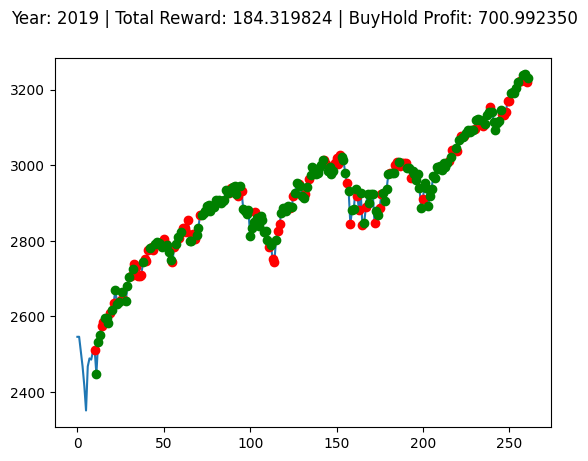

Buy And Hold: 476.9485205078122


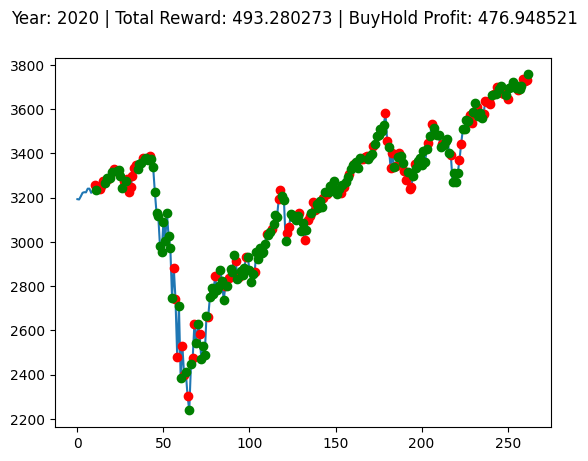

Buy And Hold: 1036.3717211914068


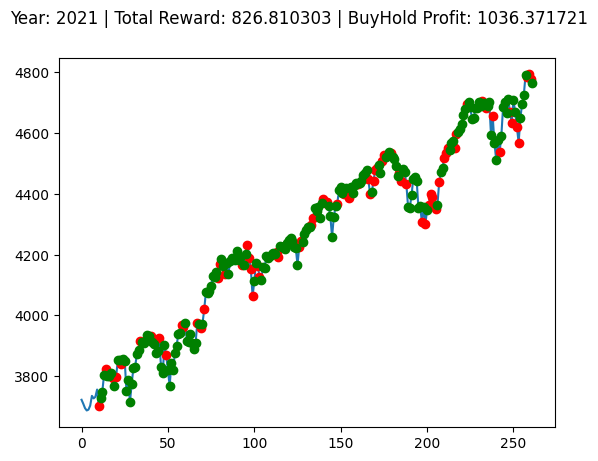

Buy And Hold: -971.472258300781


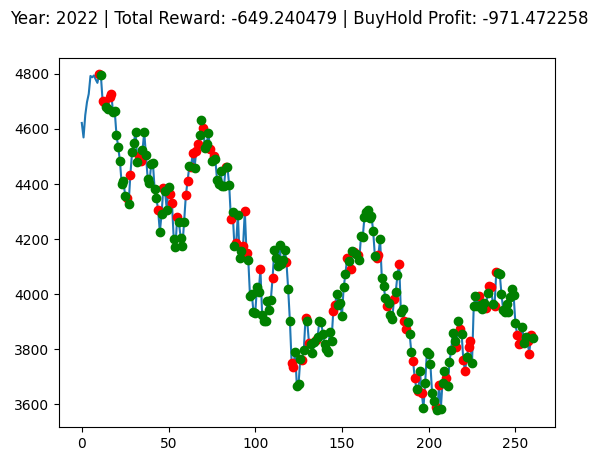

Buy And Hold: 917.112584228516


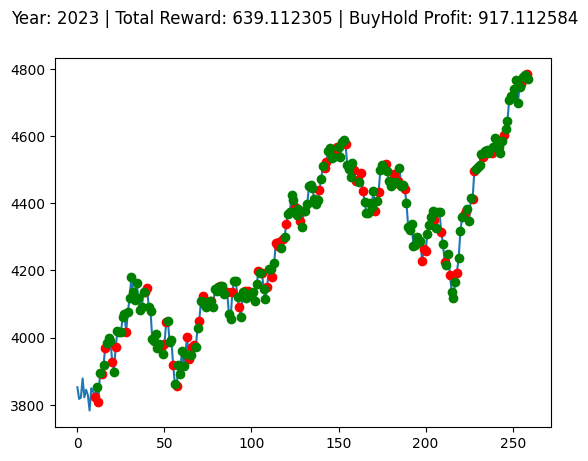

 33%|███▎      | 33/100 [12:24<25:31, 22.85s/it]

Buy And Hold: -200.5494116210939


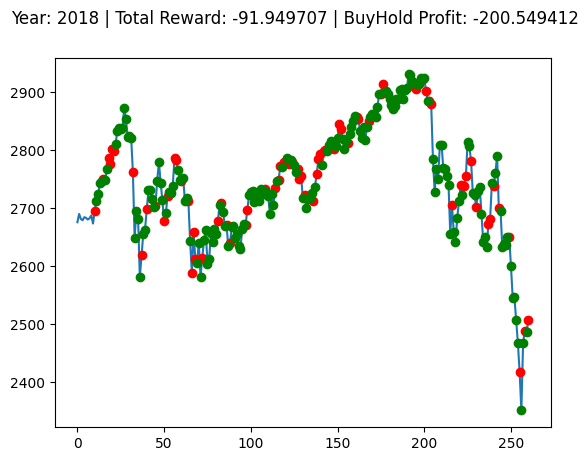

Buy And Hold: 700.9923498535159


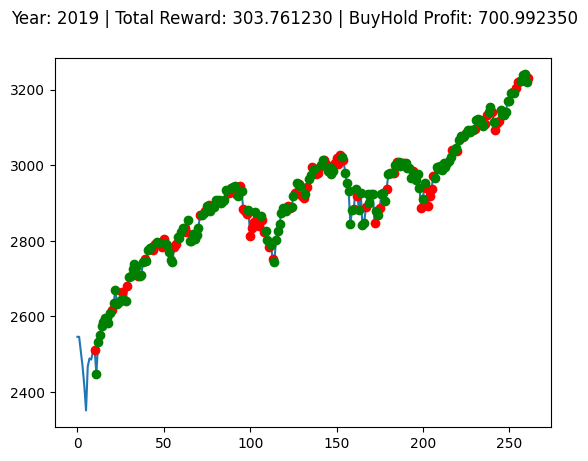

Buy And Hold: 476.9485205078122


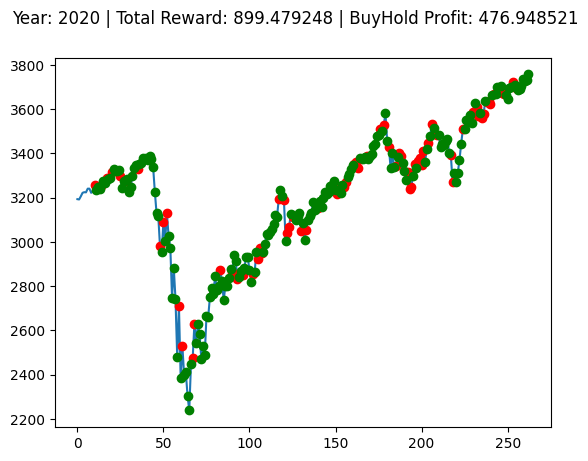

Buy And Hold: 1036.3717211914068


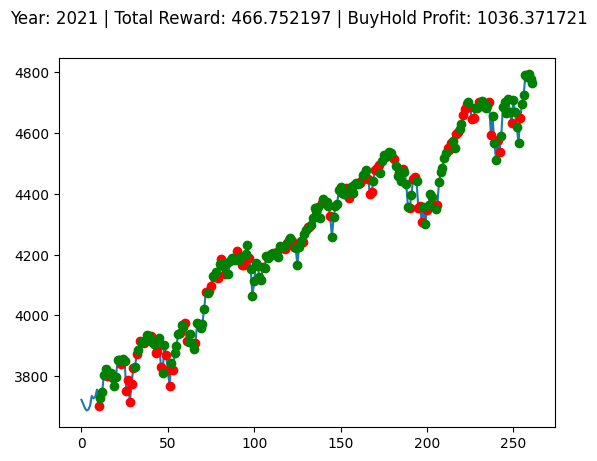

Buy And Hold: -971.472258300781


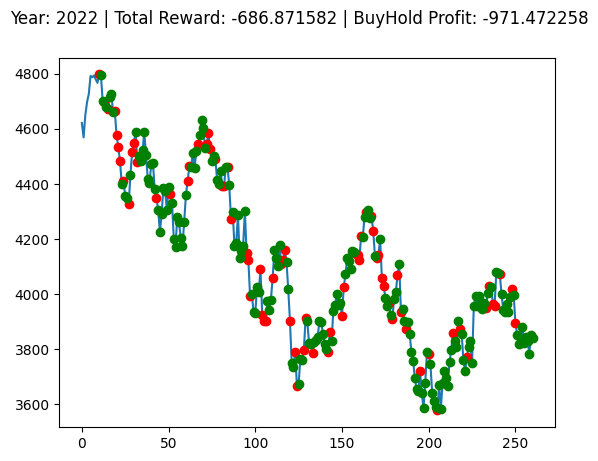

Buy And Hold: 917.112584228516


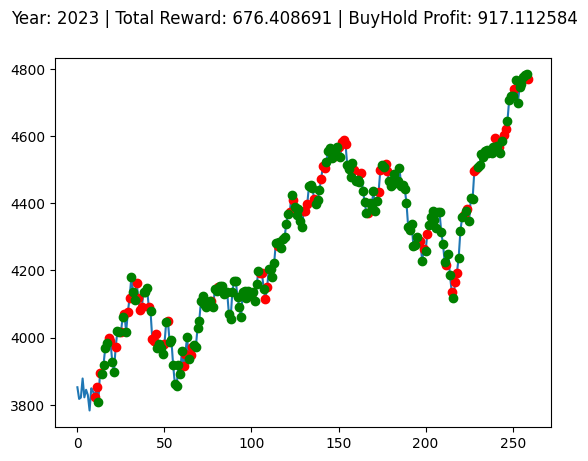

 34%|███▍      | 34/100 [12:47<25:11, 22.91s/it]

Buy And Hold: -200.5494116210939


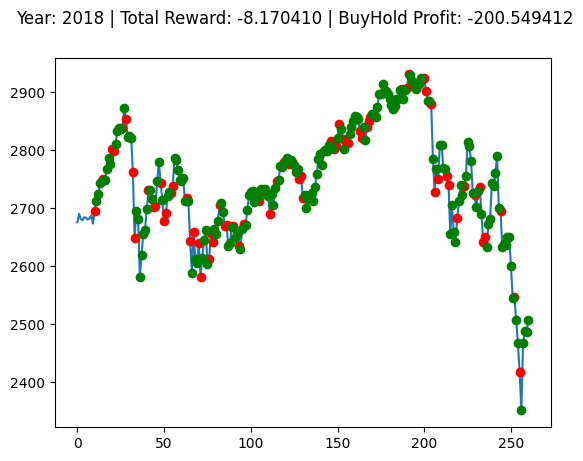

Buy And Hold: 700.9923498535159


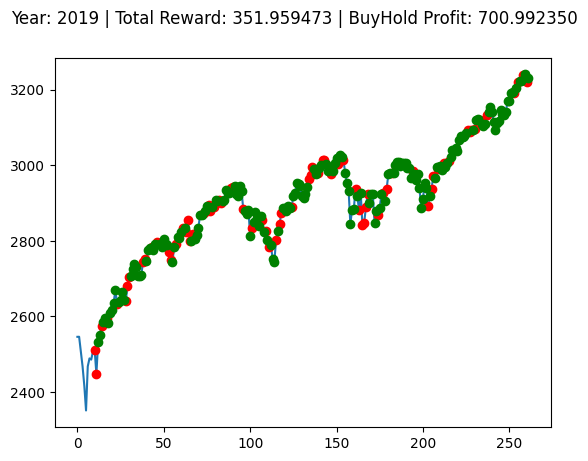

Buy And Hold: 476.9485205078122


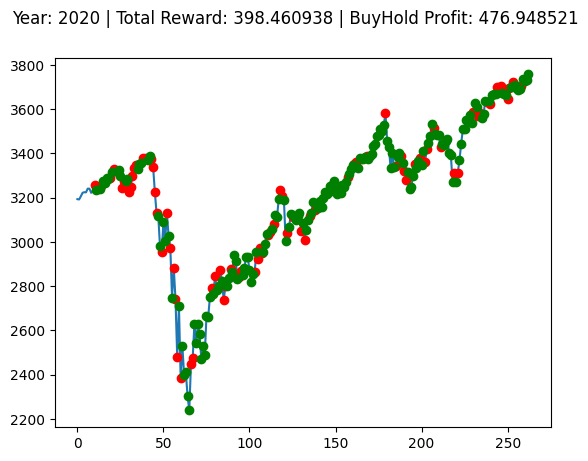

Buy And Hold: 1036.3717211914068


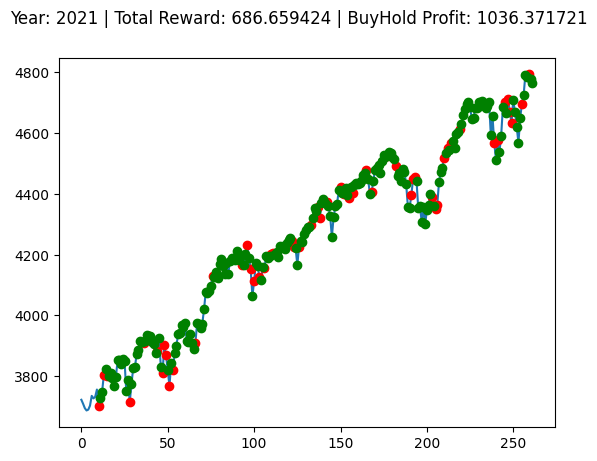

Buy And Hold: -971.472258300781


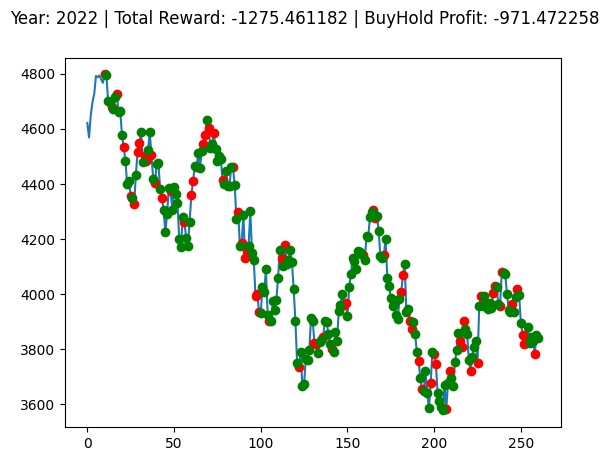

Buy And Hold: 917.112584228516


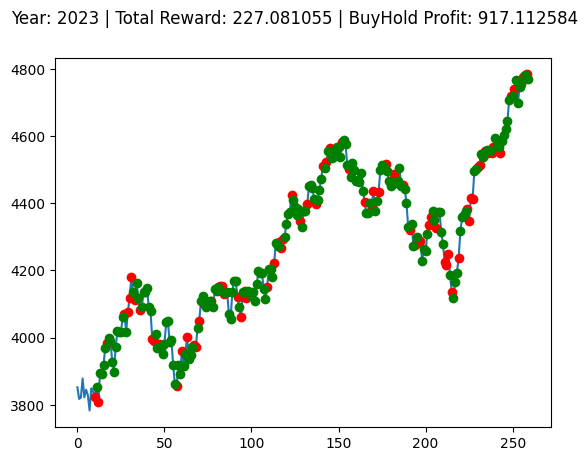

 35%|███▌      | 35/100 [13:10<24:33, 22.67s/it]

Buy And Hold: -200.5494116210939


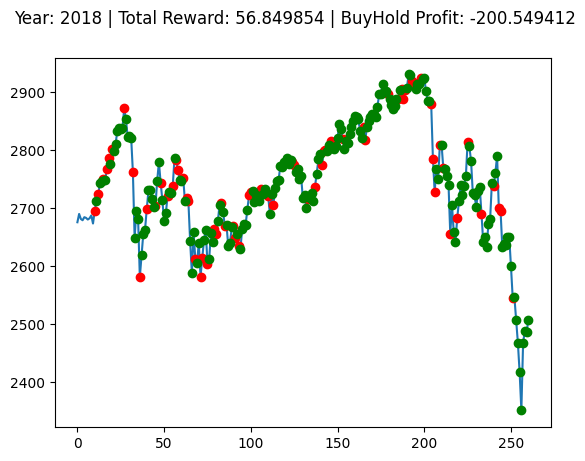

Buy And Hold: 700.9923498535159


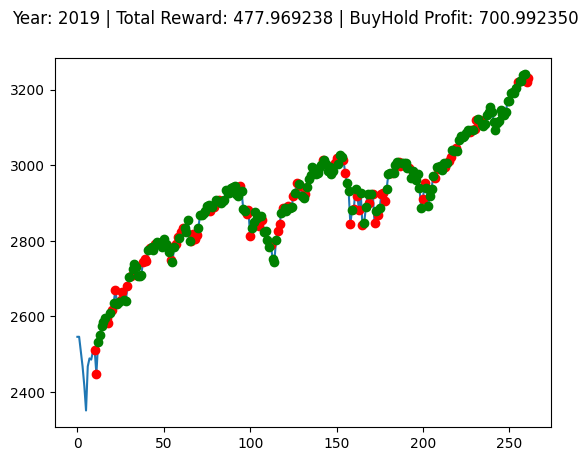

Buy And Hold: 476.9485205078122


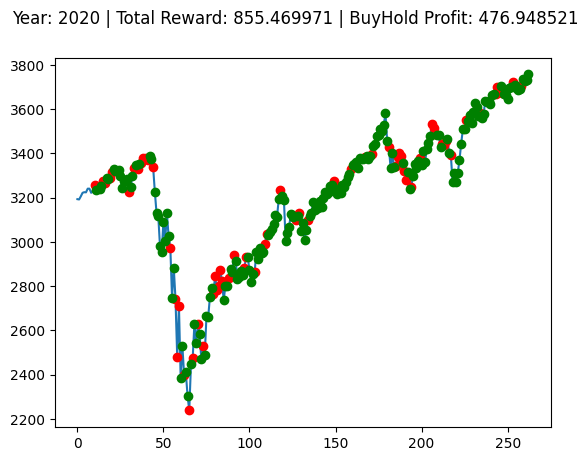

Buy And Hold: 1036.3717211914068


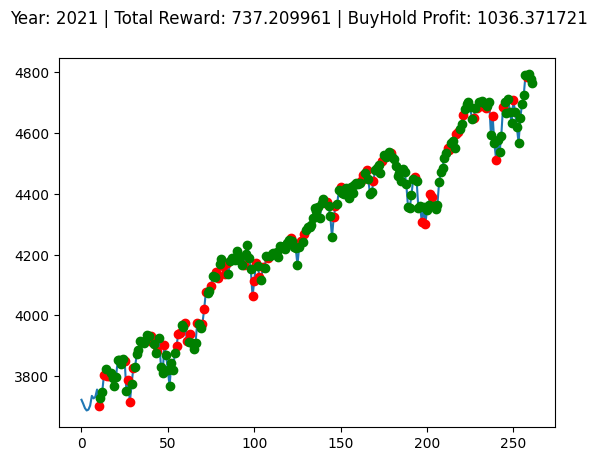

Buy And Hold: -971.472258300781


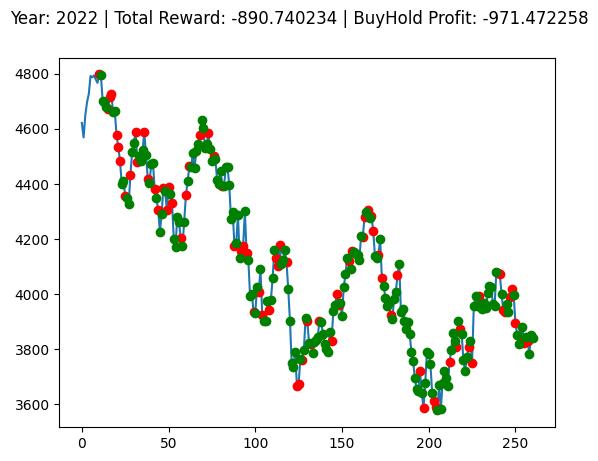

Buy And Hold: 917.112584228516


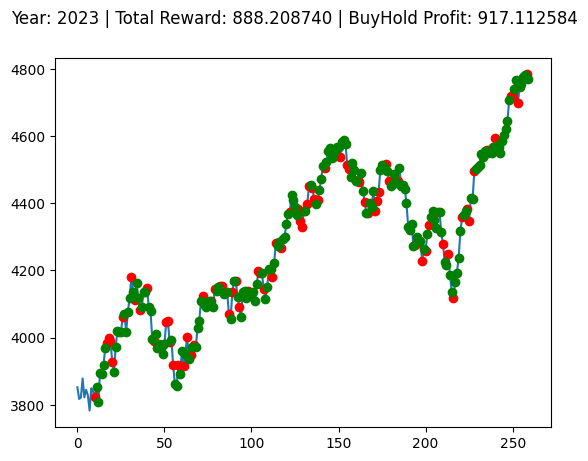

 36%|███▌      | 36/100 [13:32<24:15, 22.74s/it]

Buy And Hold: -200.5494116210939


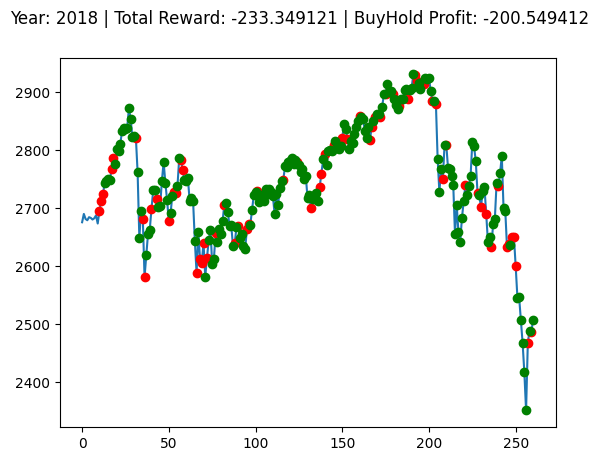

Buy And Hold: 700.9923498535159


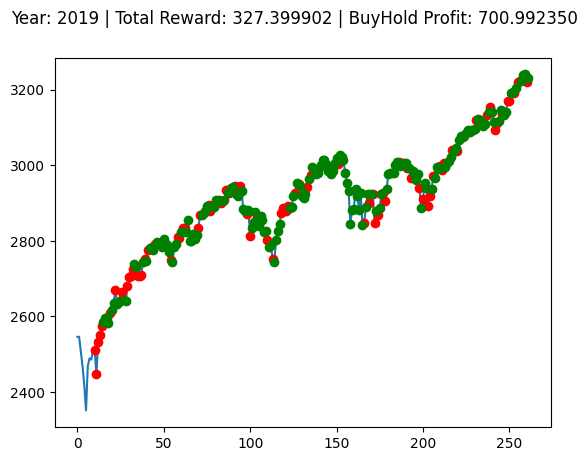

Buy And Hold: 476.9485205078122


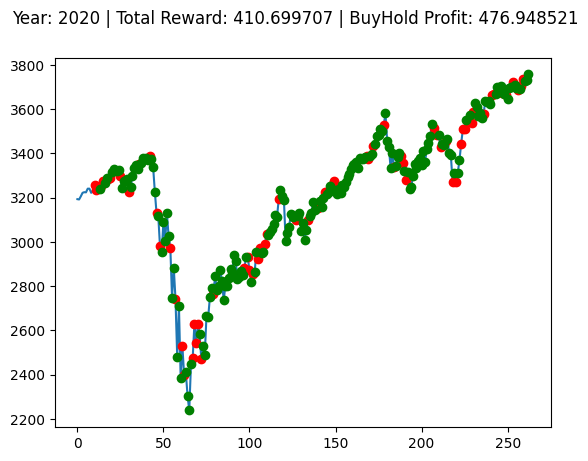

Buy And Hold: 1036.3717211914068


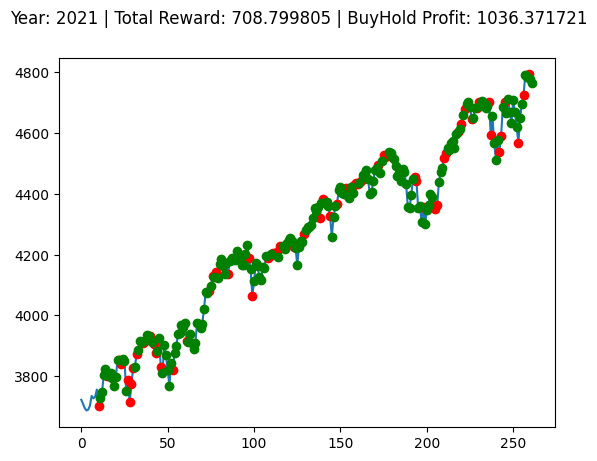

Buy And Hold: -971.472258300781


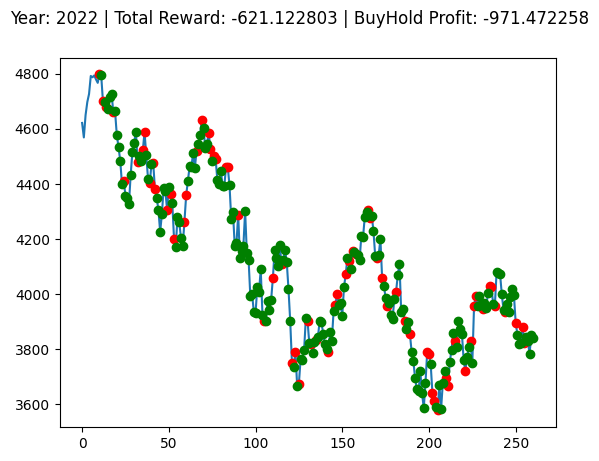

Buy And Hold: 917.112584228516


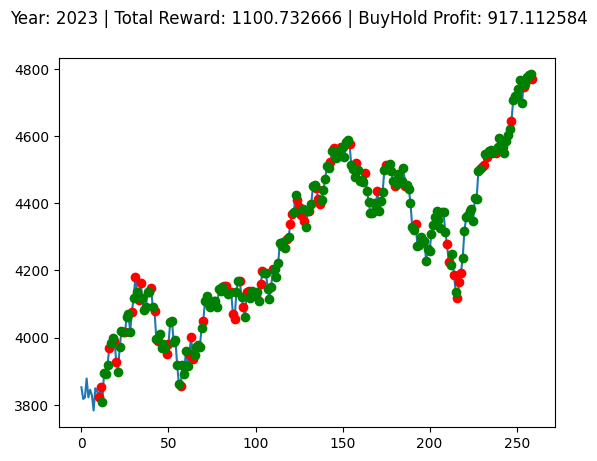

 37%|███▋      | 37/100 [13:56<23:58, 22.84s/it]

Buy And Hold: -200.5494116210939


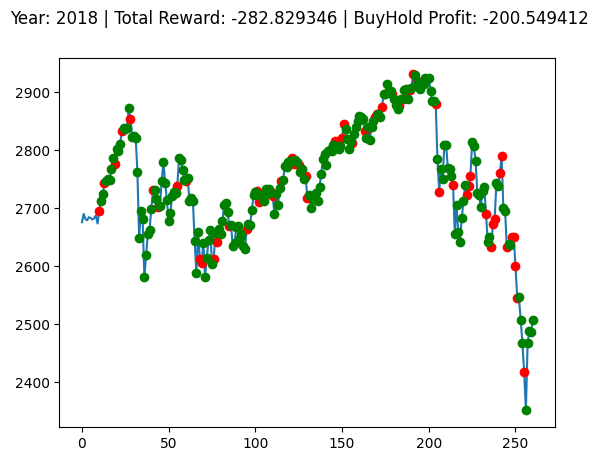

Buy And Hold: 700.9923498535159


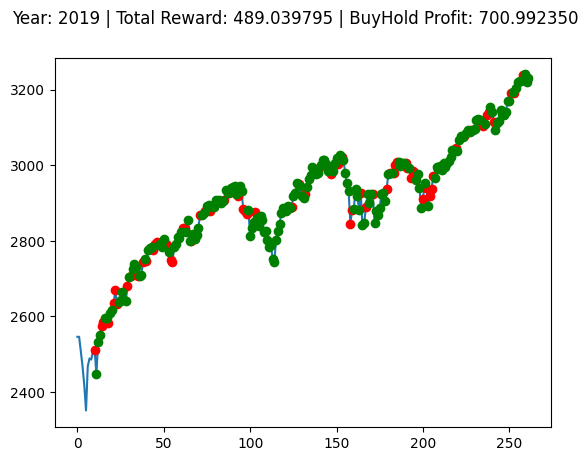

Buy And Hold: 476.9485205078122


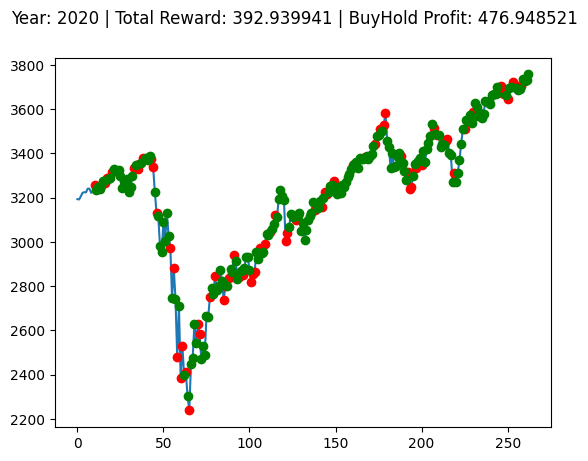

Buy And Hold: 1036.3717211914068


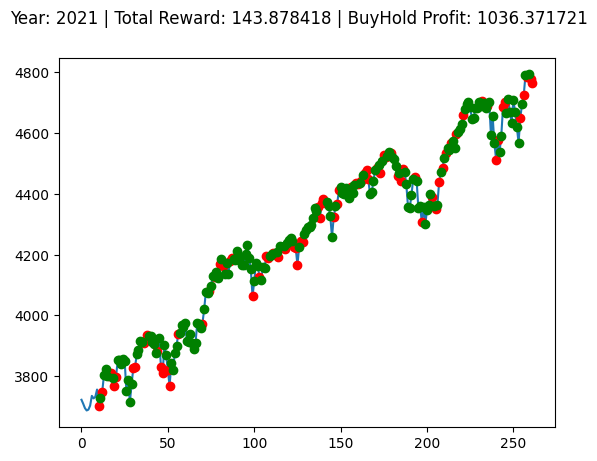

Buy And Hold: -971.472258300781


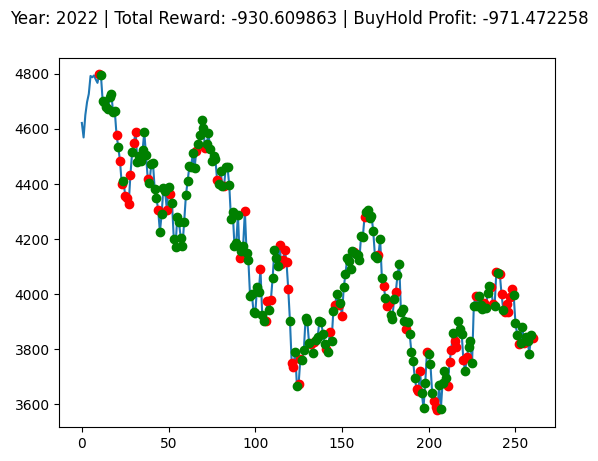

Buy And Hold: 917.112584228516


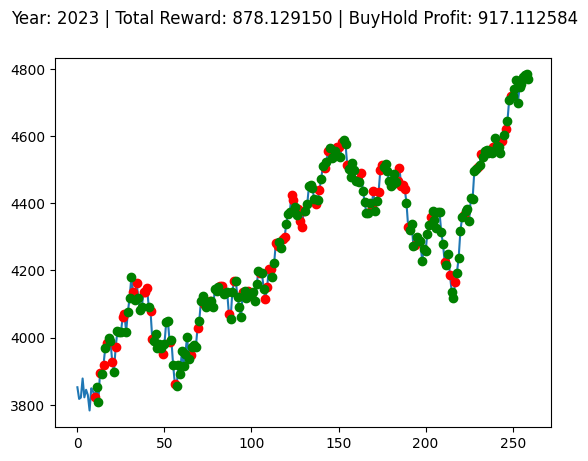

 38%|███▊      | 38/100 [14:19<23:42, 22.95s/it]

Buy And Hold: -200.5494116210939


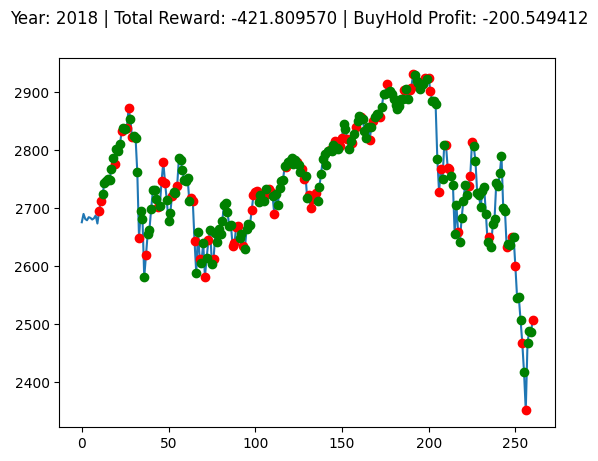

Buy And Hold: 700.9923498535159


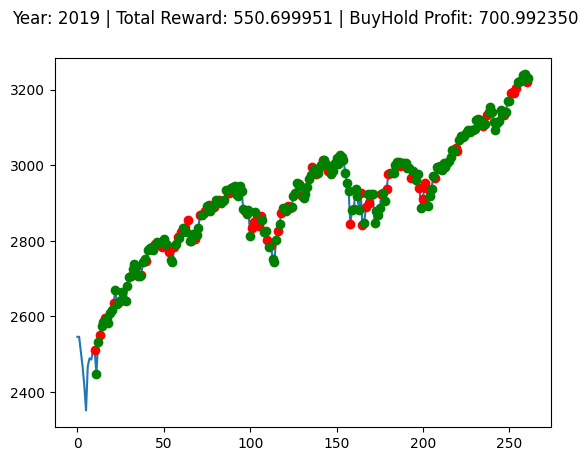

Buy And Hold: 476.9485205078122


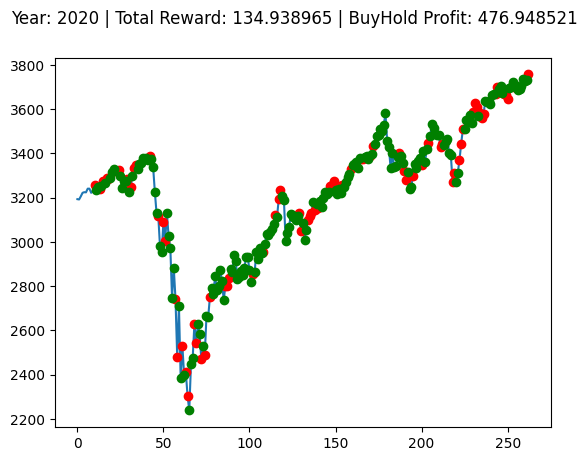

Buy And Hold: 1036.3717211914068


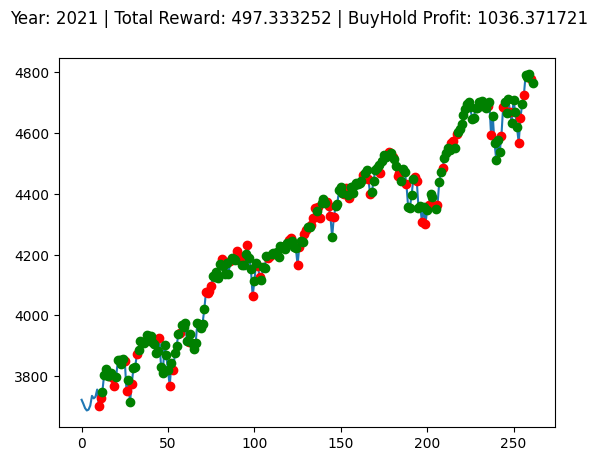

Buy And Hold: -971.472258300781


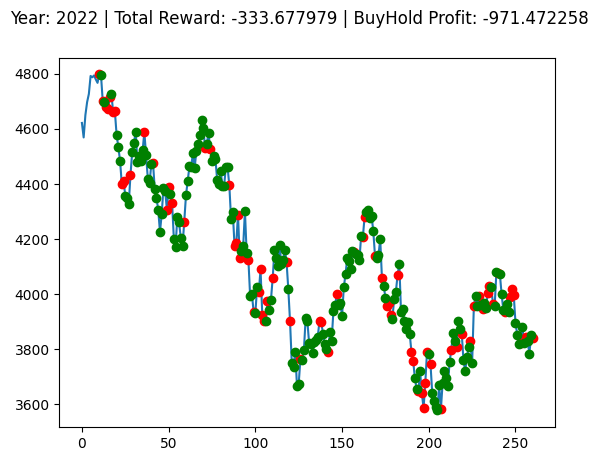

Buy And Hold: 917.112584228516


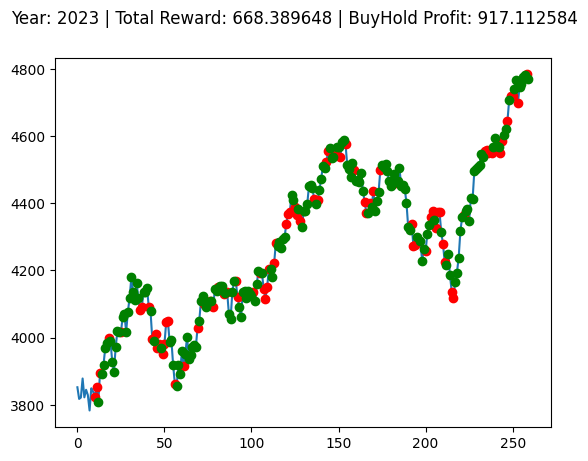

 39%|███▉      | 39/100 [14:41<23:10, 22.80s/it]

Buy And Hold: -200.5494116210939


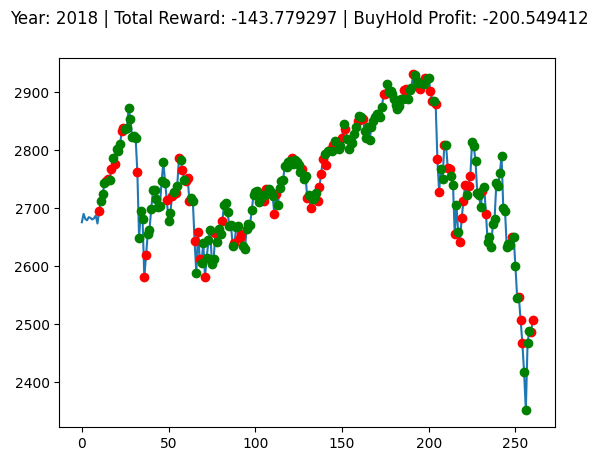

Buy And Hold: 700.9923498535159


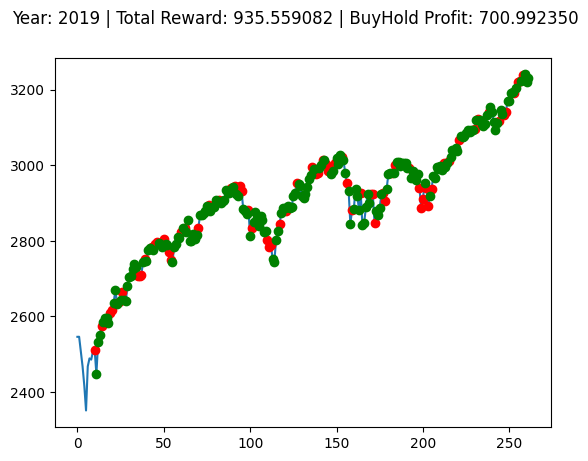

Buy And Hold: 476.9485205078122


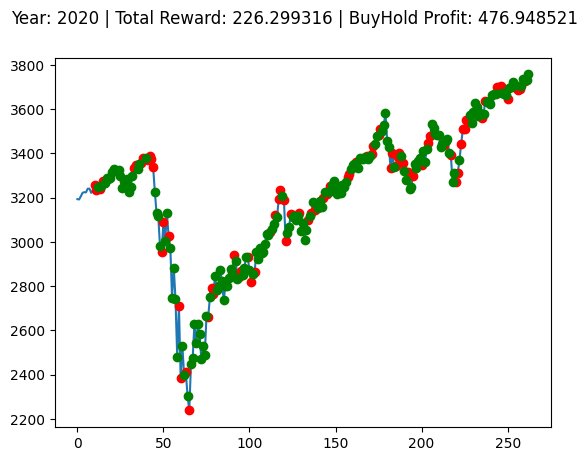

Buy And Hold: 1036.3717211914068


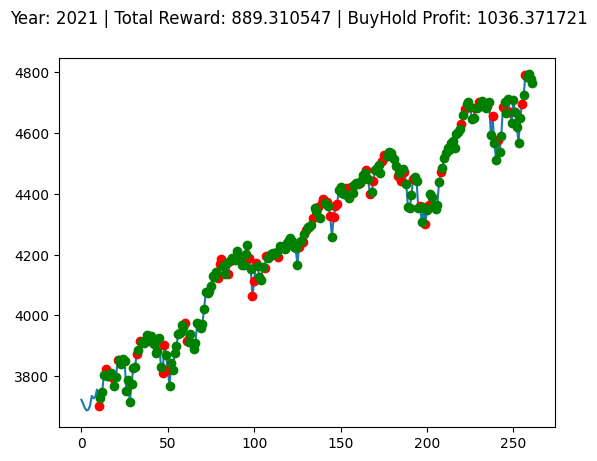

Buy And Hold: -971.472258300781


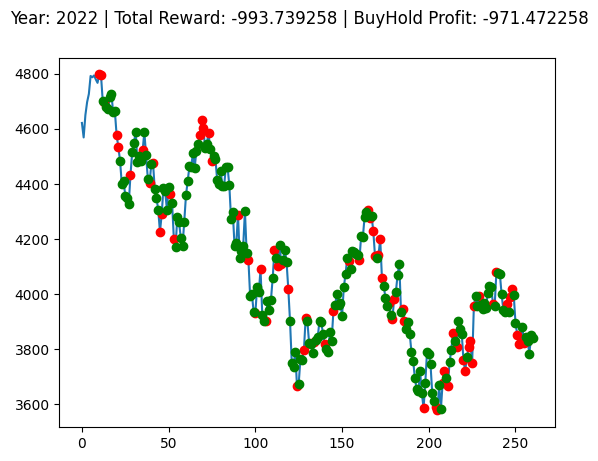

Buy And Hold: 917.112584228516


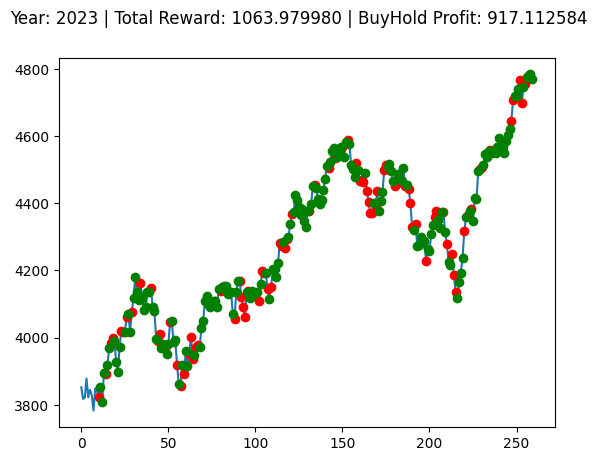

 40%|████      | 40/100 [15:04<22:40, 22.67s/it]

Buy And Hold: -200.5494116210939


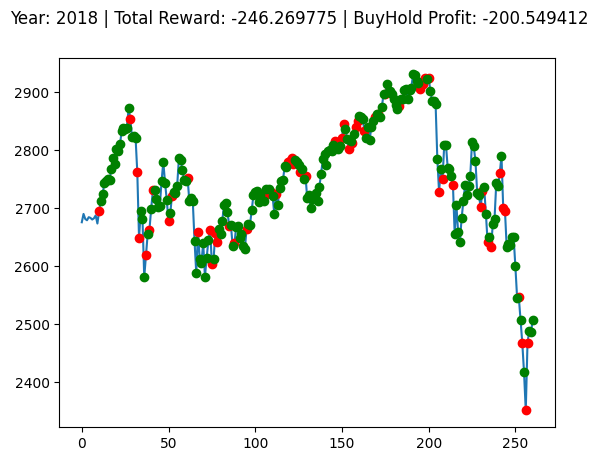

Buy And Hold: 700.9923498535159


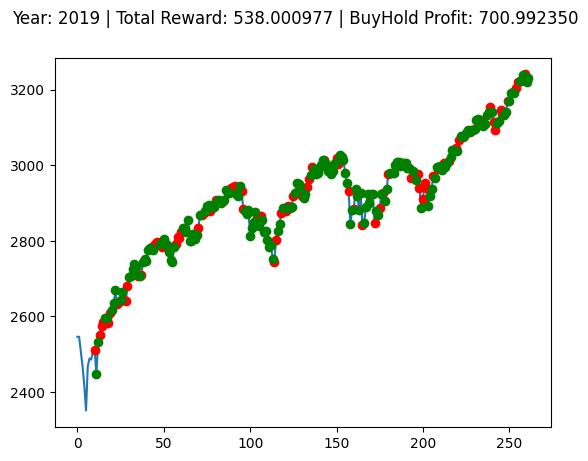

Buy And Hold: 476.9485205078122


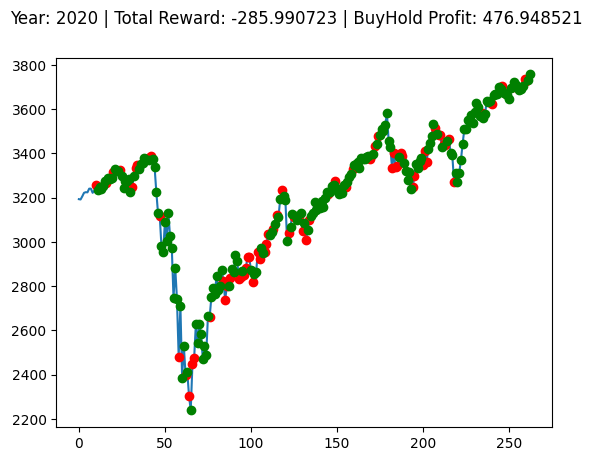

Buy And Hold: 1036.3717211914068


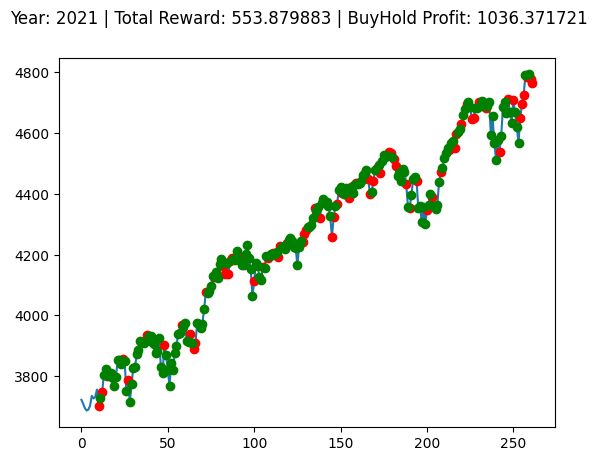

Buy And Hold: -971.472258300781


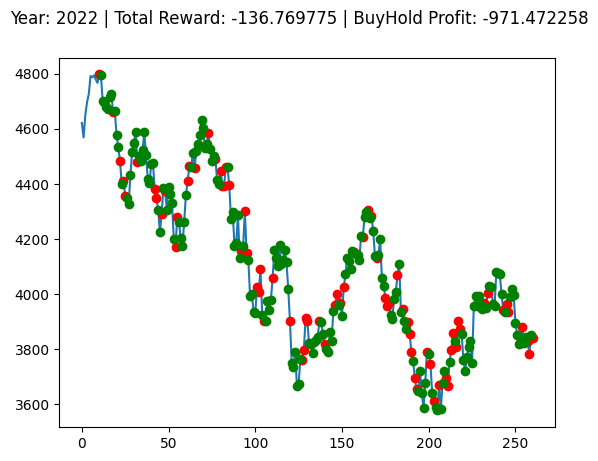

Buy And Hold: 917.112584228516


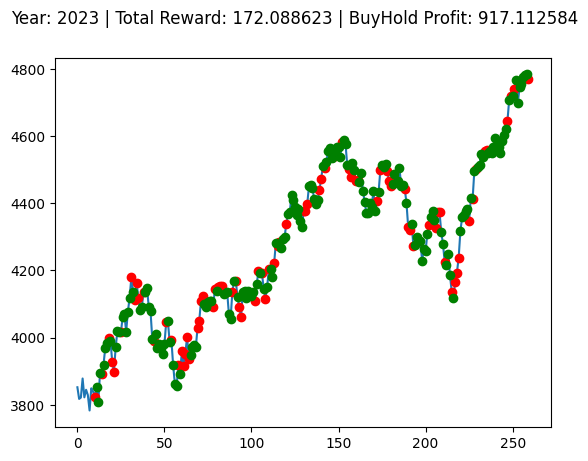

 41%|████      | 41/100 [15:27<22:23, 22.77s/it]

Buy And Hold: -200.5494116210939


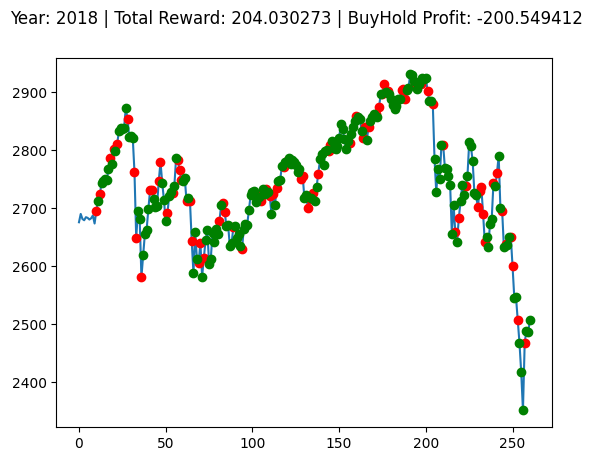

Buy And Hold: 700.9923498535159


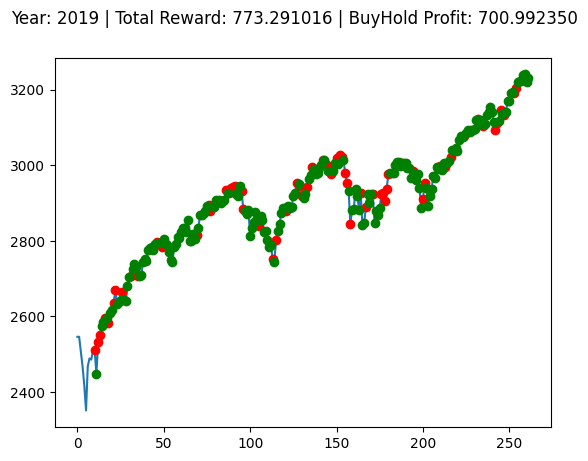

Buy And Hold: 476.9485205078122


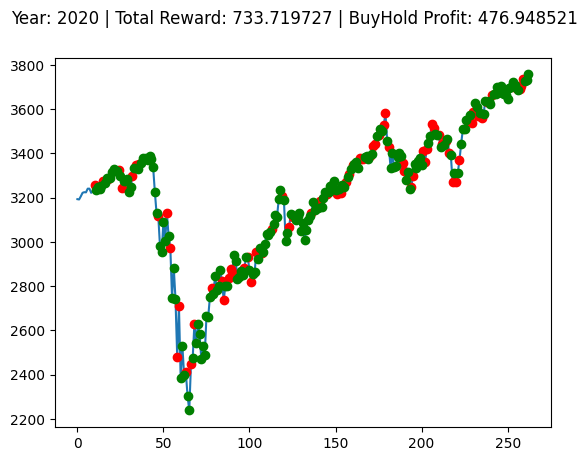

Buy And Hold: 1036.3717211914068


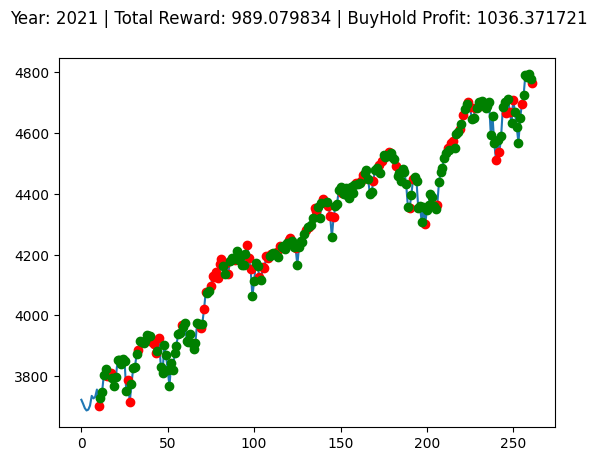

Buy And Hold: -971.472258300781


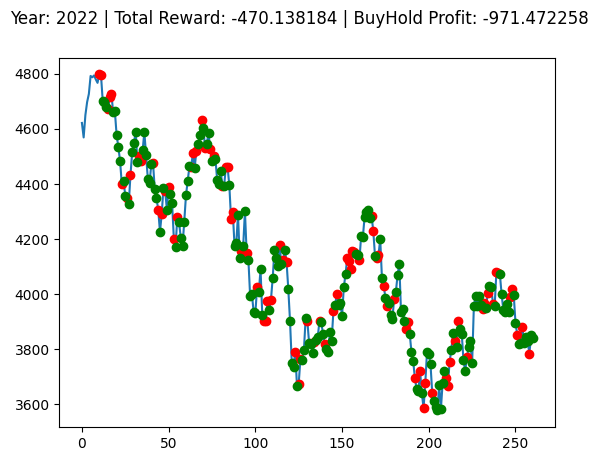

Buy And Hold: 917.112584228516


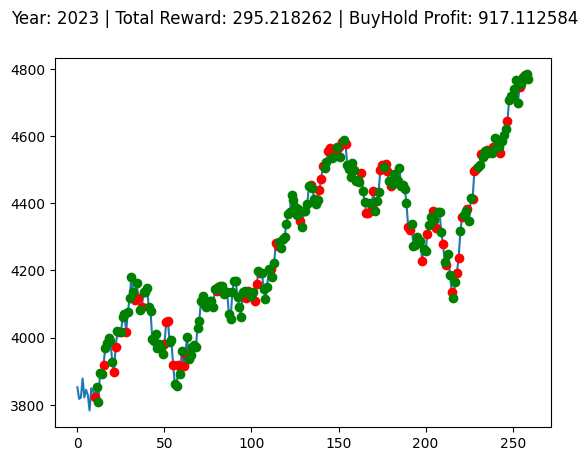

 42%|████▏     | 42/100 [15:49<21:58, 22.74s/it]

Buy And Hold: -200.5494116210939


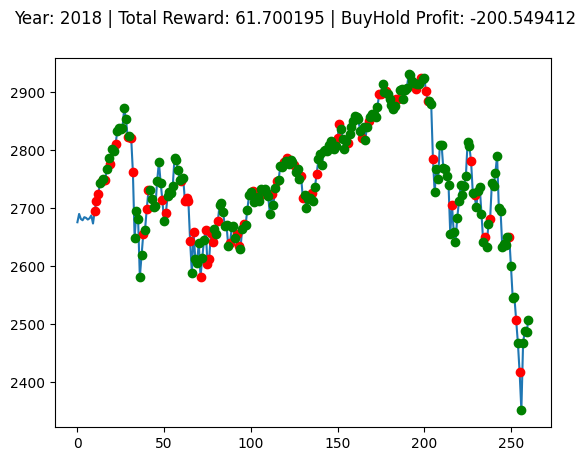

Buy And Hold: 700.9923498535159


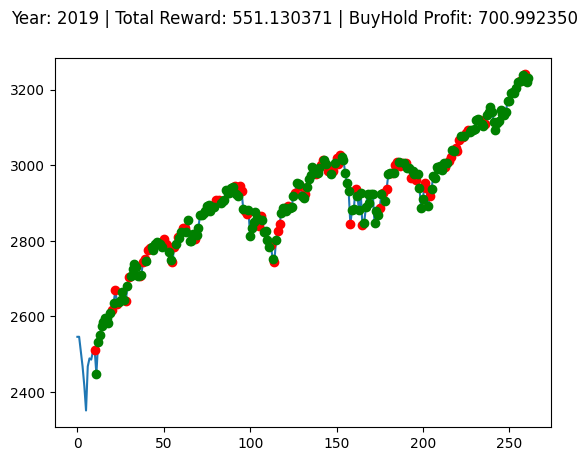

Buy And Hold: 476.9485205078122


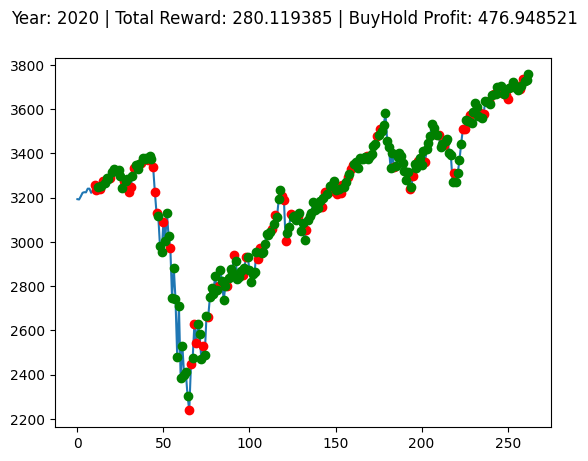

Buy And Hold: 1036.3717211914068


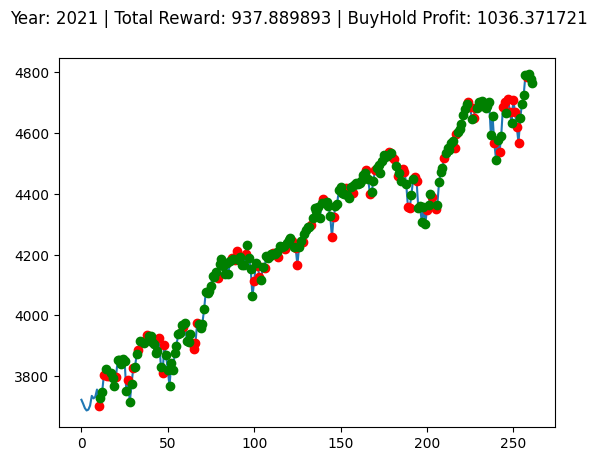

Buy And Hold: -971.472258300781


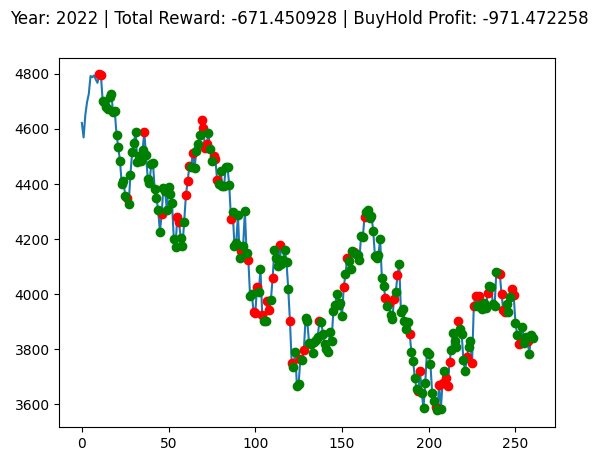

Buy And Hold: 917.112584228516


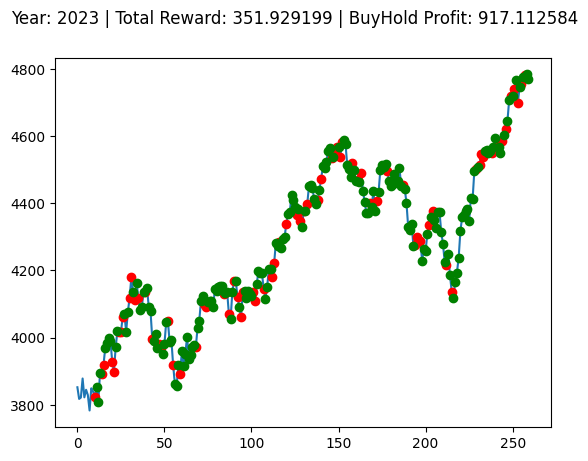

 43%|████▎     | 43/100 [16:12<21:38, 22.77s/it]

Buy And Hold: -200.5494116210939


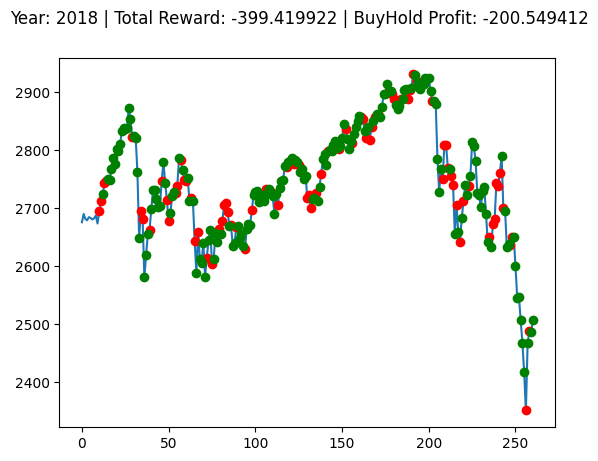

Buy And Hold: 700.9923498535159


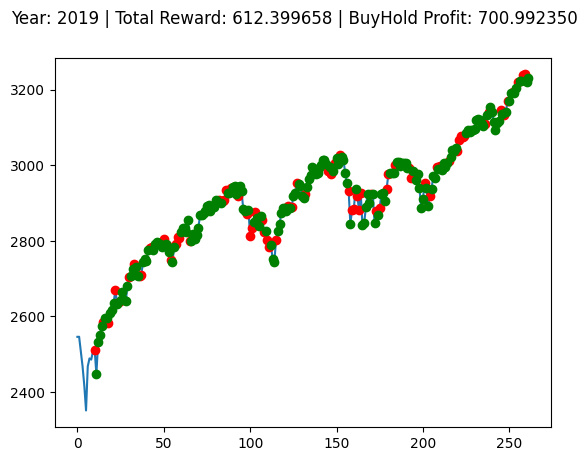

Buy And Hold: 476.9485205078122


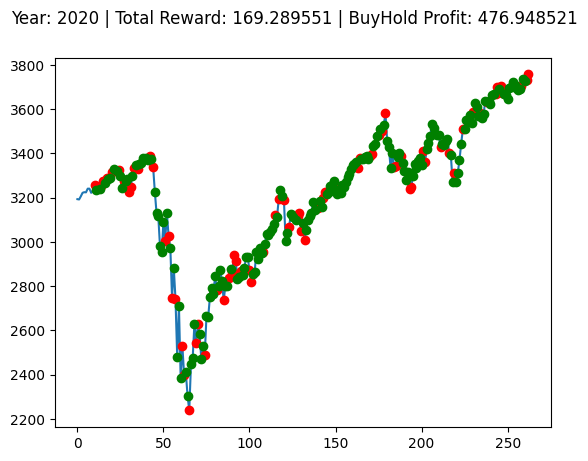

Buy And Hold: 1036.3717211914068


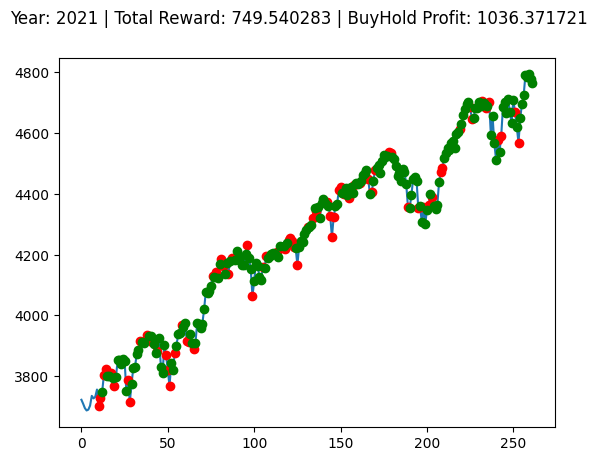

Buy And Hold: -971.472258300781


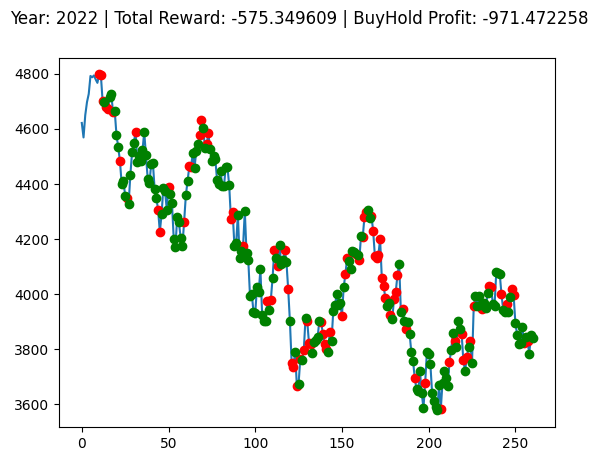

Buy And Hold: 917.112584228516


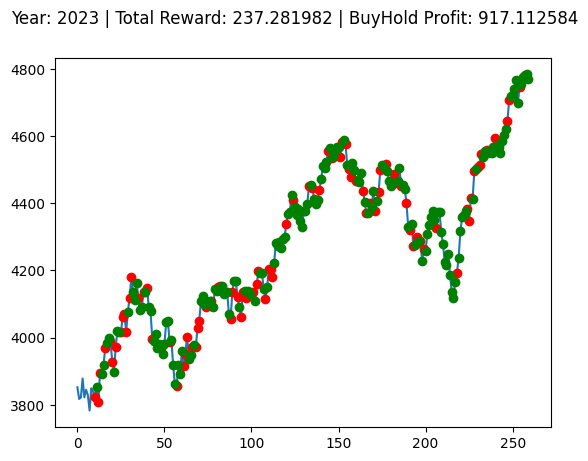

 44%|████▍     | 44/100 [16:35<21:11, 22.70s/it]

Buy And Hold: -200.5494116210939


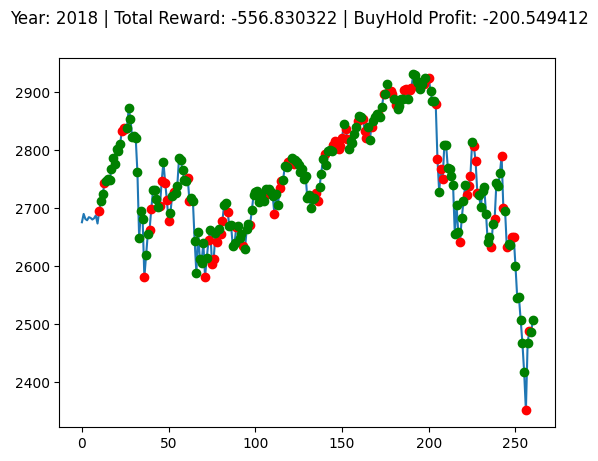

Buy And Hold: 700.9923498535159


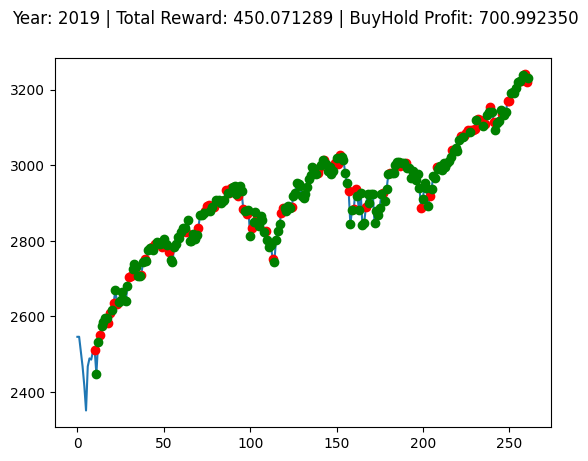

Buy And Hold: 476.9485205078122


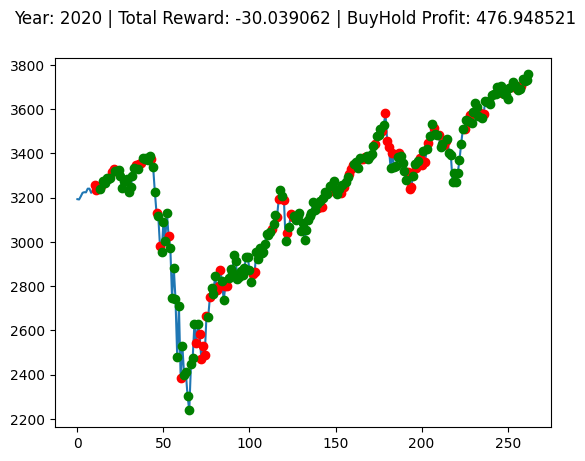

Buy And Hold: 1036.3717211914068


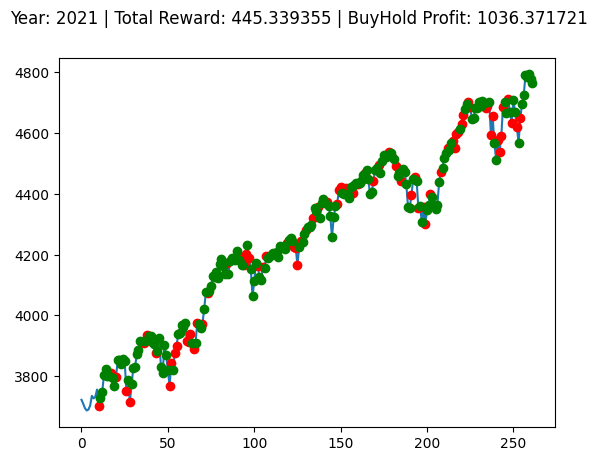

Buy And Hold: -971.472258300781


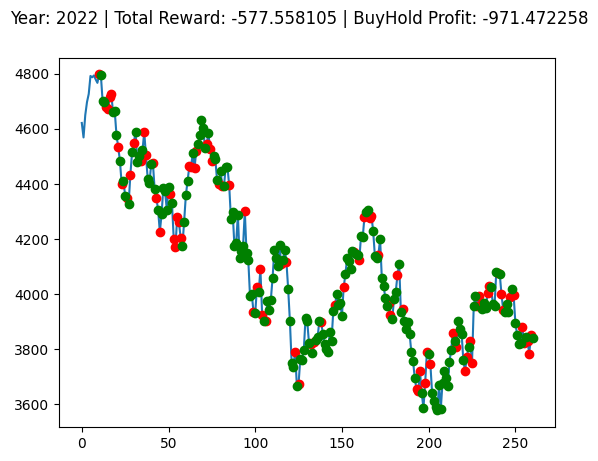

Buy And Hold: 917.112584228516


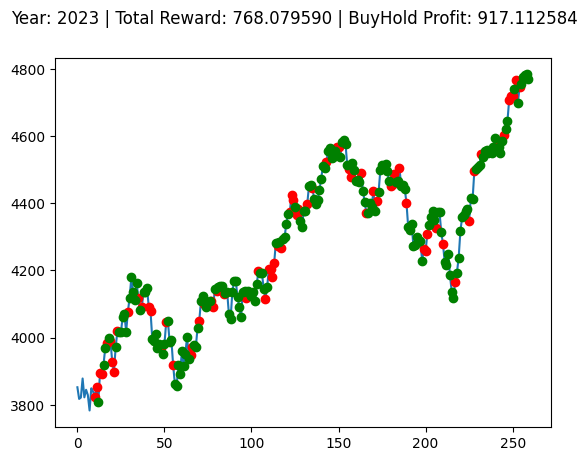

 45%|████▌     | 45/100 [16:58<20:51, 22.76s/it]

Buy And Hold: -200.5494116210939


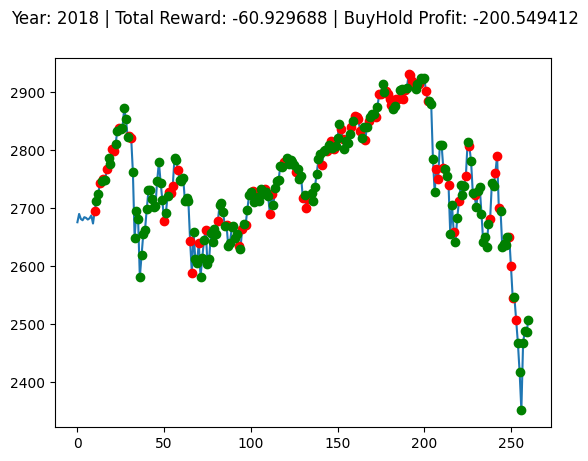

Buy And Hold: 700.9923498535159


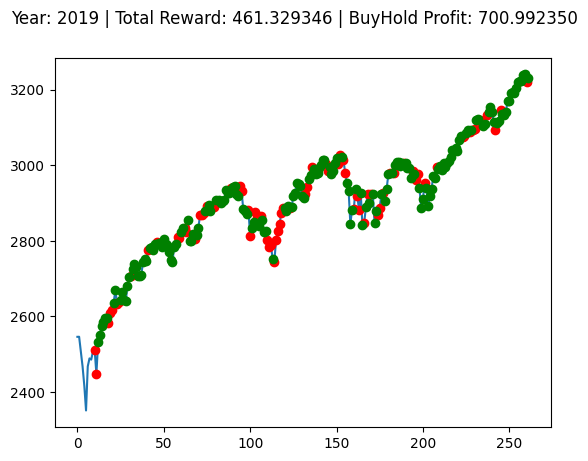

Buy And Hold: 476.9485205078122


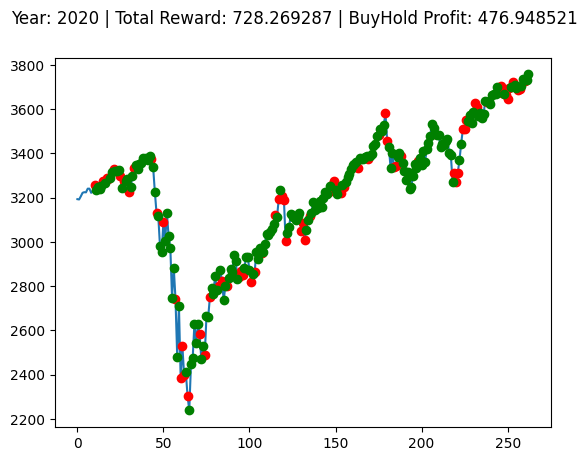

Buy And Hold: 1036.3717211914068


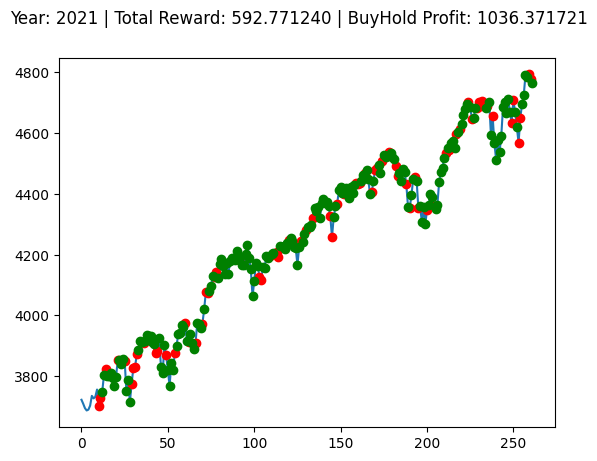

Buy And Hold: -971.472258300781


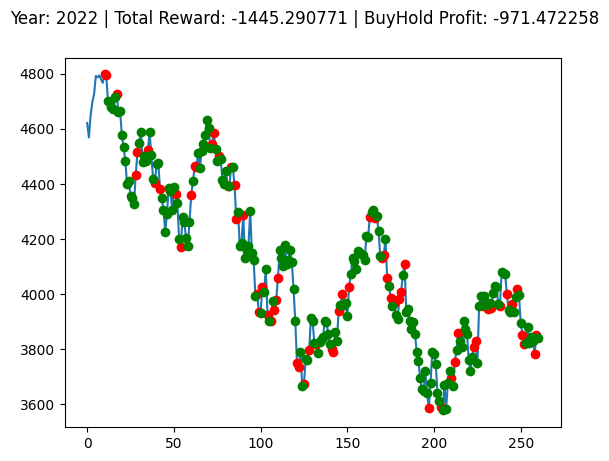

Buy And Hold: 917.112584228516


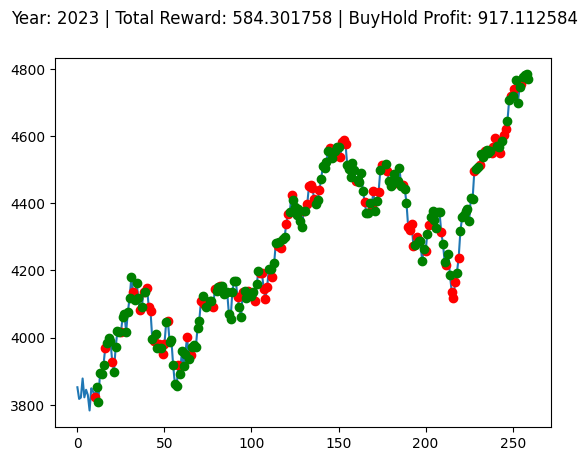

 46%|████▌     | 46/100 [17:21<20:36, 22.90s/it]

Buy And Hold: -200.5494116210939


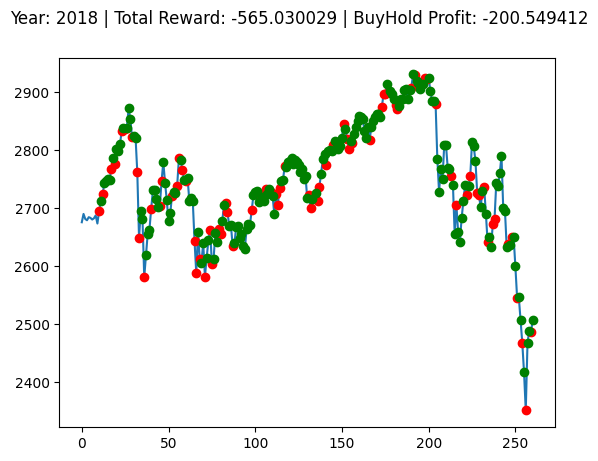

Buy And Hold: 700.9923498535159


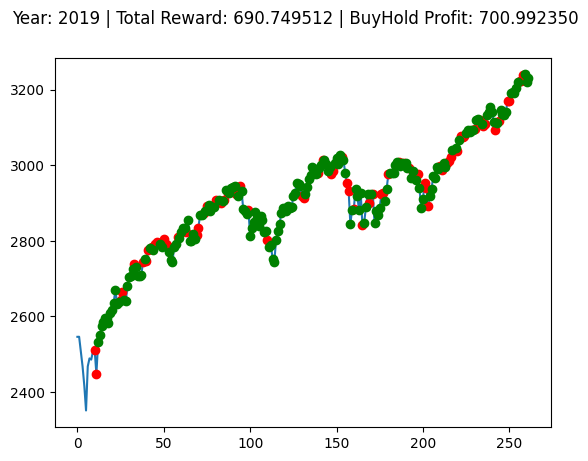

Buy And Hold: 476.9485205078122


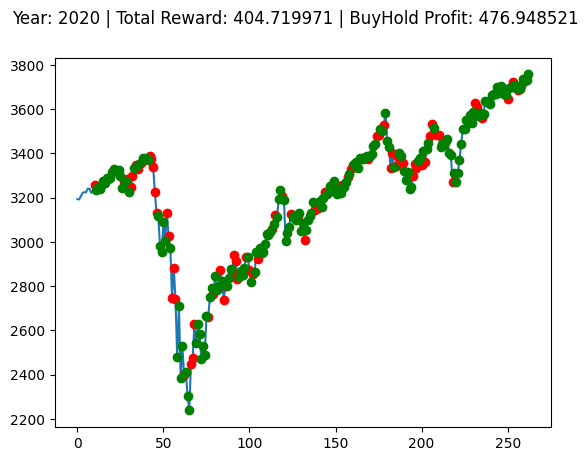

Buy And Hold: 1036.3717211914068


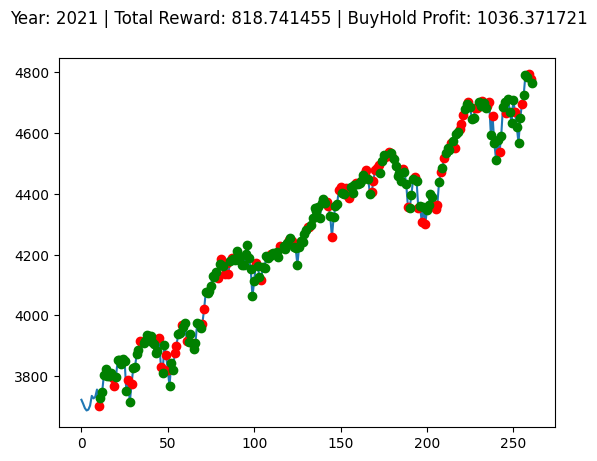

Buy And Hold: -971.472258300781


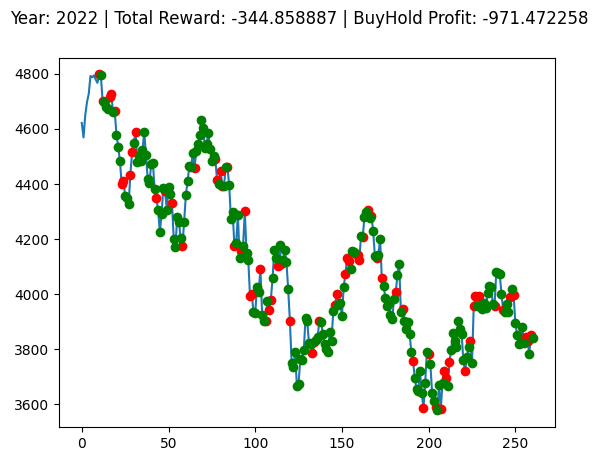

Buy And Hold: 917.112584228516


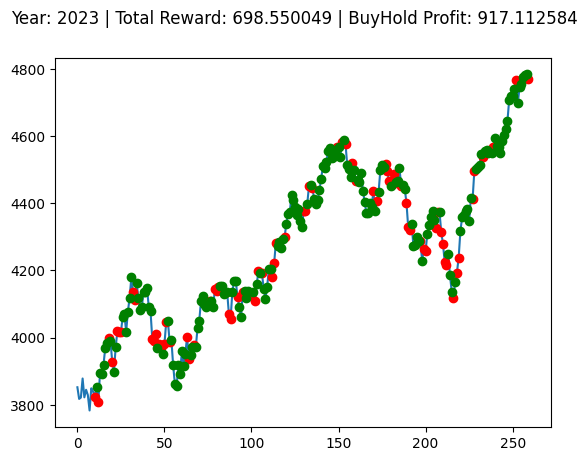

 47%|████▋     | 47/100 [17:44<20:11, 22.86s/it]

Buy And Hold: -200.5494116210939


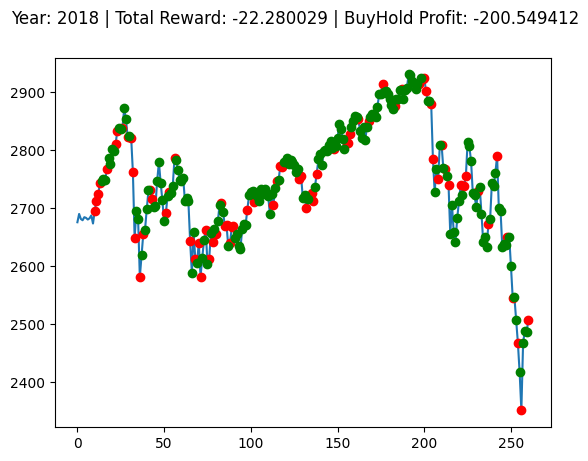

Buy And Hold: 700.9923498535159


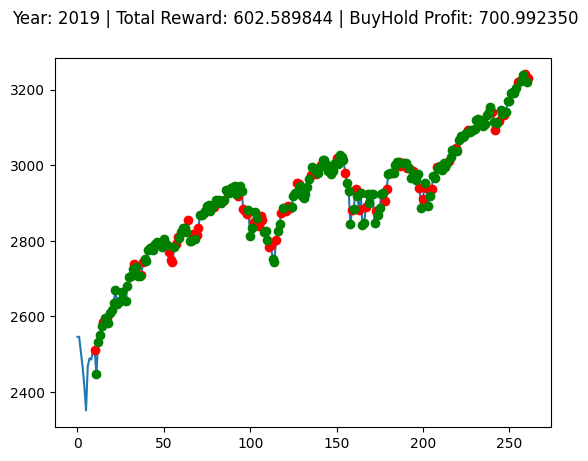

Buy And Hold: 476.9485205078122


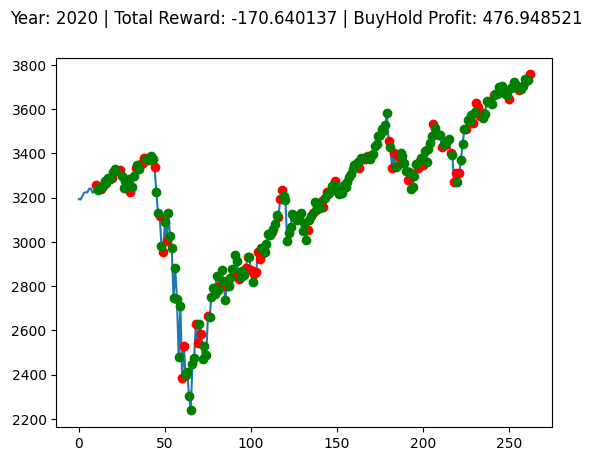

Buy And Hold: 1036.3717211914068


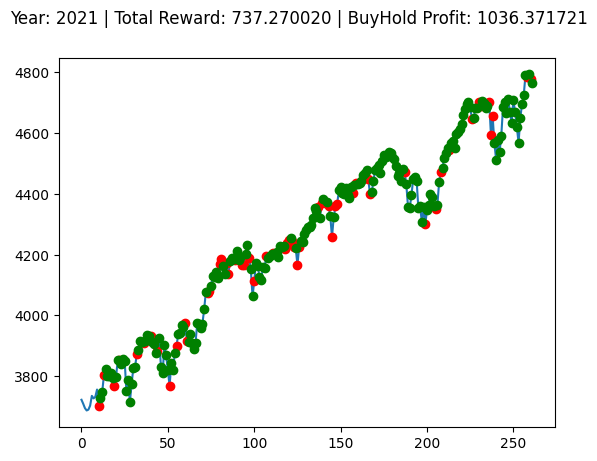

Buy And Hold: -971.472258300781


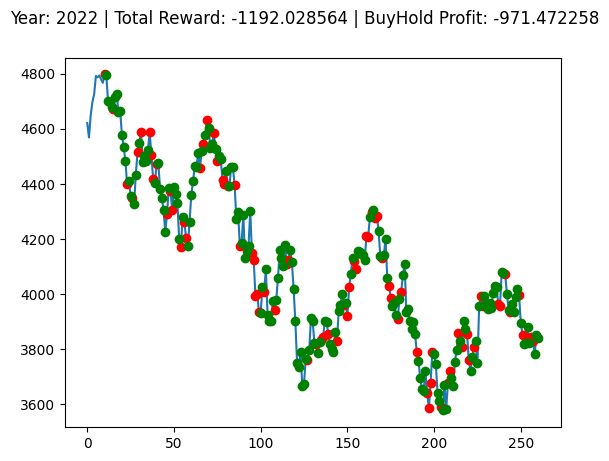

Buy And Hold: 917.112584228516


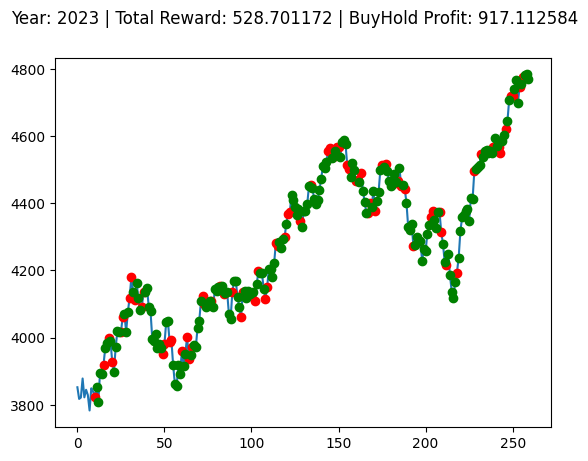

 48%|████▊     | 48/100 [18:07<19:55, 22.99s/it]

Buy And Hold: -200.5494116210939


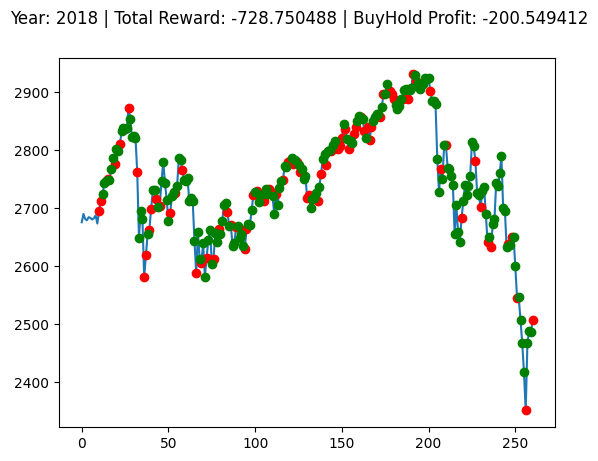

Buy And Hold: 700.9923498535159


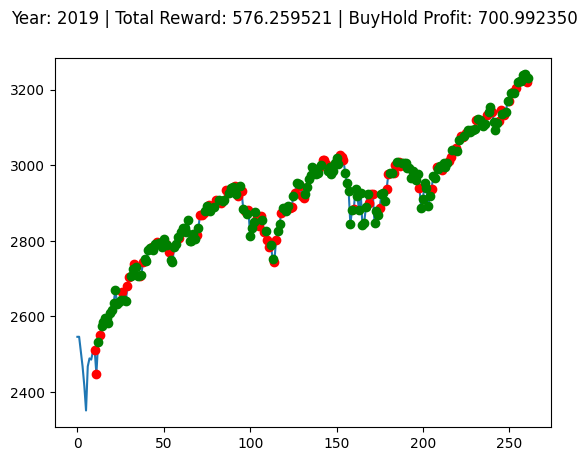

Buy And Hold: 476.9485205078122


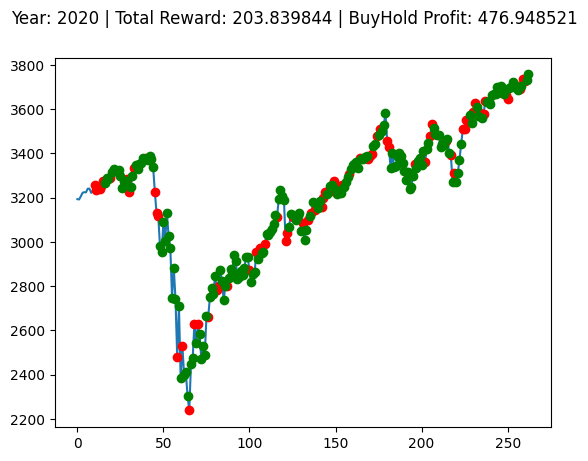

Buy And Hold: 1036.3717211914068


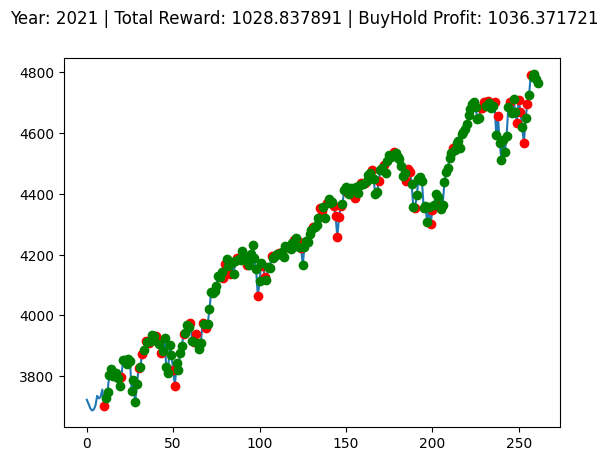

Buy And Hold: -971.472258300781


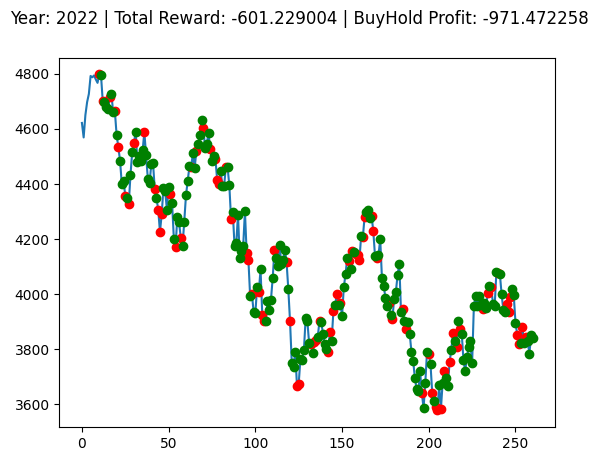

Buy And Hold: 917.112584228516


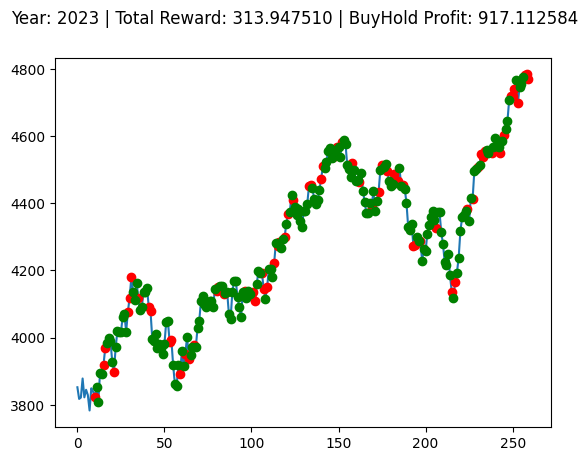

 49%|████▉     | 49/100 [18:29<19:24, 22.84s/it]

Buy And Hold: -200.5494116210939


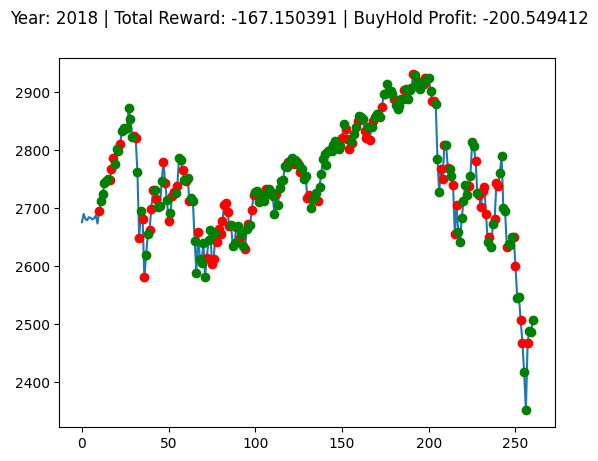

Buy And Hold: 700.9923498535159


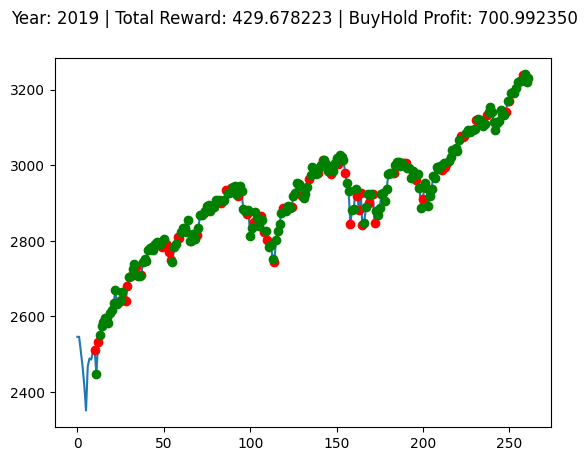

Buy And Hold: 476.9485205078122


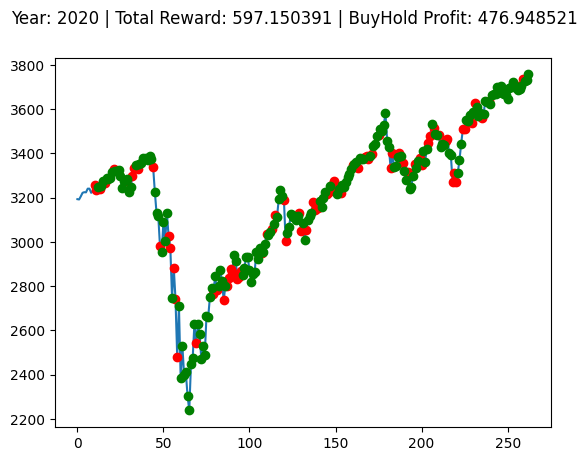

Buy And Hold: 1036.3717211914068


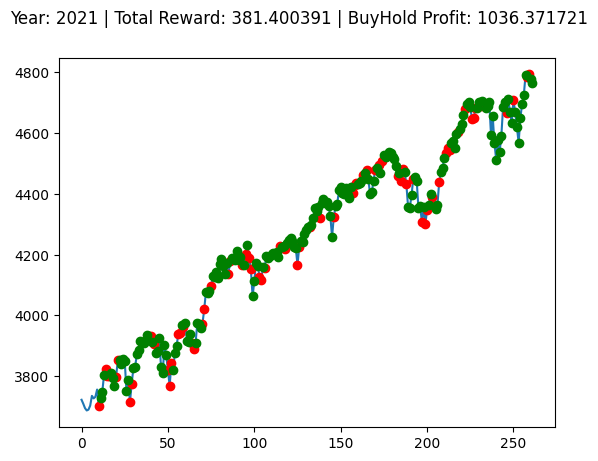

Buy And Hold: -971.472258300781


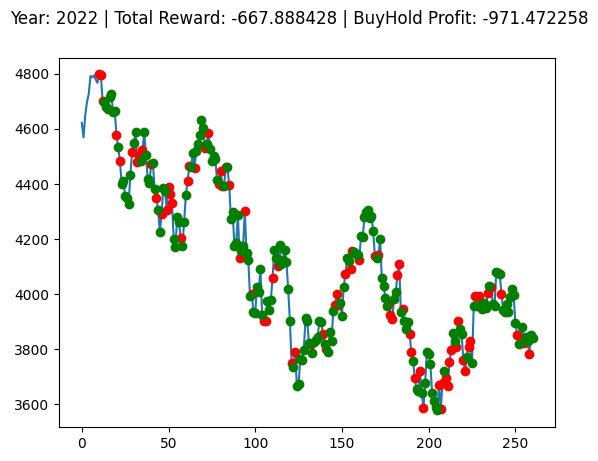

Buy And Hold: 917.112584228516


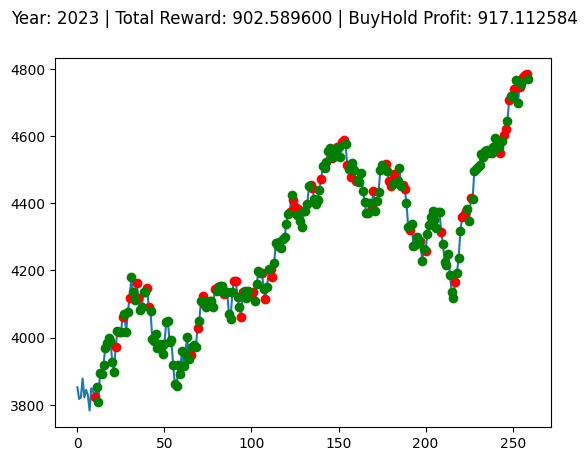

 50%|█████     | 50/100 [18:52<19:05, 22.90s/it]

Buy And Hold: -200.5494116210939


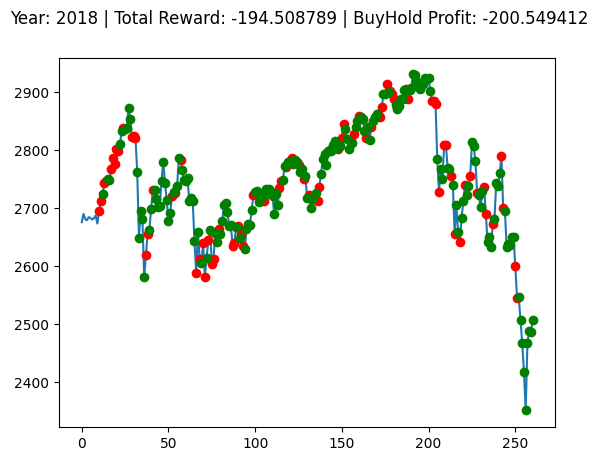

Buy And Hold: 700.9923498535159


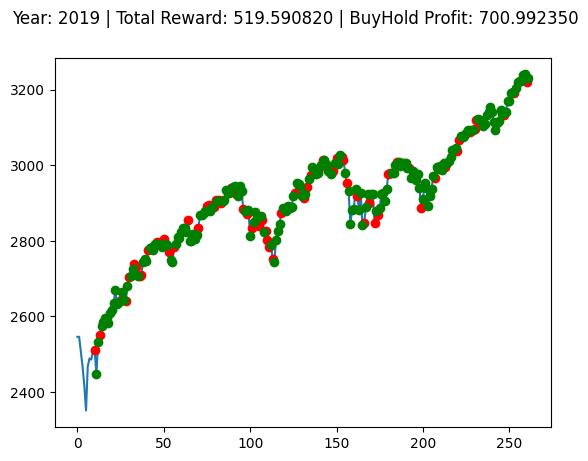

Buy And Hold: 476.9485205078122


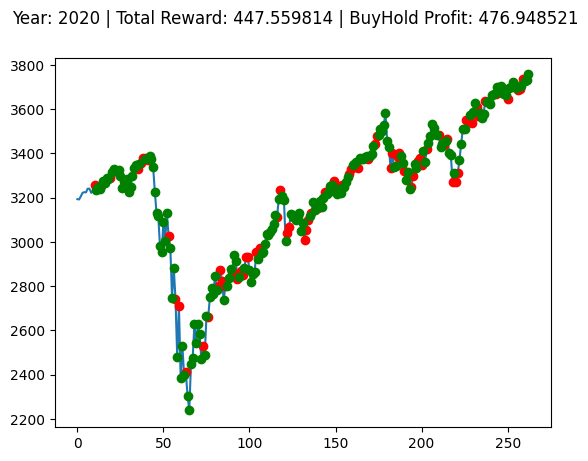

Buy And Hold: 1036.3717211914068


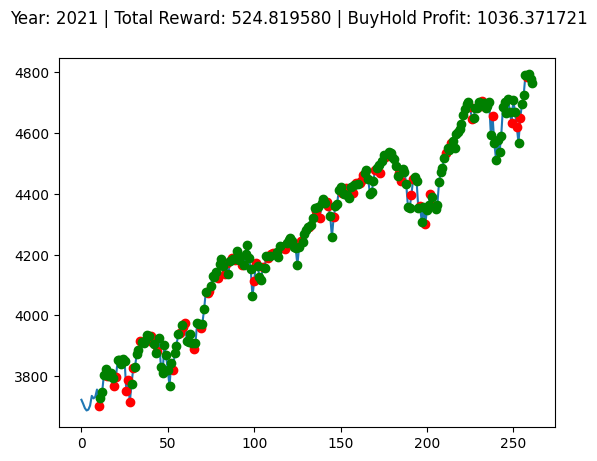

Buy And Hold: -971.472258300781


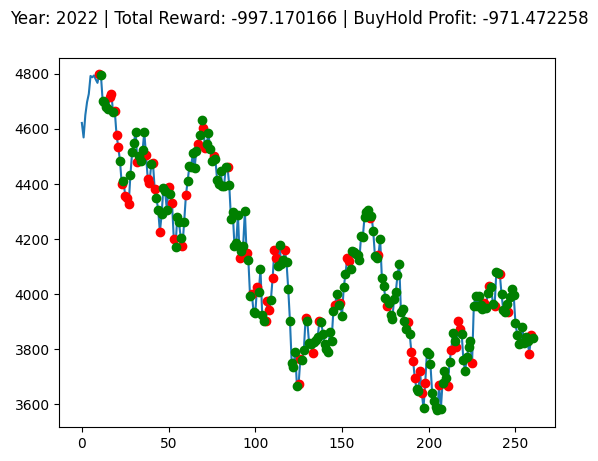

Buy And Hold: 917.112584228516


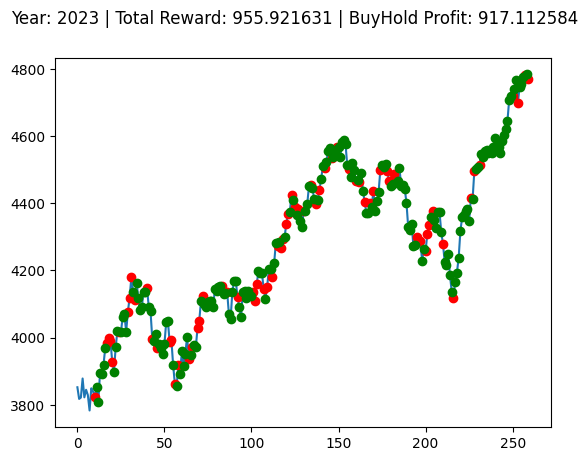

 51%|█████     | 51/100 [19:16<18:47, 23.01s/it]

Buy And Hold: -200.5494116210939


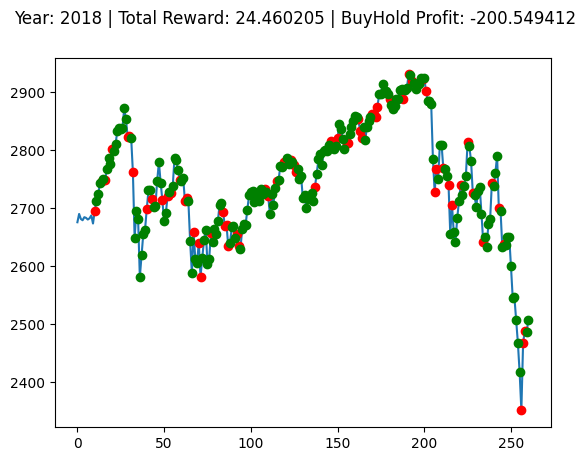

Buy And Hold: 700.9923498535159


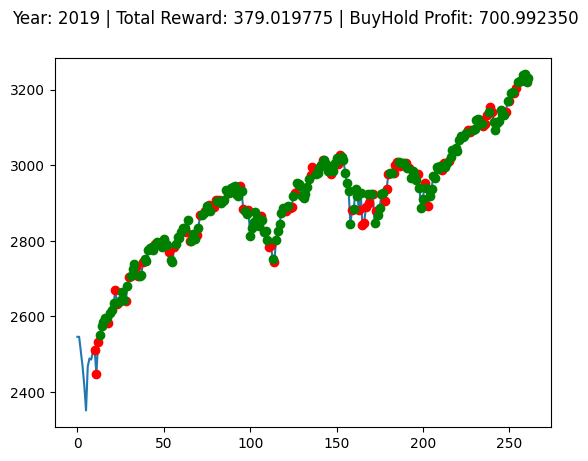

Buy And Hold: 476.9485205078122


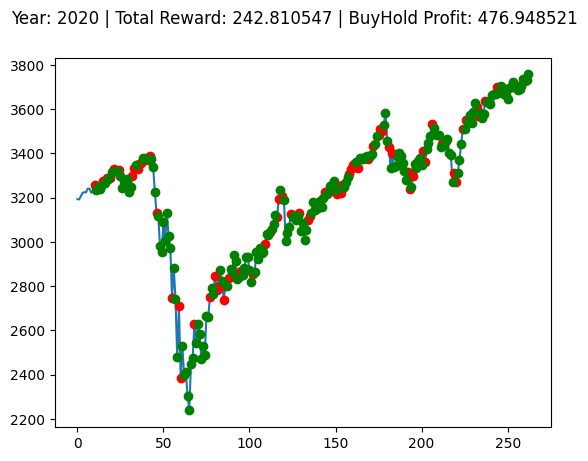

Buy And Hold: 1036.3717211914068


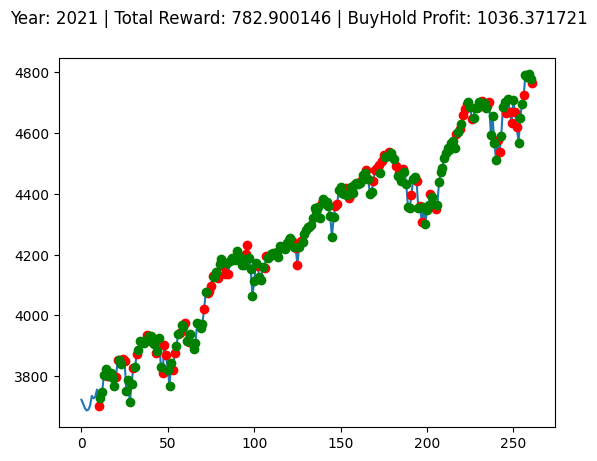

Buy And Hold: -971.472258300781


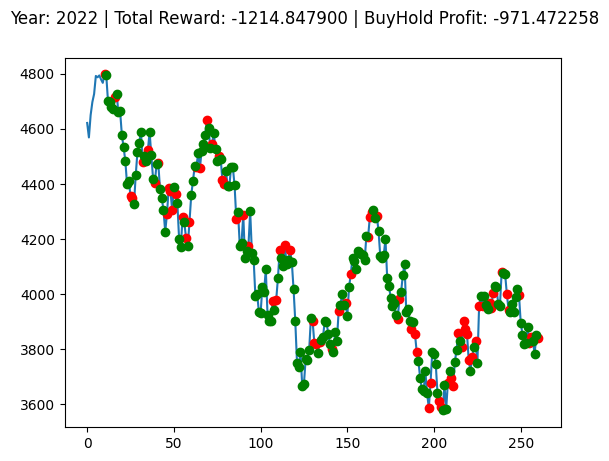

Buy And Hold: 917.112584228516


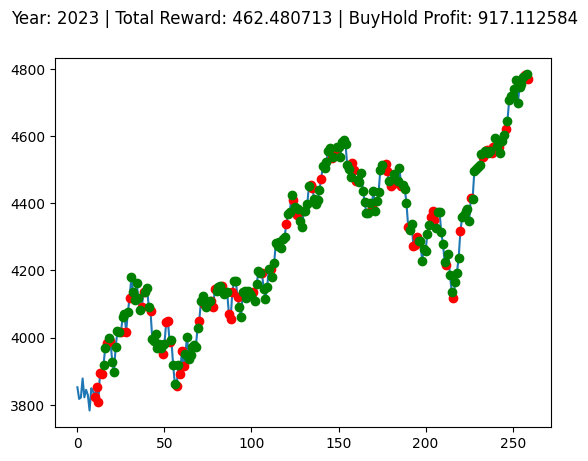

 52%|█████▏    | 52/100 [19:39<18:28, 23.10s/it]

Buy And Hold: -200.5494116210939


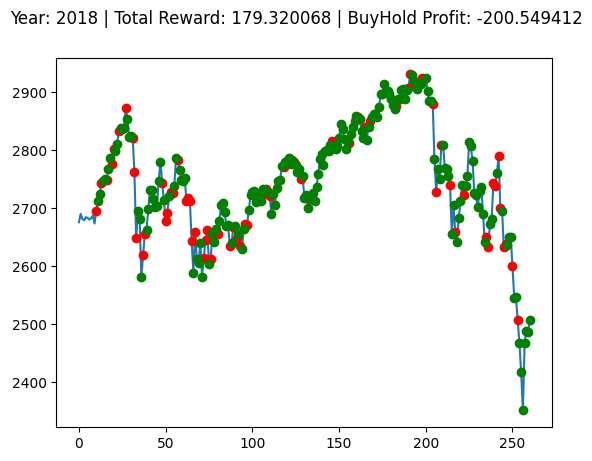

Buy And Hold: 700.9923498535159


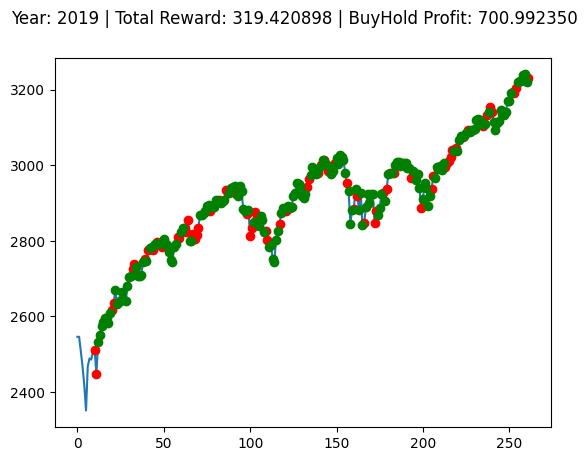

Buy And Hold: 476.9485205078122


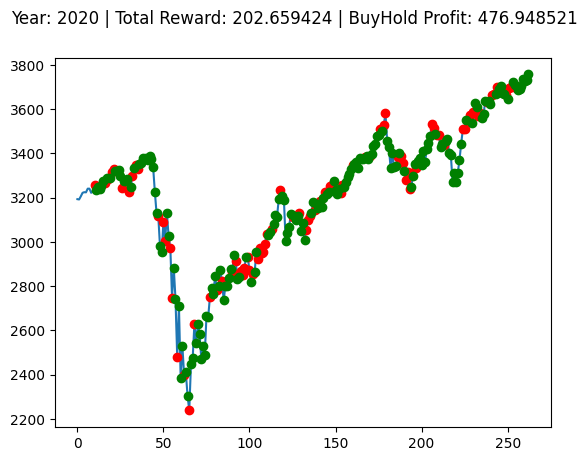

Buy And Hold: 1036.3717211914068


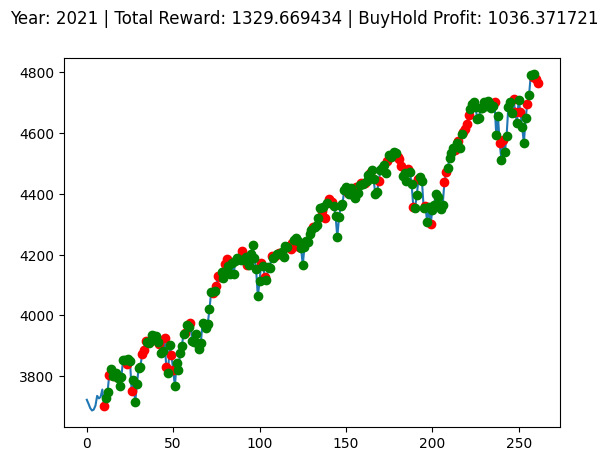

Buy And Hold: -971.472258300781


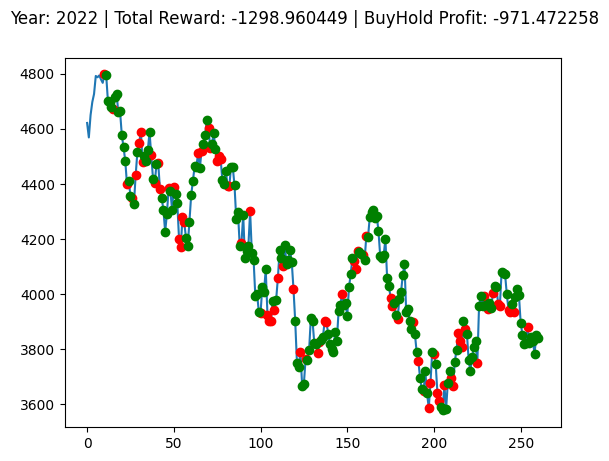

Buy And Hold: 917.112584228516


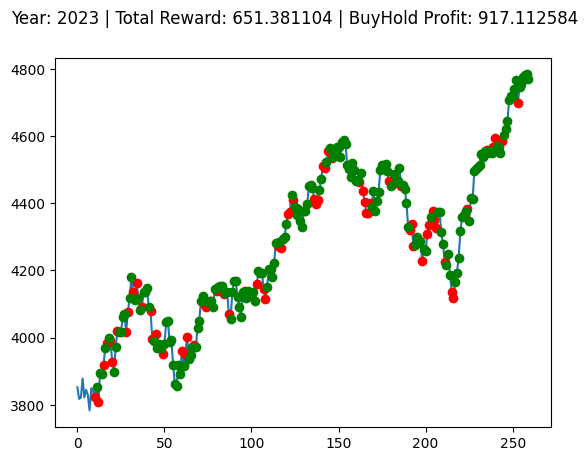

 53%|█████▎    | 53/100 [20:02<18:06, 23.12s/it]

Buy And Hold: -200.5494116210939


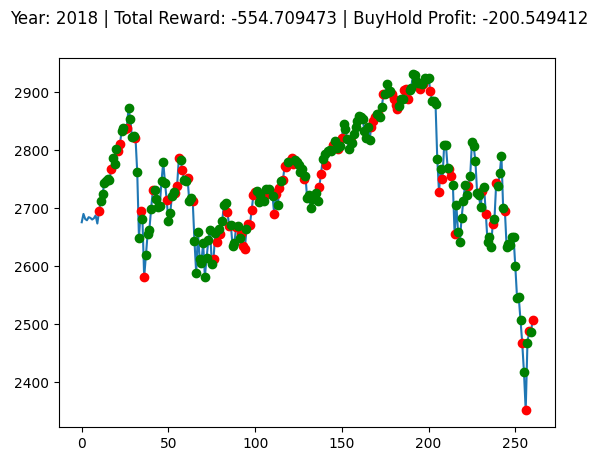

Buy And Hold: 700.9923498535159


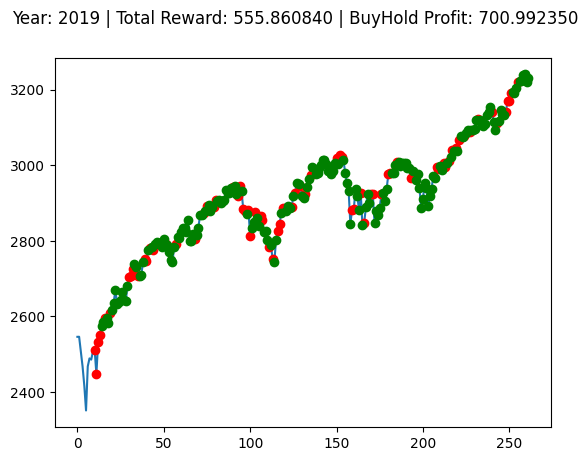

Buy And Hold: 476.9485205078122


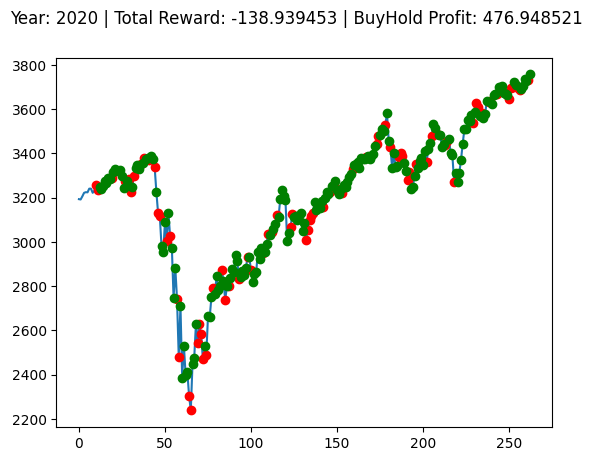

Buy And Hold: 1036.3717211914068


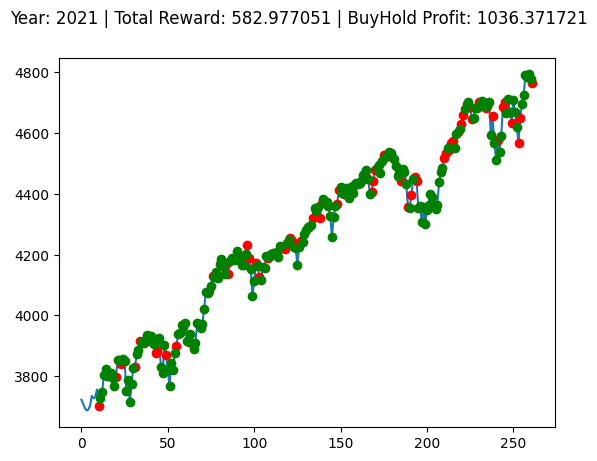

Buy And Hold: -971.472258300781


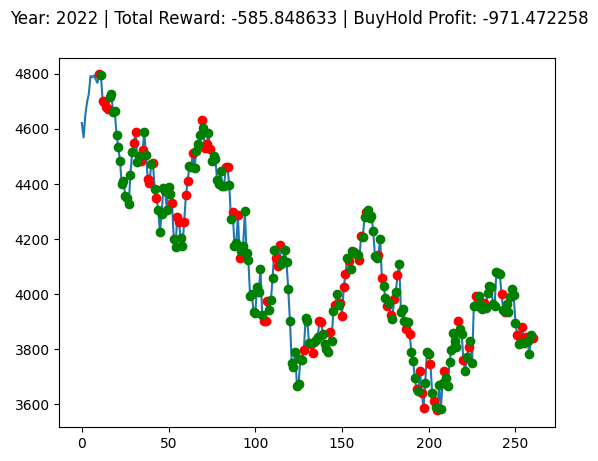

Buy And Hold: 917.112584228516


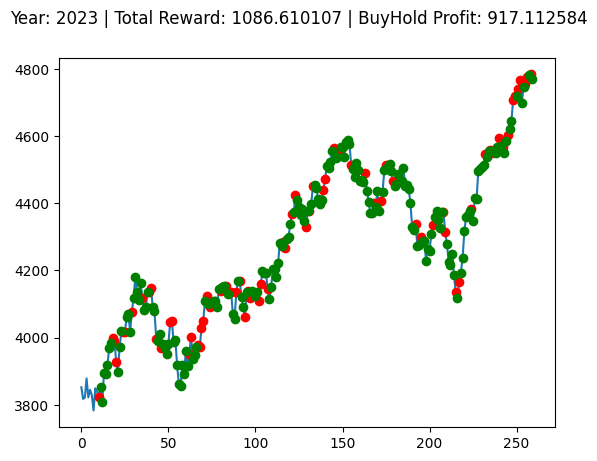

 54%|█████▍    | 54/100 [20:25<17:42, 23.10s/it]

Buy And Hold: -200.5494116210939


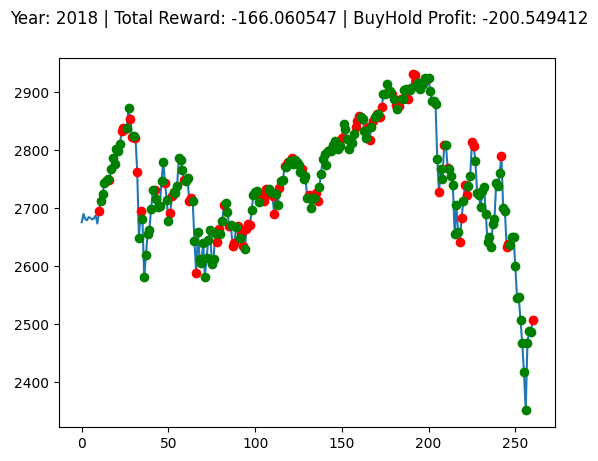

Buy And Hold: 700.9923498535159


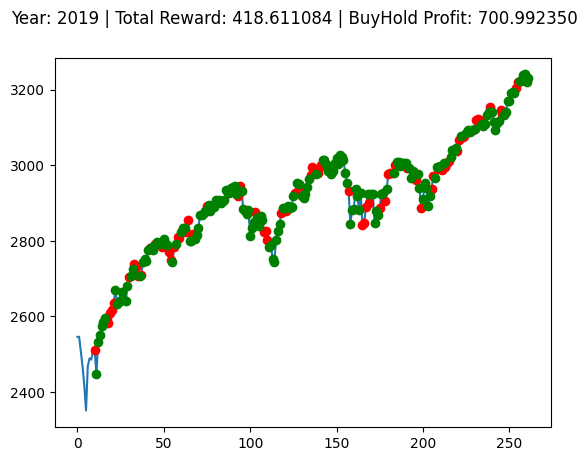

Buy And Hold: 476.9485205078122


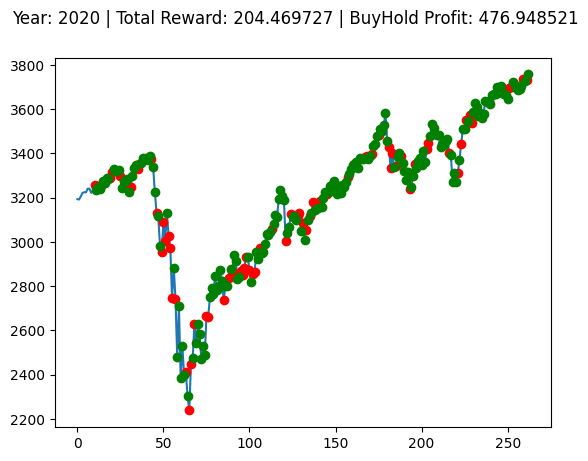

Buy And Hold: 1036.3717211914068


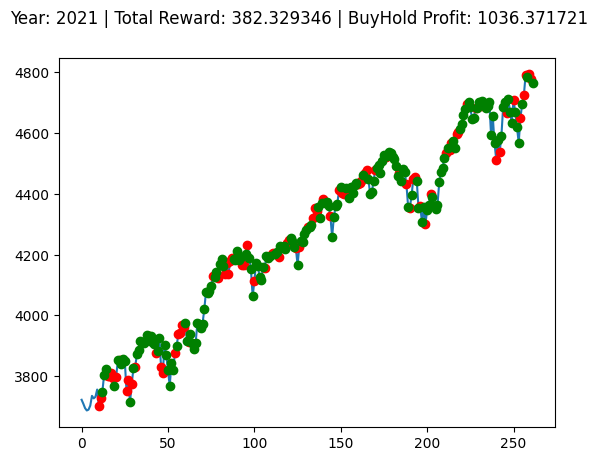

Buy And Hold: -971.472258300781


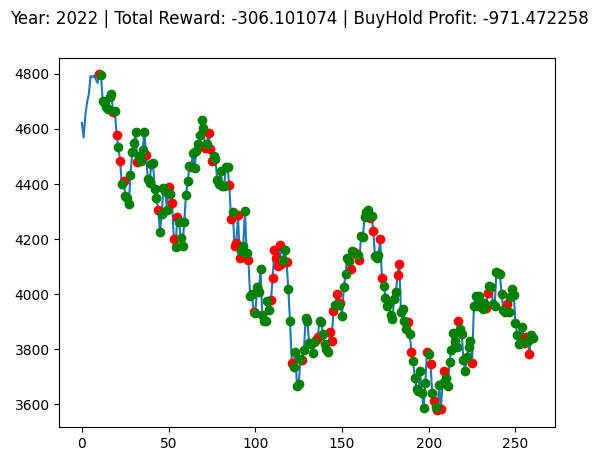

Buy And Hold: 917.112584228516


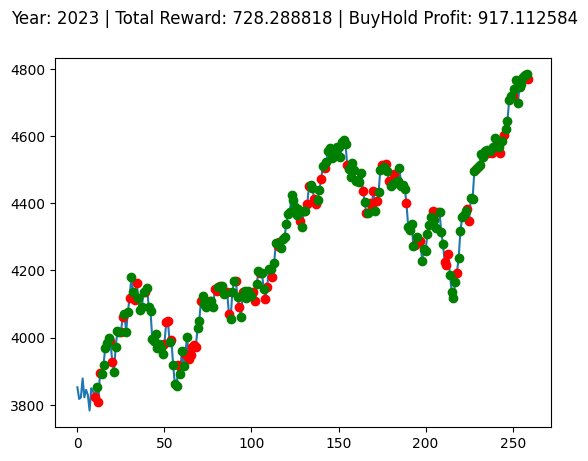

 55%|█████▌    | 55/100 [20:49<17:26, 23.25s/it]

Buy And Hold: -200.5494116210939


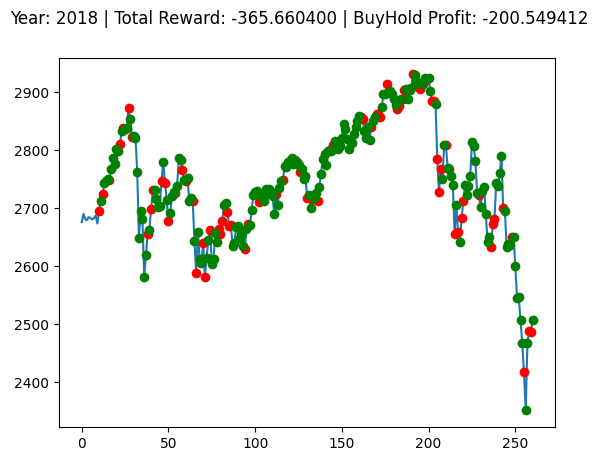

Buy And Hold: 700.9923498535159


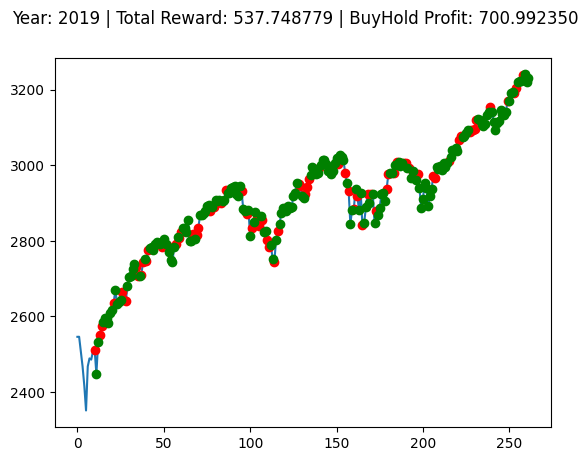

Buy And Hold: 476.9485205078122


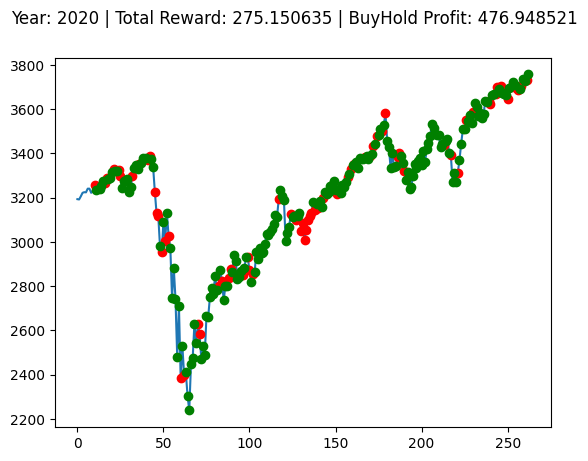

Buy And Hold: 1036.3717211914068


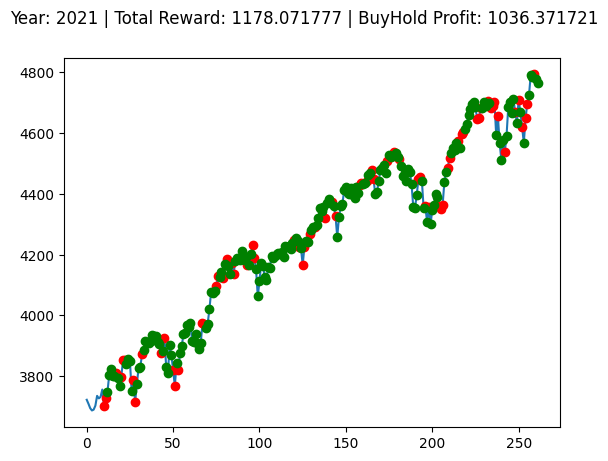

Buy And Hold: -971.472258300781


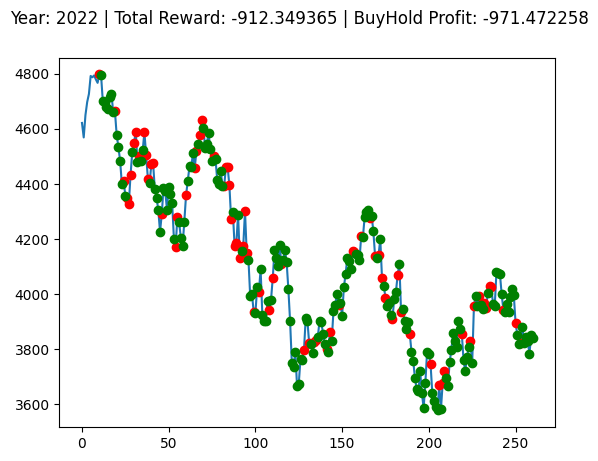

Buy And Hold: 917.112584228516


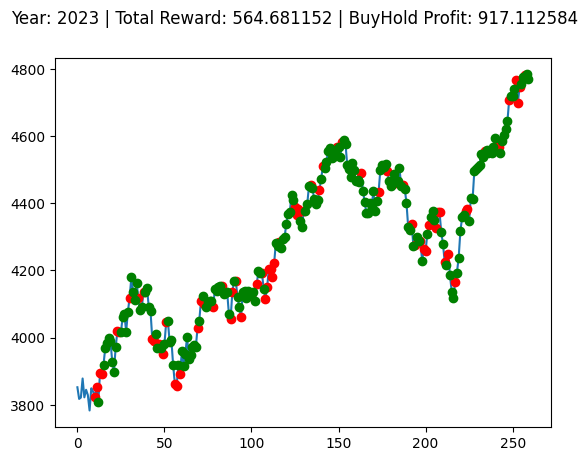

 56%|█████▌    | 56/100 [21:12<16:59, 23.17s/it]

Buy And Hold: -200.5494116210939


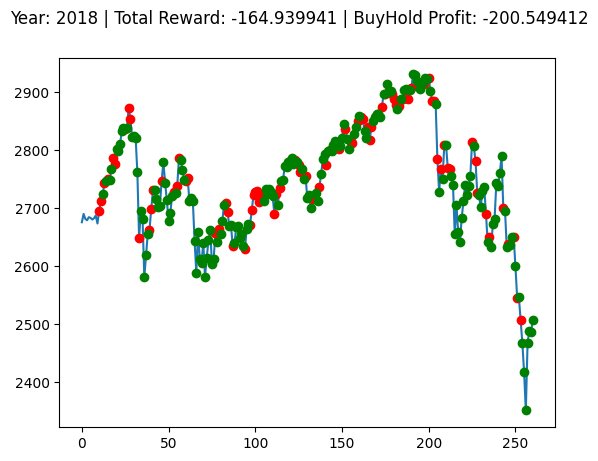

Buy And Hold: 700.9923498535159


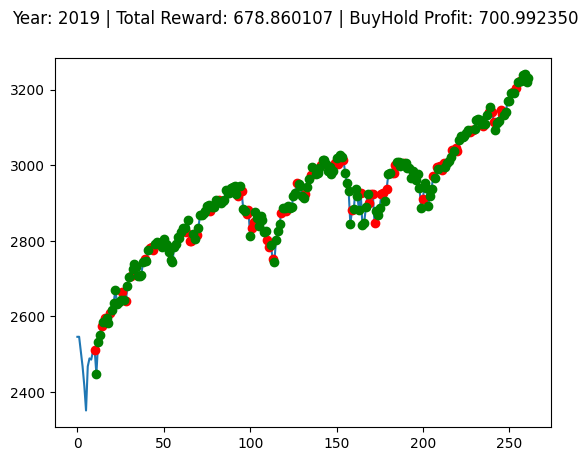

Buy And Hold: 476.9485205078122


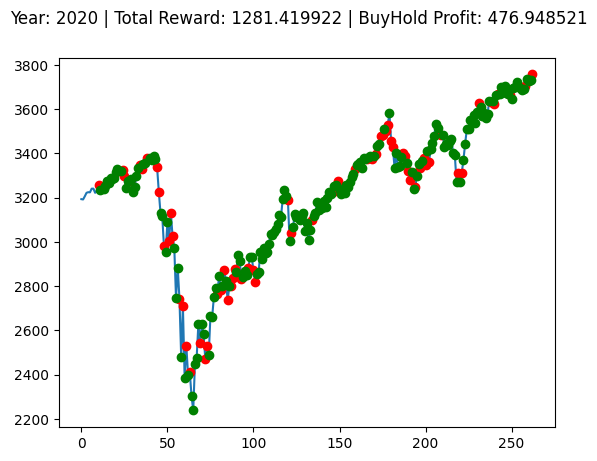

Buy And Hold: 1036.3717211914068


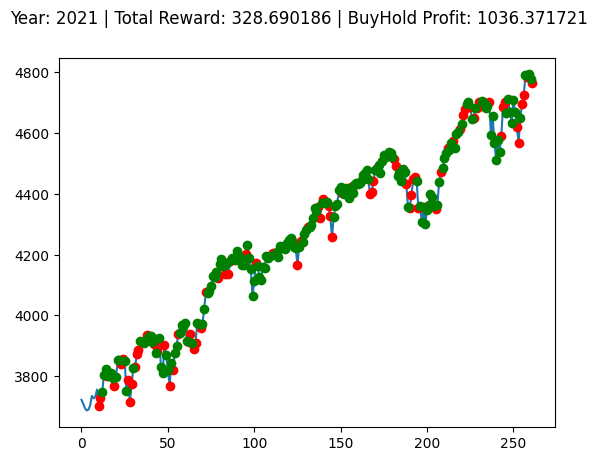

Buy And Hold: -971.472258300781


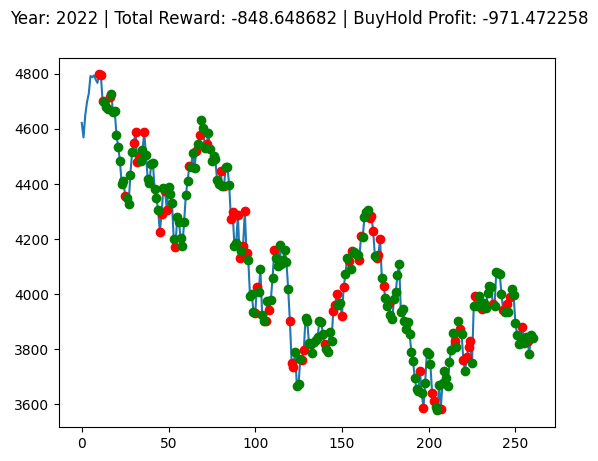

Buy And Hold: 917.112584228516


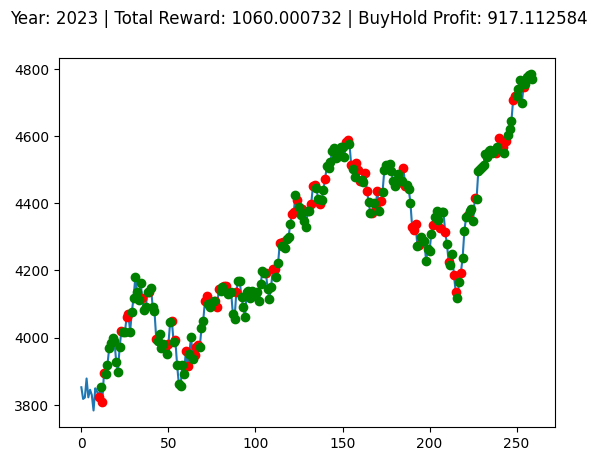

 57%|█████▋    | 57/100 [21:35<16:32, 23.08s/it]

Buy And Hold: -200.5494116210939


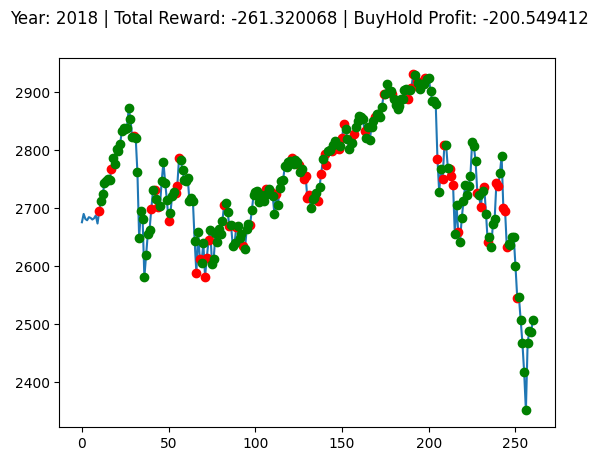

Buy And Hold: 700.9923498535159


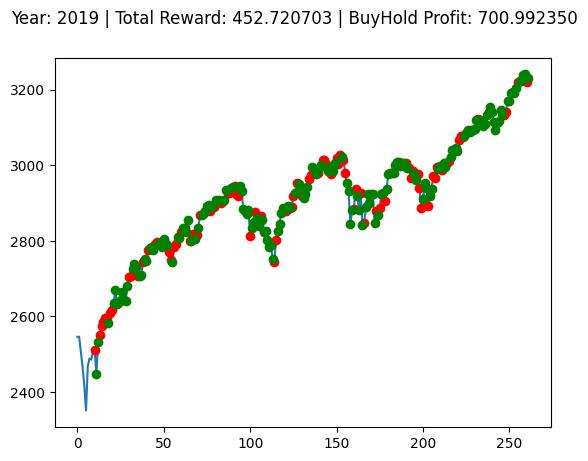

Buy And Hold: 476.9485205078122


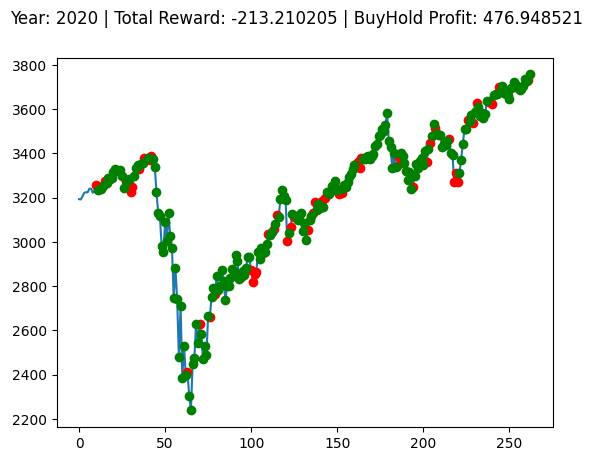

Buy And Hold: 1036.3717211914068


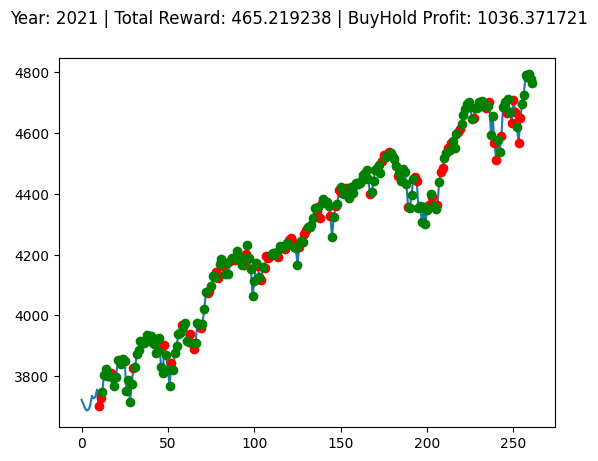

Buy And Hold: -971.472258300781


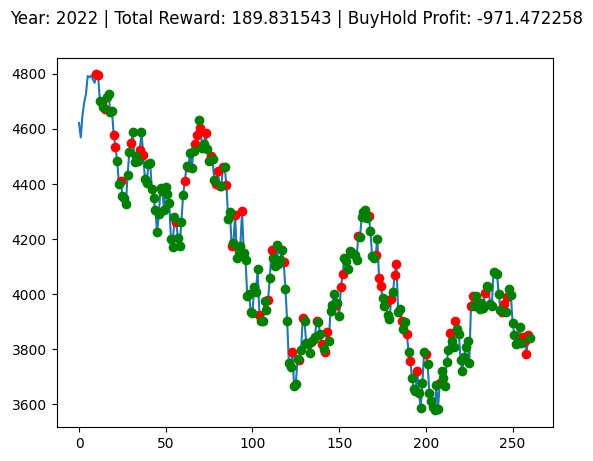

Buy And Hold: 917.112584228516


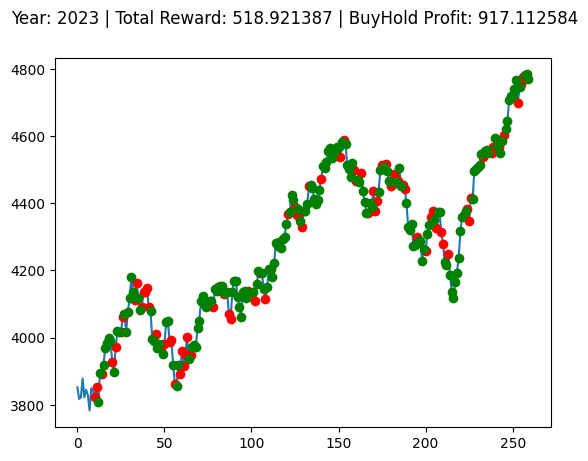

 58%|█████▊    | 58/100 [21:58<16:07, 23.03s/it]

Buy And Hold: -200.5494116210939


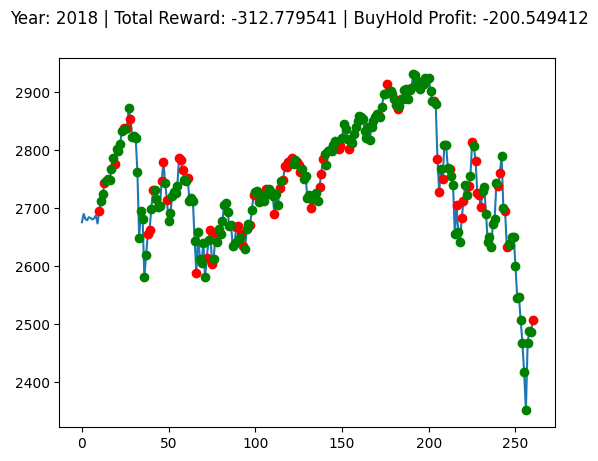

Buy And Hold: 700.9923498535159


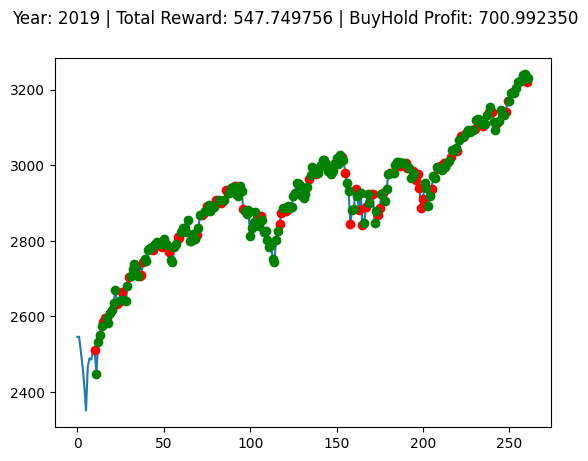

Buy And Hold: 476.9485205078122


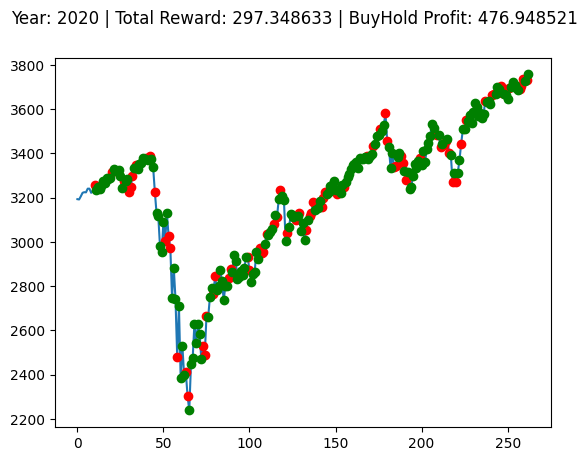

Buy And Hold: 1036.3717211914068


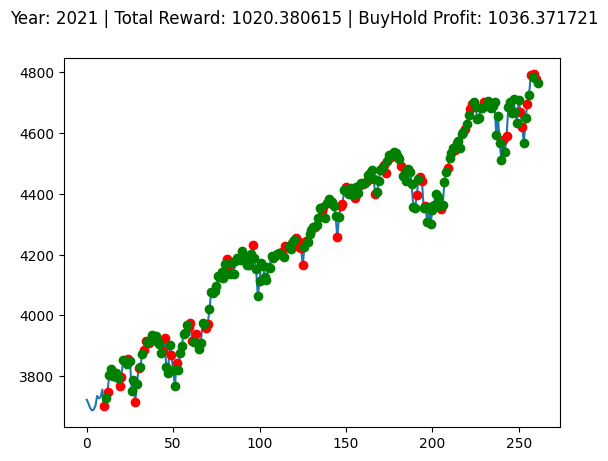

Buy And Hold: -971.472258300781


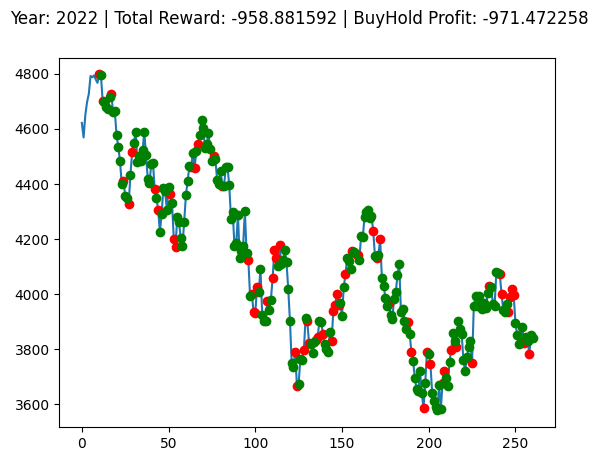

Buy And Hold: 917.112584228516


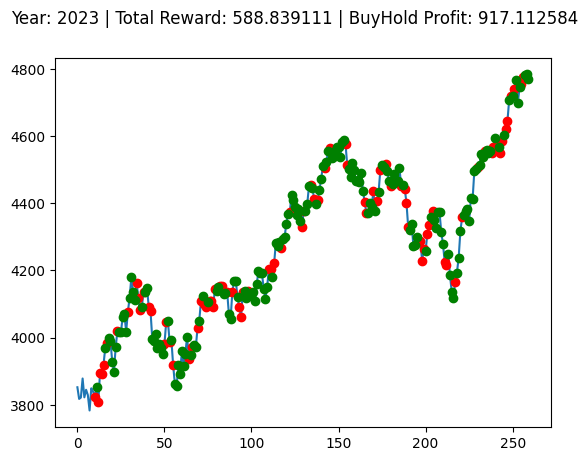

 59%|█████▉    | 59/100 [22:20<15:43, 23.00s/it]

Buy And Hold: -200.5494116210939


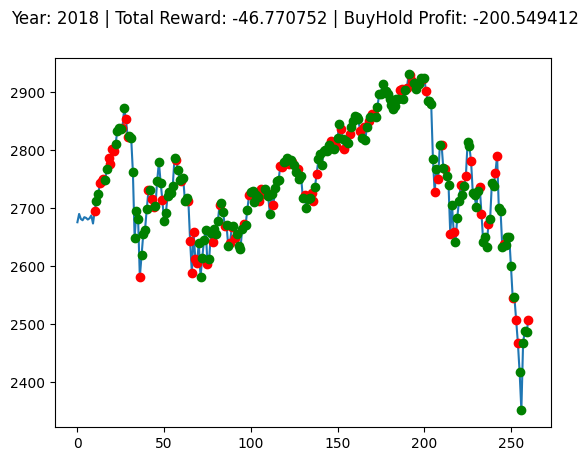

Buy And Hold: 700.9923498535159


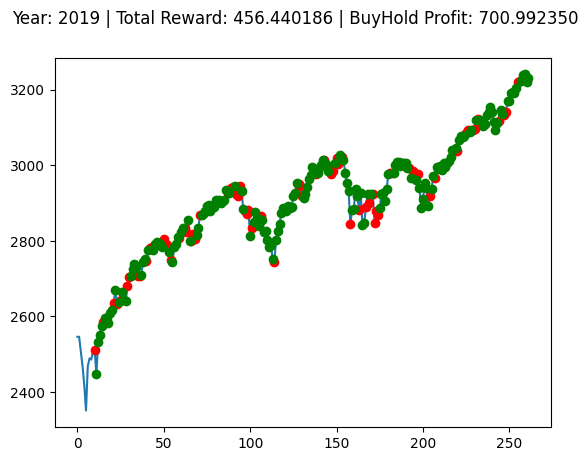

Buy And Hold: 476.9485205078122


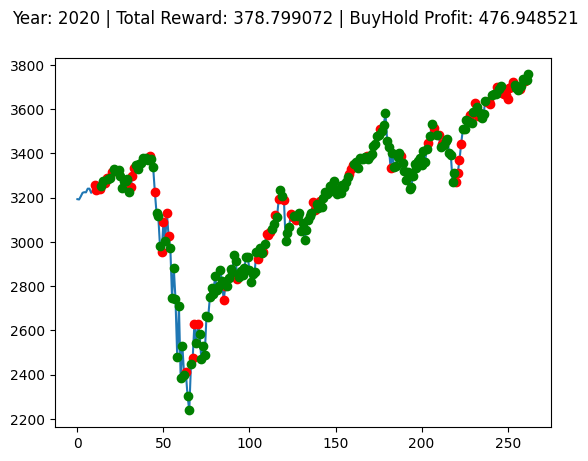

Buy And Hold: 1036.3717211914068


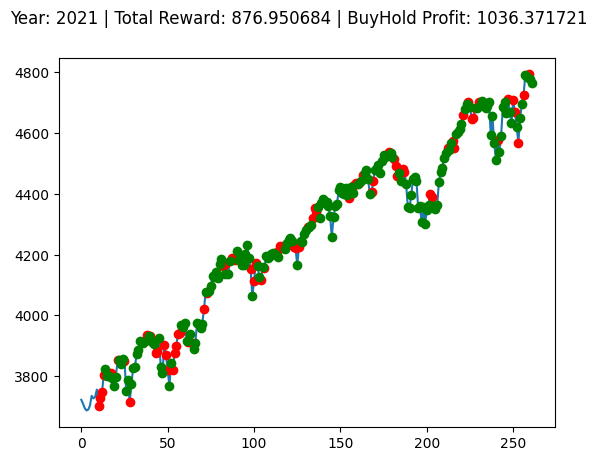

Buy And Hold: -971.472258300781


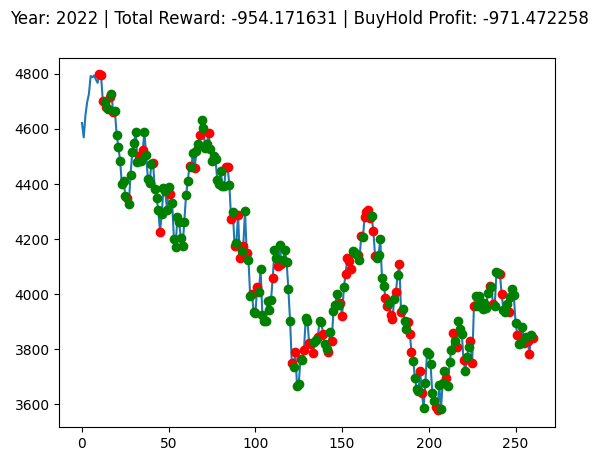

Buy And Hold: 917.112584228516


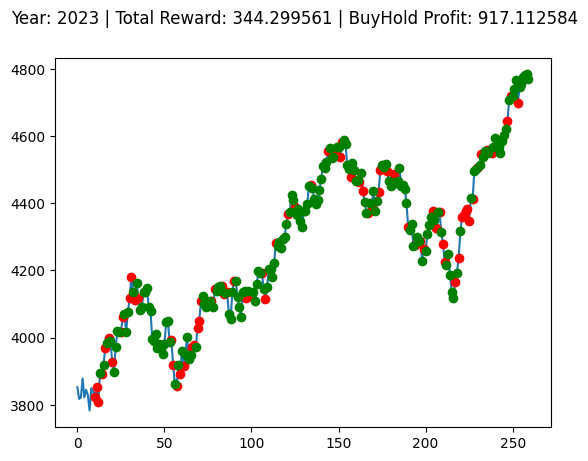

 60%|██████    | 60/100 [22:43<15:16, 22.91s/it]

Buy And Hold: -200.5494116210939


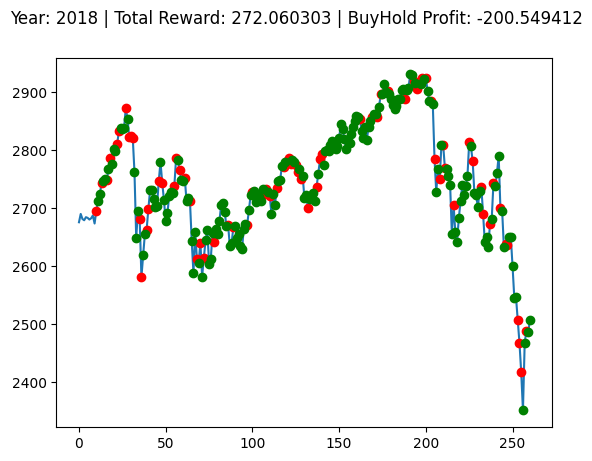

Buy And Hold: 700.9923498535159


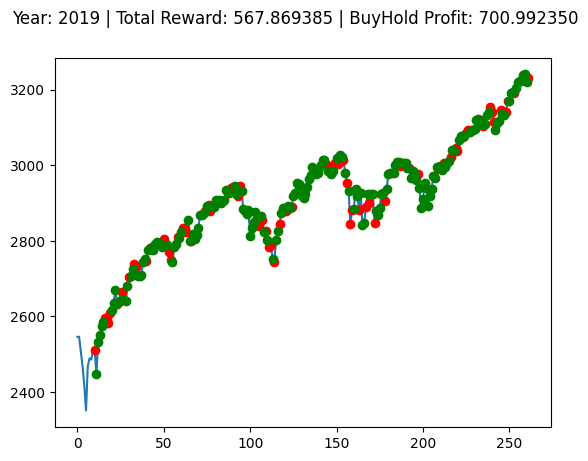

Buy And Hold: 476.9485205078122


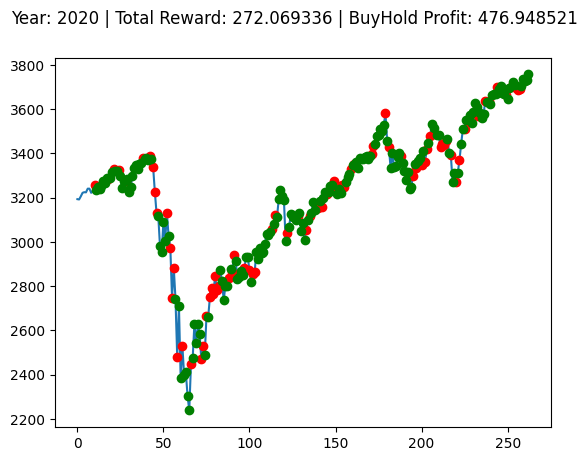

Buy And Hold: 1036.3717211914068


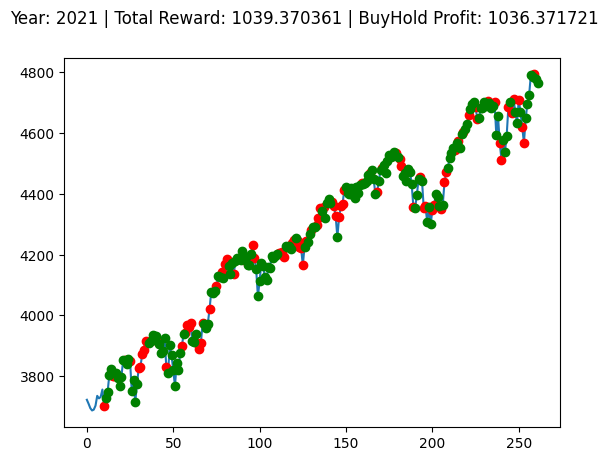

Buy And Hold: -971.472258300781


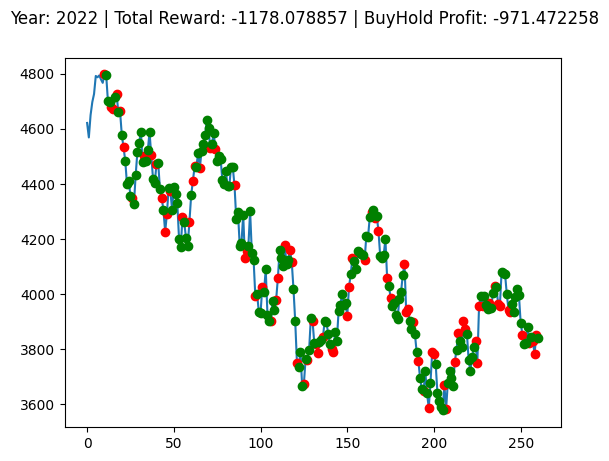

Buy And Hold: 917.112584228516


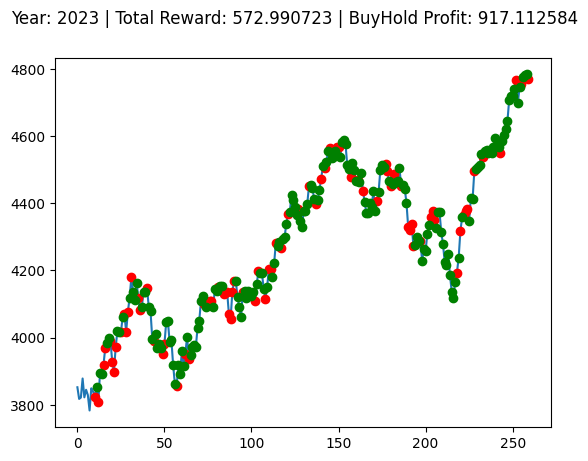

 61%|██████    | 61/100 [23:07<14:59, 23.07s/it]

Buy And Hold: -200.5494116210939


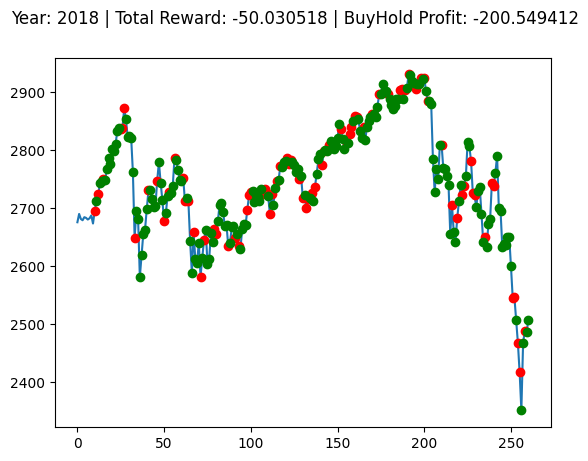

Buy And Hold: 700.9923498535159


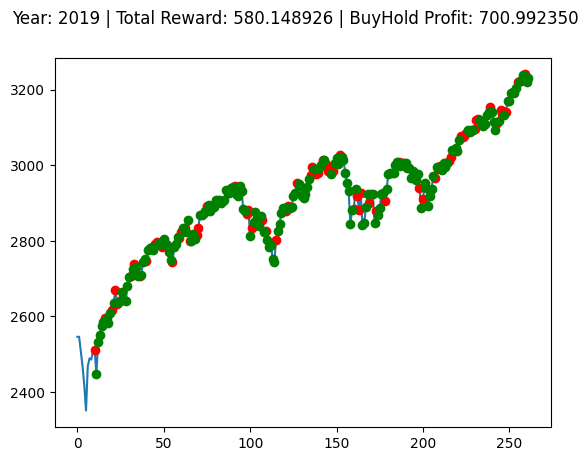

Buy And Hold: 476.9485205078122


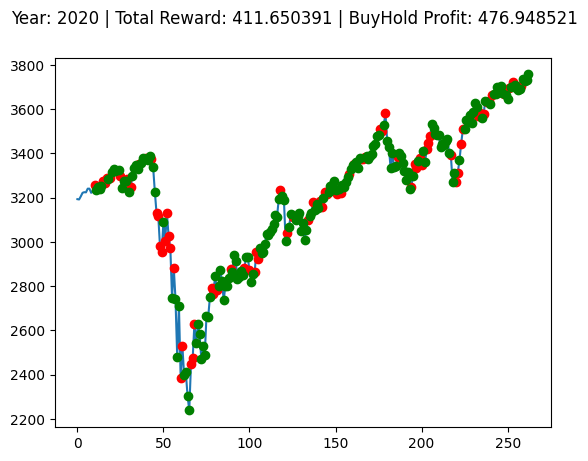

Buy And Hold: 1036.3717211914068


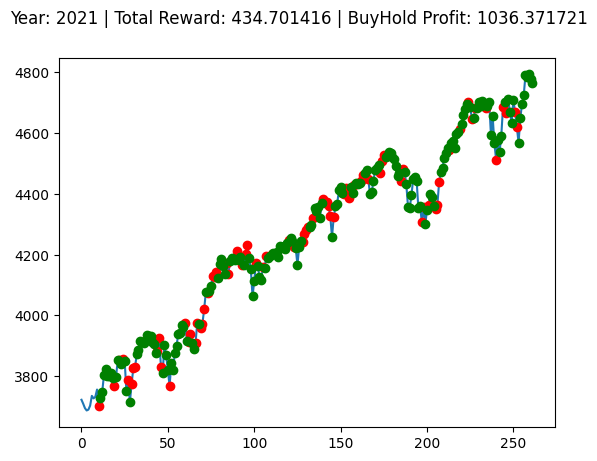

Buy And Hold: -971.472258300781


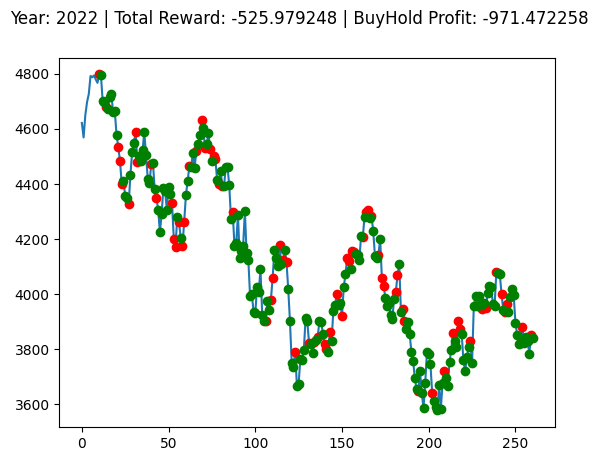

Buy And Hold: 917.112584228516


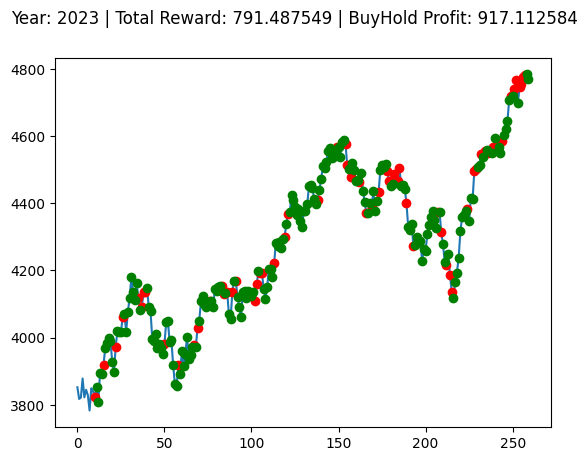

 62%|██████▏   | 62/100 [23:30<14:37, 23.10s/it]

Buy And Hold: -200.5494116210939


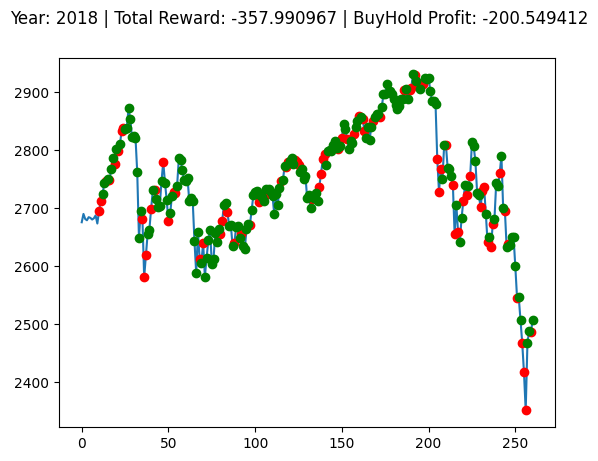

Buy And Hold: 700.9923498535159


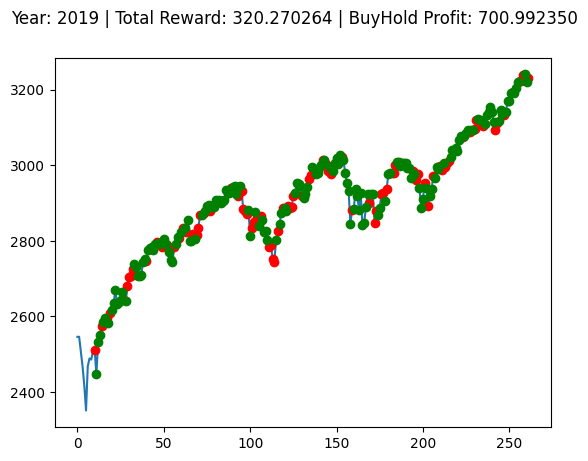

Buy And Hold: 476.9485205078122


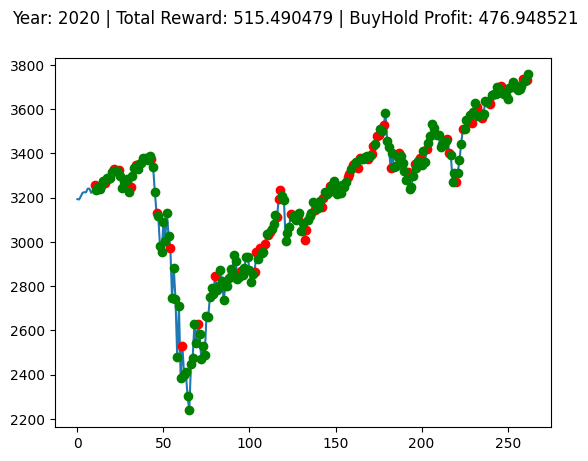

Buy And Hold: 1036.3717211914068


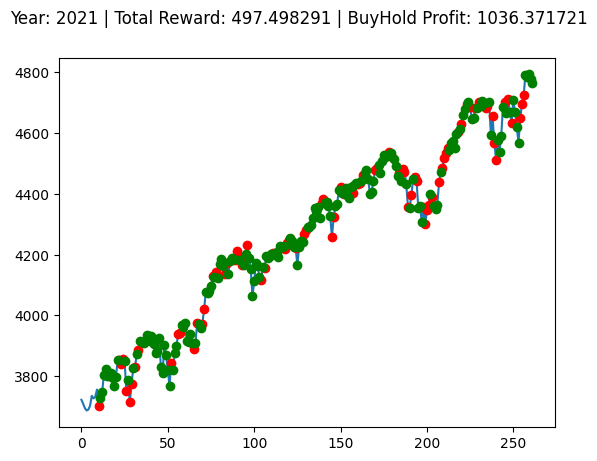

Buy And Hold: -971.472258300781


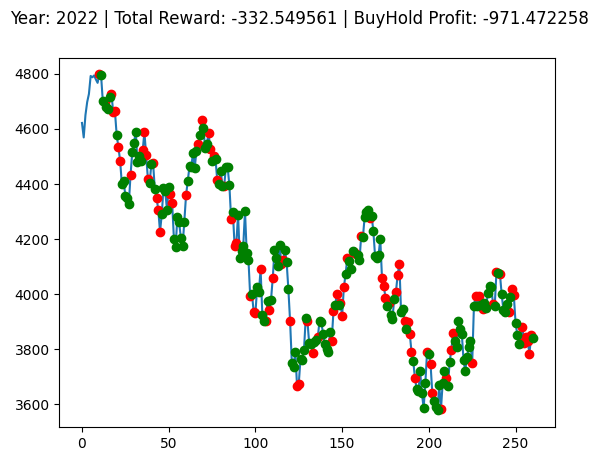

Buy And Hold: 917.112584228516


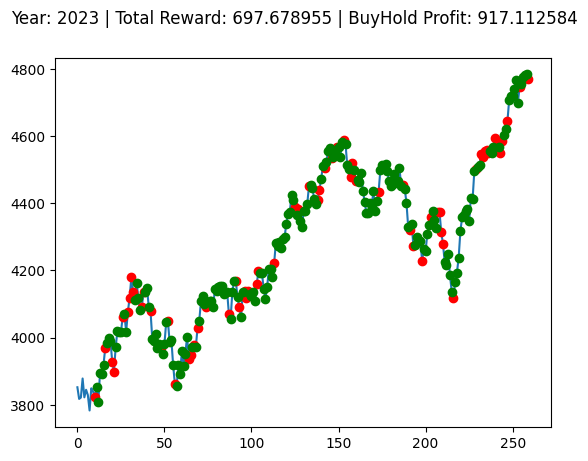

 63%|██████▎   | 63/100 [23:53<14:10, 23.00s/it]

Buy And Hold: -200.5494116210939


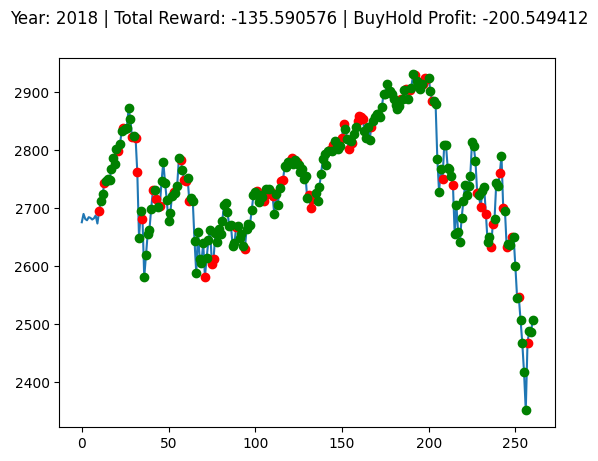

Buy And Hold: 700.9923498535159


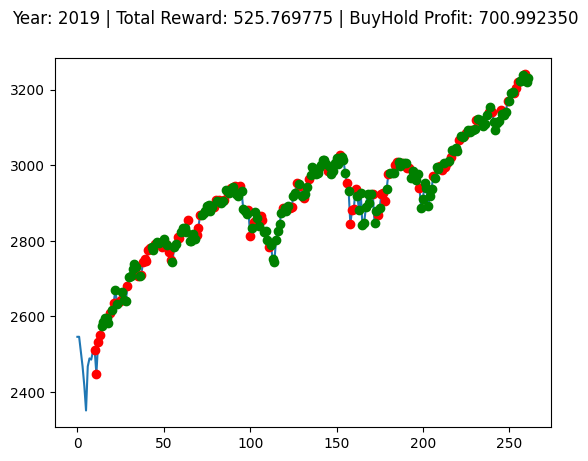

Buy And Hold: 476.9485205078122


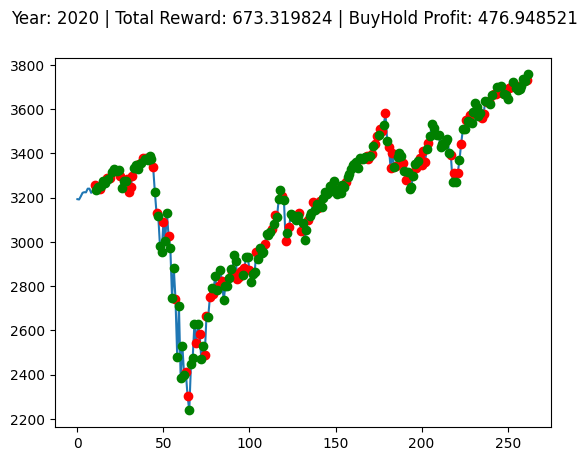

Buy And Hold: 1036.3717211914068


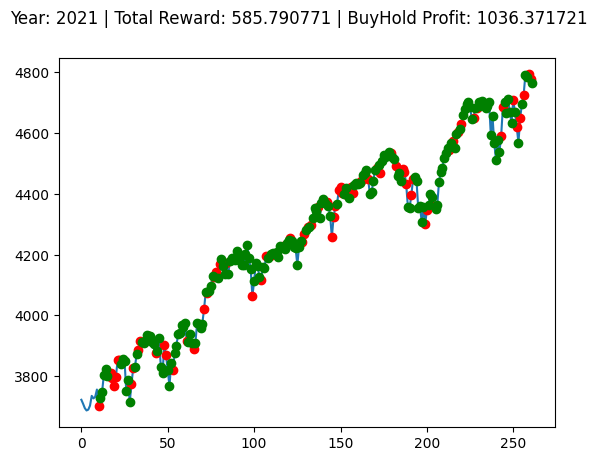

Buy And Hold: -971.472258300781


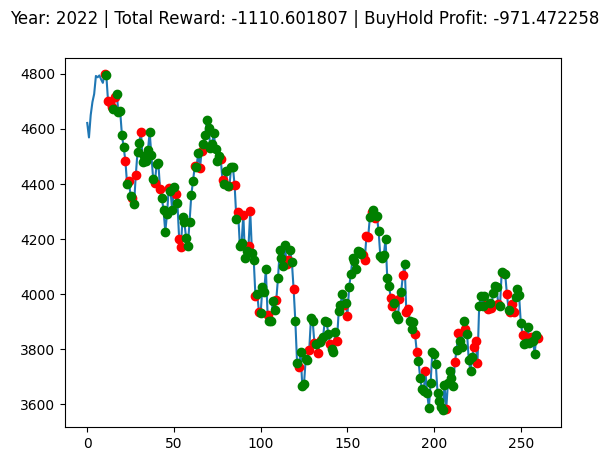

Buy And Hold: 917.112584228516


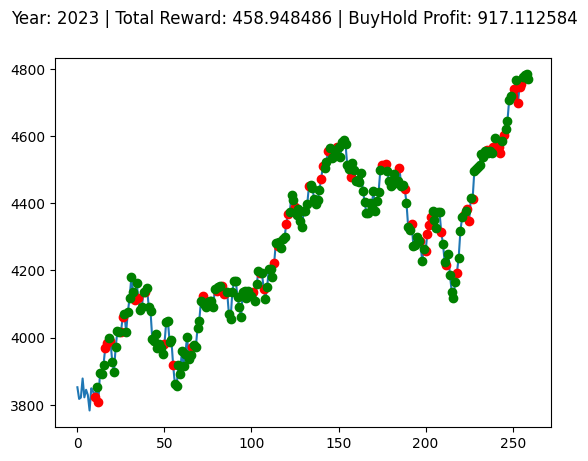

 64%|██████▍   | 64/100 [24:15<13:41, 22.82s/it]

Buy And Hold: -200.5494116210939


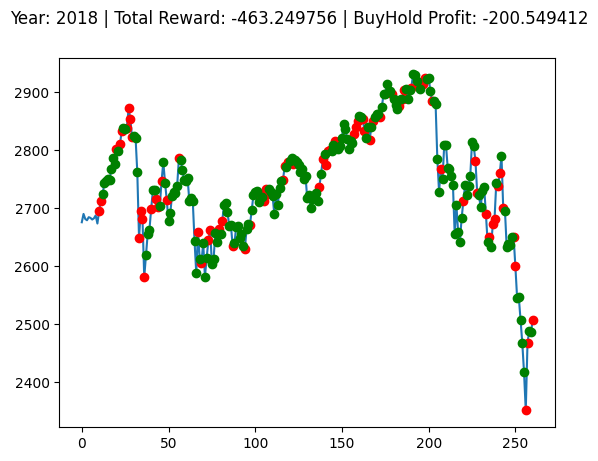

Buy And Hold: 700.9923498535159


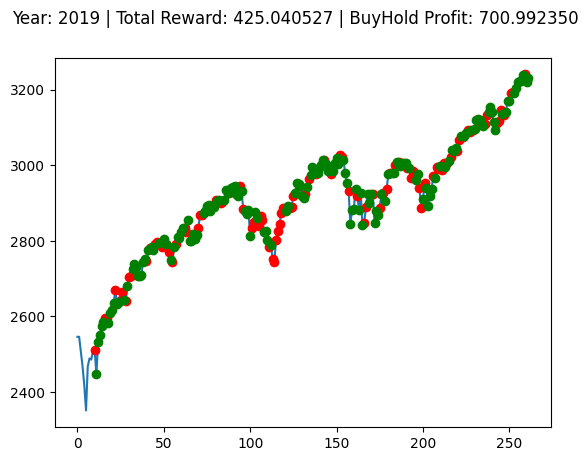

Buy And Hold: 476.9485205078122


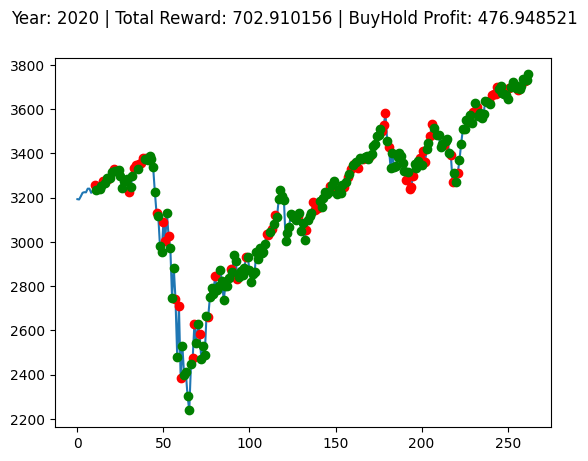

Buy And Hold: 1036.3717211914068


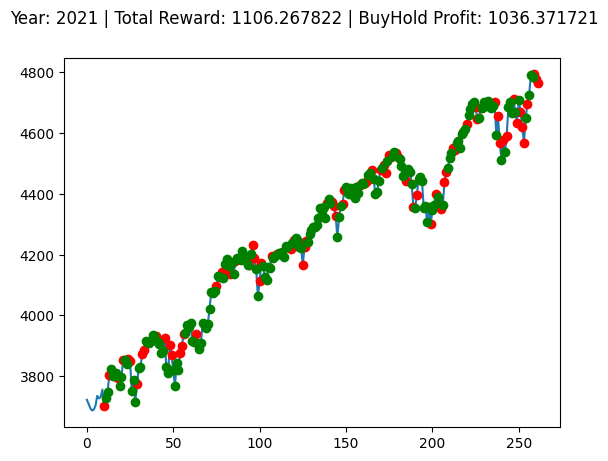

Buy And Hold: -971.472258300781


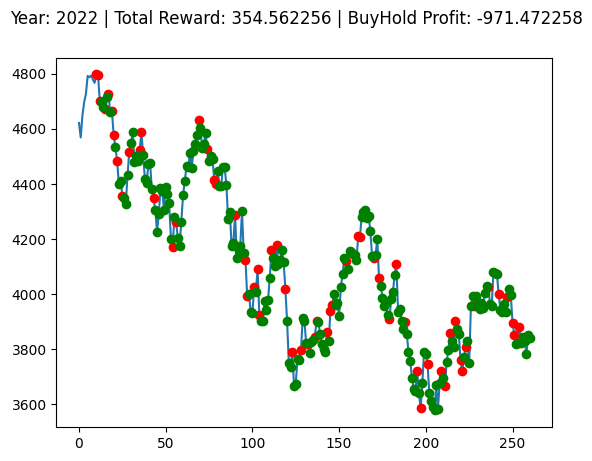

Buy And Hold: 917.112584228516


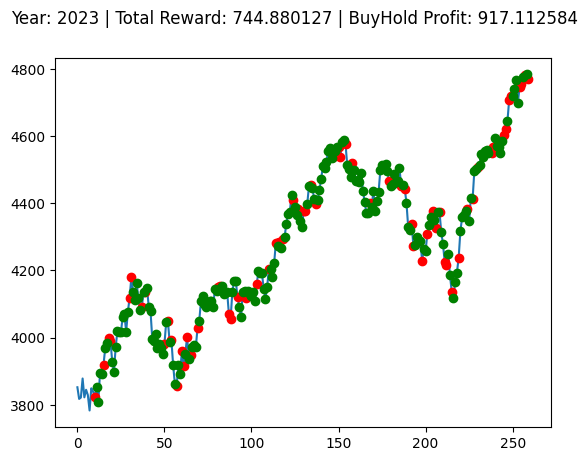

 65%|██████▌   | 65/100 [24:38<13:20, 22.86s/it]

Buy And Hold: -200.5494116210939


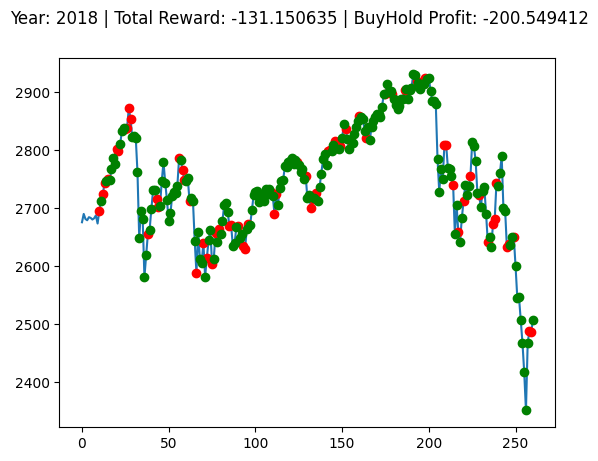

Buy And Hold: 700.9923498535159


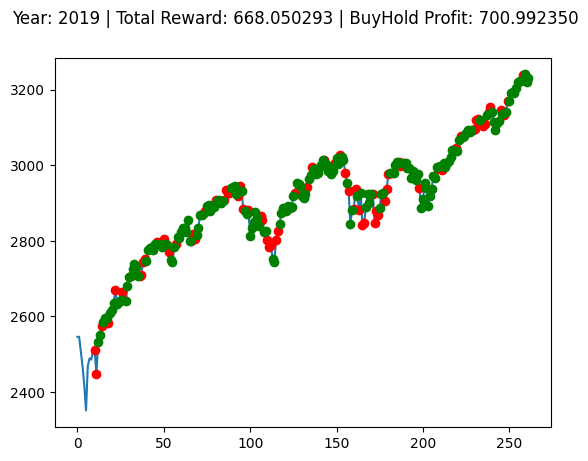

Buy And Hold: 476.9485205078122


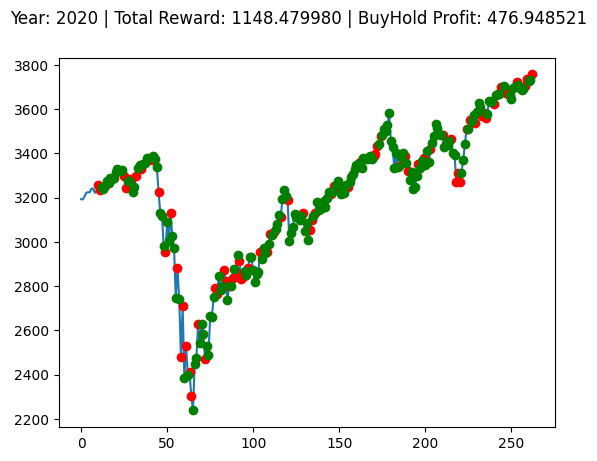

Buy And Hold: 1036.3717211914068


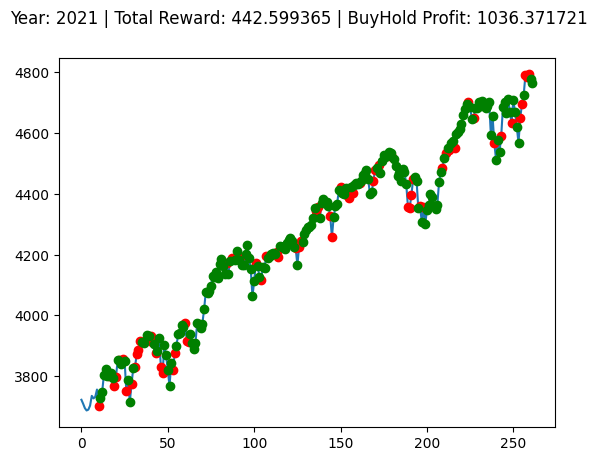

Buy And Hold: -971.472258300781


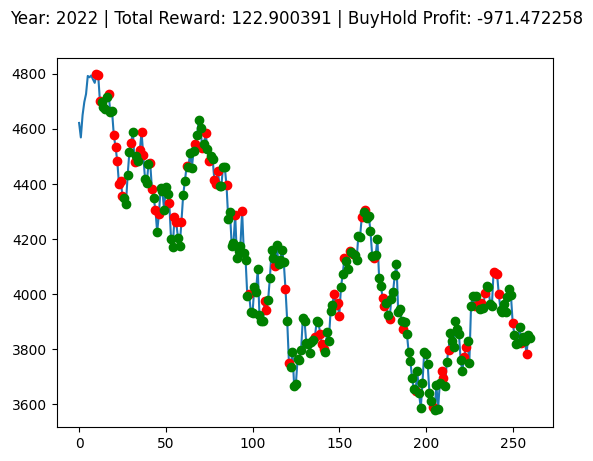

Buy And Hold: 917.112584228516


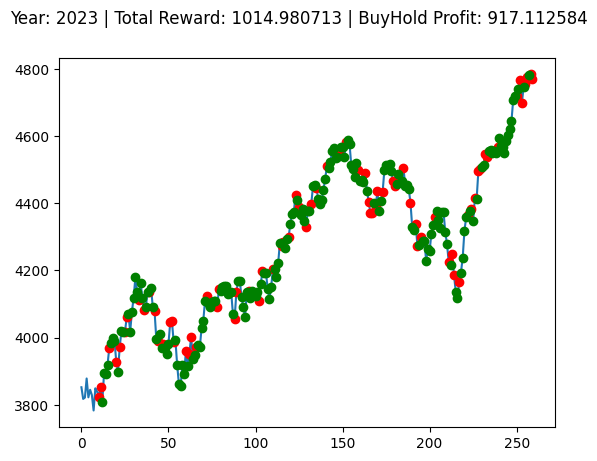

 66%|██████▌   | 66/100 [25:01<13:02, 23.01s/it]

Buy And Hold: -200.5494116210939


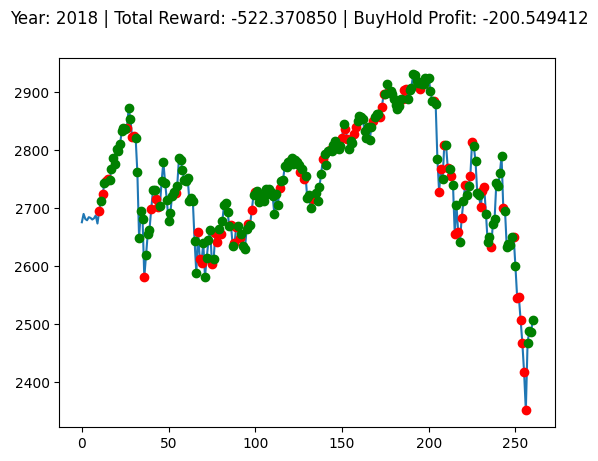

Buy And Hold: 700.9923498535159


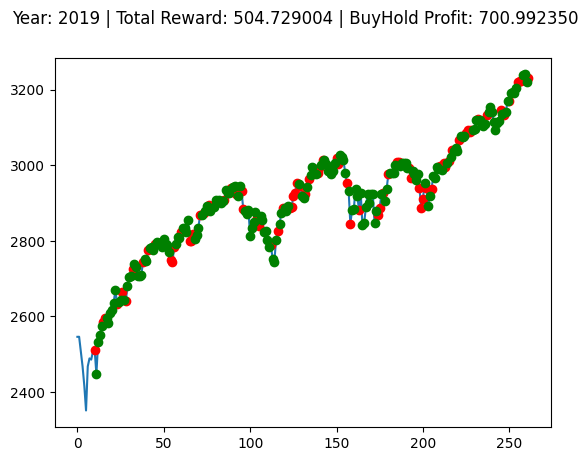

Buy And Hold: 476.9485205078122


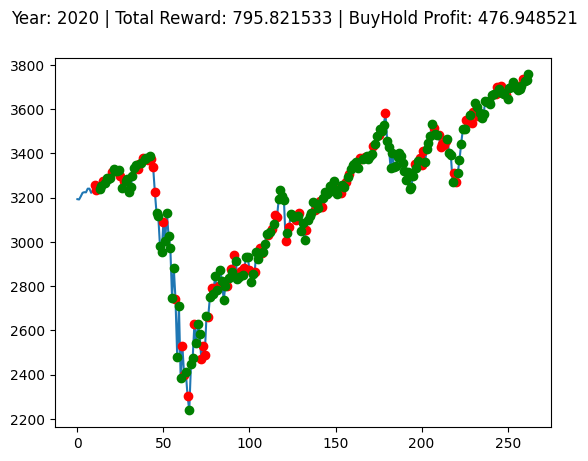

Buy And Hold: 1036.3717211914068


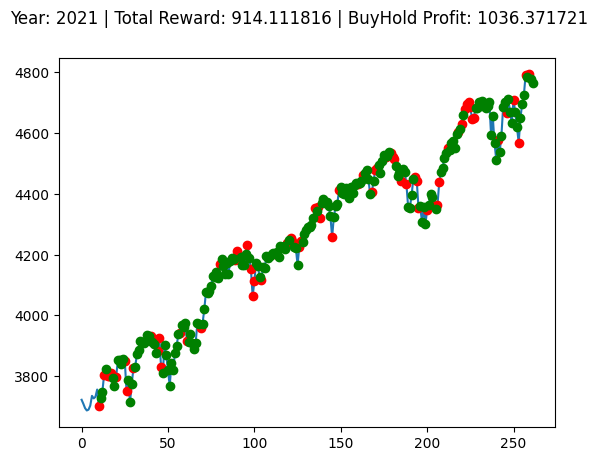

Buy And Hold: -971.472258300781


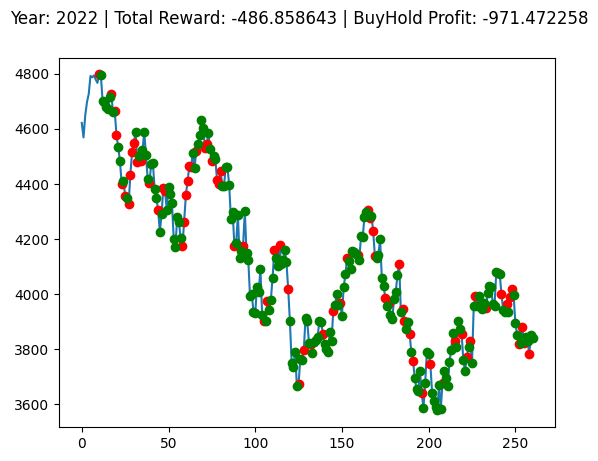

Buy And Hold: 917.112584228516


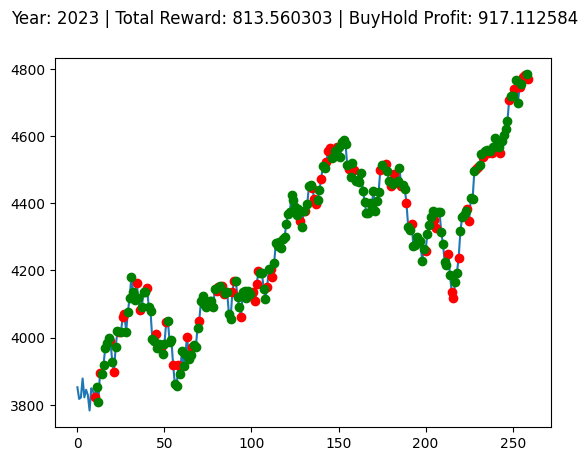

 67%|██████▋   | 67/100 [25:24<12:39, 23.01s/it]

Buy And Hold: -200.5494116210939


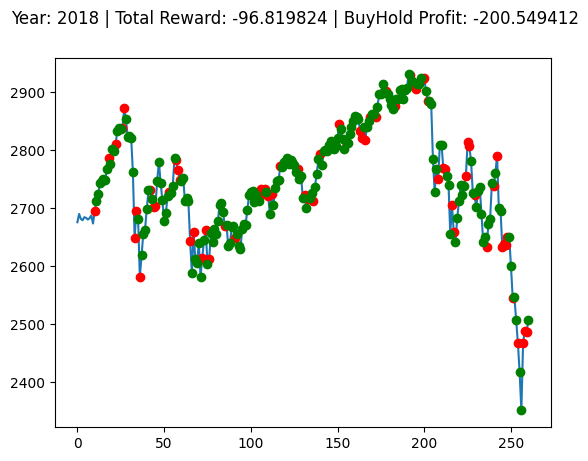

Buy And Hold: 700.9923498535159


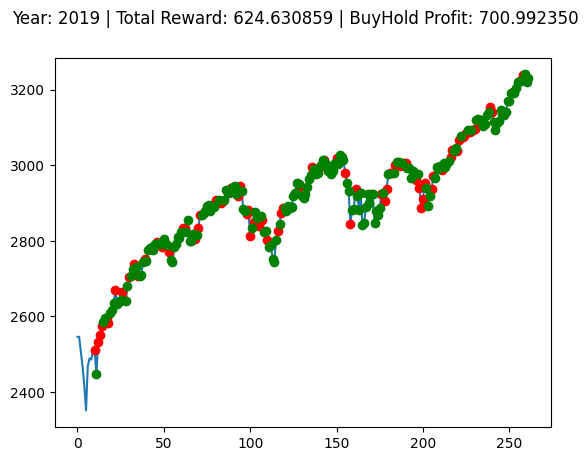

Buy And Hold: 476.9485205078122


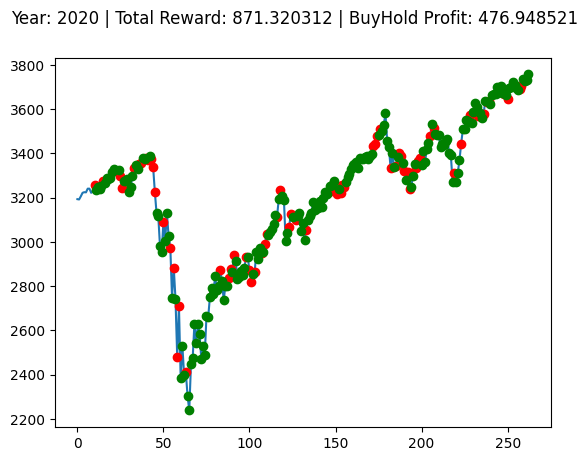

Buy And Hold: 1036.3717211914068


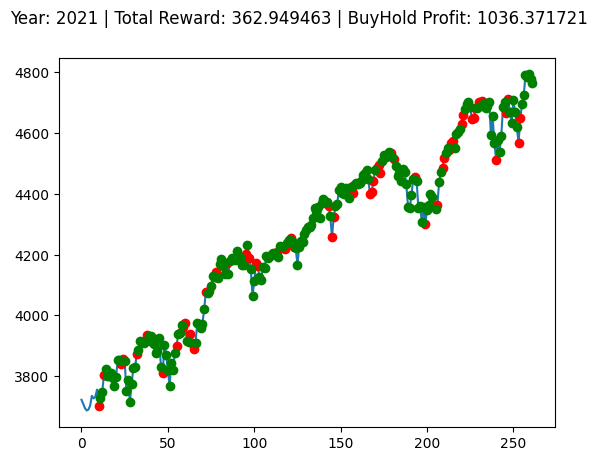

Buy And Hold: -971.472258300781


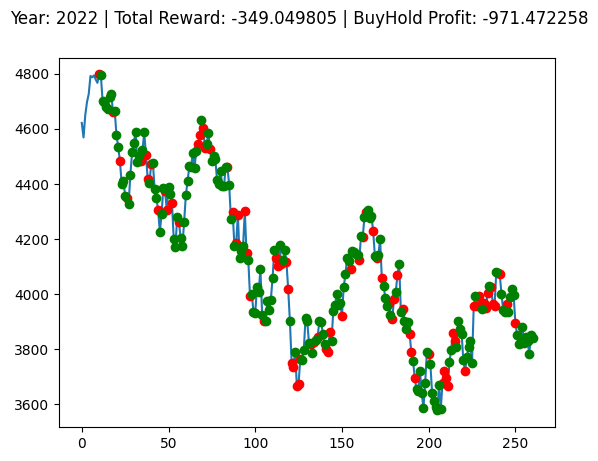

Buy And Hold: 917.112584228516


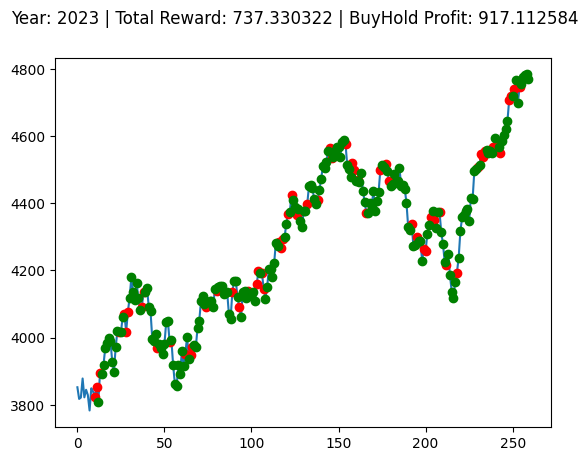

 68%|██████▊   | 68/100 [25:47<12:12, 22.90s/it]

Buy And Hold: -200.5494116210939


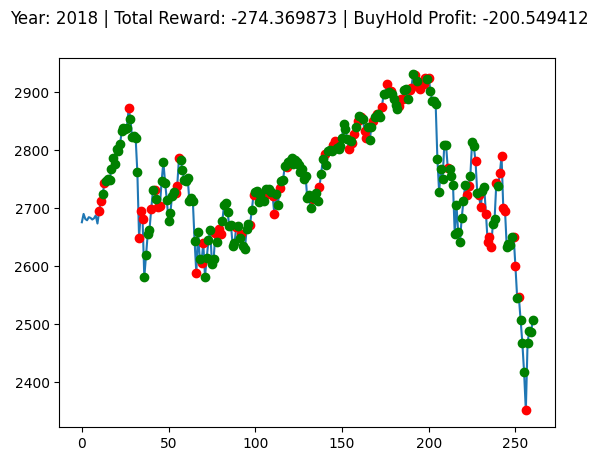

Buy And Hold: 700.9923498535159


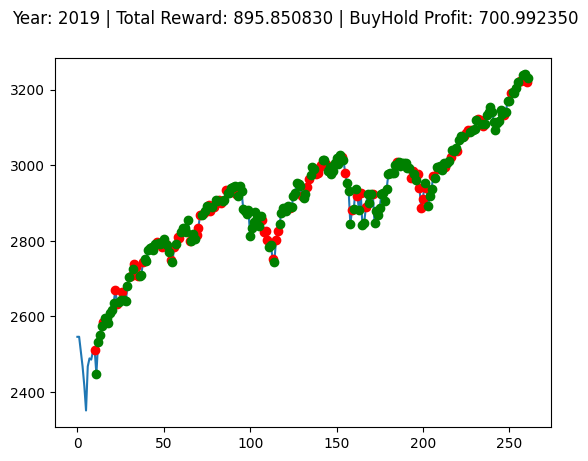

Buy And Hold: 476.9485205078122


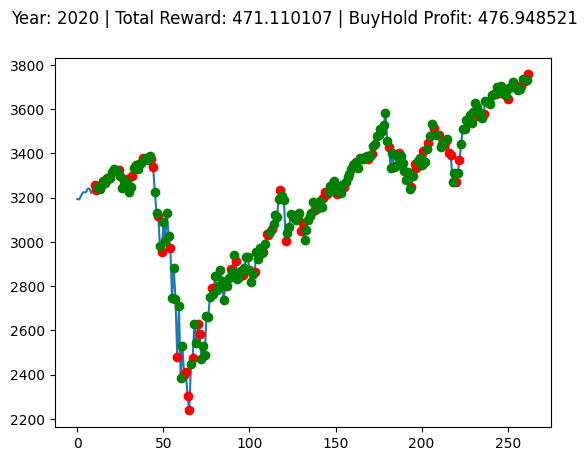

Buy And Hold: 1036.3717211914068


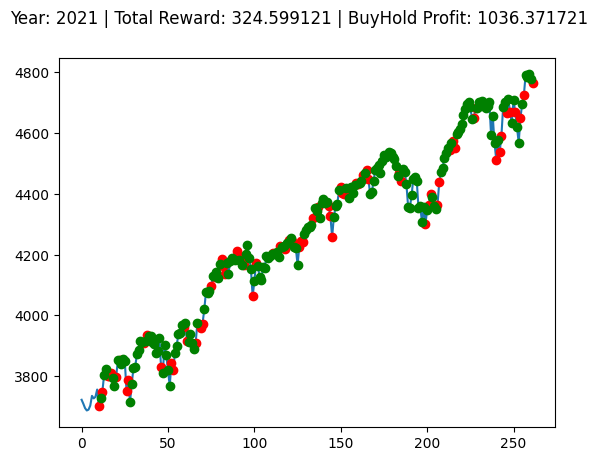

Buy And Hold: -971.472258300781


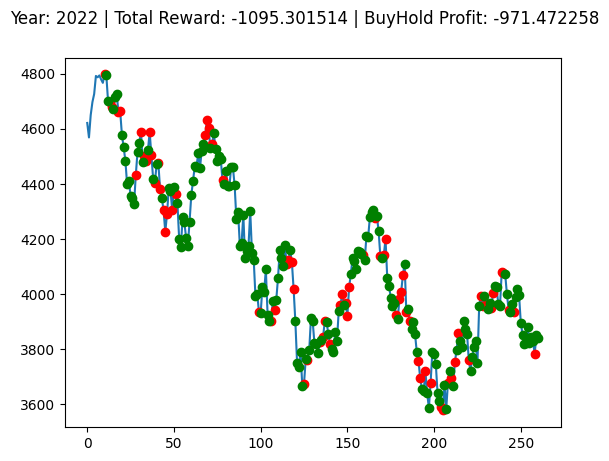

Buy And Hold: 917.112584228516


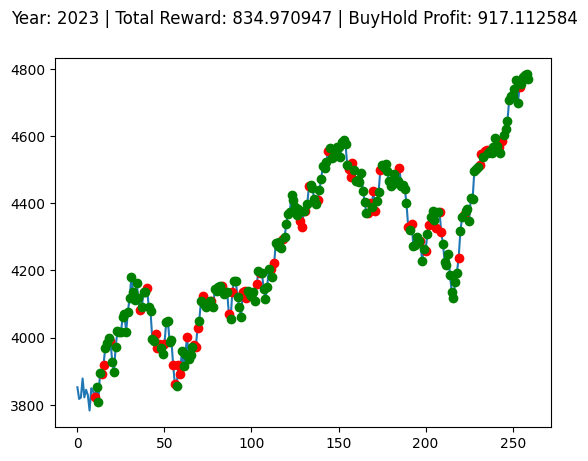

 69%|██████▉   | 69/100 [26:11<12:00, 23.23s/it]

Buy And Hold: -200.5494116210939


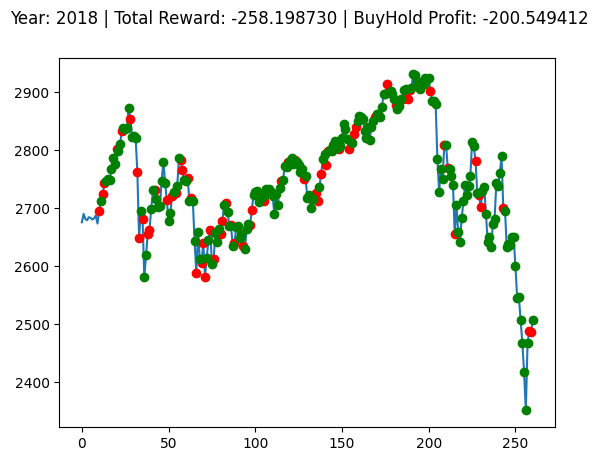

Buy And Hold: 700.9923498535159


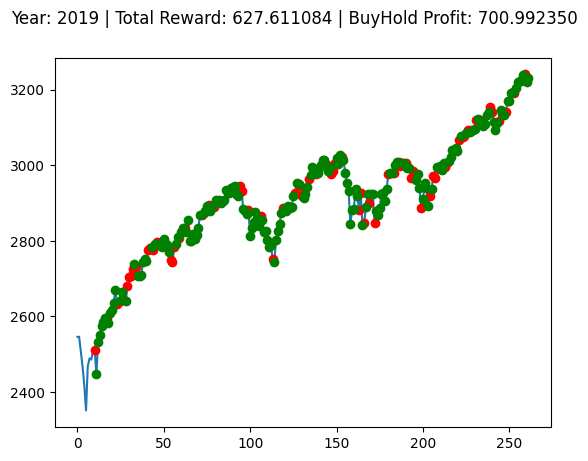

Buy And Hold: 476.9485205078122


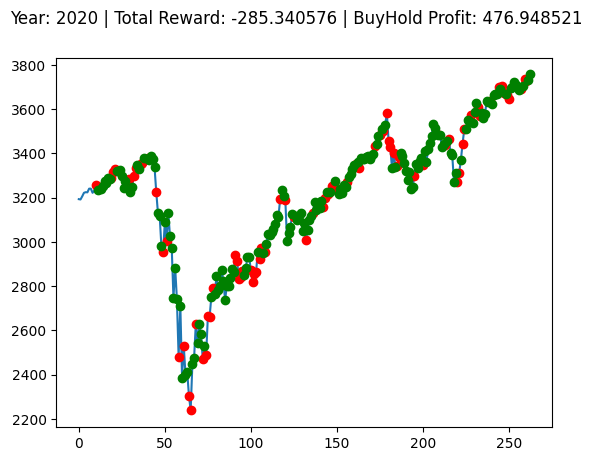

Buy And Hold: 1036.3717211914068


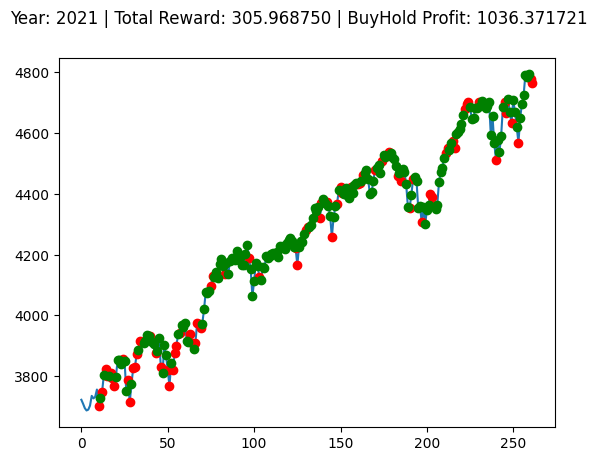

Buy And Hold: -971.472258300781


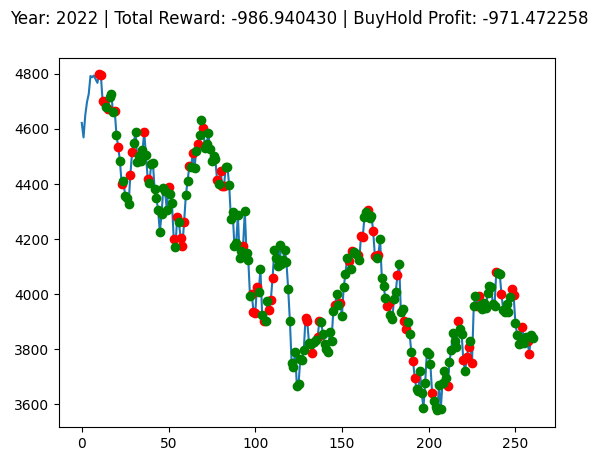

Buy And Hold: 917.112584228516


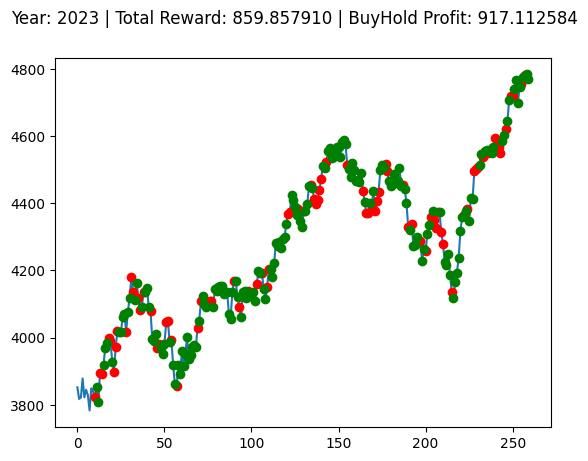

 70%|███████   | 70/100 [26:34<11:39, 23.30s/it]

Buy And Hold: -200.5494116210939


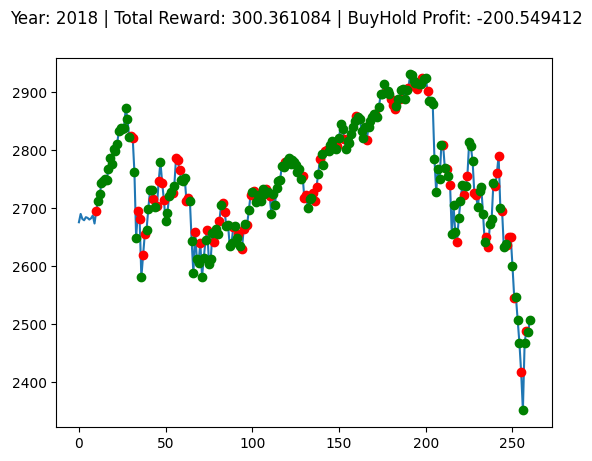

Buy And Hold: 700.9923498535159


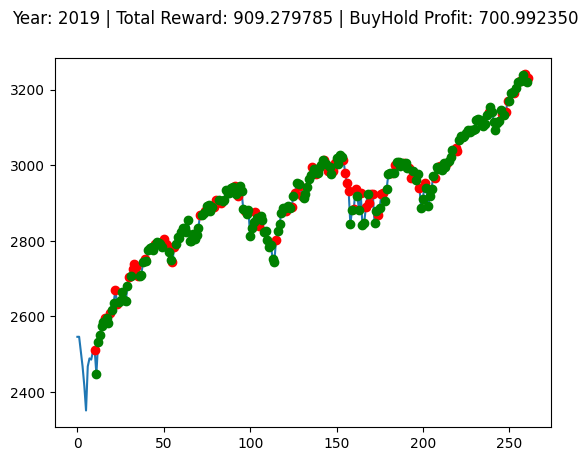

Buy And Hold: 476.9485205078122


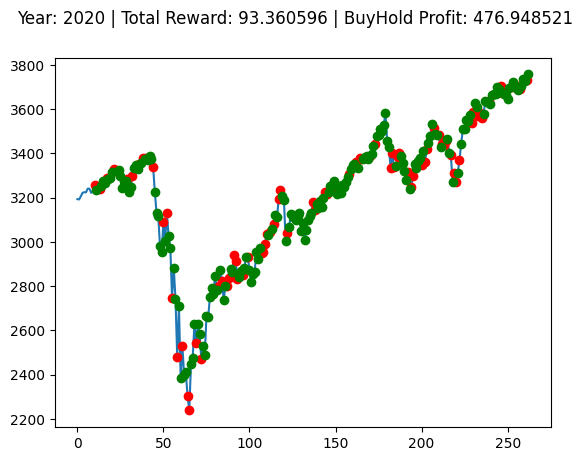

Buy And Hold: 1036.3717211914068


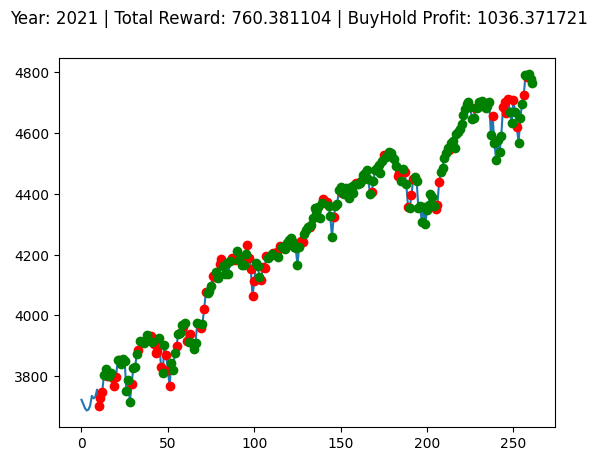

Buy And Hold: -971.472258300781


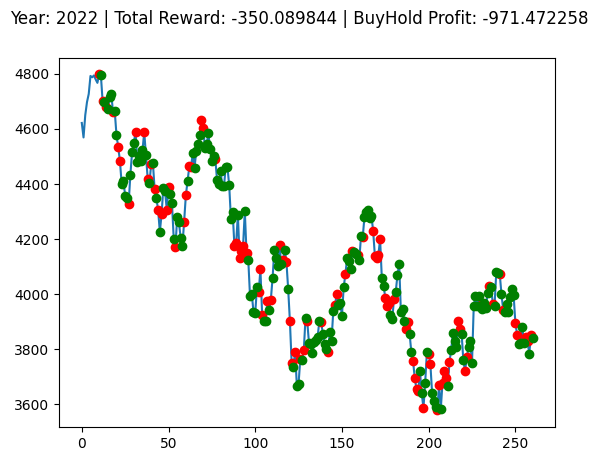

Buy And Hold: 917.112584228516


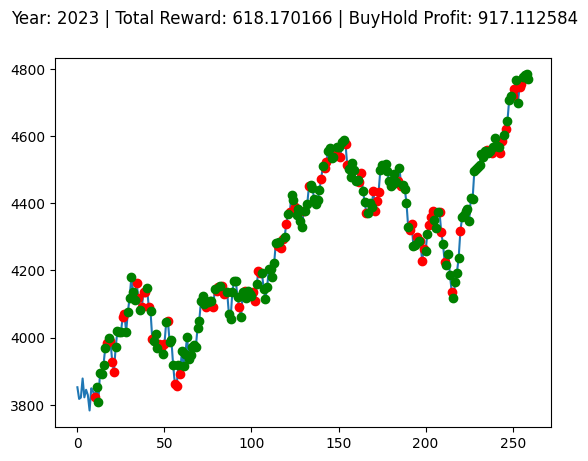

 71%|███████   | 71/100 [26:58<11:17, 23.37s/it]

Buy And Hold: -200.5494116210939


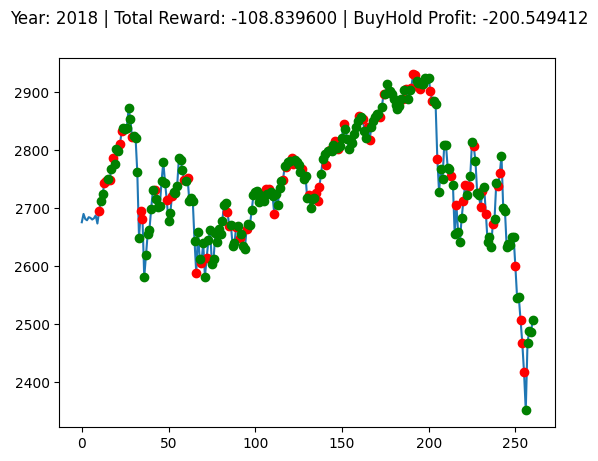

Buy And Hold: 700.9923498535159


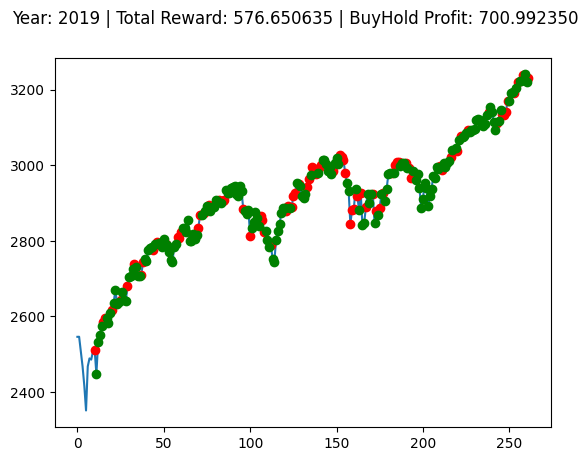

Buy And Hold: 476.9485205078122


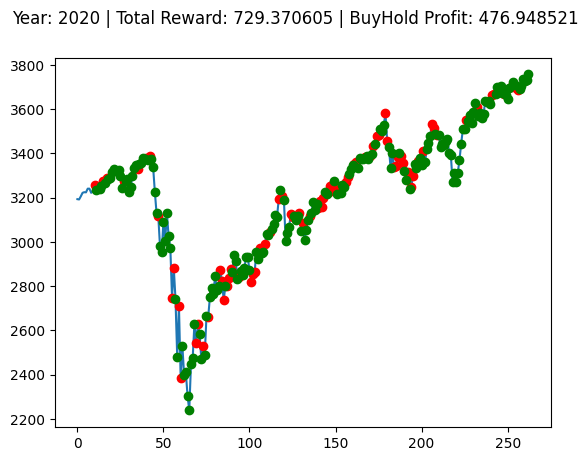

Buy And Hold: 1036.3717211914068


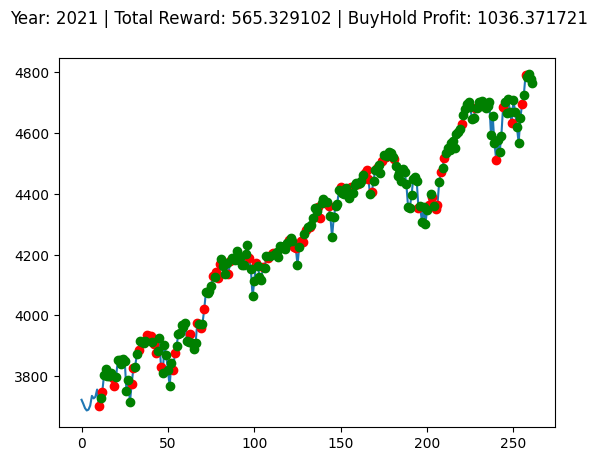

Buy And Hold: -971.472258300781


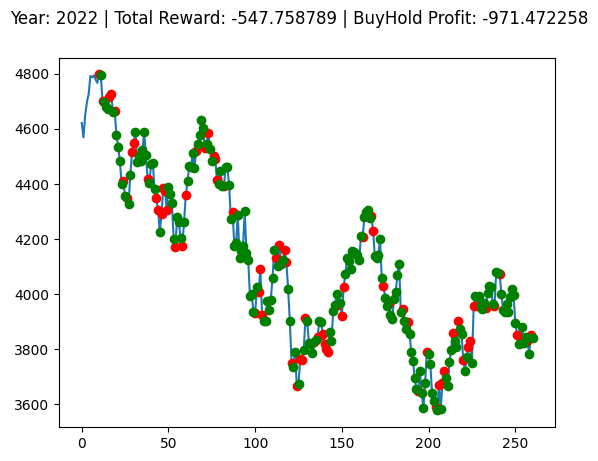

Buy And Hold: 917.112584228516


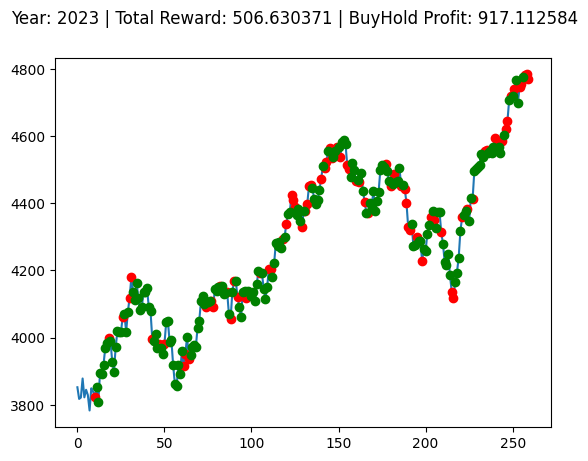

 72%|███████▏  | 72/100 [27:21<10:55, 23.42s/it]

Buy And Hold: -200.5494116210939


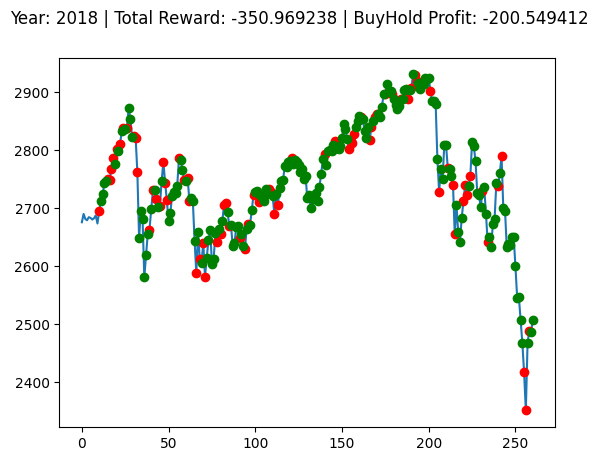

Buy And Hold: 700.9923498535159


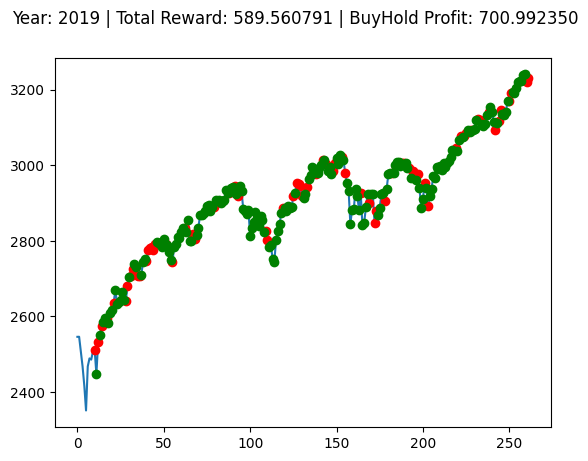

Buy And Hold: 476.9485205078122


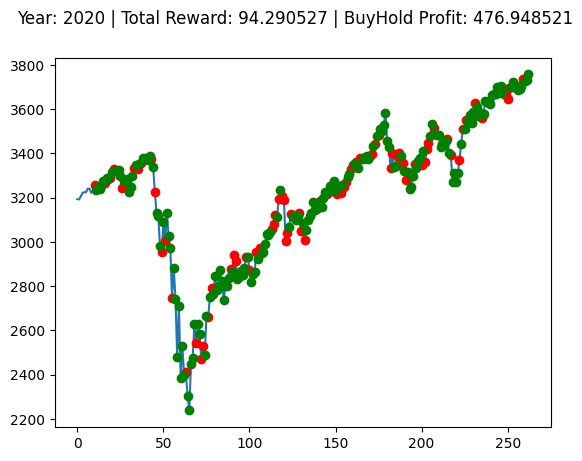

Buy And Hold: 1036.3717211914068


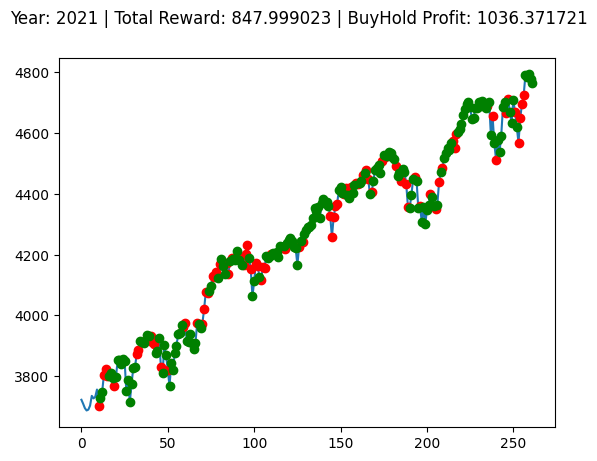

Buy And Hold: -971.472258300781


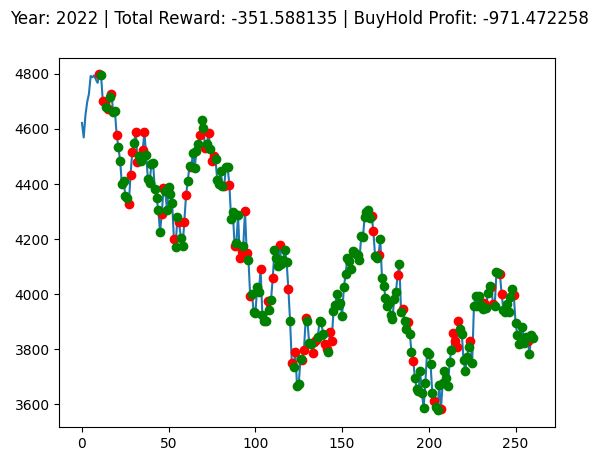

Buy And Hold: 917.112584228516


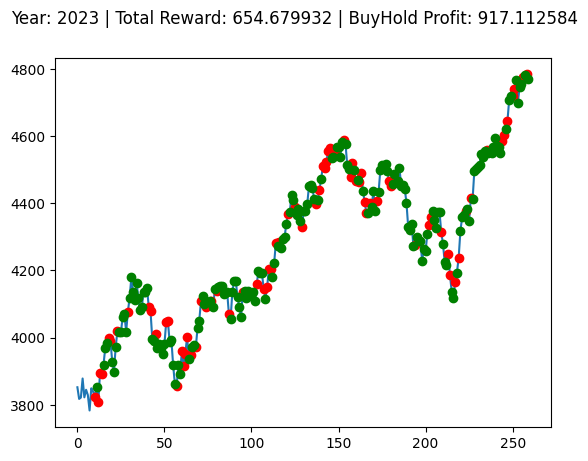

 73%|███████▎  | 73/100 [27:45<10:35, 23.54s/it]

Buy And Hold: -200.5494116210939


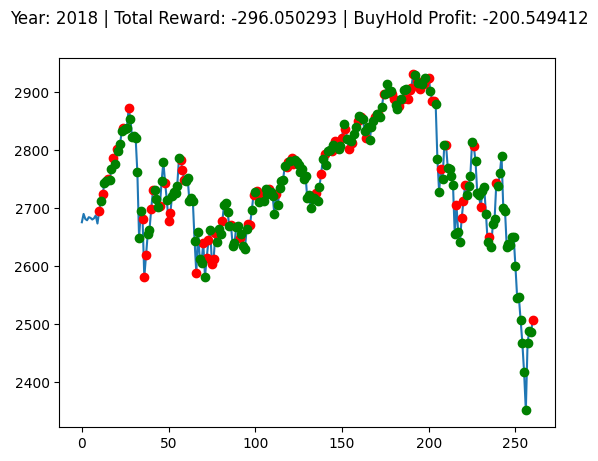

Buy And Hold: 700.9923498535159


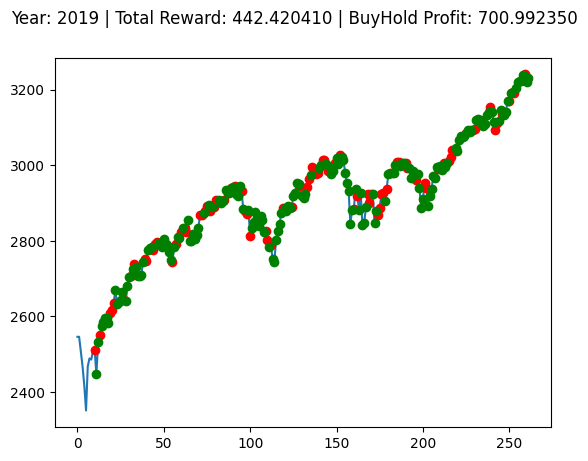

Buy And Hold: 476.9485205078122


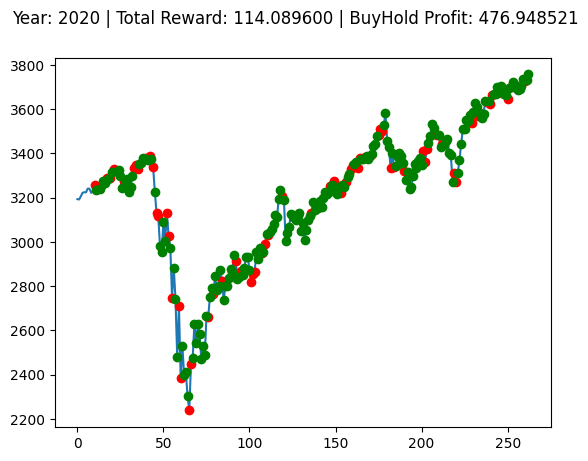

Buy And Hold: 1036.3717211914068


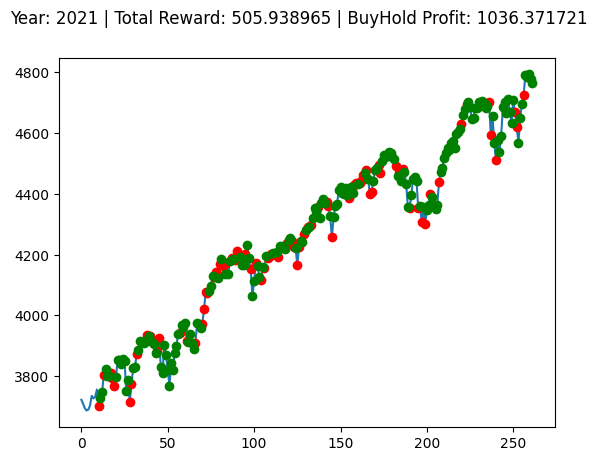

Buy And Hold: -971.472258300781


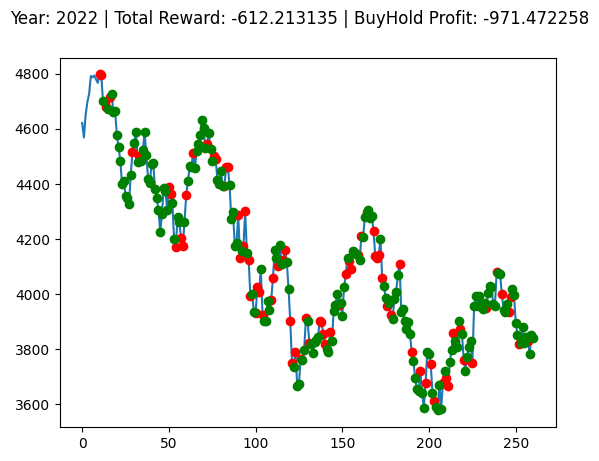

Buy And Hold: 917.112584228516


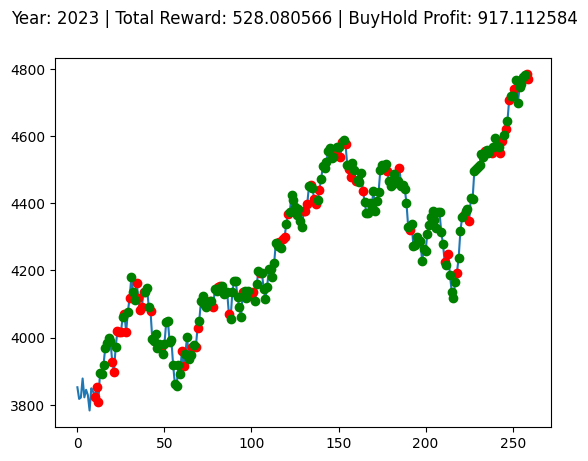

 74%|███████▍  | 74/100 [28:08<10:04, 23.27s/it]

Buy And Hold: -200.5494116210939


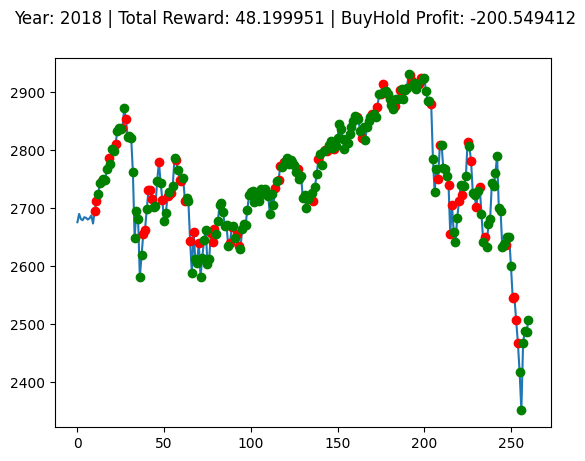

Buy And Hold: 700.9923498535159


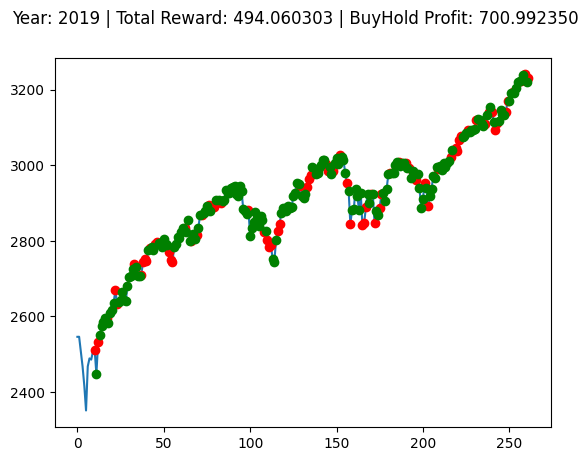

Buy And Hold: 476.9485205078122


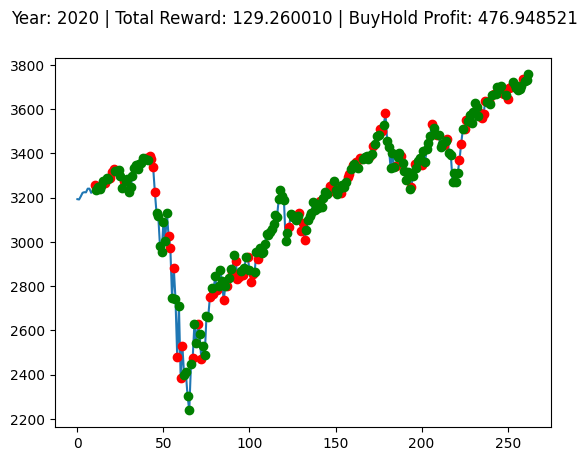

Buy And Hold: 1036.3717211914068


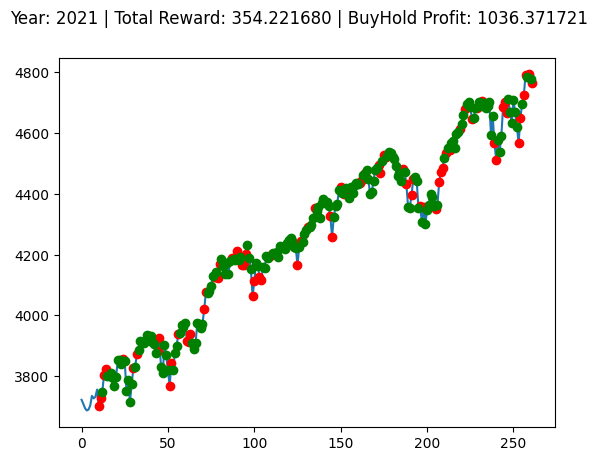

Buy And Hold: -971.472258300781


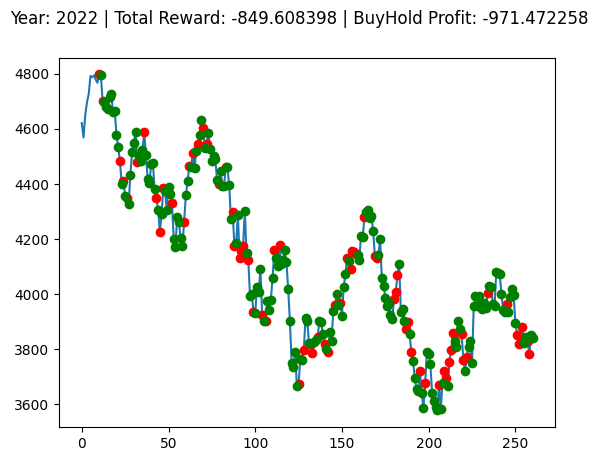

Buy And Hold: 917.112584228516


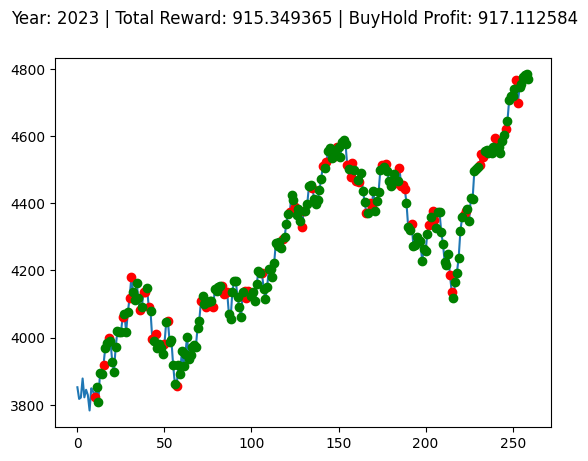

 75%|███████▌  | 75/100 [28:31<09:40, 23.23s/it]

Buy And Hold: -200.5494116210939


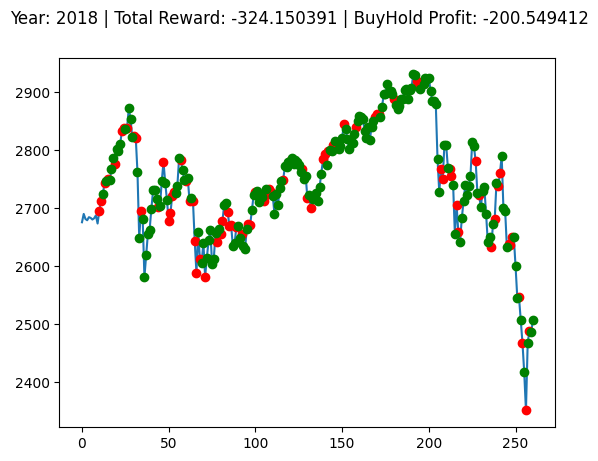

Buy And Hold: 700.9923498535159


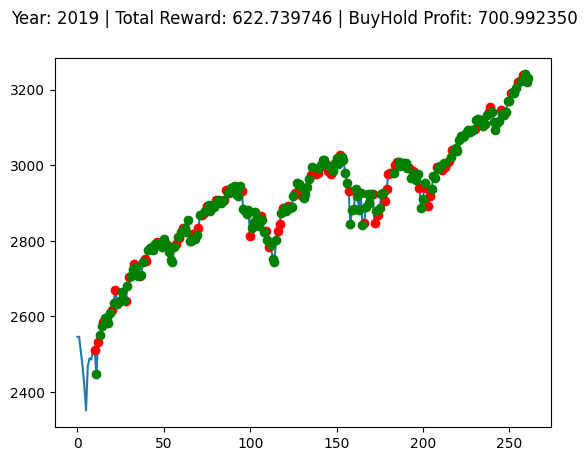

Buy And Hold: 476.9485205078122


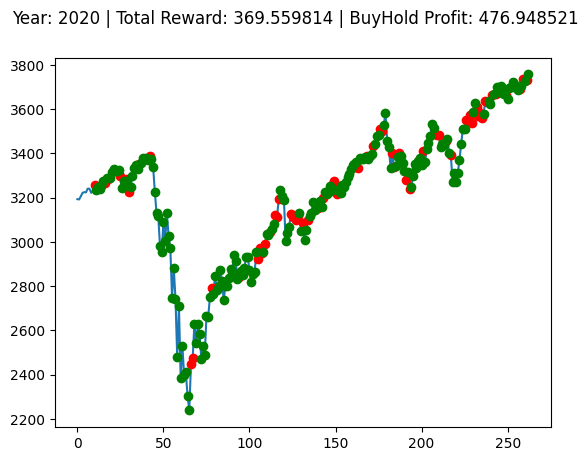

Buy And Hold: 1036.3717211914068


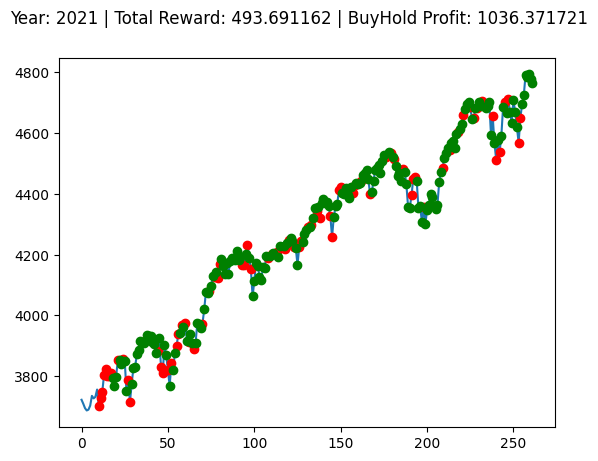

Buy And Hold: -971.472258300781


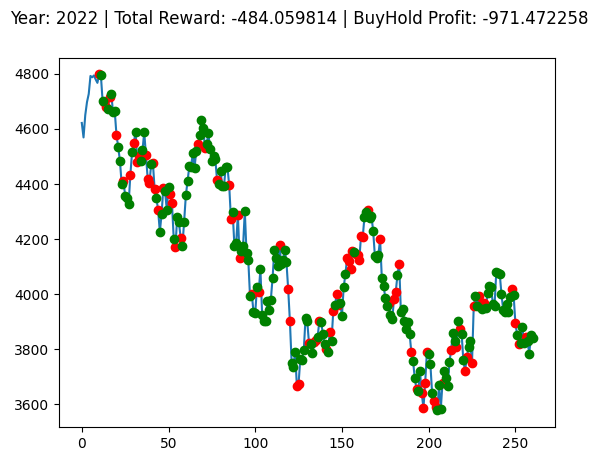

Buy And Hold: 917.112584228516


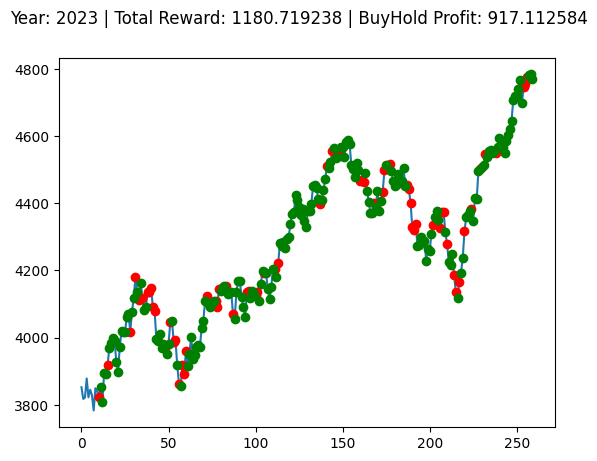

 76%|███████▌  | 76/100 [28:55<09:24, 23.51s/it]

Buy And Hold: -200.5494116210939


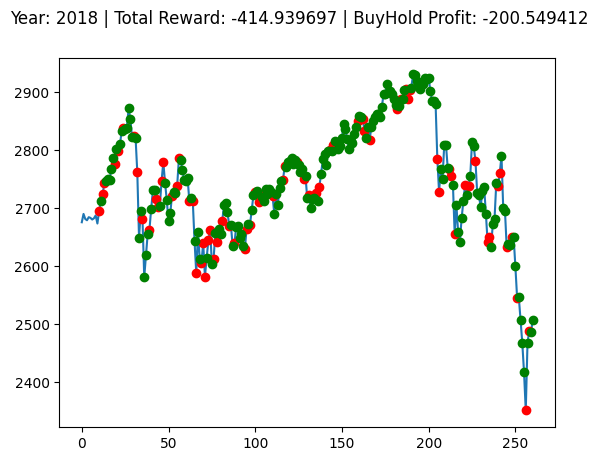

Buy And Hold: 700.9923498535159


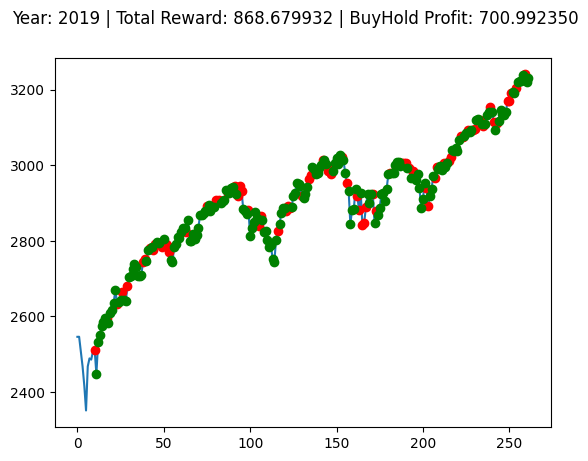

Buy And Hold: 476.9485205078122


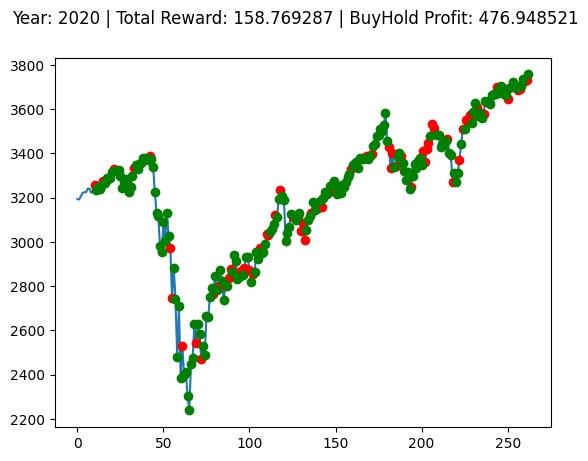

Buy And Hold: 1036.3717211914068


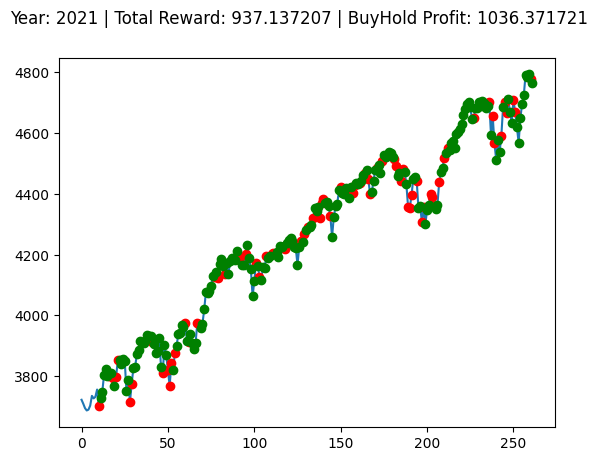

Buy And Hold: -971.472258300781


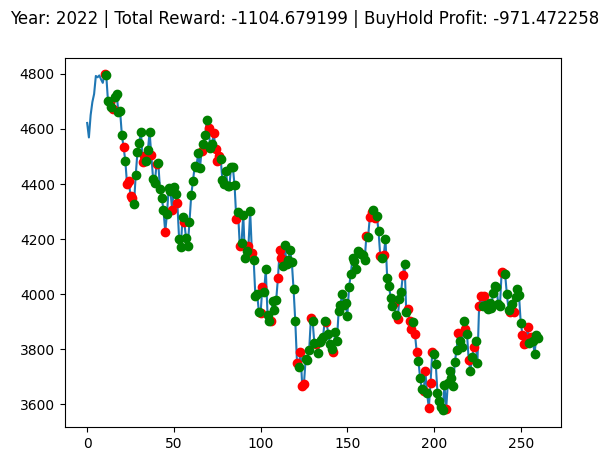

Buy And Hold: 917.112584228516


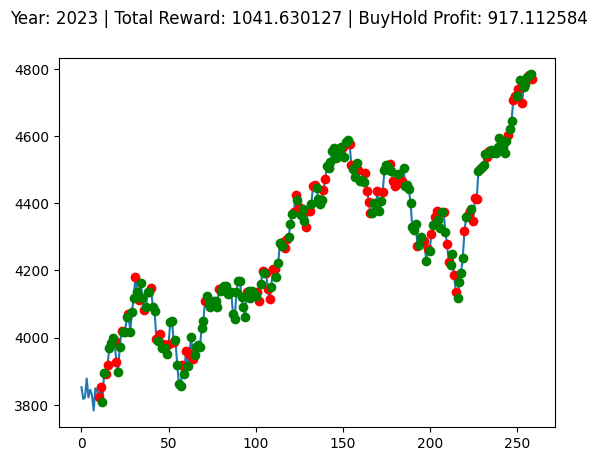

 77%|███████▋  | 77/100 [29:19<09:05, 23.71s/it]

Buy And Hold: -200.5494116210939


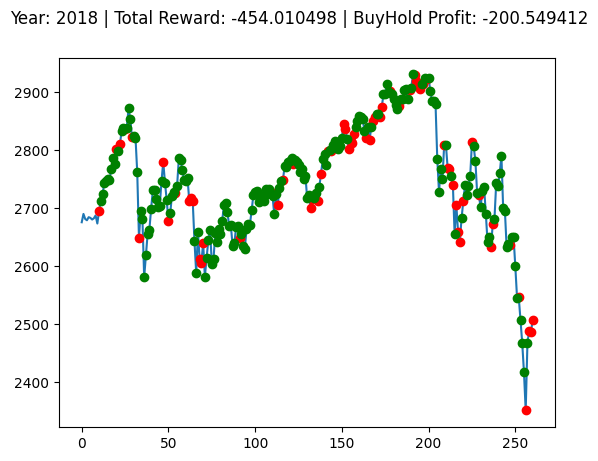

Buy And Hold: 700.9923498535159


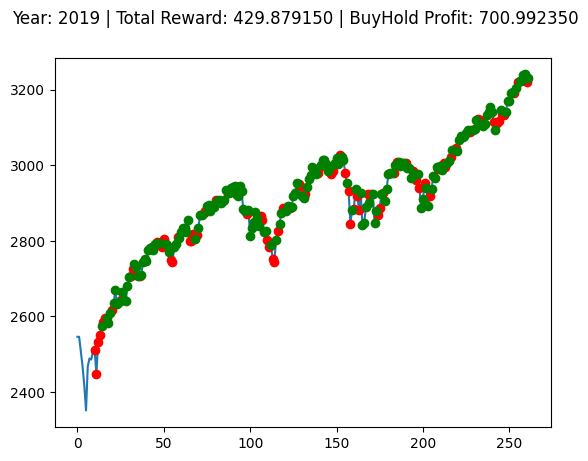

Buy And Hold: 476.9485205078122


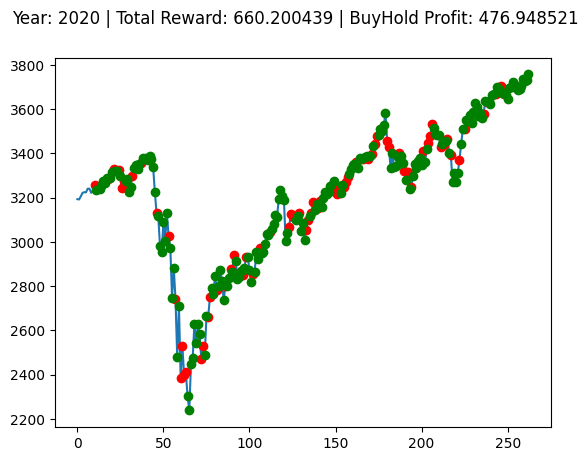

Buy And Hold: 1036.3717211914068


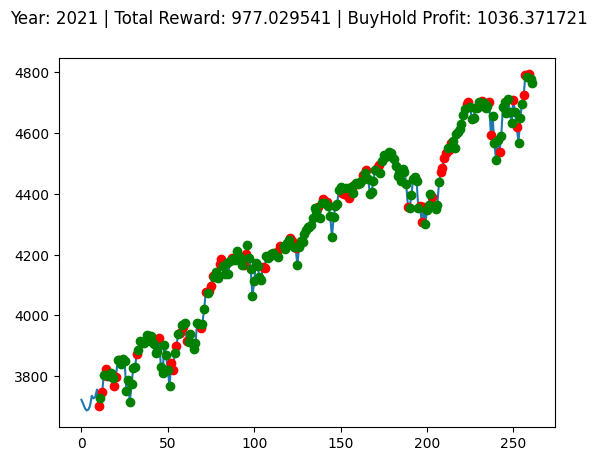

Buy And Hold: -971.472258300781


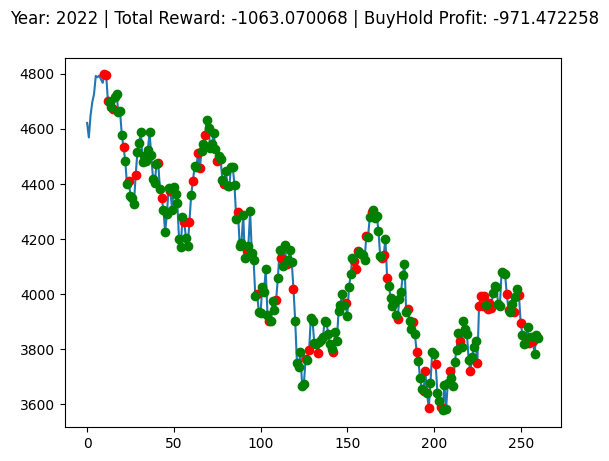

Buy And Hold: 917.112584228516


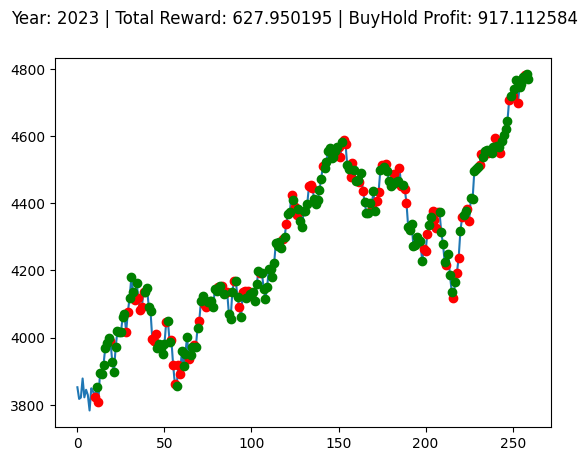

 78%|███████▊  | 78/100 [29:42<08:36, 23.46s/it]

Buy And Hold: -200.5494116210939


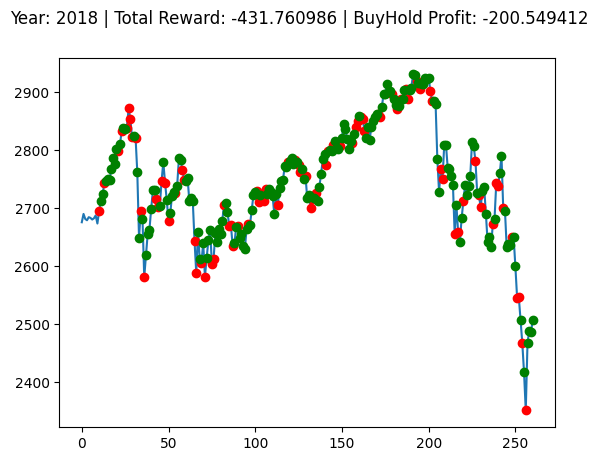

Buy And Hold: 700.9923498535159


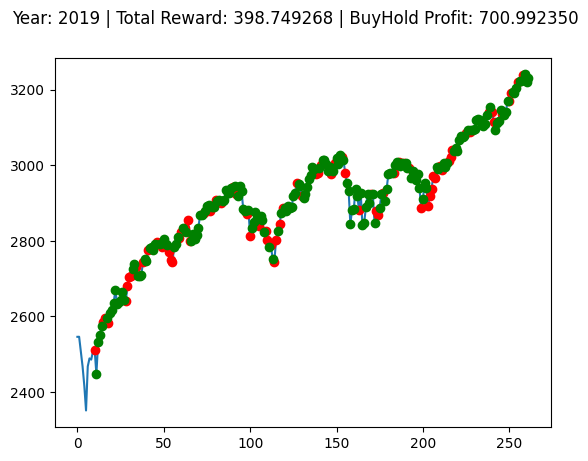

Buy And Hold: 476.9485205078122


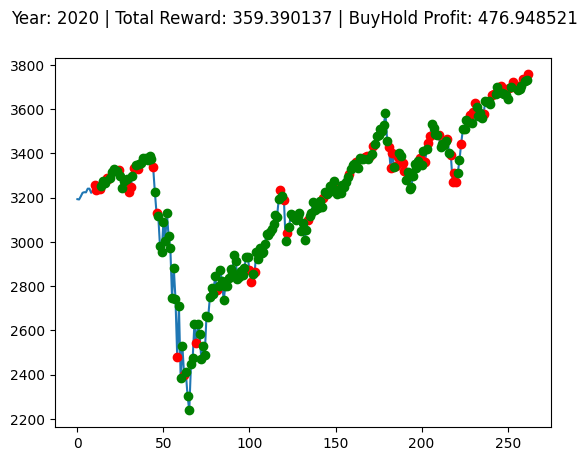

Buy And Hold: 1036.3717211914068


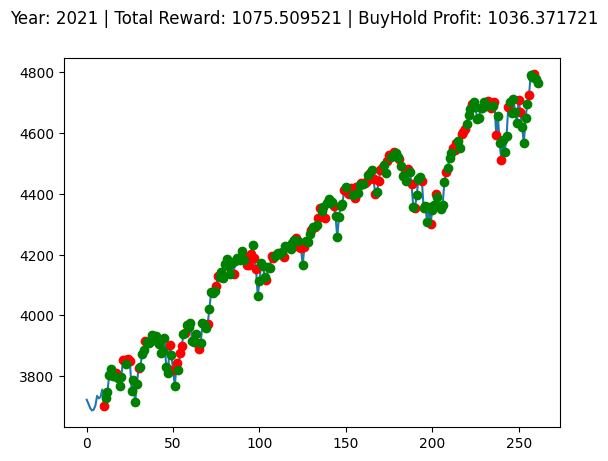

Buy And Hold: -971.472258300781


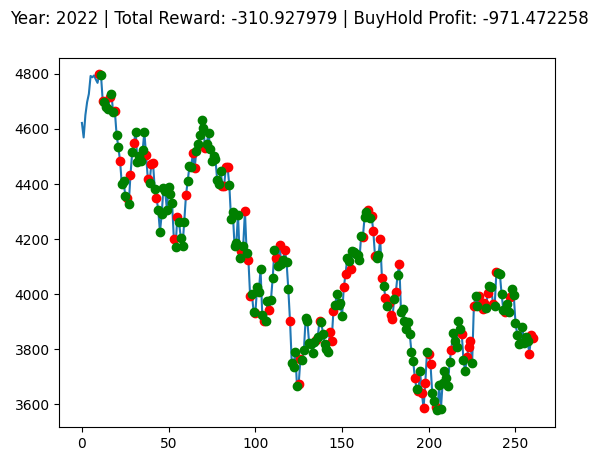

Buy And Hold: 917.112584228516


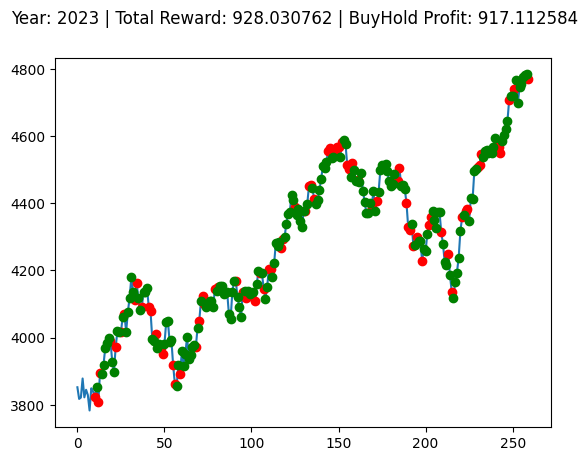

 79%|███████▉  | 79/100 [30:05<08:08, 23.25s/it]

Buy And Hold: -200.5494116210939


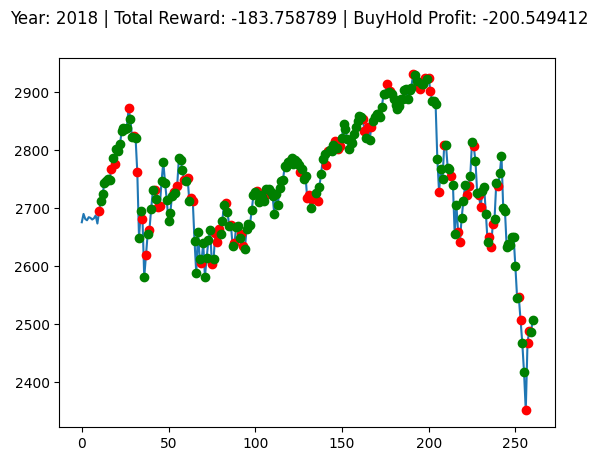

Buy And Hold: 700.9923498535159


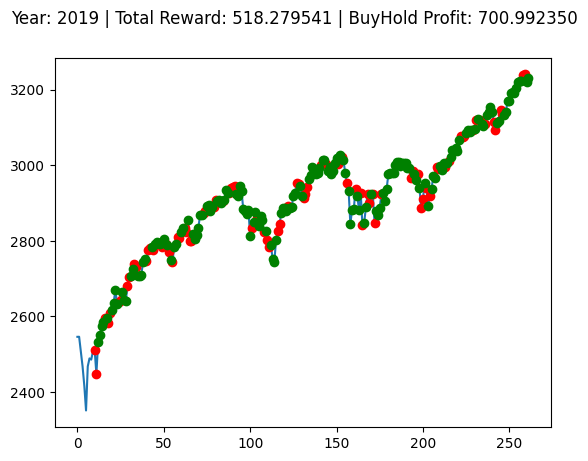

Buy And Hold: 476.9485205078122


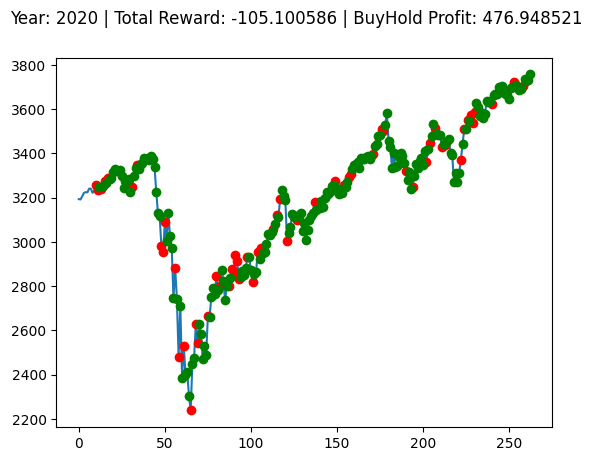

Buy And Hold: 1036.3717211914068


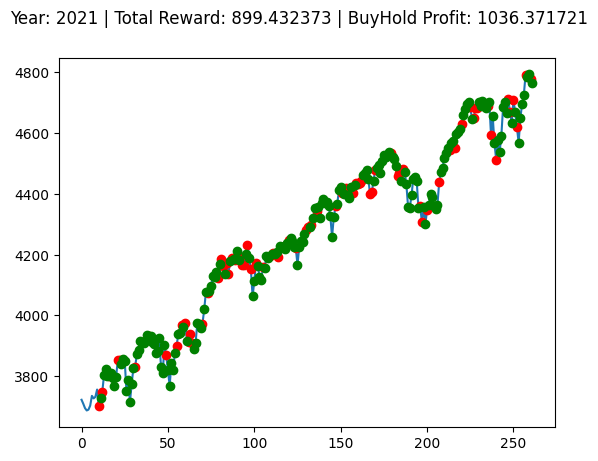

Buy And Hold: -971.472258300781


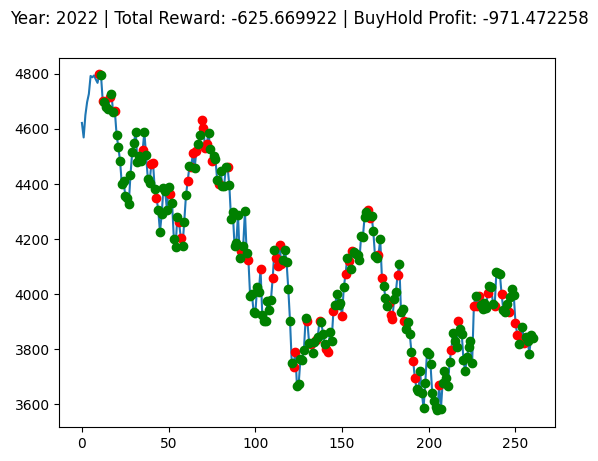

Buy And Hold: 917.112584228516


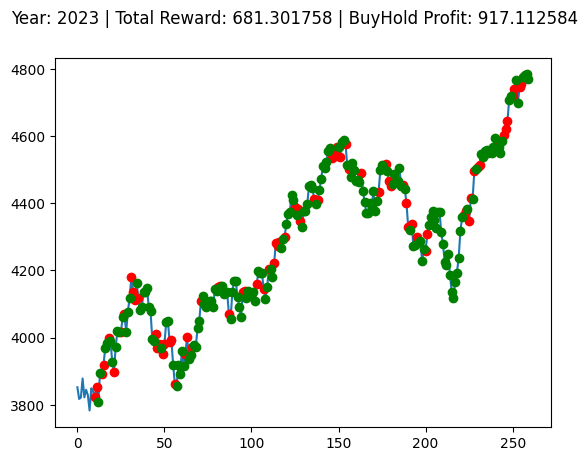

 80%|████████  | 80/100 [30:29<07:47, 23.38s/it]

Buy And Hold: -200.5494116210939


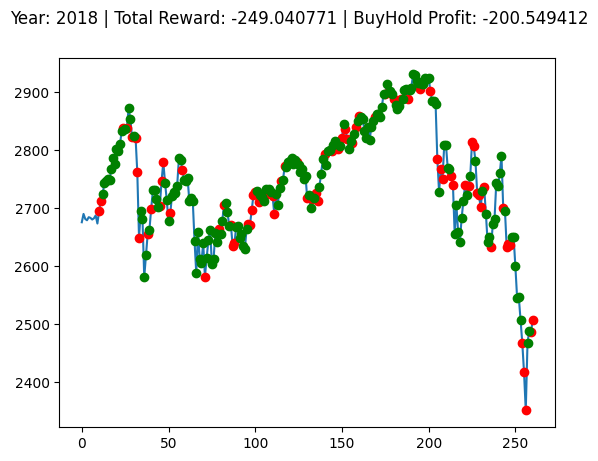

Buy And Hold: 700.9923498535159


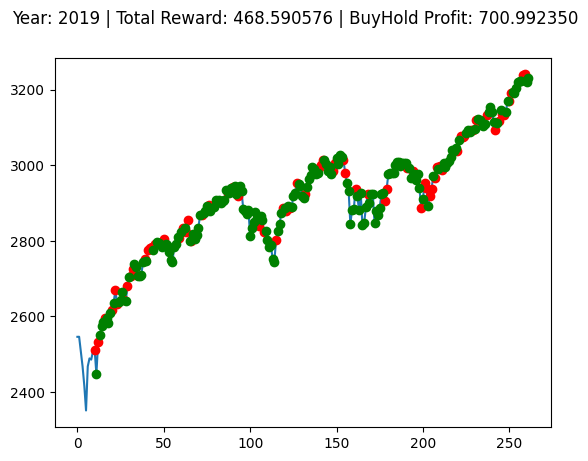

Buy And Hold: 476.9485205078122


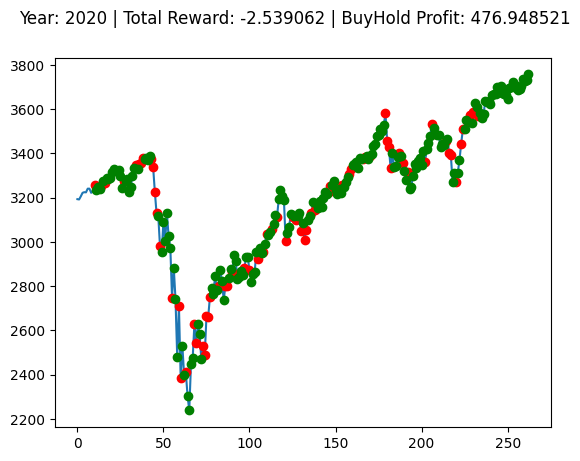

Buy And Hold: 1036.3717211914068


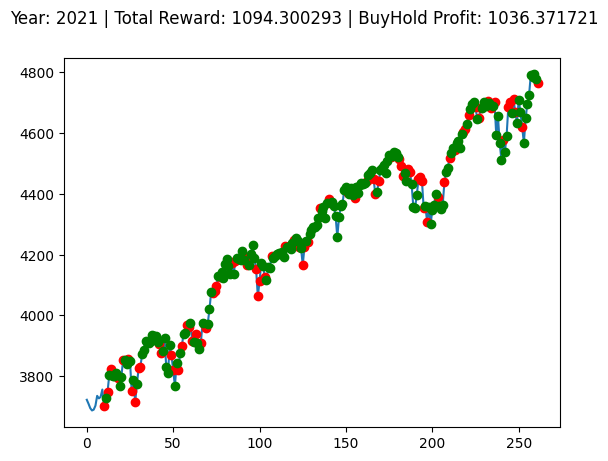

Buy And Hold: -971.472258300781


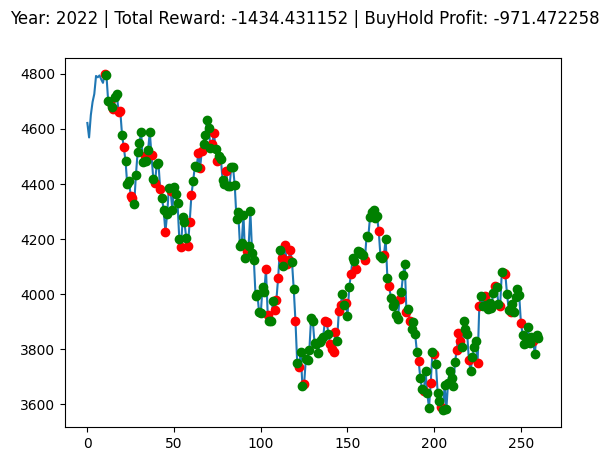

Buy And Hold: 917.112584228516


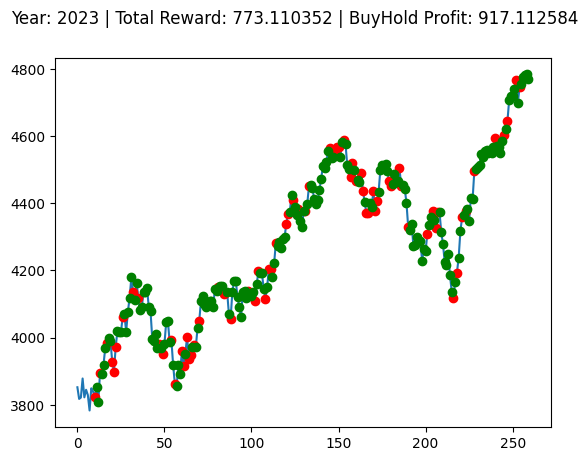

 81%|████████  | 81/100 [30:52<07:22, 23.32s/it]

Buy And Hold: -200.5494116210939


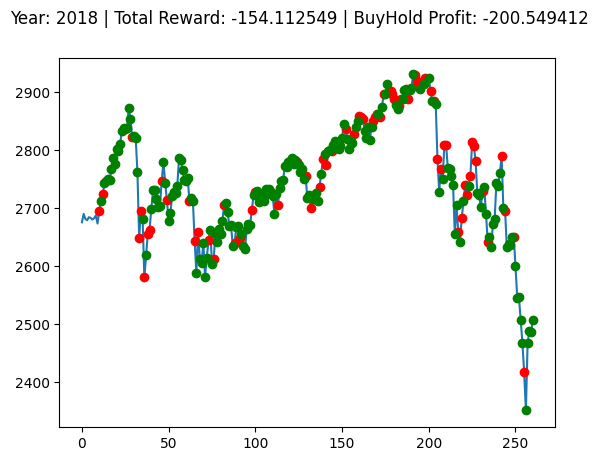

Buy And Hold: 700.9923498535159


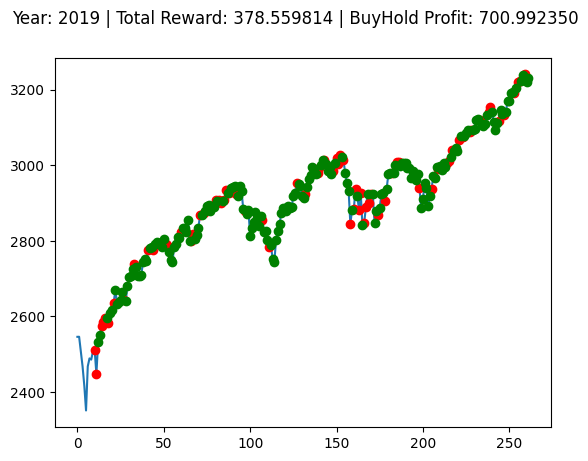

Buy And Hold: 476.9485205078122


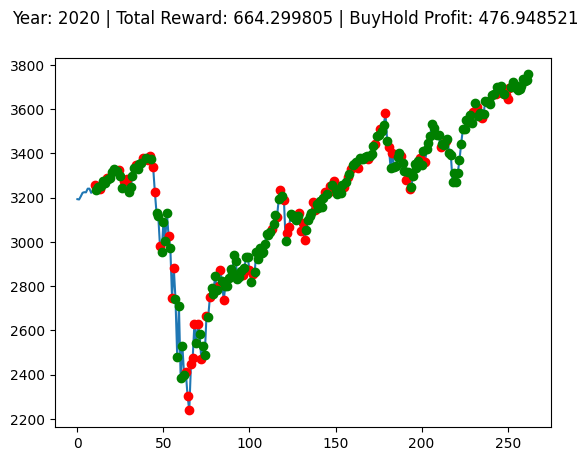

Buy And Hold: 1036.3717211914068


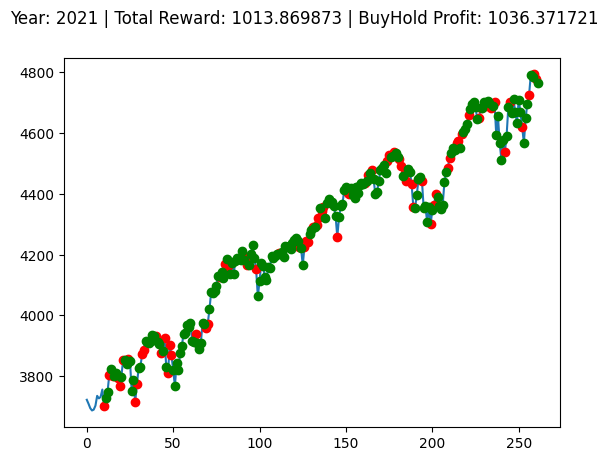

Buy And Hold: -971.472258300781


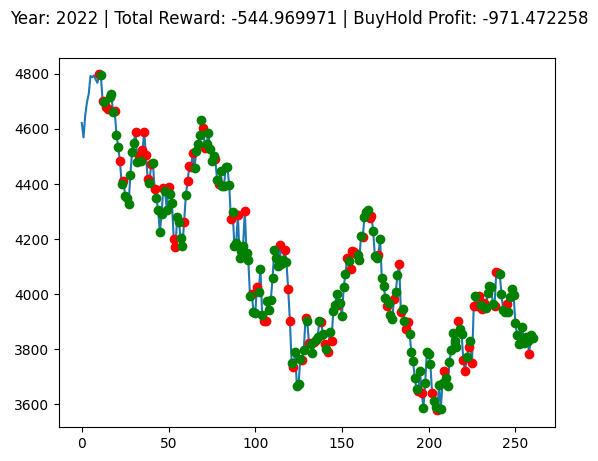

Buy And Hold: 917.112584228516


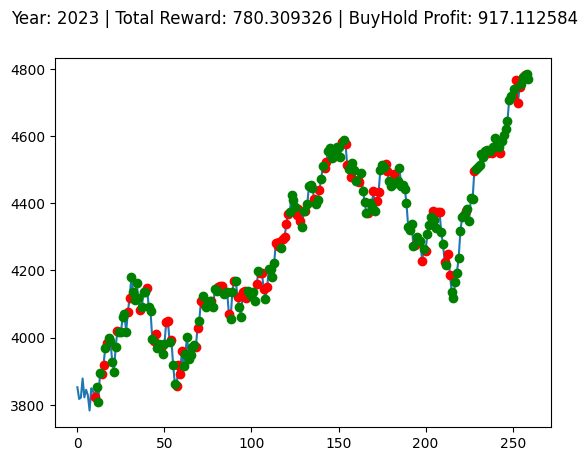

 82%|████████▏ | 82/100 [31:15<06:57, 23.22s/it]

Buy And Hold: -200.5494116210939


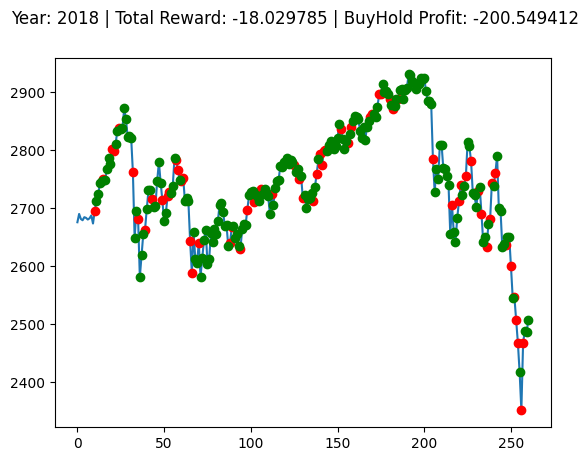

Buy And Hold: 700.9923498535159


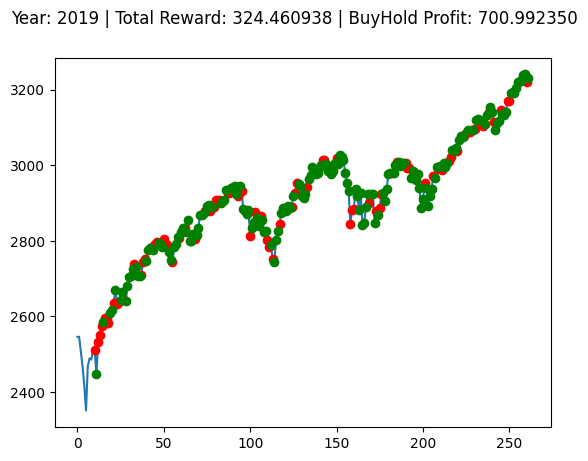

Buy And Hold: 476.9485205078122


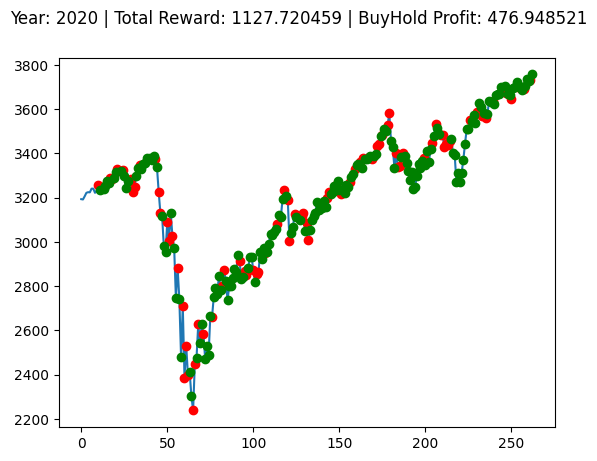

Buy And Hold: 1036.3717211914068


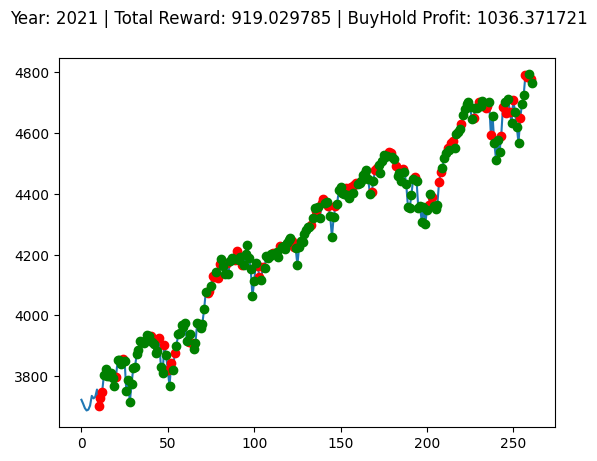

Buy And Hold: -971.472258300781


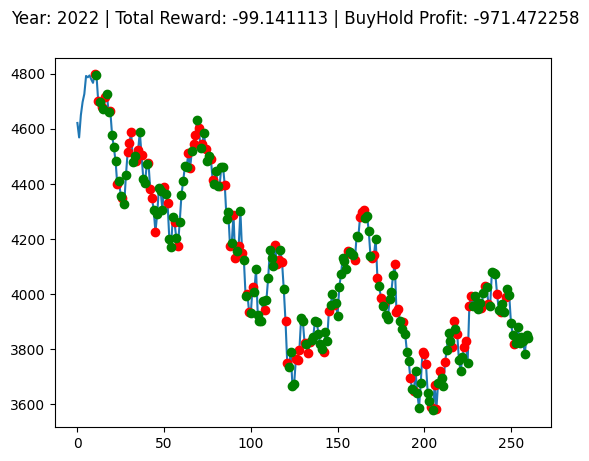

Buy And Hold: 917.112584228516


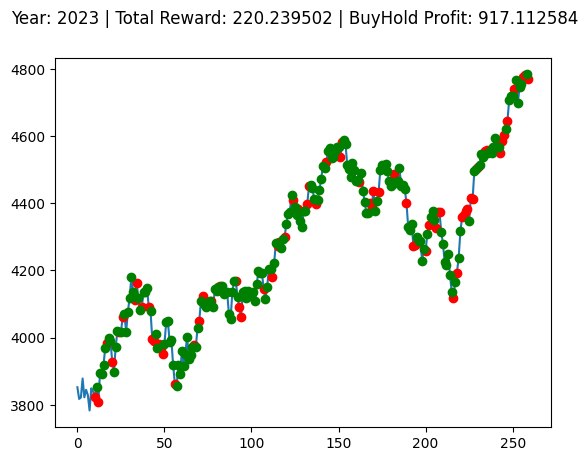

 83%|████████▎ | 83/100 [31:38<06:35, 23.27s/it]

Buy And Hold: -200.5494116210939


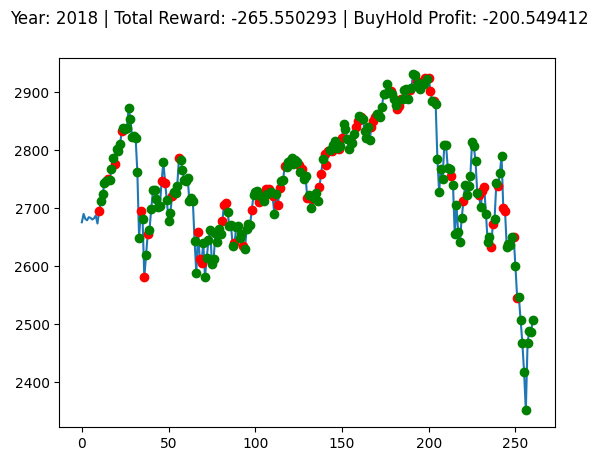

Buy And Hold: 700.9923498535159


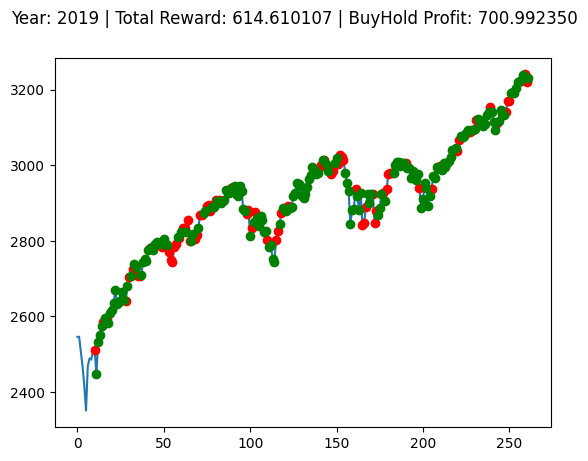

Buy And Hold: 476.9485205078122


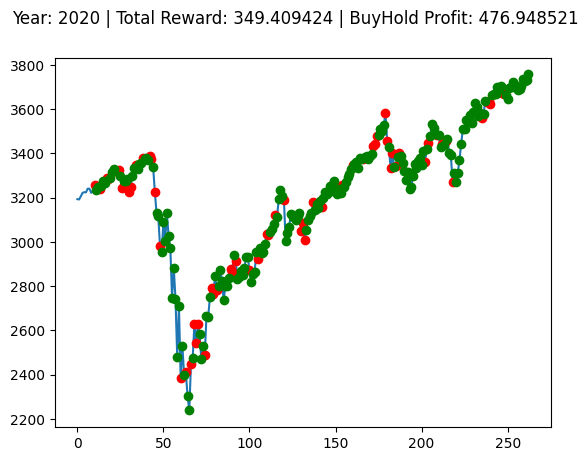

Buy And Hold: 1036.3717211914068


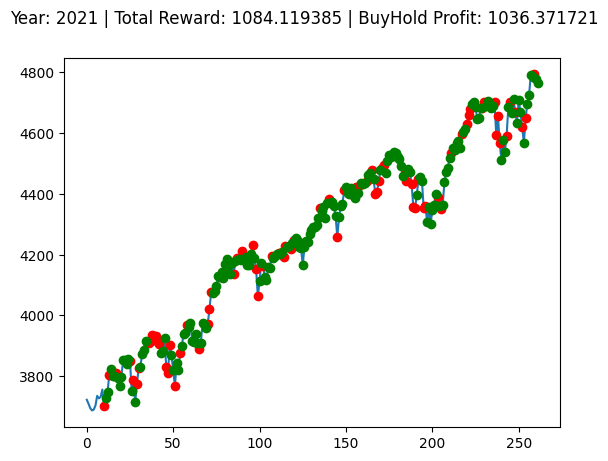

Buy And Hold: -971.472258300781


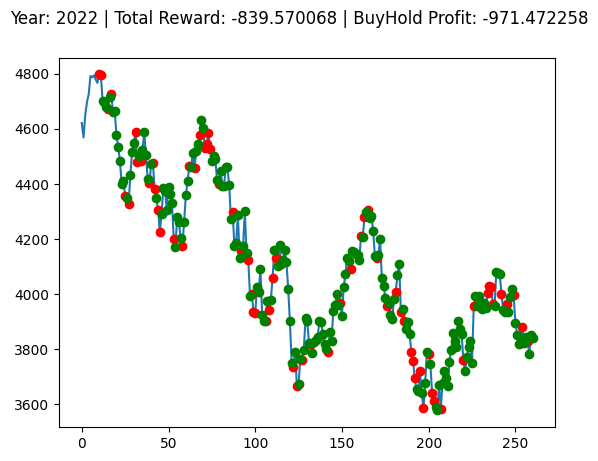

Buy And Hold: 917.112584228516


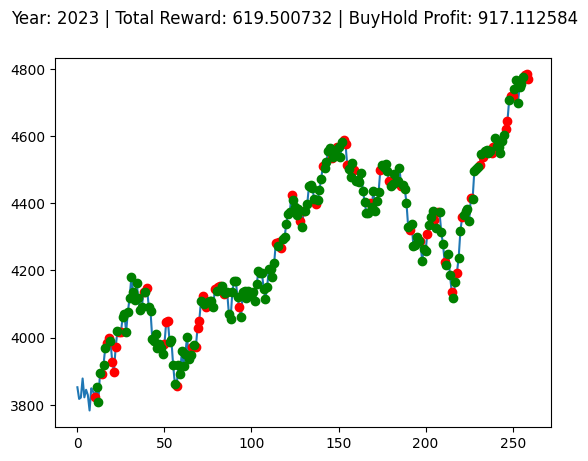

 84%|████████▍ | 84/100 [32:02<06:14, 23.38s/it]

Buy And Hold: -200.5494116210939


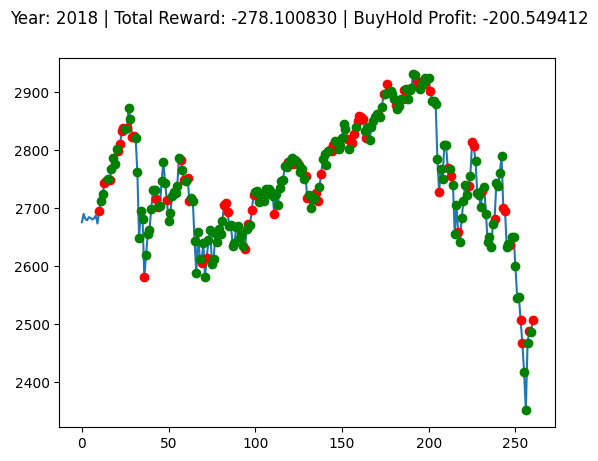

Buy And Hold: 700.9923498535159


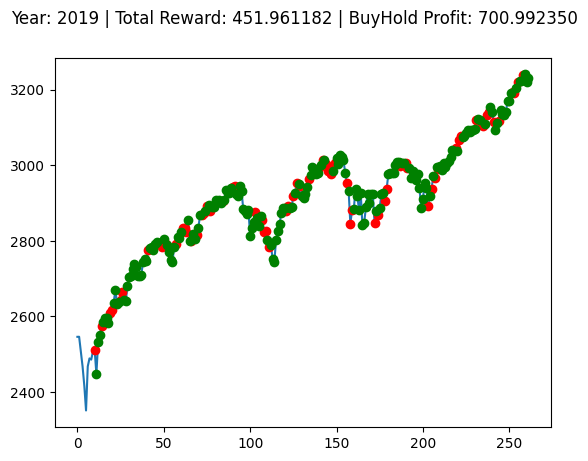

Buy And Hold: 476.9485205078122


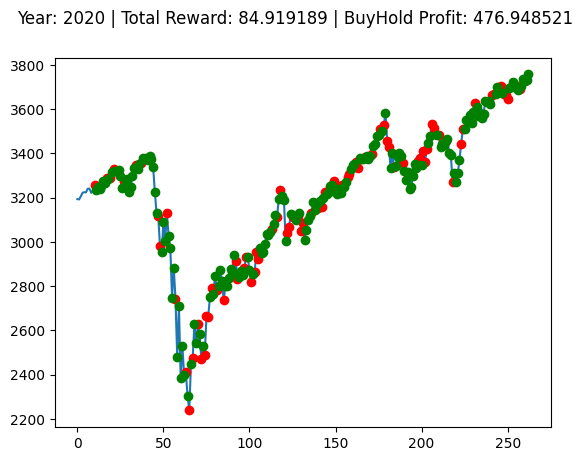

Buy And Hold: 1036.3717211914068


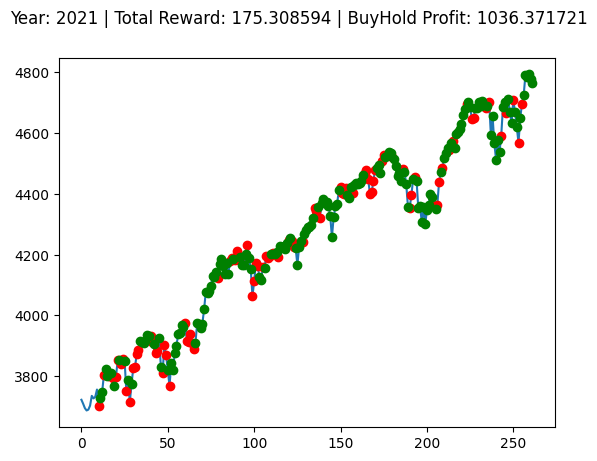

Buy And Hold: -971.472258300781


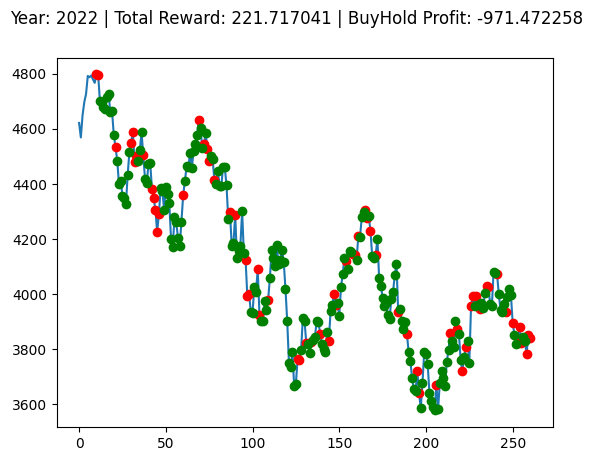

Buy And Hold: 917.112584228516


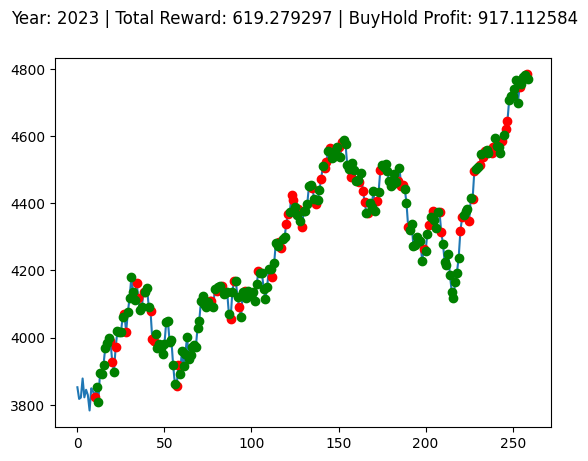

 85%|████████▌ | 85/100 [32:25<05:51, 23.43s/it]

Buy And Hold: -200.5494116210939


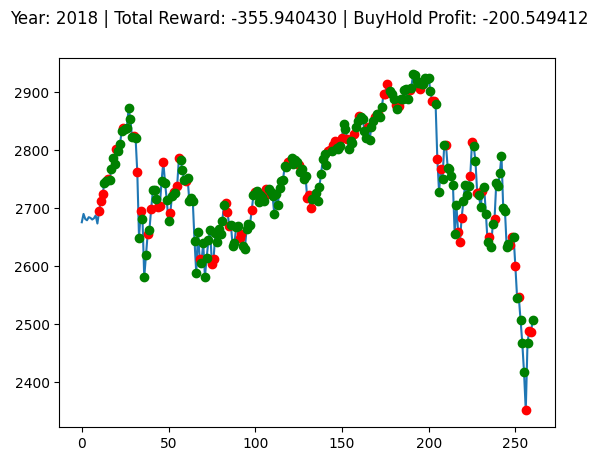

Buy And Hold: 700.9923498535159


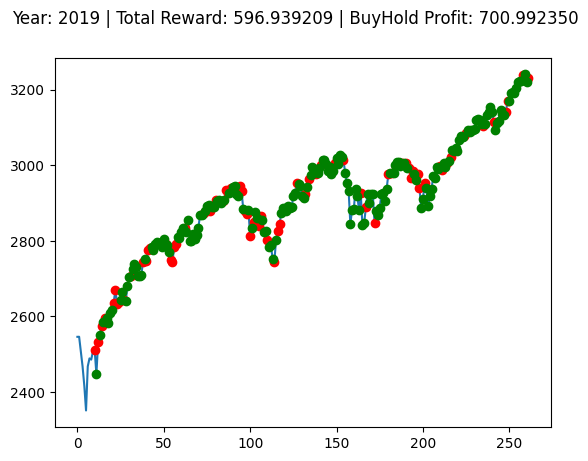

Buy And Hold: 476.9485205078122


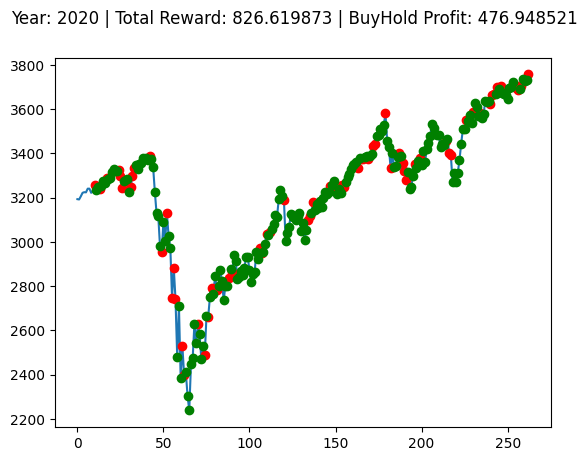

Buy And Hold: 1036.3717211914068


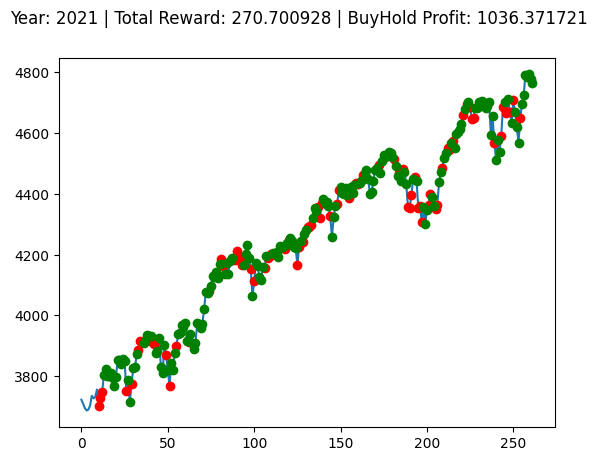

Buy And Hold: -971.472258300781


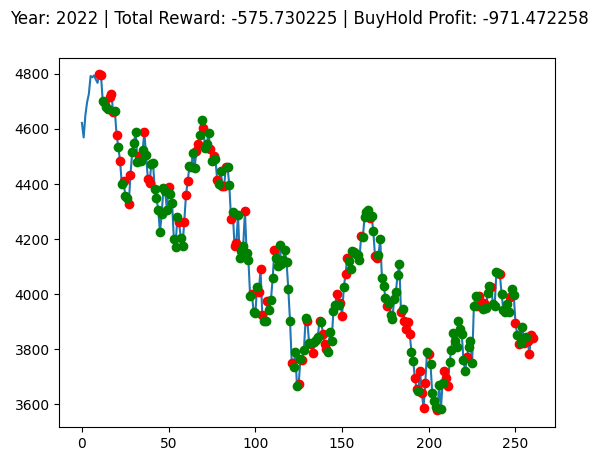

Buy And Hold: 917.112584228516


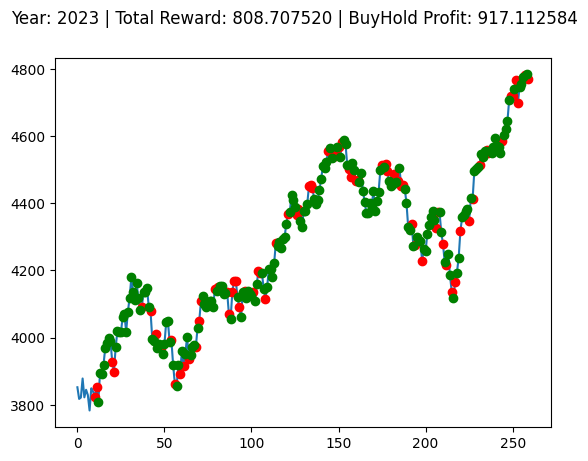

 86%|████████▌ | 86/100 [32:48<05:26, 23.29s/it]

Buy And Hold: -200.5494116210939


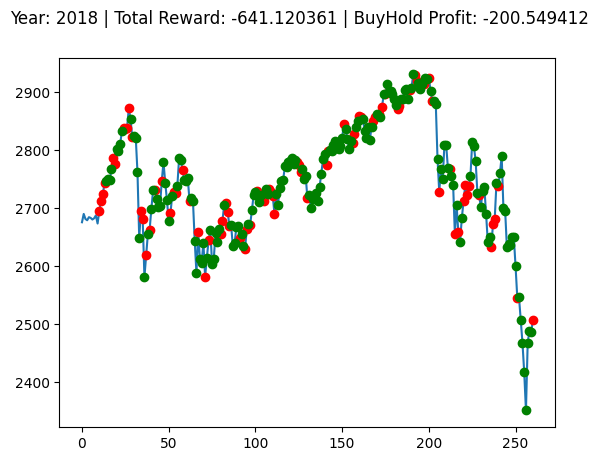

Buy And Hold: 700.9923498535159


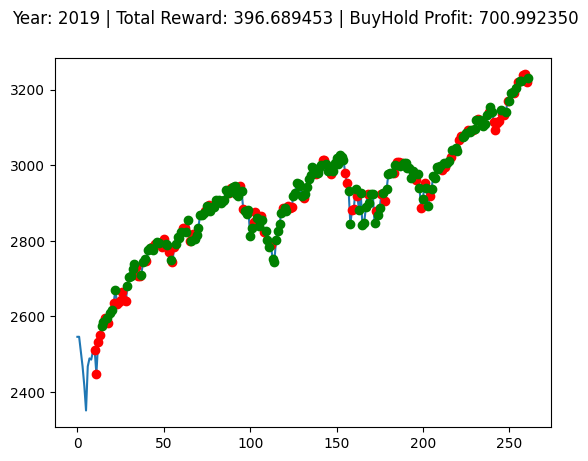

Buy And Hold: 476.9485205078122


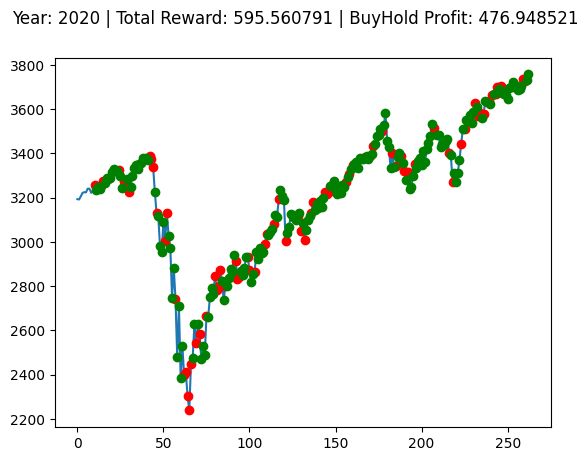

Buy And Hold: 1036.3717211914068


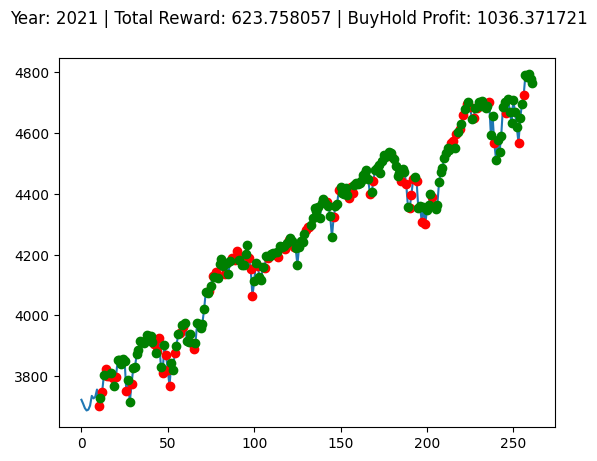

Buy And Hold: -971.472258300781


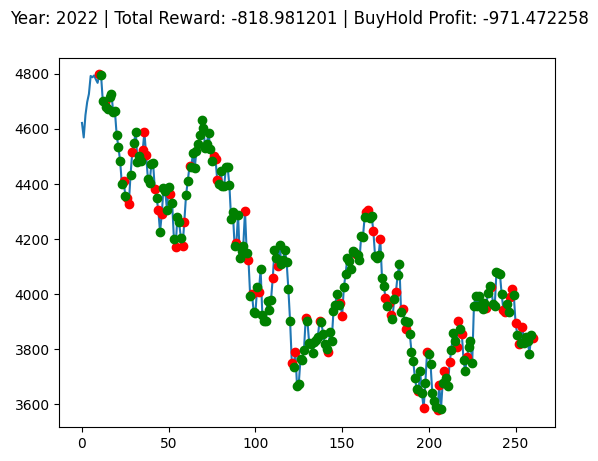

Buy And Hold: 917.112584228516


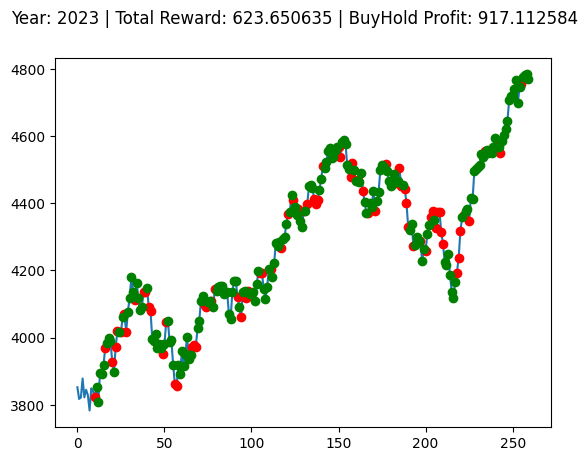

 87%|████████▋ | 87/100 [33:12<05:03, 23.36s/it]

Buy And Hold: -200.5494116210939


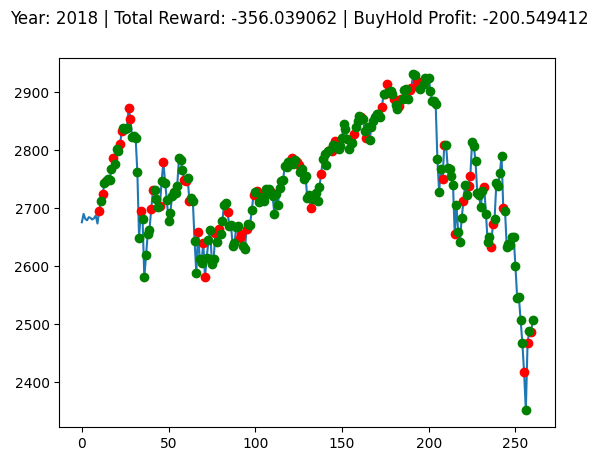

Buy And Hold: 700.9923498535159


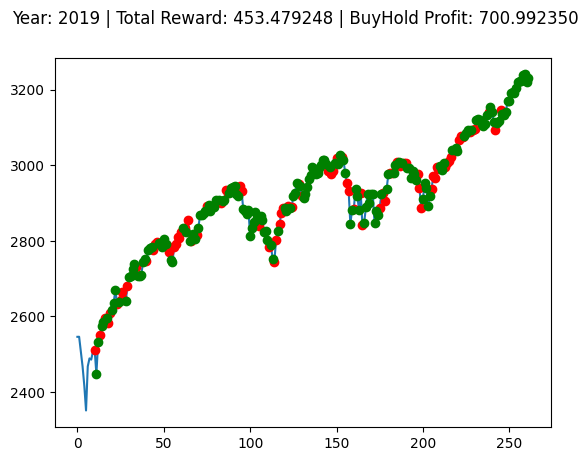

Buy And Hold: 476.9485205078122


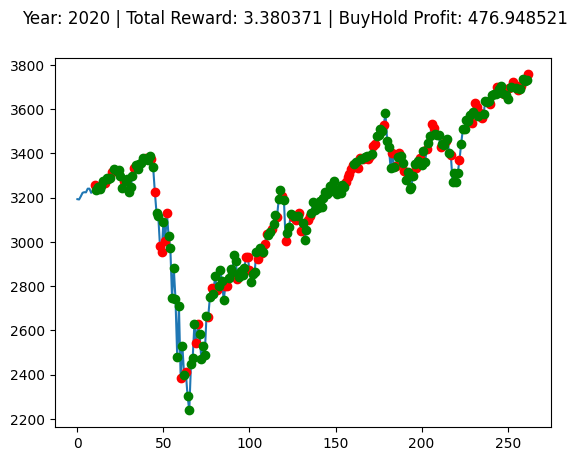

Buy And Hold: 1036.3717211914068


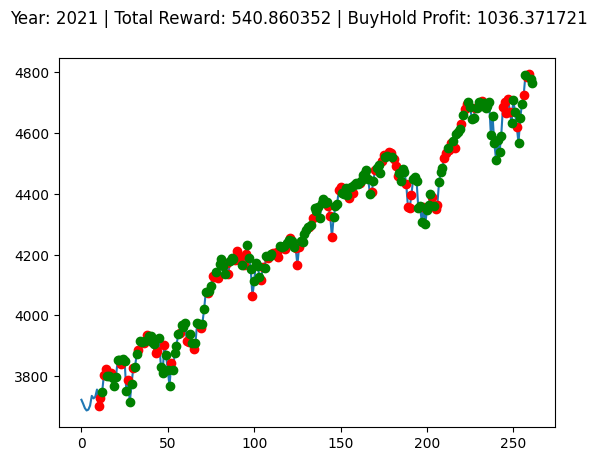

Buy And Hold: -971.472258300781


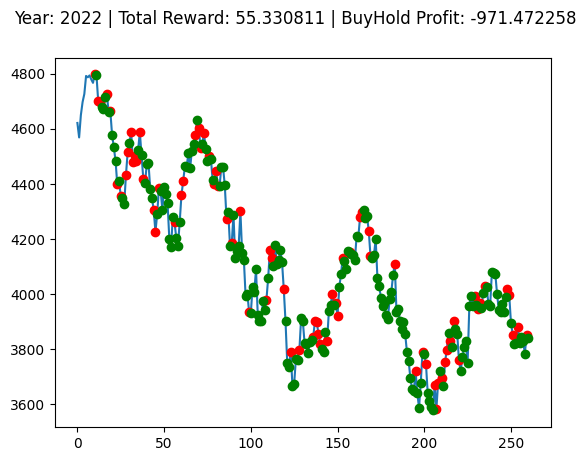

Buy And Hold: 917.112584228516


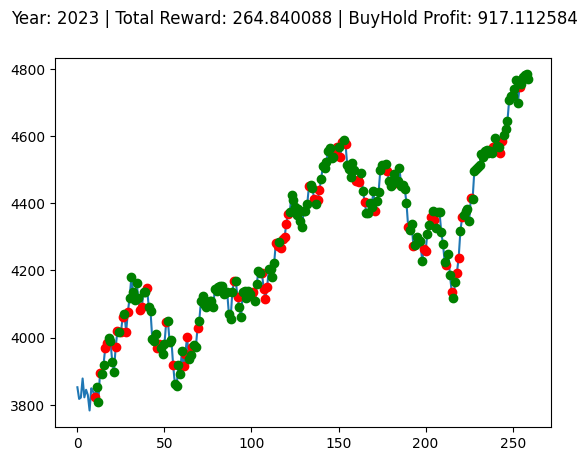

 88%|████████▊ | 88/100 [33:36<04:41, 23.44s/it]

Buy And Hold: -200.5494116210939


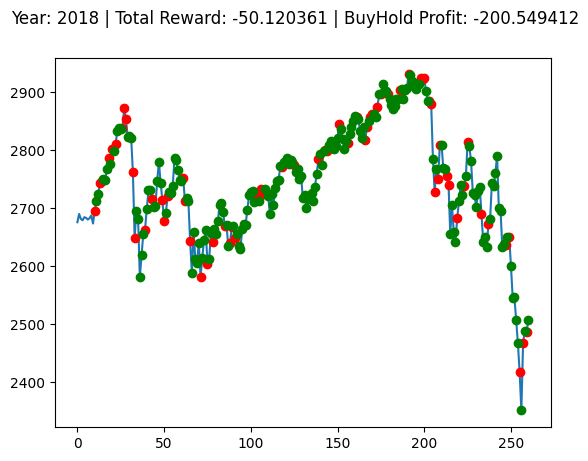

Buy And Hold: 700.9923498535159


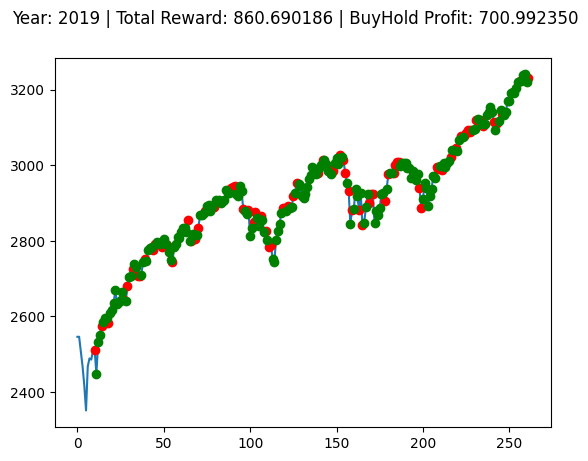

Buy And Hold: 476.9485205078122


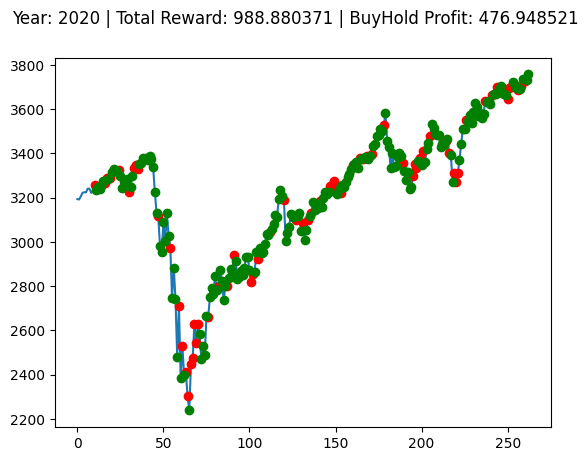

Buy And Hold: 1036.3717211914068


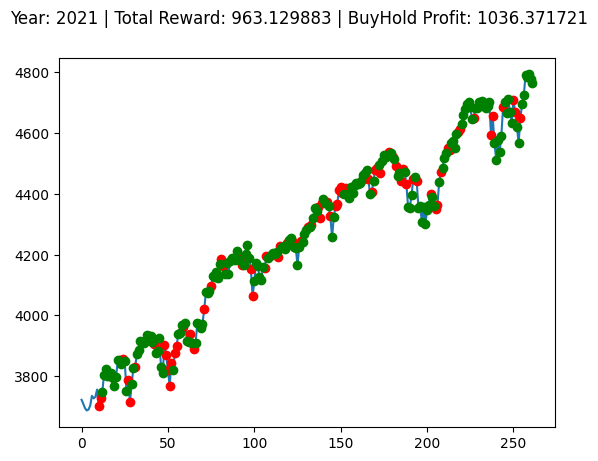

Buy And Hold: -971.472258300781


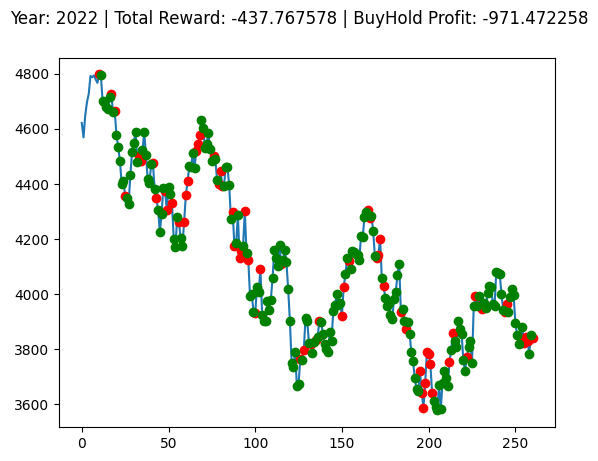

Buy And Hold: 917.112584228516


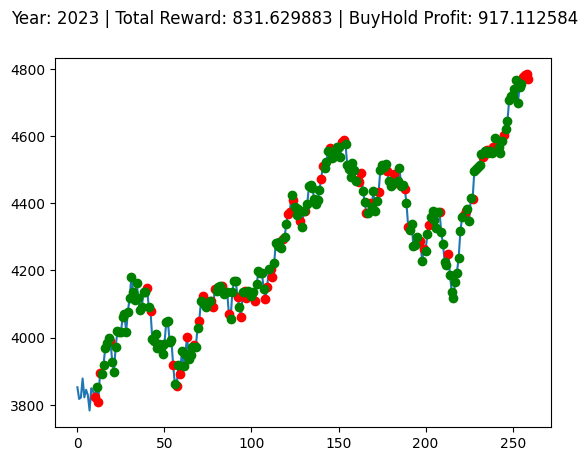

 89%|████████▉ | 89/100 [33:59<04:16, 23.36s/it]

Buy And Hold: -200.5494116210939


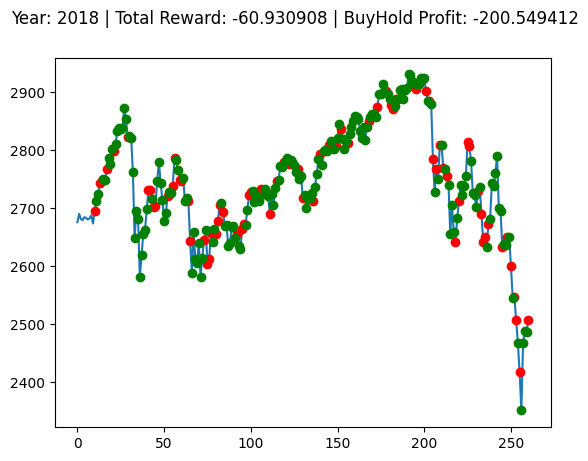

Buy And Hold: 700.9923498535159


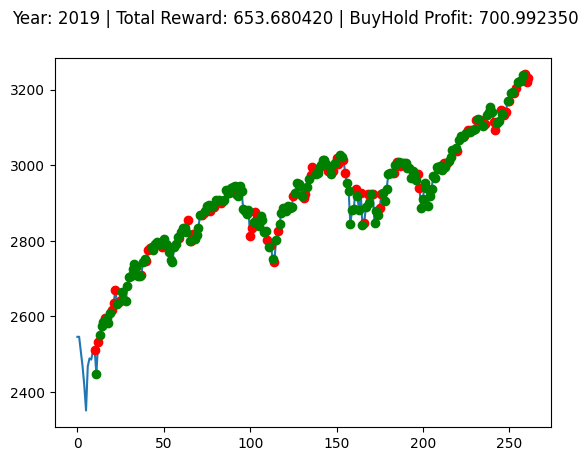

Buy And Hold: 476.9485205078122


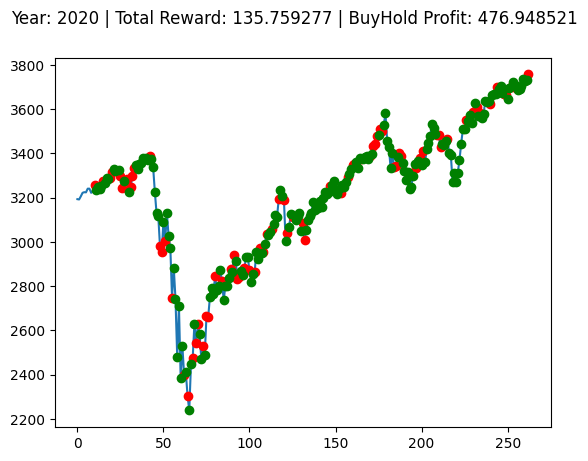

Buy And Hold: 1036.3717211914068


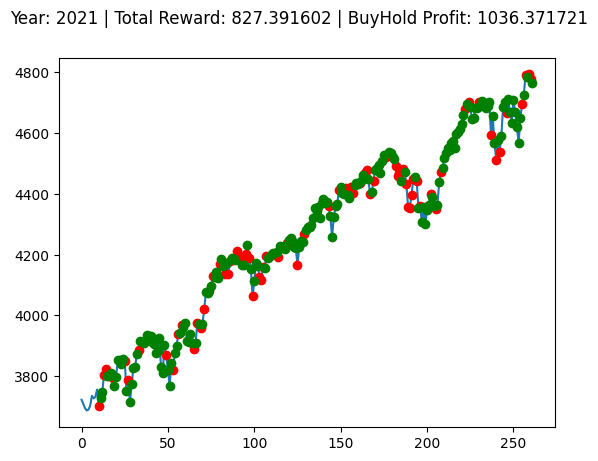

Buy And Hold: -971.472258300781


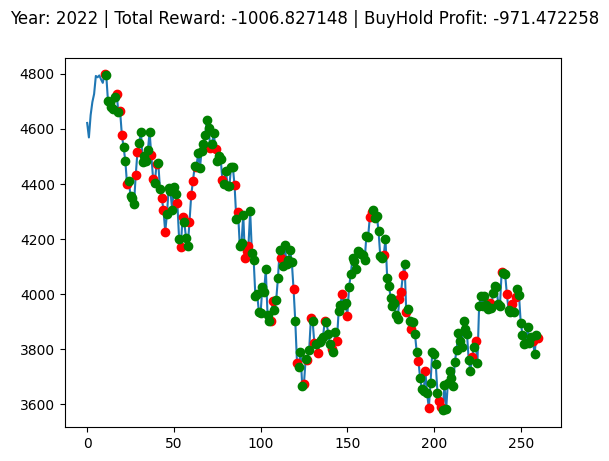

Buy And Hold: 917.112584228516


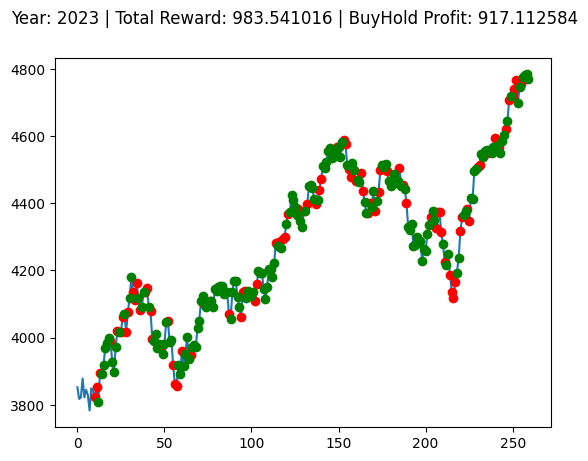

 90%|█████████ | 90/100 [34:21<03:51, 23.18s/it]

Buy And Hold: -200.5494116210939


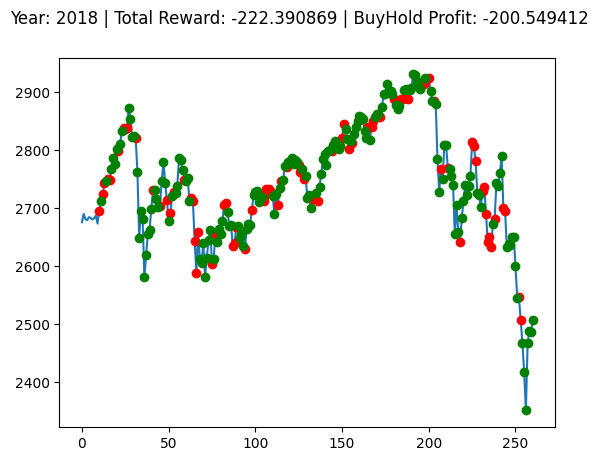

Buy And Hold: 700.9923498535159


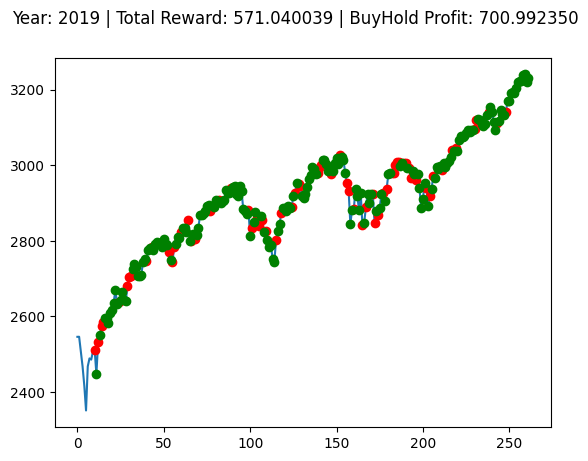

Buy And Hold: 476.9485205078122


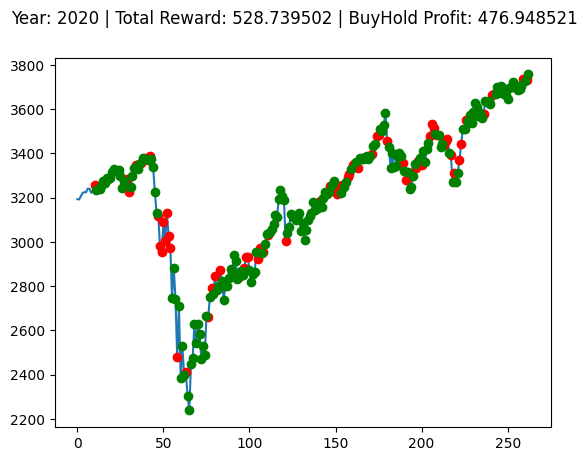

Buy And Hold: 1036.3717211914068


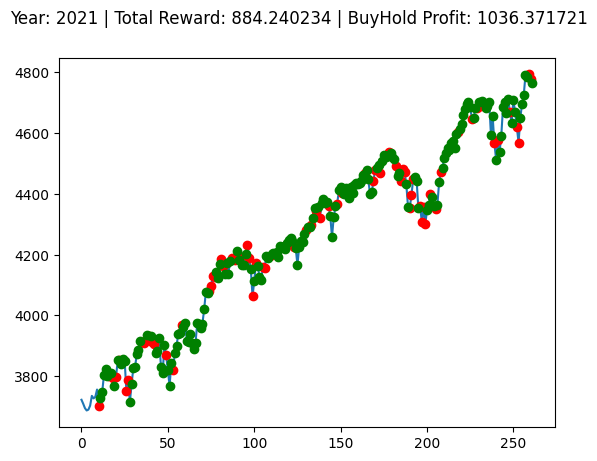

Buy And Hold: -971.472258300781


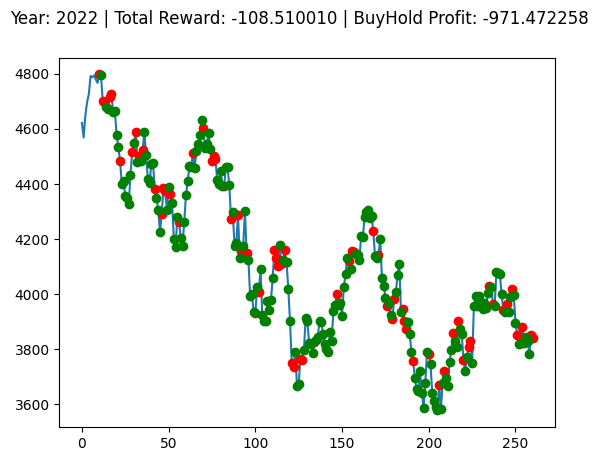

Buy And Hold: 917.112584228516


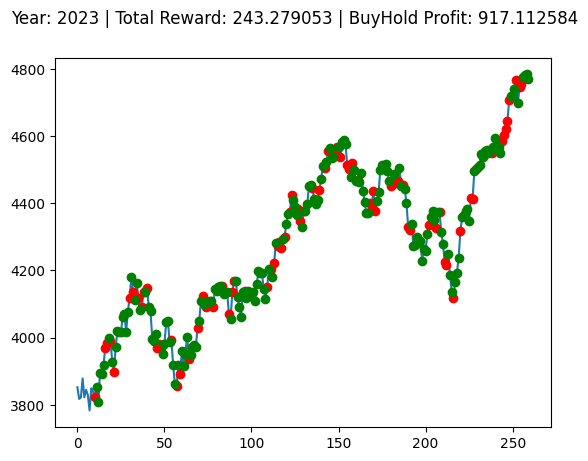

 91%|█████████ | 91/100 [34:45<03:29, 23.32s/it]

Buy And Hold: -200.5494116210939


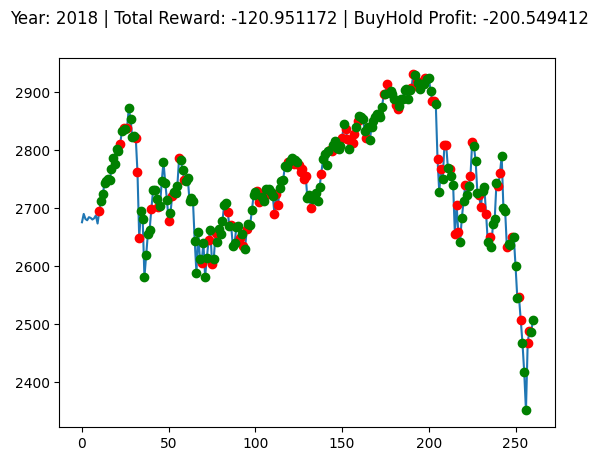

Buy And Hold: 700.9923498535159


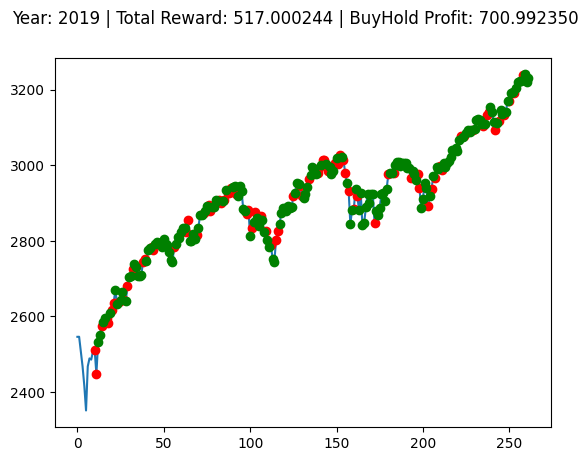

Buy And Hold: 476.9485205078122


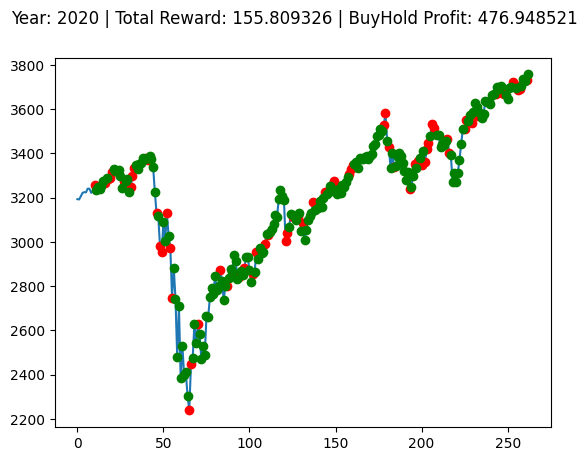

Buy And Hold: 1036.3717211914068


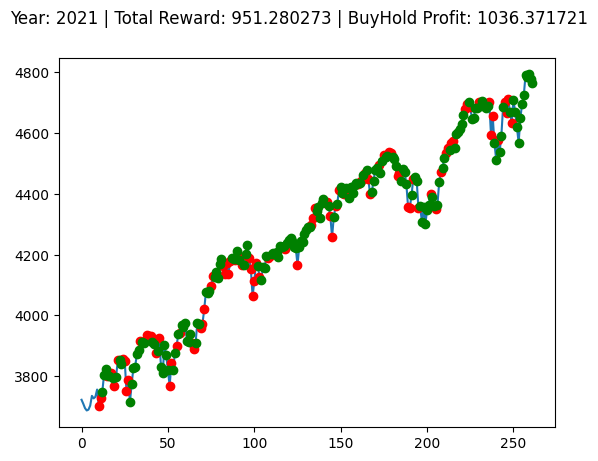

Buy And Hold: -971.472258300781


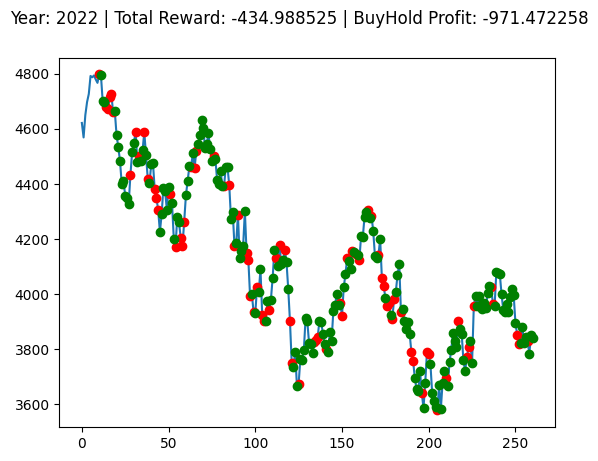

Buy And Hold: 917.112584228516


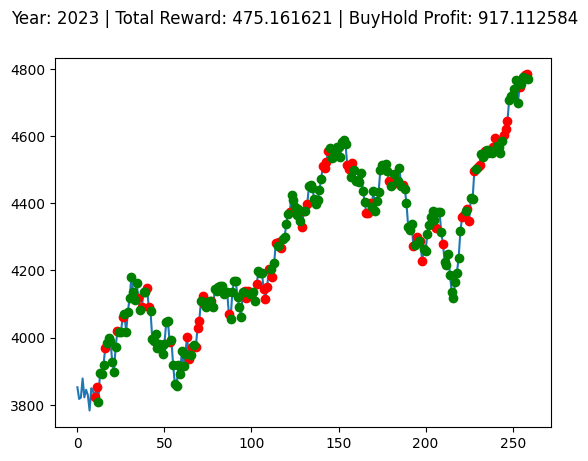

 92%|█████████▏| 92/100 [35:08<03:06, 23.33s/it]

Buy And Hold: -200.5494116210939


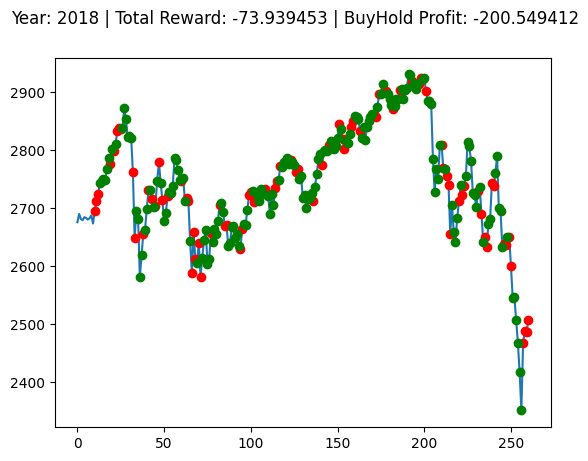

Buy And Hold: 700.9923498535159


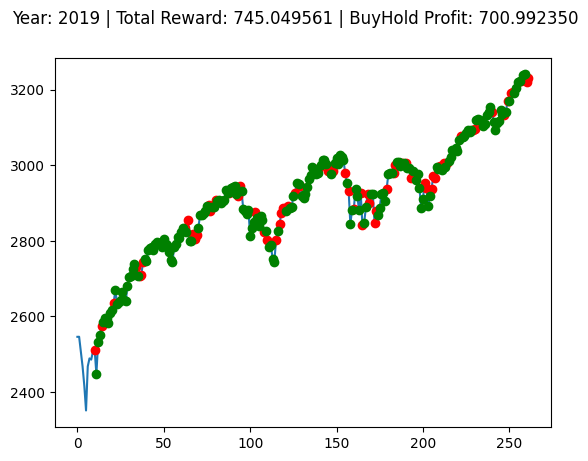

Buy And Hold: 476.9485205078122


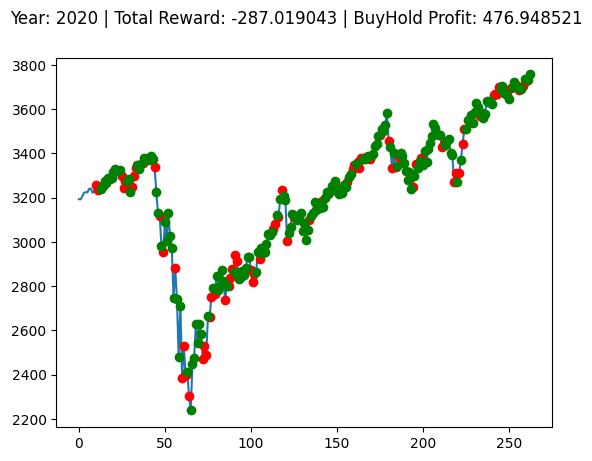

Buy And Hold: 1036.3717211914068


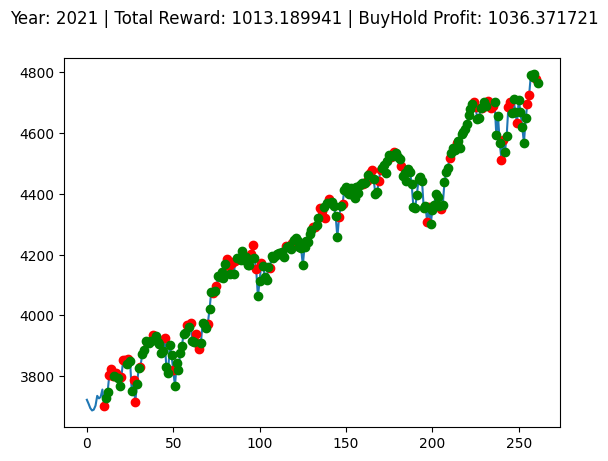

Buy And Hold: -971.472258300781


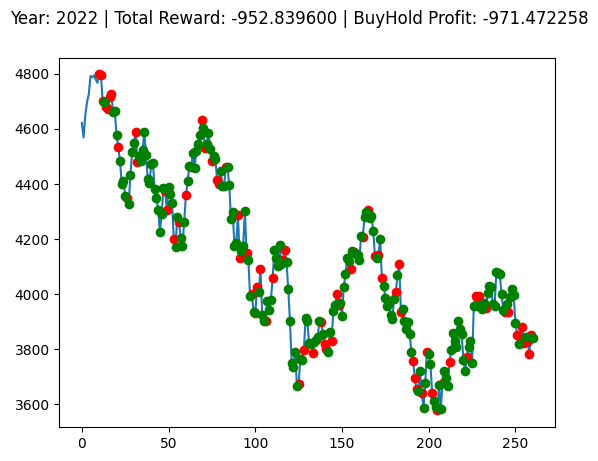

Buy And Hold: 917.112584228516


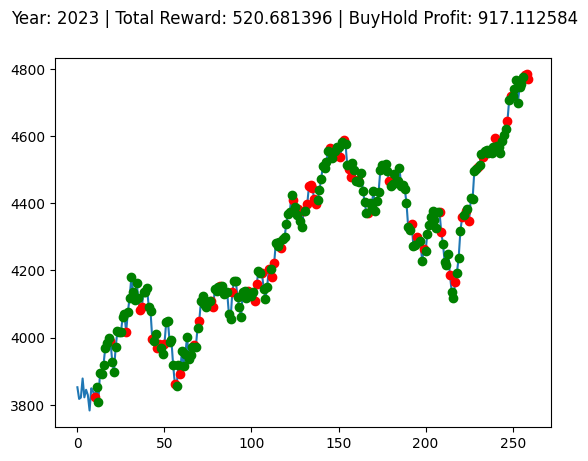

 93%|█████████▎| 93/100 [35:32<02:43, 23.39s/it]

Buy And Hold: -200.5494116210939


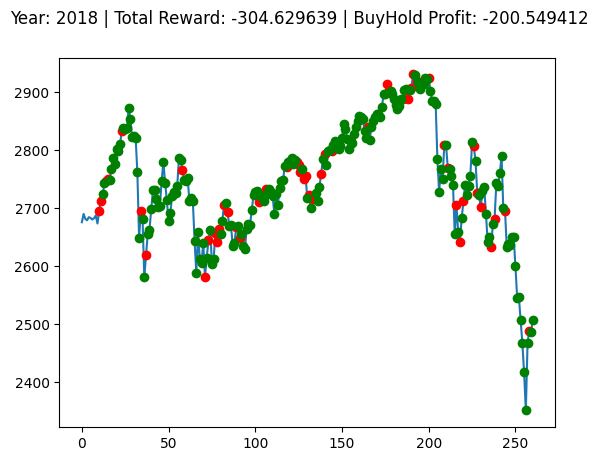

Buy And Hold: 700.9923498535159


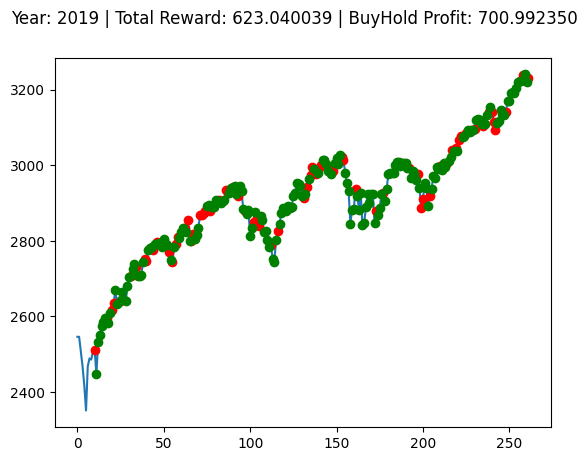

Buy And Hold: 476.9485205078122


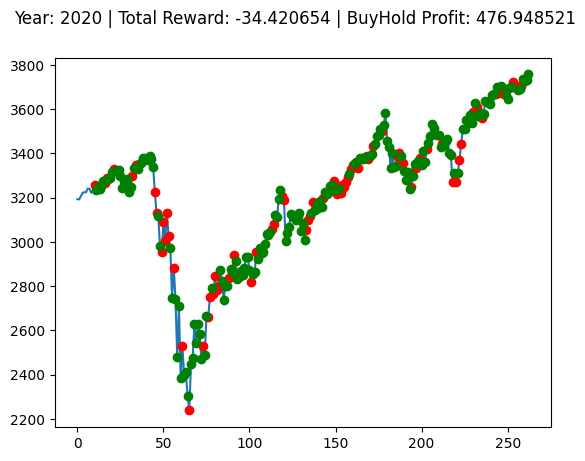

Buy And Hold: 1036.3717211914068


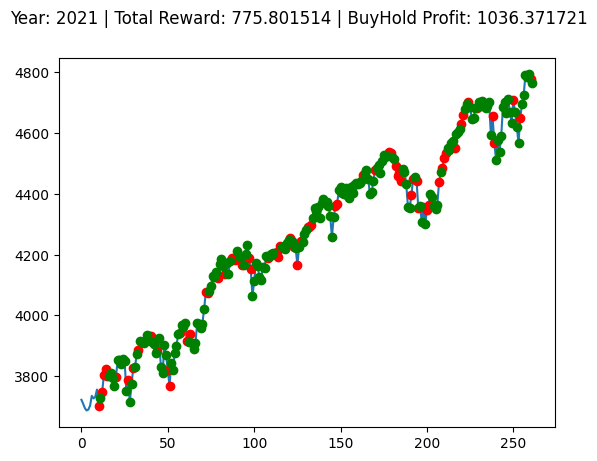

Buy And Hold: -971.472258300781


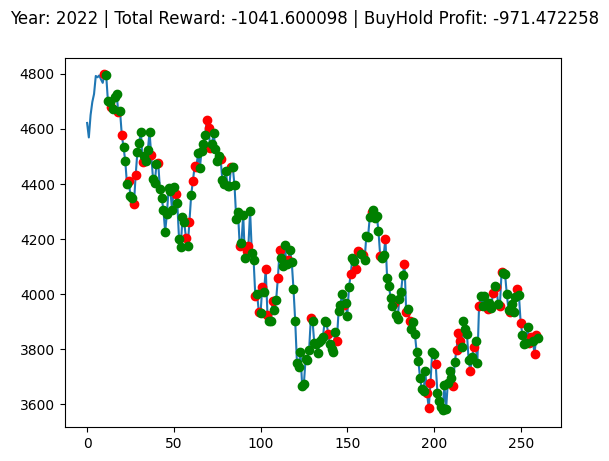

Buy And Hold: 917.112584228516


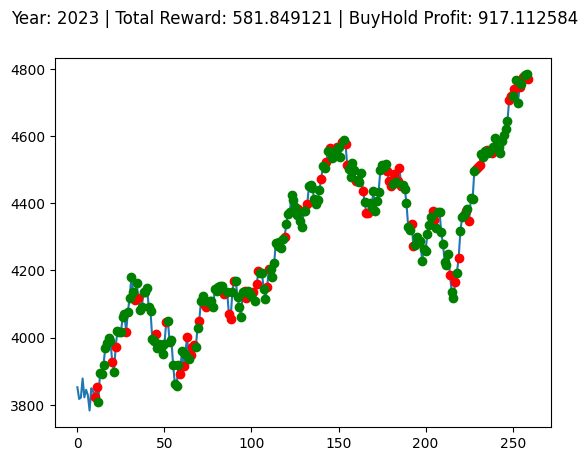

 94%|█████████▍| 94/100 [35:55<02:20, 23.42s/it]

Buy And Hold: -200.5494116210939


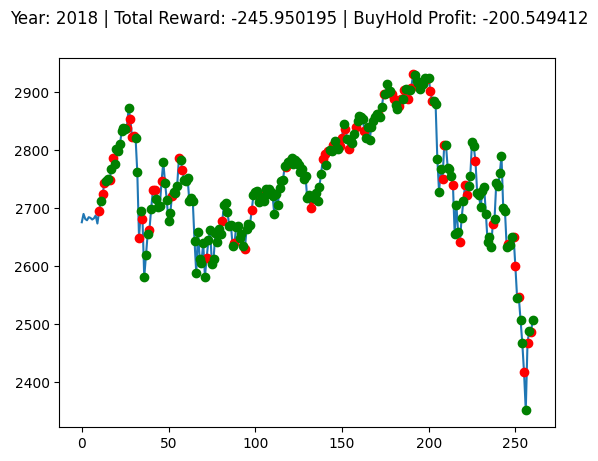

Buy And Hold: 700.9923498535159


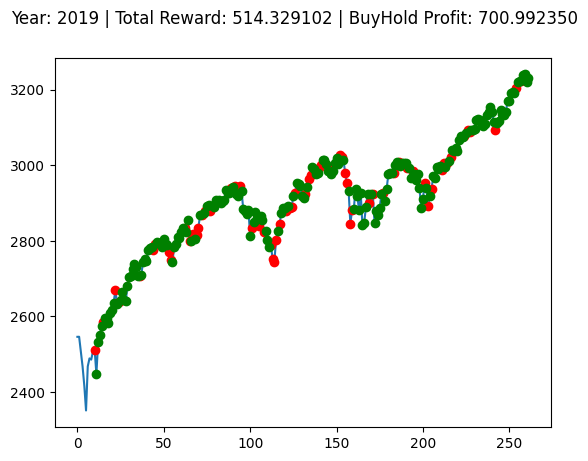

Buy And Hold: 476.9485205078122


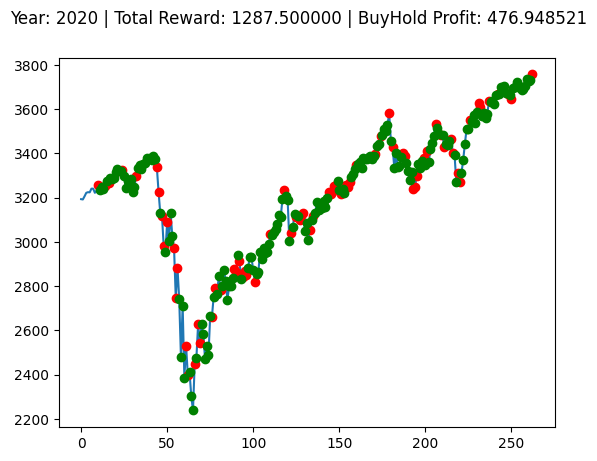

Buy And Hold: 1036.3717211914068


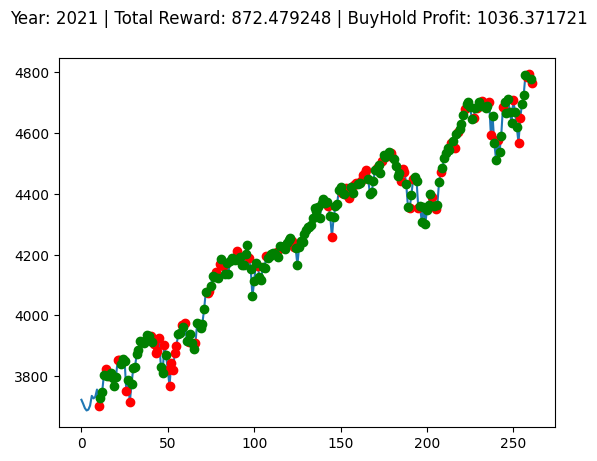

Buy And Hold: -971.472258300781


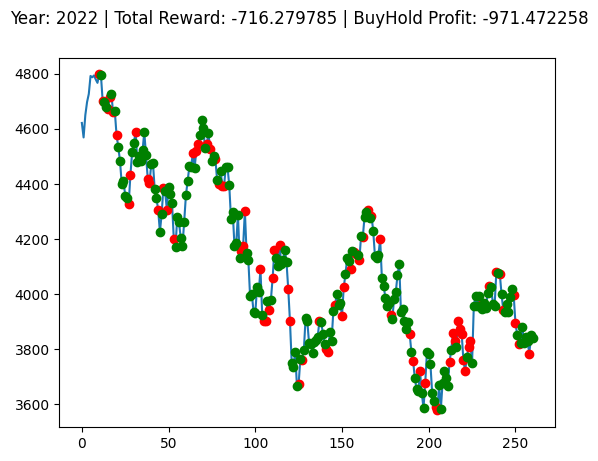

Buy And Hold: 917.112584228516


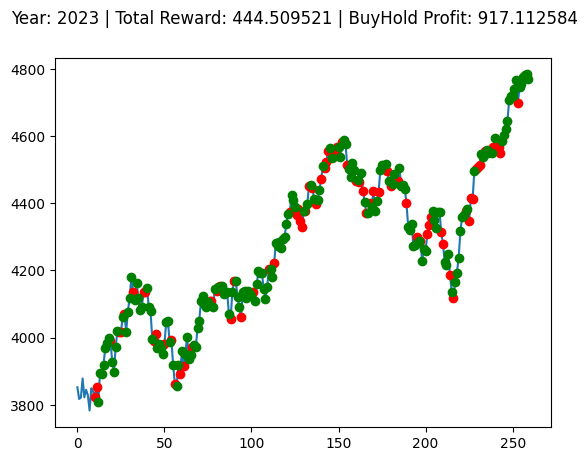

 95%|█████████▌| 95/100 [36:19<01:57, 23.52s/it]

Buy And Hold: -200.5494116210939


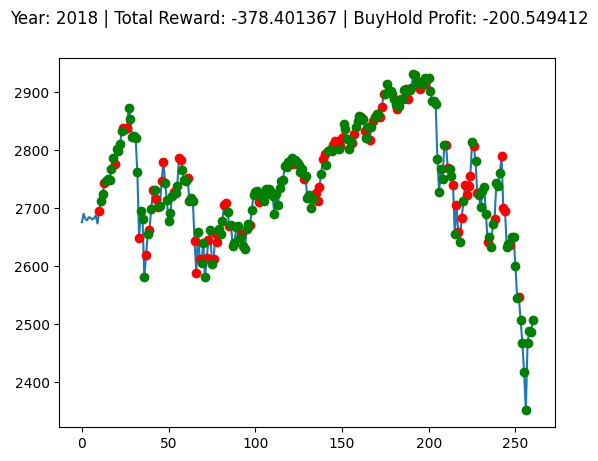

Buy And Hold: 700.9923498535159


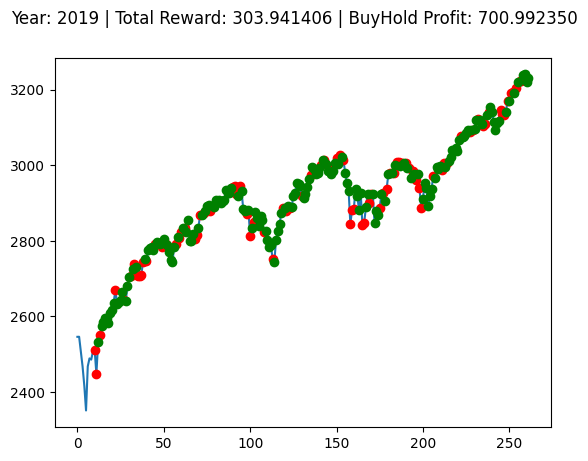

Buy And Hold: 476.9485205078122


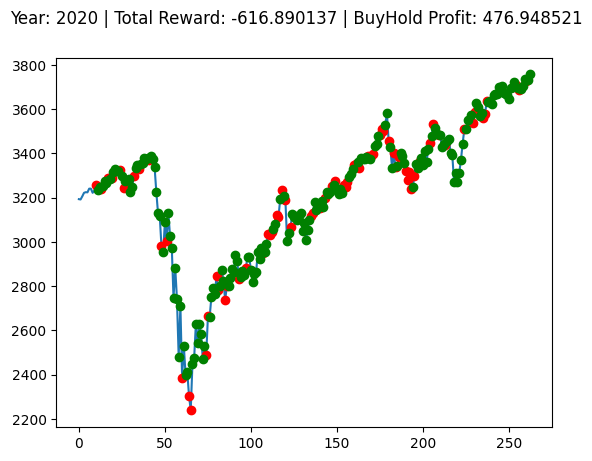

Buy And Hold: 1036.3717211914068


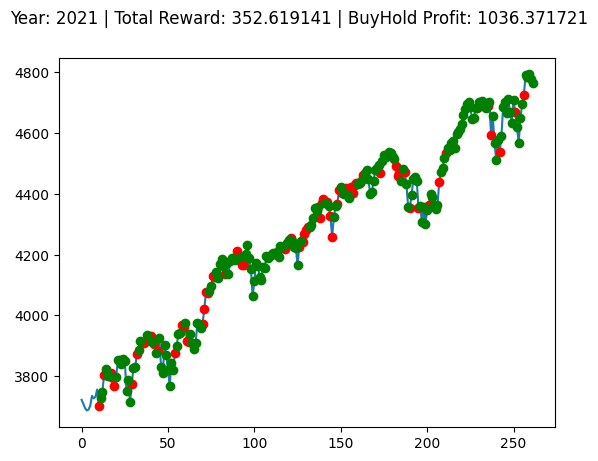

Buy And Hold: -971.472258300781


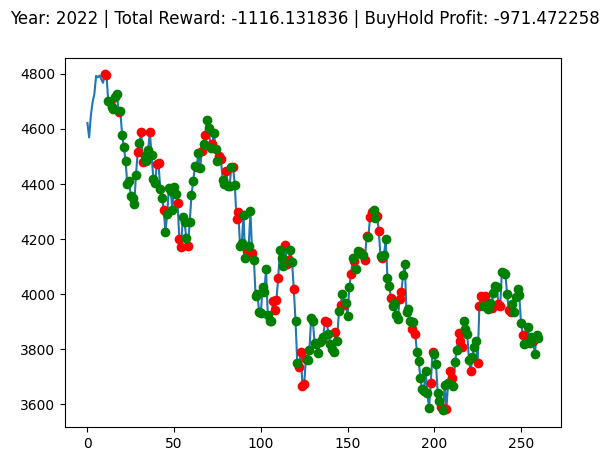

Buy And Hold: 917.112584228516


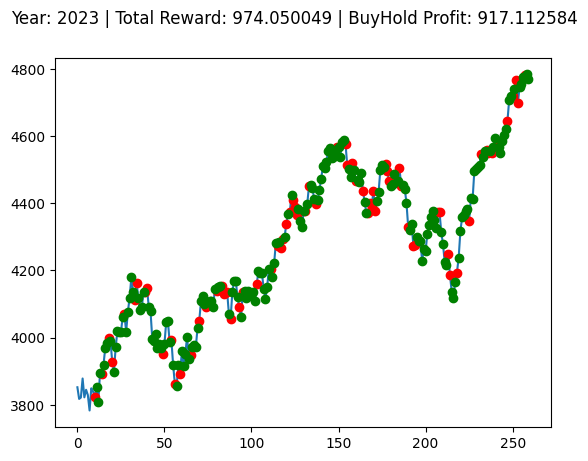

 96%|█████████▌| 96/100 [36:42<01:33, 23.32s/it]

Buy And Hold: -200.5494116210939


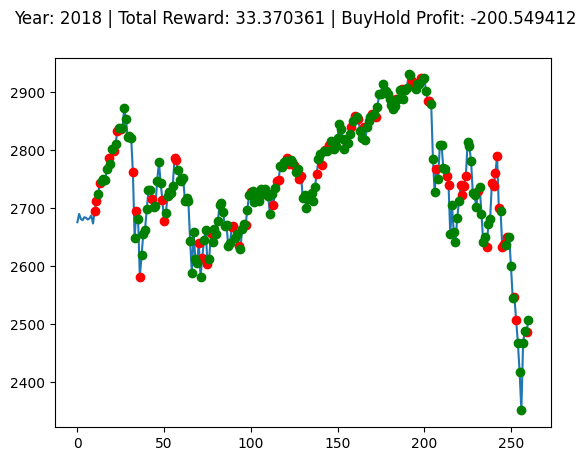

Buy And Hold: 700.9923498535159


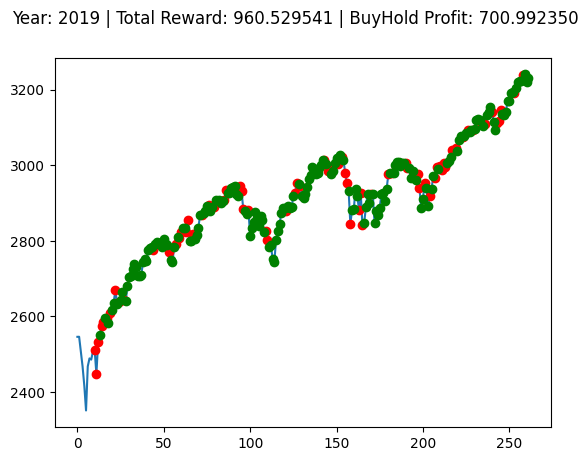

Buy And Hold: 476.9485205078122


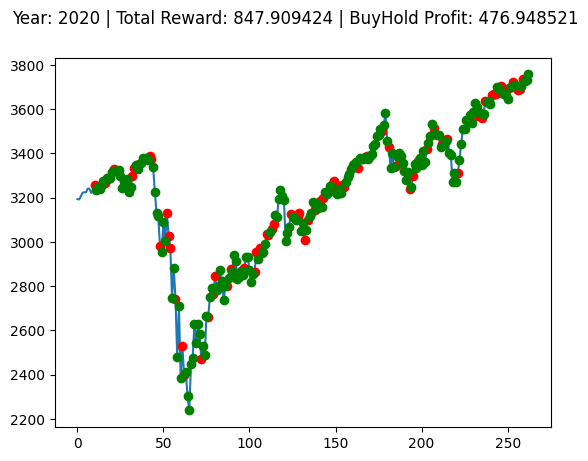

Buy And Hold: 1036.3717211914068


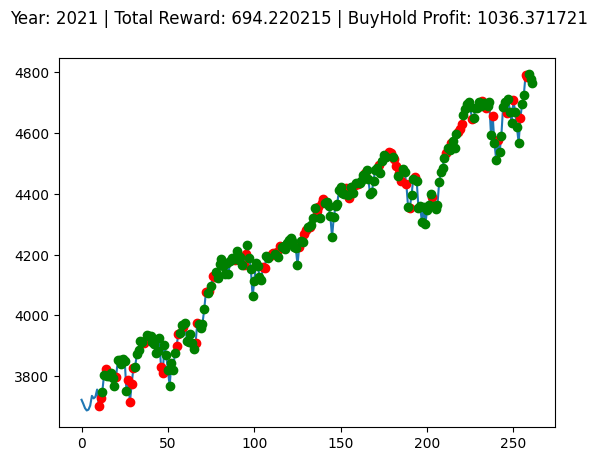

Buy And Hold: -971.472258300781


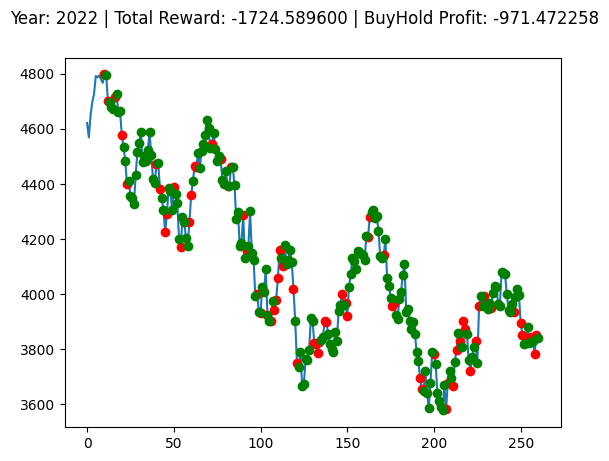

Buy And Hold: 917.112584228516


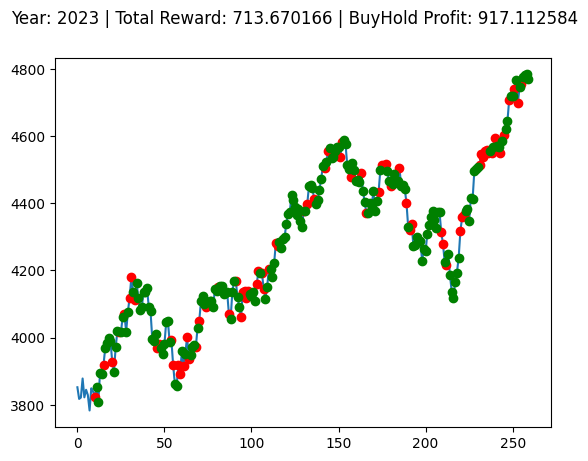

 97%|█████████▋| 97/100 [37:05<01:09, 23.29s/it]

Buy And Hold: -200.5494116210939


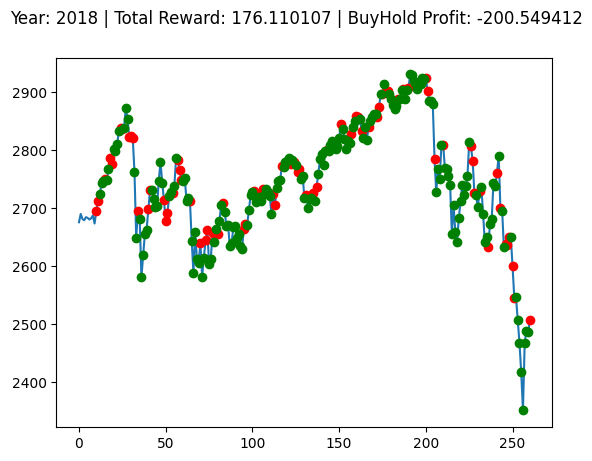

Buy And Hold: 700.9923498535159


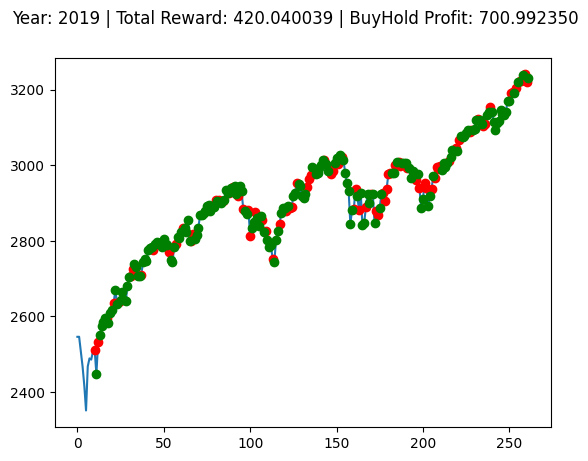

Buy And Hold: 476.9485205078122


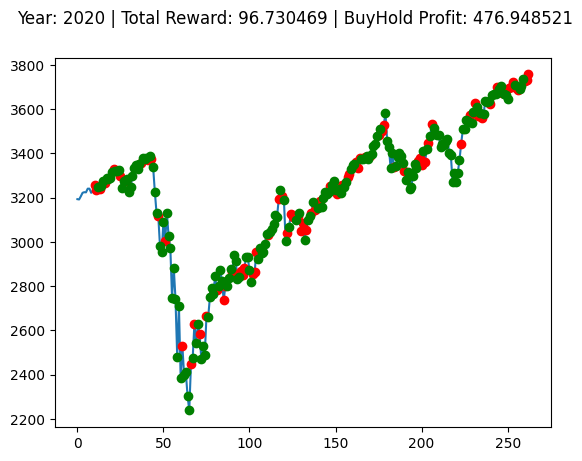

Buy And Hold: 1036.3717211914068


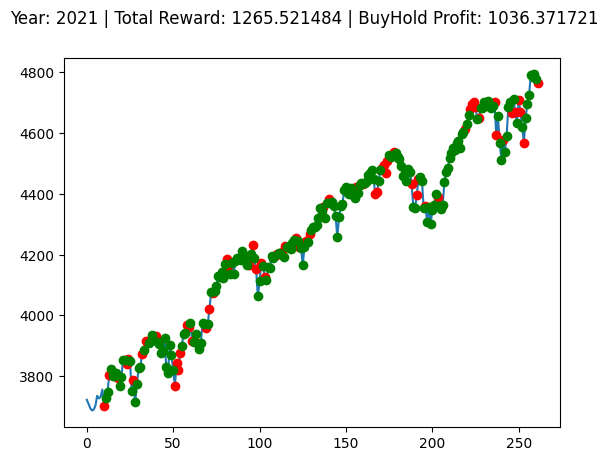

Buy And Hold: -971.472258300781


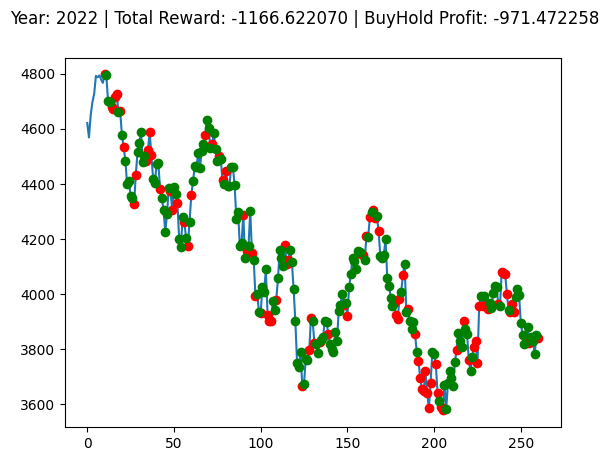

Buy And Hold: 917.112584228516


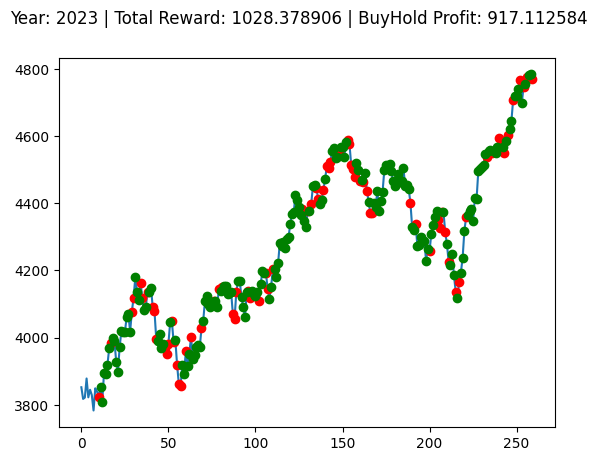

 98%|█████████▊| 98/100 [37:29<00:46, 23.39s/it]

Buy And Hold: -200.5494116210939


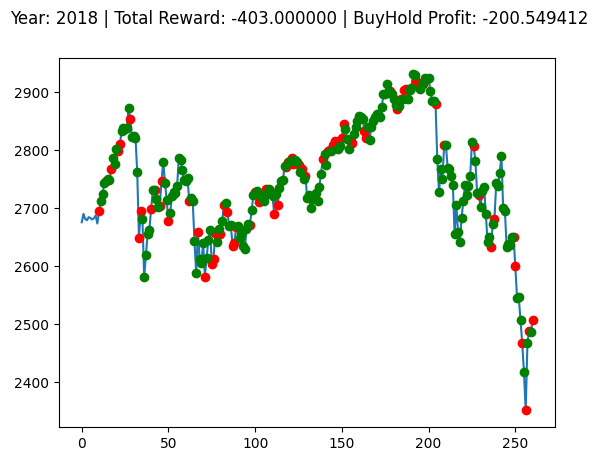

Buy And Hold: 700.9923498535159


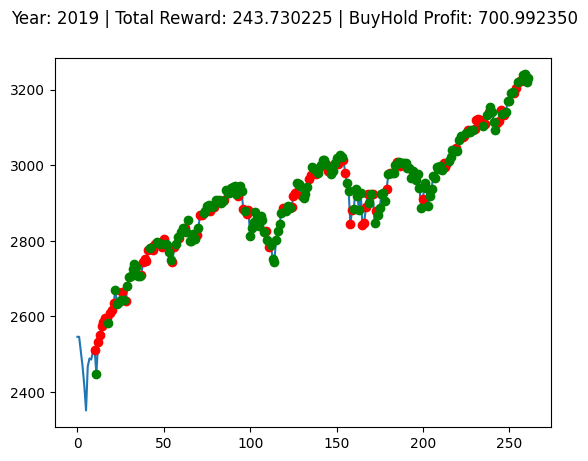

Buy And Hold: 476.9485205078122


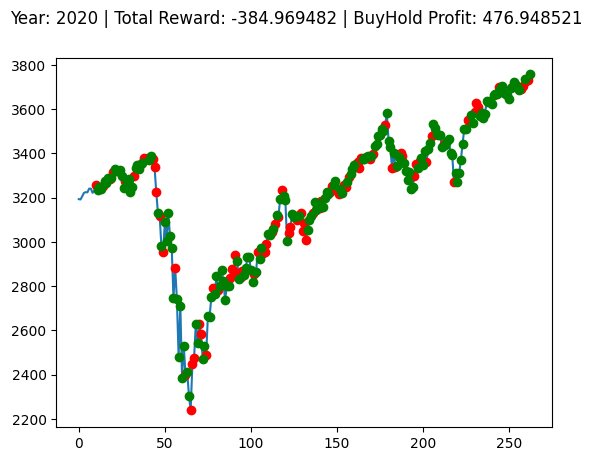

Buy And Hold: 1036.3717211914068


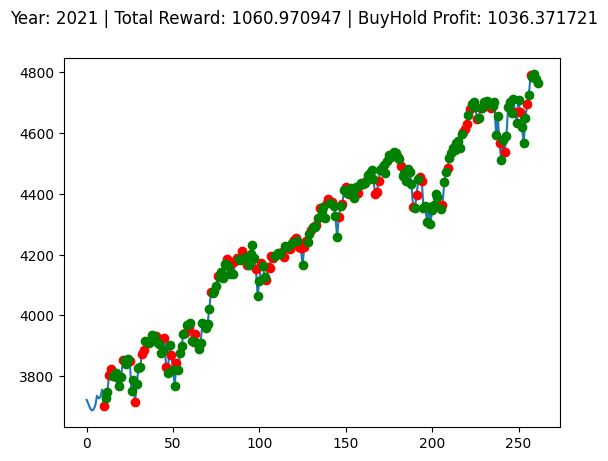

Buy And Hold: -971.472258300781


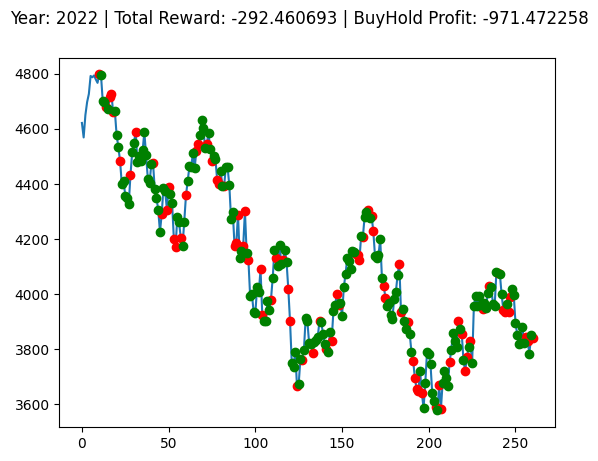

Buy And Hold: 917.112584228516


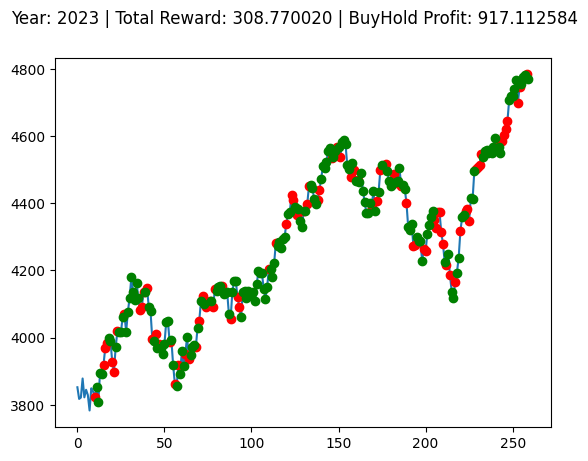

 99%|█████████▉| 99/100 [37:52<00:23, 23.38s/it]

Buy And Hold: -200.5494116210939


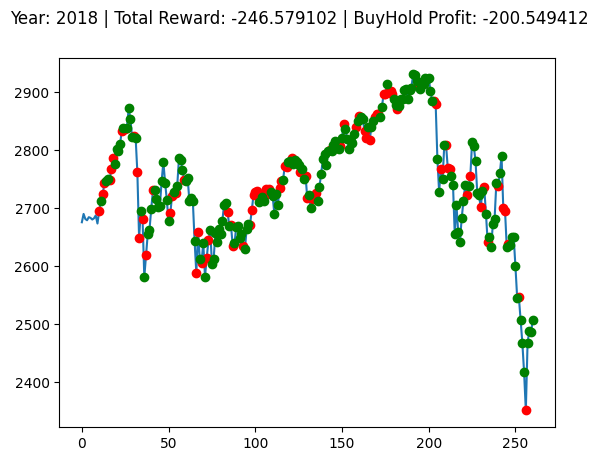

Buy And Hold: 700.9923498535159


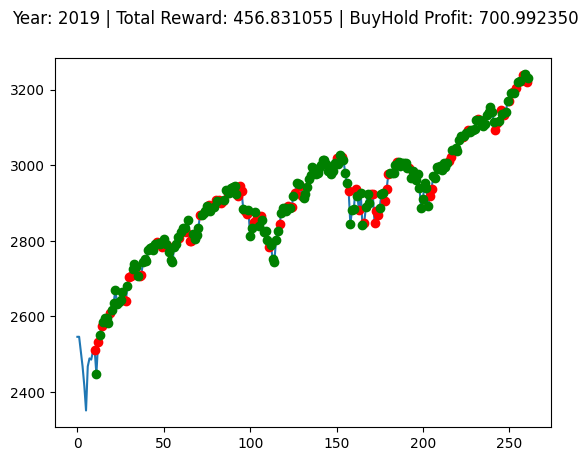

Buy And Hold: 476.9485205078122


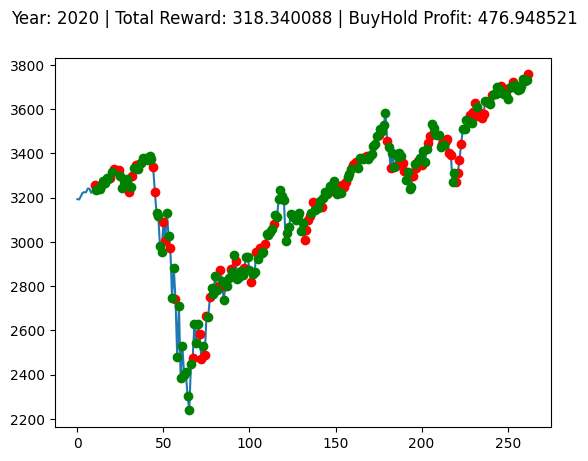

Buy And Hold: 1036.3717211914068


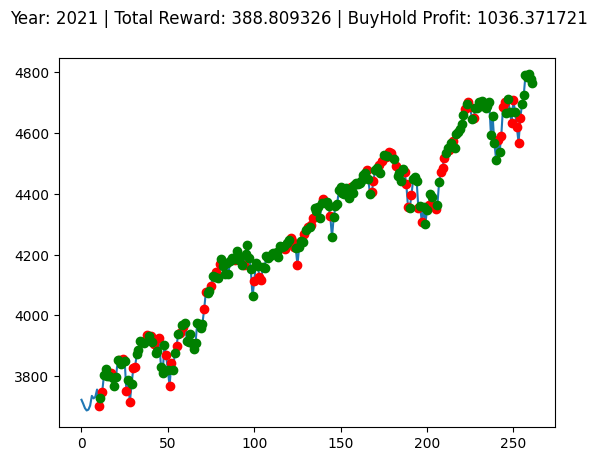

Buy And Hold: -971.472258300781


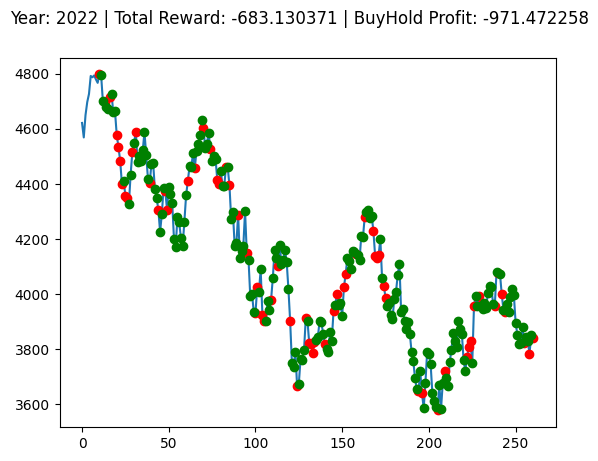

Buy And Hold: 917.112584228516


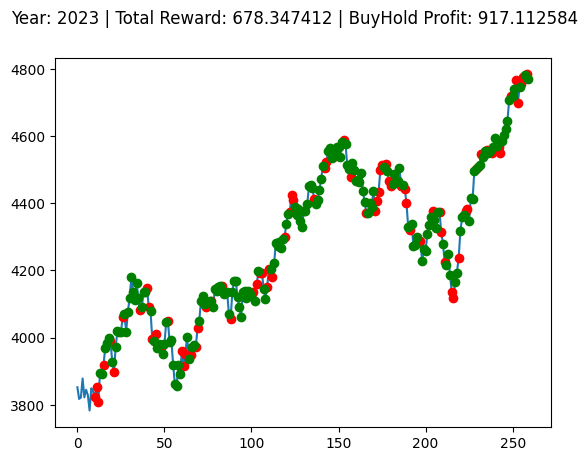

100%|██████████| 100/100 [38:16<00:00, 22.96s/it]


In [ ]:
position_histories = {
    '2018': [],
    '2019': [],
    '2020': [],
    '2021': [],
    '2022': [],
    '2023': [],
}
loop_range = tqdm.tqdm(range(0, 100))
for iteration in loop_range:
  for env in env_pool:
    observation, _ = env.reset(seed=2023)
    observation = torch.Tensor(observation).unsqueeze(0)
    #print(observation.shape)
    steps = 0
    while True:
        action, logprob, _, value = agent.get_action_and_value(observation)
        observation, reward, terminated, truncated, info = env.step(action)
        observation = torch.Tensor(observation).unsqueeze(0)
        done = terminated or truncated
        steps += 1

        # env.render()
        if done:
            end_price = observation[-1][0]
            print("==============================================================")
            print(f"Buy And Hold: {info['buy_hold_profit']}")
            print("==============================================================")
            position_histories[str(env.year)].append(env.history['total_reward'])
            #print(f"history: {env.history}")
            break

    plt.cla()
    env.unwrapped.render_all()
    plt.show()
    save_path = f"/content/drive/MyDrive/code/fintransformer/rl_figures/normalized_encoder/" + str(env.year) + "/" + str(iteration) + ".png"
    #print(save_path)
    #plt.savefig(save_path)

In [ ]:
def remove_duplicates(x):
  return list(dict.fromkeys(x))

def calculate_hitratio(x):
  count = 0
  for i in range(len(x)-1):
    if x[i] < x[i+1]:
      count +=1
  return count / (len(x)-1)

In [ ]:
for idx, key in enumerate(position_histories):
  history = [remove_duplicates(item) for item in position_histories[key]]
  avg_hitratio = np.mean([calculate_hitratio(item) for item in history])
  avg_return = np.mean([item[-1] for item in history])
  print(f"Year {key} | Avg Return: {avg_return} | Hit Ratio: {avg_hitratio}")

Year 2018 | Avg Return: -188.63742919921876 | Hit Ratio: 0.5404831525382063
Year 2019 | Avg Return: 535.8121362304687 | Hit Ratio: 0.642444622257095
Year 2020 | Avg Return: 306.43231689453125 | Hit Ratio: 0.6317355333155905
Year 2021 | Avg Return: 721.9488452148438 | Hit Ratio: 0.6207729963335401
Year 2022 | Avg Return: -690.541103515625 | Hit Ratio: 0.45521513966371674
Year 2023 | Avg Return: 672.78275390625 | Hit Ratio: 0.5948943922853475


In [ ]:
def calculate_up_down(df, year):
  close_2018 = df["Close"]
  close_2018 = close_2018.to_numpy()
  next_day_up = 0
  next_day_down = 0
  for i in range(len(close_2018)-1):
    if close_2018[i] < close_2018[i+1]:
      next_day_up += 1
    elif close_2018[i] > close_2018[i+1]:
      next_day_down += 1
  print(f"Year: {year}: Next Day Up: {next_day_up} Next Day Down: {next_day_down}")

test_years = [2018, 2019, 2020, 2021, 2022, 2023]
for year in test_years:
  df = dfs_by_year[year]
  calculate_up_down(df, year)

Year: 2018: Next Day Up: 131 Next Day Down: 119
Year: 2019: Next Day Up: 149 Next Day Down: 102
Year: 2020: Next Day Up: 144 Next Day Down: 108
Year: 2021: Next Day Up: 143 Next Day Down: 108
Year: 2022: Next Day Up: 107 Next Day Down: 143
Year: 2023: Next Day Up: 137 Next Day Down: 112


In [ ]:
from google.colab import runtime
runtime.unassign()

# Tensorboard

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir=/content/drive/MyDrive/finrl_runs

<IPython.core.display.Javascript object>